# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [20]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
    """ returns relative error """
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [21]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
    np.random.seed(0)
    return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
    np.random.seed(1)
    X = 10 * np.random.randn(num_inputs, input_size)
    y = np.array([0, 1, 2, 2, 1])
    return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [22]:
scores = net.loss(X)
print('Your scores:')
print(scores)
print()
print('correct scores:')
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print(correct_scores)
print()

# The difference should be very small. We get < 1e-7
print('Difference between your scores and correct scores:')
print(np.sum(np.abs(scores - correct_scores)))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.6802720496109664e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularization loss.

In [23]:
loss, _ = net.loss(X, y, reg=0.05)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print('Difference between your loss and correct loss:')
print(np.sum(np.abs(loss - correct_loss)))

Difference between your loss and correct loss:
1.7985612998927536e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [24]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.05)

# these should all be less than 1e-8 or so
for param_name in grads:
    f = lambda W: net.loss(X, y, reg=0.05)[0]
    param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
    print('%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name])))

W1 max relative error: 3.561318e-09
b1 max relative error: 1.555470e-09
W2 max relative error: 3.440708e-09
b2 max relative error: 3.865091e-11


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.02.

Final training loss:  0.015347150850363271


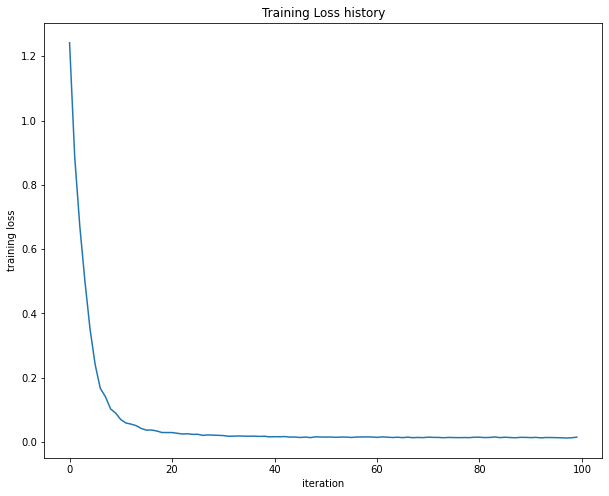

In [14]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=5e-6,
            num_iters=100, verbose=False)

print('Final training loss: ', stats['loss_history'][-1])

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [15]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    
    # Cleaning up variables to prevent loading data multiple times (which may cause memory issue)
    try:
       del X_train, y_train
       del X_test, y_test
       print('Clear previously loaded data.')
    except:
       pass

    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = list(range(num_training, num_training + num_validation))
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = list(range(num_training))
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = list(range(num_test))
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print('Train data shape: ', X_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', X_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', X_test.shape)
print('Test labels shape: ', y_test.shape)

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [25]:
input_size = 32 * 32 * 3
hidden_size = 180
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=20000, batch_size=200,
            learning_rate=1e-3, learning_rate_decay=0.95,
            reg=0.15, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print('Validation accuracy: ', val_acc)


iteration 0 / 20000: loss 2.303456
iteration 100 / 20000: loss 1.909554
iteration 200 / 20000: loss 1.664458
iteration 300 / 20000: loss 1.631913
iteration 400 / 20000: loss 1.623342
iteration 500 / 20000: loss 1.577215
iteration 600 / 20000: loss 1.546668
iteration 700 / 20000: loss 1.607549
iteration 800 / 20000: loss 1.716045
iteration 900 / 20000: loss 1.423628
iteration 1000 / 20000: loss 1.437939
iteration 1100 / 20000: loss 1.428514
iteration 1200 / 20000: loss 1.465242
iteration 1300 / 20000: loss 1.433428
iteration 1400 / 20000: loss 1.376865
iteration 1500 / 20000: loss 1.448655
iteration 1600 / 20000: loss 1.455300
iteration 1700 / 20000: loss 1.362136
iteration 1800 / 20000: loss 1.301745
iteration 1900 / 20000: loss 1.210331
iteration 2000 / 20000: loss 1.402749
iteration 2100 / 20000: loss 1.248288
iteration 2200 / 20000: loss 1.267824
iteration 2300 / 20000: loss 1.363149
iteration 2400 / 20000: loss 1.365428
iteration 2500 / 20000: loss 1.153957
iteration 2600 / 20000: 

# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

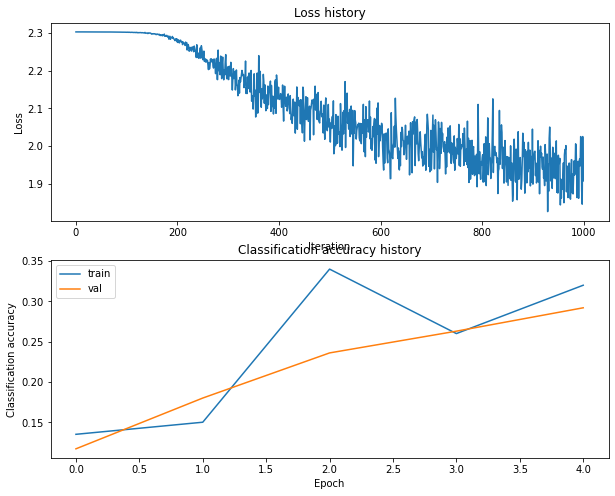

In [17]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Classification accuracy')
plt.legend()
plt.show()

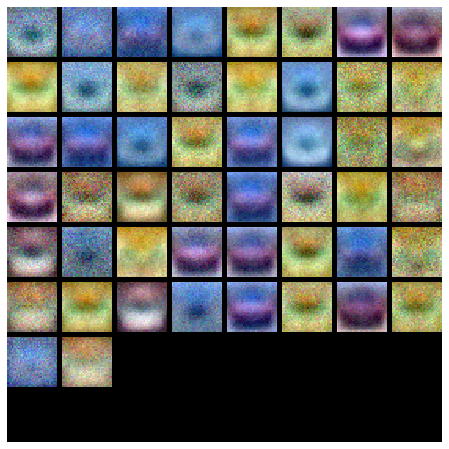

In [18]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
    W1 = net.params['W1']
    W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
    plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
    plt.gca().axis('off')
    plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can (52% could serve as a reference), with a fully-connected Neural Network. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

**Explain your hyperparameter tuning process below.**

$\color{blue}{\textit Your Answer:}$

Training network with h_s 10, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.302623
iteration 100 / 500: loss 2.302552
iteration 200 / 500: loss 2.300136
iteration 300 / 500: loss 2.260745
iteration 400 / 500: loss 2.169358
Validation accuracy:  0.205


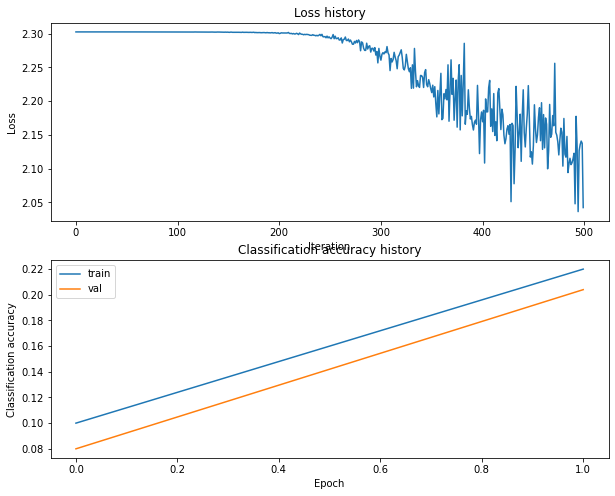

Training network with h_s 10, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.302632
iteration 100 / 500: loss 1.984429
iteration 200 / 500: loss 1.771134
iteration 300 / 500: loss 1.761065
iteration 400 / 500: loss 1.950647
Validation accuracy:  0.355


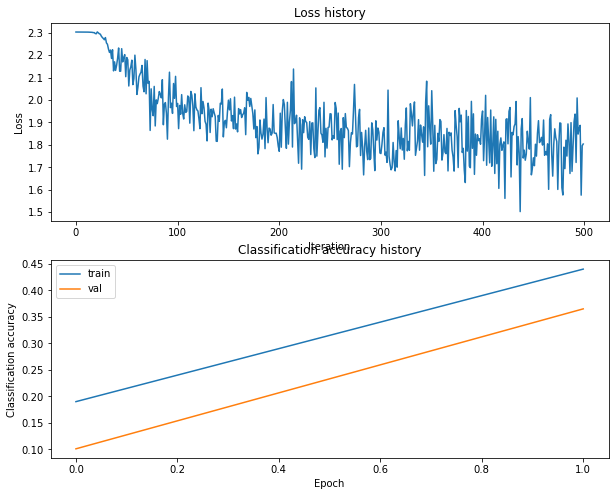

Training network with h_s 10, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.302620
iteration 100 / 500: loss 2.302410
iteration 200 / 500: loss 2.294318
iteration 300 / 500: loss 2.226396
iteration 400 / 500: loss 2.151470
Validation accuracy:  0.219


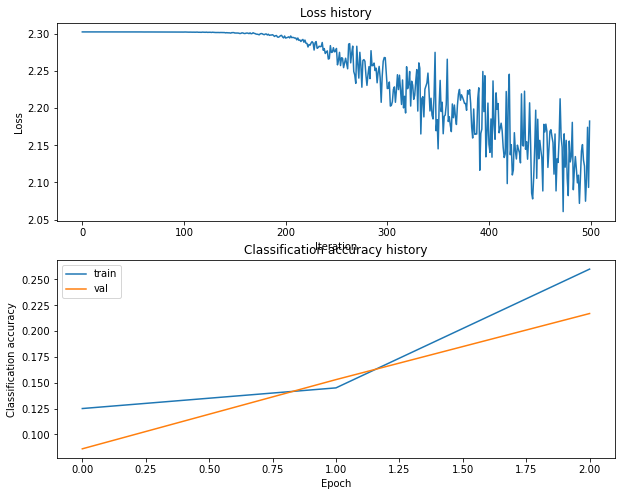

Training network with h_s 10, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.302641
iteration 100 / 500: loss 1.953638
iteration 200 / 500: loss 1.970617
iteration 300 / 500: loss 1.790825
iteration 400 / 500: loss 1.655474
Validation accuracy:  0.375


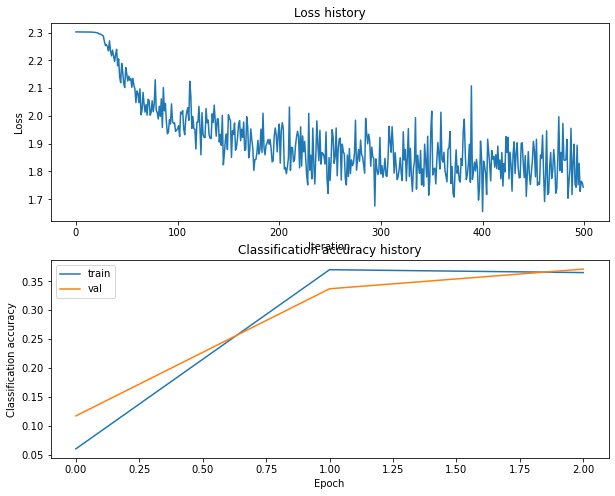

Training network with h_s 10, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.302628
iteration 100 / 500: loss 2.302510
iteration 200 / 500: loss 2.300258
iteration 300 / 500: loss 2.260909
iteration 400 / 500: loss 2.161319
Validation accuracy:  0.189


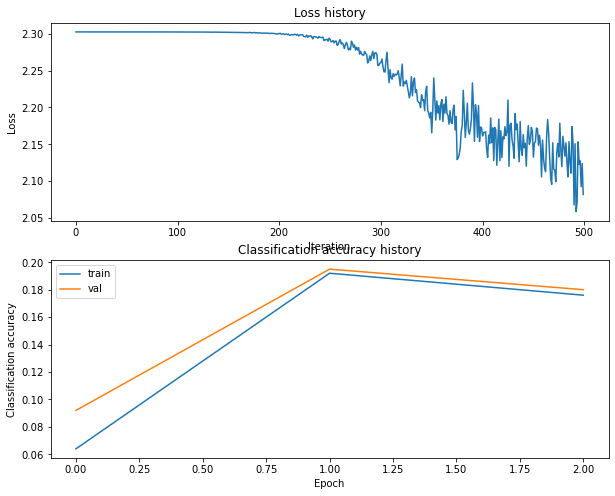

Training network with h_s 10, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.302627
iteration 100 / 500: loss 2.010330
iteration 200 / 500: loss 1.844610
iteration 300 / 500: loss 1.819450
iteration 400 / 500: loss 1.861756
Validation accuracy:  0.373


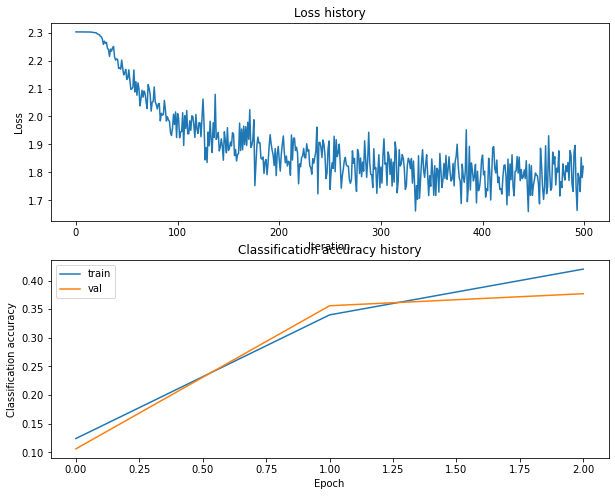

Training network with h_s 10, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.302626
iteration 100 / 500: loss 2.302486
iteration 200 / 500: loss 2.299044
iteration 300 / 500: loss 2.269125
iteration 400 / 500: loss 2.158153
Validation accuracy:  0.232


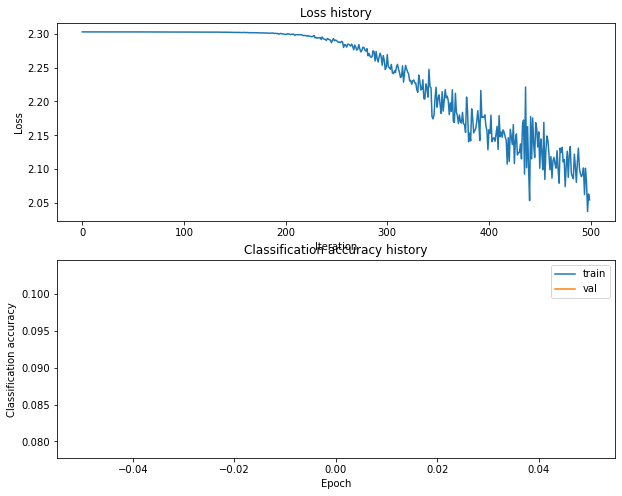

Training network with h_s 10, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.302629
iteration 100 / 500: loss 1.941230
iteration 200 / 500: loss 1.824270
iteration 300 / 500: loss 1.809123
iteration 400 / 500: loss 1.751088
Validation accuracy:  0.382


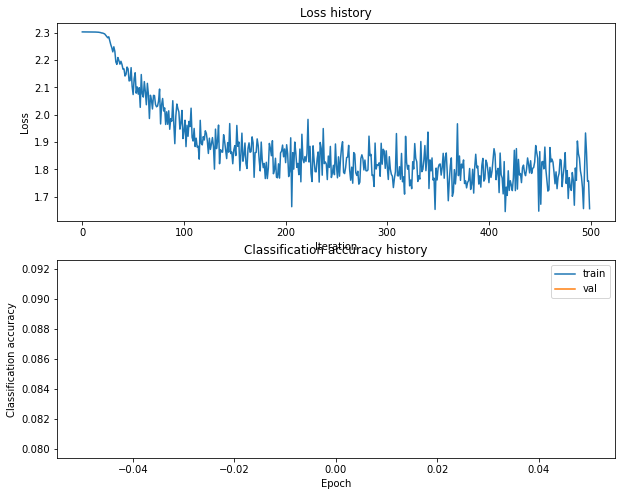

Training network with h_s 10, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.302622
iteration 100 / 500: loss 2.302230
iteration 200 / 500: loss 2.292901
iteration 300 / 500: loss 2.213635
iteration 400 / 500: loss 2.180441
Validation accuracy:  0.189


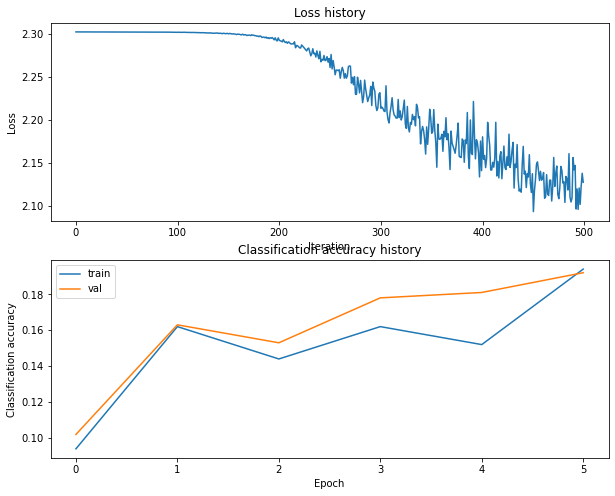

Training network with h_s 10, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.302626
iteration 100 / 500: loss 2.031188
iteration 200 / 500: loss 1.870383
iteration 300 / 500: loss 1.696502
iteration 400 / 500: loss 1.824934
Validation accuracy:  0.391


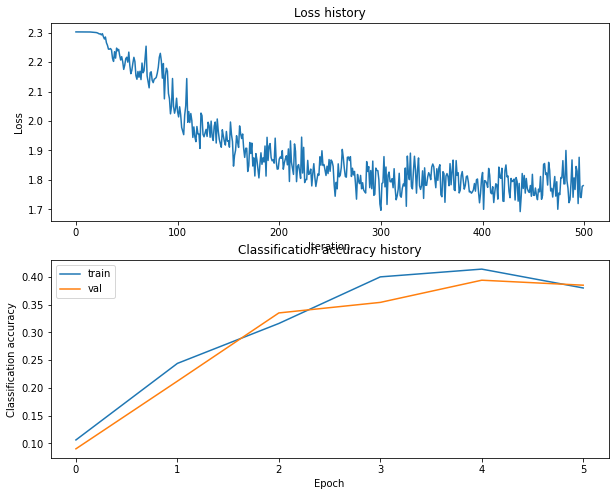

Training network with h_s 10, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.302616
iteration 100 / 1000: loss 2.302567
iteration 200 / 1000: loss 2.298810
iteration 300 / 1000: loss 2.220376
iteration 400 / 1000: loss 2.159848
iteration 500 / 1000: loss 2.070772
iteration 600 / 1000: loss 2.003617
iteration 700 / 1000: loss 2.105922
iteration 800 / 1000: loss 1.922063
iteration 900 / 1000: loss 2.048465
Validation accuracy:  0.285


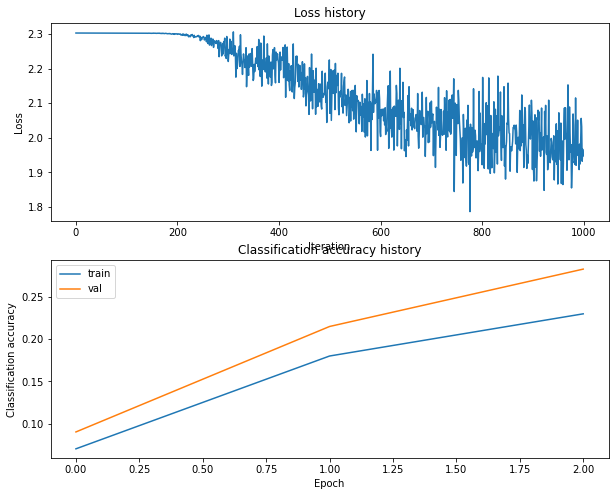

Training network with h_s 10, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.302615
iteration 100 / 1000: loss 2.023527
iteration 200 / 1000: loss 1.925229
iteration 300 / 1000: loss 1.881722
iteration 400 / 1000: loss 1.875577
iteration 500 / 1000: loss 1.721356
iteration 600 / 1000: loss 1.841379
iteration 700 / 1000: loss 1.883170
iteration 800 / 1000: loss 1.988958
iteration 900 / 1000: loss 1.862544
Validation accuracy:  0.381


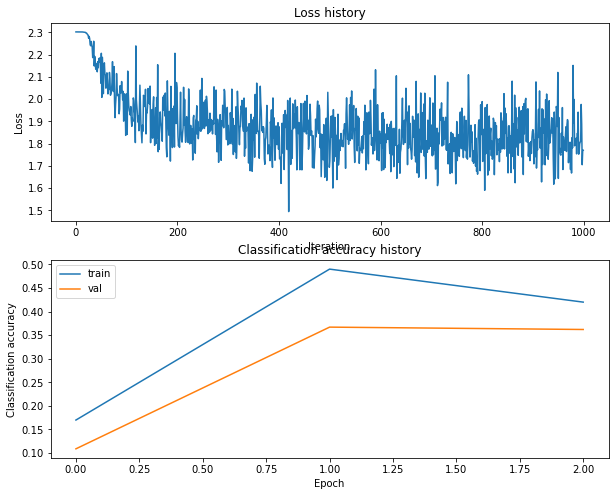

Training network with h_s 10, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.302616
iteration 100 / 1000: loss 2.302453
iteration 200 / 1000: loss 2.297810
iteration 300 / 1000: loss 2.235333
iteration 400 / 1000: loss 2.101031
iteration 500 / 1000: loss 2.090244
iteration 600 / 1000: loss 2.043292
iteration 700 / 1000: loss 2.030668
iteration 800 / 1000: loss 2.003818
iteration 900 / 1000: loss 2.045909
Validation accuracy:  0.26


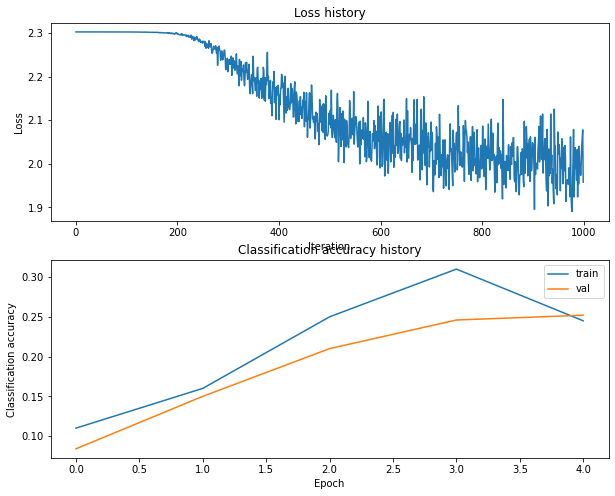

Training network with h_s 10, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.302632
iteration 100 / 1000: loss 1.898636
iteration 200 / 1000: loss 1.922574
iteration 300 / 1000: loss 1.749291
iteration 400 / 1000: loss 1.892736
iteration 500 / 1000: loss 1.757671
iteration 600 / 1000: loss 1.833674
iteration 700 / 1000: loss 1.686075
iteration 800 / 1000: loss 1.762515
iteration 900 / 1000: loss 1.741229
Validation accuracy:  0.378


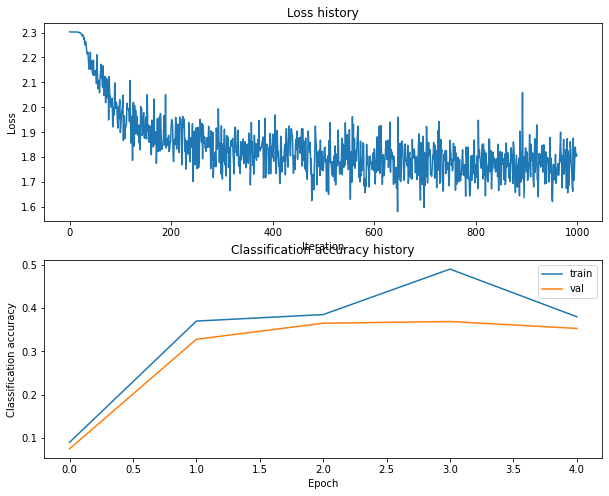

Training network with h_s 10, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.302621
iteration 100 / 1000: loss 2.302265
iteration 200 / 1000: loss 2.293030
iteration 300 / 1000: loss 2.221988
iteration 400 / 1000: loss 2.130507
iteration 500 / 1000: loss 2.066555
iteration 600 / 1000: loss 1.992391
iteration 700 / 1000: loss 2.069861
iteration 800 / 1000: loss 2.022113
iteration 900 / 1000: loss 2.060884
Validation accuracy:  0.275


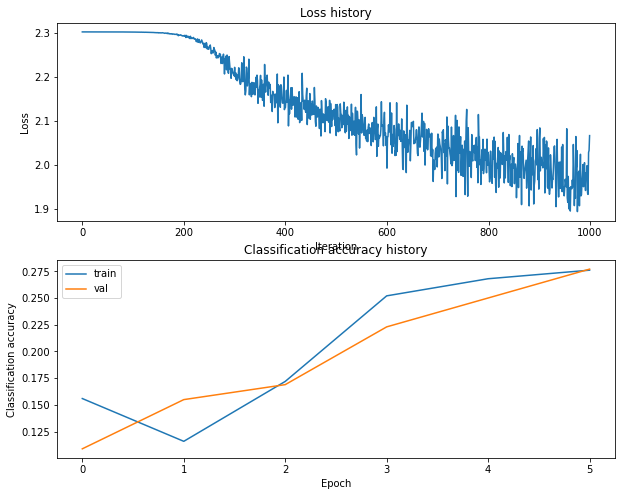

Training network with h_s 10, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.302633
iteration 100 / 1000: loss 2.015646
iteration 200 / 1000: loss 1.977578
iteration 300 / 1000: loss 1.754512
iteration 400 / 1000: loss 1.796133
iteration 500 / 1000: loss 1.751953
iteration 600 / 1000: loss 1.808160
iteration 700 / 1000: loss 1.847777
iteration 800 / 1000: loss 1.814468
iteration 900 / 1000: loss 1.720986
Validation accuracy:  0.396


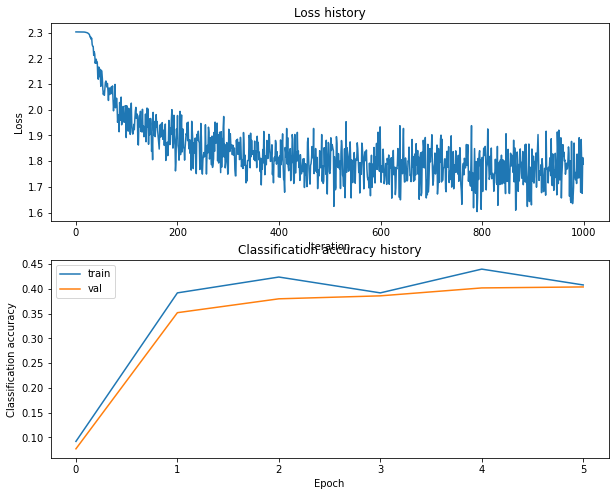

Training network with h_s 10, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.302617
iteration 100 / 1000: loss 2.302388
iteration 200 / 1000: loss 2.296951
iteration 300 / 1000: loss 2.220641
iteration 400 / 1000: loss 2.189886
iteration 500 / 1000: loss 2.114950
iteration 600 / 1000: loss 2.015402
iteration 700 / 1000: loss 2.028137
iteration 800 / 1000: loss 1.954624
iteration 900 / 1000: loss 2.059729
Validation accuracy:  0.29


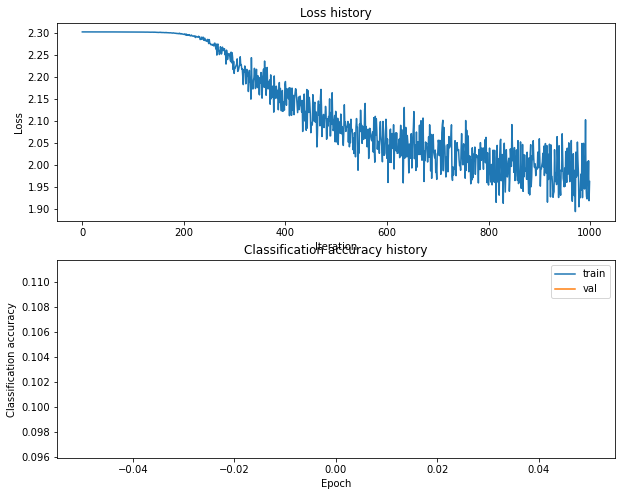

Training network with h_s 10, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.302638
iteration 100 / 1000: loss 1.943653
iteration 200 / 1000: loss 1.896950
iteration 300 / 1000: loss 1.884016
iteration 400 / 1000: loss 1.842970
iteration 500 / 1000: loss 1.836506
iteration 600 / 1000: loss 1.812777
iteration 700 / 1000: loss 1.786689
iteration 800 / 1000: loss 1.810117
iteration 900 / 1000: loss 1.840863
Validation accuracy:  0.395


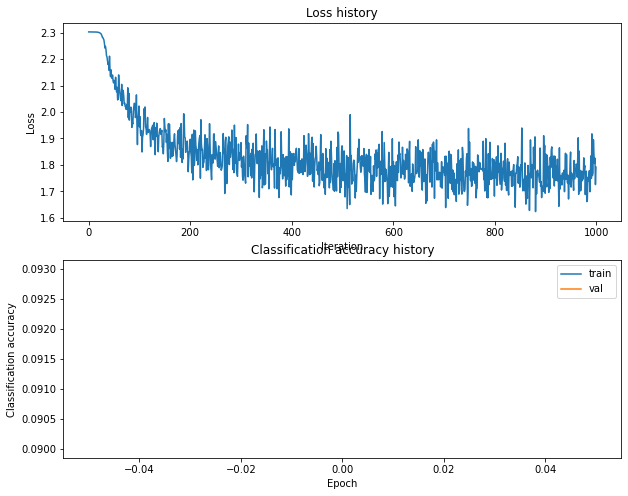

Training network with h_s 10, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.302615
iteration 100 / 1000: loss 2.302338
iteration 200 / 1000: loss 2.295313
iteration 300 / 1000: loss 2.228808
iteration 400 / 1000: loss 2.197775
iteration 500 / 1000: loss 2.173195
iteration 600 / 1000: loss 2.103883
iteration 700 / 1000: loss 2.073329
iteration 800 / 1000: loss 2.012347
iteration 900 / 1000: loss 2.023687
Validation accuracy:  0.261


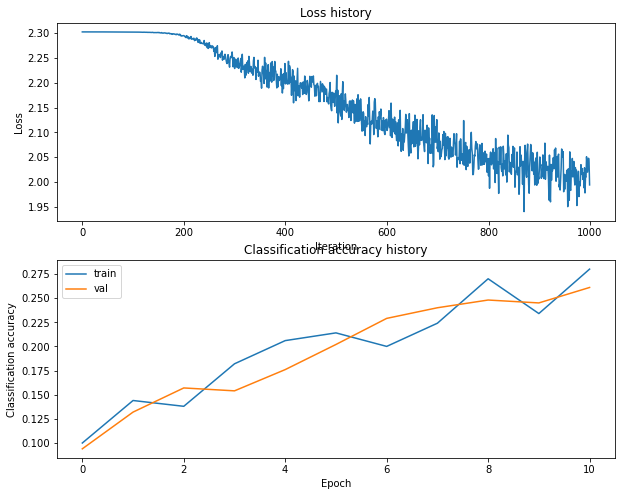

Training network with h_s 10, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.302616
iteration 100 / 1000: loss 1.938615
iteration 200 / 1000: loss 1.858007
iteration 300 / 1000: loss 1.740694
iteration 400 / 1000: loss 1.831885
iteration 500 / 1000: loss 1.726412
iteration 600 / 1000: loss 1.753206
iteration 700 / 1000: loss 1.734578
iteration 800 / 1000: loss 1.825999
iteration 900 / 1000: loss 1.796652
Validation accuracy:  0.411


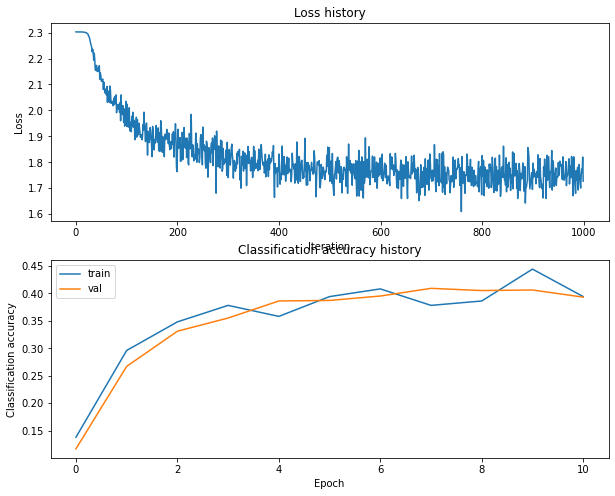

Training network with h_s 10, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.302624
iteration 100 / 1500: loss 2.302508
iteration 200 / 1500: loss 2.297825
iteration 300 / 1500: loss 2.229095
iteration 400 / 1500: loss 2.113249
iteration 500 / 1500: loss 2.133090
iteration 600 / 1500: loss 2.082341
iteration 700 / 1500: loss 1.976062
iteration 800 / 1500: loss 1.919434
iteration 900 / 1500: loss 1.961289
iteration 1000 / 1500: loss 2.014228
iteration 1100 / 1500: loss 1.997678
iteration 1200 / 1500: loss 2.055718
iteration 1300 / 1500: loss 1.984004
iteration 1400 / 1500: loss 1.867668
Validation accuracy:  0.328


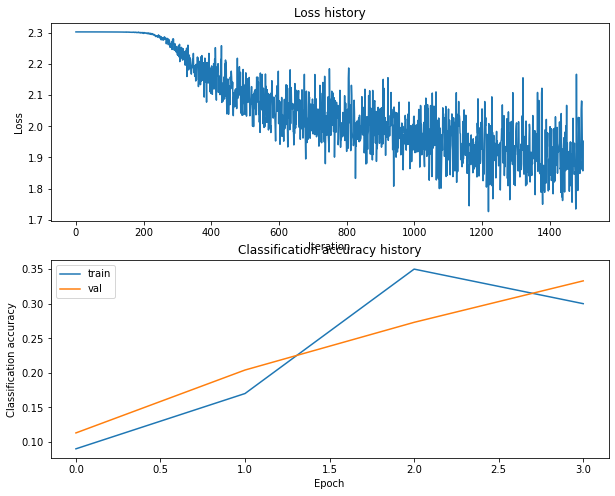

Training network with h_s 10, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.302626
iteration 100 / 1500: loss 2.046623
iteration 200 / 1500: loss 2.072202
iteration 300 / 1500: loss 1.833728
iteration 400 / 1500: loss 1.880057
iteration 500 / 1500: loss 1.956887
iteration 600 / 1500: loss 1.701086
iteration 700 / 1500: loss 1.813459
iteration 800 / 1500: loss 1.886687
iteration 900 / 1500: loss 1.851997
iteration 1000 / 1500: loss 1.808960
iteration 1100 / 1500: loss 1.875344
iteration 1200 / 1500: loss 1.914087
iteration 1300 / 1500: loss 1.836537
iteration 1400 / 1500: loss 2.067758
Validation accuracy:  0.387


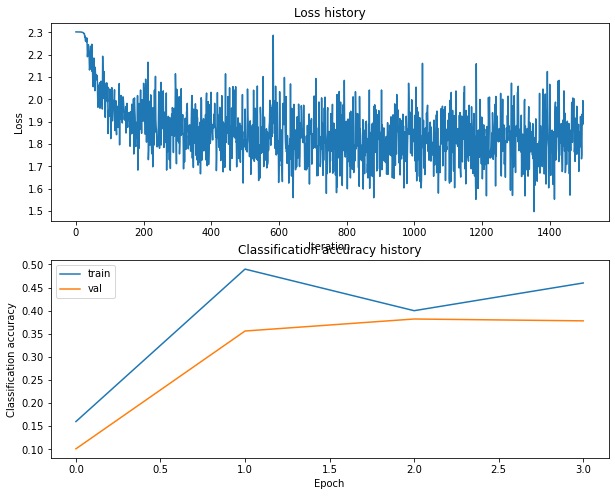

Training network with h_s 10, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.302633
iteration 100 / 1500: loss 2.302446
iteration 200 / 1500: loss 2.297902
iteration 300 / 1500: loss 2.236862
iteration 400 / 1500: loss 2.167188
iteration 500 / 1500: loss 2.083535
iteration 600 / 1500: loss 2.013393
iteration 700 / 1500: loss 2.039604
iteration 800 / 1500: loss 1.948456
iteration 900 / 1500: loss 2.018267
iteration 1000 / 1500: loss 2.070161
iteration 1100 / 1500: loss 1.859707
iteration 1200 / 1500: loss 1.895146
iteration 1300 / 1500: loss 1.959399
iteration 1400 / 1500: loss 1.883323
Validation accuracy:  0.322


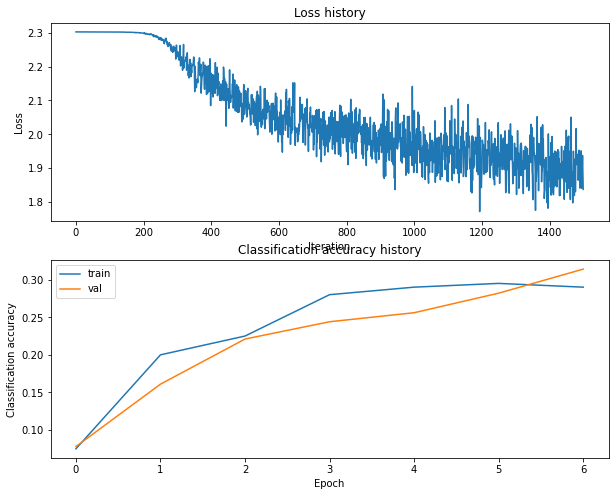

Training network with h_s 10, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.302617
iteration 100 / 1500: loss 1.988004
iteration 200 / 1500: loss 1.907134
iteration 300 / 1500: loss 1.888299
iteration 400 / 1500: loss 1.875249
iteration 500 / 1500: loss 1.858463
iteration 600 / 1500: loss 1.789069
iteration 700 / 1500: loss 1.812249
iteration 800 / 1500: loss 1.709662
iteration 900 / 1500: loss 1.705711
iteration 1000 / 1500: loss 1.816109
iteration 1100 / 1500: loss 1.813994
iteration 1200 / 1500: loss 1.798212
iteration 1300 / 1500: loss 1.714280
iteration 1400 / 1500: loss 1.729214
Validation accuracy:  0.397


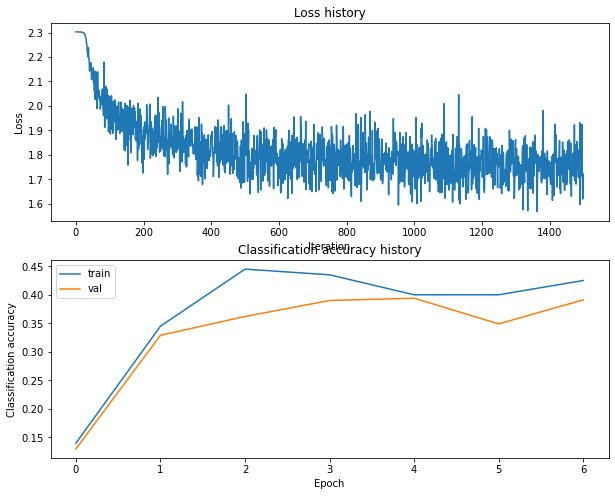

Training network with h_s 10, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.302624
iteration 100 / 1500: loss 2.302528
iteration 200 / 1500: loss 2.300718
iteration 300 / 1500: loss 2.278353
iteration 400 / 1500: loss 2.240031
iteration 500 / 1500: loss 2.151000
iteration 600 / 1500: loss 2.167680
iteration 700 / 1500: loss 2.108944
iteration 800 / 1500: loss 2.003807
iteration 900 / 1500: loss 2.128299
iteration 1000 / 1500: loss 1.987998
iteration 1100 / 1500: loss 1.959463
iteration 1200 / 1500: loss 2.042755
iteration 1300 / 1500: loss 1.995720
iteration 1400 / 1500: loss 2.013568
Validation accuracy:  0.295


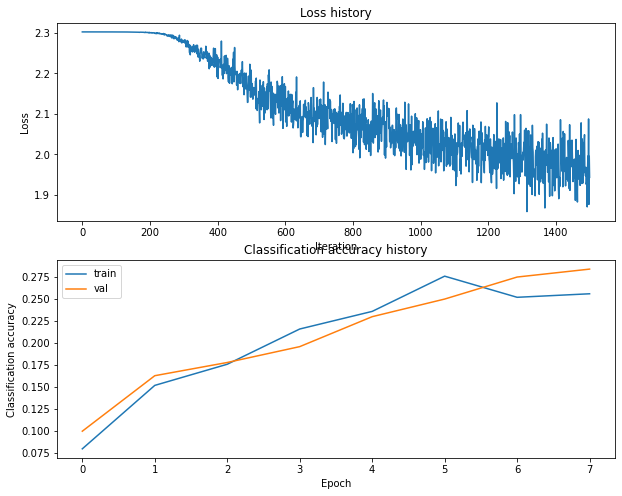

Training network with h_s 10, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.302636
iteration 100 / 1500: loss 1.957476
iteration 200 / 1500: loss 1.832031
iteration 300 / 1500: loss 1.815295
iteration 400 / 1500: loss 1.823749
iteration 500 / 1500: loss 1.813125
iteration 600 / 1500: loss 1.755157
iteration 700 / 1500: loss 1.798668
iteration 800 / 1500: loss 1.752862
iteration 900 / 1500: loss 1.690366
iteration 1000 / 1500: loss 1.786061
iteration 1100 / 1500: loss 1.778060
iteration 1200 / 1500: loss 1.811432
iteration 1300 / 1500: loss 1.709807
iteration 1400 / 1500: loss 1.738971
Validation accuracy:  0.395


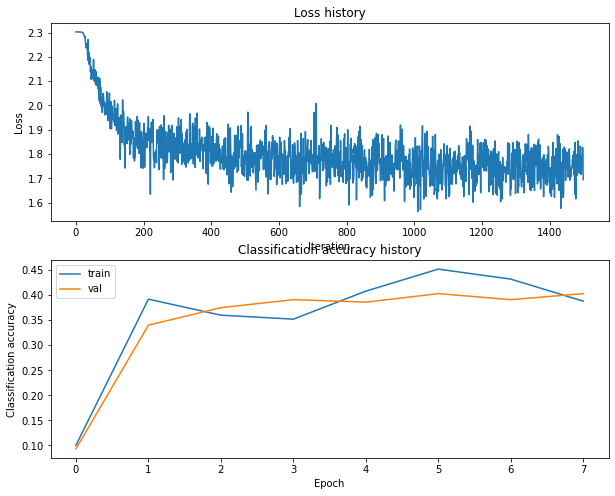

Training network with h_s 10, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.302611
iteration 100 / 1500: loss 2.302348
iteration 200 / 1500: loss 2.295283
iteration 300 / 1500: loss 2.206801
iteration 400 / 1500: loss 2.172574
iteration 500 / 1500: loss 2.079093
iteration 600 / 1500: loss 2.075370
iteration 700 / 1500: loss 2.062862
iteration 800 / 1500: loss 1.982356
iteration 900 / 1500: loss 1.946980
iteration 1000 / 1500: loss 2.006296
iteration 1100 / 1500: loss 1.939729
iteration 1200 / 1500: loss 2.013616
iteration 1300 / 1500: loss 1.922166
iteration 1400 / 1500: loss 1.892132
Validation accuracy:  0.314


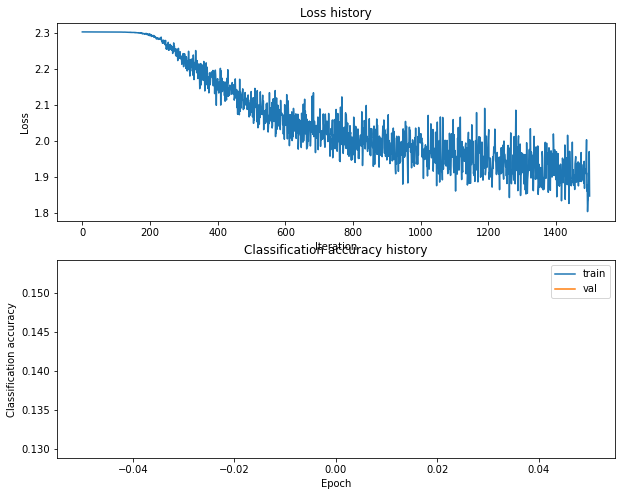

Training network with h_s 10, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.302618
iteration 100 / 1500: loss 1.991881
iteration 200 / 1500: loss 1.930447
iteration 300 / 1500: loss 1.784696
iteration 400 / 1500: loss 1.811942
iteration 500 / 1500: loss 1.904858
iteration 600 / 1500: loss 1.781181
iteration 700 / 1500: loss 1.767518
iteration 800 / 1500: loss 1.823737
iteration 900 / 1500: loss 1.842893
iteration 1000 / 1500: loss 1.788116
iteration 1100 / 1500: loss 1.855742
iteration 1200 / 1500: loss 1.805053
iteration 1300 / 1500: loss 1.785158
iteration 1400 / 1500: loss 1.906794
Validation accuracy:  0.399


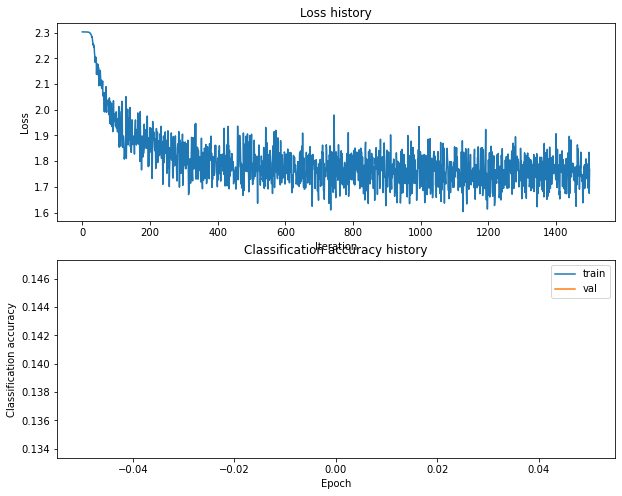

Training network with h_s 10, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.302616
iteration 100 / 1500: loss 2.302306
iteration 200 / 1500: loss 2.294476
iteration 300 / 1500: loss 2.233223
iteration 400 / 1500: loss 2.175998
iteration 500 / 1500: loss 2.113689
iteration 600 / 1500: loss 2.066826
iteration 700 / 1500: loss 2.064494
iteration 800 / 1500: loss 2.053060
iteration 900 / 1500: loss 2.011614
iteration 1000 / 1500: loss 2.022077
iteration 1100 / 1500: loss 1.987829
iteration 1200 / 1500: loss 1.906690
iteration 1300 / 1500: loss 1.984821
iteration 1400 / 1500: loss 1.937050
Validation accuracy:  0.273


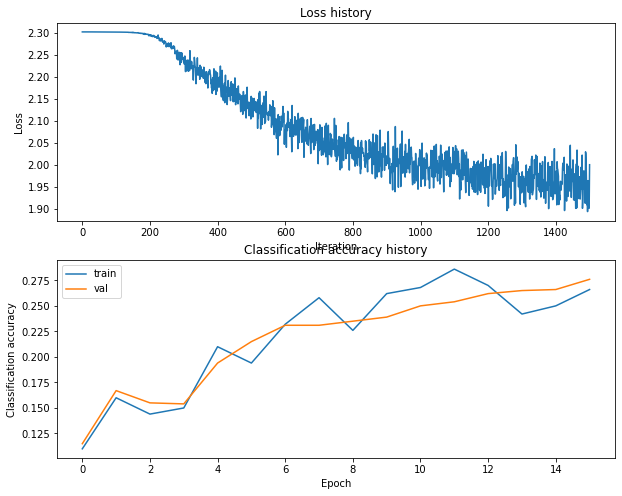

Training network with h_s 10, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.302622
iteration 100 / 1500: loss 1.952084
iteration 200 / 1500: loss 1.832582
iteration 300 / 1500: loss 1.775258
iteration 400 / 1500: loss 1.824826
iteration 500 / 1500: loss 1.815913
iteration 600 / 1500: loss 1.729345
iteration 700 / 1500: loss 1.801649
iteration 800 / 1500: loss 1.713557
iteration 900 / 1500: loss 1.738919
iteration 1000 / 1500: loss 1.794179
iteration 1100 / 1500: loss 1.704373
iteration 1200 / 1500: loss 1.699853
iteration 1300 / 1500: loss 1.742585
iteration 1400 / 1500: loss 1.782706
Validation accuracy:  0.416


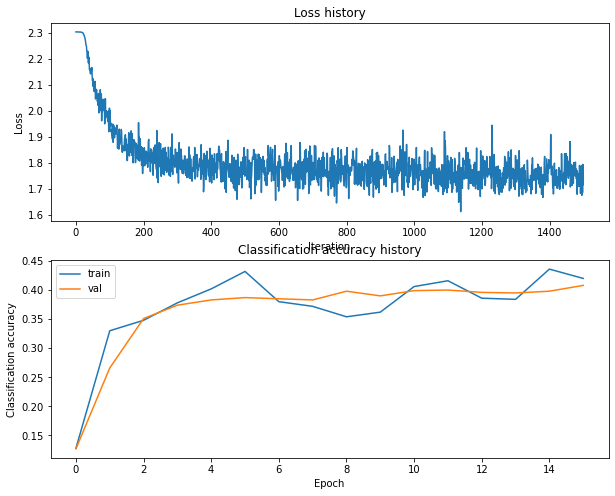

Training network with h_s 10, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.302624
iteration 100 / 2500: loss 2.302288
iteration 200 / 2500: loss 2.289688
iteration 300 / 2500: loss 2.222328
iteration 400 / 2500: loss 2.150974
iteration 500 / 2500: loss 2.178858
iteration 600 / 2500: loss 2.069334
iteration 700 / 2500: loss 2.089527
iteration 800 / 2500: loss 2.053376
iteration 900 / 2500: loss 2.010270
iteration 1000 / 2500: loss 2.084539
iteration 1100 / 2500: loss 1.918685
iteration 1200 / 2500: loss 1.875445
iteration 1300 / 2500: loss 1.979911
iteration 1400 / 2500: loss 1.949207
iteration 1500 / 2500: loss 1.852908
iteration 1600 / 2500: loss 1.971866
iteration 1700 / 2500: loss 1.965422
iteration 1800 / 2500: loss 1.781759
iteration 1900 / 2500: loss 1.866733
iteration 2000 / 2500: loss 1.902721
iteration 2100 / 2500: loss 1.886978
iteration 2200 / 2500: loss 1.793944
iteration 2300 / 2500: loss 1.745408
iteration 2400 / 2500: loss 1.986133
Validation accuracy:  0.347

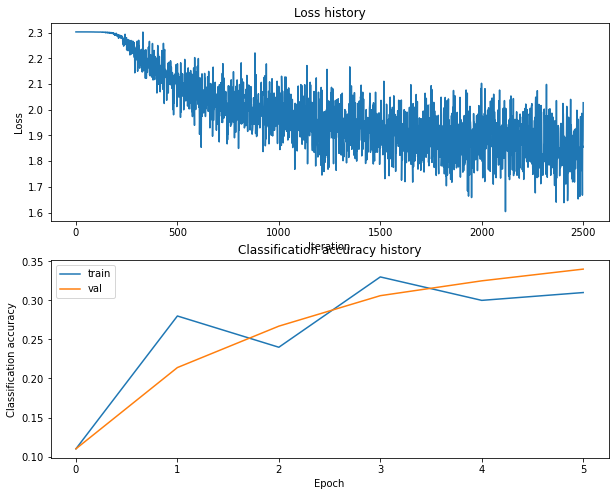

Training network with h_s 10, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.302632
iteration 100 / 2500: loss 2.001113
iteration 200 / 2500: loss 1.963953
iteration 300 / 2500: loss 1.823992
iteration 400 / 2500: loss 1.885723
iteration 500 / 2500: loss 1.671525
iteration 600 / 2500: loss 1.779079
iteration 700 / 2500: loss 1.650432
iteration 800 / 2500: loss 1.931098
iteration 900 / 2500: loss 1.829027
iteration 1000 / 2500: loss 1.944603
iteration 1100 / 2500: loss 1.884189
iteration 1200 / 2500: loss 1.758429
iteration 1300 / 2500: loss 1.760096
iteration 1400 / 2500: loss 1.857600
iteration 1500 / 2500: loss 1.630552
iteration 1600 / 2500: loss 1.696323
iteration 1700 / 2500: loss 1.720353
iteration 1800 / 2500: loss 1.768032
iteration 1900 / 2500: loss 1.806954
iteration 2000 / 2500: loss 1.712478
iteration 2100 / 2500: loss 1.878249
iteration 2200 / 2500: loss 1.801606
iteration 2300 / 2500: loss 1.860105
iteration 2400 / 2500: loss 1.726840
Validation accuracy:  0.379


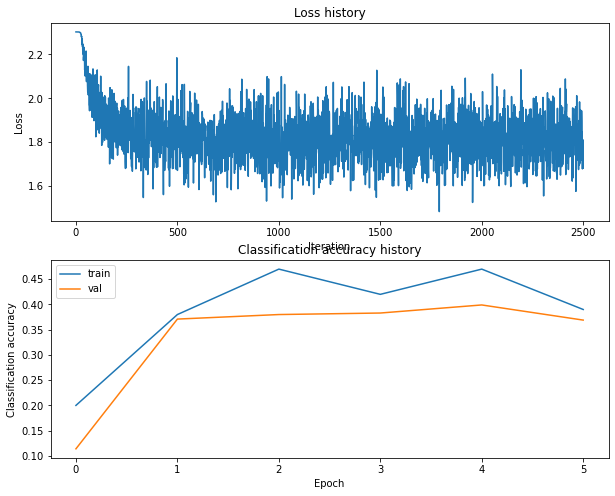

Training network with h_s 10, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.302633
iteration 100 / 2500: loss 2.302441
iteration 200 / 2500: loss 2.299263
iteration 300 / 2500: loss 2.255498
iteration 400 / 2500: loss 2.155989
iteration 500 / 2500: loss 2.085216
iteration 600 / 2500: loss 2.123305
iteration 700 / 2500: loss 2.060743
iteration 800 / 2500: loss 2.073060
iteration 900 / 2500: loss 2.039947
iteration 1000 / 2500: loss 1.926428
iteration 1100 / 2500: loss 1.995050
iteration 1200 / 2500: loss 2.086686
iteration 1300 / 2500: loss 1.958302
iteration 1400 / 2500: loss 1.956458
iteration 1500 / 2500: loss 1.961913
iteration 1600 / 2500: loss 1.898431
iteration 1700 / 2500: loss 1.856307
iteration 1800 / 2500: loss 1.893521
iteration 1900 / 2500: loss 1.845115
iteration 2000 / 2500: loss 1.889854
iteration 2100 / 2500: loss 1.800771
iteration 2200 / 2500: loss 1.834782
iteration 2300 / 2500: loss 1.841916
iteration 2400 / 2500: loss 1.749267
Validation accuracy:  0.344

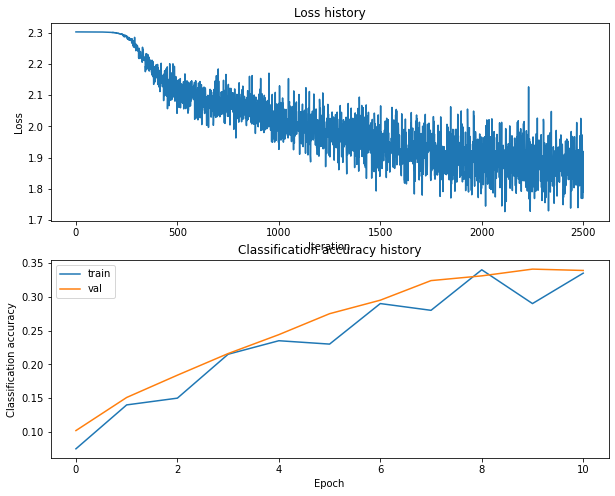

Training network with h_s 10, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.302628
iteration 100 / 2500: loss 1.982357
iteration 200 / 2500: loss 1.806483
iteration 300 / 2500: loss 1.869537
iteration 400 / 2500: loss 1.795582
iteration 500 / 2500: loss 1.756649
iteration 600 / 2500: loss 1.799151
iteration 700 / 2500: loss 1.815094
iteration 800 / 2500: loss 1.793555
iteration 900 / 2500: loss 1.690653
iteration 1000 / 2500: loss 1.789160
iteration 1100 / 2500: loss 1.793841
iteration 1200 / 2500: loss 1.626306
iteration 1300 / 2500: loss 1.842338
iteration 1400 / 2500: loss 1.760960
iteration 1500 / 2500: loss 1.762895
iteration 1600 / 2500: loss 1.758454
iteration 1700 / 2500: loss 1.778382
iteration 1800 / 2500: loss 1.784205
iteration 1900 / 2500: loss 1.809478
iteration 2000 / 2500: loss 1.864729
iteration 2100 / 2500: loss 1.781558
iteration 2200 / 2500: loss 1.851032
iteration 2300 / 2500: loss 1.771012
iteration 2400 / 2500: loss 1.675814
Validation accuracy:  0.392


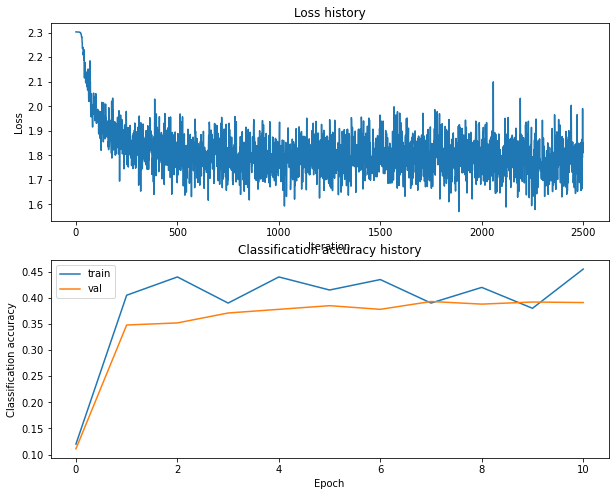

Training network with h_s 10, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.302623
iteration 100 / 2500: loss 2.302517
iteration 200 / 2500: loss 2.299220
iteration 300 / 2500: loss 2.266961
iteration 400 / 2500: loss 2.229566
iteration 500 / 2500: loss 2.158519
iteration 600 / 2500: loss 2.135670
iteration 700 / 2500: loss 2.016644
iteration 800 / 2500: loss 2.071408
iteration 900 / 2500: loss 2.010222
iteration 1000 / 2500: loss 2.068992
iteration 1100 / 2500: loss 1.928339
iteration 1200 / 2500: loss 1.958597
iteration 1300 / 2500: loss 1.961190
iteration 1400 / 2500: loss 1.985519
iteration 1500 / 2500: loss 1.951475
iteration 1600 / 2500: loss 1.851015
iteration 1700 / 2500: loss 1.908031
iteration 1800 / 2500: loss 1.951784
iteration 1900 / 2500: loss 1.926486
iteration 2000 / 2500: loss 1.875113
iteration 2100 / 2500: loss 1.893909
iteration 2200 / 2500: loss 1.833785
iteration 2300 / 2500: loss 1.849094
iteration 2400 / 2500: loss 1.827695
Validation accuracy:  0.328

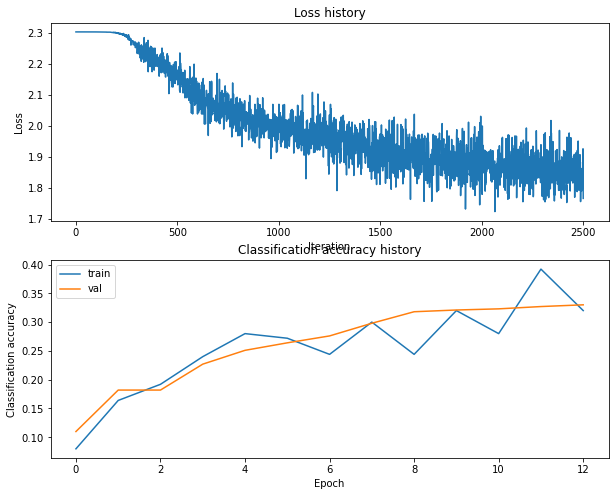

Training network with h_s 10, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.302615
iteration 100 / 2500: loss 1.926706
iteration 200 / 2500: loss 1.810223
iteration 300 / 2500: loss 1.853765
iteration 400 / 2500: loss 1.712159
iteration 500 / 2500: loss 1.837259
iteration 600 / 2500: loss 1.679133
iteration 700 / 2500: loss 1.747473
iteration 800 / 2500: loss 1.689936
iteration 900 / 2500: loss 1.689985
iteration 1000 / 2500: loss 1.787627
iteration 1100 / 2500: loss 1.760897
iteration 1200 / 2500: loss 1.894591
iteration 1300 / 2500: loss 1.666265
iteration 1400 / 2500: loss 1.770724
iteration 1500 / 2500: loss 1.681078
iteration 1600 / 2500: loss 1.792611
iteration 1700 / 2500: loss 1.724714
iteration 1800 / 2500: loss 1.621477
iteration 1900 / 2500: loss 1.773413
iteration 2000 / 2500: loss 1.741040
iteration 2100 / 2500: loss 1.736435
iteration 2200 / 2500: loss 1.684122
iteration 2300 / 2500: loss 1.852859
iteration 2400 / 2500: loss 1.709070
Validation accuracy:  0.398


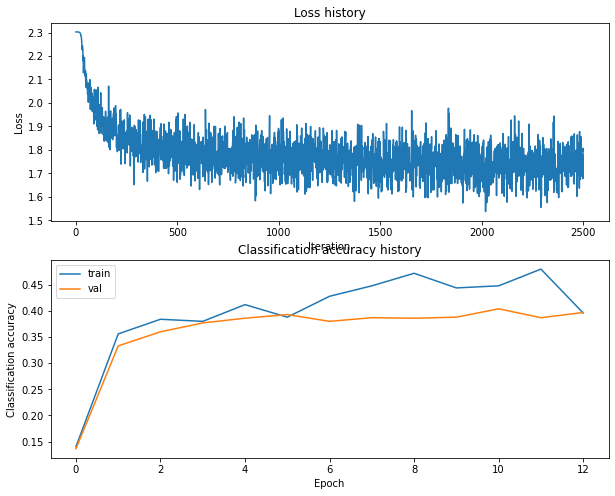

Training network with h_s 10, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.302630
iteration 100 / 2500: loss 2.302305
iteration 200 / 2500: loss 2.294879
iteration 300 / 2500: loss 2.215710
iteration 400 / 2500: loss 2.151155
iteration 500 / 2500: loss 2.082583
iteration 600 / 2500: loss 2.042375
iteration 700 / 2500: loss 2.004157
iteration 800 / 2500: loss 1.940684
iteration 900 / 2500: loss 1.988443
iteration 1000 / 2500: loss 2.004935
iteration 1100 / 2500: loss 1.892262
iteration 1200 / 2500: loss 1.880362
iteration 1300 / 2500: loss 1.934815
iteration 1400 / 2500: loss 1.915581
iteration 1500 / 2500: loss 1.883070
iteration 1600 / 2500: loss 1.819369
iteration 1700 / 2500: loss 1.854804
iteration 1800 / 2500: loss 1.884822
iteration 1900 / 2500: loss 1.856919
iteration 2000 / 2500: loss 1.829285
iteration 2100 / 2500: loss 1.856387
iteration 2200 / 2500: loss 1.859012
iteration 2300 / 2500: loss 1.866979
iteration 2400 / 2500: loss 1.818238
Validation accuracy:  0.368

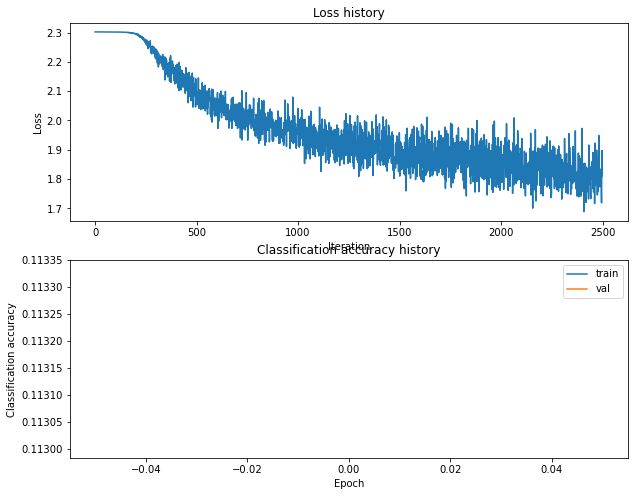

Training network with h_s 10, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.302612
iteration 100 / 2500: loss 1.987548
iteration 200 / 2500: loss 1.837706
iteration 300 / 2500: loss 1.794467
iteration 400 / 2500: loss 1.712772
iteration 500 / 2500: loss 1.748783
iteration 600 / 2500: loss 1.785573
iteration 700 / 2500: loss 1.734003
iteration 800 / 2500: loss 1.796250
iteration 900 / 2500: loss 1.753810
iteration 1000 / 2500: loss 1.694859
iteration 1100 / 2500: loss 1.671057
iteration 1200 / 2500: loss 1.729456
iteration 1300 / 2500: loss 1.849789
iteration 1400 / 2500: loss 1.905857
iteration 1500 / 2500: loss 1.658004
iteration 1600 / 2500: loss 1.788941
iteration 1700 / 2500: loss 1.811615
iteration 1800 / 2500: loss 1.684767
iteration 1900 / 2500: loss 1.741182
iteration 2000 / 2500: loss 1.760116
iteration 2100 / 2500: loss 1.753056
iteration 2200 / 2500: loss 1.643936
iteration 2300 / 2500: loss 1.692118
iteration 2400 / 2500: loss 1.771239
Validation accuracy:  0.413


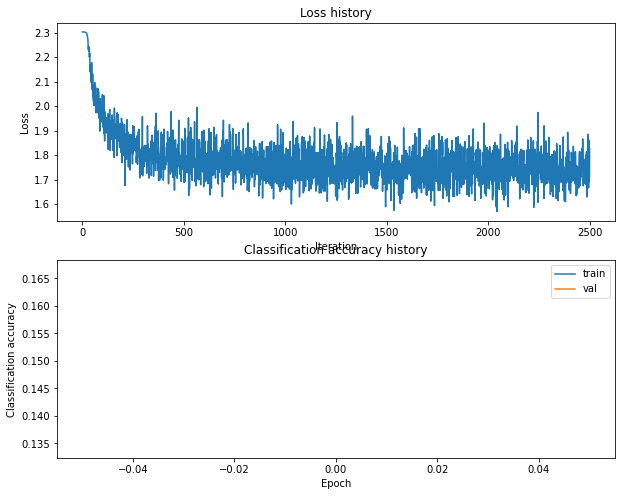

Training network with h_s 10, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.302624
iteration 100 / 2500: loss 2.302402
iteration 200 / 2500: loss 2.299079
iteration 300 / 2500: loss 2.244899
iteration 400 / 2500: loss 2.192677
iteration 500 / 2500: loss 2.144491
iteration 600 / 2500: loss 2.084431
iteration 700 / 2500: loss 2.055435
iteration 800 / 2500: loss 2.029514
iteration 900 / 2500: loss 1.979624
iteration 1000 / 2500: loss 1.983795
iteration 1100 / 2500: loss 1.963718
iteration 1200 / 2500: loss 1.974473
iteration 1300 / 2500: loss 1.950099
iteration 1400 / 2500: loss 1.925219
iteration 1500 / 2500: loss 1.940466
iteration 1600 / 2500: loss 1.924253
iteration 1700 / 2500: loss 1.952470
iteration 1800 / 2500: loss 1.947903
iteration 1900 / 2500: loss 1.924030
iteration 2000 / 2500: loss 1.937032
iteration 2100 / 2500: loss 1.847619
iteration 2200 / 2500: loss 1.955317
iteration 2300 / 2500: loss 1.922221
iteration 2400 / 2500: loss 1.960229
Validation accuracy:  0.321

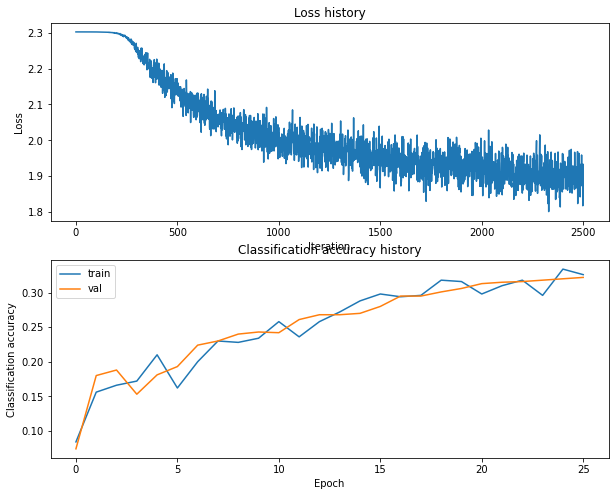

Training network with h_s 10, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.302622
iteration 100 / 2500: loss 1.974651
iteration 200 / 2500: loss 1.843775
iteration 300 / 2500: loss 1.831442
iteration 400 / 2500: loss 1.662036
iteration 500 / 2500: loss 1.832238
iteration 600 / 2500: loss 1.779236
iteration 700 / 2500: loss 1.786238
iteration 800 / 2500: loss 1.739146
iteration 900 / 2500: loss 1.770407
iteration 1000 / 2500: loss 1.821451
iteration 1100 / 2500: loss 1.759249
iteration 1200 / 2500: loss 1.682159
iteration 1300 / 2500: loss 1.778769
iteration 1400 / 2500: loss 1.709217
iteration 1500 / 2500: loss 1.744148
iteration 1600 / 2500: loss 1.854680
iteration 1700 / 2500: loss 1.718904
iteration 1800 / 2500: loss 1.708164
iteration 1900 / 2500: loss 1.695439
iteration 2000 / 2500: loss 1.781056
iteration 2100 / 2500: loss 1.675891
iteration 2200 / 2500: loss 1.728924
iteration 2300 / 2500: loss 1.828552
iteration 2400 / 2500: loss 1.740132
Validation accuracy:  0.403


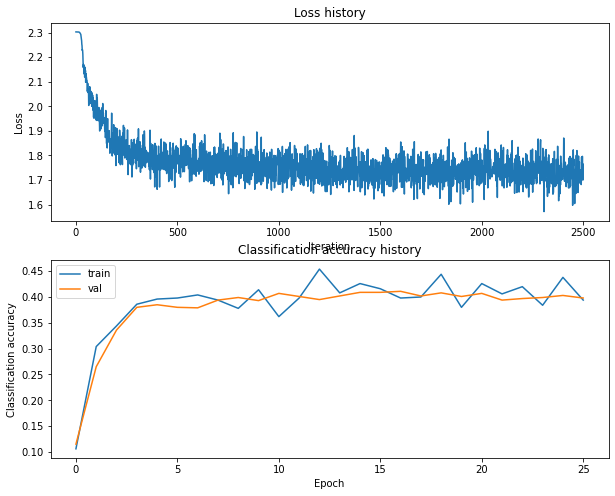

Training network with h_s 10, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.302622
iteration 100 / 5000: loss 2.302521
iteration 200 / 5000: loss 2.299209
iteration 300 / 5000: loss 2.250826
iteration 400 / 5000: loss 2.165131
iteration 500 / 5000: loss 2.026916
iteration 600 / 5000: loss 2.077411
iteration 700 / 5000: loss 2.078036
iteration 800 / 5000: loss 1.944060
iteration 900 / 5000: loss 2.090286
iteration 1000 / 5000: loss 2.028040
iteration 1100 / 5000: loss 1.976262
iteration 1200 / 5000: loss 1.900711
iteration 1300 / 5000: loss 1.952120
iteration 1400 / 5000: loss 1.819293
iteration 1500 / 5000: loss 1.912879
iteration 1600 / 5000: loss 1.867870
iteration 1700 / 5000: loss 1.987964
iteration 1800 / 5000: loss 1.952987
iteration 1900 / 5000: loss 1.958983
iteration 2000 / 5000: loss 1.856576
iteration 2100 / 5000: loss 1.766591
iteration 2200 / 5000: loss 1.788380
iteration 2300 / 5000: loss 1.822652
iteration 2400 / 5000: loss 1.830308
iteration 2500 / 5000: loss

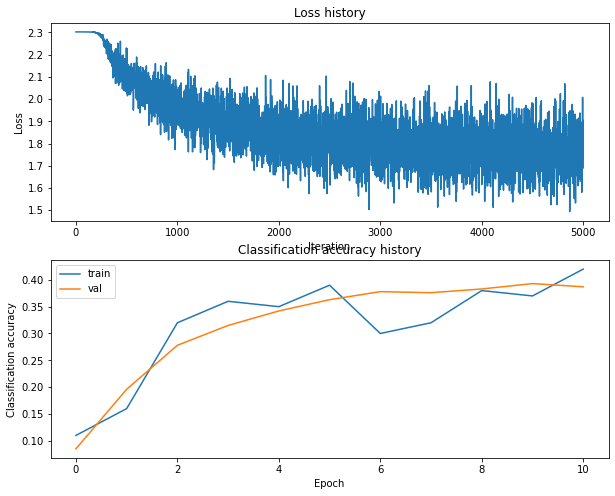

Training network with h_s 10, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.302613
iteration 100 / 5000: loss 1.902404
iteration 200 / 5000: loss 1.886823
iteration 300 / 5000: loss 1.808028
iteration 400 / 5000: loss 1.918152
iteration 500 / 5000: loss 1.752105
iteration 600 / 5000: loss 1.951662
iteration 700 / 5000: loss 1.830259
iteration 800 / 5000: loss 1.745964
iteration 900 / 5000: loss 1.798280
iteration 1000 / 5000: loss 1.874610
iteration 1100 / 5000: loss 2.009181
iteration 1200 / 5000: loss 1.731316
iteration 1300 / 5000: loss 1.721580
iteration 1400 / 5000: loss 1.946161
iteration 1500 / 5000: loss 1.704066
iteration 1600 / 5000: loss 1.744444
iteration 1700 / 5000: loss 1.827733
iteration 1800 / 5000: loss 1.773322
iteration 1900 / 5000: loss 1.921540
iteration 2000 / 5000: loss 1.705894
iteration 2100 / 5000: loss 1.661464
iteration 2200 / 5000: loss 1.698186
iteration 2300 / 5000: loss 1.578920
iteration 2400 / 5000: loss 1.781732
iteration 2500 / 5000: loss 

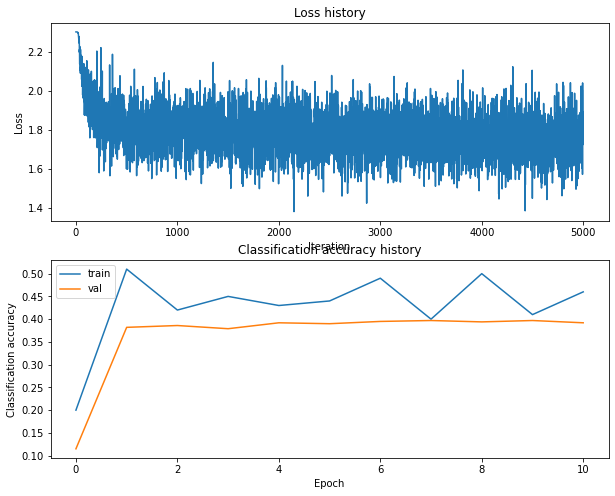

Training network with h_s 10, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.302627
iteration 100 / 5000: loss 2.302378
iteration 200 / 5000: loss 2.296159
iteration 300 / 5000: loss 2.229329
iteration 400 / 5000: loss 2.171250
iteration 500 / 5000: loss 2.088623
iteration 600 / 5000: loss 2.146035
iteration 700 / 5000: loss 2.006755
iteration 800 / 5000: loss 2.013339
iteration 900 / 5000: loss 1.940784
iteration 1000 / 5000: loss 1.935877
iteration 1100 / 5000: loss 2.007878
iteration 1200 / 5000: loss 1.946050
iteration 1300 / 5000: loss 1.964393
iteration 1400 / 5000: loss 1.950429
iteration 1500 / 5000: loss 1.997132
iteration 1600 / 5000: loss 1.947724
iteration 1700 / 5000: loss 1.963445
iteration 1800 / 5000: loss 1.946080
iteration 1900 / 5000: loss 1.931900
iteration 2000 / 5000: loss 1.894871
iteration 2100 / 5000: loss 1.900351
iteration 2200 / 5000: loss 1.867243
iteration 2300 / 5000: loss 1.846323
iteration 2400 / 5000: loss 1.969826
iteration 2500 / 5000: loss

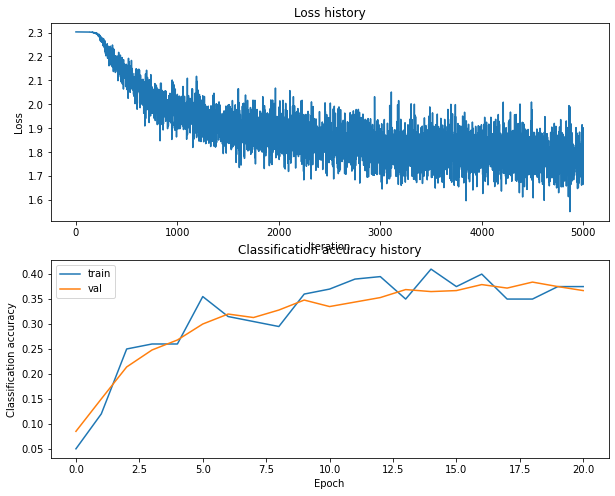

Training network with h_s 10, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.302620
iteration 100 / 5000: loss 2.002084
iteration 200 / 5000: loss 1.992878
iteration 300 / 5000: loss 1.875543
iteration 400 / 5000: loss 1.794784
iteration 500 / 5000: loss 1.753663
iteration 600 / 5000: loss 1.748767
iteration 700 / 5000: loss 1.683862
iteration 800 / 5000: loss 1.835076
iteration 900 / 5000: loss 1.670566
iteration 1000 / 5000: loss 1.900998
iteration 1100 / 5000: loss 1.759180
iteration 1200 / 5000: loss 1.696944
iteration 1300 / 5000: loss 1.877691
iteration 1400 / 5000: loss 1.788601
iteration 1500 / 5000: loss 1.747633
iteration 1600 / 5000: loss 1.682882
iteration 1700 / 5000: loss 1.849580
iteration 1800 / 5000: loss 1.688318
iteration 1900 / 5000: loss 1.744570
iteration 2000 / 5000: loss 1.794180
iteration 2100 / 5000: loss 1.761066
iteration 2200 / 5000: loss 1.799410
iteration 2300 / 5000: loss 1.856975
iteration 2400 / 5000: loss 1.656551
iteration 2500 / 5000: loss 

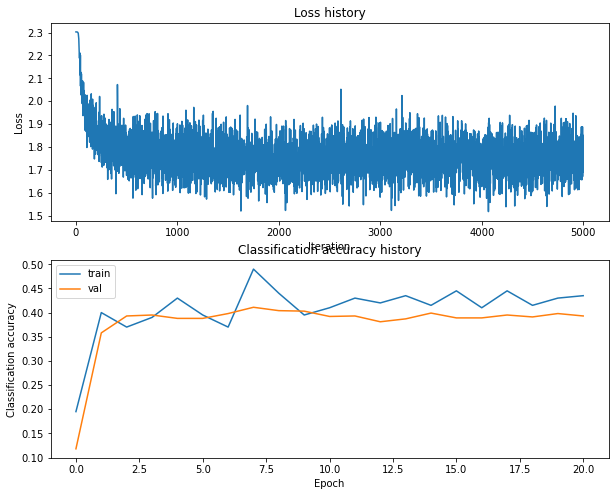

Training network with h_s 10, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.302620
iteration 100 / 5000: loss 2.302272
iteration 200 / 5000: loss 2.293303
iteration 300 / 5000: loss 2.211053
iteration 400 / 5000: loss 2.188962
iteration 500 / 5000: loss 2.161205
iteration 600 / 5000: loss 2.055643
iteration 700 / 5000: loss 2.011929
iteration 800 / 5000: loss 2.055947
iteration 900 / 5000: loss 1.935814
iteration 1000 / 5000: loss 1.992458
iteration 1100 / 5000: loss 1.948595
iteration 1200 / 5000: loss 1.945130
iteration 1300 / 5000: loss 2.010039
iteration 1400 / 5000: loss 1.936392
iteration 1500 / 5000: loss 1.894062
iteration 1600 / 5000: loss 1.826253
iteration 1700 / 5000: loss 1.858580
iteration 1800 / 5000: loss 2.062629
iteration 1900 / 5000: loss 1.866331
iteration 2000 / 5000: loss 1.917666
iteration 2100 / 5000: loss 1.804357
iteration 2200 / 5000: loss 1.927151
iteration 2300 / 5000: loss 1.923356
iteration 2400 / 5000: loss 1.909623
iteration 2500 / 5000: loss

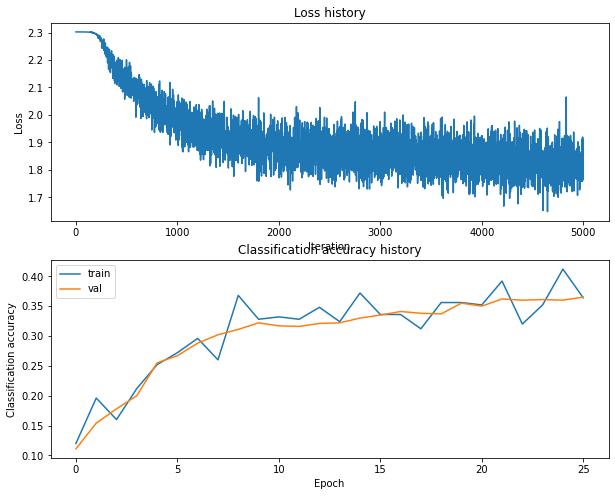

Training network with h_s 10, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.302623
iteration 100 / 5000: loss 1.968276
iteration 200 / 5000: loss 1.813920
iteration 300 / 5000: loss 1.866757
iteration 400 / 5000: loss 1.876737
iteration 500 / 5000: loss 1.835918
iteration 600 / 5000: loss 1.718128
iteration 700 / 5000: loss 1.750289
iteration 800 / 5000: loss 1.704154
iteration 900 / 5000: loss 1.726108
iteration 1000 / 5000: loss 1.767066
iteration 1100 / 5000: loss 1.827846
iteration 1200 / 5000: loss 1.729096
iteration 1300 / 5000: loss 1.756475
iteration 1400 / 5000: loss 1.765899
iteration 1500 / 5000: loss 1.718941
iteration 1600 / 5000: loss 1.739942
iteration 1700 / 5000: loss 1.823758
iteration 1800 / 5000: loss 1.715525
iteration 1900 / 5000: loss 1.765759
iteration 2000 / 5000: loss 1.620269
iteration 2100 / 5000: loss 1.675545
iteration 2200 / 5000: loss 1.807915
iteration 2300 / 5000: loss 1.740380
iteration 2400 / 5000: loss 1.807803
iteration 2500 / 5000: loss 

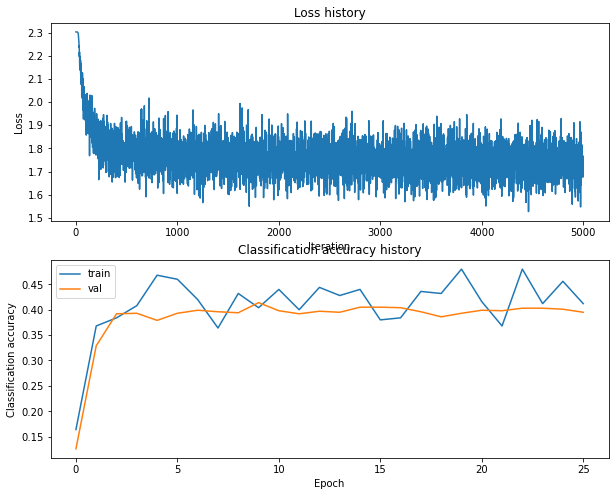

Training network with h_s 10, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.302629
iteration 100 / 5000: loss 2.302387
iteration 200 / 5000: loss 2.296215
iteration 300 / 5000: loss 2.226693
iteration 400 / 5000: loss 2.143400
iteration 500 / 5000: loss 2.127427
iteration 600 / 5000: loss 2.026337
iteration 700 / 5000: loss 2.032919
iteration 800 / 5000: loss 2.042593
iteration 900 / 5000: loss 2.056758
iteration 1000 / 5000: loss 1.887662
iteration 1100 / 5000: loss 1.931533
iteration 1200 / 5000: loss 1.925294
iteration 1300 / 5000: loss 1.831597
iteration 1400 / 5000: loss 1.899618
iteration 1500 / 5000: loss 1.940951
iteration 1600 / 5000: loss 1.814313
iteration 1700 / 5000: loss 1.882559
iteration 1800 / 5000: loss 1.895791
iteration 1900 / 5000: loss 1.821213
iteration 2000 / 5000: loss 1.805729
iteration 2100 / 5000: loss 1.888619
iteration 2200 / 5000: loss 1.803734
iteration 2300 / 5000: loss 1.801399
iteration 2400 / 5000: loss 1.787880
iteration 2500 / 5000: loss

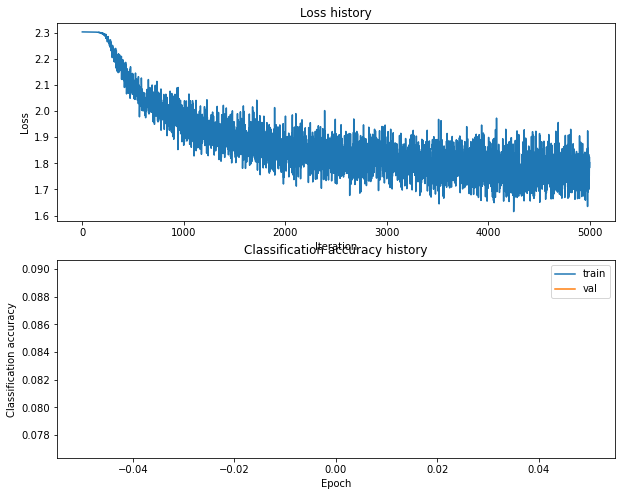

Training network with h_s 10, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.302625
iteration 100 / 5000: loss 1.978971
iteration 200 / 5000: loss 1.863813
iteration 300 / 5000: loss 1.821786
iteration 400 / 5000: loss 1.789145
iteration 500 / 5000: loss 1.830106
iteration 600 / 5000: loss 1.751578
iteration 700 / 5000: loss 1.751183
iteration 800 / 5000: loss 1.694384
iteration 900 / 5000: loss 1.807359
iteration 1000 / 5000: loss 1.732362
iteration 1100 / 5000: loss 1.837489
iteration 1200 / 5000: loss 1.697007
iteration 1300 / 5000: loss 1.916198
iteration 1400 / 5000: loss 1.761966
iteration 1500 / 5000: loss 1.780392
iteration 1600 / 5000: loss 1.831865
iteration 1700 / 5000: loss 1.835005
iteration 1800 / 5000: loss 1.849573
iteration 1900 / 5000: loss 1.792810
iteration 2000 / 5000: loss 1.800954
iteration 2100 / 5000: loss 1.856448
iteration 2200 / 5000: loss 1.734083
iteration 2300 / 5000: loss 1.851647
iteration 2400 / 5000: loss 1.762394
iteration 2500 / 5000: loss 

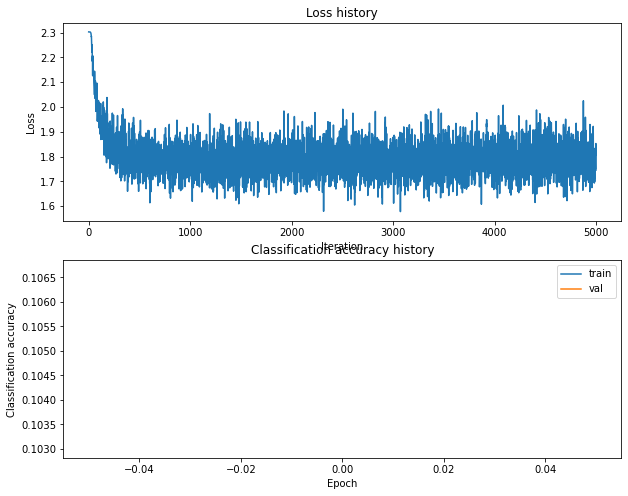

Training network with h_s 10, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.302636
iteration 100 / 5000: loss 2.302540
iteration 200 / 5000: loss 2.300847
iteration 300 / 5000: loss 2.271886
iteration 400 / 5000: loss 2.206346
iteration 500 / 5000: loss 2.115826
iteration 600 / 5000: loss 2.105610
iteration 700 / 5000: loss 2.035944
iteration 800 / 5000: loss 2.034207
iteration 900 / 5000: loss 2.000612
iteration 1000 / 5000: loss 1.979876
iteration 1100 / 5000: loss 1.965451
iteration 1200 / 5000: loss 1.954225
iteration 1300 / 5000: loss 1.917669
iteration 1400 / 5000: loss 1.915960
iteration 1500 / 5000: loss 1.919910
iteration 1600 / 5000: loss 1.918081
iteration 1700 / 5000: loss 1.935720
iteration 1800 / 5000: loss 1.919865
iteration 1900 / 5000: loss 1.912766
iteration 2000 / 5000: loss 1.920431
iteration 2100 / 5000: loss 1.835413
iteration 2200 / 5000: loss 1.811001
iteration 2300 / 5000: loss 1.874027
iteration 2400 / 5000: loss 1.876431
iteration 2500 / 5000: loss

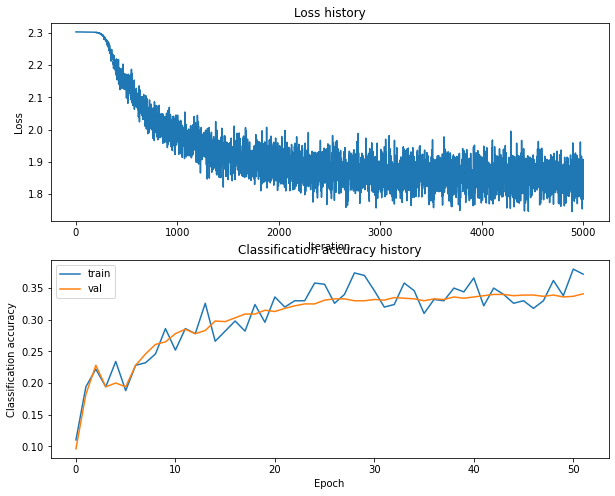

Training network with h_s 10, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.302624
iteration 100 / 5000: loss 1.947604
iteration 200 / 5000: loss 1.933696
iteration 300 / 5000: loss 1.832019
iteration 400 / 5000: loss 1.867270
iteration 500 / 5000: loss 1.782054
iteration 600 / 5000: loss 1.750668
iteration 700 / 5000: loss 1.785035
iteration 800 / 5000: loss 1.734396
iteration 900 / 5000: loss 1.761323
iteration 1000 / 5000: loss 1.778310
iteration 1100 / 5000: loss 1.747454
iteration 1200 / 5000: loss 1.675866
iteration 1300 / 5000: loss 1.789084
iteration 1400 / 5000: loss 1.705106
iteration 1500 / 5000: loss 1.765845
iteration 1600 / 5000: loss 1.769529
iteration 1700 / 5000: loss 1.750378
iteration 1800 / 5000: loss 1.733188
iteration 1900 / 5000: loss 1.748917
iteration 2000 / 5000: loss 1.737178
iteration 2100 / 5000: loss 1.737059
iteration 2200 / 5000: loss 1.743909
iteration 2300 / 5000: loss 1.704550
iteration 2400 / 5000: loss 1.737397
iteration 2500 / 5000: loss 

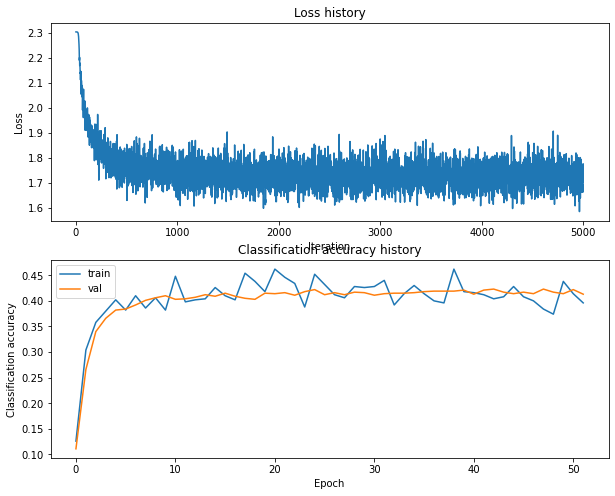

Training network with h_s 10, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.302621
iteration 100 / 10000: loss 2.302511
iteration 200 / 10000: loss 2.299928
iteration 300 / 10000: loss 2.245303
iteration 400 / 10000: loss 2.218805
iteration 500 / 10000: loss 2.052494
iteration 600 / 10000: loss 1.964730
iteration 700 / 10000: loss 2.140602
iteration 800 / 10000: loss 1.942823
iteration 900 / 10000: loss 1.881824
iteration 1000 / 10000: loss 1.913821
iteration 1100 / 10000: loss 1.936275
iteration 1200 / 10000: loss 1.967557
iteration 1300 / 10000: loss 1.837104
iteration 1400 / 10000: loss 1.813718
iteration 1500 / 10000: loss 1.938686
iteration 1600 / 10000: loss 2.027302
iteration 1700 / 10000: loss 1.843377
iteration 1800 / 10000: loss 1.940547
iteration 1900 / 10000: loss 1.863402
iteration 2000 / 10000: loss 1.688061
iteration 2100 / 10000: loss 1.883222
iteration 2200 / 10000: loss 1.743529
iteration 2300 / 10000: loss 1.801039
iteration 2400 / 10000: loss 1.879980
i

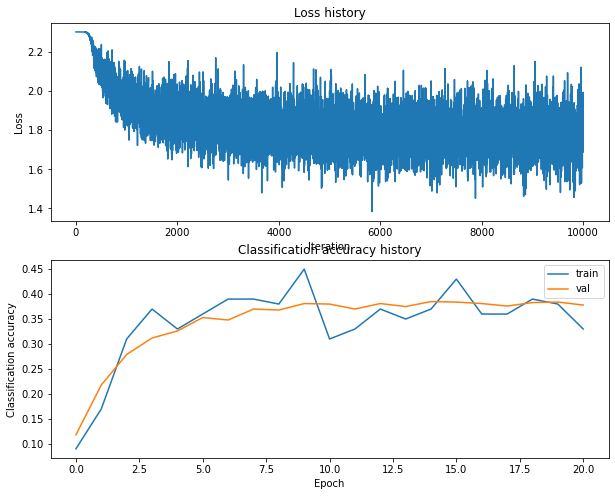

Training network with h_s 10, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.302635
iteration 100 / 10000: loss 2.022551
iteration 200 / 10000: loss 1.860447
iteration 300 / 10000: loss 1.733337
iteration 400 / 10000: loss 1.991850
iteration 500 / 10000: loss 1.941069
iteration 600 / 10000: loss 1.801033
iteration 700 / 10000: loss 1.695417
iteration 800 / 10000: loss 1.874807
iteration 900 / 10000: loss 1.732692
iteration 1000 / 10000: loss 1.802584
iteration 1100 / 10000: loss 1.878776
iteration 1200 / 10000: loss 1.917396
iteration 1300 / 10000: loss 1.912887
iteration 1400 / 10000: loss 1.830716
iteration 1500 / 10000: loss 2.042299
iteration 1600 / 10000: loss 1.802611
iteration 1700 / 10000: loss 1.742275
iteration 1800 / 10000: loss 1.819449
iteration 1900 / 10000: loss 1.865225
iteration 2000 / 10000: loss 1.805464
iteration 2100 / 10000: loss 1.744175
iteration 2200 / 10000: loss 1.928685
iteration 2300 / 10000: loss 1.834298
iteration 2400 / 10000: loss 1.606277
it

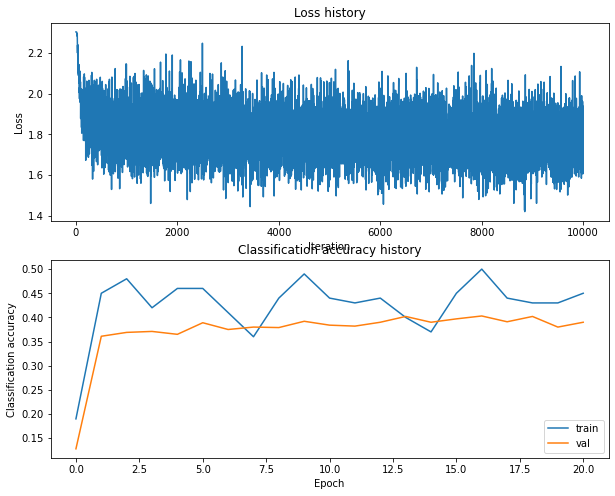

Training network with h_s 10, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.302626
iteration 100 / 10000: loss 2.302238
iteration 200 / 10000: loss 2.292922
iteration 300 / 10000: loss 2.225341
iteration 400 / 10000: loss 2.169598
iteration 500 / 10000: loss 2.076230
iteration 600 / 10000: loss 2.022861
iteration 700 / 10000: loss 2.090310
iteration 800 / 10000: loss 2.012555
iteration 900 / 10000: loss 1.986059
iteration 1000 / 10000: loss 1.981221
iteration 1100 / 10000: loss 1.892247
iteration 1200 / 10000: loss 2.018080
iteration 1300 / 10000: loss 1.906690
iteration 1400 / 10000: loss 1.872966
iteration 1500 / 10000: loss 1.892006
iteration 1600 / 10000: loss 1.891700
iteration 1700 / 10000: loss 1.822108
iteration 1800 / 10000: loss 1.946945
iteration 1900 / 10000: loss 1.923128
iteration 2000 / 10000: loss 1.897274
iteration 2100 / 10000: loss 1.797483
iteration 2200 / 10000: loss 1.782590
iteration 2300 / 10000: loss 1.857529
iteration 2400 / 10000: loss 1.698755
i

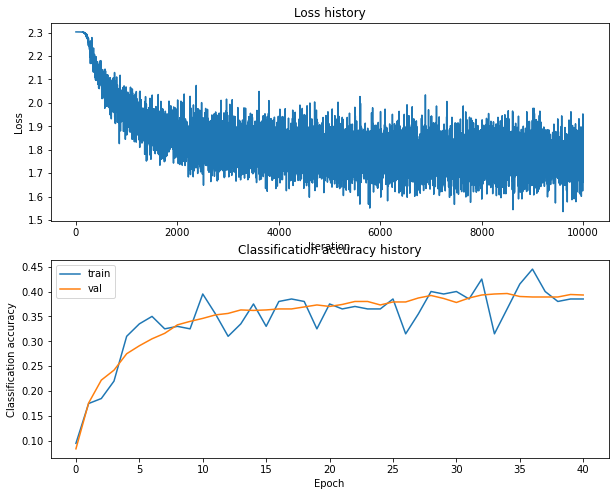

Training network with h_s 10, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.302625
iteration 100 / 10000: loss 1.932642
iteration 200 / 10000: loss 1.779859
iteration 300 / 10000: loss 1.839317
iteration 400 / 10000: loss 1.858498
iteration 500 / 10000: loss 1.630764
iteration 600 / 10000: loss 1.810873
iteration 700 / 10000: loss 1.814522
iteration 800 / 10000: loss 1.959708
iteration 900 / 10000: loss 1.665170
iteration 1000 / 10000: loss 1.656532
iteration 1100 / 10000: loss 1.696916
iteration 1200 / 10000: loss 1.822917
iteration 1300 / 10000: loss 1.716654
iteration 1400 / 10000: loss 1.759697
iteration 1500 / 10000: loss 1.717043
iteration 1600 / 10000: loss 1.713414
iteration 1700 / 10000: loss 1.664956
iteration 1800 / 10000: loss 1.788277
iteration 1900 / 10000: loss 1.722275
iteration 2000 / 10000: loss 1.715425
iteration 2100 / 10000: loss 1.756052
iteration 2200 / 10000: loss 1.942622
iteration 2300 / 10000: loss 1.858488
iteration 2400 / 10000: loss 1.701139
it

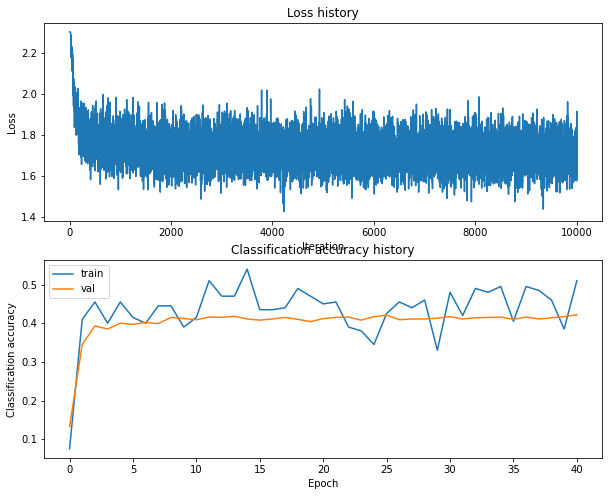

Training network with h_s 10, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.302637
iteration 100 / 10000: loss 2.302491
iteration 200 / 10000: loss 2.296939
iteration 300 / 10000: loss 2.250332
iteration 400 / 10000: loss 2.194905
iteration 500 / 10000: loss 2.139442
iteration 600 / 10000: loss 2.122588
iteration 700 / 10000: loss 2.018453
iteration 800 / 10000: loss 2.096584
iteration 900 / 10000: loss 2.010421
iteration 1000 / 10000: loss 2.001290
iteration 1100 / 10000: loss 1.928526
iteration 1200 / 10000: loss 2.026870
iteration 1300 / 10000: loss 1.943081
iteration 1400 / 10000: loss 1.936372
iteration 1500 / 10000: loss 1.877800
iteration 1600 / 10000: loss 1.794536
iteration 1700 / 10000: loss 1.888209
iteration 1800 / 10000: loss 1.859089
iteration 1900 / 10000: loss 1.851240
iteration 2000 / 10000: loss 1.761455
iteration 2100 / 10000: loss 1.943865
iteration 2200 / 10000: loss 1.832123
iteration 2300 / 10000: loss 1.875974
iteration 2400 / 10000: loss 1.918995
i

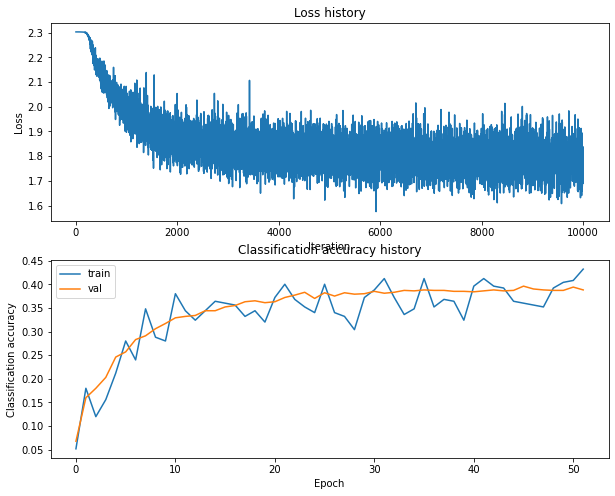

Training network with h_s 10, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.302627
iteration 100 / 10000: loss 1.975275
iteration 200 / 10000: loss 1.862989
iteration 300 / 10000: loss 1.815101
iteration 400 / 10000: loss 1.854064
iteration 500 / 10000: loss 1.868900
iteration 600 / 10000: loss 1.770325
iteration 700 / 10000: loss 1.817415
iteration 800 / 10000: loss 1.787019
iteration 900 / 10000: loss 1.910303
iteration 1000 / 10000: loss 1.810107
iteration 1100 / 10000: loss 1.820690
iteration 1200 / 10000: loss 1.733996
iteration 1300 / 10000: loss 1.720644
iteration 1400 / 10000: loss 1.658484
iteration 1500 / 10000: loss 1.762835
iteration 1600 / 10000: loss 1.706612
iteration 1700 / 10000: loss 1.761708
iteration 1800 / 10000: loss 1.870678
iteration 1900 / 10000: loss 1.863986
iteration 2000 / 10000: loss 1.785682
iteration 2100 / 10000: loss 1.710822
iteration 2200 / 10000: loss 1.747278
iteration 2300 / 10000: loss 1.794047
iteration 2400 / 10000: loss 1.800295
it

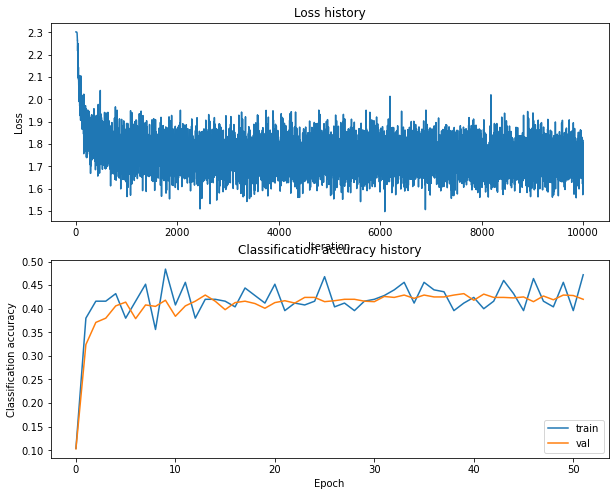

Training network with h_s 10, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.302625
iteration 100 / 10000: loss 2.302488
iteration 200 / 10000: loss 2.299387
iteration 300 / 10000: loss 2.254242
iteration 400 / 10000: loss 2.143789
iteration 500 / 10000: loss 2.110306
iteration 600 / 10000: loss 2.072328
iteration 700 / 10000: loss 2.051014
iteration 800 / 10000: loss 1.981735
iteration 900 / 10000: loss 2.023555
iteration 1000 / 10000: loss 1.979197
iteration 1100 / 10000: loss 1.926938
iteration 1200 / 10000: loss 1.872038
iteration 1300 / 10000: loss 1.911090
iteration 1400 / 10000: loss 1.813877
iteration 1500 / 10000: loss 1.889160
iteration 1600 / 10000: loss 1.882721
iteration 1700 / 10000: loss 1.881359
iteration 1800 / 10000: loss 1.815581
iteration 1900 / 10000: loss 1.928210
iteration 2000 / 10000: loss 1.874892
iteration 2100 / 10000: loss 1.842738
iteration 2200 / 10000: loss 1.823708
iteration 2300 / 10000: loss 1.894327
iteration 2400 / 10000: loss 1.886292
i

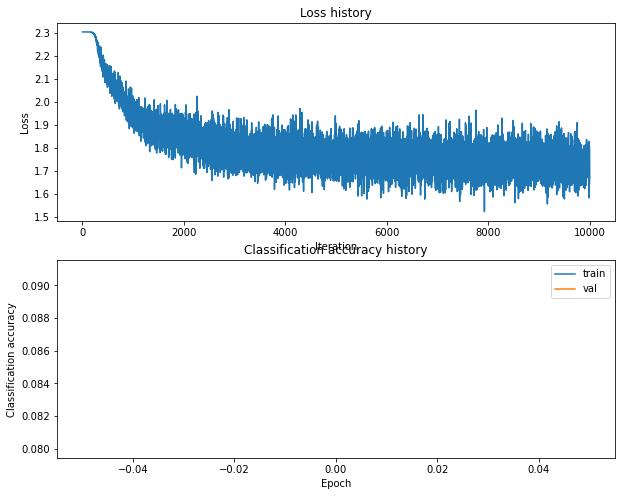

Training network with h_s 10, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.302624
iteration 100 / 10000: loss 1.901793
iteration 200 / 10000: loss 1.879667
iteration 300 / 10000: loss 1.808305
iteration 400 / 10000: loss 1.653964
iteration 500 / 10000: loss 1.721240
iteration 600 / 10000: loss 1.822207
iteration 700 / 10000: loss 1.757750
iteration 800 / 10000: loss 1.811979
iteration 900 / 10000: loss 1.692771
iteration 1000 / 10000: loss 1.810759
iteration 1100 / 10000: loss 1.702153
iteration 1200 / 10000: loss 1.751445
iteration 1300 / 10000: loss 1.698399
iteration 1400 / 10000: loss 1.846785
iteration 1500 / 10000: loss 1.794343
iteration 1600 / 10000: loss 1.746967
iteration 1700 / 10000: loss 1.899922
iteration 1800 / 10000: loss 1.773389
iteration 1900 / 10000: loss 1.907678
iteration 2000 / 10000: loss 1.878246
iteration 2100 / 10000: loss 1.750668
iteration 2200 / 10000: loss 1.797125
iteration 2300 / 10000: loss 1.828062
iteration 2400 / 10000: loss 1.762970
it

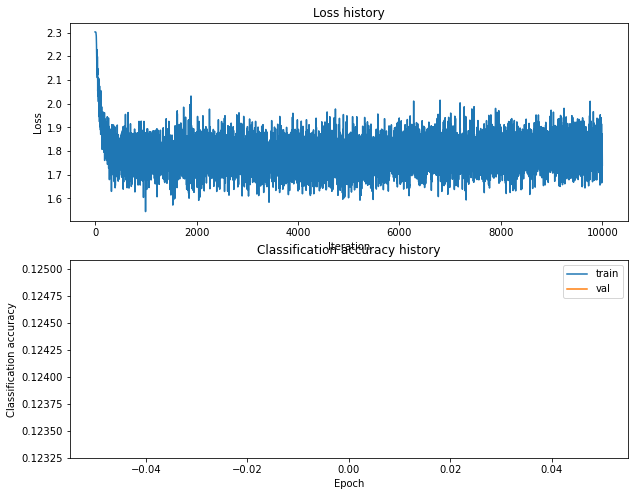

Training network with h_s 10, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.302623
iteration 100 / 10000: loss 2.302405
iteration 200 / 10000: loss 2.298423
iteration 300 / 10000: loss 2.251063
iteration 400 / 10000: loss 2.143868
iteration 500 / 10000: loss 2.155397
iteration 600 / 10000: loss 2.090763
iteration 700 / 10000: loss 2.063169
iteration 800 / 10000: loss 1.997196
iteration 900 / 10000: loss 2.016452
iteration 1000 / 10000: loss 2.029436
iteration 1100 / 10000: loss 1.982288
iteration 1200 / 10000: loss 1.994124
iteration 1300 / 10000: loss 2.011802
iteration 1400 / 10000: loss 1.929178
iteration 1500 / 10000: loss 1.923807
iteration 1600 / 10000: loss 1.940632
iteration 1700 / 10000: loss 1.906645
iteration 1800 / 10000: loss 1.983529
iteration 1900 / 10000: loss 1.887474
iteration 2000 / 10000: loss 1.966031
iteration 2100 / 10000: loss 1.901407
iteration 2200 / 10000: loss 1.944643
iteration 2300 / 10000: loss 1.997834
iteration 2400 / 10000: loss 1.920485
i

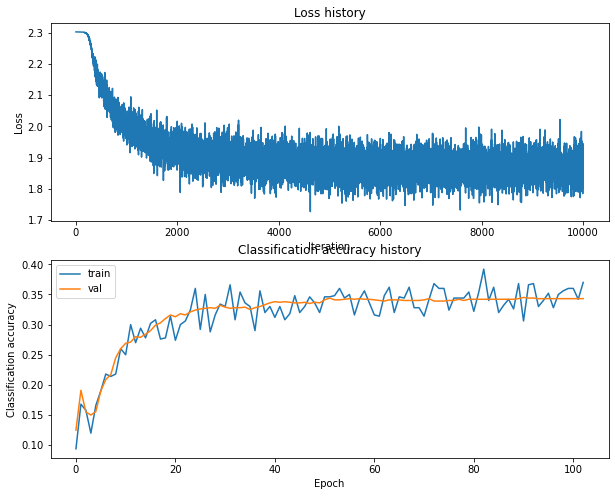

Training network with h_s 10, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.302606
iteration 100 / 10000: loss 2.001613
iteration 200 / 10000: loss 1.922732
iteration 300 / 10000: loss 1.791247
iteration 400 / 10000: loss 1.731049
iteration 500 / 10000: loss 1.745206
iteration 600 / 10000: loss 1.705593
iteration 700 / 10000: loss 1.844783
iteration 800 / 10000: loss 1.837472
iteration 900 / 10000: loss 1.699154
iteration 1000 / 10000: loss 1.839997
iteration 1100 / 10000: loss 1.821400
iteration 1200 / 10000: loss 1.755077
iteration 1300 / 10000: loss 1.837987
iteration 1400 / 10000: loss 1.762219
iteration 1500 / 10000: loss 1.727370
iteration 1600 / 10000: loss 1.820835
iteration 1700 / 10000: loss 1.712299
iteration 1800 / 10000: loss 1.722088
iteration 1900 / 10000: loss 1.734181
iteration 2000 / 10000: loss 1.723347
iteration 2100 / 10000: loss 1.728531
iteration 2200 / 10000: loss 1.737706
iteration 2300 / 10000: loss 1.734491
iteration 2400 / 10000: loss 1.735678
it

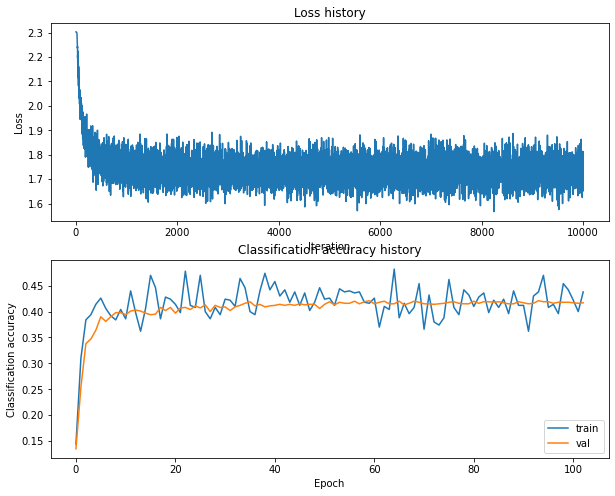

Training network with h_s 10, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.302625
iteration 100 / 15000: loss 2.302504
iteration 200 / 15000: loss 2.298433
iteration 300 / 15000: loss 2.254947
iteration 400 / 15000: loss 2.188341
iteration 500 / 15000: loss 2.168585
iteration 600 / 15000: loss 2.016047
iteration 700 / 15000: loss 2.080962
iteration 800 / 15000: loss 1.991899
iteration 900 / 15000: loss 2.022519
iteration 1000 / 15000: loss 2.067009
iteration 1100 / 15000: loss 1.935169
iteration 1200 / 15000: loss 2.092003
iteration 1300 / 15000: loss 1.799822
iteration 1400 / 15000: loss 1.880026
iteration 1500 / 15000: loss 1.979038
iteration 1600 / 15000: loss 1.842428
iteration 1700 / 15000: loss 1.772151
iteration 1800 / 15000: loss 1.781567
iteration 1900 / 15000: loss 1.849185
iteration 2000 / 15000: loss 1.843881
iteration 2100 / 15000: loss 1.799296
iteration 2200 / 15000: loss 1.838308
iteration 2300 / 15000: loss 1.821298
iteration 2400 / 15000: loss 1.784802
i

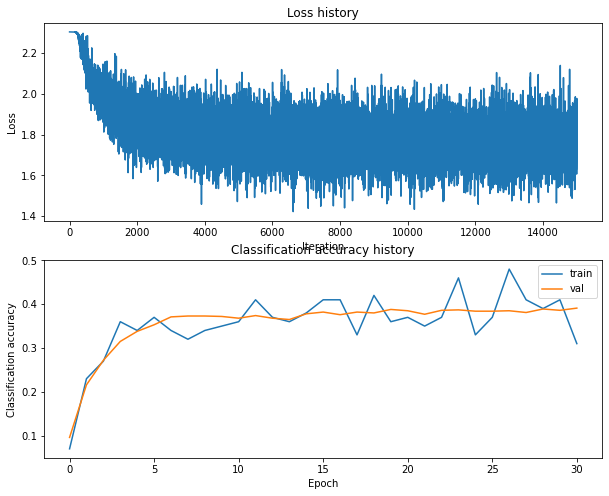

Training network with h_s 10, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.302629
iteration 100 / 15000: loss 2.086687
iteration 200 / 15000: loss 1.936511
iteration 300 / 15000: loss 1.899018
iteration 400 / 15000: loss 1.736416
iteration 500 / 15000: loss 1.780417
iteration 600 / 15000: loss 1.829362
iteration 700 / 15000: loss 1.781240
iteration 800 / 15000: loss 1.790018
iteration 900 / 15000: loss 1.714478
iteration 1000 / 15000: loss 1.861567
iteration 1100 / 15000: loss 1.722014
iteration 1200 / 15000: loss 1.860287
iteration 1300 / 15000: loss 1.737004
iteration 1400 / 15000: loss 2.055258
iteration 1500 / 15000: loss 1.799450
iteration 1600 / 15000: loss 2.046828
iteration 1700 / 15000: loss 1.887570
iteration 1800 / 15000: loss 1.677266
iteration 1900 / 15000: loss 1.859951
iteration 2000 / 15000: loss 1.800236
iteration 2100 / 15000: loss 1.699440
iteration 2200 / 15000: loss 1.862582
iteration 2300 / 15000: loss 1.904432
iteration 2400 / 15000: loss 1.756685
it

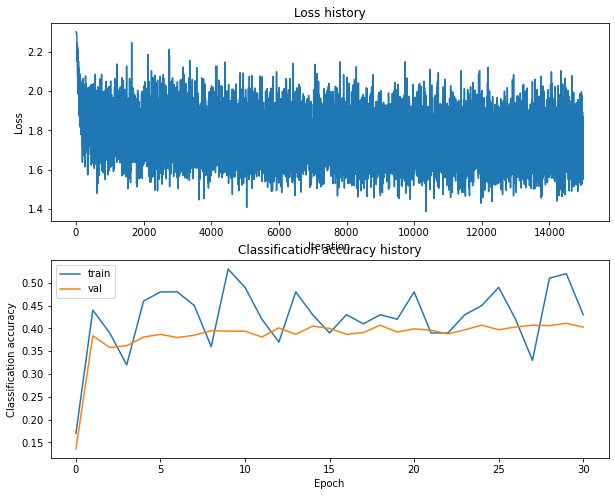

Training network with h_s 10, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.302619
iteration 100 / 15000: loss 2.302427
iteration 200 / 15000: loss 2.298726
iteration 300 / 15000: loss 2.252708
iteration 400 / 15000: loss 2.189030
iteration 500 / 15000: loss 2.098088
iteration 600 / 15000: loss 2.068289
iteration 700 / 15000: loss 2.121696
iteration 800 / 15000: loss 2.031168
iteration 900 / 15000: loss 1.994996
iteration 1000 / 15000: loss 1.877012
iteration 1100 / 15000: loss 2.004120
iteration 1200 / 15000: loss 1.966933
iteration 1300 / 15000: loss 1.815966
iteration 1400 / 15000: loss 1.802302
iteration 1500 / 15000: loss 1.914680
iteration 1600 / 15000: loss 1.885352
iteration 1700 / 15000: loss 1.829613
iteration 1800 / 15000: loss 1.986438
iteration 1900 / 15000: loss 1.848194
iteration 2000 / 15000: loss 1.906949
iteration 2100 / 15000: loss 1.823347
iteration 2200 / 15000: loss 1.879507
iteration 2300 / 15000: loss 1.863240
iteration 2400 / 15000: loss 1.774402
i

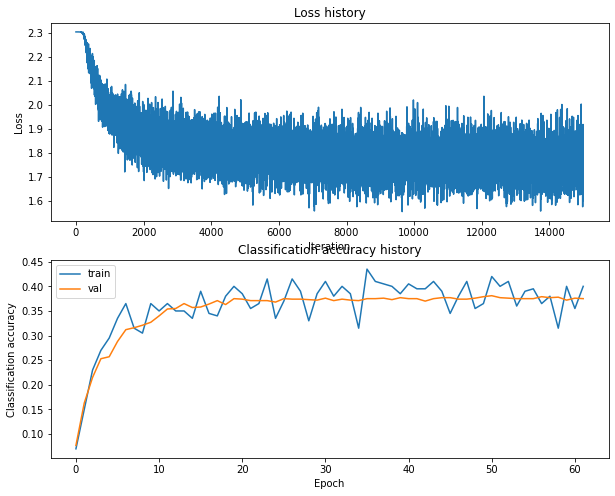

Training network with h_s 10, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.302631
iteration 100 / 15000: loss 1.987482
iteration 200 / 15000: loss 1.895780
iteration 300 / 15000: loss 1.841336
iteration 400 / 15000: loss 1.840248
iteration 500 / 15000: loss 1.780914
iteration 600 / 15000: loss 1.865975
iteration 700 / 15000: loss 1.822495
iteration 800 / 15000: loss 1.884953
iteration 900 / 15000: loss 1.726675
iteration 1000 / 15000: loss 1.801309
iteration 1100 / 15000: loss 1.653873
iteration 1200 / 15000: loss 1.624268
iteration 1300 / 15000: loss 1.704598
iteration 1400 / 15000: loss 1.711816
iteration 1500 / 15000: loss 1.721141
iteration 1600 / 15000: loss 1.816887
iteration 1700 / 15000: loss 1.720766
iteration 1800 / 15000: loss 1.777277
iteration 1900 / 15000: loss 1.687720
iteration 2000 / 15000: loss 1.768627
iteration 2100 / 15000: loss 1.923494
iteration 2200 / 15000: loss 1.709915
iteration 2300 / 15000: loss 1.773070
iteration 2400 / 15000: loss 1.815317
it

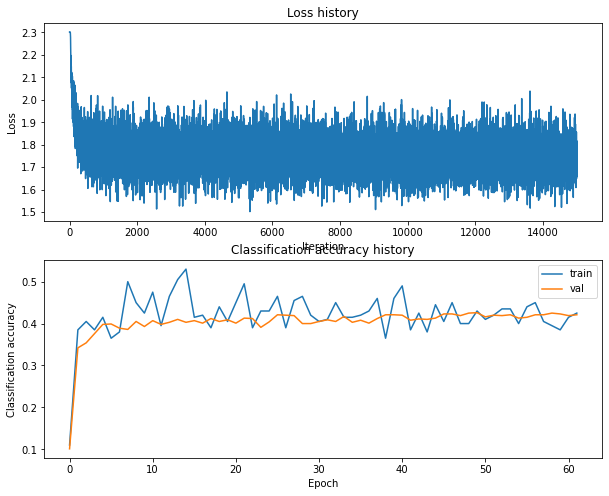

Training network with h_s 10, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.302618
iteration 100 / 15000: loss 2.302522
iteration 200 / 15000: loss 2.300043
iteration 300 / 15000: loss 2.257585
iteration 400 / 15000: loss 2.167067
iteration 500 / 15000: loss 2.060472
iteration 600 / 15000: loss 2.066612
iteration 700 / 15000: loss 2.064316
iteration 800 / 15000: loss 2.042445
iteration 900 / 15000: loss 2.039906
iteration 1000 / 15000: loss 1.979354
iteration 1100 / 15000: loss 2.005907
iteration 1200 / 15000: loss 1.932052
iteration 1300 / 15000: loss 1.907939
iteration 1400 / 15000: loss 1.886809
iteration 1500 / 15000: loss 1.860137
iteration 1600 / 15000: loss 1.939908
iteration 1700 / 15000: loss 1.959190
iteration 1800 / 15000: loss 1.915581
iteration 1900 / 15000: loss 1.911847
iteration 2000 / 15000: loss 1.866748
iteration 2100 / 15000: loss 1.917167
iteration 2200 / 15000: loss 1.846632
iteration 2300 / 15000: loss 1.860697
iteration 2400 / 15000: loss 1.830582
i

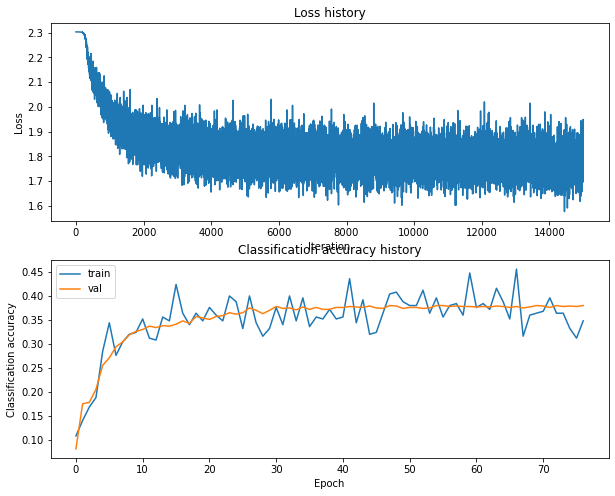

Training network with h_s 10, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.302615
iteration 100 / 15000: loss 1.930278
iteration 200 / 15000: loss 1.892600
iteration 300 / 15000: loss 1.843098
iteration 400 / 15000: loss 1.800742
iteration 500 / 15000: loss 1.765191
iteration 600 / 15000: loss 1.753467
iteration 700 / 15000: loss 1.796917
iteration 800 / 15000: loss 1.799635
iteration 900 / 15000: loss 1.750906
iteration 1000 / 15000: loss 1.663621
iteration 1100 / 15000: loss 1.765880
iteration 1200 / 15000: loss 1.659186
iteration 1300 / 15000: loss 1.660844
iteration 1400 / 15000: loss 1.674176
iteration 1500 / 15000: loss 1.808792
iteration 1600 / 15000: loss 1.780916
iteration 1700 / 15000: loss 1.733088
iteration 1800 / 15000: loss 1.782926
iteration 1900 / 15000: loss 1.796232
iteration 2000 / 15000: loss 1.668539
iteration 2100 / 15000: loss 1.788465
iteration 2200 / 15000: loss 1.799697
iteration 2300 / 15000: loss 1.751751
iteration 2400 / 15000: loss 1.844275
it

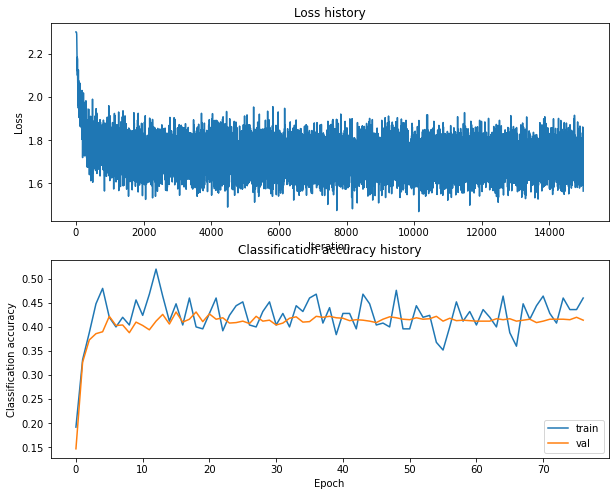

Training network with h_s 10, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.302626
iteration 100 / 15000: loss 2.302446
iteration 200 / 15000: loss 2.298694
iteration 300 / 15000: loss 2.233637
iteration 400 / 15000: loss 2.128901
iteration 500 / 15000: loss 2.106906
iteration 600 / 15000: loss 2.117736
iteration 700 / 15000: loss 1.958415
iteration 800 / 15000: loss 1.958981
iteration 900 / 15000: loss 1.953387
iteration 1000 / 15000: loss 1.985392
iteration 1100 / 15000: loss 1.933869
iteration 1200 / 15000: loss 1.897052
iteration 1300 / 15000: loss 1.920398
iteration 1400 / 15000: loss 1.922280
iteration 1500 / 15000: loss 1.860510
iteration 1600 / 15000: loss 1.806431
iteration 1700 / 15000: loss 1.897644
iteration 1800 / 15000: loss 1.876018
iteration 1900 / 15000: loss 1.822571
iteration 2000 / 15000: loss 1.832356
iteration 2100 / 15000: loss 1.854985
iteration 2200 / 15000: loss 1.905794
iteration 2300 / 15000: loss 1.815535
iteration 2400 / 15000: loss 1.811466
i

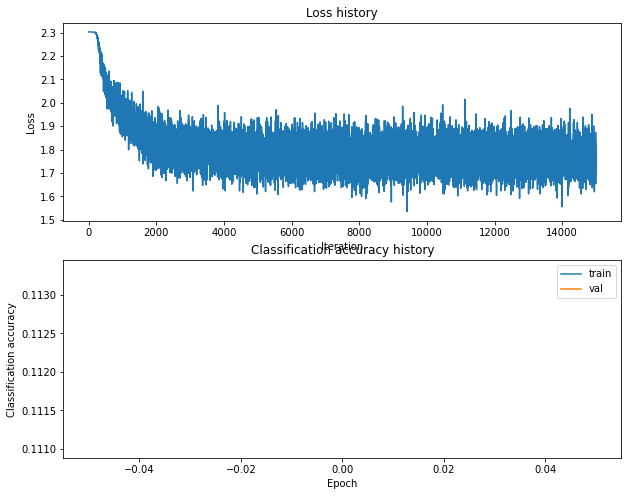

Training network with h_s 10, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.302628
iteration 100 / 15000: loss 1.925900
iteration 200 / 15000: loss 1.847339
iteration 300 / 15000: loss 1.769641
iteration 400 / 15000: loss 1.688703
iteration 500 / 15000: loss 1.800632
iteration 600 / 15000: loss 1.773767
iteration 700 / 15000: loss 1.759894
iteration 800 / 15000: loss 1.765687
iteration 900 / 15000: loss 1.819753
iteration 1000 / 15000: loss 1.691593
iteration 1100 / 15000: loss 1.936235
iteration 1200 / 15000: loss 1.766637
iteration 1300 / 15000: loss 1.744966
iteration 1400 / 15000: loss 1.831529
iteration 1500 / 15000: loss 1.750584
iteration 1600 / 15000: loss 1.739683
iteration 1700 / 15000: loss 1.739320
iteration 1800 / 15000: loss 1.707723
iteration 1900 / 15000: loss 1.869250
iteration 2000 / 15000: loss 1.772728
iteration 2100 / 15000: loss 1.775648
iteration 2200 / 15000: loss 1.733556
iteration 2300 / 15000: loss 1.759118
iteration 2400 / 15000: loss 1.666422
it

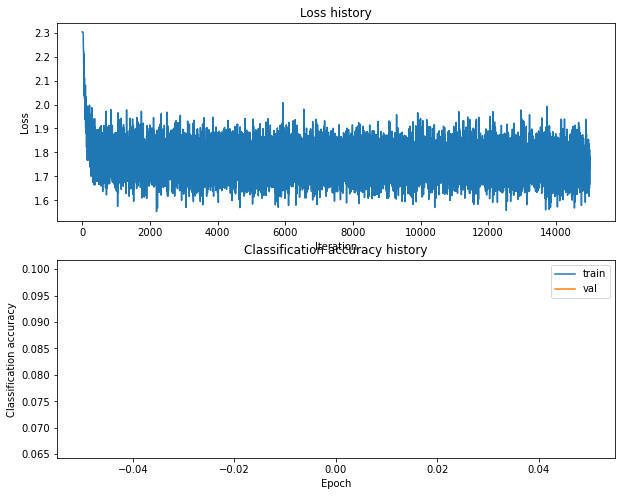

Training network with h_s 10, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.302620
iteration 100 / 15000: loss 2.302420
iteration 200 / 15000: loss 2.297149
iteration 300 / 15000: loss 2.240430
iteration 400 / 15000: loss 2.210146
iteration 500 / 15000: loss 2.145470
iteration 600 / 15000: loss 2.128897
iteration 700 / 15000: loss 2.064353
iteration 800 / 15000: loss 2.053635
iteration 900 / 15000: loss 1.988392
iteration 1000 / 15000: loss 2.023668
iteration 1100 / 15000: loss 1.955926
iteration 1200 / 15000: loss 1.988945
iteration 1300 / 15000: loss 1.954726
iteration 1400 / 15000: loss 1.993860
iteration 1500 / 15000: loss 1.928807
iteration 1600 / 15000: loss 1.955862
iteration 1700 / 15000: loss 1.908747
iteration 1800 / 15000: loss 1.959226
iteration 1900 / 15000: loss 1.951893
iteration 2000 / 15000: loss 1.917854
iteration 2100 / 15000: loss 1.907953
iteration 2200 / 15000: loss 1.908433
iteration 2300 / 15000: loss 1.833113
iteration 2400 / 15000: loss 1.905556
i

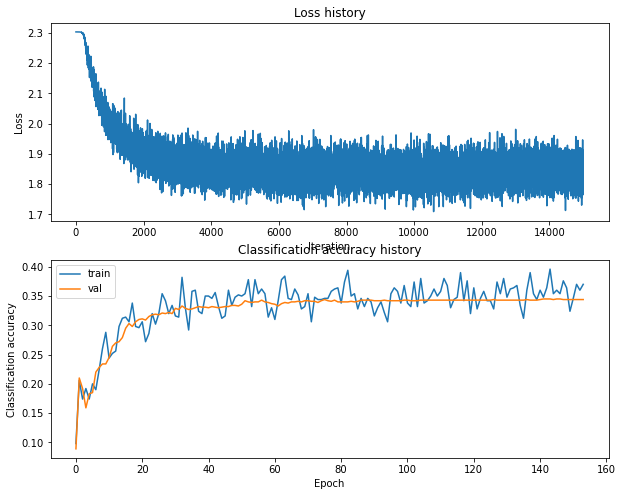

Training network with h_s 10, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.302619
iteration 100 / 15000: loss 2.007496
iteration 200 / 15000: loss 1.874748
iteration 300 / 15000: loss 1.771089
iteration 400 / 15000: loss 1.813487
iteration 500 / 15000: loss 1.742698
iteration 600 / 15000: loss 1.723789
iteration 700 / 15000: loss 1.760677
iteration 800 / 15000: loss 1.707908
iteration 900 / 15000: loss 1.767652
iteration 1000 / 15000: loss 1.771038
iteration 1100 / 15000: loss 1.781975
iteration 1200 / 15000: loss 1.735510
iteration 1300 / 15000: loss 1.745757
iteration 1400 / 15000: loss 1.739065
iteration 1500 / 15000: loss 1.686060
iteration 1600 / 15000: loss 1.743109
iteration 1700 / 15000: loss 1.721532
iteration 1800 / 15000: loss 1.796887
iteration 1900 / 15000: loss 1.617908
iteration 2000 / 15000: loss 1.855496
iteration 2100 / 15000: loss 1.716447
iteration 2200 / 15000: loss 1.762666
iteration 2300 / 15000: loss 1.786254
iteration 2400 / 15000: loss 1.761708
it

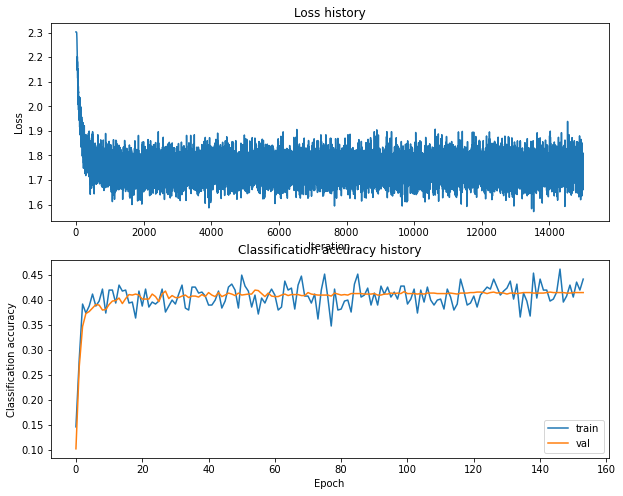

Training network with h_s 10, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.302636
iteration 100 / 20000: loss 2.302509
iteration 200 / 20000: loss 2.298842
iteration 300 / 20000: loss 2.235969
iteration 400 / 20000: loss 2.180837
iteration 500 / 20000: loss 2.197005
iteration 600 / 20000: loss 2.056879
iteration 700 / 20000: loss 2.070952
iteration 800 / 20000: loss 2.044750
iteration 900 / 20000: loss 1.972159
iteration 1000 / 20000: loss 1.949256
iteration 1100 / 20000: loss 1.971258
iteration 1200 / 20000: loss 2.000666
iteration 1300 / 20000: loss 1.941667
iteration 1400 / 20000: loss 1.943618
iteration 1500 / 20000: loss 1.923478
iteration 1600 / 20000: loss 2.134531
iteration 1700 / 20000: loss 1.938546
iteration 1800 / 20000: loss 1.839678
iteration 1900 / 20000: loss 1.873790
iteration 2000 / 20000: loss 1.898052
iteration 2100 / 20000: loss 1.858953
iteration 2200 / 20000: loss 1.869607
iteration 2300 / 20000: loss 1.865888
iteration 2400 / 20000: loss 1.891777
i

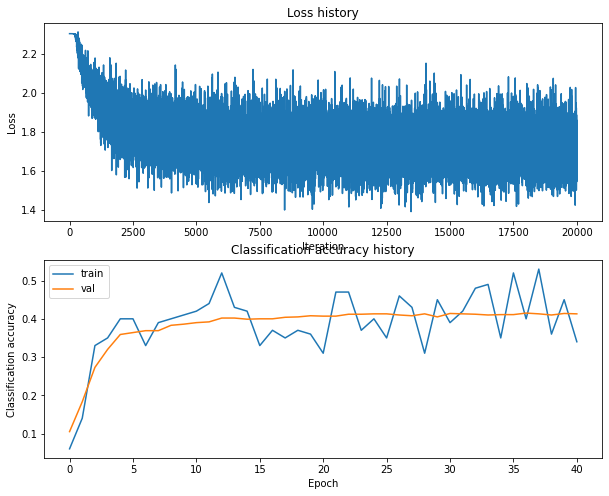

Training network with h_s 10, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.302621
iteration 100 / 20000: loss 2.024395
iteration 200 / 20000: loss 1.859846
iteration 300 / 20000: loss 1.827210
iteration 400 / 20000: loss 1.915000
iteration 500 / 20000: loss 1.857809
iteration 600 / 20000: loss 1.955196
iteration 700 / 20000: loss 1.911701
iteration 800 / 20000: loss 1.731305
iteration 900 / 20000: loss 1.721068
iteration 1000 / 20000: loss 1.931856
iteration 1100 / 20000: loss 1.711902
iteration 1200 / 20000: loss 1.741551
iteration 1300 / 20000: loss 1.795829
iteration 1400 / 20000: loss 1.844914
iteration 1500 / 20000: loss 1.772387
iteration 1600 / 20000: loss 1.829995
iteration 1700 / 20000: loss 1.713377
iteration 1800 / 20000: loss 1.723364
iteration 1900 / 20000: loss 1.838302
iteration 2000 / 20000: loss 1.730471
iteration 2100 / 20000: loss 1.741222
iteration 2200 / 20000: loss 1.853050
iteration 2300 / 20000: loss 1.842721
iteration 2400 / 20000: loss 1.954643
it

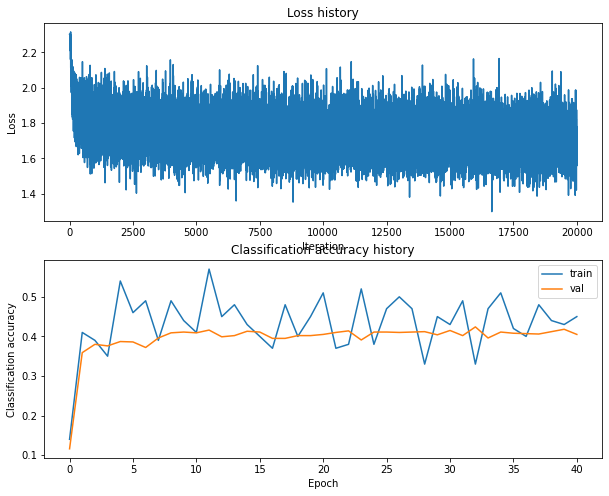

Training network with h_s 10, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.302625
iteration 100 / 20000: loss 2.302396
iteration 200 / 20000: loss 2.297286
iteration 300 / 20000: loss 2.253247
iteration 400 / 20000: loss 2.151180
iteration 500 / 20000: loss 2.114523
iteration 600 / 20000: loss 2.039672
iteration 700 / 20000: loss 2.032993
iteration 800 / 20000: loss 1.951932
iteration 900 / 20000: loss 1.994221
iteration 1000 / 20000: loss 2.046623
iteration 1100 / 20000: loss 2.025208
iteration 1200 / 20000: loss 1.967362
iteration 1300 / 20000: loss 1.921581
iteration 1400 / 20000: loss 1.933323
iteration 1500 / 20000: loss 1.918799
iteration 1600 / 20000: loss 1.909914
iteration 1700 / 20000: loss 1.867974
iteration 1800 / 20000: loss 1.861011
iteration 1900 / 20000: loss 1.906747
iteration 2000 / 20000: loss 1.880077
iteration 2100 / 20000: loss 1.776127
iteration 2200 / 20000: loss 1.746596
iteration 2300 / 20000: loss 1.890689
iteration 2400 / 20000: loss 1.888840
i

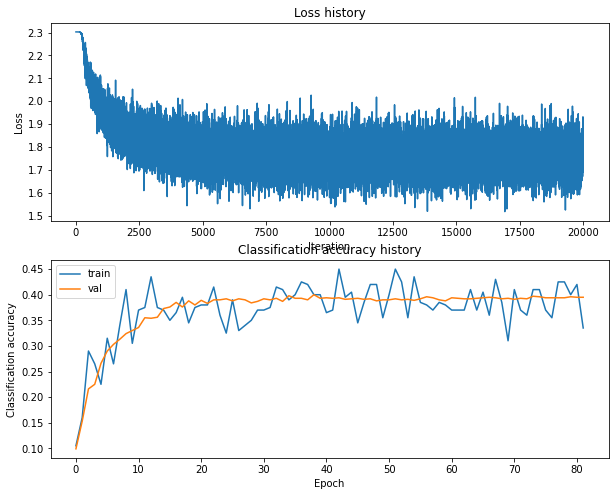

Training network with h_s 10, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.302629
iteration 100 / 20000: loss 1.998702
iteration 200 / 20000: loss 1.772890
iteration 300 / 20000: loss 1.995092
iteration 400 / 20000: loss 1.794986
iteration 500 / 20000: loss 1.657956
iteration 600 / 20000: loss 1.808032
iteration 700 / 20000: loss 1.730630
iteration 800 / 20000: loss 1.704566
iteration 900 / 20000: loss 1.832463
iteration 1000 / 20000: loss 1.718995
iteration 1100 / 20000: loss 1.705579
iteration 1200 / 20000: loss 1.737284
iteration 1300 / 20000: loss 1.831185
iteration 1400 / 20000: loss 1.668122
iteration 1500 / 20000: loss 1.715786
iteration 1600 / 20000: loss 1.785594
iteration 1700 / 20000: loss 1.755458
iteration 1800 / 20000: loss 1.744120
iteration 1900 / 20000: loss 1.741142
iteration 2000 / 20000: loss 1.725517
iteration 2100 / 20000: loss 1.785659
iteration 2200 / 20000: loss 1.794565
iteration 2300 / 20000: loss 1.765512
iteration 2400 / 20000: loss 1.820888
it

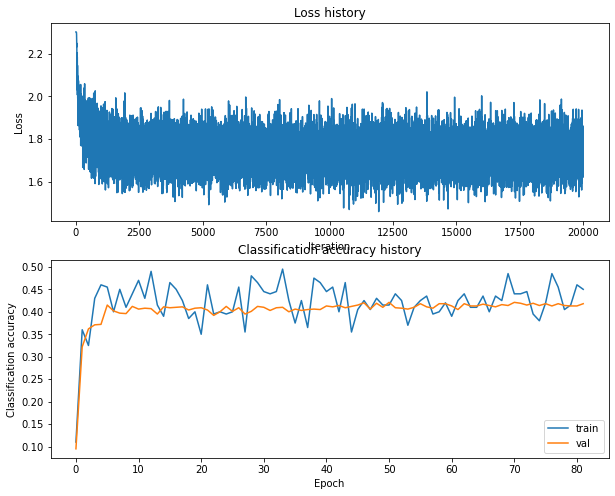

Training network with h_s 10, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.302615
iteration 100 / 20000: loss 2.302197
iteration 200 / 20000: loss 2.291928
iteration 300 / 20000: loss 2.217097
iteration 400 / 20000: loss 2.182883
iteration 500 / 20000: loss 2.118589
iteration 600 / 20000: loss 2.068367
iteration 700 / 20000: loss 2.019606
iteration 800 / 20000: loss 2.043771
iteration 900 / 20000: loss 1.921736
iteration 1000 / 20000: loss 1.920853
iteration 1100 / 20000: loss 2.037476
iteration 1200 / 20000: loss 1.956966
iteration 1300 / 20000: loss 1.983935
iteration 1400 / 20000: loss 1.843620
iteration 1500 / 20000: loss 1.928482
iteration 1600 / 20000: loss 1.909062
iteration 1700 / 20000: loss 1.893395
iteration 1800 / 20000: loss 1.880141
iteration 1900 / 20000: loss 1.837476
iteration 2000 / 20000: loss 1.886022
iteration 2100 / 20000: loss 1.787626
iteration 2200 / 20000: loss 1.915900
iteration 2300 / 20000: loss 1.929045
iteration 2400 / 20000: loss 1.856892
i

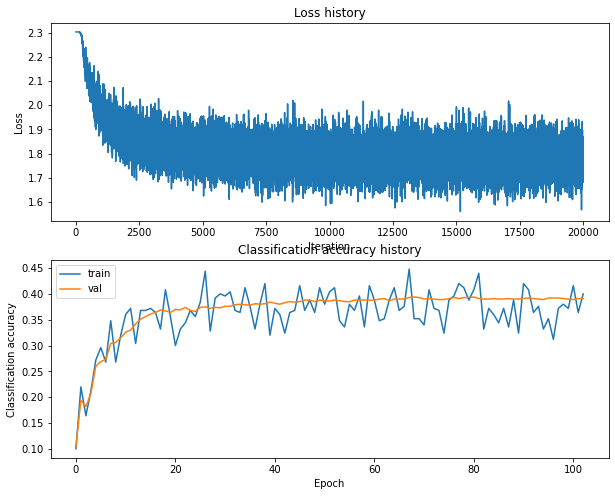

Training network with h_s 10, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.302618
iteration 100 / 20000: loss 1.884206
iteration 200 / 20000: loss 1.749127
iteration 300 / 20000: loss 1.722754
iteration 400 / 20000: loss 1.804138
iteration 500 / 20000: loss 1.688568
iteration 600 / 20000: loss 1.785210
iteration 700 / 20000: loss 1.774068
iteration 800 / 20000: loss 1.815378
iteration 900 / 20000: loss 1.819127
iteration 1000 / 20000: loss 1.796236
iteration 1100 / 20000: loss 1.738856
iteration 1200 / 20000: loss 1.711291
iteration 1300 / 20000: loss 1.725323
iteration 1400 / 20000: loss 1.816061
iteration 1500 / 20000: loss 1.740630
iteration 1600 / 20000: loss 1.728250
iteration 1700 / 20000: loss 1.755782
iteration 1800 / 20000: loss 1.777428
iteration 1900 / 20000: loss 1.779095
iteration 2000 / 20000: loss 1.730183
iteration 2100 / 20000: loss 1.866654
iteration 2200 / 20000: loss 1.807903
iteration 2300 / 20000: loss 1.735930
iteration 2400 / 20000: loss 1.756688
it

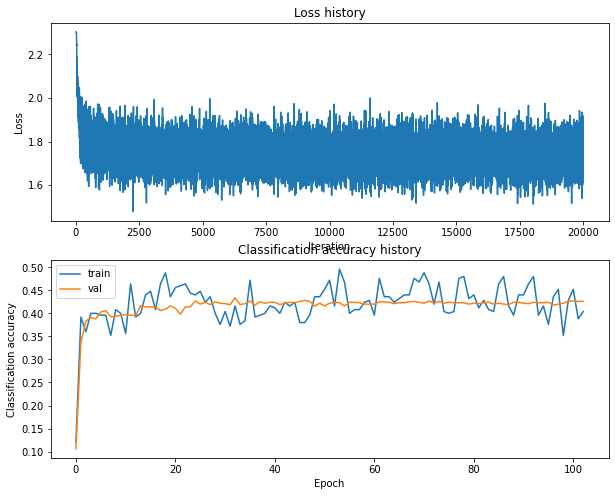

Training network with h_s 10, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.302623
iteration 100 / 20000: loss 2.302528
iteration 200 / 20000: loss 2.300324
iteration 300 / 20000: loss 2.272233
iteration 400 / 20000: loss 2.150827
iteration 500 / 20000: loss 2.154592
iteration 600 / 20000: loss 2.062770
iteration 700 / 20000: loss 2.017812
iteration 800 / 20000: loss 2.079746
iteration 900 / 20000: loss 1.941561
iteration 1000 / 20000: loss 1.949020
iteration 1100 / 20000: loss 1.954543
iteration 1200 / 20000: loss 1.899610
iteration 1300 / 20000: loss 1.928107
iteration 1400 / 20000: loss 1.979354
iteration 1500 / 20000: loss 1.909182
iteration 1600 / 20000: loss 1.947833
iteration 1700 / 20000: loss 1.888660
iteration 1800 / 20000: loss 1.799512
iteration 1900 / 20000: loss 1.902921
iteration 2000 / 20000: loss 1.784023
iteration 2100 / 20000: loss 1.788378
iteration 2200 / 20000: loss 1.879943
iteration 2300 / 20000: loss 1.754417
iteration 2400 / 20000: loss 1.799639
i

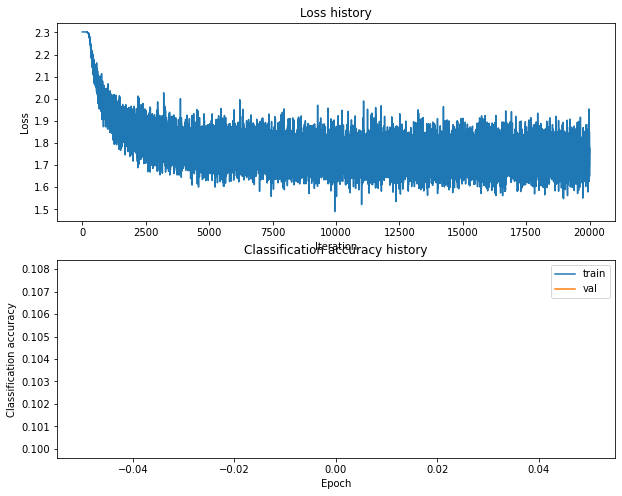

Training network with h_s 10, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.302629
iteration 100 / 20000: loss 2.002624
iteration 200 / 20000: loss 1.812341
iteration 300 / 20000: loss 1.887701
iteration 400 / 20000: loss 1.882140
iteration 500 / 20000: loss 1.791419
iteration 600 / 20000: loss 1.747406
iteration 700 / 20000: loss 1.743065
iteration 800 / 20000: loss 1.714628
iteration 900 / 20000: loss 1.751772
iteration 1000 / 20000: loss 1.801205
iteration 1100 / 20000: loss 1.701886
iteration 1200 / 20000: loss 1.776841
iteration 1300 / 20000: loss 1.839566
iteration 1400 / 20000: loss 1.693938
iteration 1500 / 20000: loss 1.813756
iteration 1600 / 20000: loss 1.746623
iteration 1700 / 20000: loss 1.812444
iteration 1800 / 20000: loss 1.834661
iteration 1900 / 20000: loss 1.788289
iteration 2000 / 20000: loss 1.835034
iteration 2100 / 20000: loss 1.654226
iteration 2200 / 20000: loss 1.676033
iteration 2300 / 20000: loss 1.734066
iteration 2400 / 20000: loss 1.750275
it

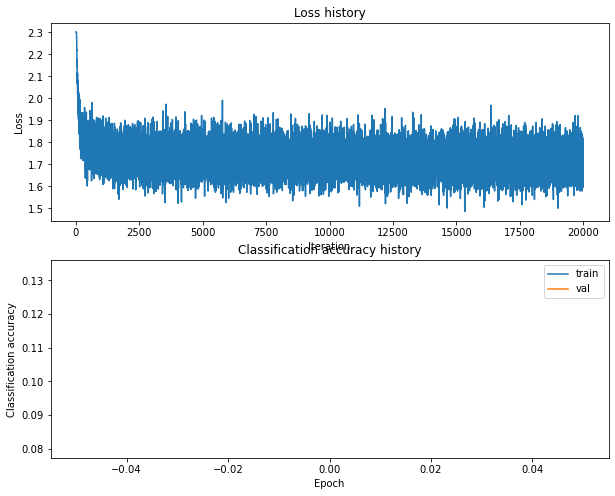

Training network with h_s 10, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.302623
iteration 100 / 20000: loss 2.302489
iteration 200 / 20000: loss 2.300474
iteration 300 / 20000: loss 2.275559
iteration 400 / 20000: loss 2.170425
iteration 500 / 20000: loss 2.148285
iteration 600 / 20000: loss 2.077170
iteration 700 / 20000: loss 2.030180
iteration 800 / 20000: loss 2.047388
iteration 900 / 20000: loss 1.993430
iteration 1000 / 20000: loss 1.986334
iteration 1100 / 20000: loss 1.941327
iteration 1200 / 20000: loss 1.992885
iteration 1300 / 20000: loss 1.979772
iteration 1400 / 20000: loss 1.938175
iteration 1500 / 20000: loss 1.942612
iteration 1600 / 20000: loss 1.902766
iteration 1700 / 20000: loss 1.914914
iteration 1800 / 20000: loss 1.948755
iteration 1900 / 20000: loss 1.958744
iteration 2000 / 20000: loss 1.852562
iteration 2100 / 20000: loss 1.878412
iteration 2200 / 20000: loss 1.877334
iteration 2300 / 20000: loss 1.913365
iteration 2400 / 20000: loss 1.924973
i

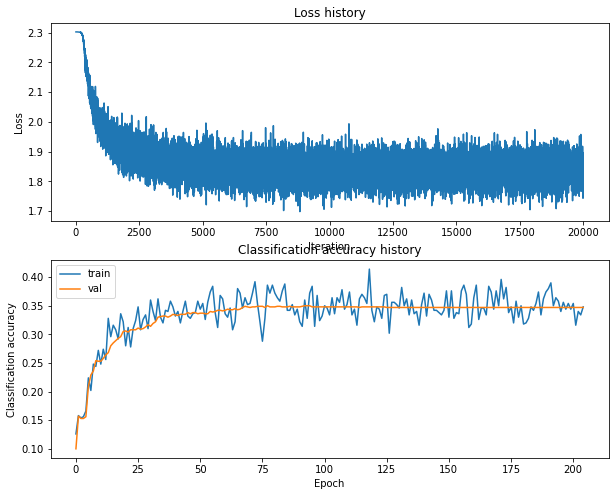

Training network with h_s 10, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.302620
iteration 100 / 20000: loss 2.016199
iteration 200 / 20000: loss 1.840968
iteration 300 / 20000: loss 1.831694
iteration 400 / 20000: loss 1.794400
iteration 500 / 20000: loss 1.750854
iteration 600 / 20000: loss 1.671939
iteration 700 / 20000: loss 1.735691
iteration 800 / 20000: loss 1.762903
iteration 900 / 20000: loss 1.768955
iteration 1000 / 20000: loss 1.653177
iteration 1100 / 20000: loss 1.772323
iteration 1200 / 20000: loss 1.706533
iteration 1300 / 20000: loss 1.719271
iteration 1400 / 20000: loss 1.700722
iteration 1500 / 20000: loss 1.698462
iteration 1600 / 20000: loss 1.759628
iteration 1700 / 20000: loss 1.779158
iteration 1800 / 20000: loss 1.642434
iteration 1900 / 20000: loss 1.711320
iteration 2000 / 20000: loss 1.717607
iteration 2100 / 20000: loss 1.752488
iteration 2200 / 20000: loss 1.656998
iteration 2300 / 20000: loss 1.678355
iteration 2400 / 20000: loss 1.615360
it

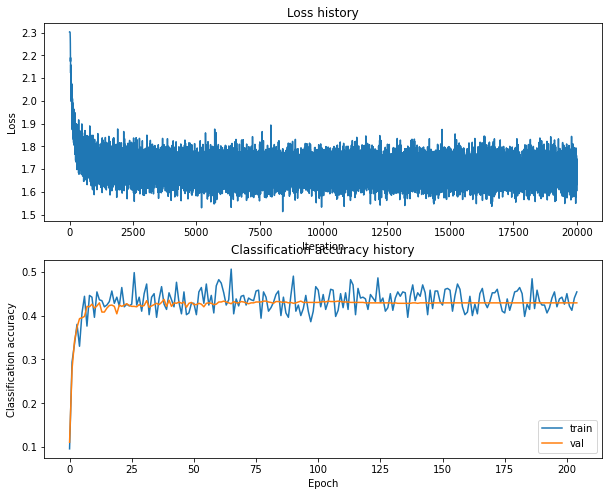

Training network with h_s 10, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.302624
iteration 100 / 25000: loss 2.302341
iteration 200 / 25000: loss 2.290813
iteration 300 / 25000: loss 2.200126
iteration 400 / 25000: loss 2.219708
iteration 500 / 25000: loss 2.092308
iteration 600 / 25000: loss 2.065838
iteration 700 / 25000: loss 2.052041
iteration 800 / 25000: loss 2.019927
iteration 900 / 25000: loss 2.010067
iteration 1000 / 25000: loss 1.940711
iteration 1100 / 25000: loss 1.965298
iteration 1200 / 25000: loss 1.964596
iteration 1300 / 25000: loss 1.875173
iteration 1400 / 25000: loss 1.883939
iteration 1500 / 25000: loss 1.924933
iteration 1600 / 25000: loss 1.692163
iteration 1700 / 25000: loss 1.844156
iteration 1800 / 25000: loss 1.941452
iteration 1900 / 25000: loss 1.874114
iteration 2000 / 25000: loss 1.841740
iteration 2100 / 25000: loss 1.927718
iteration 2200 / 25000: loss 1.686076
iteration 2300 / 25000: loss 1.671449
iteration 2400 / 25000: loss 1.813354
i

iteration 21300 / 25000: loss 1.967669
iteration 21400 / 25000: loss 1.818695
iteration 21500 / 25000: loss 1.841409
iteration 21600 / 25000: loss 1.825067
iteration 21700 / 25000: loss 1.783043
iteration 21800 / 25000: loss 1.764336
iteration 21900 / 25000: loss 1.884530
iteration 22000 / 25000: loss 1.744495
iteration 22100 / 25000: loss 1.839857
iteration 22200 / 25000: loss 1.899392
iteration 22300 / 25000: loss 1.985476
iteration 22400 / 25000: loss 1.822471
iteration 22500 / 25000: loss 1.818632
iteration 22600 / 25000: loss 1.697451
iteration 22700 / 25000: loss 1.688761
iteration 22800 / 25000: loss 1.863706
iteration 22900 / 25000: loss 1.784428
iteration 23000 / 25000: loss 1.726597
iteration 23100 / 25000: loss 1.500520
iteration 23200 / 25000: loss 1.765283
iteration 23300 / 25000: loss 1.696816
iteration 23400 / 25000: loss 1.889893
iteration 23500 / 25000: loss 1.863391
iteration 23600 / 25000: loss 1.937032
iteration 23700 / 25000: loss 1.903912
iteration 23800 / 25000: 

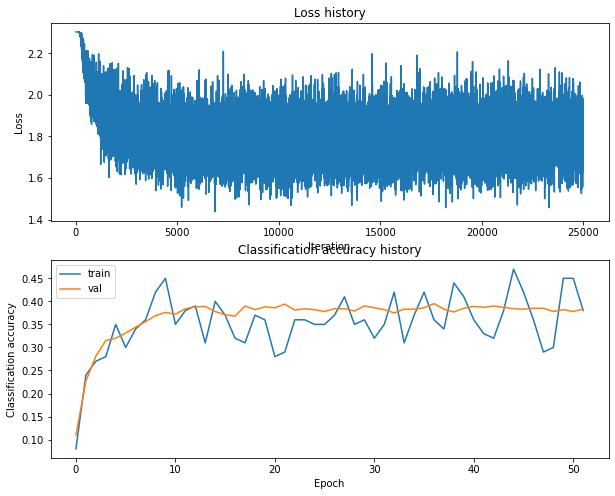

Training network with h_s 10, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.302611
iteration 100 / 25000: loss 1.881721
iteration 200 / 25000: loss 1.893616
iteration 300 / 25000: loss 1.866578
iteration 400 / 25000: loss 1.785304
iteration 500 / 25000: loss 1.954620
iteration 600 / 25000: loss 1.815795
iteration 700 / 25000: loss 1.623798
iteration 800 / 25000: loss 1.769000
iteration 900 / 25000: loss 1.847060
iteration 1000 / 25000: loss 2.081607
iteration 1100 / 25000: loss 1.719757
iteration 1200 / 25000: loss 1.888266
iteration 1300 / 25000: loss 1.727668
iteration 1400 / 25000: loss 1.928904
iteration 1500 / 25000: loss 1.744268
iteration 1600 / 25000: loss 1.832009
iteration 1700 / 25000: loss 1.869752
iteration 1800 / 25000: loss 1.907184
iteration 1900 / 25000: loss 1.744339
iteration 2000 / 25000: loss 1.696824
iteration 2100 / 25000: loss 1.907934
iteration 2200 / 25000: loss 1.696475
iteration 2300 / 25000: loss 1.738890
iteration 2400 / 25000: loss 1.864141
it

iteration 21200 / 25000: loss 1.785526
iteration 21300 / 25000: loss 1.819841
iteration 21400 / 25000: loss 1.756318
iteration 21500 / 25000: loss 1.788661
iteration 21600 / 25000: loss 1.702334
iteration 21700 / 25000: loss 1.775702
iteration 21800 / 25000: loss 1.821641
iteration 21900 / 25000: loss 1.864998
iteration 22000 / 25000: loss 1.571118
iteration 22100 / 25000: loss 1.854963
iteration 22200 / 25000: loss 1.757222
iteration 22300 / 25000: loss 1.815835
iteration 22400 / 25000: loss 1.733119
iteration 22500 / 25000: loss 1.653534
iteration 22600 / 25000: loss 1.679754
iteration 22700 / 25000: loss 1.607971
iteration 22800 / 25000: loss 1.764612
iteration 22900 / 25000: loss 1.683608
iteration 23000 / 25000: loss 1.578044
iteration 23100 / 25000: loss 1.887137
iteration 23200 / 25000: loss 1.685689
iteration 23300 / 25000: loss 1.823701
iteration 23400 / 25000: loss 1.716661
iteration 23500 / 25000: loss 1.725432
iteration 23600 / 25000: loss 1.696901
iteration 23700 / 25000: 

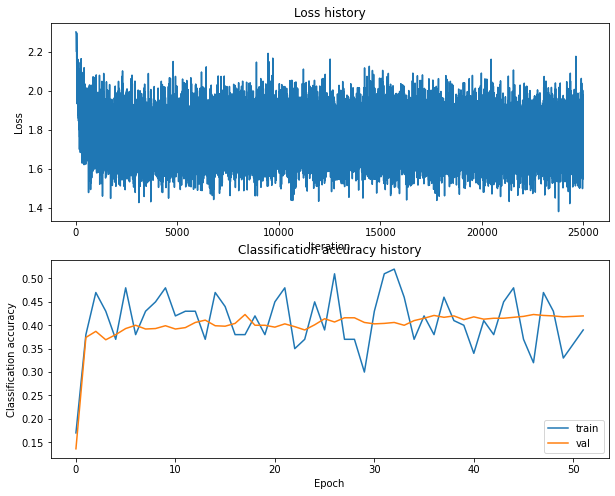

Training network with h_s 10, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.302626
iteration 100 / 25000: loss 2.302467
iteration 200 / 25000: loss 2.296988
iteration 300 / 25000: loss 2.217827
iteration 400 / 25000: loss 2.154607
iteration 500 / 25000: loss 2.128363
iteration 600 / 25000: loss 2.114751
iteration 700 / 25000: loss 1.962776
iteration 800 / 25000: loss 1.934346
iteration 900 / 25000: loss 1.967312
iteration 1000 / 25000: loss 2.017615
iteration 1100 / 25000: loss 1.937421
iteration 1200 / 25000: loss 2.021898
iteration 1300 / 25000: loss 1.893718
iteration 1400 / 25000: loss 1.904407
iteration 1500 / 25000: loss 1.872037
iteration 1600 / 25000: loss 1.904326
iteration 1700 / 25000: loss 1.928319
iteration 1800 / 25000: loss 1.884116
iteration 1900 / 25000: loss 1.902753
iteration 2000 / 25000: loss 1.909912
iteration 2100 / 25000: loss 1.797504
iteration 2200 / 25000: loss 1.776864
iteration 2300 / 25000: loss 1.807263
iteration 2400 / 25000: loss 1.814225
i

iteration 21200 / 25000: loss 1.676323
iteration 21300 / 25000: loss 1.807351
iteration 21400 / 25000: loss 1.789887
iteration 21500 / 25000: loss 1.728134
iteration 21600 / 25000: loss 1.686528
iteration 21700 / 25000: loss 1.860734
iteration 21800 / 25000: loss 1.853435
iteration 21900 / 25000: loss 1.902547
iteration 22000 / 25000: loss 1.775557
iteration 22100 / 25000: loss 1.873278
iteration 22200 / 25000: loss 1.644719
iteration 22300 / 25000: loss 1.715446
iteration 22400 / 25000: loss 1.821109
iteration 22500 / 25000: loss 1.917828
iteration 22600 / 25000: loss 1.779154
iteration 22700 / 25000: loss 1.594584
iteration 22800 / 25000: loss 1.724026
iteration 22900 / 25000: loss 1.870265
iteration 23000 / 25000: loss 1.819008
iteration 23100 / 25000: loss 1.820434
iteration 23200 / 25000: loss 1.789608
iteration 23300 / 25000: loss 1.824352
iteration 23400 / 25000: loss 1.725278
iteration 23500 / 25000: loss 1.806942
iteration 23600 / 25000: loss 1.767742
iteration 23700 / 25000: 

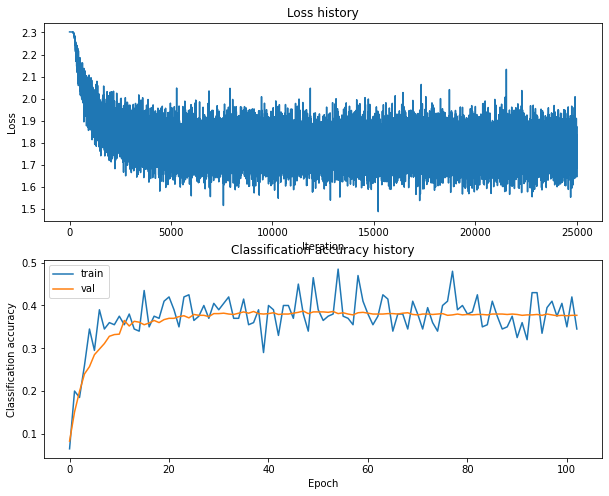

Training network with h_s 10, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.302630
iteration 100 / 25000: loss 1.933880
iteration 200 / 25000: loss 1.848522
iteration 300 / 25000: loss 1.884102
iteration 400 / 25000: loss 1.772968
iteration 500 / 25000: loss 1.877102
iteration 600 / 25000: loss 1.762523
iteration 700 / 25000: loss 1.797498
iteration 800 / 25000: loss 1.729357
iteration 900 / 25000: loss 1.731750
iteration 1000 / 25000: loss 1.936661
iteration 1100 / 25000: loss 1.814578
iteration 1200 / 25000: loss 1.768622
iteration 1300 / 25000: loss 1.865463
iteration 1400 / 25000: loss 1.790777
iteration 1500 / 25000: loss 1.816546
iteration 1600 / 25000: loss 1.701056
iteration 1700 / 25000: loss 1.761051
iteration 1800 / 25000: loss 1.739667
iteration 1900 / 25000: loss 1.741680
iteration 2000 / 25000: loss 1.813516
iteration 2100 / 25000: loss 1.744196
iteration 2200 / 25000: loss 1.591557
iteration 2300 / 25000: loss 1.717512
iteration 2400 / 25000: loss 1.817882
it

iteration 21200 / 25000: loss 1.699566
iteration 21300 / 25000: loss 1.735872
iteration 21400 / 25000: loss 1.736699
iteration 21500 / 25000: loss 1.768309
iteration 21600 / 25000: loss 1.680729
iteration 21700 / 25000: loss 1.569801
iteration 21800 / 25000: loss 1.726351
iteration 21900 / 25000: loss 1.665316
iteration 22000 / 25000: loss 1.754628
iteration 22100 / 25000: loss 1.817075
iteration 22200 / 25000: loss 1.719319
iteration 22300 / 25000: loss 1.790129
iteration 22400 / 25000: loss 1.715117
iteration 22500 / 25000: loss 1.737423
iteration 22600 / 25000: loss 1.660224
iteration 22700 / 25000: loss 1.677501
iteration 22800 / 25000: loss 1.599666
iteration 22900 / 25000: loss 1.553136
iteration 23000 / 25000: loss 1.772816
iteration 23100 / 25000: loss 1.631822
iteration 23200 / 25000: loss 1.645738
iteration 23300 / 25000: loss 1.733312
iteration 23400 / 25000: loss 1.671276
iteration 23500 / 25000: loss 1.750429
iteration 23600 / 25000: loss 1.665270
iteration 23700 / 25000: 

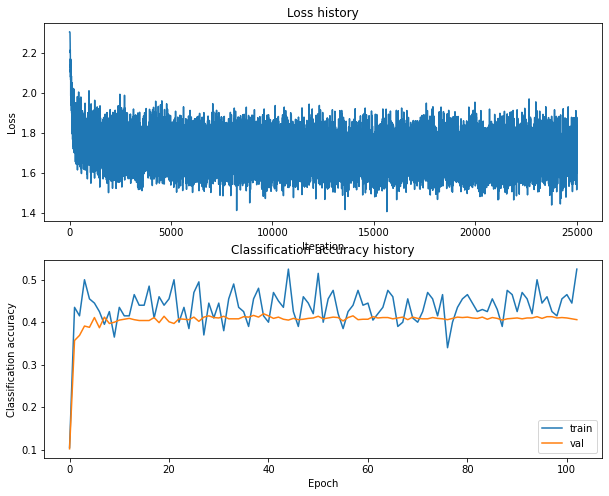

Training network with h_s 10, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.302617
iteration 100 / 25000: loss 2.302434
iteration 200 / 25000: loss 2.294607
iteration 300 / 25000: loss 2.235240
iteration 400 / 25000: loss 2.193555
iteration 500 / 25000: loss 2.081195
iteration 600 / 25000: loss 2.123717
iteration 700 / 25000: loss 2.047646
iteration 800 / 25000: loss 1.989826
iteration 900 / 25000: loss 1.958376
iteration 1000 / 25000: loss 2.035382
iteration 1100 / 25000: loss 2.056793
iteration 1200 / 25000: loss 1.996368
iteration 1300 / 25000: loss 1.981457
iteration 1400 / 25000: loss 1.961905
iteration 1500 / 25000: loss 1.900062
iteration 1600 / 25000: loss 1.880277
iteration 1700 / 25000: loss 1.876547
iteration 1800 / 25000: loss 2.024755
iteration 1900 / 25000: loss 1.848598
iteration 2000 / 25000: loss 1.880860
iteration 2100 / 25000: loss 1.869707
iteration 2200 / 25000: loss 1.921032
iteration 2300 / 25000: loss 1.862173
iteration 2400 / 25000: loss 1.929566
i

iteration 21200 / 25000: loss 1.631933
iteration 21300 / 25000: loss 1.824727
iteration 21400 / 25000: loss 1.713903
iteration 21500 / 25000: loss 1.718861
iteration 21600 / 25000: loss 1.805268
iteration 21700 / 25000: loss 1.773870
iteration 21800 / 25000: loss 1.829246
iteration 21900 / 25000: loss 1.834154
iteration 22000 / 25000: loss 1.850895
iteration 22100 / 25000: loss 1.729107
iteration 22200 / 25000: loss 1.764422
iteration 22300 / 25000: loss 1.810965
iteration 22400 / 25000: loss 1.809726
iteration 22500 / 25000: loss 1.674393
iteration 22600 / 25000: loss 1.840096
iteration 22700 / 25000: loss 1.747812
iteration 22800 / 25000: loss 1.884819
iteration 22900 / 25000: loss 1.659745
iteration 23000 / 25000: loss 1.880719
iteration 23100 / 25000: loss 1.756556
iteration 23200 / 25000: loss 1.788863
iteration 23300 / 25000: loss 1.742329
iteration 23400 / 25000: loss 1.833626
iteration 23500 / 25000: loss 1.688203
iteration 23600 / 25000: loss 1.682632
iteration 23700 / 25000: 

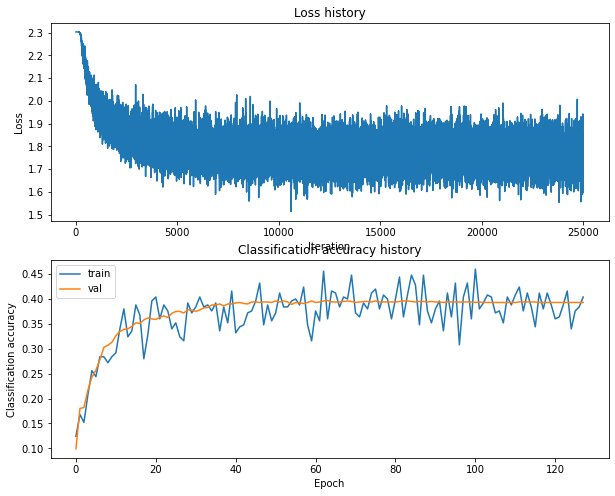

Training network with h_s 10, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.302634
iteration 100 / 25000: loss 2.012157
iteration 200 / 25000: loss 1.899540
iteration 300 / 25000: loss 1.941964
iteration 400 / 25000: loss 1.867807
iteration 500 / 25000: loss 1.818186
iteration 600 / 25000: loss 1.844305
iteration 700 / 25000: loss 1.857631
iteration 800 / 25000: loss 1.797093
iteration 900 / 25000: loss 1.784271
iteration 1000 / 25000: loss 1.735886
iteration 1100 / 25000: loss 1.725417
iteration 1200 / 25000: loss 1.749500
iteration 1300 / 25000: loss 1.836319
iteration 1400 / 25000: loss 1.761252
iteration 1500 / 25000: loss 1.797753
iteration 1600 / 25000: loss 1.785059
iteration 1700 / 25000: loss 1.798909
iteration 1800 / 25000: loss 1.669651
iteration 1900 / 25000: loss 1.770439
iteration 2000 / 25000: loss 1.810994
iteration 2100 / 25000: loss 1.780203
iteration 2200 / 25000: loss 1.835187
iteration 2300 / 25000: loss 1.731588
iteration 2400 / 25000: loss 1.828241
it

iteration 21200 / 25000: loss 1.594506
iteration 21300 / 25000: loss 1.764643
iteration 21400 / 25000: loss 1.779415
iteration 21500 / 25000: loss 1.655399
iteration 21600 / 25000: loss 1.737968
iteration 21700 / 25000: loss 1.741220
iteration 21800 / 25000: loss 1.831079
iteration 21900 / 25000: loss 1.695745
iteration 22000 / 25000: loss 1.814789
iteration 22100 / 25000: loss 1.702221
iteration 22200 / 25000: loss 1.645450
iteration 22300 / 25000: loss 1.773223
iteration 22400 / 25000: loss 1.560941
iteration 22500 / 25000: loss 1.775414
iteration 22600 / 25000: loss 1.805821
iteration 22700 / 25000: loss 1.753838
iteration 22800 / 25000: loss 1.768742
iteration 22900 / 25000: loss 1.794149
iteration 23000 / 25000: loss 1.654453
iteration 23100 / 25000: loss 1.760355
iteration 23200 / 25000: loss 1.750923
iteration 23300 / 25000: loss 1.684665
iteration 23400 / 25000: loss 1.846637
iteration 23500 / 25000: loss 1.686873
iteration 23600 / 25000: loss 1.795483
iteration 23700 / 25000: 

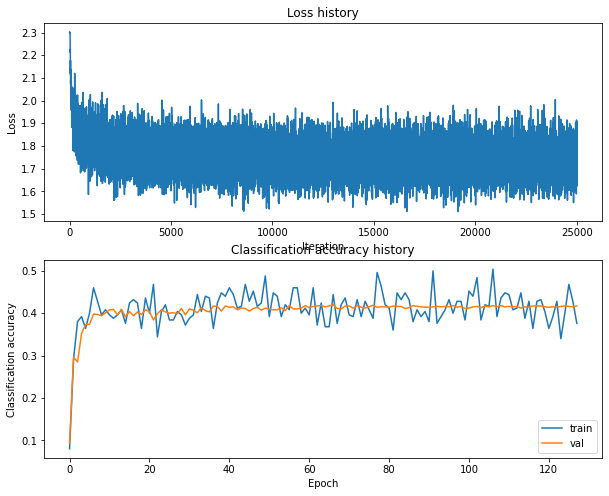

Training network with h_s 10, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.302624
iteration 100 / 25000: loss 2.302549
iteration 200 / 25000: loss 2.300923
iteration 300 / 25000: loss 2.266010
iteration 400 / 25000: loss 2.191120
iteration 500 / 25000: loss 2.070082
iteration 600 / 25000: loss 2.017883
iteration 700 / 25000: loss 2.018401
iteration 800 / 25000: loss 2.058128
iteration 900 / 25000: loss 1.962297
iteration 1000 / 25000: loss 1.881676
iteration 1100 / 25000: loss 1.936944
iteration 1200 / 25000: loss 1.997026
iteration 1300 / 25000: loss 1.893657
iteration 1400 / 25000: loss 1.928954
iteration 1500 / 25000: loss 1.900147
iteration 1600 / 25000: loss 1.887106
iteration 1700 / 25000: loss 1.856466
iteration 1800 / 25000: loss 1.894249
iteration 1900 / 25000: loss 1.870618
iteration 2000 / 25000: loss 1.849416
iteration 2100 / 25000: loss 1.773775
iteration 2200 / 25000: loss 1.840343
iteration 2300 / 25000: loss 1.849579
iteration 2400 / 25000: loss 1.907456
i

iteration 21200 / 25000: loss 1.731767
iteration 21300 / 25000: loss 1.737149
iteration 21400 / 25000: loss 1.796761
iteration 21500 / 25000: loss 1.779609
iteration 21600 / 25000: loss 1.700790
iteration 21700 / 25000: loss 1.757122
iteration 21800 / 25000: loss 1.755353
iteration 21900 / 25000: loss 1.762008
iteration 22000 / 25000: loss 1.854511
iteration 22100 / 25000: loss 1.767317
iteration 22200 / 25000: loss 1.791072
iteration 22300 / 25000: loss 1.694240
iteration 22400 / 25000: loss 1.720362
iteration 22500 / 25000: loss 1.780520
iteration 22600 / 25000: loss 1.729712
iteration 22700 / 25000: loss 1.762737
iteration 22800 / 25000: loss 1.731503
iteration 22900 / 25000: loss 1.656595
iteration 23000 / 25000: loss 1.639076
iteration 23100 / 25000: loss 1.789022
iteration 23200 / 25000: loss 1.802448
iteration 23300 / 25000: loss 1.780281
iteration 23400 / 25000: loss 1.764197
iteration 23500 / 25000: loss 1.740814
iteration 23600 / 25000: loss 1.842916
iteration 23700 / 25000: 

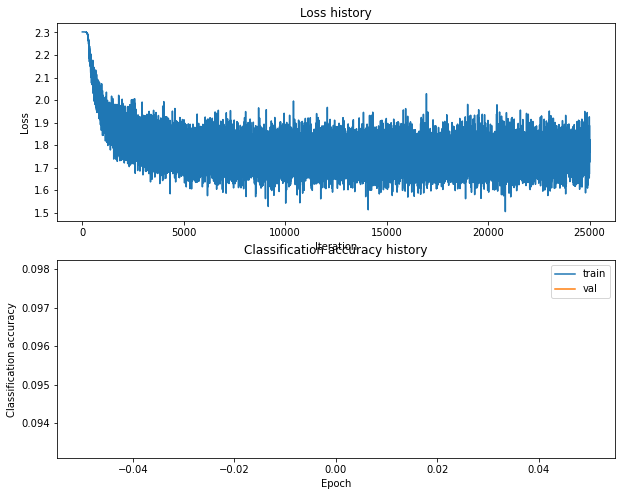

Training network with h_s 10, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.302632
iteration 100 / 25000: loss 2.024821
iteration 200 / 25000: loss 1.906576
iteration 300 / 25000: loss 1.828596
iteration 400 / 25000: loss 1.683409
iteration 500 / 25000: loss 1.869383
iteration 600 / 25000: loss 1.791668
iteration 700 / 25000: loss 1.749005
iteration 800 / 25000: loss 1.634782
iteration 900 / 25000: loss 1.701016
iteration 1000 / 25000: loss 1.798962
iteration 1100 / 25000: loss 1.759154
iteration 1200 / 25000: loss 1.744857
iteration 1300 / 25000: loss 1.723197
iteration 1400 / 25000: loss 1.786542
iteration 1500 / 25000: loss 1.729873
iteration 1600 / 25000: loss 1.794463
iteration 1700 / 25000: loss 1.822966
iteration 1800 / 25000: loss 1.678291
iteration 1900 / 25000: loss 1.754962
iteration 2000 / 25000: loss 1.855098
iteration 2100 / 25000: loss 1.712716
iteration 2200 / 25000: loss 1.701709
iteration 2300 / 25000: loss 1.828350
iteration 2400 / 25000: loss 1.803732
it

iteration 21200 / 25000: loss 1.811628
iteration 21300 / 25000: loss 1.727505
iteration 21400 / 25000: loss 1.756851
iteration 21500 / 25000: loss 1.904820
iteration 21600 / 25000: loss 1.705039
iteration 21700 / 25000: loss 1.786261
iteration 21800 / 25000: loss 1.811932
iteration 21900 / 25000: loss 1.759534
iteration 22000 / 25000: loss 1.633822
iteration 22100 / 25000: loss 1.853238
iteration 22200 / 25000: loss 1.825061
iteration 22300 / 25000: loss 1.919078
iteration 22400 / 25000: loss 1.737266
iteration 22500 / 25000: loss 1.832782
iteration 22600 / 25000: loss 1.836595
iteration 22700 / 25000: loss 1.846844
iteration 22800 / 25000: loss 1.747585
iteration 22900 / 25000: loss 1.863423
iteration 23000 / 25000: loss 1.884574
iteration 23100 / 25000: loss 1.875612
iteration 23200 / 25000: loss 1.837604
iteration 23300 / 25000: loss 1.823799
iteration 23400 / 25000: loss 1.779255
iteration 23500 / 25000: loss 1.753824
iteration 23600 / 25000: loss 1.771656
iteration 23700 / 25000: 

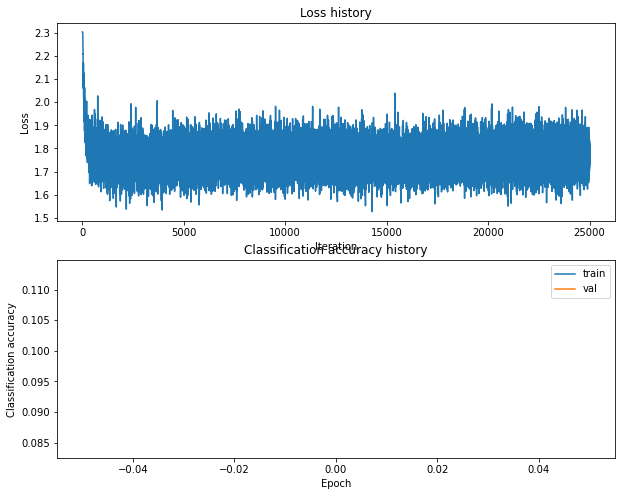

Training network with h_s 10, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.302625
iteration 100 / 25000: loss 2.302370
iteration 200 / 25000: loss 2.296486
iteration 300 / 25000: loss 2.254917
iteration 400 / 25000: loss 2.149979
iteration 500 / 25000: loss 2.153484
iteration 600 / 25000: loss 2.067558
iteration 700 / 25000: loss 2.024988
iteration 800 / 25000: loss 2.074536
iteration 900 / 25000: loss 2.079792
iteration 1000 / 25000: loss 2.004486
iteration 1100 / 25000: loss 2.048745
iteration 1200 / 25000: loss 1.945055
iteration 1300 / 25000: loss 1.960957
iteration 1400 / 25000: loss 1.942103
iteration 1500 / 25000: loss 2.000675
iteration 1600 / 25000: loss 1.919342
iteration 1700 / 25000: loss 2.011025
iteration 1800 / 25000: loss 1.993533
iteration 1900 / 25000: loss 1.957041
iteration 2000 / 25000: loss 2.021111
iteration 2100 / 25000: loss 1.862812
iteration 2200 / 25000: loss 1.883981
iteration 2300 / 25000: loss 1.936811
iteration 2400 / 25000: loss 1.920233
i

iteration 21200 / 25000: loss 1.898702
iteration 21300 / 25000: loss 1.836857
iteration 21400 / 25000: loss 1.863501
iteration 21500 / 25000: loss 1.905461
iteration 21600 / 25000: loss 1.828146
iteration 21700 / 25000: loss 1.885243
iteration 21800 / 25000: loss 1.885565
iteration 21900 / 25000: loss 1.858058
iteration 22000 / 25000: loss 1.861036
iteration 22100 / 25000: loss 1.829674
iteration 22200 / 25000: loss 1.832634
iteration 22300 / 25000: loss 1.880202
iteration 22400 / 25000: loss 1.939116
iteration 22500 / 25000: loss 1.805792
iteration 22600 / 25000: loss 1.827306
iteration 22700 / 25000: loss 1.792703
iteration 22800 / 25000: loss 1.873027
iteration 22900 / 25000: loss 1.871897
iteration 23000 / 25000: loss 1.885003
iteration 23100 / 25000: loss 1.868810
iteration 23200 / 25000: loss 1.876414
iteration 23300 / 25000: loss 1.872305
iteration 23400 / 25000: loss 1.818865
iteration 23500 / 25000: loss 1.938796
iteration 23600 / 25000: loss 1.782005
iteration 23700 / 25000: 

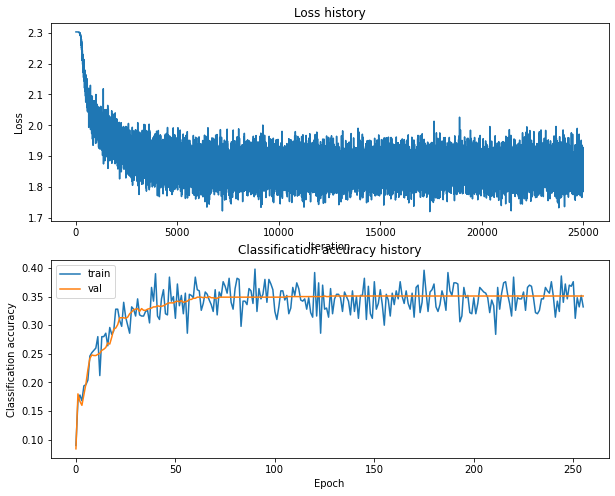

Training network with h_s 10, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.302629
iteration 100 / 25000: loss 1.977525
iteration 200 / 25000: loss 1.824517
iteration 300 / 25000: loss 1.864200
iteration 400 / 25000: loss 1.830717
iteration 500 / 25000: loss 1.802686
iteration 600 / 25000: loss 1.754248
iteration 700 / 25000: loss 1.812509
iteration 800 / 25000: loss 1.751367
iteration 900 / 25000: loss 1.770650
iteration 1000 / 25000: loss 1.747146
iteration 1100 / 25000: loss 1.810299
iteration 1200 / 25000: loss 1.714317
iteration 1300 / 25000: loss 1.741714
iteration 1400 / 25000: loss 1.738165
iteration 1500 / 25000: loss 1.791833
iteration 1600 / 25000: loss 1.750488
iteration 1700 / 25000: loss 1.790925
iteration 1800 / 25000: loss 1.789917
iteration 1900 / 25000: loss 1.783582
iteration 2000 / 25000: loss 1.743804
iteration 2100 / 25000: loss 1.735487
iteration 2200 / 25000: loss 1.792159
iteration 2300 / 25000: loss 1.832633
iteration 2400 / 25000: loss 1.730488
it

iteration 21200 / 25000: loss 1.752202
iteration 21300 / 25000: loss 1.766287
iteration 21400 / 25000: loss 1.735034
iteration 21500 / 25000: loss 1.763240
iteration 21600 / 25000: loss 1.799690
iteration 21700 / 25000: loss 1.802648
iteration 21800 / 25000: loss 1.691223
iteration 21900 / 25000: loss 1.694486
iteration 22000 / 25000: loss 1.806510
iteration 22100 / 25000: loss 1.765950
iteration 22200 / 25000: loss 1.694544
iteration 22300 / 25000: loss 1.739518
iteration 22400 / 25000: loss 1.730191
iteration 22500 / 25000: loss 1.742031
iteration 22600 / 25000: loss 1.689826
iteration 22700 / 25000: loss 1.702550
iteration 22800 / 25000: loss 1.714990
iteration 22900 / 25000: loss 1.714043
iteration 23000 / 25000: loss 1.805703
iteration 23100 / 25000: loss 1.782054
iteration 23200 / 25000: loss 1.682665
iteration 23300 / 25000: loss 1.765706
iteration 23400 / 25000: loss 1.801129
iteration 23500 / 25000: loss 1.816245
iteration 23600 / 25000: loss 1.741609
iteration 23700 / 25000: 

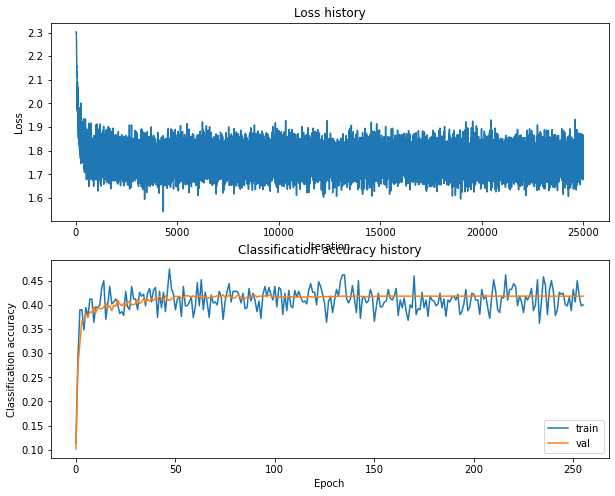

Training network with h_s 25, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.302684
iteration 100 / 500: loss 2.301634
iteration 200 / 500: loss 2.284329
iteration 300 / 500: loss 2.256274
iteration 400 / 500: loss 2.087502
Validation accuracy:  0.223


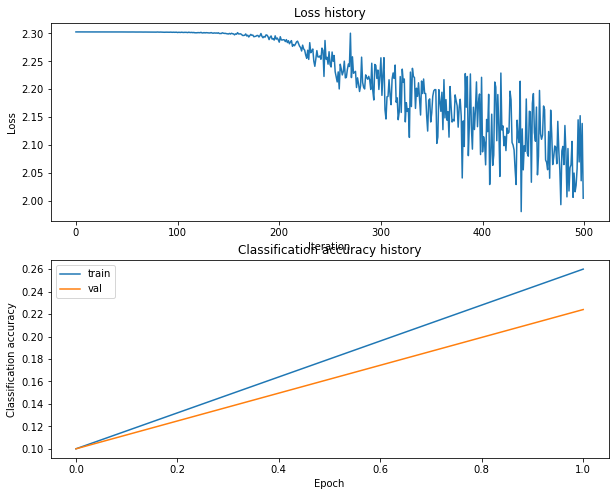

Training network with h_s 25, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.302689
iteration 100 / 500: loss 1.919580
iteration 200 / 500: loss 1.882791
iteration 300 / 500: loss 1.724731
iteration 400 / 500: loss 1.786237
Validation accuracy:  0.386


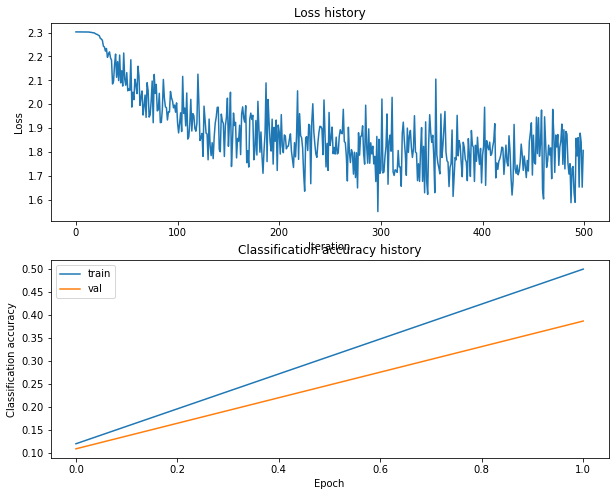

Training network with h_s 25, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.302687
iteration 100 / 500: loss 2.302326
iteration 200 / 500: loss 2.291618
iteration 300 / 500: loss 2.226069
iteration 400 / 500: loss 2.139252
Validation accuracy:  0.227


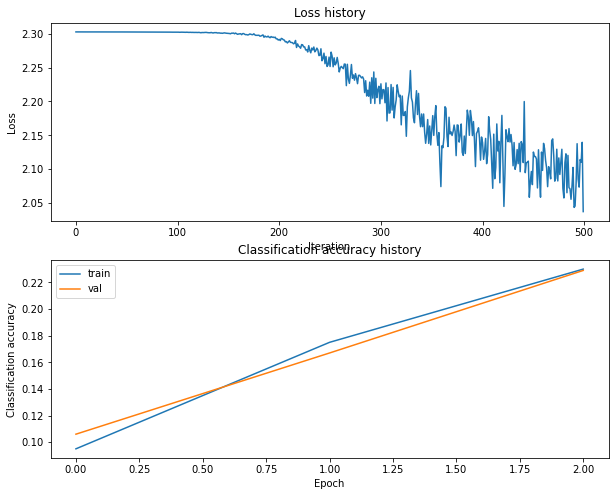

Training network with h_s 25, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.302681
iteration 100 / 500: loss 1.943591
iteration 200 / 500: loss 1.799719
iteration 300 / 500: loss 1.742834
iteration 400 / 500: loss 1.793782
Validation accuracy:  0.401


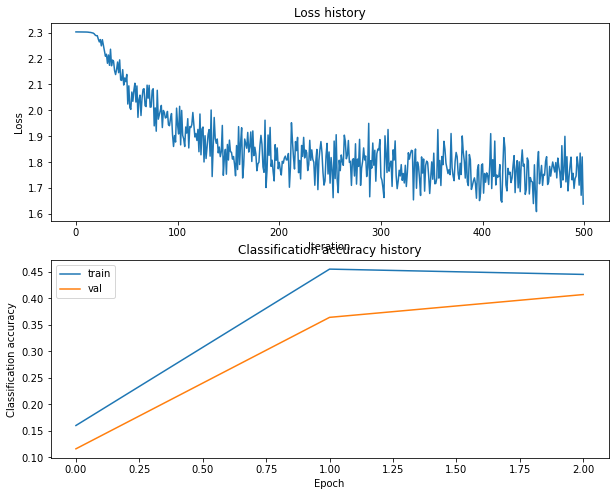

Training network with h_s 25, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.302672
iteration 100 / 500: loss 2.302078
iteration 200 / 500: loss 2.289585
iteration 300 / 500: loss 2.241865
iteration 400 / 500: loss 2.188098
Validation accuracy:  0.216


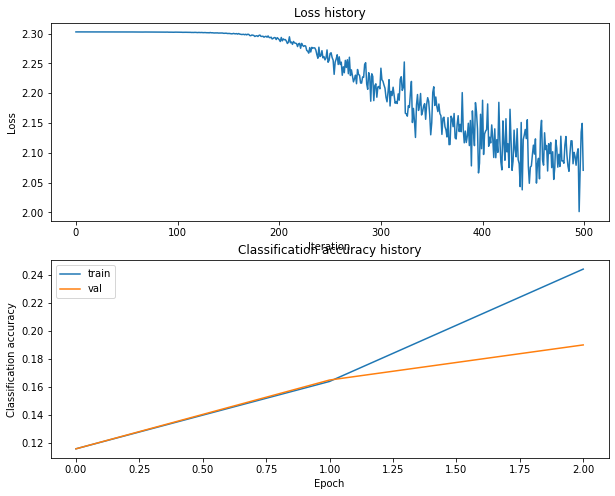

Training network with h_s 25, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.302668
iteration 100 / 500: loss 1.965493
iteration 200 / 500: loss 1.910057
iteration 300 / 500: loss 1.803002
iteration 400 / 500: loss 1.657665
Validation accuracy:  0.397


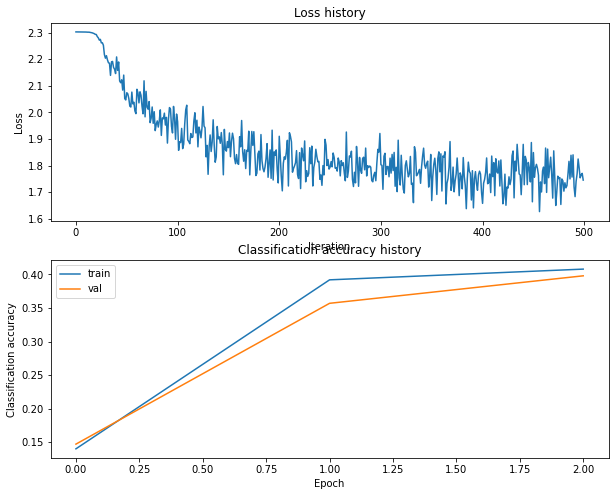

Training network with h_s 25, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.302678
iteration 100 / 500: loss 2.302246
iteration 200 / 500: loss 2.288277
iteration 300 / 500: loss 2.210037
iteration 400 / 500: loss 2.130506
Validation accuracy:  0.227


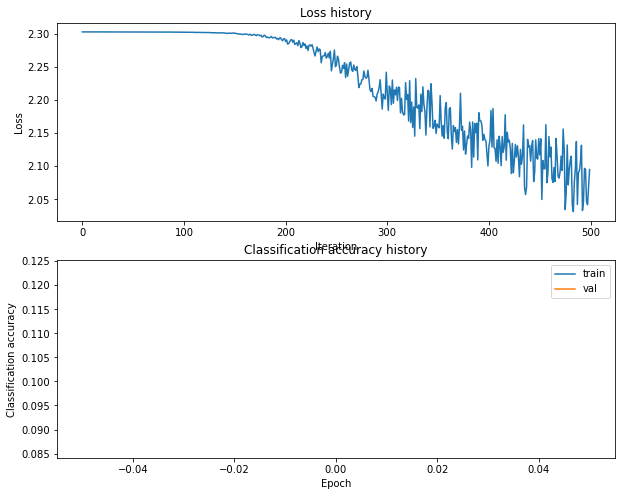

Training network with h_s 25, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.302670
iteration 100 / 500: loss 1.934400
iteration 200 / 500: loss 1.762593
iteration 300 / 500: loss 1.696600
iteration 400 / 500: loss 1.762604
Validation accuracy:  0.4


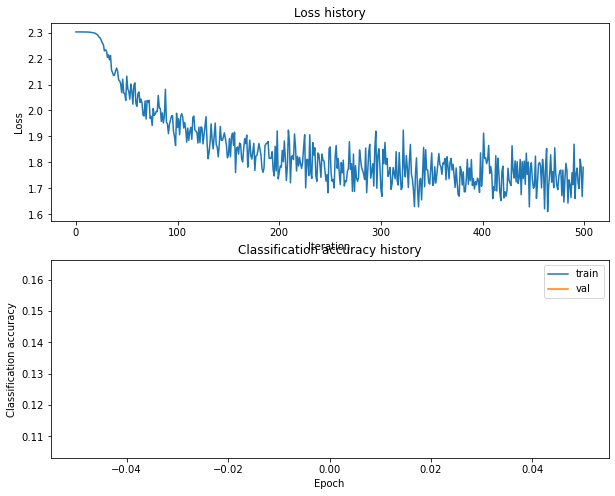

Training network with h_s 25, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.302681
iteration 100 / 500: loss 2.302053
iteration 200 / 500: loss 2.290162
iteration 300 / 500: loss 2.241216
iteration 400 / 500: loss 2.165852
Validation accuracy:  0.219


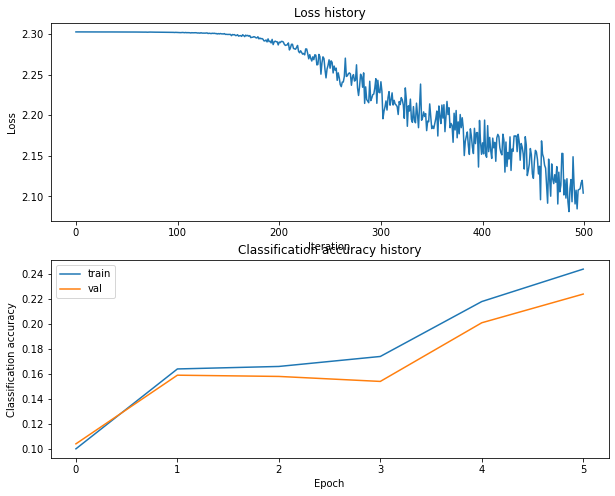

Training network with h_s 25, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.302667
iteration 100 / 500: loss 1.918437
iteration 200 / 500: loss 1.730947
iteration 300 / 500: loss 1.787998
iteration 400 / 500: loss 1.709534
Validation accuracy:  0.408


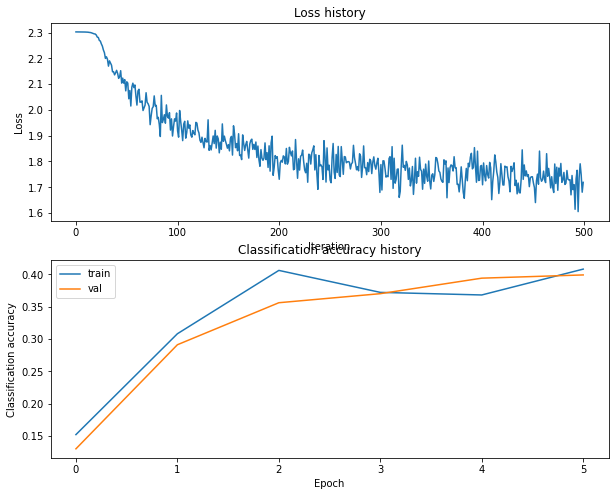

Training network with h_s 25, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.302695
iteration 100 / 1000: loss 2.301983
iteration 200 / 1000: loss 2.286928
iteration 300 / 1000: loss 2.185911
iteration 400 / 1000: loss 2.226677
iteration 500 / 1000: loss 2.030551
iteration 600 / 1000: loss 2.002138
iteration 700 / 1000: loss 1.950988
iteration 800 / 1000: loss 1.994451
iteration 900 / 1000: loss 1.997814
Validation accuracy:  0.308


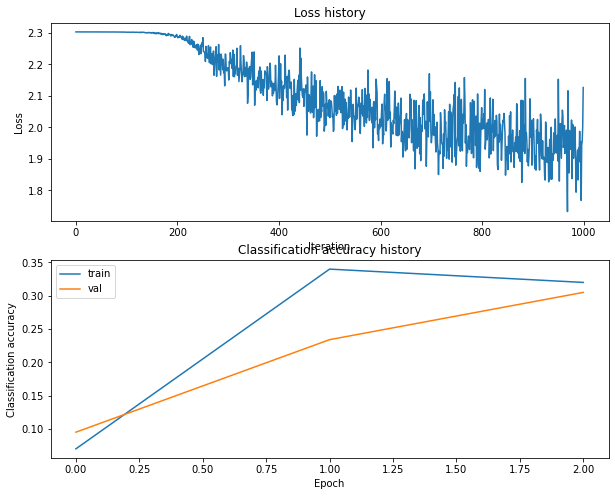

Training network with h_s 25, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.302668
iteration 100 / 1000: loss 1.957806
iteration 200 / 1000: loss 1.862414
iteration 300 / 1000: loss 1.769638
iteration 400 / 1000: loss 1.818850
iteration 500 / 1000: loss 1.861197
iteration 600 / 1000: loss 1.799791
iteration 700 / 1000: loss 1.768851
iteration 800 / 1000: loss 1.849437
iteration 900 / 1000: loss 1.732114
Validation accuracy:  0.401


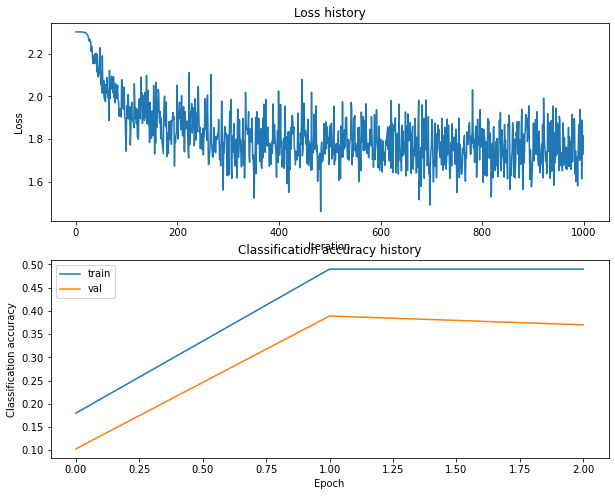

Training network with h_s 25, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.302672
iteration 100 / 1000: loss 2.302240
iteration 200 / 1000: loss 2.290859
iteration 300 / 1000: loss 2.219217
iteration 400 / 1000: loss 2.122146
iteration 500 / 1000: loss 2.069983
iteration 600 / 1000: loss 2.126787
iteration 700 / 1000: loss 1.965710
iteration 800 / 1000: loss 2.003059
iteration 900 / 1000: loss 1.923297
Validation accuracy:  0.294


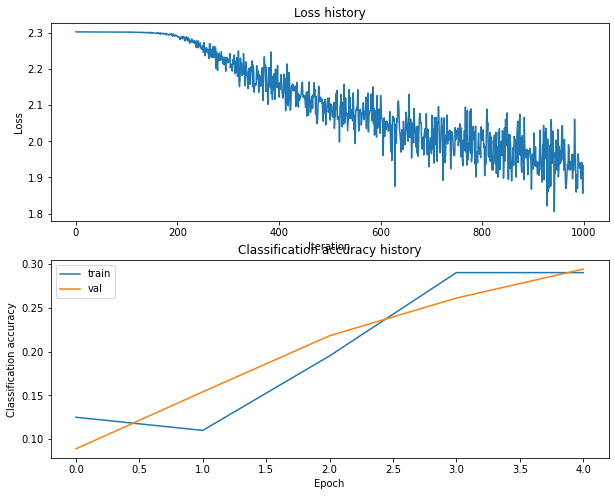

Training network with h_s 25, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.302674
iteration 100 / 1000: loss 1.965920
iteration 200 / 1000: loss 1.896928
iteration 300 / 1000: loss 1.888200
iteration 400 / 1000: loss 1.641717
iteration 500 / 1000: loss 1.833856
iteration 600 / 1000: loss 1.785939
iteration 700 / 1000: loss 1.678594
iteration 800 / 1000: loss 1.671521
iteration 900 / 1000: loss 1.782847
Validation accuracy:  0.415


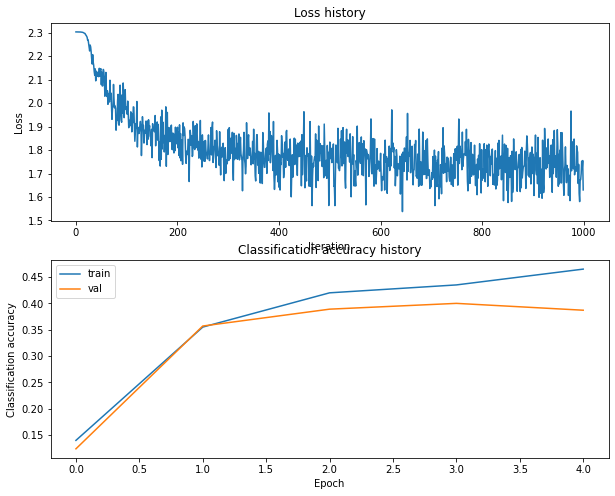

Training network with h_s 25, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.302701
iteration 100 / 1000: loss 2.302218
iteration 200 / 1000: loss 2.292818
iteration 300 / 1000: loss 2.224203
iteration 400 / 1000: loss 2.088122
iteration 500 / 1000: loss 2.076992
iteration 600 / 1000: loss 2.127570
iteration 700 / 1000: loss 2.029522
iteration 800 / 1000: loss 1.976952
iteration 900 / 1000: loss 1.934133
Validation accuracy:  0.276


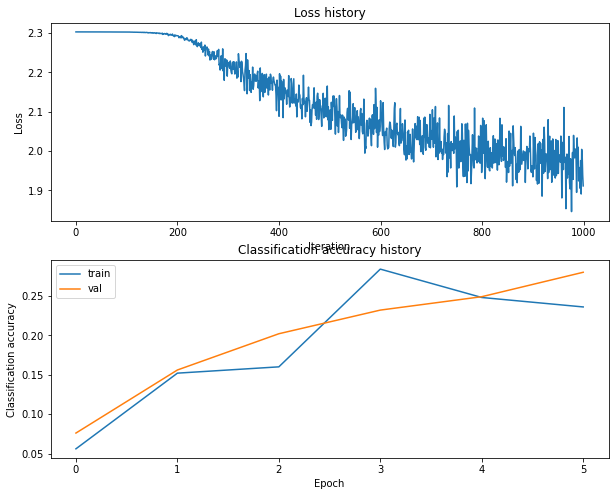

Training network with h_s 25, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.302674
iteration 100 / 1000: loss 1.909532
iteration 200 / 1000: loss 1.910656
iteration 300 / 1000: loss 1.794413
iteration 400 / 1000: loss 1.680923
iteration 500 / 1000: loss 1.790319
iteration 600 / 1000: loss 1.692268
iteration 700 / 1000: loss 1.563144
iteration 800 / 1000: loss 1.655931
iteration 900 / 1000: loss 1.784404
Validation accuracy:  0.414


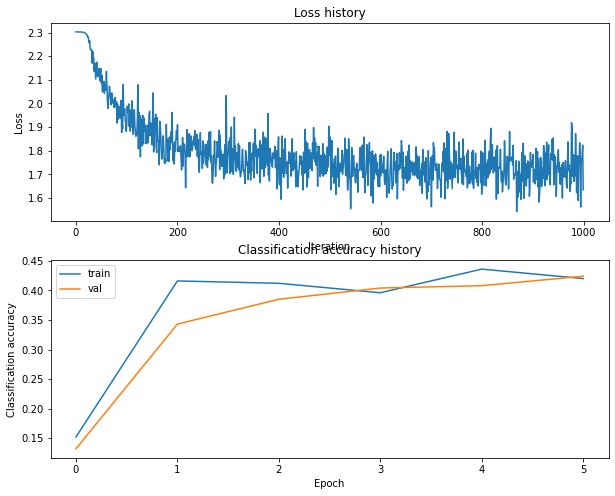

Training network with h_s 25, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.302684
iteration 100 / 1000: loss 2.302421
iteration 200 / 1000: loss 2.297536
iteration 300 / 1000: loss 2.253939
iteration 400 / 1000: loss 2.151602
iteration 500 / 1000: loss 2.039821
iteration 600 / 1000: loss 2.064699
iteration 700 / 1000: loss 2.025693
iteration 800 / 1000: loss 1.902729
iteration 900 / 1000: loss 1.917787
Validation accuracy:  0.276


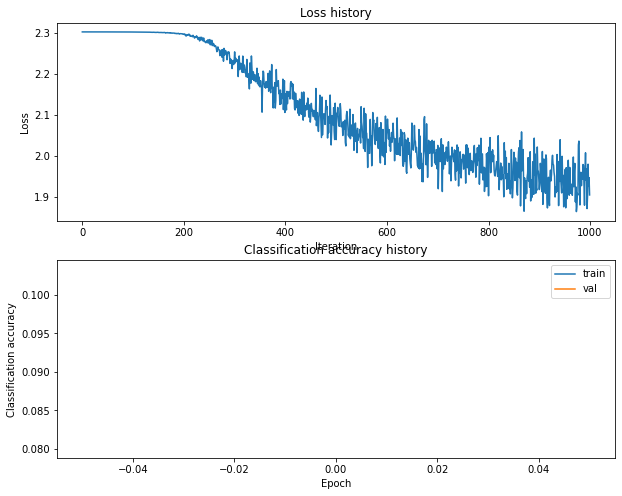

Training network with h_s 25, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.302689
iteration 100 / 1000: loss 1.976104
iteration 200 / 1000: loss 1.842685
iteration 300 / 1000: loss 1.755283
iteration 400 / 1000: loss 1.804157
iteration 500 / 1000: loss 1.827980
iteration 600 / 1000: loss 1.805413
iteration 700 / 1000: loss 1.734512
iteration 800 / 1000: loss 1.717365
iteration 900 / 1000: loss 1.732432
Validation accuracy:  0.417


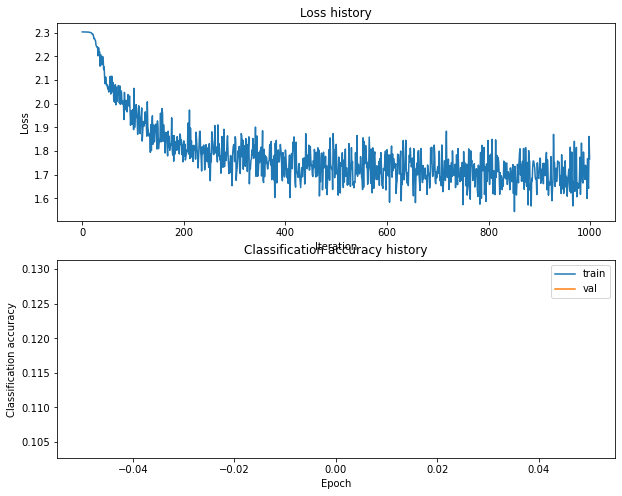

Training network with h_s 25, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.302675
iteration 100 / 1000: loss 2.302046
iteration 200 / 1000: loss 2.287364
iteration 300 / 1000: loss 2.202988
iteration 400 / 1000: loss 2.187808
iteration 500 / 1000: loss 2.108218
iteration 600 / 1000: loss 2.058426
iteration 700 / 1000: loss 2.013409
iteration 800 / 1000: loss 1.991729
iteration 900 / 1000: loss 1.958193
Validation accuracy:  0.273


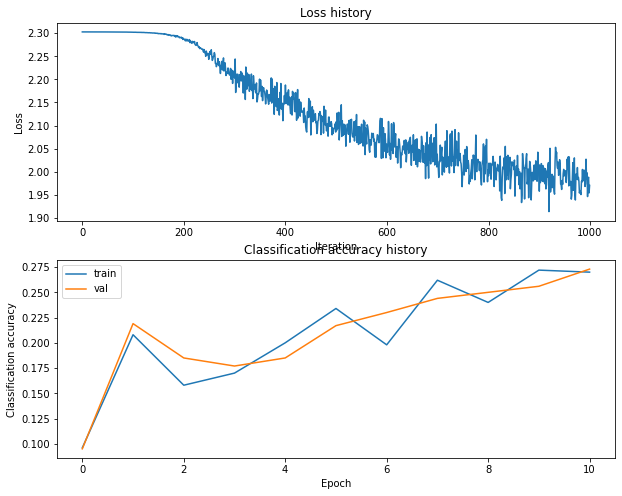

Training network with h_s 25, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.302679
iteration 100 / 1000: loss 1.921730
iteration 200 / 1000: loss 1.829811
iteration 300 / 1000: loss 1.783597
iteration 400 / 1000: loss 1.758380
iteration 500 / 1000: loss 1.662399
iteration 600 / 1000: loss 1.746091
iteration 700 / 1000: loss 1.607044
iteration 800 / 1000: loss 1.702243
iteration 900 / 1000: loss 1.776339
Validation accuracy:  0.406


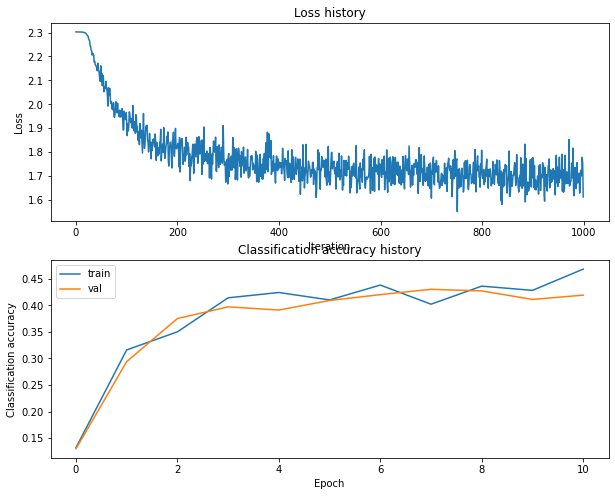

Training network with h_s 25, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.302690
iteration 100 / 1500: loss 2.302395
iteration 200 / 1500: loss 2.296032
iteration 300 / 1500: loss 2.241962
iteration 400 / 1500: loss 2.172967
iteration 500 / 1500: loss 2.004178
iteration 600 / 1500: loss 2.090257
iteration 700 / 1500: loss 1.996395
iteration 800 / 1500: loss 1.934318
iteration 900 / 1500: loss 1.931735
iteration 1000 / 1500: loss 2.036569
iteration 1100 / 1500: loss 1.897217
iteration 1200 / 1500: loss 1.889321
iteration 1300 / 1500: loss 1.984356
iteration 1400 / 1500: loss 1.989542
Validation accuracy:  0.325


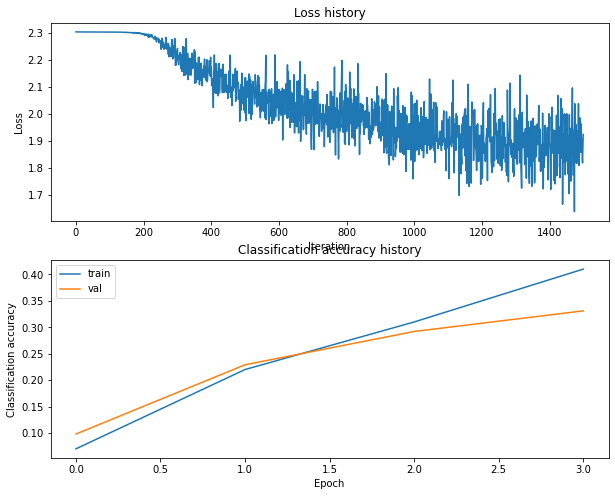

Training network with h_s 25, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.302668
iteration 100 / 1500: loss 1.956511
iteration 200 / 1500: loss 1.807061
iteration 300 / 1500: loss 1.861643
iteration 400 / 1500: loss 1.697213
iteration 500 / 1500: loss 1.768540
iteration 600 / 1500: loss 1.772988
iteration 700 / 1500: loss 1.740833
iteration 800 / 1500: loss 1.673033
iteration 900 / 1500: loss 1.660521
iteration 1000 / 1500: loss 1.634632
iteration 1100 / 1500: loss 1.638509
iteration 1200 / 1500: loss 1.569650
iteration 1300 / 1500: loss 1.691817
iteration 1400 / 1500: loss 1.739434
Validation accuracy:  0.393


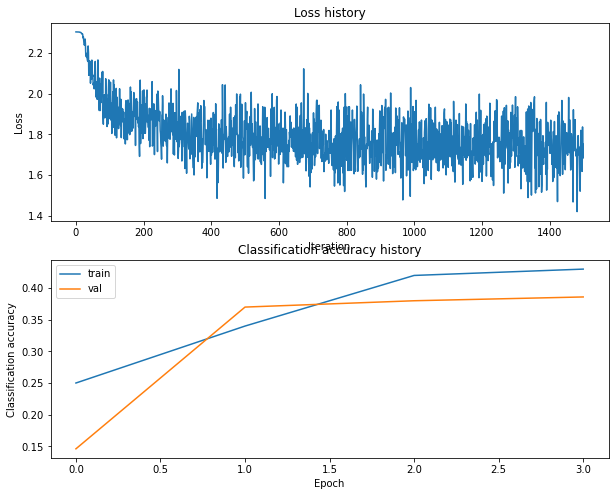

Training network with h_s 25, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.302673
iteration 100 / 1500: loss 2.302296
iteration 200 / 1500: loss 2.293784
iteration 300 / 1500: loss 2.220534
iteration 400 / 1500: loss 2.129939
iteration 500 / 1500: loss 2.058521
iteration 600 / 1500: loss 2.011531
iteration 700 / 1500: loss 1.982386
iteration 800 / 1500: loss 2.012425
iteration 900 / 1500: loss 2.057850
iteration 1000 / 1500: loss 1.913500
iteration 1100 / 1500: loss 2.032014
iteration 1200 / 1500: loss 1.824814
iteration 1300 / 1500: loss 1.935781
iteration 1400 / 1500: loss 1.901527
Validation accuracy:  0.33


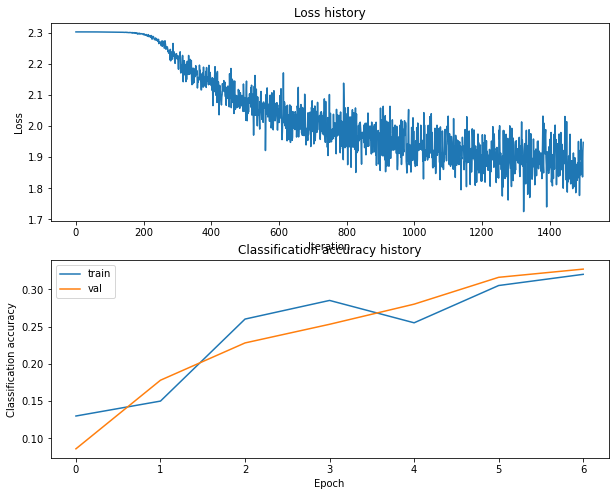

Training network with h_s 25, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.302693
iteration 100 / 1500: loss 1.943113
iteration 200 / 1500: loss 1.824971
iteration 300 / 1500: loss 1.707030
iteration 400 / 1500: loss 1.842223
iteration 500 / 1500: loss 1.677869
iteration 600 / 1500: loss 1.729496
iteration 700 / 1500: loss 1.657765
iteration 800 / 1500: loss 1.831684
iteration 900 / 1500: loss 1.759641
iteration 1000 / 1500: loss 1.823354
iteration 1100 / 1500: loss 1.684099
iteration 1200 / 1500: loss 1.722270
iteration 1300 / 1500: loss 1.703162
iteration 1400 / 1500: loss 1.774479
Validation accuracy:  0.397


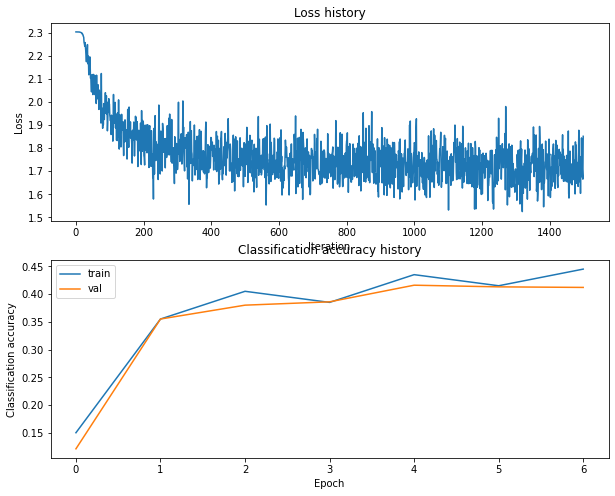

Training network with h_s 25, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.302674
iteration 100 / 1500: loss 2.302290
iteration 200 / 1500: loss 2.296788
iteration 300 / 1500: loss 2.229460
iteration 400 / 1500: loss 2.134194
iteration 500 / 1500: loss 2.089325
iteration 600 / 1500: loss 2.032223
iteration 700 / 1500: loss 2.020472
iteration 800 / 1500: loss 1.972147
iteration 900 / 1500: loss 1.856509
iteration 1000 / 1500: loss 2.085648
iteration 1100 / 1500: loss 1.885323
iteration 1200 / 1500: loss 1.873923
iteration 1300 / 1500: loss 1.853839
iteration 1400 / 1500: loss 1.928777
Validation accuracy:  0.331


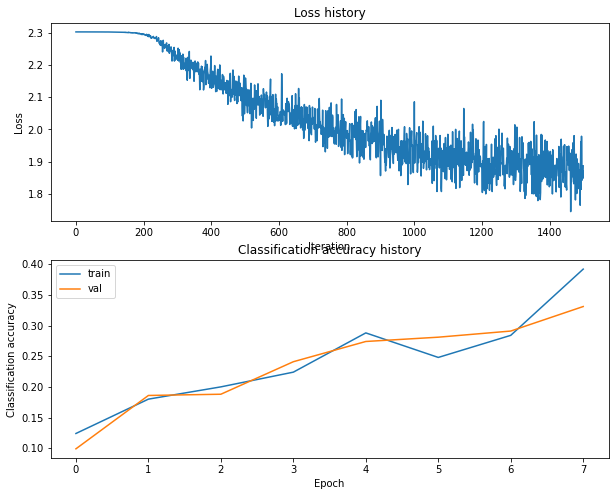

Training network with h_s 25, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.302682
iteration 100 / 1500: loss 1.882611
iteration 200 / 1500: loss 1.906620
iteration 300 / 1500: loss 1.704461
iteration 400 / 1500: loss 1.780934
iteration 500 / 1500: loss 1.913384
iteration 600 / 1500: loss 1.850940
iteration 700 / 1500: loss 1.776176
iteration 800 / 1500: loss 1.700397
iteration 900 / 1500: loss 1.664928
iteration 1000 / 1500: loss 1.841021
iteration 1100 / 1500: loss 1.647196
iteration 1200 / 1500: loss 1.702118
iteration 1300 / 1500: loss 1.740124
iteration 1400 / 1500: loss 1.707623
Validation accuracy:  0.41


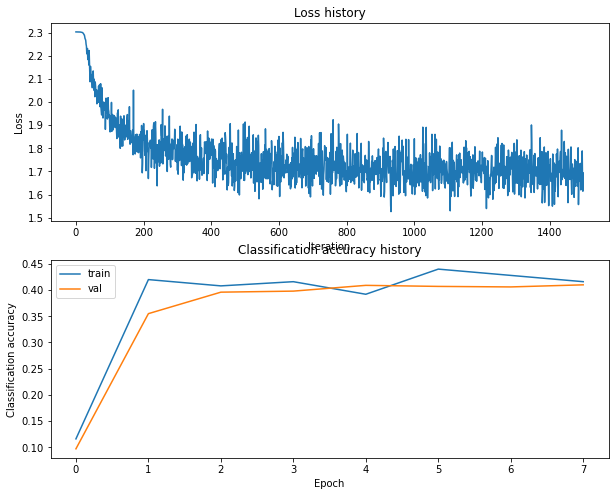

Training network with h_s 25, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.302666
iteration 100 / 1500: loss 2.301965
iteration 200 / 1500: loss 2.283650
iteration 300 / 1500: loss 2.203083
iteration 400 / 1500: loss 2.158863
iteration 500 / 1500: loss 2.045212
iteration 600 / 1500: loss 2.003920
iteration 700 / 1500: loss 2.088963
iteration 800 / 1500: loss 1.939004
iteration 900 / 1500: loss 1.952773
iteration 1000 / 1500: loss 1.967943
iteration 1100 / 1500: loss 1.903048
iteration 1200 / 1500: loss 1.918128
iteration 1300 / 1500: loss 1.876057
iteration 1400 / 1500: loss 1.990497
Validation accuracy:  0.336


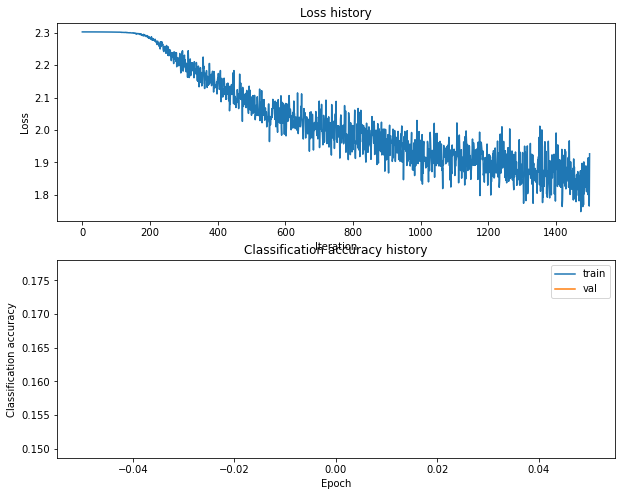

Training network with h_s 25, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.302686
iteration 100 / 1500: loss 1.949435
iteration 200 / 1500: loss 1.872113
iteration 300 / 1500: loss 1.768642
iteration 400 / 1500: loss 1.674285
iteration 500 / 1500: loss 1.782168
iteration 600 / 1500: loss 1.691814
iteration 700 / 1500: loss 1.728964
iteration 800 / 1500: loss 1.701164
iteration 900 / 1500: loss 1.722326
iteration 1000 / 1500: loss 1.712668
iteration 1100 / 1500: loss 1.715835
iteration 1200 / 1500: loss 1.811015
iteration 1300 / 1500: loss 1.662512
iteration 1400 / 1500: loss 1.763976
Validation accuracy:  0.417


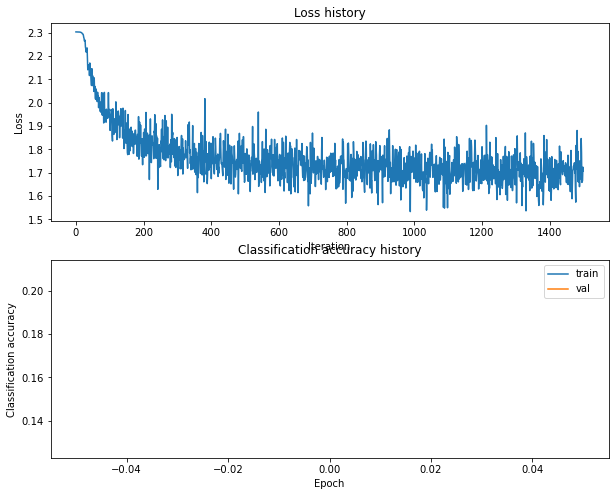

Training network with h_s 25, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.302669
iteration 100 / 1500: loss 2.302050
iteration 200 / 1500: loss 2.290199
iteration 300 / 1500: loss 2.211388
iteration 400 / 1500: loss 2.156161
iteration 500 / 1500: loss 2.118829
iteration 600 / 1500: loss 2.054443
iteration 700 / 1500: loss 2.069251
iteration 800 / 1500: loss 2.007918
iteration 900 / 1500: loss 1.985850
iteration 1000 / 1500: loss 2.010865
iteration 1100 / 1500: loss 2.009151
iteration 1200 / 1500: loss 1.928090
iteration 1300 / 1500: loss 1.876151
iteration 1400 / 1500: loss 1.910455
Validation accuracy:  0.315


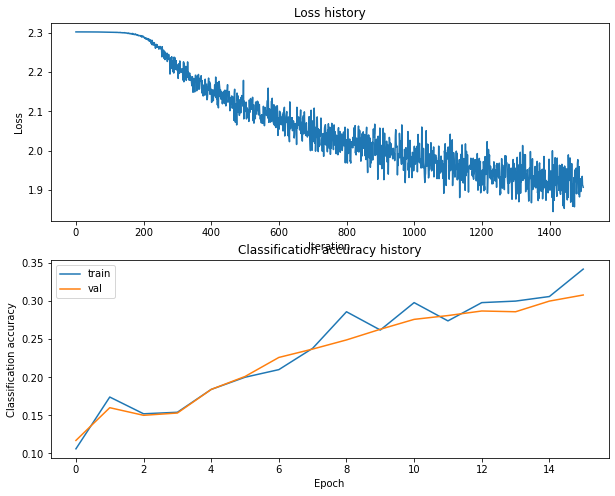

Training network with h_s 25, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.302696
iteration 100 / 1500: loss 1.972874
iteration 200 / 1500: loss 1.899911
iteration 300 / 1500: loss 1.785706
iteration 400 / 1500: loss 1.725454
iteration 500 / 1500: loss 1.807632
iteration 600 / 1500: loss 1.698386
iteration 700 / 1500: loss 1.732583
iteration 800 / 1500: loss 1.659850
iteration 900 / 1500: loss 1.699280
iteration 1000 / 1500: loss 1.681784
iteration 1100 / 1500: loss 1.707608
iteration 1200 / 1500: loss 1.710617
iteration 1300 / 1500: loss 1.617998
iteration 1400 / 1500: loss 1.701346
Validation accuracy:  0.416


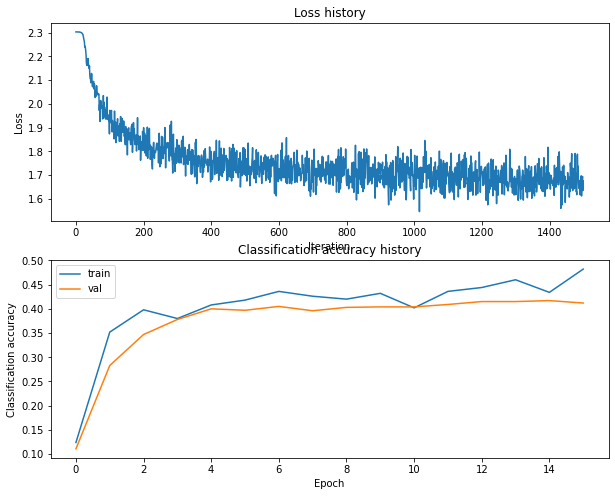

Training network with h_s 25, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.302678
iteration 100 / 2500: loss 2.302071
iteration 200 / 2500: loss 2.285662
iteration 300 / 2500: loss 2.186328
iteration 400 / 2500: loss 2.146555
iteration 500 / 2500: loss 2.091143
iteration 600 / 2500: loss 2.113724
iteration 700 / 2500: loss 2.069257
iteration 800 / 2500: loss 1.968382
iteration 900 / 2500: loss 1.991154
iteration 1000 / 2500: loss 1.985858
iteration 1100 / 2500: loss 1.974914
iteration 1200 / 2500: loss 2.072895
iteration 1300 / 2500: loss 1.864591
iteration 1400 / 2500: loss 1.941647
iteration 1500 / 2500: loss 1.900245
iteration 1600 / 2500: loss 1.784493
iteration 1700 / 2500: loss 1.878059
iteration 1800 / 2500: loss 1.840429
iteration 1900 / 2500: loss 1.790999
iteration 2000 / 2500: loss 1.801485
iteration 2100 / 2500: loss 1.859870
iteration 2200 / 2500: loss 1.769792
iteration 2300 / 2500: loss 1.914126
iteration 2400 / 2500: loss 1.980641
Validation accuracy:  0.368

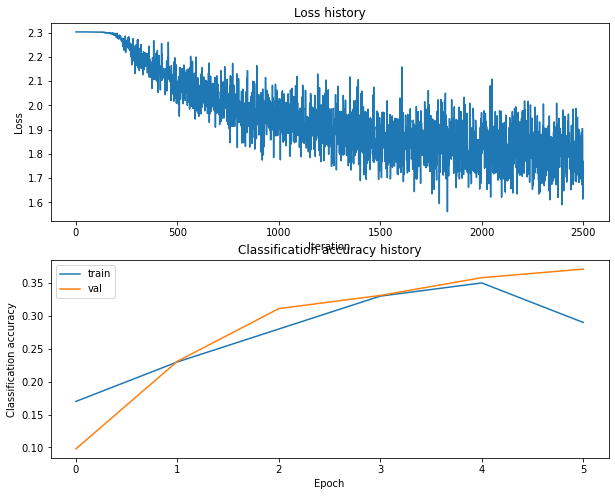

Training network with h_s 25, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.302680
iteration 100 / 2500: loss 2.166730
iteration 200 / 2500: loss 2.025403
iteration 300 / 2500: loss 1.984619
iteration 400 / 2500: loss 1.865868
iteration 500 / 2500: loss 1.942456
iteration 600 / 2500: loss 1.782885
iteration 700 / 2500: loss 1.756670
iteration 800 / 2500: loss 1.613884
iteration 900 / 2500: loss 1.842044
iteration 1000 / 2500: loss 1.754175
iteration 1100 / 2500: loss 1.768074
iteration 1200 / 2500: loss 1.681351
iteration 1300 / 2500: loss 1.702083
iteration 1400 / 2500: loss 1.904617
iteration 1500 / 2500: loss 1.717463
iteration 1600 / 2500: loss 1.668797
iteration 1700 / 2500: loss 1.892168
iteration 1800 / 2500: loss 1.658888
iteration 1900 / 2500: loss 1.744108
iteration 2000 / 2500: loss 1.636897
iteration 2100 / 2500: loss 1.603837
iteration 2200 / 2500: loss 1.721381
iteration 2300 / 2500: loss 1.628439
iteration 2400 / 2500: loss 1.786369
Validation accuracy:  0.393


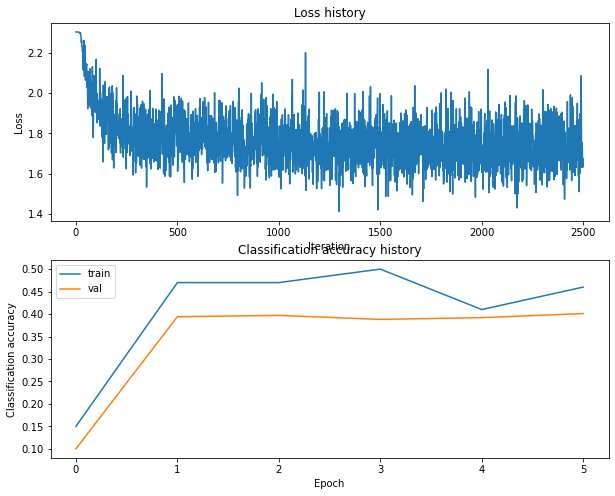

Training network with h_s 25, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.302686
iteration 100 / 2500: loss 2.302114
iteration 200 / 2500: loss 2.290747
iteration 300 / 2500: loss 2.237254
iteration 400 / 2500: loss 2.063589
iteration 500 / 2500: loss 2.096117
iteration 600 / 2500: loss 2.066530
iteration 700 / 2500: loss 2.028658
iteration 800 / 2500: loss 1.953879
iteration 900 / 2500: loss 2.003795
iteration 1000 / 2500: loss 1.961182
iteration 1100 / 2500: loss 1.958143
iteration 1200 / 2500: loss 1.875820
iteration 1300 / 2500: loss 1.881068
iteration 1400 / 2500: loss 1.891192
iteration 1500 / 2500: loss 1.769607
iteration 1600 / 2500: loss 1.833578
iteration 1700 / 2500: loss 1.850726
iteration 1800 / 2500: loss 1.770752
iteration 1900 / 2500: loss 1.800488
iteration 2000 / 2500: loss 1.817590
iteration 2100 / 2500: loss 1.802314
iteration 2200 / 2500: loss 1.841270
iteration 2300 / 2500: loss 1.871476
iteration 2400 / 2500: loss 1.907510
Validation accuracy:  0.36


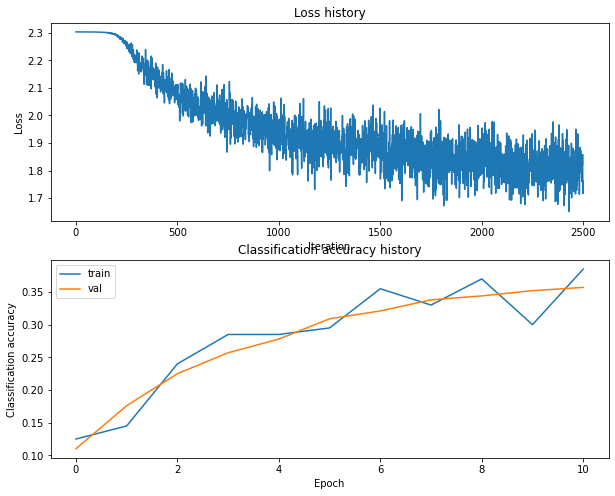

Training network with h_s 25, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.302685
iteration 100 / 2500: loss 1.943833
iteration 200 / 2500: loss 1.832073
iteration 300 / 2500: loss 1.833364
iteration 400 / 2500: loss 1.626787
iteration 500 / 2500: loss 1.675045
iteration 600 / 2500: loss 1.703492
iteration 700 / 2500: loss 1.588379
iteration 800 / 2500: loss 1.734089
iteration 900 / 2500: loss 1.575074
iteration 1000 / 2500: loss 1.832768
iteration 1100 / 2500: loss 1.765305
iteration 1200 / 2500: loss 1.708304
iteration 1300 / 2500: loss 1.797055
iteration 1400 / 2500: loss 1.756359
iteration 1500 / 2500: loss 1.678171
iteration 1600 / 2500: loss 1.706149
iteration 1700 / 2500: loss 1.680142
iteration 1800 / 2500: loss 1.664596
iteration 1900 / 2500: loss 1.663802
iteration 2000 / 2500: loss 1.690284
iteration 2100 / 2500: loss 1.770034
iteration 2200 / 2500: loss 1.626721
iteration 2300 / 2500: loss 1.580253
iteration 2400 / 2500: loss 1.687942
Validation accuracy:  0.406


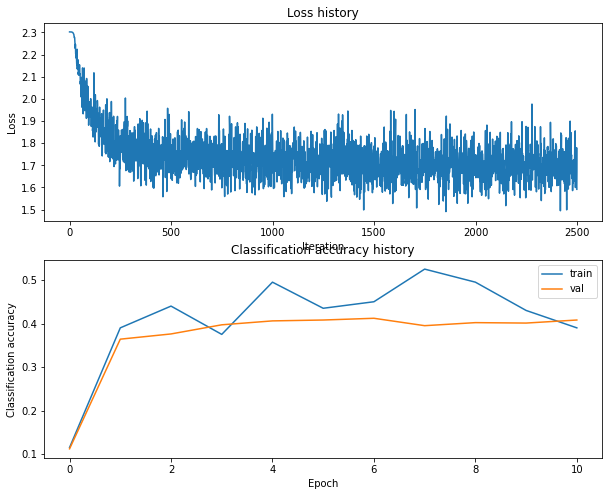

Training network with h_s 25, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.302676
iteration 100 / 2500: loss 2.302117
iteration 200 / 2500: loss 2.287981
iteration 300 / 2500: loss 2.208057
iteration 400 / 2500: loss 2.166673
iteration 500 / 2500: loss 2.106408
iteration 600 / 2500: loss 2.064455
iteration 700 / 2500: loss 2.003564
iteration 800 / 2500: loss 2.008346
iteration 900 / 2500: loss 1.934436
iteration 1000 / 2500: loss 1.995485
iteration 1100 / 2500: loss 1.993723
iteration 1200 / 2500: loss 1.948387
iteration 1300 / 2500: loss 1.922836
iteration 1400 / 2500: loss 1.798852
iteration 1500 / 2500: loss 1.852702
iteration 1600 / 2500: loss 1.804028
iteration 1700 / 2500: loss 1.861831
iteration 1800 / 2500: loss 1.830807
iteration 1900 / 2500: loss 1.858752
iteration 2000 / 2500: loss 1.859490
iteration 2100 / 2500: loss 1.900578
iteration 2200 / 2500: loss 1.824111
iteration 2300 / 2500: loss 1.815283
iteration 2400 / 2500: loss 1.782737
Validation accuracy:  0.362

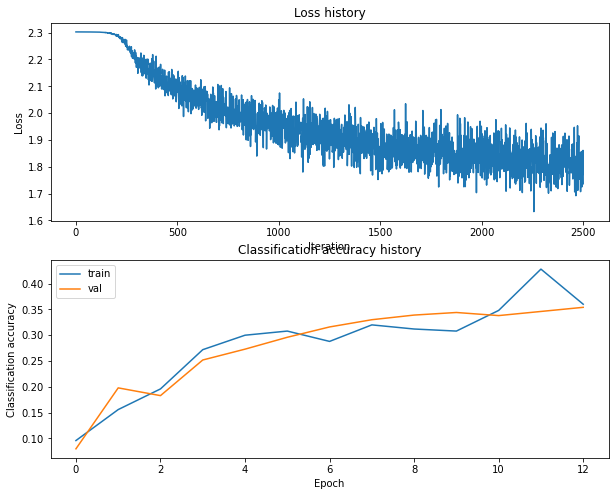

Training network with h_s 25, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.302678
iteration 100 / 2500: loss 1.879679
iteration 200 / 2500: loss 1.779877
iteration 300 / 2500: loss 1.929255
iteration 400 / 2500: loss 1.762168
iteration 500 / 2500: loss 1.722800
iteration 600 / 2500: loss 1.798598
iteration 700 / 2500: loss 1.739261
iteration 800 / 2500: loss 1.640320
iteration 900 / 2500: loss 1.646346
iteration 1000 / 2500: loss 1.662108
iteration 1100 / 2500: loss 1.591949
iteration 1200 / 2500: loss 1.782294
iteration 1300 / 2500: loss 1.739410
iteration 1400 / 2500: loss 1.631966
iteration 1500 / 2500: loss 1.705042
iteration 1600 / 2500: loss 1.868464
iteration 1700 / 2500: loss 1.594861
iteration 1800 / 2500: loss 1.604632
iteration 1900 / 2500: loss 1.752857
iteration 2000 / 2500: loss 1.721068
iteration 2100 / 2500: loss 1.685861
iteration 2200 / 2500: loss 1.821289
iteration 2300 / 2500: loss 1.704458
iteration 2400 / 2500: loss 1.587410
Validation accuracy:  0.407


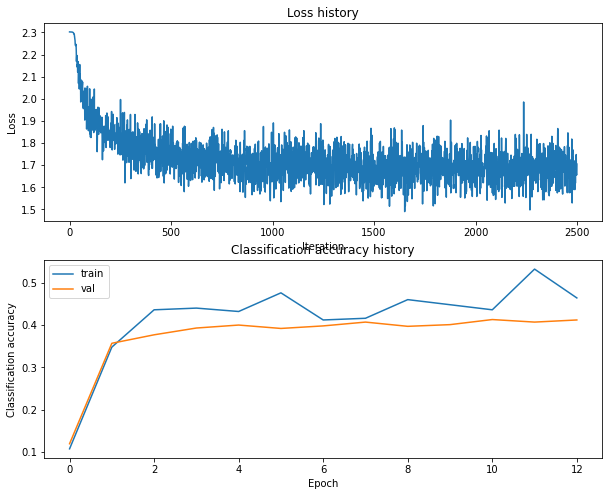

Training network with h_s 25, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.302683
iteration 100 / 2500: loss 2.301962
iteration 200 / 2500: loss 2.293693
iteration 300 / 2500: loss 2.190983
iteration 400 / 2500: loss 2.148267
iteration 500 / 2500: loss 2.094023
iteration 600 / 2500: loss 2.049690
iteration 700 / 2500: loss 1.987995
iteration 800 / 2500: loss 1.950023
iteration 900 / 2500: loss 1.954415
iteration 1000 / 2500: loss 1.857173
iteration 1100 / 2500: loss 1.931261
iteration 1200 / 2500: loss 1.813327
iteration 1300 / 2500: loss 1.946865
iteration 1400 / 2500: loss 1.885930
iteration 1500 / 2500: loss 1.834972
iteration 1600 / 2500: loss 1.792239
iteration 1700 / 2500: loss 1.870365
iteration 1800 / 2500: loss 1.737651
iteration 1900 / 2500: loss 1.910593
iteration 2000 / 2500: loss 1.815284
iteration 2100 / 2500: loss 1.787336
iteration 2200 / 2500: loss 1.802898
iteration 2300 / 2500: loss 1.857878
iteration 2400 / 2500: loss 1.760620
Validation accuracy:  0.374

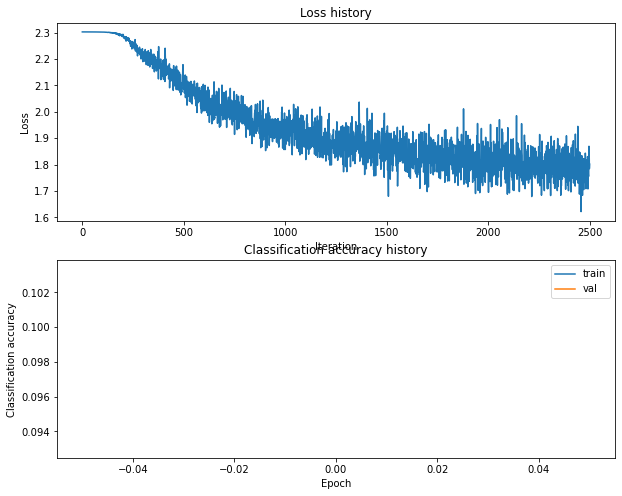

Training network with h_s 25, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.302676
iteration 100 / 2500: loss 1.993719
iteration 200 / 2500: loss 1.893296
iteration 300 / 2500: loss 1.939628
iteration 400 / 2500: loss 1.702416
iteration 500 / 2500: loss 1.765596
iteration 600 / 2500: loss 1.640569
iteration 700 / 2500: loss 1.707104
iteration 800 / 2500: loss 1.740681
iteration 900 / 2500: loss 1.610914
iteration 1000 / 2500: loss 1.705529
iteration 1100 / 2500: loss 1.758190
iteration 1200 / 2500: loss 1.772268
iteration 1300 / 2500: loss 1.695492
iteration 1400 / 2500: loss 1.695187
iteration 1500 / 2500: loss 1.676968
iteration 1600 / 2500: loss 1.756474
iteration 1700 / 2500: loss 1.657236
iteration 1800 / 2500: loss 1.675211
iteration 1900 / 2500: loss 1.683601
iteration 2000 / 2500: loss 1.679895
iteration 2100 / 2500: loss 1.751032
iteration 2200 / 2500: loss 1.755671
iteration 2300 / 2500: loss 1.657919
iteration 2400 / 2500: loss 1.665219
Validation accuracy:  0.396


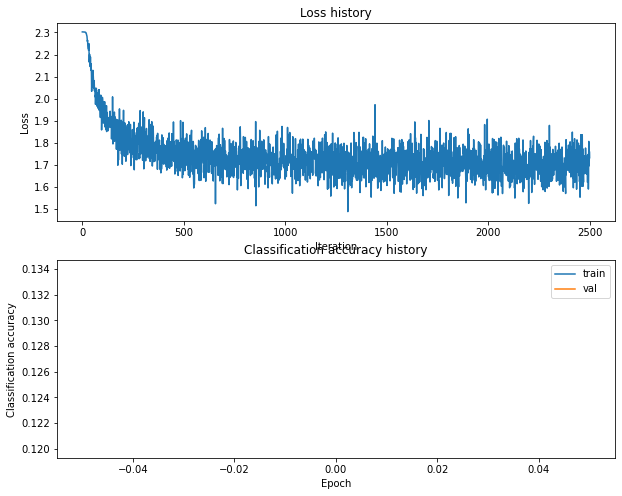

Training network with h_s 25, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.302686
iteration 100 / 2500: loss 2.302010
iteration 200 / 2500: loss 2.287825
iteration 300 / 2500: loss 2.189759
iteration 400 / 2500: loss 2.162476
iteration 500 / 2500: loss 2.118516
iteration 600 / 2500: loss 2.034406
iteration 700 / 2500: loss 2.058082
iteration 800 / 2500: loss 2.028709
iteration 900 / 2500: loss 1.953214
iteration 1000 / 2500: loss 1.974849
iteration 1100 / 2500: loss 2.007364
iteration 1200 / 2500: loss 1.961015
iteration 1300 / 2500: loss 1.937680
iteration 1400 / 2500: loss 1.890887
iteration 1500 / 2500: loss 1.946289
iteration 1600 / 2500: loss 1.862538
iteration 1700 / 2500: loss 1.930492
iteration 1800 / 2500: loss 1.884442
iteration 1900 / 2500: loss 1.859620
iteration 2000 / 2500: loss 1.881216
iteration 2100 / 2500: loss 1.901558
iteration 2200 / 2500: loss 1.823067
iteration 2300 / 2500: loss 1.847362
iteration 2400 / 2500: loss 1.885736
Validation accuracy:  0.339

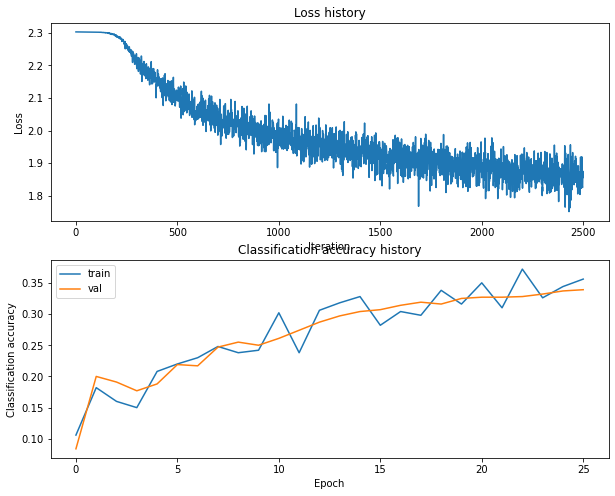

Training network with h_s 25, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.302668
iteration 100 / 2500: loss 1.969849
iteration 200 / 2500: loss 1.805470
iteration 300 / 2500: loss 1.786520
iteration 400 / 2500: loss 1.734499
iteration 500 / 2500: loss 1.655742
iteration 600 / 2500: loss 1.714577
iteration 700 / 2500: loss 1.806632
iteration 800 / 2500: loss 1.671792
iteration 900 / 2500: loss 1.768429
iteration 1000 / 2500: loss 1.728104
iteration 1100 / 2500: loss 1.721118
iteration 1200 / 2500: loss 1.711739
iteration 1300 / 2500: loss 1.655467
iteration 1400 / 2500: loss 1.669199
iteration 1500 / 2500: loss 1.723546
iteration 1600 / 2500: loss 1.687818
iteration 1700 / 2500: loss 1.677850
iteration 1800 / 2500: loss 1.669598
iteration 1900 / 2500: loss 1.670197
iteration 2000 / 2500: loss 1.716991
iteration 2100 / 2500: loss 1.663347
iteration 2200 / 2500: loss 1.726821
iteration 2300 / 2500: loss 1.704859
iteration 2400 / 2500: loss 1.690982
Validation accuracy:  0.428


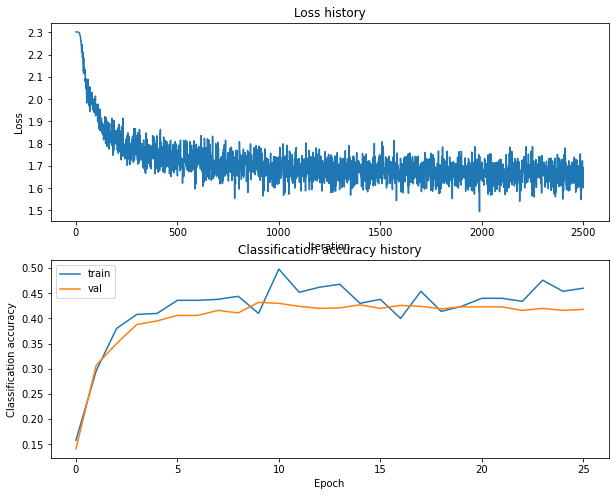

Training network with h_s 25, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.302680
iteration 100 / 5000: loss 2.302026
iteration 200 / 5000: loss 2.289048
iteration 300 / 5000: loss 2.248873
iteration 400 / 5000: loss 2.193374
iteration 500 / 5000: loss 2.066838
iteration 600 / 5000: loss 2.018451
iteration 700 / 5000: loss 1.981561
iteration 800 / 5000: loss 2.001155
iteration 900 / 5000: loss 1.917775
iteration 1000 / 5000: loss 1.991359
iteration 1100 / 5000: loss 1.967111
iteration 1200 / 5000: loss 1.861314
iteration 1300 / 5000: loss 1.766241
iteration 1400 / 5000: loss 1.801439
iteration 1500 / 5000: loss 1.844666
iteration 1600 / 5000: loss 1.810575
iteration 1700 / 5000: loss 1.897228
iteration 1800 / 5000: loss 1.879898
iteration 1900 / 5000: loss 1.828592
iteration 2000 / 5000: loss 1.837715
iteration 2100 / 5000: loss 1.734296
iteration 2200 / 5000: loss 1.794911
iteration 2300 / 5000: loss 1.702566
iteration 2400 / 5000: loss 1.802888
iteration 2500 / 5000: loss

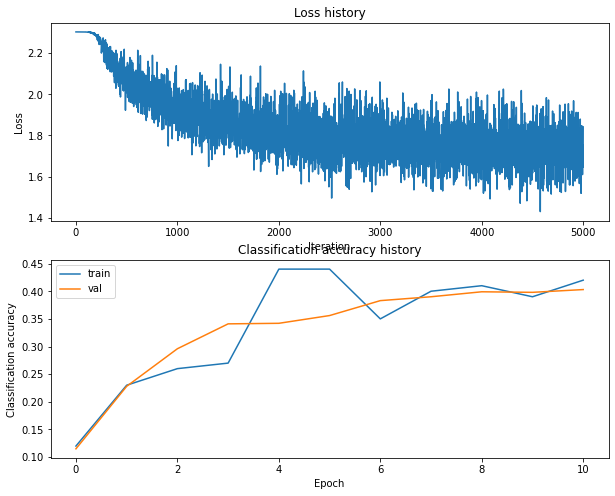

Training network with h_s 25, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.302677
iteration 100 / 5000: loss 2.012066
iteration 200 / 5000: loss 2.010429
iteration 300 / 5000: loss 1.970434
iteration 400 / 5000: loss 1.872064
iteration 500 / 5000: loss 1.742117
iteration 600 / 5000: loss 1.835783
iteration 700 / 5000: loss 1.878225
iteration 800 / 5000: loss 1.865620
iteration 900 / 5000: loss 1.783410
iteration 1000 / 5000: loss 1.688291
iteration 1100 / 5000: loss 1.659360
iteration 1200 / 5000: loss 1.719183
iteration 1300 / 5000: loss 1.676011
iteration 1400 / 5000: loss 1.674917
iteration 1500 / 5000: loss 1.825154
iteration 1600 / 5000: loss 1.795430
iteration 1700 / 5000: loss 1.765928
iteration 1800 / 5000: loss 1.859165
iteration 1900 / 5000: loss 1.761464
iteration 2000 / 5000: loss 1.671230
iteration 2100 / 5000: loss 1.551958
iteration 2200 / 5000: loss 1.815775
iteration 2300 / 5000: loss 1.780958
iteration 2400 / 5000: loss 1.773379
iteration 2500 / 5000: loss 

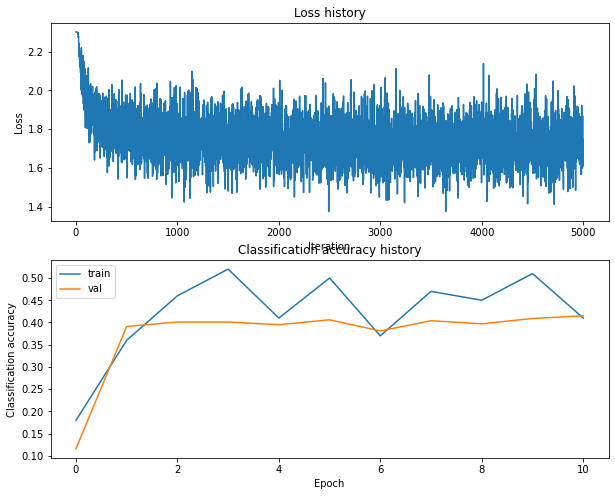

Training network with h_s 25, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.302674
iteration 100 / 5000: loss 2.301936
iteration 200 / 5000: loss 2.285787
iteration 300 / 5000: loss 2.222210
iteration 400 / 5000: loss 2.106539
iteration 500 / 5000: loss 2.094066
iteration 600 / 5000: loss 2.036153
iteration 700 / 5000: loss 2.006899
iteration 800 / 5000: loss 1.952778
iteration 900 / 5000: loss 1.914367
iteration 1000 / 5000: loss 1.948662
iteration 1100 / 5000: loss 1.911774
iteration 1200 / 5000: loss 1.883865
iteration 1300 / 5000: loss 1.919887
iteration 1400 / 5000: loss 1.895159
iteration 1500 / 5000: loss 1.844449
iteration 1600 / 5000: loss 1.816050
iteration 1700 / 5000: loss 1.866674
iteration 1800 / 5000: loss 1.741255
iteration 1900 / 5000: loss 1.914221
iteration 2000 / 5000: loss 1.749432
iteration 2100 / 5000: loss 1.812496
iteration 2200 / 5000: loss 1.658622
iteration 2300 / 5000: loss 1.864040
iteration 2400 / 5000: loss 1.758779
iteration 2500 / 5000: loss

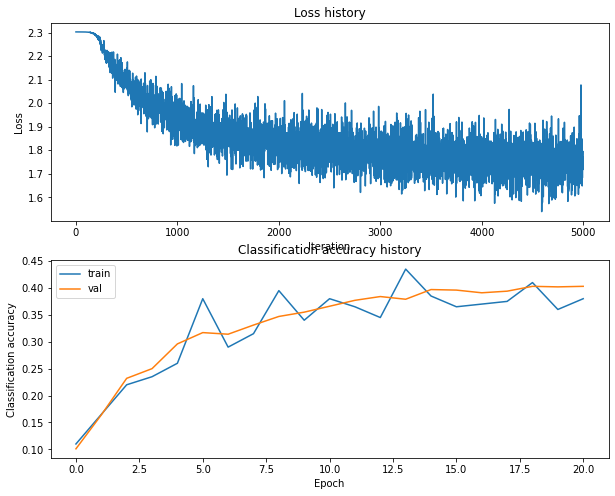

Training network with h_s 25, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.302673
iteration 100 / 5000: loss 1.880263
iteration 200 / 5000: loss 1.907291
iteration 300 / 5000: loss 1.671418
iteration 400 / 5000: loss 1.730977
iteration 500 / 5000: loss 1.651892
iteration 600 / 5000: loss 1.675388
iteration 700 / 5000: loss 1.673316
iteration 800 / 5000: loss 1.757558
iteration 900 / 5000: loss 1.681998
iteration 1000 / 5000: loss 1.629623
iteration 1100 / 5000: loss 1.612585
iteration 1200 / 5000: loss 1.718975
iteration 1300 / 5000: loss 1.679305
iteration 1400 / 5000: loss 1.713644
iteration 1500 / 5000: loss 1.679580
iteration 1600 / 5000: loss 1.696336
iteration 1700 / 5000: loss 1.797424
iteration 1800 / 5000: loss 1.737294
iteration 1900 / 5000: loss 1.640493
iteration 2000 / 5000: loss 1.576968
iteration 2100 / 5000: loss 1.560206
iteration 2200 / 5000: loss 1.722431
iteration 2300 / 5000: loss 1.783118
iteration 2400 / 5000: loss 1.750275
iteration 2500 / 5000: loss 

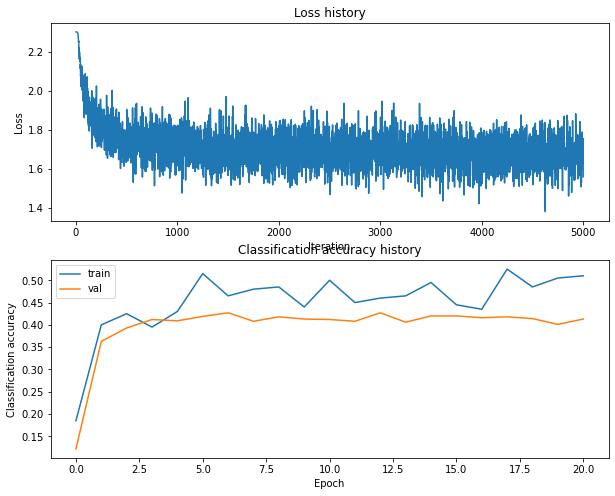

Training network with h_s 25, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.302677
iteration 100 / 5000: loss 2.302047
iteration 200 / 5000: loss 2.279461
iteration 300 / 5000: loss 2.241371
iteration 400 / 5000: loss 2.161421
iteration 500 / 5000: loss 2.127433
iteration 600 / 5000: loss 2.025326
iteration 700 / 5000: loss 2.018676
iteration 800 / 5000: loss 2.000372
iteration 900 / 5000: loss 1.943740
iteration 1000 / 5000: loss 1.983463
iteration 1100 / 5000: loss 1.884053
iteration 1200 / 5000: loss 1.891278
iteration 1300 / 5000: loss 1.893530
iteration 1400 / 5000: loss 1.884285
iteration 1500 / 5000: loss 1.894499
iteration 1600 / 5000: loss 1.821396
iteration 1700 / 5000: loss 1.856544
iteration 1800 / 5000: loss 1.913441
iteration 1900 / 5000: loss 1.939426
iteration 2000 / 5000: loss 1.915357
iteration 2100 / 5000: loss 1.854852
iteration 2200 / 5000: loss 1.808191
iteration 2300 / 5000: loss 1.748825
iteration 2400 / 5000: loss 1.797790
iteration 2500 / 5000: loss

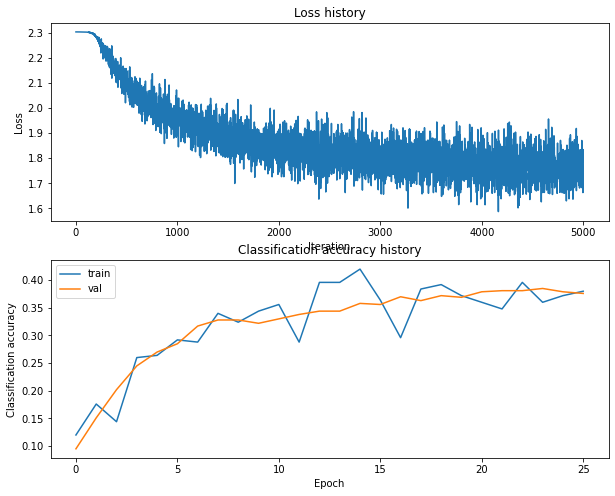

Training network with h_s 25, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.302702
iteration 100 / 5000: loss 1.973701
iteration 200 / 5000: loss 1.847423
iteration 300 / 5000: loss 1.773346
iteration 400 / 5000: loss 1.725435
iteration 500 / 5000: loss 1.784136
iteration 600 / 5000: loss 1.730643
iteration 700 / 5000: loss 1.568675
iteration 800 / 5000: loss 1.708121
iteration 900 / 5000: loss 1.668671
iteration 1000 / 5000: loss 1.666525
iteration 1100 / 5000: loss 1.761369
iteration 1200 / 5000: loss 1.673965
iteration 1300 / 5000: loss 1.783774
iteration 1400 / 5000: loss 1.683861
iteration 1500 / 5000: loss 1.714633
iteration 1600 / 5000: loss 1.639434
iteration 1700 / 5000: loss 1.769178
iteration 1800 / 5000: loss 1.652203
iteration 1900 / 5000: loss 1.732170
iteration 2000 / 5000: loss 1.748985
iteration 2100 / 5000: loss 1.489934
iteration 2200 / 5000: loss 1.795235
iteration 2300 / 5000: loss 1.558056
iteration 2400 / 5000: loss 1.652528
iteration 2500 / 5000: loss 

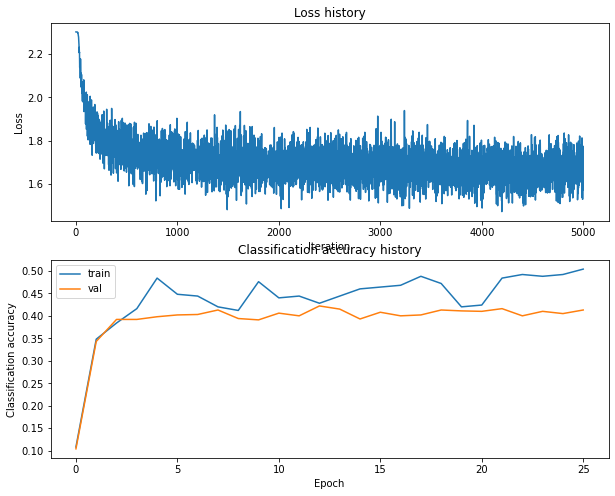

Training network with h_s 25, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.302694
iteration 100 / 5000: loss 2.302145
iteration 200 / 5000: loss 2.291523
iteration 300 / 5000: loss 2.194502
iteration 400 / 5000: loss 2.120296
iteration 500 / 5000: loss 2.107099
iteration 600 / 5000: loss 2.054453
iteration 700 / 5000: loss 1.996253
iteration 800 / 5000: loss 1.942314
iteration 900 / 5000: loss 2.041755
iteration 1000 / 5000: loss 1.936780
iteration 1100 / 5000: loss 1.909219
iteration 1200 / 5000: loss 1.899230
iteration 1300 / 5000: loss 1.928512
iteration 1400 / 5000: loss 1.856136
iteration 1500 / 5000: loss 1.873014
iteration 1600 / 5000: loss 1.853409
iteration 1700 / 5000: loss 1.814959
iteration 1800 / 5000: loss 1.880566
iteration 1900 / 5000: loss 1.747588
iteration 2000 / 5000: loss 1.815048
iteration 2100 / 5000: loss 1.893607
iteration 2200 / 5000: loss 1.893434
iteration 2300 / 5000: loss 1.795067
iteration 2400 / 5000: loss 1.710337
iteration 2500 / 5000: loss

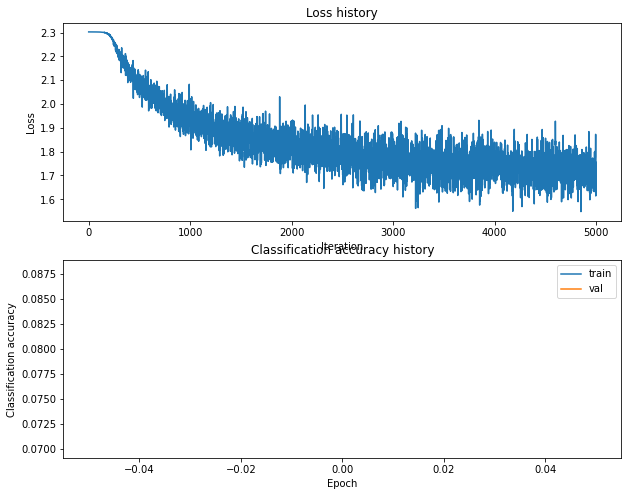

Training network with h_s 25, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.302680
iteration 100 / 5000: loss 1.907350
iteration 200 / 5000: loss 1.876416
iteration 300 / 5000: loss 1.882608
iteration 400 / 5000: loss 1.708983
iteration 500 / 5000: loss 1.643990
iteration 600 / 5000: loss 1.758520
iteration 700 / 5000: loss 1.804629
iteration 800 / 5000: loss 1.657478
iteration 900 / 5000: loss 1.719871
iteration 1000 / 5000: loss 1.769918
iteration 1100 / 5000: loss 1.626709
iteration 1200 / 5000: loss 1.701230
iteration 1300 / 5000: loss 1.586925
iteration 1400 / 5000: loss 1.707363
iteration 1500 / 5000: loss 1.672951
iteration 1600 / 5000: loss 1.694226
iteration 1700 / 5000: loss 1.720716
iteration 1800 / 5000: loss 1.765752
iteration 1900 / 5000: loss 1.629195
iteration 2000 / 5000: loss 1.690978
iteration 2100 / 5000: loss 1.761648
iteration 2200 / 5000: loss 1.741975
iteration 2300 / 5000: loss 1.675082
iteration 2400 / 5000: loss 1.763980
iteration 2500 / 5000: loss 

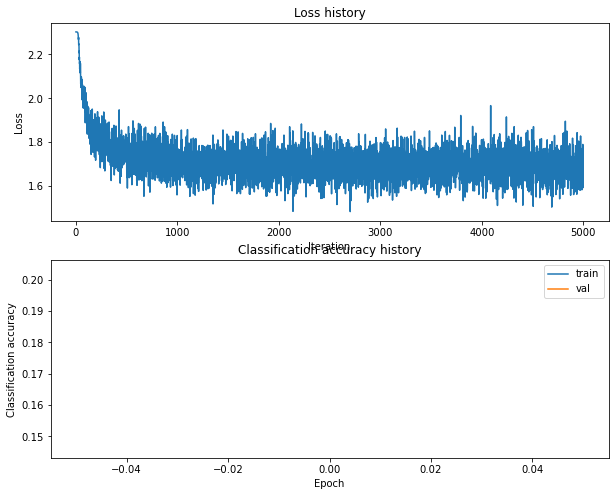

Training network with h_s 25, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.302689
iteration 100 / 5000: loss 2.302272
iteration 200 / 5000: loss 2.293247
iteration 300 / 5000: loss 2.231697
iteration 400 / 5000: loss 2.174864
iteration 500 / 5000: loss 2.127408
iteration 600 / 5000: loss 2.068404
iteration 700 / 5000: loss 2.049991
iteration 800 / 5000: loss 1.947701
iteration 900 / 5000: loss 2.033142
iteration 1000 / 5000: loss 1.935276
iteration 1100 / 5000: loss 1.939762
iteration 1200 / 5000: loss 1.941666
iteration 1300 / 5000: loss 1.937654
iteration 1400 / 5000: loss 1.895875
iteration 1500 / 5000: loss 1.871567
iteration 1600 / 5000: loss 1.912530
iteration 1700 / 5000: loss 1.925612
iteration 1800 / 5000: loss 1.841516
iteration 1900 / 5000: loss 1.907632
iteration 2000 / 5000: loss 1.903664
iteration 2100 / 5000: loss 1.870631
iteration 2200 / 5000: loss 1.827955
iteration 2300 / 5000: loss 1.859623
iteration 2400 / 5000: loss 1.829145
iteration 2500 / 5000: loss

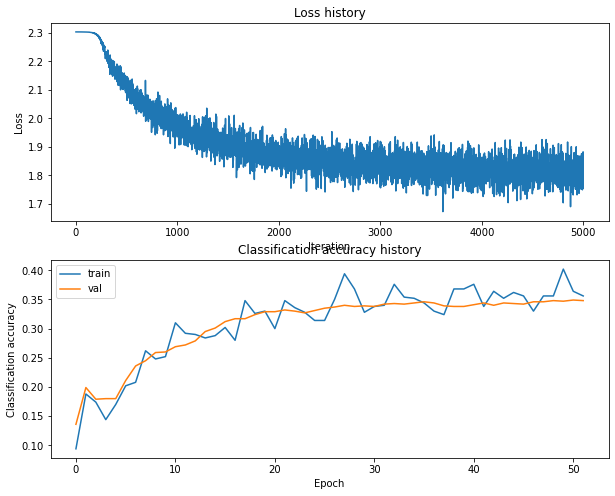

Training network with h_s 25, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.302677
iteration 100 / 5000: loss 1.981599
iteration 200 / 5000: loss 1.801323
iteration 300 / 5000: loss 1.777262
iteration 400 / 5000: loss 1.710546
iteration 500 / 5000: loss 1.719621
iteration 600 / 5000: loss 1.672849
iteration 700 / 5000: loss 1.731507
iteration 800 / 5000: loss 1.676121
iteration 900 / 5000: loss 1.737437
iteration 1000 / 5000: loss 1.741867
iteration 1100 / 5000: loss 1.658846
iteration 1200 / 5000: loss 1.727797
iteration 1300 / 5000: loss 1.734721
iteration 1400 / 5000: loss 1.673881
iteration 1500 / 5000: loss 1.654888
iteration 1600 / 5000: loss 1.690254
iteration 1700 / 5000: loss 1.756721
iteration 1800 / 5000: loss 1.650460
iteration 1900 / 5000: loss 1.628965
iteration 2000 / 5000: loss 1.696208
iteration 2100 / 5000: loss 1.674550
iteration 2200 / 5000: loss 1.680922
iteration 2300 / 5000: loss 1.567656
iteration 2400 / 5000: loss 1.550463
iteration 2500 / 5000: loss 

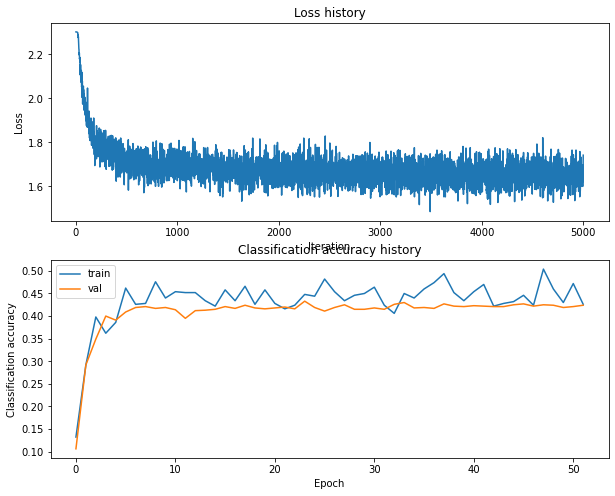

Training network with h_s 25, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.302679
iteration 100 / 10000: loss 2.302184
iteration 200 / 10000: loss 2.291850
iteration 300 / 10000: loss 2.210282
iteration 400 / 10000: loss 2.115726
iteration 500 / 10000: loss 2.052848
iteration 600 / 10000: loss 2.012711
iteration 700 / 10000: loss 2.090719
iteration 800 / 10000: loss 1.904655
iteration 900 / 10000: loss 1.863377
iteration 1000 / 10000: loss 1.852416
iteration 1100 / 10000: loss 1.864083
iteration 1200 / 10000: loss 1.892093
iteration 1300 / 10000: loss 1.859301
iteration 1400 / 10000: loss 1.881356
iteration 1500 / 10000: loss 1.777663
iteration 1600 / 10000: loss 1.790189
iteration 1700 / 10000: loss 1.720743
iteration 1800 / 10000: loss 1.784177
iteration 1900 / 10000: loss 1.964909
iteration 2000 / 10000: loss 1.951288
iteration 2100 / 10000: loss 1.870755
iteration 2200 / 10000: loss 1.592298
iteration 2300 / 10000: loss 1.827984
iteration 2400 / 10000: loss 1.750402
i

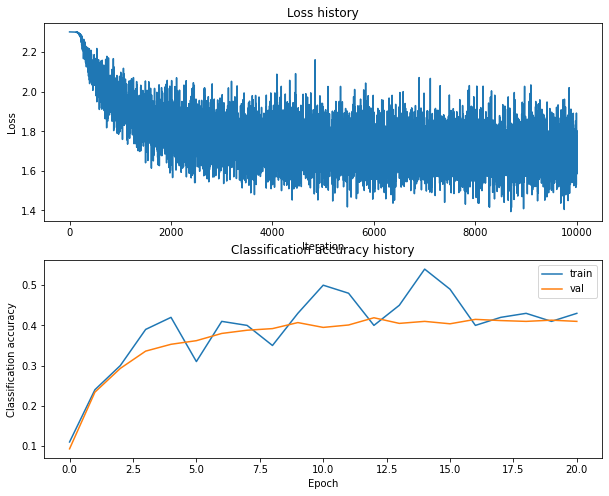

Training network with h_s 25, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.302693
iteration 100 / 10000: loss 1.762743
iteration 200 / 10000: loss 1.699429
iteration 300 / 10000: loss 1.737188
iteration 400 / 10000: loss 1.729476
iteration 500 / 10000: loss 1.602580
iteration 600 / 10000: loss 1.849133
iteration 700 / 10000: loss 1.902897
iteration 800 / 10000: loss 1.764103
iteration 900 / 10000: loss 1.704127
iteration 1000 / 10000: loss 1.626541
iteration 1100 / 10000: loss 1.853053
iteration 1200 / 10000: loss 1.593380
iteration 1300 / 10000: loss 1.680666
iteration 1400 / 10000: loss 1.799983
iteration 1500 / 10000: loss 1.674794
iteration 1600 / 10000: loss 1.626589
iteration 1700 / 10000: loss 1.734209
iteration 1800 / 10000: loss 1.818840
iteration 1900 / 10000: loss 1.775889
iteration 2000 / 10000: loss 1.627984
iteration 2100 / 10000: loss 1.855518
iteration 2200 / 10000: loss 1.655549
iteration 2300 / 10000: loss 1.737808
iteration 2400 / 10000: loss 1.920022
it

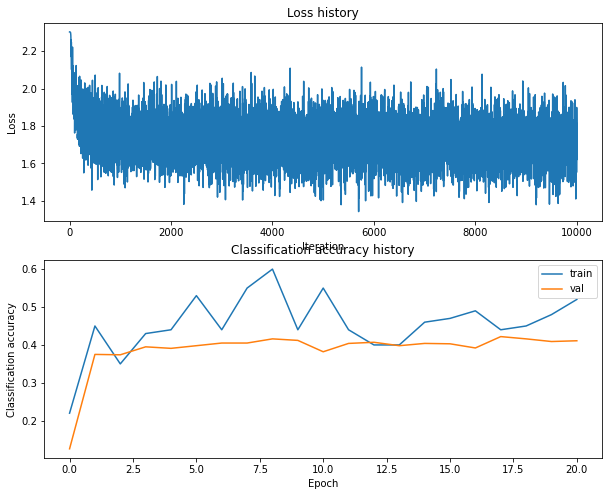

Training network with h_s 25, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.302680
iteration 100 / 10000: loss 2.302477
iteration 200 / 10000: loss 2.297635
iteration 300 / 10000: loss 2.248465
iteration 400 / 10000: loss 2.170863
iteration 500 / 10000: loss 2.025663
iteration 600 / 10000: loss 2.043005
iteration 700 / 10000: loss 1.972627
iteration 800 / 10000: loss 2.003462
iteration 900 / 10000: loss 1.963542
iteration 1000 / 10000: loss 1.925342
iteration 1100 / 10000: loss 1.940511
iteration 1200 / 10000: loss 1.907261
iteration 1300 / 10000: loss 1.922503
iteration 1400 / 10000: loss 1.830355
iteration 1500 / 10000: loss 1.835966
iteration 1600 / 10000: loss 1.915597
iteration 1700 / 10000: loss 1.748053
iteration 1800 / 10000: loss 1.875396
iteration 1900 / 10000: loss 1.849868
iteration 2000 / 10000: loss 1.887894
iteration 2100 / 10000: loss 1.746103
iteration 2200 / 10000: loss 1.744429
iteration 2300 / 10000: loss 1.885780
iteration 2400 / 10000: loss 1.873236
i

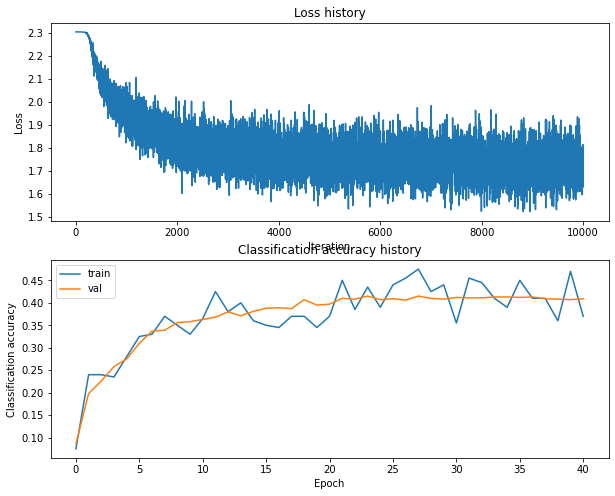

Training network with h_s 25, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.302681
iteration 100 / 10000: loss 1.973487
iteration 200 / 10000: loss 1.832736
iteration 300 / 10000: loss 1.733614
iteration 400 / 10000: loss 1.740970
iteration 500 / 10000: loss 1.811244
iteration 600 / 10000: loss 1.651156
iteration 700 / 10000: loss 1.784102
iteration 800 / 10000: loss 1.650309
iteration 900 / 10000: loss 1.702832
iteration 1000 / 10000: loss 1.741680
iteration 1100 / 10000: loss 1.806029
iteration 1200 / 10000: loss 1.943959
iteration 1300 / 10000: loss 1.759528
iteration 1400 / 10000: loss 1.586128
iteration 1500 / 10000: loss 1.758247
iteration 1600 / 10000: loss 1.817487
iteration 1700 / 10000: loss 1.789025
iteration 1800 / 10000: loss 1.847759
iteration 1900 / 10000: loss 1.812424
iteration 2000 / 10000: loss 1.745001
iteration 2100 / 10000: loss 1.728786
iteration 2200 / 10000: loss 1.668328
iteration 2300 / 10000: loss 1.659375
iteration 2400 / 10000: loss 1.602886
it

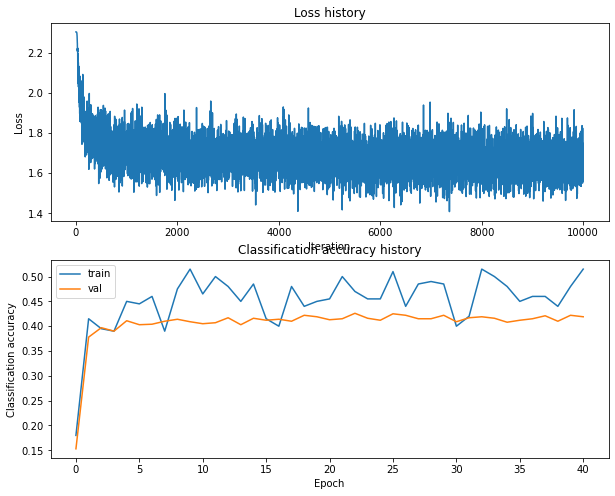

Training network with h_s 25, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.302678
iteration 100 / 10000: loss 2.302175
iteration 200 / 10000: loss 2.288757
iteration 300 / 10000: loss 2.174291
iteration 400 / 10000: loss 2.153592
iteration 500 / 10000: loss 2.105241
iteration 600 / 10000: loss 2.071103
iteration 700 / 10000: loss 1.984874
iteration 800 / 10000: loss 1.984625
iteration 900 / 10000: loss 2.006244
iteration 1000 / 10000: loss 1.892680
iteration 1100 / 10000: loss 1.969172
iteration 1200 / 10000: loss 1.884853
iteration 1300 / 10000: loss 1.982109
iteration 1400 / 10000: loss 1.918479
iteration 1500 / 10000: loss 1.851027
iteration 1600 / 10000: loss 1.891173
iteration 1700 / 10000: loss 1.771907
iteration 1800 / 10000: loss 1.873360
iteration 1900 / 10000: loss 1.806341
iteration 2000 / 10000: loss 1.741133
iteration 2100 / 10000: loss 1.785106
iteration 2200 / 10000: loss 1.851828
iteration 2300 / 10000: loss 1.813958
iteration 2400 / 10000: loss 1.814023
i

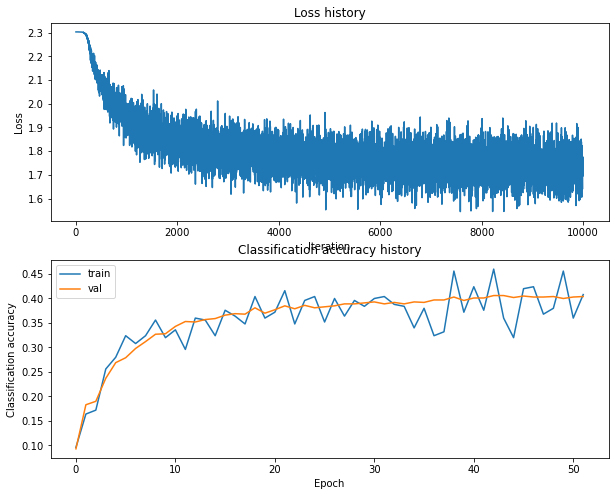

Training network with h_s 25, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.302670
iteration 100 / 10000: loss 1.950888
iteration 200 / 10000: loss 1.735856
iteration 300 / 10000: loss 1.697985
iteration 400 / 10000: loss 1.727572
iteration 500 / 10000: loss 1.798962
iteration 600 / 10000: loss 1.829774
iteration 700 / 10000: loss 1.613129
iteration 800 / 10000: loss 1.709428
iteration 900 / 10000: loss 1.630487
iteration 1000 / 10000: loss 1.715377
iteration 1100 / 10000: loss 1.712625
iteration 1200 / 10000: loss 1.783528
iteration 1300 / 10000: loss 1.798931
iteration 1400 / 10000: loss 1.624509
iteration 1500 / 10000: loss 1.773508
iteration 1600 / 10000: loss 1.727241
iteration 1700 / 10000: loss 1.649736
iteration 1800 / 10000: loss 1.644448
iteration 1900 / 10000: loss 1.689351
iteration 2000 / 10000: loss 1.586865
iteration 2100 / 10000: loss 1.759824
iteration 2200 / 10000: loss 1.705031
iteration 2300 / 10000: loss 1.601729
iteration 2400 / 10000: loss 1.696398
it

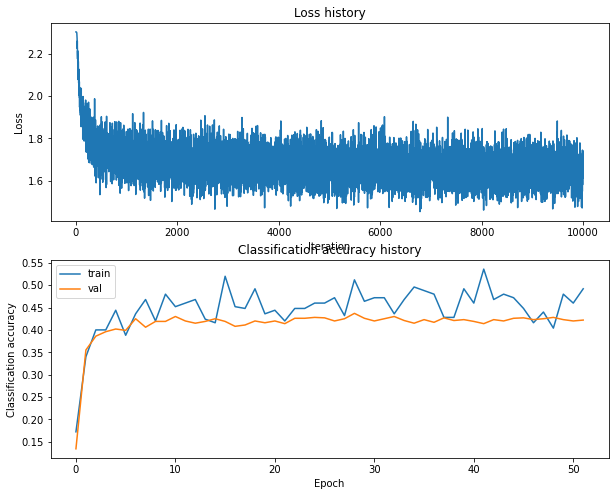

Training network with h_s 25, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.302695
iteration 100 / 10000: loss 2.302251
iteration 200 / 10000: loss 2.295475
iteration 300 / 10000: loss 2.199125
iteration 400 / 10000: loss 2.112409
iteration 500 / 10000: loss 2.023268
iteration 600 / 10000: loss 2.030285
iteration 700 / 10000: loss 2.002123
iteration 800 / 10000: loss 1.989249
iteration 900 / 10000: loss 1.953457
iteration 1000 / 10000: loss 1.909795
iteration 1100 / 10000: loss 1.936455
iteration 1200 / 10000: loss 1.824476
iteration 1300 / 10000: loss 1.886172
iteration 1400 / 10000: loss 1.835194
iteration 1500 / 10000: loss 1.786898
iteration 1600 / 10000: loss 1.794179
iteration 1700 / 10000: loss 1.850896
iteration 1800 / 10000: loss 1.803219
iteration 1900 / 10000: loss 1.878154
iteration 2000 / 10000: loss 1.831502
iteration 2100 / 10000: loss 1.777967
iteration 2200 / 10000: loss 1.797558
iteration 2300 / 10000: loss 1.746906
iteration 2400 / 10000: loss 1.637626
i

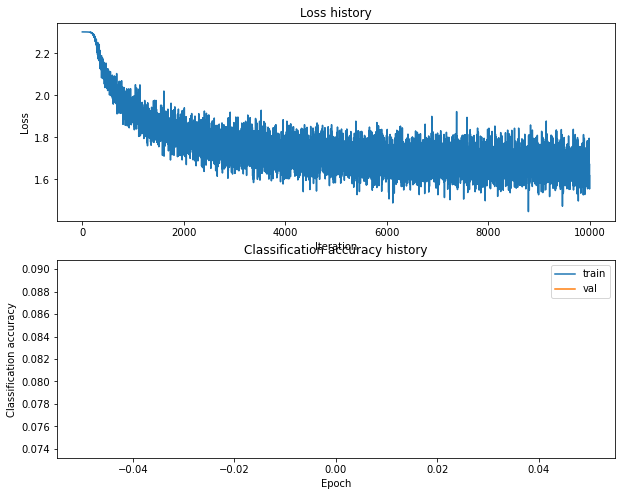

Training network with h_s 25, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.302688
iteration 100 / 10000: loss 1.866973
iteration 200 / 10000: loss 1.747283
iteration 300 / 10000: loss 1.711686
iteration 400 / 10000: loss 1.713070
iteration 500 / 10000: loss 1.745791
iteration 600 / 10000: loss 1.684174
iteration 700 / 10000: loss 1.787157
iteration 800 / 10000: loss 1.669254
iteration 900 / 10000: loss 1.799709
iteration 1000 / 10000: loss 1.685104
iteration 1100 / 10000: loss 1.662049
iteration 1200 / 10000: loss 1.768528
iteration 1300 / 10000: loss 1.758498
iteration 1400 / 10000: loss 1.731823
iteration 1500 / 10000: loss 1.617584
iteration 1600 / 10000: loss 1.821320
iteration 1700 / 10000: loss 1.603687
iteration 1800 / 10000: loss 1.782326
iteration 1900 / 10000: loss 1.688542
iteration 2000 / 10000: loss 1.768667
iteration 2100 / 10000: loss 1.654546
iteration 2200 / 10000: loss 1.761493
iteration 2300 / 10000: loss 1.678972
iteration 2400 / 10000: loss 1.608665
it

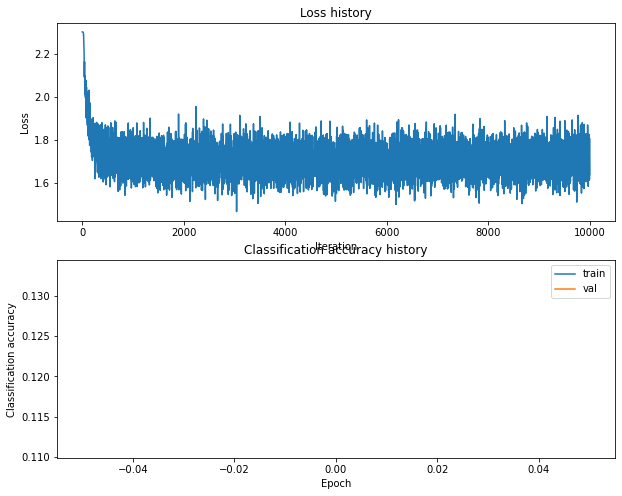

Training network with h_s 25, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.302682
iteration 100 / 10000: loss 2.302284
iteration 200 / 10000: loss 2.292549
iteration 300 / 10000: loss 2.197056
iteration 400 / 10000: loss 2.153677
iteration 500 / 10000: loss 2.112633
iteration 600 / 10000: loss 2.069290
iteration 700 / 10000: loss 2.026456
iteration 800 / 10000: loss 2.004288
iteration 900 / 10000: loss 2.039904
iteration 1000 / 10000: loss 1.977701
iteration 1100 / 10000: loss 1.953411
iteration 1200 / 10000: loss 1.935596
iteration 1300 / 10000: loss 1.974870
iteration 1400 / 10000: loss 1.926686
iteration 1500 / 10000: loss 1.917435
iteration 1600 / 10000: loss 1.932190
iteration 1700 / 10000: loss 1.892889
iteration 1800 / 10000: loss 1.898326
iteration 1900 / 10000: loss 1.864186
iteration 2000 / 10000: loss 1.837485
iteration 2100 / 10000: loss 1.922594
iteration 2200 / 10000: loss 1.867421
iteration 2300 / 10000: loss 1.838518
iteration 2400 / 10000: loss 1.844583
i

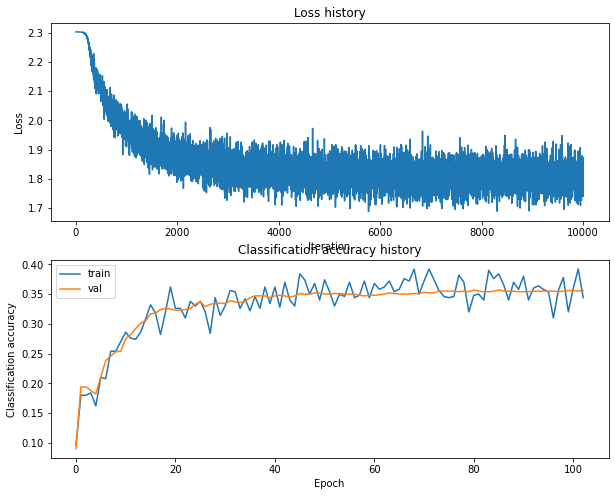

Training network with h_s 25, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.302679
iteration 100 / 10000: loss 1.951750
iteration 200 / 10000: loss 1.777875
iteration 300 / 10000: loss 1.812926
iteration 400 / 10000: loss 1.822932
iteration 500 / 10000: loss 1.800260
iteration 600 / 10000: loss 1.760614
iteration 700 / 10000: loss 1.776276
iteration 800 / 10000: loss 1.742683
iteration 900 / 10000: loss 1.698389
iteration 1000 / 10000: loss 1.717088
iteration 1100 / 10000: loss 1.695961
iteration 1200 / 10000: loss 1.650029
iteration 1300 / 10000: loss 1.680883
iteration 1400 / 10000: loss 1.647448
iteration 1500 / 10000: loss 1.701806
iteration 1600 / 10000: loss 1.692067
iteration 1700 / 10000: loss 1.633295
iteration 1800 / 10000: loss 1.711771
iteration 1900 / 10000: loss 1.632154
iteration 2000 / 10000: loss 1.674361
iteration 2100 / 10000: loss 1.666858
iteration 2200 / 10000: loss 1.706719
iteration 2300 / 10000: loss 1.709281
iteration 2400 / 10000: loss 1.622243
it

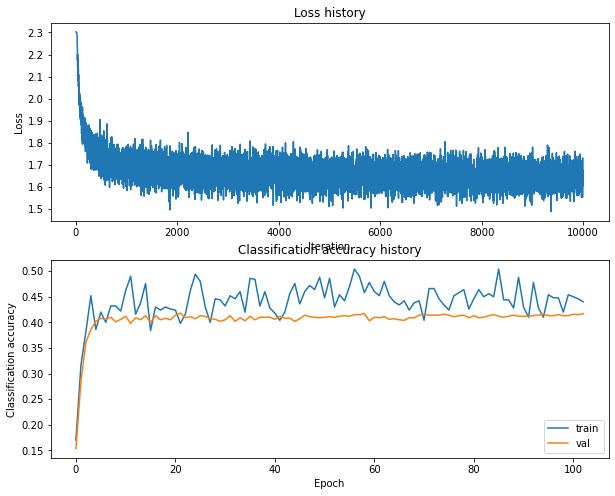

Training network with h_s 25, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.302680
iteration 100 / 15000: loss 2.302251
iteration 200 / 15000: loss 2.293776
iteration 300 / 15000: loss 2.243364
iteration 400 / 15000: loss 2.169431
iteration 500 / 15000: loss 2.059000
iteration 600 / 15000: loss 2.046619
iteration 700 / 15000: loss 2.102121
iteration 800 / 15000: loss 1.941801
iteration 900 / 15000: loss 2.082623
iteration 1000 / 15000: loss 1.951591
iteration 1100 / 15000: loss 1.924307
iteration 1200 / 15000: loss 1.869878
iteration 1300 / 15000: loss 1.856245
iteration 1400 / 15000: loss 1.751852
iteration 1500 / 15000: loss 1.891202
iteration 1600 / 15000: loss 1.961108
iteration 1700 / 15000: loss 1.948663
iteration 1800 / 15000: loss 1.878377
iteration 1900 / 15000: loss 1.784033
iteration 2000 / 15000: loss 1.868621
iteration 2100 / 15000: loss 1.786122
iteration 2200 / 15000: loss 1.806605
iteration 2300 / 15000: loss 1.731881
iteration 2400 / 15000: loss 1.782716
i

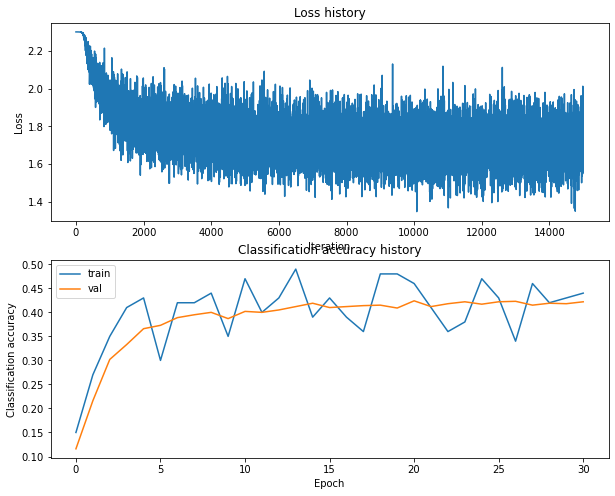

Training network with h_s 25, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.302701
iteration 100 / 15000: loss 1.855070
iteration 200 / 15000: loss 1.873143
iteration 300 / 15000: loss 1.842983
iteration 400 / 15000: loss 1.663022
iteration 500 / 15000: loss 1.597428
iteration 600 / 15000: loss 1.545821
iteration 700 / 15000: loss 1.754418
iteration 800 / 15000: loss 1.678943
iteration 900 / 15000: loss 1.771636
iteration 1000 / 15000: loss 1.668711
iteration 1100 / 15000: loss 1.664692
iteration 1200 / 15000: loss 1.731760
iteration 1300 / 15000: loss 1.956027
iteration 1400 / 15000: loss 1.678701
iteration 1500 / 15000: loss 1.634024
iteration 1600 / 15000: loss 1.594046
iteration 1700 / 15000: loss 1.629890
iteration 1800 / 15000: loss 1.679319
iteration 1900 / 15000: loss 1.756269
iteration 2000 / 15000: loss 1.636050
iteration 2100 / 15000: loss 1.855285
iteration 2200 / 15000: loss 1.566594
iteration 2300 / 15000: loss 1.917850
iteration 2400 / 15000: loss 1.674582
it

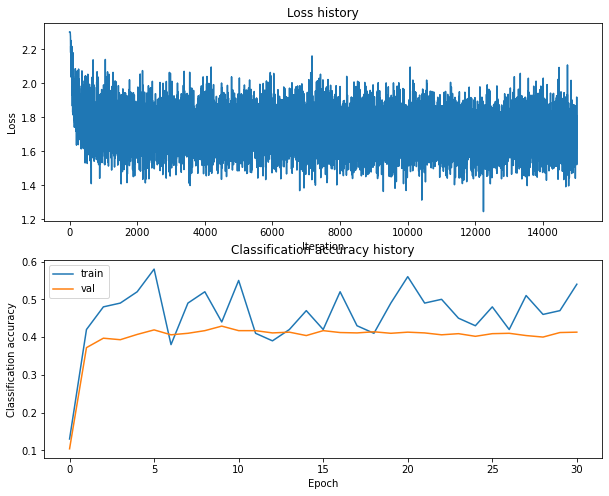

Training network with h_s 25, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.302672
iteration 100 / 15000: loss 2.301932
iteration 200 / 15000: loss 2.280330
iteration 300 / 15000: loss 2.159616
iteration 400 / 15000: loss 2.137570
iteration 500 / 15000: loss 2.090031
iteration 600 / 15000: loss 2.096858
iteration 700 / 15000: loss 2.093459
iteration 800 / 15000: loss 1.929871
iteration 900 / 15000: loss 2.071499
iteration 1000 / 15000: loss 1.961493
iteration 1100 / 15000: loss 1.938472
iteration 1200 / 15000: loss 2.014308
iteration 1300 / 15000: loss 1.908832
iteration 1400 / 15000: loss 1.842257
iteration 1500 / 15000: loss 1.841387
iteration 1600 / 15000: loss 1.819098
iteration 1700 / 15000: loss 1.874768
iteration 1800 / 15000: loss 1.889480
iteration 1900 / 15000: loss 1.966555
iteration 2000 / 15000: loss 1.782059
iteration 2100 / 15000: loss 1.895841
iteration 2200 / 15000: loss 1.855192
iteration 2300 / 15000: loss 1.786919
iteration 2400 / 15000: loss 1.839767
i

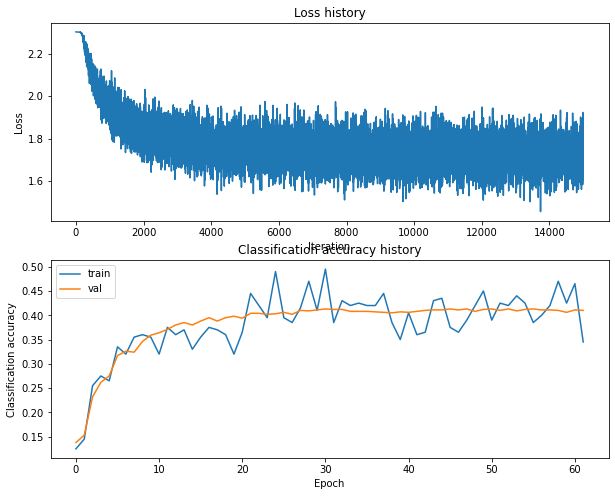

Training network with h_s 25, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.302695
iteration 100 / 15000: loss 1.916082
iteration 200 / 15000: loss 1.813008
iteration 300 / 15000: loss 1.783396
iteration 400 / 15000: loss 1.788765
iteration 500 / 15000: loss 1.718138
iteration 600 / 15000: loss 1.817920
iteration 700 / 15000: loss 1.809918
iteration 800 / 15000: loss 1.760939
iteration 900 / 15000: loss 1.825349
iteration 1000 / 15000: loss 1.577301
iteration 1100 / 15000: loss 1.748686
iteration 1200 / 15000: loss 1.752782
iteration 1300 / 15000: loss 1.632176
iteration 1400 / 15000: loss 1.705118
iteration 1500 / 15000: loss 1.606839
iteration 1600 / 15000: loss 1.745348
iteration 1700 / 15000: loss 1.707709
iteration 1800 / 15000: loss 1.687247
iteration 1900 / 15000: loss 1.845564
iteration 2000 / 15000: loss 1.711611
iteration 2100 / 15000: loss 1.757301
iteration 2200 / 15000: loss 1.659268
iteration 2300 / 15000: loss 1.634114
iteration 2400 / 15000: loss 1.613495
it

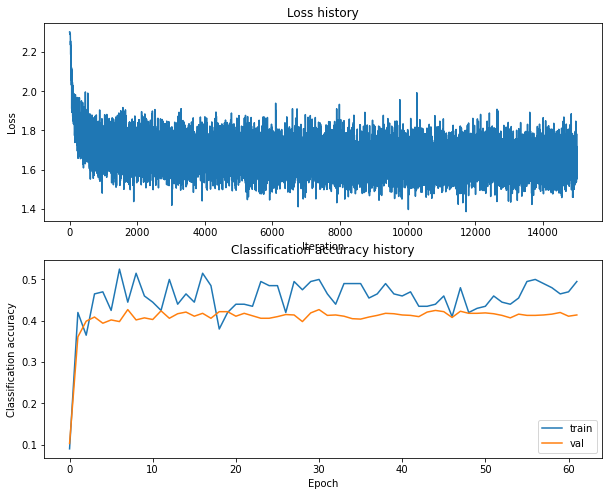

Training network with h_s 25, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.302702
iteration 100 / 15000: loss 2.302253
iteration 200 / 15000: loss 2.294576
iteration 300 / 15000: loss 2.194247
iteration 400 / 15000: loss 2.175413
iteration 500 / 15000: loss 2.065723
iteration 600 / 15000: loss 2.079990
iteration 700 / 15000: loss 2.041696
iteration 800 / 15000: loss 2.009119
iteration 900 / 15000: loss 1.971786
iteration 1000 / 15000: loss 1.945951
iteration 1100 / 15000: loss 1.925090
iteration 1200 / 15000: loss 1.925010
iteration 1300 / 15000: loss 1.877354
iteration 1400 / 15000: loss 1.870175
iteration 1500 / 15000: loss 1.876856
iteration 1600 / 15000: loss 1.890256
iteration 1700 / 15000: loss 1.848270
iteration 1800 / 15000: loss 1.841474
iteration 1900 / 15000: loss 1.869318
iteration 2000 / 15000: loss 1.810462
iteration 2100 / 15000: loss 1.766435
iteration 2200 / 15000: loss 1.790485
iteration 2300 / 15000: loss 1.860649
iteration 2400 / 15000: loss 1.769344
i

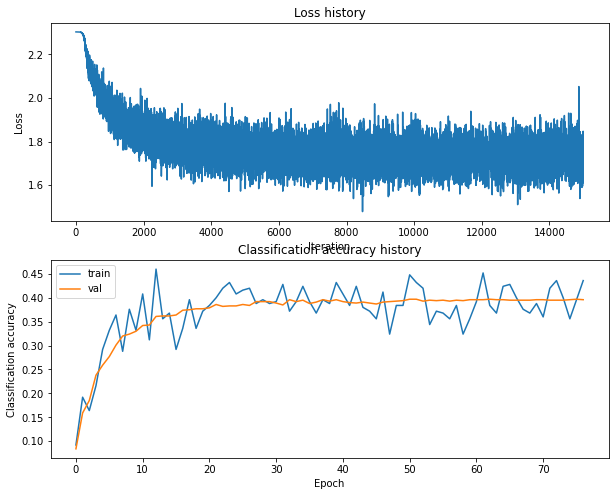

Training network with h_s 25, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.302663
iteration 100 / 15000: loss 1.922515
iteration 200 / 15000: loss 1.806454
iteration 300 / 15000: loss 1.766892
iteration 400 / 15000: loss 1.764668
iteration 500 / 15000: loss 1.802522
iteration 600 / 15000: loss 1.724729
iteration 700 / 15000: loss 1.698339
iteration 800 / 15000: loss 1.794667
iteration 900 / 15000: loss 1.816843
iteration 1000 / 15000: loss 1.612132
iteration 1100 / 15000: loss 1.735407
iteration 1200 / 15000: loss 1.768584
iteration 1300 / 15000: loss 1.784483
iteration 1400 / 15000: loss 1.712963
iteration 1500 / 15000: loss 1.802092
iteration 1600 / 15000: loss 1.784182
iteration 1700 / 15000: loss 1.691373
iteration 1800 / 15000: loss 1.636365
iteration 1900 / 15000: loss 1.798185
iteration 2000 / 15000: loss 1.629879
iteration 2100 / 15000: loss 1.573866
iteration 2200 / 15000: loss 1.617460
iteration 2300 / 15000: loss 1.714961
iteration 2400 / 15000: loss 1.562760
it

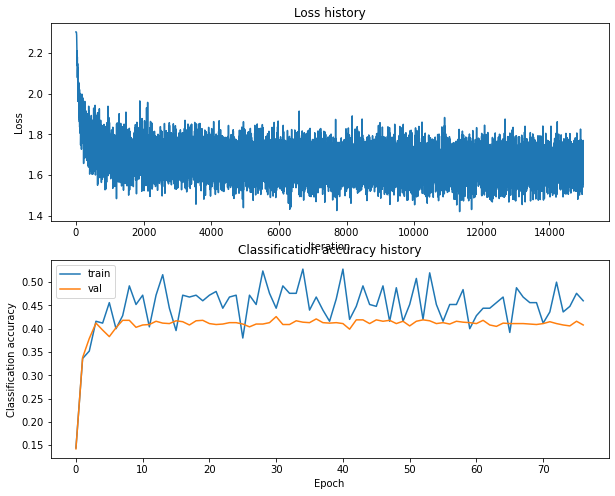

Training network with h_s 25, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.302683
iteration 100 / 15000: loss 2.302288
iteration 200 / 15000: loss 2.295254
iteration 300 / 15000: loss 2.196514
iteration 400 / 15000: loss 2.131702
iteration 500 / 15000: loss 2.064546
iteration 600 / 15000: loss 2.036117
iteration 700 / 15000: loss 2.003721
iteration 800 / 15000: loss 2.025481
iteration 900 / 15000: loss 1.910130
iteration 1000 / 15000: loss 1.856071
iteration 1100 / 15000: loss 1.889699
iteration 1200 / 15000: loss 1.909869
iteration 1300 / 15000: loss 1.929021
iteration 1400 / 15000: loss 1.853144
iteration 1500 / 15000: loss 1.804522
iteration 1600 / 15000: loss 1.798835
iteration 1700 / 15000: loss 1.815024
iteration 1800 / 15000: loss 1.868586
iteration 1900 / 15000: loss 1.806150
iteration 2000 / 15000: loss 1.780279
iteration 2100 / 15000: loss 1.765619
iteration 2200 / 15000: loss 1.772767
iteration 2300 / 15000: loss 1.821161
iteration 2400 / 15000: loss 1.758214
i

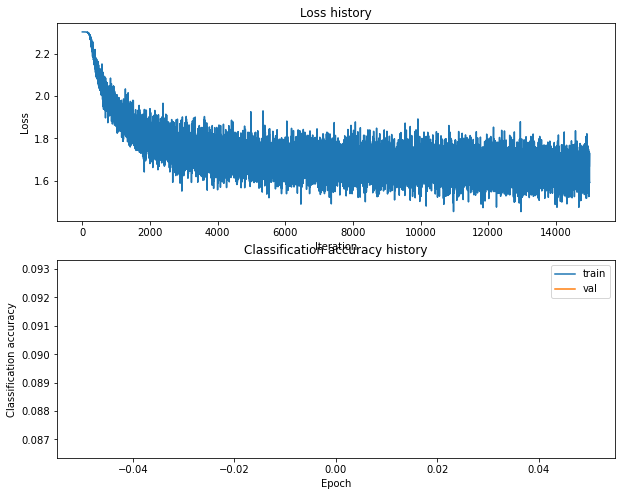

Training network with h_s 25, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.302689
iteration 100 / 15000: loss 1.934203
iteration 200 / 15000: loss 1.831601
iteration 300 / 15000: loss 1.726500
iteration 400 / 15000: loss 1.676196
iteration 500 / 15000: loss 1.692728
iteration 600 / 15000: loss 1.710992
iteration 700 / 15000: loss 1.737985
iteration 800 / 15000: loss 1.674207
iteration 900 / 15000: loss 1.671767
iteration 1000 / 15000: loss 1.650338
iteration 1100 / 15000: loss 1.647389
iteration 1200 / 15000: loss 1.648105
iteration 1300 / 15000: loss 1.795214
iteration 1400 / 15000: loss 1.636432
iteration 1500 / 15000: loss 1.705829
iteration 1600 / 15000: loss 1.704684
iteration 1700 / 15000: loss 1.777555
iteration 1800 / 15000: loss 1.749513
iteration 1900 / 15000: loss 1.744171
iteration 2000 / 15000: loss 1.619179
iteration 2100 / 15000: loss 1.725059
iteration 2200 / 15000: loss 1.712344
iteration 2300 / 15000: loss 1.658604
iteration 2400 / 15000: loss 1.769396
it

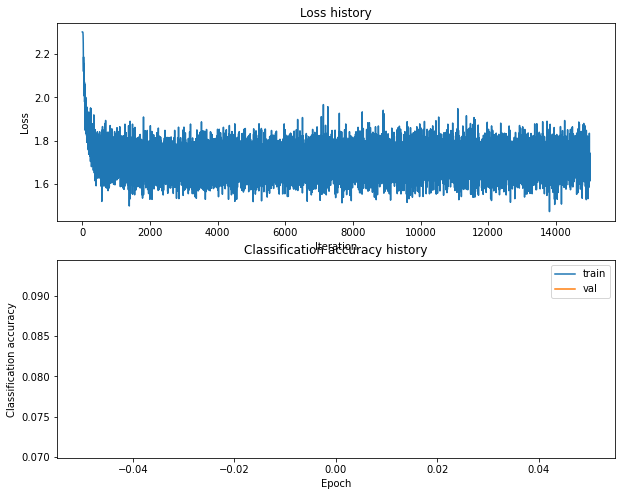

Training network with h_s 25, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.302675
iteration 100 / 15000: loss 2.301997
iteration 200 / 15000: loss 2.290826
iteration 300 / 15000: loss 2.215218
iteration 400 / 15000: loss 2.178313
iteration 500 / 15000: loss 2.112897
iteration 600 / 15000: loss 2.114394
iteration 700 / 15000: loss 2.047555
iteration 800 / 15000: loss 2.001763
iteration 900 / 15000: loss 1.996986
iteration 1000 / 15000: loss 1.947643
iteration 1100 / 15000: loss 1.871174
iteration 1200 / 15000: loss 1.931643
iteration 1300 / 15000: loss 1.912475
iteration 1400 / 15000: loss 1.898886
iteration 1500 / 15000: loss 1.885533
iteration 1600 / 15000: loss 1.917472
iteration 1700 / 15000: loss 1.928070
iteration 1800 / 15000: loss 1.882837
iteration 1900 / 15000: loss 1.899920
iteration 2000 / 15000: loss 1.874722
iteration 2100 / 15000: loss 1.845006
iteration 2200 / 15000: loss 1.881801
iteration 2300 / 15000: loss 1.877116
iteration 2400 / 15000: loss 1.838451
i

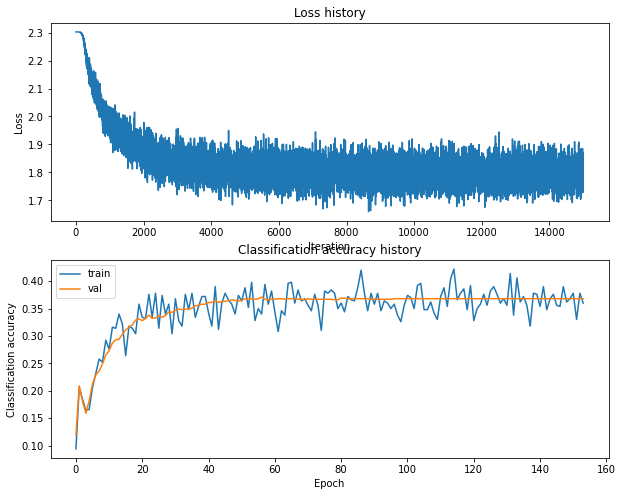

Training network with h_s 25, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.302670
iteration 100 / 15000: loss 1.939140
iteration 200 / 15000: loss 1.847353
iteration 300 / 15000: loss 1.802690
iteration 400 / 15000: loss 1.789529
iteration 500 / 15000: loss 1.817902
iteration 600 / 15000: loss 1.752092
iteration 700 / 15000: loss 1.672215
iteration 800 / 15000: loss 1.735026
iteration 900 / 15000: loss 1.709458
iteration 1000 / 15000: loss 1.712074
iteration 1100 / 15000: loss 1.617709
iteration 1200 / 15000: loss 1.675185
iteration 1300 / 15000: loss 1.707903
iteration 1400 / 15000: loss 1.654476
iteration 1500 / 15000: loss 1.722995
iteration 1600 / 15000: loss 1.708095
iteration 1700 / 15000: loss 1.660666
iteration 1800 / 15000: loss 1.665623
iteration 1900 / 15000: loss 1.681574
iteration 2000 / 15000: loss 1.643664
iteration 2100 / 15000: loss 1.724450
iteration 2200 / 15000: loss 1.822126
iteration 2300 / 15000: loss 1.630573
iteration 2400 / 15000: loss 1.647156
it

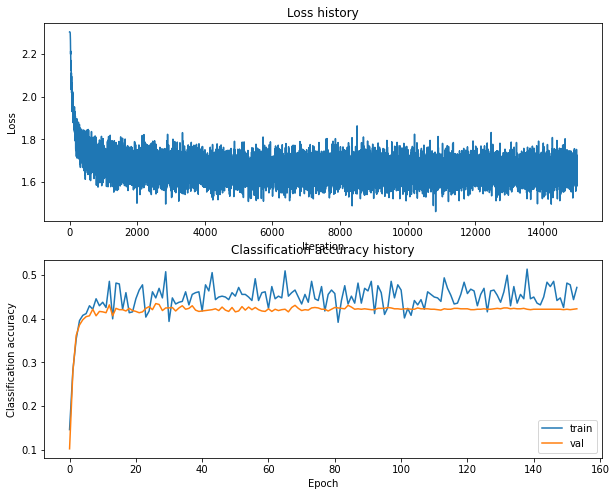

Training network with h_s 25, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.302673
iteration 100 / 20000: loss 2.302387
iteration 200 / 20000: loss 2.291669
iteration 300 / 20000: loss 2.183621
iteration 400 / 20000: loss 2.114297
iteration 500 / 20000: loss 2.059637
iteration 600 / 20000: loss 2.056399
iteration 700 / 20000: loss 2.064451
iteration 800 / 20000: loss 1.905627
iteration 900 / 20000: loss 2.002987
iteration 1000 / 20000: loss 1.884259
iteration 1100 / 20000: loss 1.982559
iteration 1200 / 20000: loss 1.865939
iteration 1300 / 20000: loss 1.795190
iteration 1400 / 20000: loss 1.891868
iteration 1500 / 20000: loss 1.880064
iteration 1600 / 20000: loss 1.704979
iteration 1700 / 20000: loss 1.973539
iteration 1800 / 20000: loss 1.780155
iteration 1900 / 20000: loss 1.819228
iteration 2000 / 20000: loss 1.743235
iteration 2100 / 20000: loss 1.880868
iteration 2200 / 20000: loss 1.864228
iteration 2300 / 20000: loss 1.808004
iteration 2400 / 20000: loss 1.745105
i

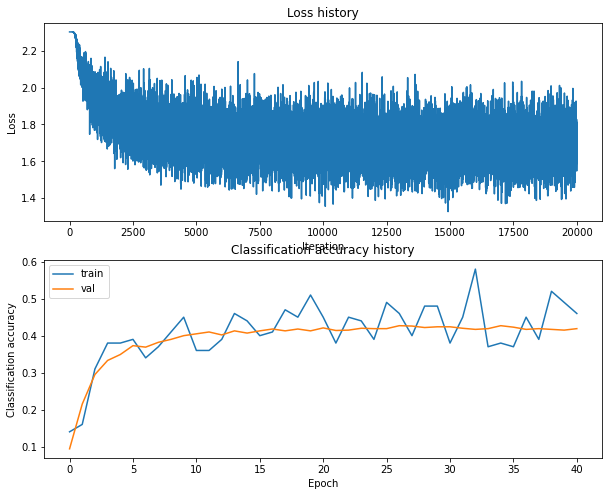

Training network with h_s 25, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.302666
iteration 100 / 20000: loss 1.852011
iteration 200 / 20000: loss 1.826687
iteration 300 / 20000: loss 1.699173
iteration 400 / 20000: loss 1.784621
iteration 500 / 20000: loss 1.637418
iteration 600 / 20000: loss 1.671791
iteration 700 / 20000: loss 1.741930
iteration 800 / 20000: loss 1.732446
iteration 900 / 20000: loss 1.762194
iteration 1000 / 20000: loss 1.749256
iteration 1100 / 20000: loss 1.812472
iteration 1200 / 20000: loss 1.705808
iteration 1300 / 20000: loss 1.895998
iteration 1400 / 20000: loss 1.736930
iteration 1500 / 20000: loss 1.635555
iteration 1600 / 20000: loss 1.662795
iteration 1700 / 20000: loss 1.868382
iteration 1800 / 20000: loss 1.597664
iteration 1900 / 20000: loss 1.682019
iteration 2000 / 20000: loss 1.638969
iteration 2100 / 20000: loss 1.831443
iteration 2200 / 20000: loss 1.652813
iteration 2300 / 20000: loss 1.666772
iteration 2400 / 20000: loss 1.704455
it

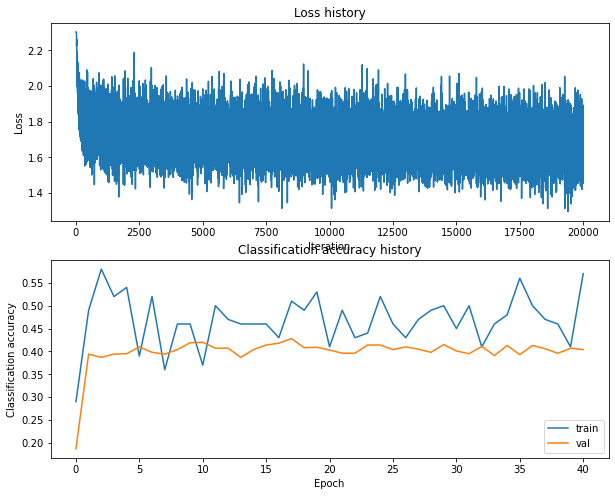

Training network with h_s 25, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.302664
iteration 100 / 20000: loss 2.302227
iteration 200 / 20000: loss 2.287911
iteration 300 / 20000: loss 2.174837
iteration 400 / 20000: loss 2.146510
iteration 500 / 20000: loss 2.031062
iteration 600 / 20000: loss 2.085188
iteration 700 / 20000: loss 1.895451
iteration 800 / 20000: loss 1.953409
iteration 900 / 20000: loss 2.023129
iteration 1000 / 20000: loss 1.941101
iteration 1100 / 20000: loss 1.948504
iteration 1200 / 20000: loss 1.930444
iteration 1300 / 20000: loss 1.927532
iteration 1400 / 20000: loss 1.977043
iteration 1500 / 20000: loss 1.854121
iteration 1600 / 20000: loss 1.780767
iteration 1700 / 20000: loss 1.966881
iteration 1800 / 20000: loss 1.810450
iteration 1900 / 20000: loss 1.680185
iteration 2000 / 20000: loss 1.948459
iteration 2100 / 20000: loss 1.709784
iteration 2200 / 20000: loss 1.786311
iteration 2300 / 20000: loss 1.767303
iteration 2400 / 20000: loss 1.849765
i

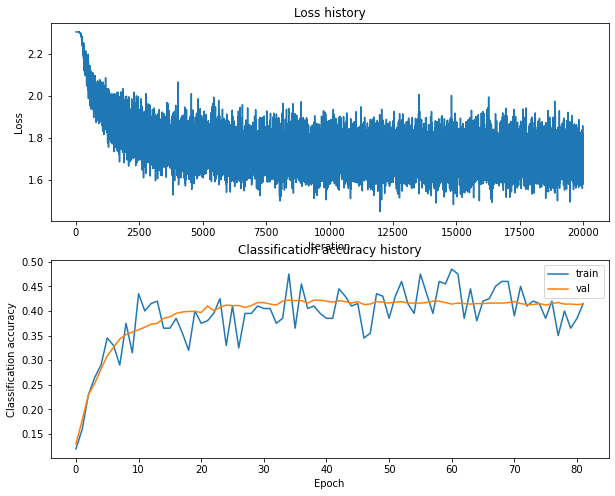

Training network with h_s 25, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.302666
iteration 100 / 20000: loss 2.040400
iteration 200 / 20000: loss 1.853399
iteration 300 / 20000: loss 1.690503
iteration 400 / 20000: loss 1.785912
iteration 500 / 20000: loss 1.708688
iteration 600 / 20000: loss 1.749007
iteration 700 / 20000: loss 1.819161
iteration 800 / 20000: loss 1.641771
iteration 900 / 20000: loss 1.794973
iteration 1000 / 20000: loss 1.725682
iteration 1100 / 20000: loss 1.684291
iteration 1200 / 20000: loss 1.623496
iteration 1300 / 20000: loss 1.602482
iteration 1400 / 20000: loss 1.692982
iteration 1500 / 20000: loss 1.880689
iteration 1600 / 20000: loss 1.711884
iteration 1700 / 20000: loss 1.649221
iteration 1800 / 20000: loss 1.748217
iteration 1900 / 20000: loss 1.674177
iteration 2000 / 20000: loss 1.680876
iteration 2100 / 20000: loss 1.761901
iteration 2200 / 20000: loss 1.695867
iteration 2300 / 20000: loss 1.794101
iteration 2400 / 20000: loss 1.827125
it

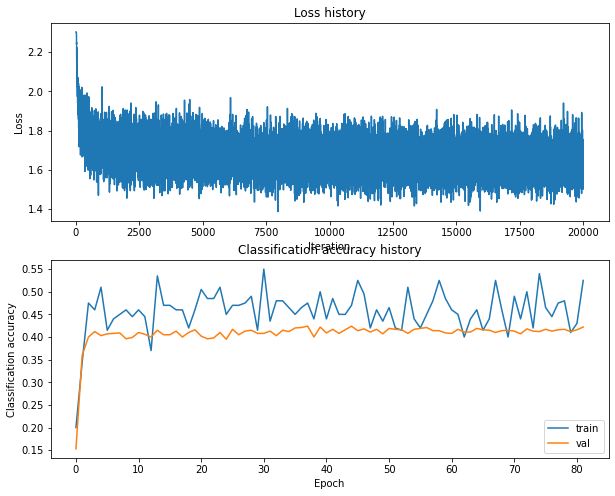

Training network with h_s 25, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.302665
iteration 100 / 20000: loss 2.301663
iteration 200 / 20000: loss 2.284217
iteration 300 / 20000: loss 2.196928
iteration 400 / 20000: loss 2.117277
iteration 500 / 20000: loss 2.093753
iteration 600 / 20000: loss 1.992119
iteration 700 / 20000: loss 1.959671
iteration 800 / 20000: loss 1.978960
iteration 900 / 20000: loss 1.997526
iteration 1000 / 20000: loss 1.992962
iteration 1100 / 20000: loss 1.884757
iteration 1200 / 20000: loss 1.895692
iteration 1300 / 20000: loss 1.865049
iteration 1400 / 20000: loss 1.891514
iteration 1500 / 20000: loss 1.937271
iteration 1600 / 20000: loss 1.925469
iteration 1700 / 20000: loss 1.884616
iteration 1800 / 20000: loss 1.854377
iteration 1900 / 20000: loss 1.840008
iteration 2000 / 20000: loss 1.821187
iteration 2100 / 20000: loss 1.908316
iteration 2200 / 20000: loss 1.796717
iteration 2300 / 20000: loss 1.859976
iteration 2400 / 20000: loss 1.797184
i

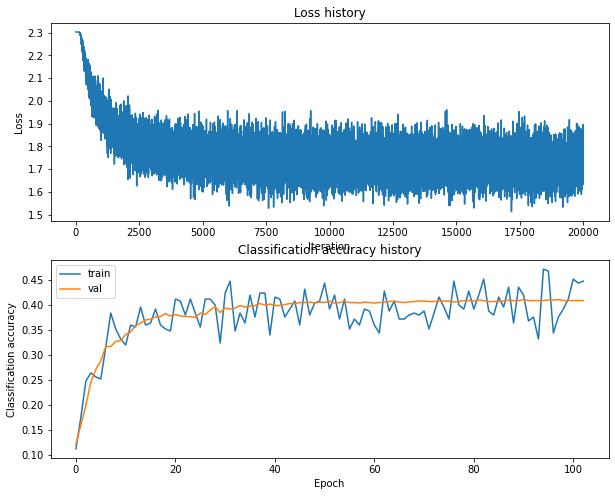

Training network with h_s 25, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.302679
iteration 100 / 20000: loss 1.924029
iteration 200 / 20000: loss 1.770202
iteration 300 / 20000: loss 1.774871
iteration 400 / 20000: loss 1.763878
iteration 500 / 20000: loss 1.755598
iteration 600 / 20000: loss 1.687284
iteration 700 / 20000: loss 1.607794
iteration 800 / 20000: loss 1.709254
iteration 900 / 20000: loss 1.735070
iteration 1000 / 20000: loss 1.702346
iteration 1100 / 20000: loss 1.731964
iteration 1200 / 20000: loss 1.759946
iteration 1300 / 20000: loss 1.647889
iteration 1400 / 20000: loss 1.641069
iteration 1500 / 20000: loss 1.692828
iteration 1600 / 20000: loss 1.638922
iteration 1700 / 20000: loss 1.760261
iteration 1800 / 20000: loss 1.693386
iteration 1900 / 20000: loss 1.779800
iteration 2000 / 20000: loss 1.746001
iteration 2100 / 20000: loss 1.667747
iteration 2200 / 20000: loss 1.765347
iteration 2300 / 20000: loss 1.764339
iteration 2400 / 20000: loss 1.745514
it

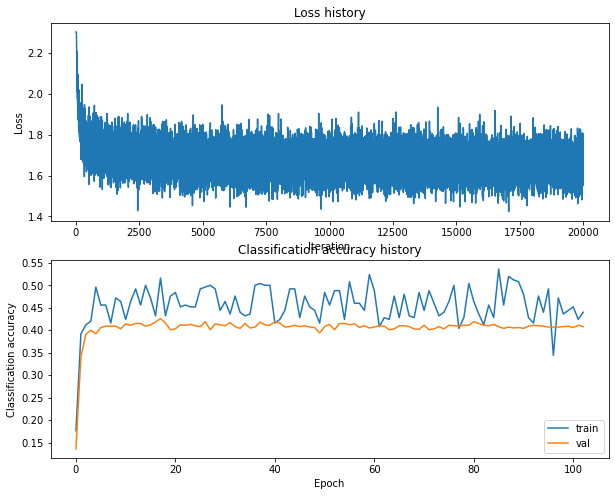

Training network with h_s 25, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.302687
iteration 100 / 20000: loss 2.302412
iteration 200 / 20000: loss 2.295779
iteration 300 / 20000: loss 2.196308
iteration 400 / 20000: loss 2.117559
iteration 500 / 20000: loss 2.055861
iteration 600 / 20000: loss 2.033023
iteration 700 / 20000: loss 1.973327
iteration 800 / 20000: loss 2.007584
iteration 900 / 20000: loss 1.906579
iteration 1000 / 20000: loss 1.928426
iteration 1100 / 20000: loss 1.898262
iteration 1200 / 20000: loss 1.802289
iteration 1300 / 20000: loss 1.868125
iteration 1400 / 20000: loss 1.877313
iteration 1500 / 20000: loss 1.827178
iteration 1600 / 20000: loss 1.798234
iteration 1700 / 20000: loss 1.845178
iteration 1800 / 20000: loss 1.835256
iteration 1900 / 20000: loss 1.808680
iteration 2000 / 20000: loss 1.793628
iteration 2100 / 20000: loss 1.766066
iteration 2200 / 20000: loss 1.751587
iteration 2300 / 20000: loss 1.714599
iteration 2400 / 20000: loss 1.773507
i

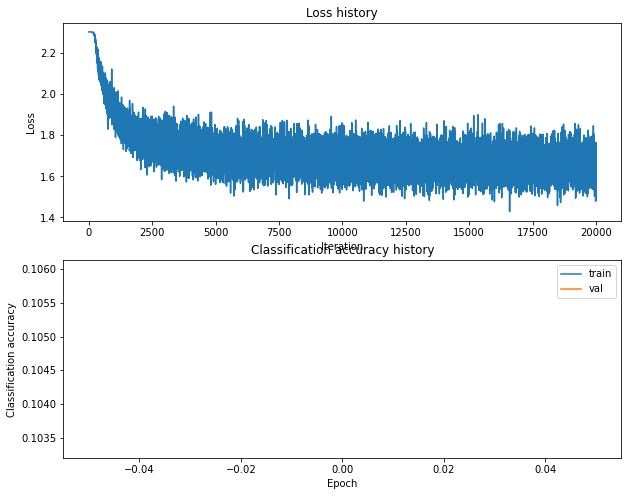

Training network with h_s 25, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.302701
iteration 100 / 20000: loss 1.964332
iteration 200 / 20000: loss 1.802771
iteration 300 / 20000: loss 1.792185
iteration 400 / 20000: loss 1.712403
iteration 500 / 20000: loss 1.709679
iteration 600 / 20000: loss 1.748496
iteration 700 / 20000: loss 1.781877
iteration 800 / 20000: loss 1.714234
iteration 900 / 20000: loss 1.647592
iteration 1000 / 20000: loss 1.803412
iteration 1100 / 20000: loss 1.755710
iteration 1200 / 20000: loss 1.729056
iteration 1300 / 20000: loss 1.667565
iteration 1400 / 20000: loss 1.706647
iteration 1500 / 20000: loss 1.607029
iteration 1600 / 20000: loss 1.756090
iteration 1700 / 20000: loss 1.737530
iteration 1800 / 20000: loss 1.783122
iteration 1900 / 20000: loss 1.764111
iteration 2000 / 20000: loss 1.657624
iteration 2100 / 20000: loss 1.694491
iteration 2200 / 20000: loss 1.725391
iteration 2300 / 20000: loss 1.721426
iteration 2400 / 20000: loss 1.647025
it

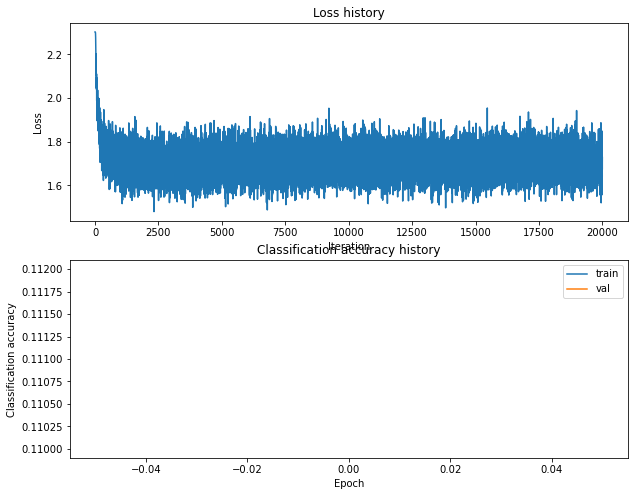

Training network with h_s 25, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.302679
iteration 100 / 20000: loss 2.302205
iteration 200 / 20000: loss 2.293198
iteration 300 / 20000: loss 2.240927
iteration 400 / 20000: loss 2.138509
iteration 500 / 20000: loss 2.105757
iteration 600 / 20000: loss 2.080725
iteration 700 / 20000: loss 2.040119
iteration 800 / 20000: loss 1.976669
iteration 900 / 20000: loss 1.971773
iteration 1000 / 20000: loss 2.007909
iteration 1100 / 20000: loss 1.936992
iteration 1200 / 20000: loss 1.952255
iteration 1300 / 20000: loss 1.846916
iteration 1400 / 20000: loss 1.941179
iteration 1500 / 20000: loss 1.903404
iteration 1600 / 20000: loss 1.878083
iteration 1700 / 20000: loss 1.904906
iteration 1800 / 20000: loss 1.904004
iteration 1900 / 20000: loss 1.861608
iteration 2000 / 20000: loss 1.838860
iteration 2100 / 20000: loss 1.821986
iteration 2200 / 20000: loss 1.862027
iteration 2300 / 20000: loss 1.845458
iteration 2400 / 20000: loss 1.843626
i

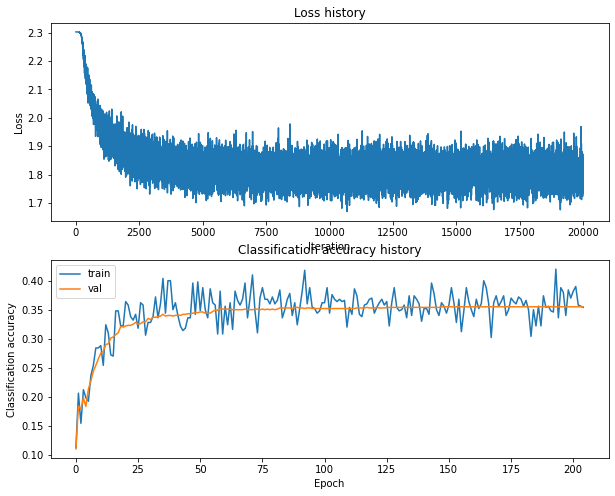

Training network with h_s 25, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.302676
iteration 100 / 20000: loss 1.928724
iteration 200 / 20000: loss 1.938155
iteration 300 / 20000: loss 1.766984
iteration 400 / 20000: loss 1.708809
iteration 500 / 20000: loss 1.721779
iteration 600 / 20000: loss 1.721557
iteration 700 / 20000: loss 1.711467
iteration 800 / 20000: loss 1.725033
iteration 900 / 20000: loss 1.690860
iteration 1000 / 20000: loss 1.750448
iteration 1100 / 20000: loss 1.676066
iteration 1200 / 20000: loss 1.701596
iteration 1300 / 20000: loss 1.685243
iteration 1400 / 20000: loss 1.668533
iteration 1500 / 20000: loss 1.614872
iteration 1600 / 20000: loss 1.716767
iteration 1700 / 20000: loss 1.654249
iteration 1800 / 20000: loss 1.715507
iteration 1900 / 20000: loss 1.674997
iteration 2000 / 20000: loss 1.717609
iteration 2100 / 20000: loss 1.599179
iteration 2200 / 20000: loss 1.618240
iteration 2300 / 20000: loss 1.711106
iteration 2400 / 20000: loss 1.670930
it

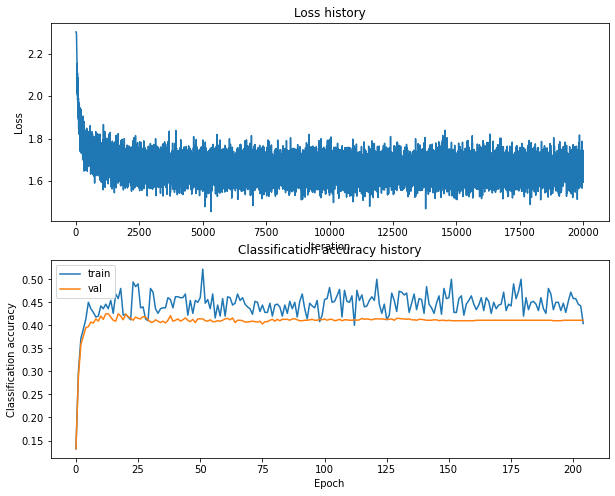

Training network with h_s 25, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.302690
iteration 100 / 25000: loss 2.302459
iteration 200 / 25000: loss 2.288584
iteration 300 / 25000: loss 2.208767
iteration 400 / 25000: loss 2.176941
iteration 500 / 25000: loss 2.013642
iteration 600 / 25000: loss 1.902723
iteration 700 / 25000: loss 2.026201
iteration 800 / 25000: loss 2.018533
iteration 900 / 25000: loss 1.894529
iteration 1000 / 25000: loss 1.973708
iteration 1100 / 25000: loss 1.882526
iteration 1200 / 25000: loss 1.881827
iteration 1300 / 25000: loss 1.896551
iteration 1400 / 25000: loss 1.868050
iteration 1500 / 25000: loss 1.848383
iteration 1600 / 25000: loss 1.897144
iteration 1700 / 25000: loss 1.974373
iteration 1800 / 25000: loss 2.099555
iteration 1900 / 25000: loss 1.637168
iteration 2000 / 25000: loss 1.810438
iteration 2100 / 25000: loss 1.877316
iteration 2200 / 25000: loss 1.809631
iteration 2300 / 25000: loss 1.807859
iteration 2400 / 25000: loss 1.927591
i

iteration 21200 / 25000: loss 1.752932
iteration 21300 / 25000: loss 1.827075
iteration 21400 / 25000: loss 1.674429
iteration 21500 / 25000: loss 1.835052
iteration 21600 / 25000: loss 1.653046
iteration 21700 / 25000: loss 1.550455
iteration 21800 / 25000: loss 1.555553
iteration 21900 / 25000: loss 1.676639
iteration 22000 / 25000: loss 1.690107
iteration 22100 / 25000: loss 1.755516
iteration 22200 / 25000: loss 1.681284
iteration 22300 / 25000: loss 1.707648
iteration 22400 / 25000: loss 1.619316
iteration 22500 / 25000: loss 1.471593
iteration 22600 / 25000: loss 1.594380
iteration 22700 / 25000: loss 1.613939
iteration 22800 / 25000: loss 1.866616
iteration 22900 / 25000: loss 1.798343
iteration 23000 / 25000: loss 1.562321
iteration 23100 / 25000: loss 1.770607
iteration 23200 / 25000: loss 1.840312
iteration 23300 / 25000: loss 1.561698
iteration 23400 / 25000: loss 1.752000
iteration 23500 / 25000: loss 1.611516
iteration 23600 / 25000: loss 1.542468
iteration 23700 / 25000: 

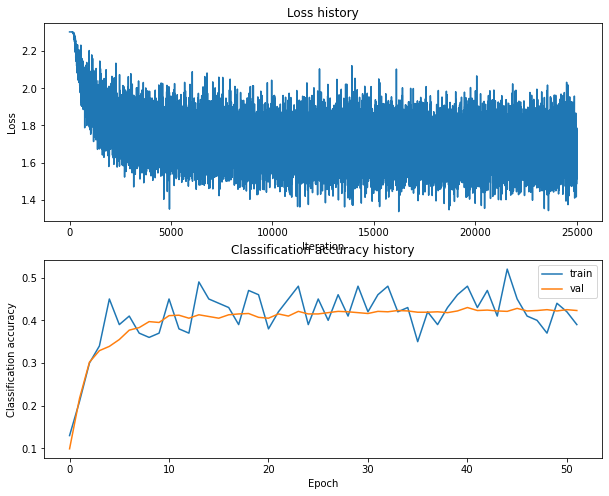

Training network with h_s 25, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.302681
iteration 100 / 25000: loss 1.867192
iteration 200 / 25000: loss 1.855421
iteration 300 / 25000: loss 1.747061
iteration 400 / 25000: loss 1.866163
iteration 500 / 25000: loss 1.738765
iteration 600 / 25000: loss 1.822910
iteration 700 / 25000: loss 1.734523
iteration 800 / 25000: loss 1.969384
iteration 900 / 25000: loss 1.728178
iteration 1000 / 25000: loss 1.839313
iteration 1100 / 25000: loss 1.698046
iteration 1200 / 25000: loss 1.805705
iteration 1300 / 25000: loss 1.777919
iteration 1400 / 25000: loss 1.865241
iteration 1500 / 25000: loss 1.783540
iteration 1600 / 25000: loss 1.684639
iteration 1700 / 25000: loss 1.909606
iteration 1800 / 25000: loss 1.888390
iteration 1900 / 25000: loss 1.540219
iteration 2000 / 25000: loss 1.954435
iteration 2100 / 25000: loss 1.708497
iteration 2200 / 25000: loss 1.807411
iteration 2300 / 25000: loss 1.653707
iteration 2400 / 25000: loss 1.768474
it

iteration 21200 / 25000: loss 1.625766
iteration 21300 / 25000: loss 1.475237
iteration 21400 / 25000: loss 1.634279
iteration 21500 / 25000: loss 1.675958
iteration 21600 / 25000: loss 1.630255
iteration 21700 / 25000: loss 1.733617
iteration 21800 / 25000: loss 1.652905
iteration 21900 / 25000: loss 1.580831
iteration 22000 / 25000: loss 1.733329
iteration 22100 / 25000: loss 1.784841
iteration 22200 / 25000: loss 1.705586
iteration 22300 / 25000: loss 1.861995
iteration 22400 / 25000: loss 1.734346
iteration 22500 / 25000: loss 1.860316
iteration 22600 / 25000: loss 1.749495
iteration 22700 / 25000: loss 1.849818
iteration 22800 / 25000: loss 1.637063
iteration 22900 / 25000: loss 1.550863
iteration 23000 / 25000: loss 1.680716
iteration 23100 / 25000: loss 1.673342
iteration 23200 / 25000: loss 1.742558
iteration 23300 / 25000: loss 1.668128
iteration 23400 / 25000: loss 1.680219
iteration 23500 / 25000: loss 1.443903
iteration 23600 / 25000: loss 1.775146
iteration 23700 / 25000: 

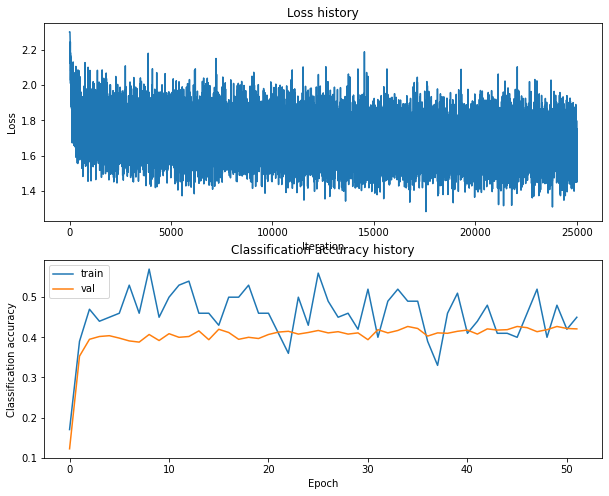

Training network with h_s 25, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.302675
iteration 100 / 25000: loss 2.301930
iteration 200 / 25000: loss 2.286639
iteration 300 / 25000: loss 2.201871
iteration 400 / 25000: loss 2.147940
iteration 500 / 25000: loss 2.026545
iteration 600 / 25000: loss 2.119009
iteration 700 / 25000: loss 2.009159
iteration 800 / 25000: loss 1.905430
iteration 900 / 25000: loss 1.976472
iteration 1000 / 25000: loss 1.909905
iteration 1100 / 25000: loss 1.934560
iteration 1200 / 25000: loss 1.872195
iteration 1300 / 25000: loss 1.889097
iteration 1400 / 25000: loss 1.803102
iteration 1500 / 25000: loss 1.737750
iteration 1600 / 25000: loss 1.871982
iteration 1700 / 25000: loss 1.769822
iteration 1800 / 25000: loss 1.830942
iteration 1900 / 25000: loss 1.809654
iteration 2000 / 25000: loss 1.869255
iteration 2100 / 25000: loss 1.799053
iteration 2200 / 25000: loss 1.814453
iteration 2300 / 25000: loss 1.765960
iteration 2400 / 25000: loss 1.841541
i

iteration 21200 / 25000: loss 1.640614
iteration 21300 / 25000: loss 1.811657
iteration 21400 / 25000: loss 1.733329
iteration 21500 / 25000: loss 1.660547
iteration 21600 / 25000: loss 1.655553
iteration 21700 / 25000: loss 1.630008
iteration 21800 / 25000: loss 1.661612
iteration 21900 / 25000: loss 1.745001
iteration 22000 / 25000: loss 1.804103
iteration 22100 / 25000: loss 1.612700
iteration 22200 / 25000: loss 1.745097
iteration 22300 / 25000: loss 1.673453
iteration 22400 / 25000: loss 1.696636
iteration 22500 / 25000: loss 1.670715
iteration 22600 / 25000: loss 1.784410
iteration 22700 / 25000: loss 1.865634
iteration 22800 / 25000: loss 1.667681
iteration 22900 / 25000: loss 1.612356
iteration 23000 / 25000: loss 1.757546
iteration 23100 / 25000: loss 1.782039
iteration 23200 / 25000: loss 1.698708
iteration 23300 / 25000: loss 1.664686
iteration 23400 / 25000: loss 1.686318
iteration 23500 / 25000: loss 1.554776
iteration 23600 / 25000: loss 1.856070
iteration 23700 / 25000: 

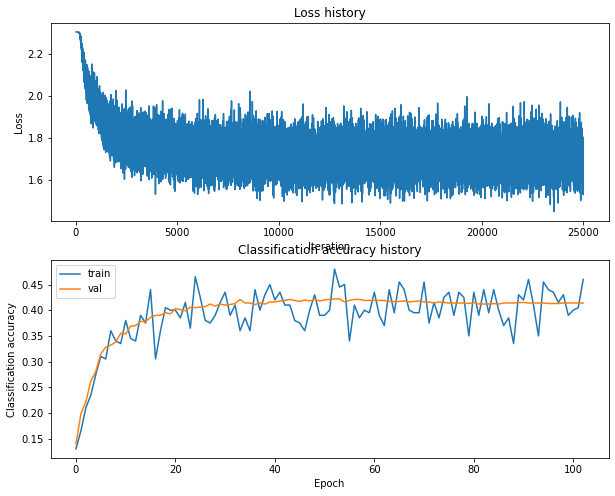

Training network with h_s 25, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.302687
iteration 100 / 25000: loss 1.994404
iteration 200 / 25000: loss 1.752253
iteration 300 / 25000: loss 1.704280
iteration 400 / 25000: loss 1.757216
iteration 500 / 25000: loss 1.664597
iteration 600 / 25000: loss 1.755196
iteration 700 / 25000: loss 1.887356
iteration 800 / 25000: loss 1.818863
iteration 900 / 25000: loss 1.865985
iteration 1000 / 25000: loss 1.770271
iteration 1100 / 25000: loss 1.699132
iteration 1200 / 25000: loss 1.729377
iteration 1300 / 25000: loss 1.875921
iteration 1400 / 25000: loss 1.808217
iteration 1500 / 25000: loss 1.768973
iteration 1600 / 25000: loss 1.753354
iteration 1700 / 25000: loss 1.631987
iteration 1800 / 25000: loss 1.657806
iteration 1900 / 25000: loss 1.664131
iteration 2000 / 25000: loss 1.773437
iteration 2100 / 25000: loss 1.756650
iteration 2200 / 25000: loss 1.693993
iteration 2300 / 25000: loss 1.760743
iteration 2400 / 25000: loss 1.703026
it

iteration 21200 / 25000: loss 1.705688
iteration 21300 / 25000: loss 1.687428
iteration 21400 / 25000: loss 1.624180
iteration 21500 / 25000: loss 1.615361
iteration 21600 / 25000: loss 1.692291
iteration 21700 / 25000: loss 1.630006
iteration 21800 / 25000: loss 1.704257
iteration 21900 / 25000: loss 1.659121
iteration 22000 / 25000: loss 1.785219
iteration 22100 / 25000: loss 1.555317
iteration 22200 / 25000: loss 1.724187
iteration 22300 / 25000: loss 1.594869
iteration 22400 / 25000: loss 1.696195
iteration 22500 / 25000: loss 1.669586
iteration 22600 / 25000: loss 1.584064
iteration 22700 / 25000: loss 1.638399
iteration 22800 / 25000: loss 1.691901
iteration 22900 / 25000: loss 1.644964
iteration 23000 / 25000: loss 1.708010
iteration 23100 / 25000: loss 1.654355
iteration 23200 / 25000: loss 1.465743
iteration 23300 / 25000: loss 1.675381
iteration 23400 / 25000: loss 1.682064
iteration 23500 / 25000: loss 1.545236
iteration 23600 / 25000: loss 1.614377
iteration 23700 / 25000: 

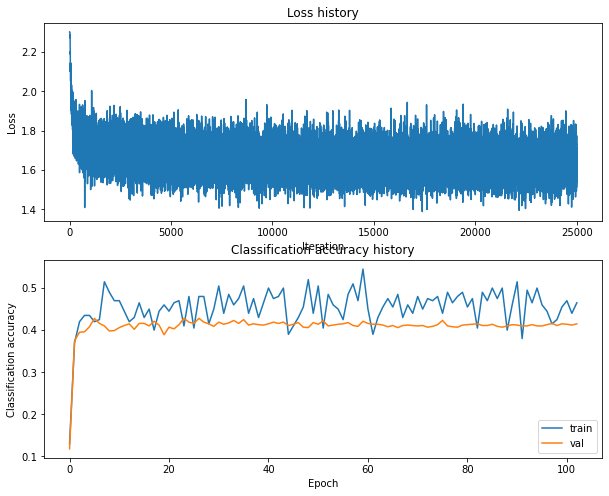

Training network with h_s 25, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.302690
iteration 100 / 25000: loss 2.301978
iteration 200 / 25000: loss 2.285780
iteration 300 / 25000: loss 2.212787
iteration 400 / 25000: loss 2.165022
iteration 500 / 25000: loss 2.102419
iteration 600 / 25000: loss 2.098554
iteration 700 / 25000: loss 1.994078
iteration 800 / 25000: loss 1.964592
iteration 900 / 25000: loss 1.968128
iteration 1000 / 25000: loss 1.947107
iteration 1100 / 25000: loss 1.931858
iteration 1200 / 25000: loss 1.876367
iteration 1300 / 25000: loss 1.834814
iteration 1400 / 25000: loss 1.905707
iteration 1500 / 25000: loss 1.972372
iteration 1600 / 25000: loss 1.830089
iteration 1700 / 25000: loss 1.803076
iteration 1800 / 25000: loss 1.849079
iteration 1900 / 25000: loss 1.834950
iteration 2000 / 25000: loss 1.897875
iteration 2100 / 25000: loss 1.782472
iteration 2200 / 25000: loss 1.797626
iteration 2300 / 25000: loss 1.879473
iteration 2400 / 25000: loss 1.738658
i

iteration 21200 / 25000: loss 1.738333
iteration 21300 / 25000: loss 1.700418
iteration 21400 / 25000: loss 1.710707
iteration 21500 / 25000: loss 1.742025
iteration 21600 / 25000: loss 1.747559
iteration 21700 / 25000: loss 1.642648
iteration 21800 / 25000: loss 1.744268
iteration 21900 / 25000: loss 1.621785
iteration 22000 / 25000: loss 1.767382
iteration 22100 / 25000: loss 1.815970
iteration 22200 / 25000: loss 1.730886
iteration 22300 / 25000: loss 1.863230
iteration 22400 / 25000: loss 1.605229
iteration 22500 / 25000: loss 1.820411
iteration 22600 / 25000: loss 1.741565
iteration 22700 / 25000: loss 1.746705
iteration 22800 / 25000: loss 1.699185
iteration 22900 / 25000: loss 1.773169
iteration 23000 / 25000: loss 1.656520
iteration 23100 / 25000: loss 1.699733
iteration 23200 / 25000: loss 1.735035
iteration 23300 / 25000: loss 1.767637
iteration 23400 / 25000: loss 1.719998
iteration 23500 / 25000: loss 1.691988
iteration 23600 / 25000: loss 1.706052
iteration 23700 / 25000: 

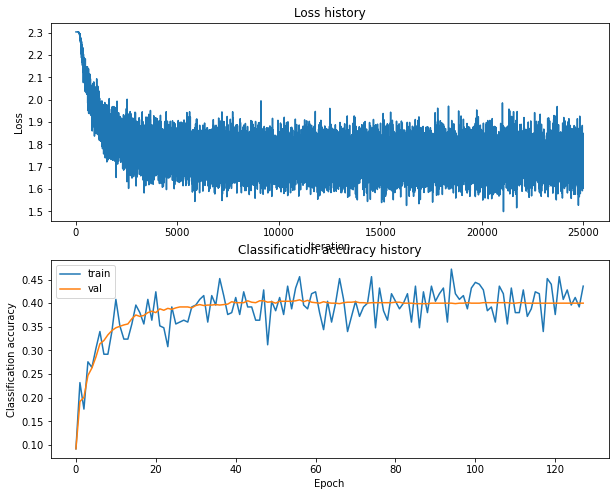

Training network with h_s 25, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.302688
iteration 100 / 25000: loss 1.958485
iteration 200 / 25000: loss 1.746137
iteration 300 / 25000: loss 1.902781
iteration 400 / 25000: loss 1.798449
iteration 500 / 25000: loss 1.721995
iteration 600 / 25000: loss 1.732619
iteration 700 / 25000: loss 1.793006
iteration 800 / 25000: loss 1.736133
iteration 900 / 25000: loss 1.728534
iteration 1000 / 25000: loss 1.730872
iteration 1100 / 25000: loss 1.684085
iteration 1200 / 25000: loss 1.756937
iteration 1300 / 25000: loss 1.634721
iteration 1400 / 25000: loss 1.695610
iteration 1500 / 25000: loss 1.689714
iteration 1600 / 25000: loss 1.609764
iteration 1700 / 25000: loss 1.795886
iteration 1800 / 25000: loss 1.702618
iteration 1900 / 25000: loss 1.710983
iteration 2000 / 25000: loss 1.702243
iteration 2100 / 25000: loss 1.688182
iteration 2200 / 25000: loss 1.647310
iteration 2300 / 25000: loss 1.823091
iteration 2400 / 25000: loss 1.650276
it

iteration 21200 / 25000: loss 1.674611
iteration 21300 / 25000: loss 1.614453
iteration 21400 / 25000: loss 1.676032
iteration 21500 / 25000: loss 1.564191
iteration 21600 / 25000: loss 1.598092
iteration 21700 / 25000: loss 1.649316
iteration 21800 / 25000: loss 1.673107
iteration 21900 / 25000: loss 1.596659
iteration 22000 / 25000: loss 1.680644
iteration 22100 / 25000: loss 1.512404
iteration 22200 / 25000: loss 1.579515
iteration 22300 / 25000: loss 1.655766
iteration 22400 / 25000: loss 1.623422
iteration 22500 / 25000: loss 1.582985
iteration 22600 / 25000: loss 1.637819
iteration 22700 / 25000: loss 1.756508
iteration 22800 / 25000: loss 1.791977
iteration 22900 / 25000: loss 1.575868
iteration 23000 / 25000: loss 1.599583
iteration 23100 / 25000: loss 1.554805
iteration 23200 / 25000: loss 1.515760
iteration 23300 / 25000: loss 1.620509
iteration 23400 / 25000: loss 1.649002
iteration 23500 / 25000: loss 1.641884
iteration 23600 / 25000: loss 1.555598
iteration 23700 / 25000: 

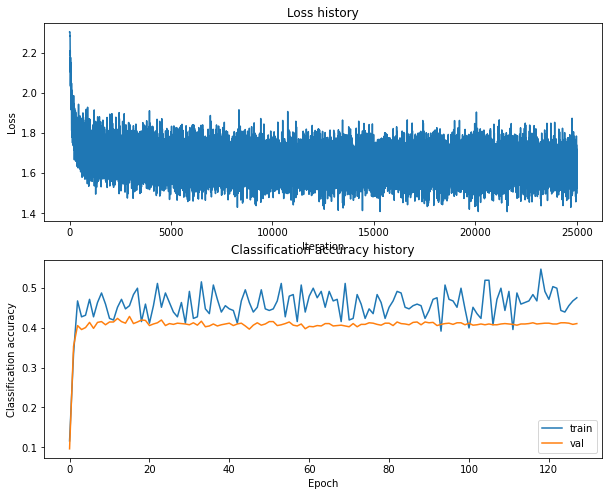

Training network with h_s 25, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.302679
iteration 100 / 25000: loss 2.302195
iteration 200 / 25000: loss 2.293286
iteration 300 / 25000: loss 2.218533
iteration 400 / 25000: loss 2.133925
iteration 500 / 25000: loss 2.097843
iteration 600 / 25000: loss 2.047744
iteration 700 / 25000: loss 1.988356
iteration 800 / 25000: loss 1.975213
iteration 900 / 25000: loss 1.970045
iteration 1000 / 25000: loss 1.987112
iteration 1100 / 25000: loss 1.866588
iteration 1200 / 25000: loss 1.831403
iteration 1300 / 25000: loss 1.915038
iteration 1400 / 25000: loss 1.824405
iteration 1500 / 25000: loss 1.826177
iteration 1600 / 25000: loss 1.857392
iteration 1700 / 25000: loss 1.763680
iteration 1800 / 25000: loss 1.821144
iteration 1900 / 25000: loss 1.744920
iteration 2000 / 25000: loss 1.843478
iteration 2100 / 25000: loss 1.851167
iteration 2200 / 25000: loss 1.787089
iteration 2300 / 25000: loss 1.870939
iteration 2400 / 25000: loss 1.780818
i

iteration 21200 / 25000: loss 1.604571
iteration 21300 / 25000: loss 1.613432
iteration 21400 / 25000: loss 1.658073
iteration 21500 / 25000: loss 1.662956
iteration 21600 / 25000: loss 1.676769
iteration 21700 / 25000: loss 1.628279
iteration 21800 / 25000: loss 1.720577
iteration 21900 / 25000: loss 1.618586
iteration 22000 / 25000: loss 1.561693
iteration 22100 / 25000: loss 1.612364
iteration 22200 / 25000: loss 1.631826
iteration 22300 / 25000: loss 1.616500
iteration 22400 / 25000: loss 1.730915
iteration 22500 / 25000: loss 1.669802
iteration 22600 / 25000: loss 1.639790
iteration 22700 / 25000: loss 1.623975
iteration 22800 / 25000: loss 1.707116
iteration 22900 / 25000: loss 1.657971
iteration 23000 / 25000: loss 1.796792
iteration 23100 / 25000: loss 1.626635
iteration 23200 / 25000: loss 1.637849
iteration 23300 / 25000: loss 1.632145
iteration 23400 / 25000: loss 1.643981
iteration 23500 / 25000: loss 1.572832
iteration 23600 / 25000: loss 1.666368
iteration 23700 / 25000: 

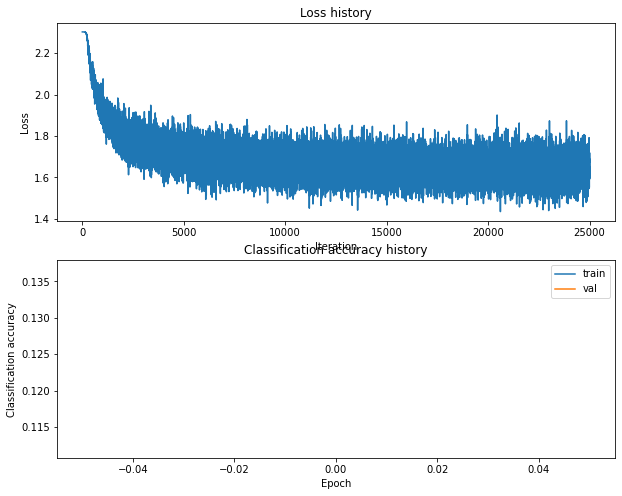

Training network with h_s 25, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.302690
iteration 100 / 25000: loss 1.979226
iteration 200 / 25000: loss 1.862202
iteration 300 / 25000: loss 1.734338
iteration 400 / 25000: loss 1.739009
iteration 500 / 25000: loss 1.740386
iteration 600 / 25000: loss 1.694717
iteration 700 / 25000: loss 1.744585
iteration 800 / 25000: loss 1.801132
iteration 900 / 25000: loss 1.694669
iteration 1000 / 25000: loss 1.775497
iteration 1100 / 25000: loss 1.719978
iteration 1200 / 25000: loss 1.641945
iteration 1300 / 25000: loss 1.672527
iteration 1400 / 25000: loss 1.754572
iteration 1500 / 25000: loss 1.673342
iteration 1600 / 25000: loss 1.668326
iteration 1700 / 25000: loss 1.695132
iteration 1800 / 25000: loss 1.713655
iteration 1900 / 25000: loss 1.750299
iteration 2000 / 25000: loss 1.638339
iteration 2100 / 25000: loss 1.631593
iteration 2200 / 25000: loss 1.702347
iteration 2300 / 25000: loss 1.651636
iteration 2400 / 25000: loss 1.626979
it

iteration 21200 / 25000: loss 1.576175
iteration 21300 / 25000: loss 1.706473
iteration 21400 / 25000: loss 1.737472
iteration 21500 / 25000: loss 1.644916
iteration 21600 / 25000: loss 1.753615
iteration 21700 / 25000: loss 1.821888
iteration 21800 / 25000: loss 1.783191
iteration 21900 / 25000: loss 1.799050
iteration 22000 / 25000: loss 1.659573
iteration 22100 / 25000: loss 1.723186
iteration 22200 / 25000: loss 1.784661
iteration 22300 / 25000: loss 1.689853
iteration 22400 / 25000: loss 1.740508
iteration 22500 / 25000: loss 1.678611
iteration 22600 / 25000: loss 1.753395
iteration 22700 / 25000: loss 1.704193
iteration 22800 / 25000: loss 1.746480
iteration 22900 / 25000: loss 1.791223
iteration 23000 / 25000: loss 1.702122
iteration 23100 / 25000: loss 1.675042
iteration 23200 / 25000: loss 1.773703
iteration 23300 / 25000: loss 1.733030
iteration 23400 / 25000: loss 1.714111
iteration 23500 / 25000: loss 1.705918
iteration 23600 / 25000: loss 1.709377
iteration 23700 / 25000: 

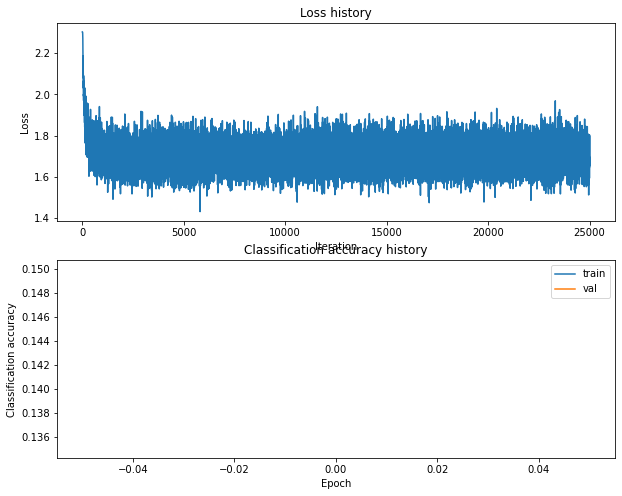

Training network with h_s 25, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.302672
iteration 100 / 25000: loss 2.302295
iteration 200 / 25000: loss 2.294329
iteration 300 / 25000: loss 2.222813
iteration 400 / 25000: loss 2.136949
iteration 500 / 25000: loss 2.107225
iteration 600 / 25000: loss 2.068991
iteration 700 / 25000: loss 2.008512
iteration 800 / 25000: loss 1.986878
iteration 900 / 25000: loss 2.034641
iteration 1000 / 25000: loss 1.966184
iteration 1100 / 25000: loss 1.964994
iteration 1200 / 25000: loss 1.905776
iteration 1300 / 25000: loss 1.950556
iteration 1400 / 25000: loss 1.948527
iteration 1500 / 25000: loss 1.898749
iteration 1600 / 25000: loss 1.905089
iteration 1700 / 25000: loss 1.817966
iteration 1800 / 25000: loss 1.808662
iteration 1900 / 25000: loss 1.846393
iteration 2000 / 25000: loss 1.833150
iteration 2100 / 25000: loss 1.916456
iteration 2200 / 25000: loss 1.884505
iteration 2300 / 25000: loss 1.864868
iteration 2400 / 25000: loss 1.862048
i

iteration 21200 / 25000: loss 1.793980
iteration 21300 / 25000: loss 1.795291
iteration 21400 / 25000: loss 1.776932
iteration 21500 / 25000: loss 1.862291
iteration 21600 / 25000: loss 1.796169
iteration 21700 / 25000: loss 1.817887
iteration 21800 / 25000: loss 1.845595
iteration 21900 / 25000: loss 1.779003
iteration 22000 / 25000: loss 1.854295
iteration 22100 / 25000: loss 1.736338
iteration 22200 / 25000: loss 1.781418
iteration 22300 / 25000: loss 1.842488
iteration 22400 / 25000: loss 1.794610
iteration 22500 / 25000: loss 1.794195
iteration 22600 / 25000: loss 1.810658
iteration 22700 / 25000: loss 1.683146
iteration 22800 / 25000: loss 1.818822
iteration 22900 / 25000: loss 1.755690
iteration 23000 / 25000: loss 1.824552
iteration 23100 / 25000: loss 1.853894
iteration 23200 / 25000: loss 1.879703
iteration 23300 / 25000: loss 1.776573
iteration 23400 / 25000: loss 1.824994
iteration 23500 / 25000: loss 1.787525
iteration 23600 / 25000: loss 1.753318
iteration 23700 / 25000: 

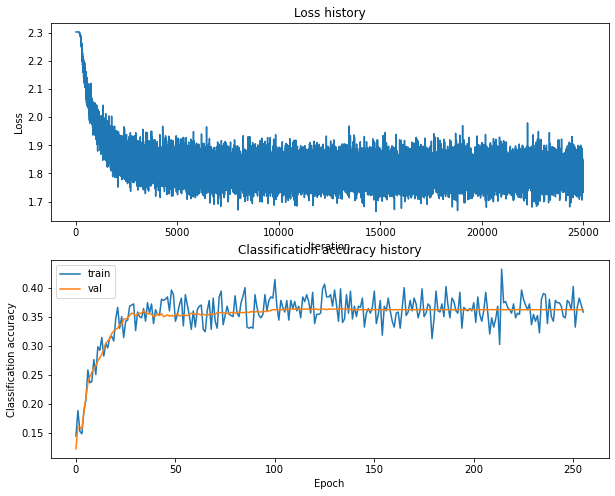

Training network with h_s 25, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.302694
iteration 100 / 25000: loss 1.934579
iteration 200 / 25000: loss 1.763959
iteration 300 / 25000: loss 1.823112
iteration 400 / 25000: loss 1.701798
iteration 500 / 25000: loss 1.739995
iteration 600 / 25000: loss 1.751640
iteration 700 / 25000: loss 1.759644
iteration 800 / 25000: loss 1.781974
iteration 900 / 25000: loss 1.716004
iteration 1000 / 25000: loss 1.676794
iteration 1100 / 25000: loss 1.751176
iteration 1200 / 25000: loss 1.707396
iteration 1300 / 25000: loss 1.711674
iteration 1400 / 25000: loss 1.665737
iteration 1500 / 25000: loss 1.744447
iteration 1600 / 25000: loss 1.673137
iteration 1700 / 25000: loss 1.645434
iteration 1800 / 25000: loss 1.679205
iteration 1900 / 25000: loss 1.729170
iteration 2000 / 25000: loss 1.674760
iteration 2100 / 25000: loss 1.646125
iteration 2200 / 25000: loss 1.703646
iteration 2300 / 25000: loss 1.669229
iteration 2400 / 25000: loss 1.592555
it

iteration 21200 / 25000: loss 1.626127
iteration 21300 / 25000: loss 1.587480
iteration 21400 / 25000: loss 1.558145
iteration 21500 / 25000: loss 1.607763
iteration 21600 / 25000: loss 1.730721
iteration 21700 / 25000: loss 1.708118
iteration 21800 / 25000: loss 1.644774
iteration 21900 / 25000: loss 1.691807
iteration 22000 / 25000: loss 1.627330
iteration 22100 / 25000: loss 1.606625
iteration 22200 / 25000: loss 1.652159
iteration 22300 / 25000: loss 1.648327
iteration 22400 / 25000: loss 1.621173
iteration 22500 / 25000: loss 1.706819
iteration 22600 / 25000: loss 1.702847
iteration 22700 / 25000: loss 1.646108
iteration 22800 / 25000: loss 1.618453
iteration 22900 / 25000: loss 1.624957
iteration 23000 / 25000: loss 1.651428
iteration 23100 / 25000: loss 1.628090
iteration 23200 / 25000: loss 1.631675
iteration 23300 / 25000: loss 1.689848
iteration 23400 / 25000: loss 1.642679
iteration 23500 / 25000: loss 1.667146
iteration 23600 / 25000: loss 1.671210
iteration 23700 / 25000: 

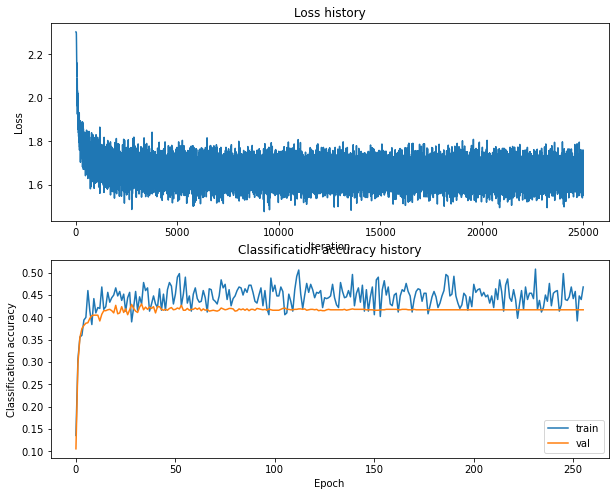

Training network with h_s 50, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.302771
iteration 100 / 500: loss 2.301790
iteration 200 / 500: loss 2.278224
iteration 300 / 500: loss 2.165643
iteration 400 / 500: loss 2.116510
Validation accuracy:  0.246


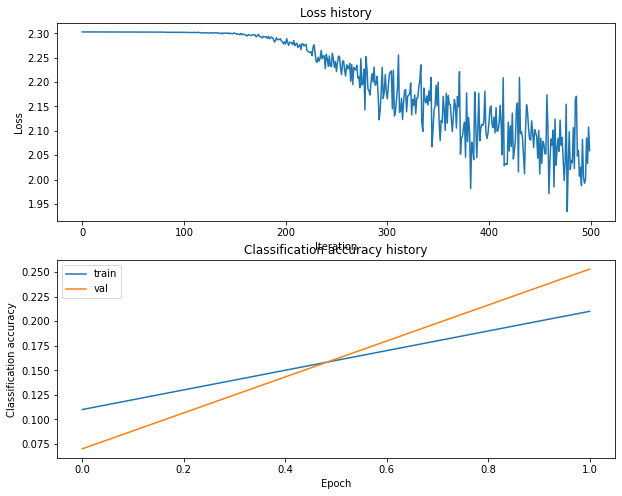

Training network with h_s 50, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.302793
iteration 100 / 500: loss 1.858997
iteration 200 / 500: loss 1.761124
iteration 300 / 500: loss 1.776492
iteration 400 / 500: loss 1.834984
Validation accuracy:  0.394


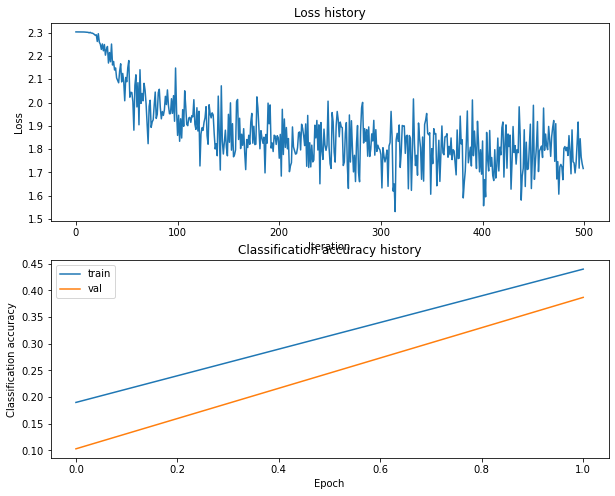

Training network with h_s 50, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.302786
iteration 100 / 500: loss 2.301969
iteration 200 / 500: loss 2.286345
iteration 300 / 500: loss 2.175056
iteration 400 / 500: loss 2.143941
Validation accuracy:  0.232


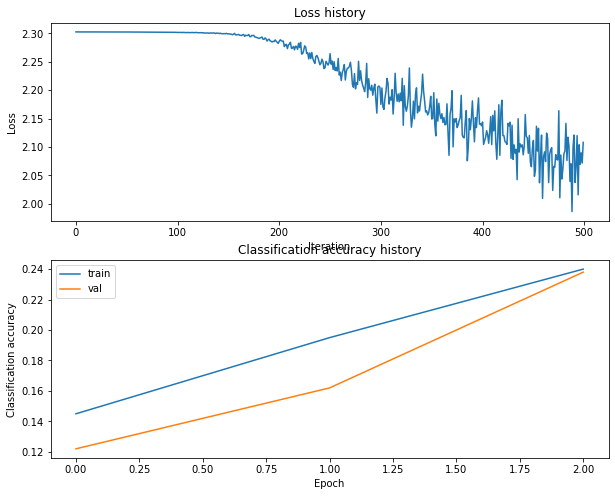

Training network with h_s 50, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.302778
iteration 100 / 500: loss 1.961944
iteration 200 / 500: loss 1.836276
iteration 300 / 500: loss 1.862554
iteration 400 / 500: loss 1.758394
Validation accuracy:  0.399


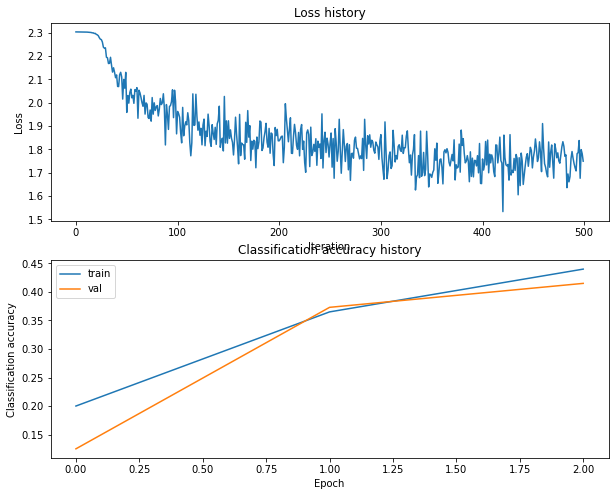

Training network with h_s 50, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.302800
iteration 100 / 500: loss 2.301744
iteration 200 / 500: loss 2.283796
iteration 300 / 500: loss 2.187642
iteration 400 / 500: loss 2.179758
Validation accuracy:  0.238


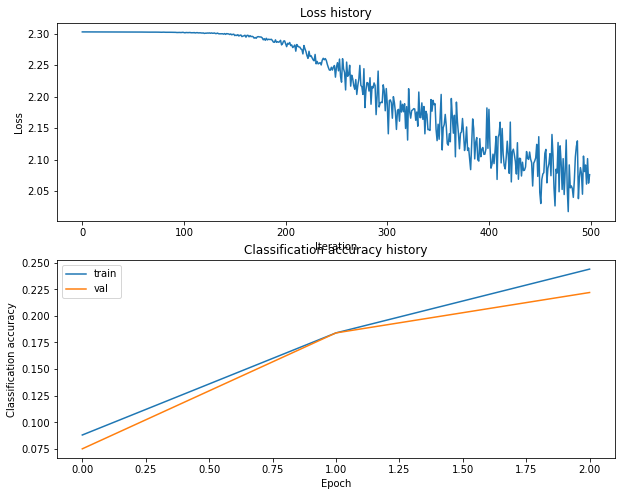

Training network with h_s 50, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.302763
iteration 100 / 500: loss 1.934165
iteration 200 / 500: loss 1.808859
iteration 300 / 500: loss 1.745456
iteration 400 / 500: loss 1.737332
Validation accuracy:  0.392


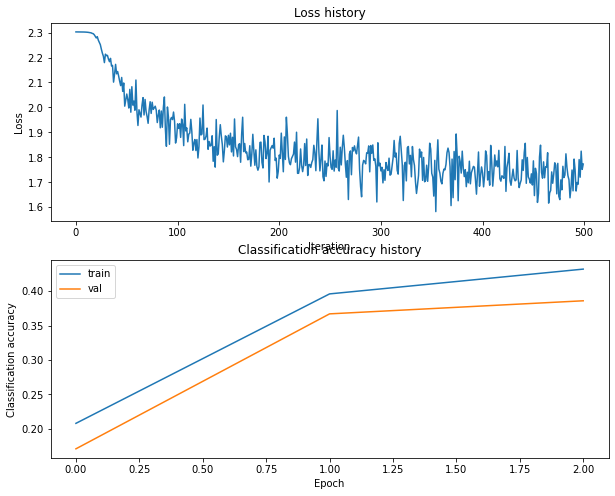

Training network with h_s 50, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.302759
iteration 100 / 500: loss 2.301773
iteration 200 / 500: loss 2.276708
iteration 300 / 500: loss 2.186462
iteration 400 / 500: loss 2.152134
Validation accuracy:  0.237


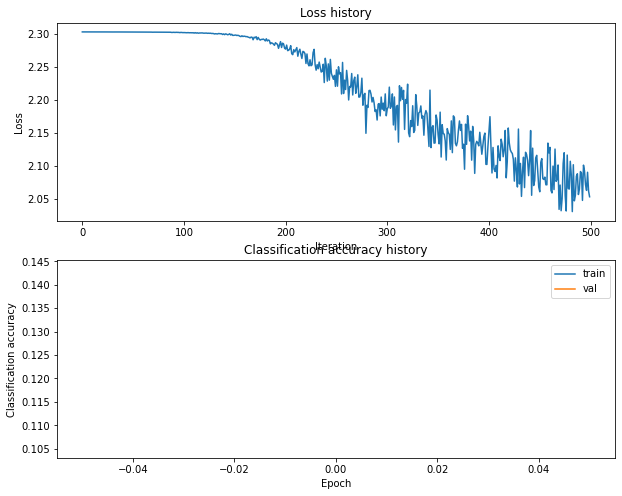

Training network with h_s 50, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.302785
iteration 100 / 500: loss 2.015226
iteration 200 / 500: loss 1.805981
iteration 300 / 500: loss 1.807384
iteration 400 / 500: loss 1.637551
Validation accuracy:  0.381


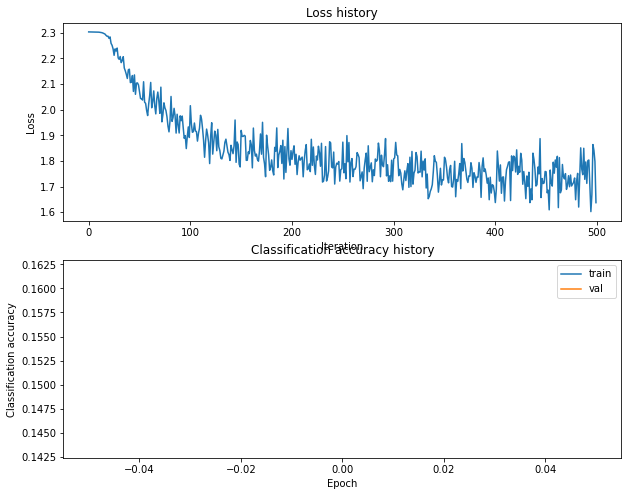

Training network with h_s 50, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.302756
iteration 100 / 500: loss 2.301741
iteration 200 / 500: loss 2.283594
iteration 300 / 500: loss 2.210845
iteration 400 / 500: loss 2.108034
Validation accuracy:  0.239


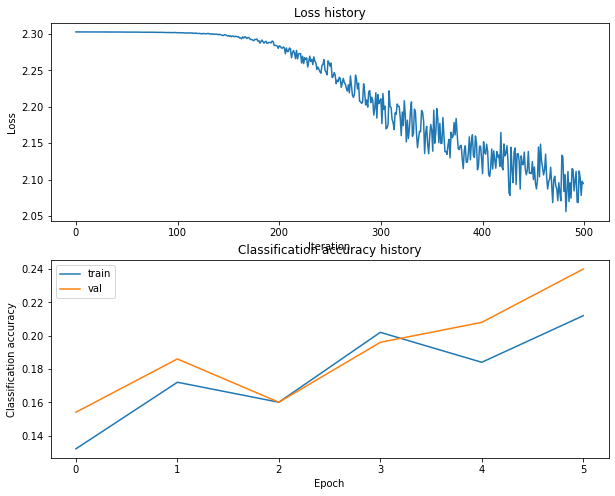

Training network with h_s 50, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.302744
iteration 100 / 500: loss 1.893571
iteration 200 / 500: loss 1.783646
iteration 300 / 500: loss 1.727735
iteration 400 / 500: loss 1.743110
Validation accuracy:  0.401


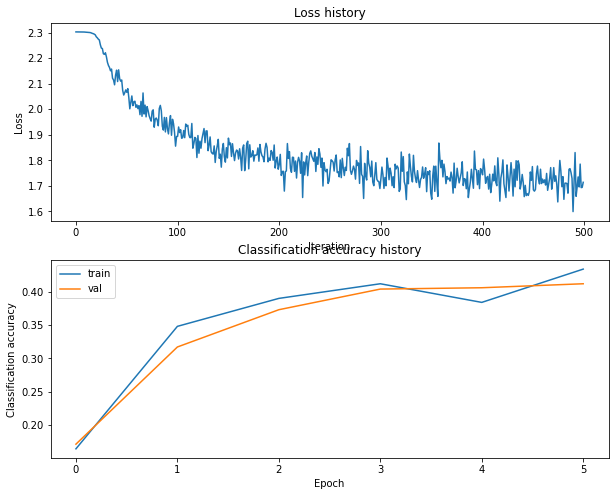

Training network with h_s 50, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.302793
iteration 100 / 1000: loss 2.301932
iteration 200 / 1000: loss 2.286237
iteration 300 / 1000: loss 2.185333
iteration 400 / 1000: loss 2.064928
iteration 500 / 1000: loss 2.059014
iteration 600 / 1000: loss 2.074264
iteration 700 / 1000: loss 2.164603
iteration 800 / 1000: loss 2.081291
iteration 900 / 1000: loss 1.960836
Validation accuracy:  0.29


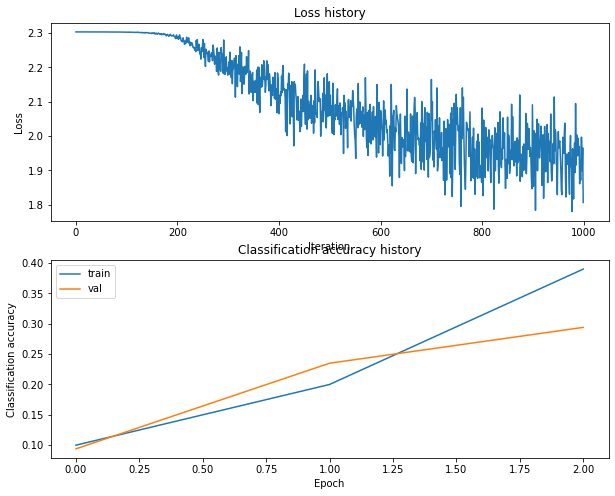

Training network with h_s 50, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.302783
iteration 100 / 1000: loss 1.883046
iteration 200 / 1000: loss 1.919020
iteration 300 / 1000: loss 1.824824
iteration 400 / 1000: loss 1.843943
iteration 500 / 1000: loss 1.751890
iteration 600 / 1000: loss 1.633915
iteration 700 / 1000: loss 1.841096
iteration 800 / 1000: loss 1.689361
iteration 900 / 1000: loss 1.925668
Validation accuracy:  0.382


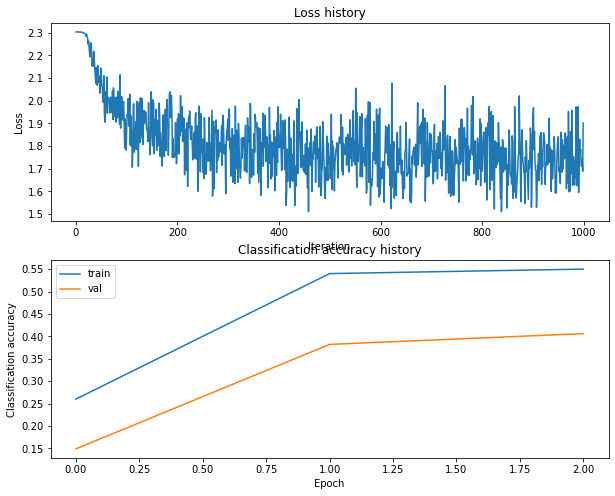

Training network with h_s 50, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.302770
iteration 100 / 1000: loss 2.301424
iteration 200 / 1000: loss 2.265826
iteration 300 / 1000: loss 2.156561
iteration 400 / 1000: loss 2.121392
iteration 500 / 1000: loss 2.065573
iteration 600 / 1000: loss 2.004440
iteration 700 / 1000: loss 2.014128
iteration 800 / 1000: loss 1.974338
iteration 900 / 1000: loss 1.983893
Validation accuracy:  0.292


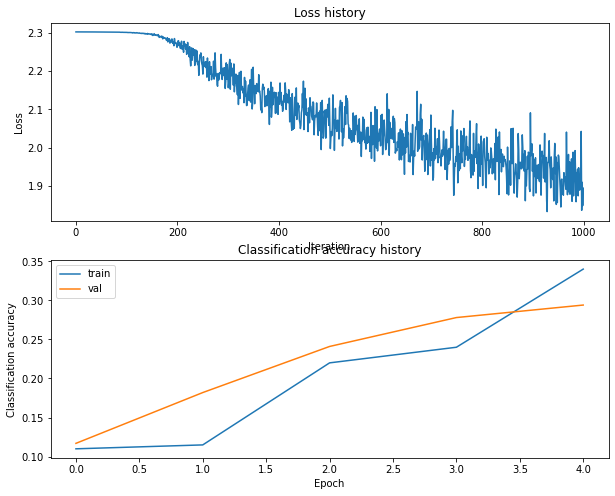

Training network with h_s 50, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.302784
iteration 100 / 1000: loss 1.929427
iteration 200 / 1000: loss 1.880660
iteration 300 / 1000: loss 1.840487
iteration 400 / 1000: loss 1.729072
iteration 500 / 1000: loss 1.758098
iteration 600 / 1000: loss 1.767695
iteration 700 / 1000: loss 1.564861
iteration 800 / 1000: loss 1.664351
iteration 900 / 1000: loss 1.711561
Validation accuracy:  0.405


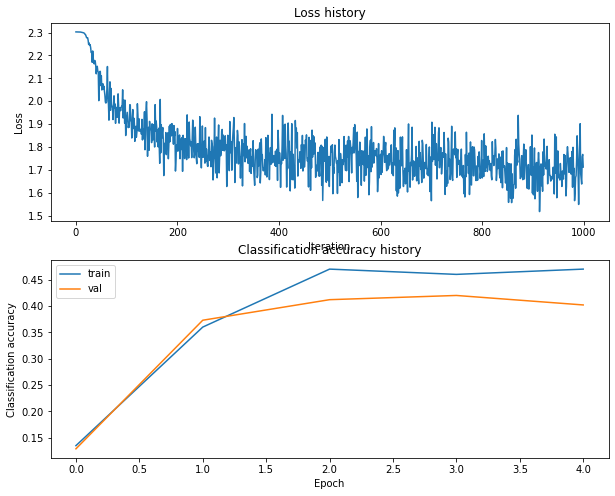

Training network with h_s 50, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.302773
iteration 100 / 1000: loss 2.302121
iteration 200 / 1000: loss 2.283849
iteration 300 / 1000: loss 2.219276
iteration 400 / 1000: loss 2.109278
iteration 500 / 1000: loss 2.051506
iteration 600 / 1000: loss 2.036514
iteration 700 / 1000: loss 1.983345
iteration 800 / 1000: loss 2.011023
iteration 900 / 1000: loss 1.950912
Validation accuracy:  0.307


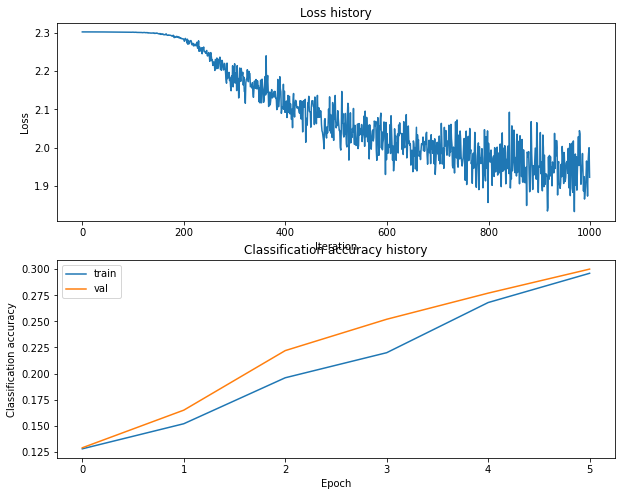

Training network with h_s 50, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.302783
iteration 100 / 1000: loss 1.916564
iteration 200 / 1000: loss 1.885424
iteration 300 / 1000: loss 1.778060
iteration 400 / 1000: loss 1.758552
iteration 500 / 1000: loss 1.755892
iteration 600 / 1000: loss 1.850477
iteration 700 / 1000: loss 1.673970
iteration 800 / 1000: loss 1.648473
iteration 900 / 1000: loss 1.648993
Validation accuracy:  0.406


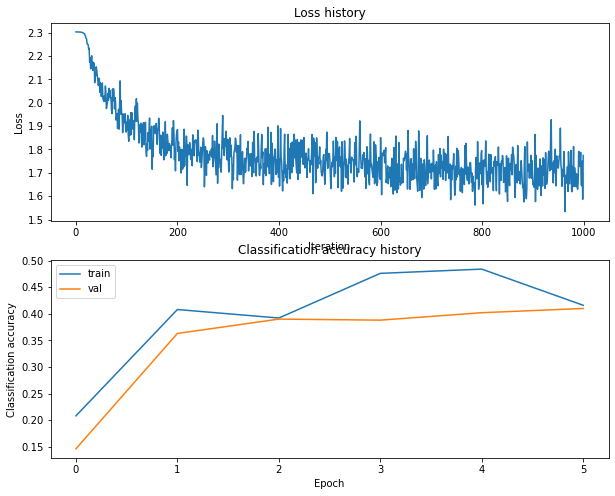

Training network with h_s 50, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.302775
iteration 100 / 1000: loss 2.301907
iteration 200 / 1000: loss 2.284583
iteration 300 / 1000: loss 2.196997
iteration 400 / 1000: loss 2.129639
iteration 500 / 1000: loss 2.118370
iteration 600 / 1000: loss 1.992314
iteration 700 / 1000: loss 1.941939
iteration 800 / 1000: loss 1.867174
iteration 900 / 1000: loss 1.923998
Validation accuracy:  0.306


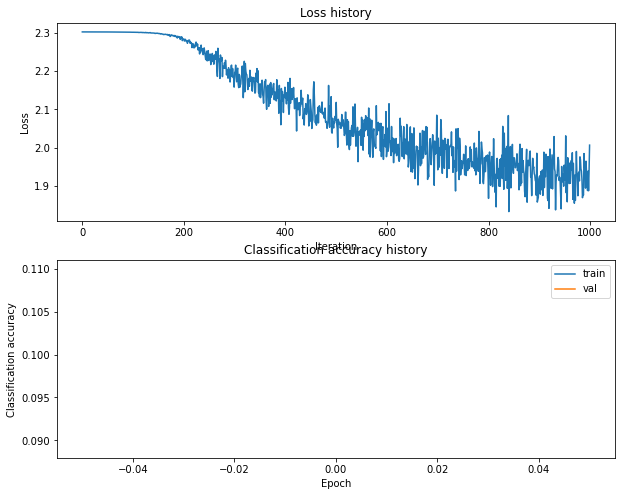

Training network with h_s 50, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.302777
iteration 100 / 1000: loss 1.957070
iteration 200 / 1000: loss 1.798681
iteration 300 / 1000: loss 1.808327
iteration 400 / 1000: loss 1.635037
iteration 500 / 1000: loss 1.713043
iteration 600 / 1000: loss 1.716858
iteration 700 / 1000: loss 1.658610
iteration 800 / 1000: loss 1.748540
iteration 900 / 1000: loss 1.764213
Validation accuracy:  0.402


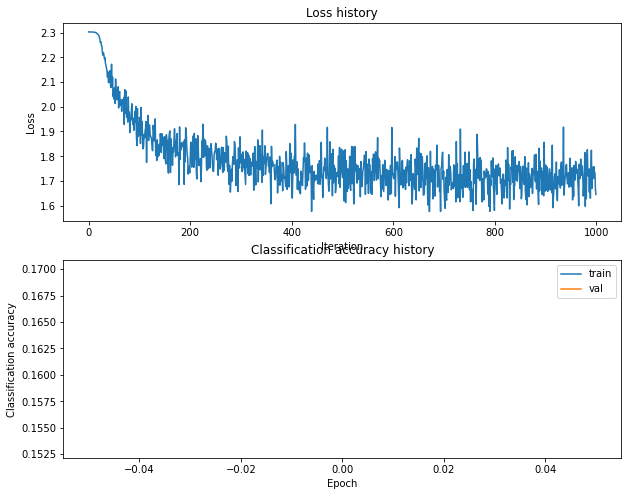

Training network with h_s 50, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.302777
iteration 100 / 1000: loss 2.301744
iteration 200 / 1000: loss 2.282397
iteration 300 / 1000: loss 2.214779
iteration 400 / 1000: loss 2.172322
iteration 500 / 1000: loss 2.079186
iteration 600 / 1000: loss 2.014660
iteration 700 / 1000: loss 2.035157
iteration 800 / 1000: loss 1.966644
iteration 900 / 1000: loss 1.982898
Validation accuracy:  0.274


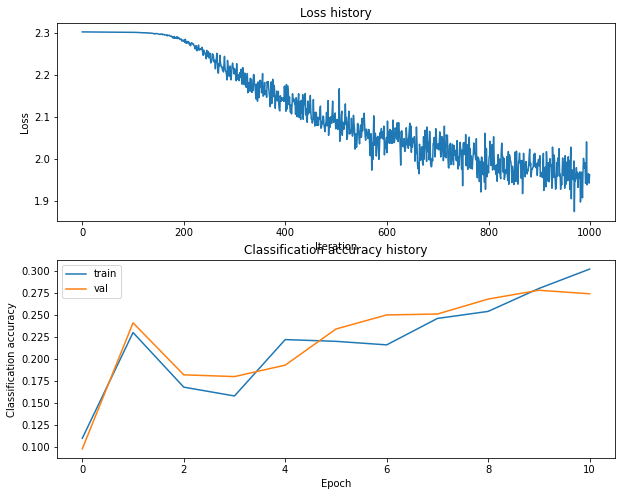

Training network with h_s 50, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.302786
iteration 100 / 1000: loss 1.902126
iteration 200 / 1000: loss 1.828219
iteration 300 / 1000: loss 1.789202
iteration 400 / 1000: loss 1.719017
iteration 500 / 1000: loss 1.699727
iteration 600 / 1000: loss 1.692151
iteration 700 / 1000: loss 1.651712
iteration 800 / 1000: loss 1.691368
iteration 900 / 1000: loss 1.712500
Validation accuracy:  0.416


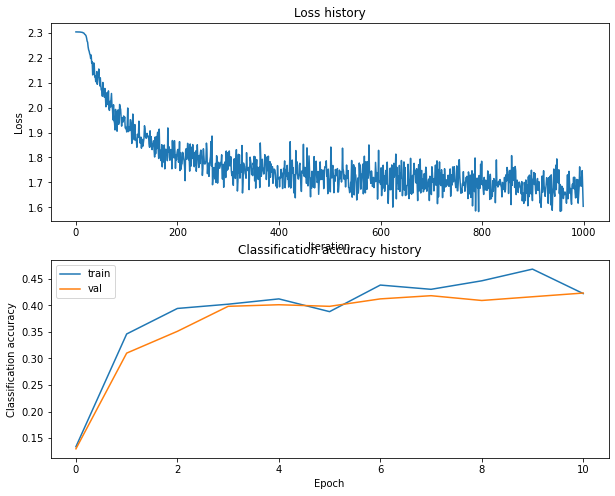

Training network with h_s 50, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.302771
iteration 100 / 1500: loss 2.302213
iteration 200 / 1500: loss 2.279941
iteration 300 / 1500: loss 2.129746
iteration 400 / 1500: loss 2.117879
iteration 500 / 1500: loss 2.051103
iteration 600 / 1500: loss 1.936059
iteration 700 / 1500: loss 2.141396
iteration 800 / 1500: loss 1.884337
iteration 900 / 1500: loss 1.783232
iteration 1000 / 1500: loss 1.837367
iteration 1100 / 1500: loss 1.801715
iteration 1200 / 1500: loss 1.954452
iteration 1300 / 1500: loss 1.890648
iteration 1400 / 1500: loss 1.794554
Validation accuracy:  0.346


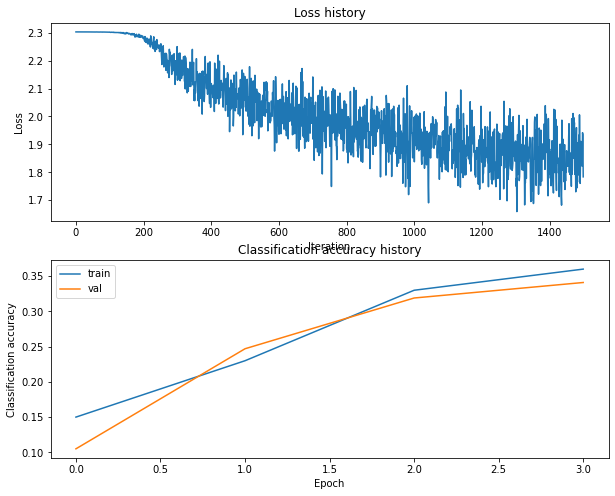

Training network with h_s 50, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.302757
iteration 100 / 1500: loss 2.014493
iteration 200 / 1500: loss 1.736731
iteration 300 / 1500: loss 1.796136
iteration 400 / 1500: loss 1.998229
iteration 500 / 1500: loss 1.730293
iteration 600 / 1500: loss 1.756621
iteration 700 / 1500: loss 1.716381
iteration 800 / 1500: loss 1.739466
iteration 900 / 1500: loss 1.608086
iteration 1000 / 1500: loss 1.796302
iteration 1100 / 1500: loss 1.756763
iteration 1200 / 1500: loss 1.748242
iteration 1300 / 1500: loss 1.619362
iteration 1400 / 1500: loss 1.567597
Validation accuracy:  0.397


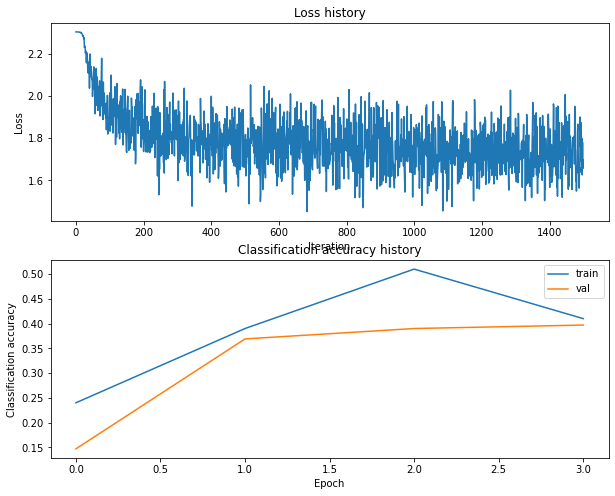

Training network with h_s 50, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.302789
iteration 100 / 1500: loss 2.301349
iteration 200 / 1500: loss 2.279008
iteration 300 / 1500: loss 2.172305
iteration 400 / 1500: loss 2.106494
iteration 500 / 1500: loss 2.113086
iteration 600 / 1500: loss 2.026928
iteration 700 / 1500: loss 2.061826
iteration 800 / 1500: loss 1.915777
iteration 900 / 1500: loss 2.004280
iteration 1000 / 1500: loss 1.889518
iteration 1100 / 1500: loss 1.957163
iteration 1200 / 1500: loss 1.908795
iteration 1300 / 1500: loss 1.919333
iteration 1400 / 1500: loss 1.800862
Validation accuracy:  0.325


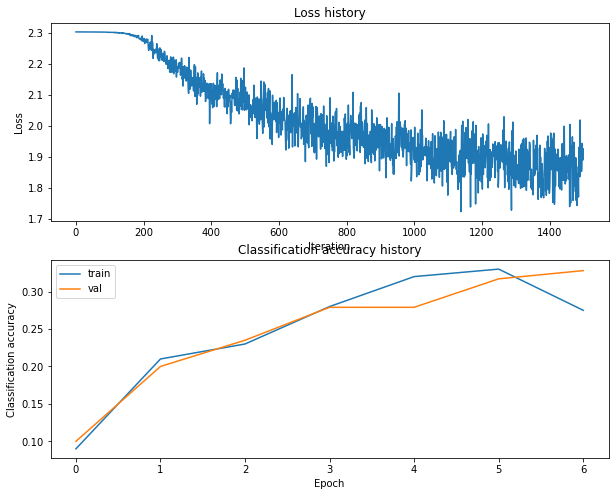

Training network with h_s 50, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.302794
iteration 100 / 1500: loss 1.865881
iteration 200 / 1500: loss 1.934319
iteration 300 / 1500: loss 1.729686
iteration 400 / 1500: loss 1.697692
iteration 500 / 1500: loss 1.692389
iteration 600 / 1500: loss 1.791585
iteration 700 / 1500: loss 1.645839
iteration 800 / 1500: loss 1.809668
iteration 900 / 1500: loss 1.788407
iteration 1000 / 1500: loss 1.639595
iteration 1100 / 1500: loss 1.644329
iteration 1200 / 1500: loss 1.740020
iteration 1300 / 1500: loss 1.716201
iteration 1400 / 1500: loss 1.743211
Validation accuracy:  0.42


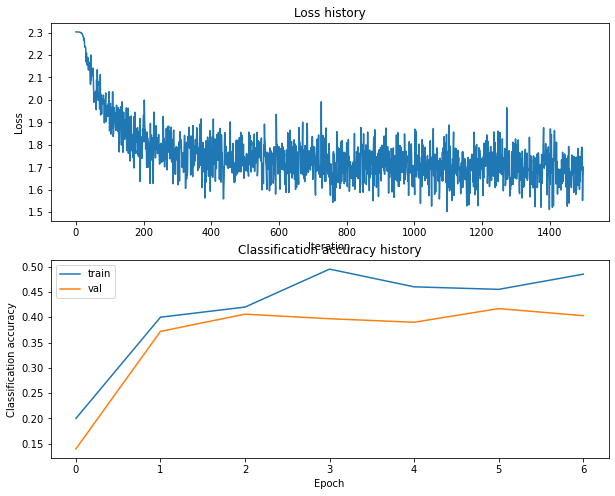

Training network with h_s 50, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.302774
iteration 100 / 1500: loss 2.301792
iteration 200 / 1500: loss 2.271493
iteration 300 / 1500: loss 2.257461
iteration 400 / 1500: loss 2.145992
iteration 500 / 1500: loss 2.093407
iteration 600 / 1500: loss 2.074483
iteration 700 / 1500: loss 1.986849
iteration 800 / 1500: loss 1.965962
iteration 900 / 1500: loss 1.999300
iteration 1000 / 1500: loss 1.908973
iteration 1100 / 1500: loss 1.948435
iteration 1200 / 1500: loss 1.995317
iteration 1300 / 1500: loss 1.862228
iteration 1400 / 1500: loss 1.810919
Validation accuracy:  0.334


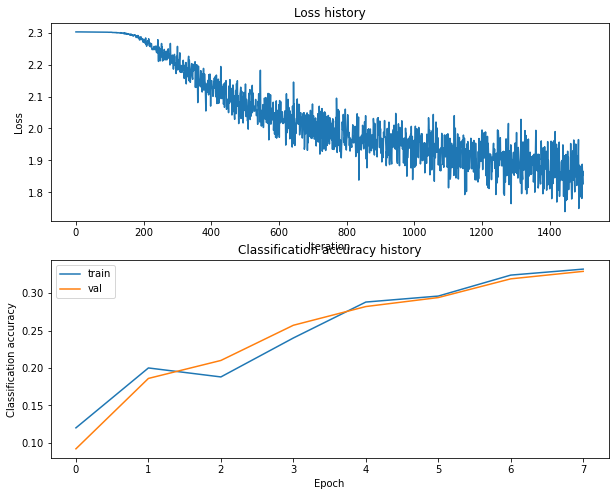

Training network with h_s 50, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.302800
iteration 100 / 1500: loss 1.953166
iteration 200 / 1500: loss 1.736073
iteration 300 / 1500: loss 1.779272
iteration 400 / 1500: loss 1.832020
iteration 500 / 1500: loss 1.765161
iteration 600 / 1500: loss 1.634806
iteration 700 / 1500: loss 1.690671
iteration 800 / 1500: loss 1.645392
iteration 900 / 1500: loss 1.633288
iteration 1000 / 1500: loss 1.777457
iteration 1100 / 1500: loss 1.813068
iteration 1200 / 1500: loss 1.760370
iteration 1300 / 1500: loss 1.652340
iteration 1400 / 1500: loss 1.746364
Validation accuracy:  0.415


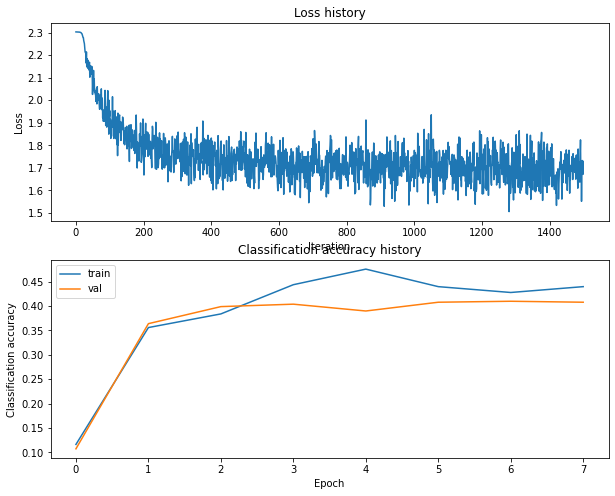

Training network with h_s 50, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.302792
iteration 100 / 1500: loss 2.301707
iteration 200 / 1500: loss 2.281644
iteration 300 / 1500: loss 2.192578
iteration 400 / 1500: loss 2.119208
iteration 500 / 1500: loss 2.028315
iteration 600 / 1500: loss 2.044859
iteration 700 / 1500: loss 2.064068
iteration 800 / 1500: loss 1.944105
iteration 900 / 1500: loss 1.944131
iteration 1000 / 1500: loss 1.955150
iteration 1100 / 1500: loss 1.821970
iteration 1200 / 1500: loss 1.847142
iteration 1300 / 1500: loss 1.878521
iteration 1400 / 1500: loss 1.806654
Validation accuracy:  0.348


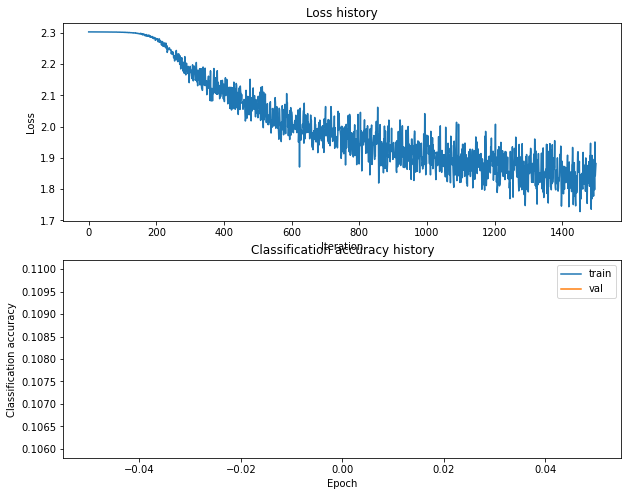

Training network with h_s 50, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.302772
iteration 100 / 1500: loss 1.882121
iteration 200 / 1500: loss 1.892551
iteration 300 / 1500: loss 1.745871
iteration 400 / 1500: loss 1.776545
iteration 500 / 1500: loss 1.731646
iteration 600 / 1500: loss 1.784241
iteration 700 / 1500: loss 1.772379
iteration 800 / 1500: loss 1.722473
iteration 900 / 1500: loss 1.747721
iteration 1000 / 1500: loss 1.738055
iteration 1100 / 1500: loss 1.700403
iteration 1200 / 1500: loss 1.676627
iteration 1300 / 1500: loss 1.647495
iteration 1400 / 1500: loss 1.672913
Validation accuracy:  0.406


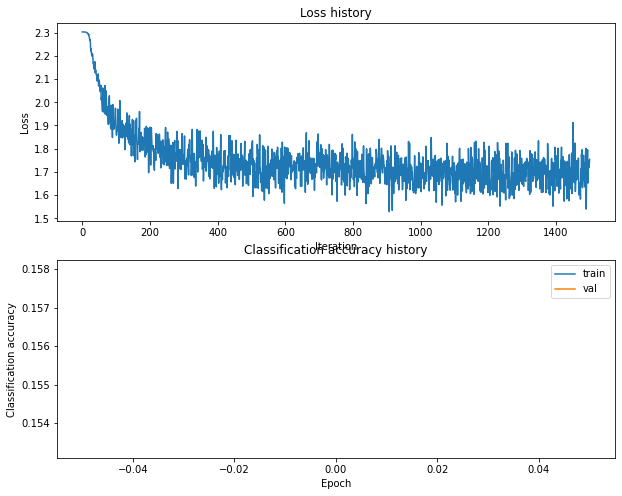

Training network with h_s 50, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.302775
iteration 100 / 1500: loss 2.302080
iteration 200 / 1500: loss 2.290703
iteration 300 / 1500: loss 2.189664
iteration 400 / 1500: loss 2.153693
iteration 500 / 1500: loss 2.079170
iteration 600 / 1500: loss 2.041600
iteration 700 / 1500: loss 2.040190
iteration 800 / 1500: loss 1.993340
iteration 900 / 1500: loss 1.957292
iteration 1000 / 1500: loss 1.884429
iteration 1100 / 1500: loss 1.917999
iteration 1200 / 1500: loss 1.955020
iteration 1300 / 1500: loss 1.879592
iteration 1400 / 1500: loss 1.889898
Validation accuracy:  0.32


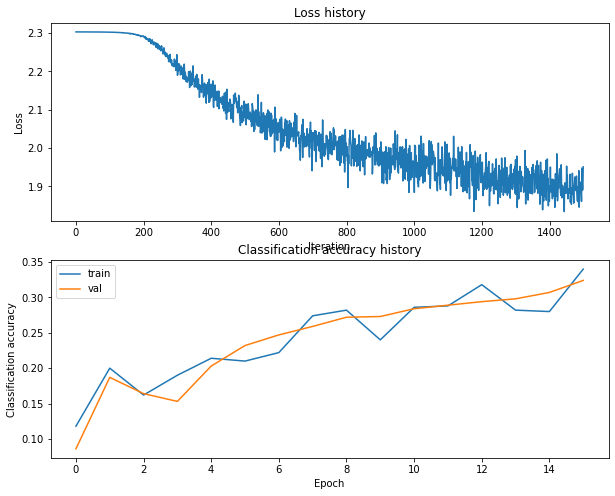

Training network with h_s 50, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.302791
iteration 100 / 1500: loss 1.904468
iteration 200 / 1500: loss 1.841307
iteration 300 / 1500: loss 1.805758
iteration 400 / 1500: loss 1.713430
iteration 500 / 1500: loss 1.673969
iteration 600 / 1500: loss 1.814113
iteration 700 / 1500: loss 1.773336
iteration 800 / 1500: loss 1.734511
iteration 900 / 1500: loss 1.723861
iteration 1000 / 1500: loss 1.637846
iteration 1100 / 1500: loss 1.689238
iteration 1200 / 1500: loss 1.667631
iteration 1300 / 1500: loss 1.668726
iteration 1400 / 1500: loss 1.617724
Validation accuracy:  0.419


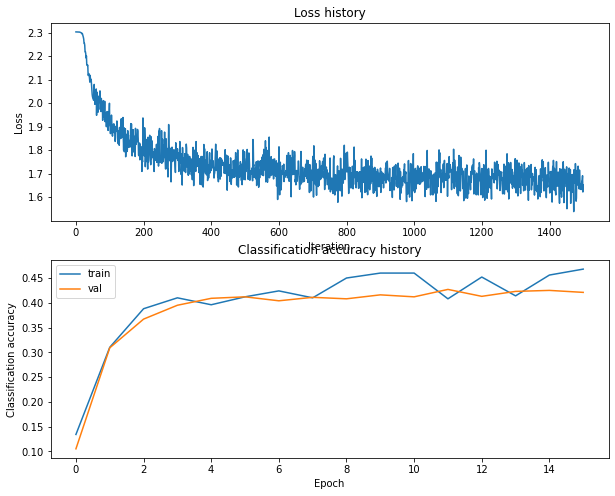

Training network with h_s 50, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.302776
iteration 100 / 2500: loss 2.301845
iteration 200 / 2500: loss 2.283970
iteration 300 / 2500: loss 2.145086
iteration 400 / 2500: loss 2.105626
iteration 500 / 2500: loss 2.020395
iteration 600 / 2500: loss 1.983871
iteration 700 / 2500: loss 2.027971
iteration 800 / 2500: loss 1.975281
iteration 900 / 2500: loss 1.957631
iteration 1000 / 2500: loss 1.931276
iteration 1100 / 2500: loss 1.980901
iteration 1200 / 2500: loss 1.849217
iteration 1300 / 2500: loss 1.839655
iteration 1400 / 2500: loss 1.821462
iteration 1500 / 2500: loss 1.962050
iteration 1600 / 2500: loss 1.738005
iteration 1700 / 2500: loss 1.779921
iteration 1800 / 2500: loss 1.856456
iteration 1900 / 2500: loss 1.856068
iteration 2000 / 2500: loss 1.708007
iteration 2100 / 2500: loss 1.629527
iteration 2200 / 2500: loss 1.861078
iteration 2300 / 2500: loss 1.713714
iteration 2400 / 2500: loss 1.694809
Validation accuracy:  0.384

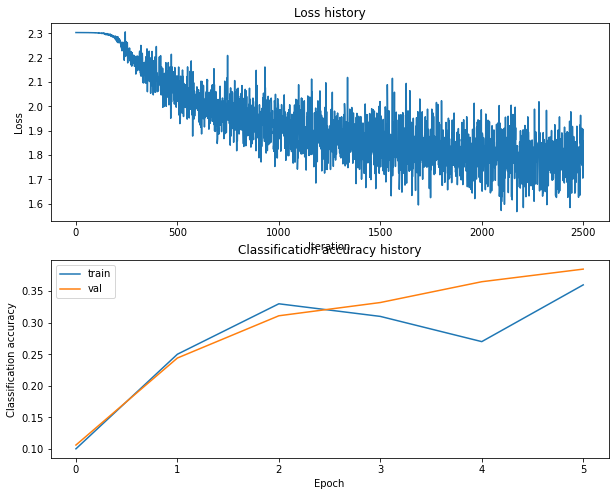

Training network with h_s 50, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.302803
iteration 100 / 2500: loss 1.875300
iteration 200 / 2500: loss 1.974397
iteration 300 / 2500: loss 1.832364
iteration 400 / 2500: loss 1.917428
iteration 500 / 2500: loss 1.729514
iteration 600 / 2500: loss 1.799365
iteration 700 / 2500: loss 1.824215
iteration 800 / 2500: loss 1.685951
iteration 900 / 2500: loss 1.621874
iteration 1000 / 2500: loss 1.903768
iteration 1100 / 2500: loss 1.869872
iteration 1200 / 2500: loss 1.633368
iteration 1300 / 2500: loss 1.657125
iteration 1400 / 2500: loss 1.755567
iteration 1500 / 2500: loss 1.770641
iteration 1600 / 2500: loss 1.587962
iteration 1700 / 2500: loss 1.780136
iteration 1800 / 2500: loss 1.709811
iteration 1900 / 2500: loss 1.681632
iteration 2000 / 2500: loss 1.902063
iteration 2100 / 2500: loss 1.736169
iteration 2200 / 2500: loss 1.736704
iteration 2300 / 2500: loss 1.596954
iteration 2400 / 2500: loss 1.824127
Validation accuracy:  0.414


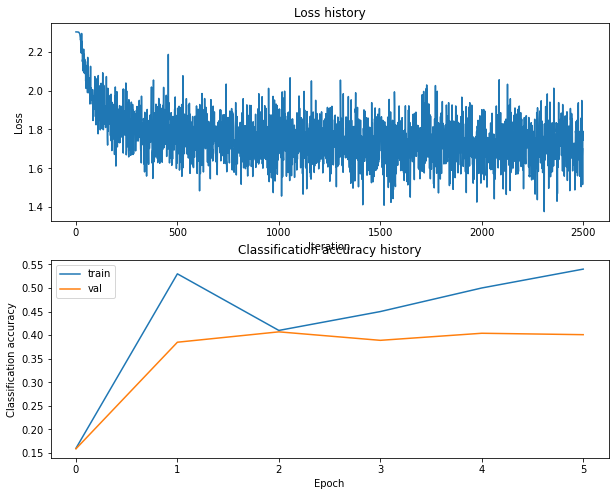

Training network with h_s 50, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.302755
iteration 100 / 2500: loss 2.301100
iteration 200 / 2500: loss 2.265671
iteration 300 / 2500: loss 2.207586
iteration 400 / 2500: loss 2.122989
iteration 500 / 2500: loss 2.052345
iteration 600 / 2500: loss 2.023065
iteration 700 / 2500: loss 1.972229
iteration 800 / 2500: loss 1.985455
iteration 900 / 2500: loss 1.976873
iteration 1000 / 2500: loss 1.968442
iteration 1100 / 2500: loss 1.994895
iteration 1200 / 2500: loss 1.945798
iteration 1300 / 2500: loss 1.824483
iteration 1400 / 2500: loss 1.818893
iteration 1500 / 2500: loss 1.845714
iteration 1600 / 2500: loss 1.861188
iteration 1700 / 2500: loss 1.866920
iteration 1800 / 2500: loss 1.764912
iteration 1900 / 2500: loss 1.769102
iteration 2000 / 2500: loss 1.843081
iteration 2100 / 2500: loss 1.744445
iteration 2200 / 2500: loss 1.804613
iteration 2300 / 2500: loss 1.797414
iteration 2400 / 2500: loss 1.767523
Validation accuracy:  0.376

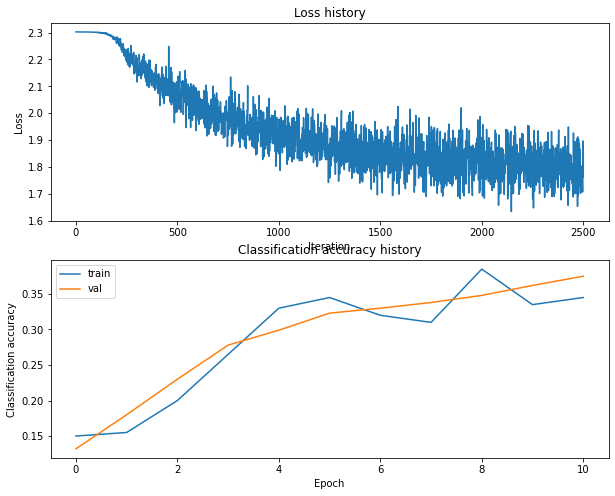

Training network with h_s 50, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.302769
iteration 100 / 2500: loss 1.943064
iteration 200 / 2500: loss 1.837566
iteration 300 / 2500: loss 1.757957
iteration 400 / 2500: loss 1.810059
iteration 500 / 2500: loss 1.754509
iteration 600 / 2500: loss 1.647928
iteration 700 / 2500: loss 1.718693
iteration 800 / 2500: loss 1.645788
iteration 900 / 2500: loss 1.690879
iteration 1000 / 2500: loss 1.783462
iteration 1100 / 2500: loss 1.711564
iteration 1200 / 2500: loss 1.570888
iteration 1300 / 2500: loss 1.724130
iteration 1400 / 2500: loss 1.701573
iteration 1500 / 2500: loss 1.703774
iteration 1600 / 2500: loss 1.653204
iteration 1700 / 2500: loss 1.682142
iteration 1800 / 2500: loss 1.708681
iteration 1900 / 2500: loss 1.765197
iteration 2000 / 2500: loss 1.741170
iteration 2100 / 2500: loss 1.698840
iteration 2200 / 2500: loss 1.739037
iteration 2300 / 2500: loss 1.575747
iteration 2400 / 2500: loss 1.775475
Validation accuracy:  0.419


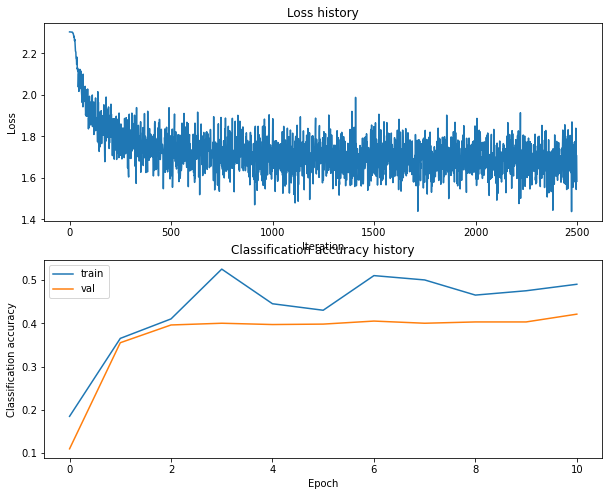

Training network with h_s 50, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.302774
iteration 100 / 2500: loss 2.301618
iteration 200 / 2500: loss 2.280752
iteration 300 / 2500: loss 2.173300
iteration 400 / 2500: loss 2.159790
iteration 500 / 2500: loss 2.062467
iteration 600 / 2500: loss 2.020184
iteration 700 / 2500: loss 1.977850
iteration 800 / 2500: loss 1.930369
iteration 900 / 2500: loss 1.947987
iteration 1000 / 2500: loss 1.985469
iteration 1100 / 2500: loss 1.864863
iteration 1200 / 2500: loss 1.855643
iteration 1300 / 2500: loss 1.958380
iteration 1400 / 2500: loss 1.975462
iteration 1500 / 2500: loss 1.865030
iteration 1600 / 2500: loss 1.918269
iteration 1700 / 2500: loss 1.821991
iteration 1800 / 2500: loss 1.949826
iteration 1900 / 2500: loss 1.775326
iteration 2000 / 2500: loss 1.672263
iteration 2100 / 2500: loss 1.812510
iteration 2200 / 2500: loss 1.758410
iteration 2300 / 2500: loss 1.689687
iteration 2400 / 2500: loss 1.752709
Validation accuracy:  0.365

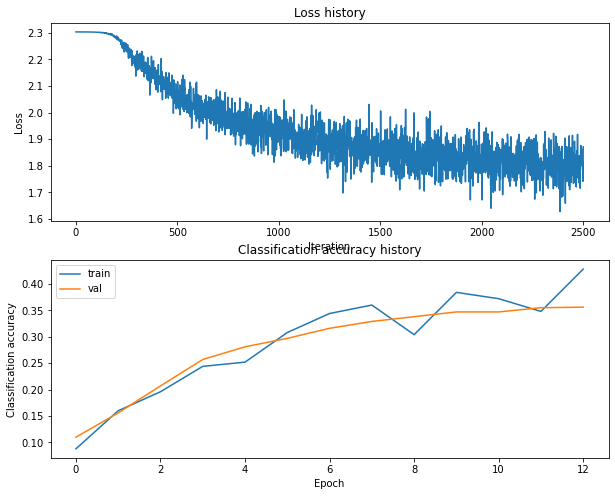

Training network with h_s 50, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.302760
iteration 100 / 2500: loss 1.935186
iteration 200 / 2500: loss 1.837838
iteration 300 / 2500: loss 1.821914
iteration 400 / 2500: loss 1.700941
iteration 500 / 2500: loss 1.756492
iteration 600 / 2500: loss 1.741306
iteration 700 / 2500: loss 1.758192
iteration 800 / 2500: loss 1.610637
iteration 900 / 2500: loss 1.869553
iteration 1000 / 2500: loss 1.638374
iteration 1100 / 2500: loss 1.827933
iteration 1200 / 2500: loss 1.705666
iteration 1300 / 2500: loss 1.688056
iteration 1400 / 2500: loss 1.755121
iteration 1500 / 2500: loss 1.609642
iteration 1600 / 2500: loss 1.715128
iteration 1700 / 2500: loss 1.796768
iteration 1800 / 2500: loss 1.791244
iteration 1900 / 2500: loss 1.776509
iteration 2000 / 2500: loss 1.641871
iteration 2100 / 2500: loss 1.577635
iteration 2200 / 2500: loss 1.601424
iteration 2300 / 2500: loss 1.630233
iteration 2400 / 2500: loss 1.601796
Validation accuracy:  0.401


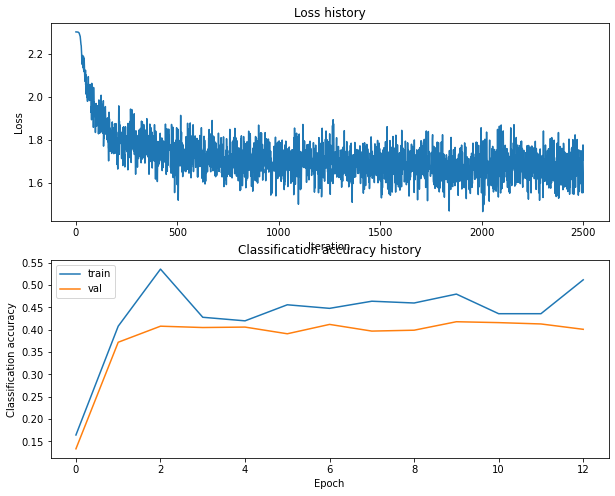

Training network with h_s 50, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.302776
iteration 100 / 2500: loss 2.301875
iteration 200 / 2500: loss 2.287390
iteration 300 / 2500: loss 2.236130
iteration 400 / 2500: loss 2.128471
iteration 500 / 2500: loss 2.114888
iteration 600 / 2500: loss 2.056407
iteration 700 / 2500: loss 2.069806
iteration 800 / 2500: loss 1.966552
iteration 900 / 2500: loss 1.991145
iteration 1000 / 2500: loss 1.900390
iteration 1100 / 2500: loss 1.803921
iteration 1200 / 2500: loss 1.867269
iteration 1300 / 2500: loss 1.829391
iteration 1400 / 2500: loss 1.811308
iteration 1500 / 2500: loss 1.853789
iteration 1600 / 2500: loss 1.871981
iteration 1700 / 2500: loss 1.811225
iteration 1800 / 2500: loss 1.793942
iteration 1900 / 2500: loss 1.675648
iteration 2000 / 2500: loss 1.781590
iteration 2100 / 2500: loss 1.792475
iteration 2200 / 2500: loss 1.826845
iteration 2300 / 2500: loss 1.734734
iteration 2400 / 2500: loss 1.756666
Validation accuracy:  0.386

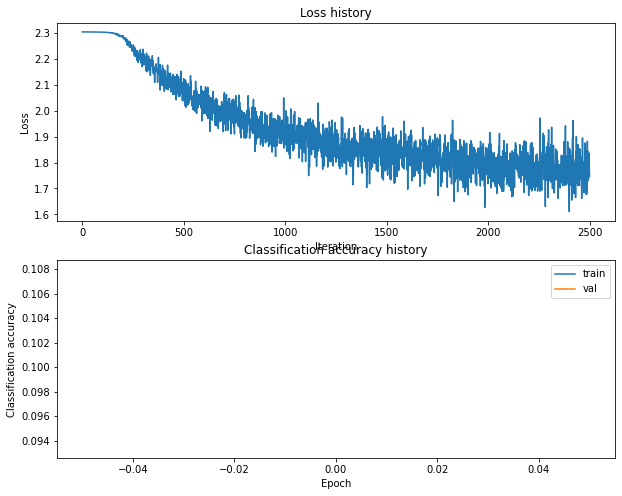

Training network with h_s 50, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.302779
iteration 100 / 2500: loss 1.931481
iteration 200 / 2500: loss 1.769341
iteration 300 / 2500: loss 1.811592
iteration 400 / 2500: loss 1.734914
iteration 500 / 2500: loss 1.734619
iteration 600 / 2500: loss 1.746038
iteration 700 / 2500: loss 1.600815
iteration 800 / 2500: loss 1.766473
iteration 900 / 2500: loss 1.756492
iteration 1000 / 2500: loss 1.803207
iteration 1100 / 2500: loss 1.755341
iteration 1200 / 2500: loss 1.673852
iteration 1300 / 2500: loss 1.602359
iteration 1400 / 2500: loss 1.677306
iteration 1500 / 2500: loss 1.819412
iteration 1600 / 2500: loss 1.610395
iteration 1700 / 2500: loss 1.601497
iteration 1800 / 2500: loss 1.624513
iteration 1900 / 2500: loss 1.616709
iteration 2000 / 2500: loss 1.646421
iteration 2100 / 2500: loss 1.734354
iteration 2200 / 2500: loss 1.777936
iteration 2300 / 2500: loss 1.762733
iteration 2400 / 2500: loss 1.674269
Validation accuracy:  0.397


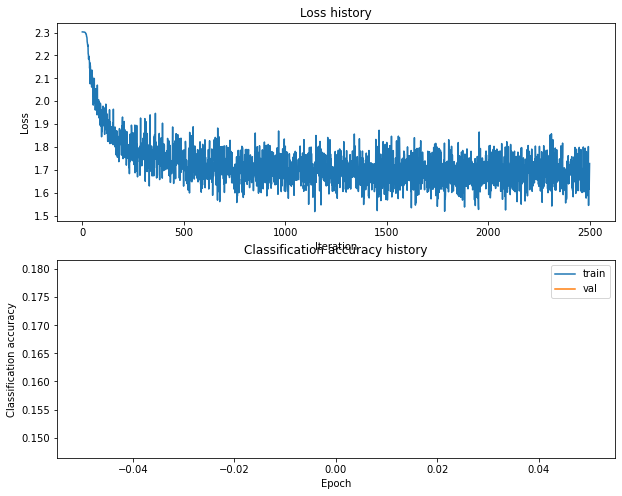

Training network with h_s 50, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.302796
iteration 100 / 2500: loss 2.301649
iteration 200 / 2500: loss 2.279126
iteration 300 / 2500: loss 2.173330
iteration 400 / 2500: loss 2.108490
iteration 500 / 2500: loss 2.095592
iteration 600 / 2500: loss 2.033653
iteration 700 / 2500: loss 2.012429
iteration 800 / 2500: loss 1.969640
iteration 900 / 2500: loss 1.963931
iteration 1000 / 2500: loss 2.013121
iteration 1100 / 2500: loss 1.990682
iteration 1200 / 2500: loss 1.947424
iteration 1300 / 2500: loss 1.912192
iteration 1400 / 2500: loss 1.953035
iteration 1500 / 2500: loss 1.932157
iteration 1600 / 2500: loss 1.839357
iteration 1700 / 2500: loss 1.890020
iteration 1800 / 2500: loss 1.919363
iteration 1900 / 2500: loss 1.891027
iteration 2000 / 2500: loss 1.839223
iteration 2100 / 2500: loss 1.920720
iteration 2200 / 2500: loss 1.889257
iteration 2300 / 2500: loss 1.884022
iteration 2400 / 2500: loss 1.811111
Validation accuracy:  0.341

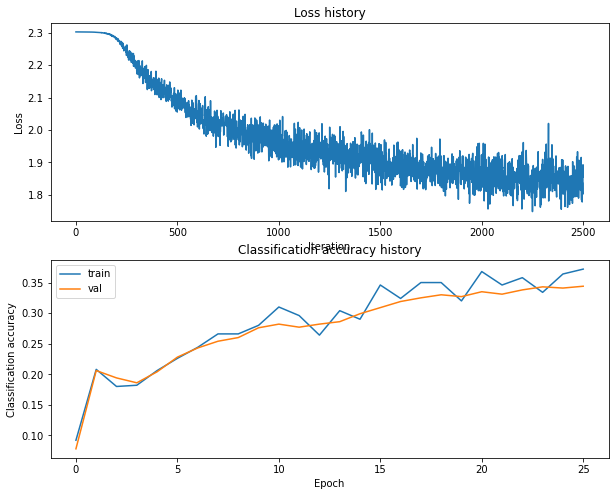

Training network with h_s 50, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.302778
iteration 100 / 2500: loss 1.943060
iteration 200 / 2500: loss 1.805769
iteration 300 / 2500: loss 1.653445
iteration 400 / 2500: loss 1.686946
iteration 500 / 2500: loss 1.726949
iteration 600 / 2500: loss 1.640262
iteration 700 / 2500: loss 1.637507
iteration 800 / 2500: loss 1.620887
iteration 900 / 2500: loss 1.746637
iteration 1000 / 2500: loss 1.752463
iteration 1100 / 2500: loss 1.749711
iteration 1200 / 2500: loss 1.743764
iteration 1300 / 2500: loss 1.716400
iteration 1400 / 2500: loss 1.672304
iteration 1500 / 2500: loss 1.642810
iteration 1600 / 2500: loss 1.592296
iteration 1700 / 2500: loss 1.675355
iteration 1800 / 2500: loss 1.639669
iteration 1900 / 2500: loss 1.649047
iteration 2000 / 2500: loss 1.697207
iteration 2100 / 2500: loss 1.718694
iteration 2200 / 2500: loss 1.695172
iteration 2300 / 2500: loss 1.631971
iteration 2400 / 2500: loss 1.597579
Validation accuracy:  0.426


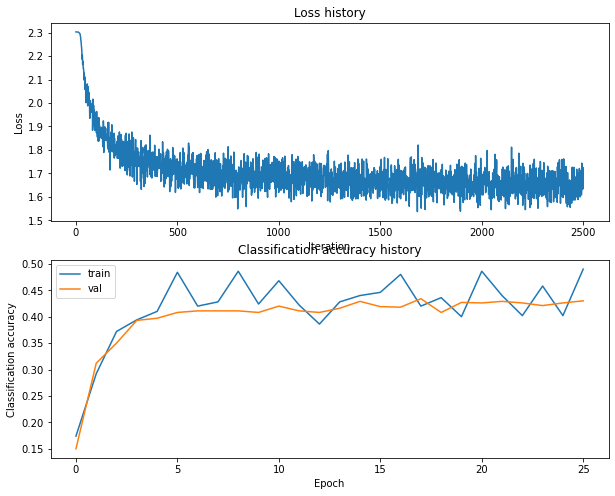

Training network with h_s 50, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.302771
iteration 100 / 5000: loss 2.300831
iteration 200 / 5000: loss 2.273695
iteration 300 / 5000: loss 2.162114
iteration 400 / 5000: loss 2.105308
iteration 500 / 5000: loss 2.044920
iteration 600 / 5000: loss 1.959430
iteration 700 / 5000: loss 1.997979
iteration 800 / 5000: loss 2.004654
iteration 900 / 5000: loss 1.873501
iteration 1000 / 5000: loss 1.999951
iteration 1100 / 5000: loss 1.955431
iteration 1200 / 5000: loss 1.991196
iteration 1300 / 5000: loss 1.953892
iteration 1400 / 5000: loss 1.927985
iteration 1500 / 5000: loss 1.823263
iteration 1600 / 5000: loss 1.841184
iteration 1700 / 5000: loss 1.797877
iteration 1800 / 5000: loss 1.627575
iteration 1900 / 5000: loss 1.872508
iteration 2000 / 5000: loss 1.700215
iteration 2100 / 5000: loss 1.930414
iteration 2200 / 5000: loss 1.806423
iteration 2300 / 5000: loss 1.690538
iteration 2400 / 5000: loss 1.837549
iteration 2500 / 5000: loss

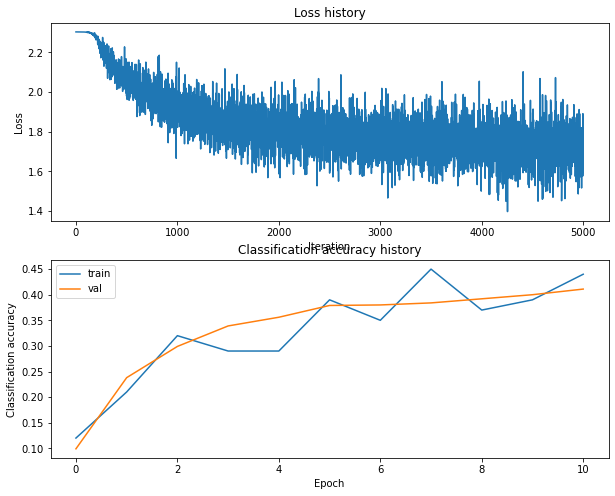

Training network with h_s 50, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.302780
iteration 100 / 5000: loss 1.945247
iteration 200 / 5000: loss 1.938365
iteration 300 / 5000: loss 1.716555
iteration 400 / 5000: loss 1.907430
iteration 500 / 5000: loss 1.688857
iteration 600 / 5000: loss 1.950533
iteration 700 / 5000: loss 1.779260
iteration 800 / 5000: loss 1.693230
iteration 900 / 5000: loss 1.843755
iteration 1000 / 5000: loss 1.759794
iteration 1100 / 5000: loss 1.697662
iteration 1200 / 5000: loss 1.621101
iteration 1300 / 5000: loss 1.954425
iteration 1400 / 5000: loss 1.709398
iteration 1500 / 5000: loss 1.611431
iteration 1600 / 5000: loss 1.807153
iteration 1700 / 5000: loss 1.762559
iteration 1800 / 5000: loss 1.723342
iteration 1900 / 5000: loss 1.723207
iteration 2000 / 5000: loss 1.647083
iteration 2100 / 5000: loss 1.672792
iteration 2200 / 5000: loss 2.056480
iteration 2300 / 5000: loss 1.671984
iteration 2400 / 5000: loss 1.722190
iteration 2500 / 5000: loss 

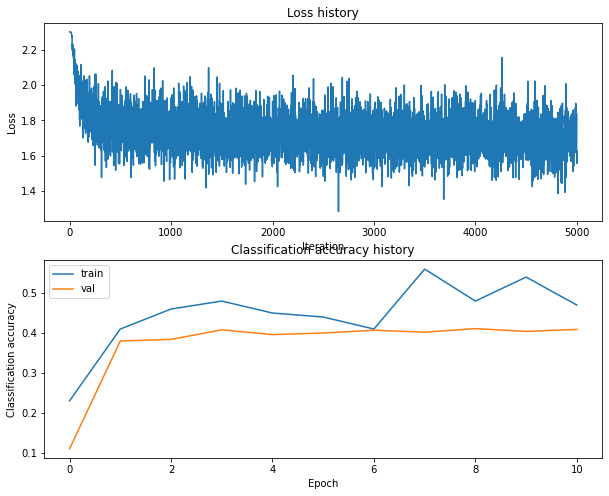

Training network with h_s 50, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.302789
iteration 100 / 5000: loss 2.300972
iteration 200 / 5000: loss 2.277316
iteration 300 / 5000: loss 2.198297
iteration 400 / 5000: loss 2.097009
iteration 500 / 5000: loss 2.052445
iteration 600 / 5000: loss 1.984637
iteration 700 / 5000: loss 1.990335
iteration 800 / 5000: loss 1.976938
iteration 900 / 5000: loss 1.906602
iteration 1000 / 5000: loss 1.960817
iteration 1100 / 5000: loss 1.775549
iteration 1200 / 5000: loss 1.841313
iteration 1300 / 5000: loss 1.893151
iteration 1400 / 5000: loss 1.943427
iteration 1500 / 5000: loss 1.853063
iteration 1600 / 5000: loss 1.929350
iteration 1700 / 5000: loss 1.780115
iteration 1800 / 5000: loss 1.784913
iteration 1900 / 5000: loss 1.854548
iteration 2000 / 5000: loss 1.719457
iteration 2100 / 5000: loss 1.925382
iteration 2200 / 5000: loss 1.761261
iteration 2300 / 5000: loss 1.787253
iteration 2400 / 5000: loss 1.819850
iteration 2500 / 5000: loss

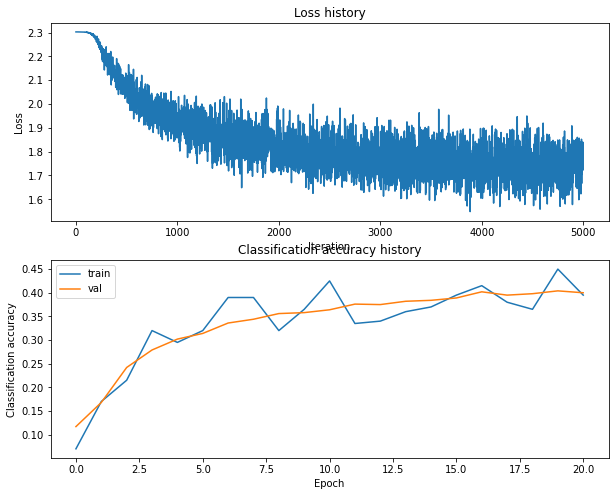

Training network with h_s 50, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.302764
iteration 100 / 5000: loss 1.836628
iteration 200 / 5000: loss 1.787000
iteration 300 / 5000: loss 1.786312
iteration 400 / 5000: loss 1.653786
iteration 500 / 5000: loss 1.761468
iteration 600 / 5000: loss 1.760285
iteration 700 / 5000: loss 1.666527
iteration 800 / 5000: loss 1.770349
iteration 900 / 5000: loss 1.772497
iteration 1000 / 5000: loss 1.713625
iteration 1100 / 5000: loss 1.810369
iteration 1200 / 5000: loss 1.702962
iteration 1300 / 5000: loss 1.795005
iteration 1400 / 5000: loss 1.579570
iteration 1500 / 5000: loss 1.736094
iteration 1600 / 5000: loss 1.818425
iteration 1700 / 5000: loss 1.609437
iteration 1800 / 5000: loss 1.611321
iteration 1900 / 5000: loss 1.703589
iteration 2000 / 5000: loss 1.705865
iteration 2100 / 5000: loss 1.687506
iteration 2200 / 5000: loss 1.702171
iteration 2300 / 5000: loss 1.717035
iteration 2400 / 5000: loss 1.695347
iteration 2500 / 5000: loss 

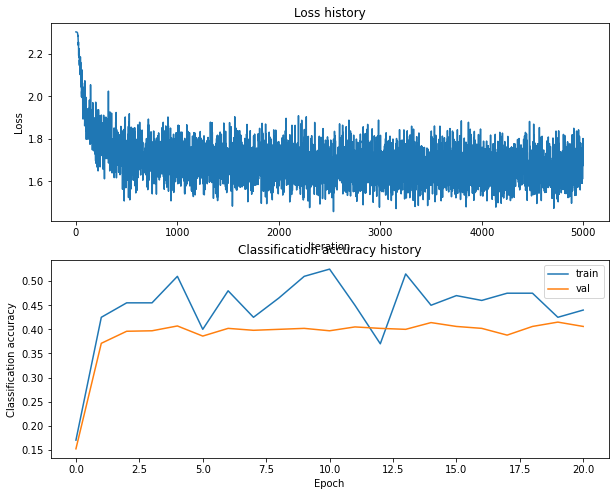

Training network with h_s 50, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.302778
iteration 100 / 5000: loss 2.301062
iteration 200 / 5000: loss 2.264992
iteration 300 / 5000: loss 2.193993
iteration 400 / 5000: loss 2.130300
iteration 500 / 5000: loss 2.001652
iteration 600 / 5000: loss 1.981162
iteration 700 / 5000: loss 1.939153
iteration 800 / 5000: loss 1.954152
iteration 900 / 5000: loss 1.923069
iteration 1000 / 5000: loss 1.888878
iteration 1100 / 5000: loss 1.908118
iteration 1200 / 5000: loss 1.855661
iteration 1300 / 5000: loss 1.812013
iteration 1400 / 5000: loss 1.808593
iteration 1500 / 5000: loss 1.854263
iteration 1600 / 5000: loss 1.867318
iteration 1700 / 5000: loss 1.766825
iteration 1800 / 5000: loss 1.845384
iteration 1900 / 5000: loss 1.867630
iteration 2000 / 5000: loss 1.837683
iteration 2100 / 5000: loss 1.743387
iteration 2200 / 5000: loss 1.766226
iteration 2300 / 5000: loss 1.729626
iteration 2400 / 5000: loss 1.768303
iteration 2500 / 5000: loss

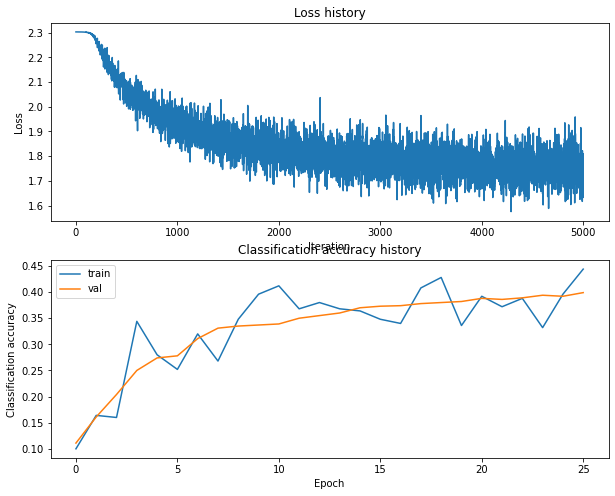

Training network with h_s 50, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.302753
iteration 100 / 5000: loss 1.824958
iteration 200 / 5000: loss 1.777362
iteration 300 / 5000: loss 1.767405
iteration 400 / 5000: loss 1.766338
iteration 500 / 5000: loss 1.792255
iteration 600 / 5000: loss 1.538371
iteration 700 / 5000: loss 1.658683
iteration 800 / 5000: loss 1.716884
iteration 900 / 5000: loss 1.724503
iteration 1000 / 5000: loss 1.794957
iteration 1100 / 5000: loss 1.675989
iteration 1200 / 5000: loss 1.787134
iteration 1300 / 5000: loss 1.617741
iteration 1400 / 5000: loss 1.757494
iteration 1500 / 5000: loss 1.593864
iteration 1600 / 5000: loss 1.605104
iteration 1700 / 5000: loss 1.644770
iteration 1800 / 5000: loss 1.728526
iteration 1900 / 5000: loss 1.553468
iteration 2000 / 5000: loss 1.766091
iteration 2100 / 5000: loss 1.684779
iteration 2200 / 5000: loss 1.732479
iteration 2300 / 5000: loss 1.683115
iteration 2400 / 5000: loss 1.585944
iteration 2500 / 5000: loss 

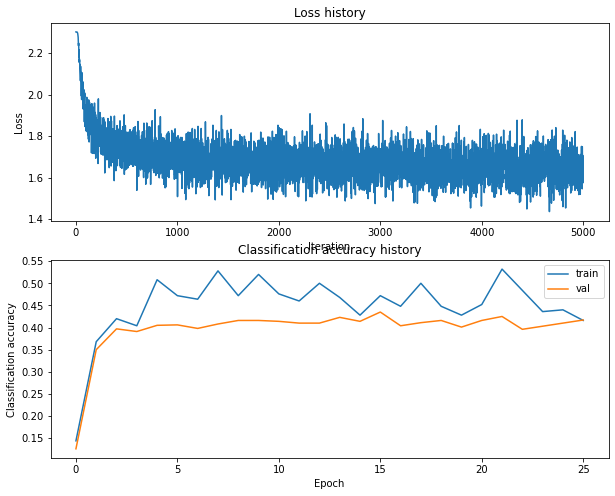

Training network with h_s 50, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.302788
iteration 100 / 5000: loss 2.301696
iteration 200 / 5000: loss 2.286275
iteration 300 / 5000: loss 2.180135
iteration 400 / 5000: loss 2.095489
iteration 500 / 5000: loss 2.021191
iteration 600 / 5000: loss 2.047977
iteration 700 / 5000: loss 1.954824
iteration 800 / 5000: loss 1.972825
iteration 900 / 5000: loss 1.922976
iteration 1000 / 5000: loss 1.906862
iteration 1100 / 5000: loss 1.907698
iteration 1200 / 5000: loss 1.884407
iteration 1300 / 5000: loss 1.745627
iteration 1400 / 5000: loss 1.798073
iteration 1500 / 5000: loss 1.825194
iteration 1600 / 5000: loss 1.838420
iteration 1700 / 5000: loss 1.810707
iteration 1800 / 5000: loss 1.851265
iteration 1900 / 5000: loss 1.784262
iteration 2000 / 5000: loss 1.783584
iteration 2100 / 5000: loss 1.713124
iteration 2200 / 5000: loss 1.790034
iteration 2300 / 5000: loss 1.746995
iteration 2400 / 5000: loss 1.836626
iteration 2500 / 5000: loss

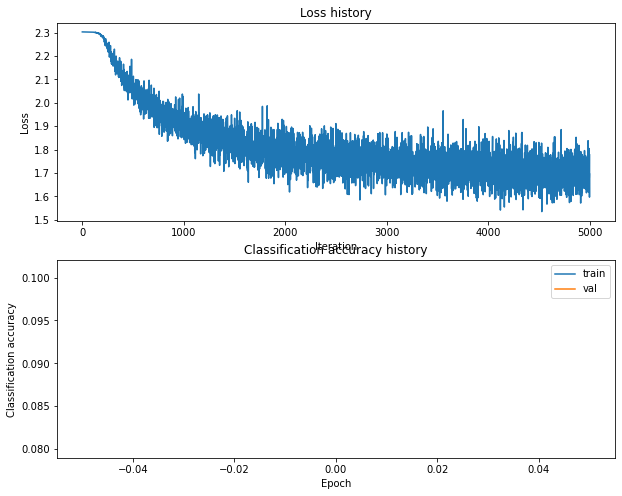

Training network with h_s 50, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.302759
iteration 100 / 5000: loss 1.998821
iteration 200 / 5000: loss 1.841367
iteration 300 / 5000: loss 1.799180
iteration 400 / 5000: loss 1.747951
iteration 500 / 5000: loss 1.733199
iteration 600 / 5000: loss 1.852882
iteration 700 / 5000: loss 1.727047
iteration 800 / 5000: loss 1.739014
iteration 900 / 5000: loss 1.715017
iteration 1000 / 5000: loss 1.720360
iteration 1100 / 5000: loss 1.775763
iteration 1200 / 5000: loss 1.755444
iteration 1300 / 5000: loss 1.681512
iteration 1400 / 5000: loss 1.723104
iteration 1500 / 5000: loss 1.678341
iteration 1600 / 5000: loss 1.590238
iteration 1700 / 5000: loss 1.620777
iteration 1800 / 5000: loss 1.668121
iteration 1900 / 5000: loss 1.640023
iteration 2000 / 5000: loss 1.654874
iteration 2100 / 5000: loss 1.742788
iteration 2200 / 5000: loss 1.770088
iteration 2300 / 5000: loss 1.792038
iteration 2400 / 5000: loss 1.655085
iteration 2500 / 5000: loss 

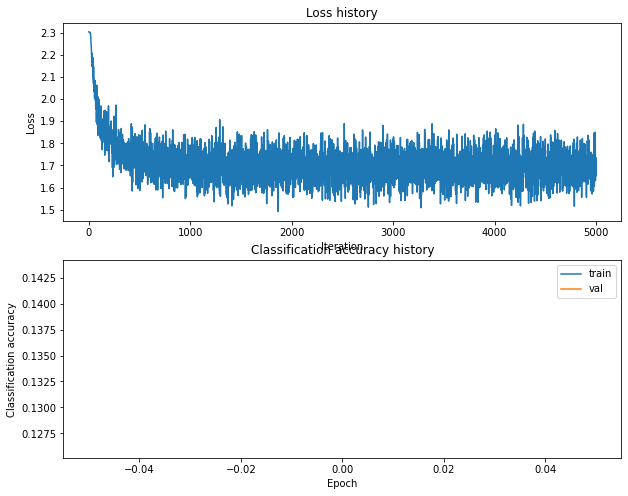

Training network with h_s 50, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.302749
iteration 100 / 5000: loss 2.301782
iteration 200 / 5000: loss 2.279728
iteration 300 / 5000: loss 2.232514
iteration 400 / 5000: loss 2.103180
iteration 500 / 5000: loss 2.083840
iteration 600 / 5000: loss 2.066248
iteration 700 / 5000: loss 2.060080
iteration 800 / 5000: loss 2.041993
iteration 900 / 5000: loss 1.979693
iteration 1000 / 5000: loss 1.942892
iteration 1100 / 5000: loss 1.957889
iteration 1200 / 5000: loss 1.901551
iteration 1300 / 5000: loss 1.898347
iteration 1400 / 5000: loss 1.898447
iteration 1500 / 5000: loss 1.899240
iteration 1600 / 5000: loss 1.915309
iteration 1700 / 5000: loss 1.854337
iteration 1800 / 5000: loss 1.938666
iteration 1900 / 5000: loss 1.830865
iteration 2000 / 5000: loss 1.908548
iteration 2100 / 5000: loss 1.816853
iteration 2200 / 5000: loss 1.862796
iteration 2300 / 5000: loss 1.841739
iteration 2400 / 5000: loss 1.891417
iteration 2500 / 5000: loss

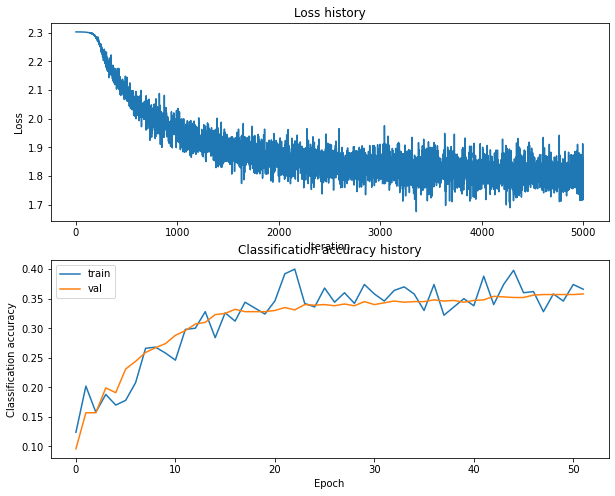

Training network with h_s 50, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.302788
iteration 100 / 5000: loss 1.900363
iteration 200 / 5000: loss 1.773455
iteration 300 / 5000: loss 1.710029
iteration 400 / 5000: loss 1.688017
iteration 500 / 5000: loss 1.730035
iteration 600 / 5000: loss 1.670215
iteration 700 / 5000: loss 1.756818
iteration 800 / 5000: loss 1.662345
iteration 900 / 5000: loss 1.774275
iteration 1000 / 5000: loss 1.659408
iteration 1100 / 5000: loss 1.695458
iteration 1200 / 5000: loss 1.594201
iteration 1300 / 5000: loss 1.683020
iteration 1400 / 5000: loss 1.737701
iteration 1500 / 5000: loss 1.672190
iteration 1600 / 5000: loss 1.623538
iteration 1700 / 5000: loss 1.620258
iteration 1800 / 5000: loss 1.597169
iteration 1900 / 5000: loss 1.703819
iteration 2000 / 5000: loss 1.624766
iteration 2100 / 5000: loss 1.663952
iteration 2200 / 5000: loss 1.669911
iteration 2300 / 5000: loss 1.668333
iteration 2400 / 5000: loss 1.701101
iteration 2500 / 5000: loss 

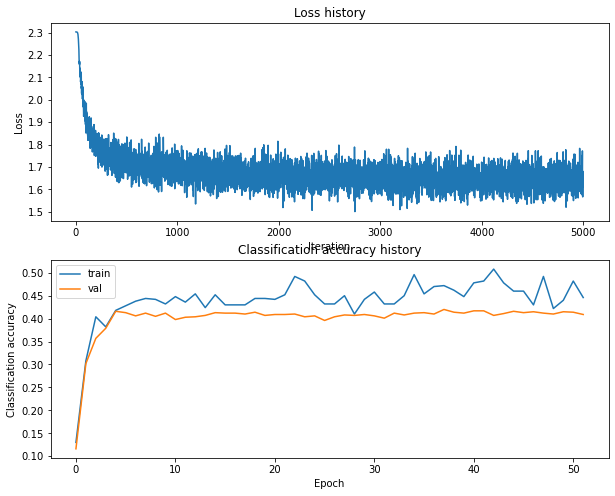

Training network with h_s 50, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.302793
iteration 100 / 10000: loss 2.301717
iteration 200 / 10000: loss 2.285832
iteration 300 / 10000: loss 2.171133
iteration 400 / 10000: loss 2.103375
iteration 500 / 10000: loss 2.059283
iteration 600 / 10000: loss 2.076416
iteration 700 / 10000: loss 1.843819
iteration 800 / 10000: loss 2.002305
iteration 900 / 10000: loss 2.016510
iteration 1000 / 10000: loss 1.982775
iteration 1100 / 10000: loss 1.873541
iteration 1200 / 10000: loss 1.954619
iteration 1300 / 10000: loss 1.862286
iteration 1400 / 10000: loss 1.896133
iteration 1500 / 10000: loss 1.814466
iteration 1600 / 10000: loss 1.792961
iteration 1700 / 10000: loss 1.691297
iteration 1800 / 10000: loss 1.783261
iteration 1900 / 10000: loss 1.895535
iteration 2000 / 10000: loss 1.726800
iteration 2100 / 10000: loss 1.780703
iteration 2200 / 10000: loss 1.591973
iteration 2300 / 10000: loss 1.934743
iteration 2400 / 10000: loss 1.617516
i

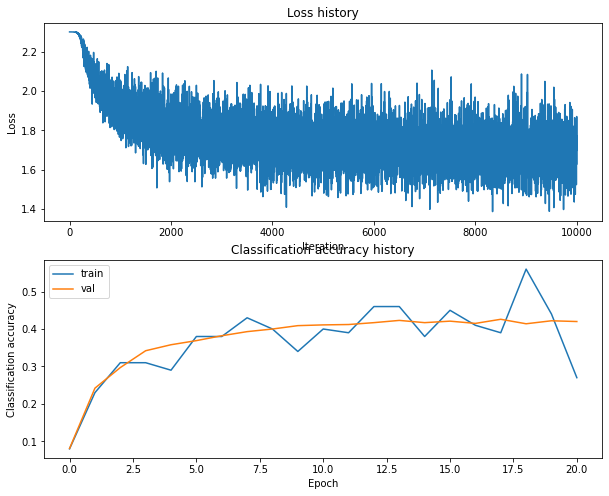

Training network with h_s 50, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.302779
iteration 100 / 10000: loss 1.823646
iteration 200 / 10000: loss 1.816999
iteration 300 / 10000: loss 1.842455
iteration 400 / 10000: loss 1.828248
iteration 500 / 10000: loss 1.598598
iteration 600 / 10000: loss 1.761059
iteration 700 / 10000: loss 1.635639
iteration 800 / 10000: loss 1.872336
iteration 900 / 10000: loss 1.813273
iteration 1000 / 10000: loss 1.725478
iteration 1100 / 10000: loss 1.709422
iteration 1200 / 10000: loss 1.580947
iteration 1300 / 10000: loss 1.718254
iteration 1400 / 10000: loss 1.552322
iteration 1500 / 10000: loss 1.784356
iteration 1600 / 10000: loss 1.597767
iteration 1700 / 10000: loss 1.737685
iteration 1800 / 10000: loss 1.705948
iteration 1900 / 10000: loss 1.592759
iteration 2000 / 10000: loss 1.854460
iteration 2100 / 10000: loss 1.801170
iteration 2200 / 10000: loss 1.773146
iteration 2300 / 10000: loss 1.792715
iteration 2400 / 10000: loss 1.685303
it

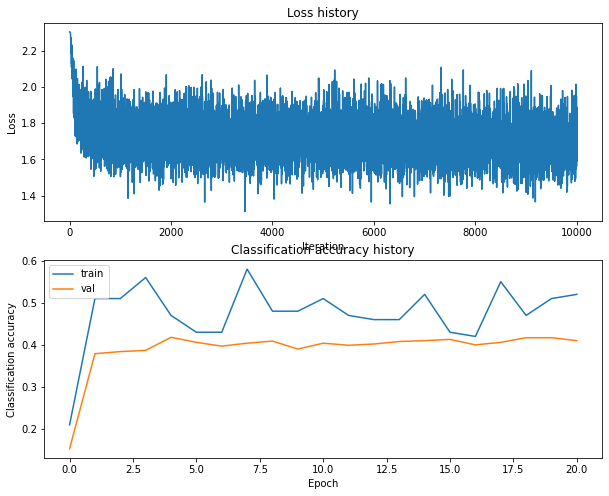

Training network with h_s 50, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.302779
iteration 100 / 10000: loss 2.301546
iteration 200 / 10000: loss 2.278183
iteration 300 / 10000: loss 2.176944
iteration 400 / 10000: loss 2.095370
iteration 500 / 10000: loss 2.034897
iteration 600 / 10000: loss 2.068774
iteration 700 / 10000: loss 2.027446
iteration 800 / 10000: loss 1.971897
iteration 900 / 10000: loss 1.894151
iteration 1000 / 10000: loss 1.874192
iteration 1100 / 10000: loss 1.872809
iteration 1200 / 10000: loss 1.866054
iteration 1300 / 10000: loss 1.970550
iteration 1400 / 10000: loss 1.990689
iteration 1500 / 10000: loss 1.834121
iteration 1600 / 10000: loss 1.856185
iteration 1700 / 10000: loss 1.871645
iteration 1800 / 10000: loss 1.819670
iteration 1900 / 10000: loss 1.867052
iteration 2000 / 10000: loss 1.728466
iteration 2100 / 10000: loss 1.847129
iteration 2200 / 10000: loss 1.743006
iteration 2300 / 10000: loss 1.826737
iteration 2400 / 10000: loss 1.717255
i

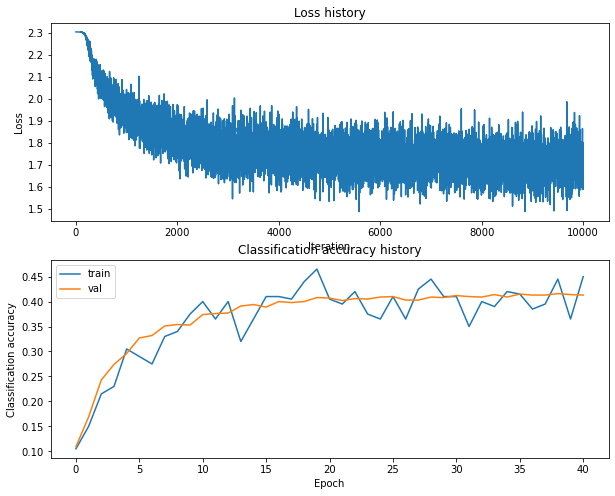

Training network with h_s 50, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.302771
iteration 100 / 10000: loss 1.887889
iteration 200 / 10000: loss 1.824804
iteration 300 / 10000: loss 1.722258
iteration 400 / 10000: loss 1.958100
iteration 500 / 10000: loss 1.685612
iteration 600 / 10000: loss 1.592886
iteration 700 / 10000: loss 1.803812
iteration 800 / 10000: loss 1.767740
iteration 900 / 10000: loss 1.731917
iteration 1000 / 10000: loss 1.639550
iteration 1100 / 10000: loss 1.780819
iteration 1200 / 10000: loss 1.715638
iteration 1300 / 10000: loss 1.568674
iteration 1400 / 10000: loss 1.781449
iteration 1500 / 10000: loss 1.696290
iteration 1600 / 10000: loss 1.670429
iteration 1700 / 10000: loss 1.608447
iteration 1800 / 10000: loss 1.640993
iteration 1900 / 10000: loss 1.692090
iteration 2000 / 10000: loss 1.680731
iteration 2100 / 10000: loss 1.695078
iteration 2200 / 10000: loss 1.697423
iteration 2300 / 10000: loss 1.697048
iteration 2400 / 10000: loss 1.715134
it

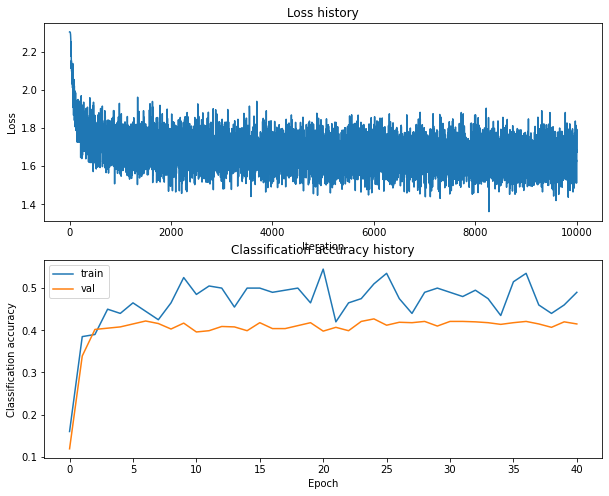

Training network with h_s 50, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.302781
iteration 100 / 10000: loss 2.301783
iteration 200 / 10000: loss 2.279827
iteration 300 / 10000: loss 2.201074
iteration 400 / 10000: loss 2.144964
iteration 500 / 10000: loss 2.103981
iteration 600 / 10000: loss 2.132835
iteration 700 / 10000: loss 2.047037
iteration 800 / 10000: loss 1.932598
iteration 900 / 10000: loss 1.963059
iteration 1000 / 10000: loss 1.948539
iteration 1100 / 10000: loss 1.861512
iteration 1200 / 10000: loss 1.968781
iteration 1300 / 10000: loss 1.843279
iteration 1400 / 10000: loss 1.807717
iteration 1500 / 10000: loss 1.883307
iteration 1600 / 10000: loss 1.967480
iteration 1700 / 10000: loss 1.858829
iteration 1800 / 10000: loss 1.741066
iteration 1900 / 10000: loss 1.848632
iteration 2000 / 10000: loss 1.788018
iteration 2100 / 10000: loss 1.821480
iteration 2200 / 10000: loss 1.839373
iteration 2300 / 10000: loss 1.775728
iteration 2400 / 10000: loss 1.813267
i

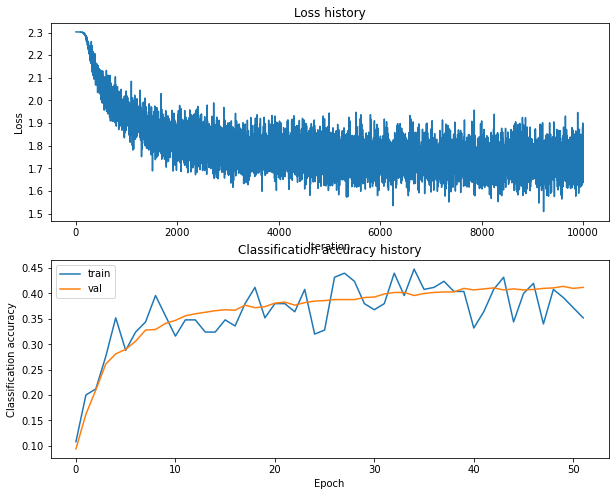

Training network with h_s 50, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.302802
iteration 100 / 10000: loss 1.866928
iteration 200 / 10000: loss 1.742787
iteration 300 / 10000: loss 1.761966
iteration 400 / 10000: loss 1.798815
iteration 500 / 10000: loss 1.598247
iteration 600 / 10000: loss 1.815296
iteration 700 / 10000: loss 1.536804
iteration 800 / 10000: loss 1.735656
iteration 900 / 10000: loss 1.765682
iteration 1000 / 10000: loss 1.668645
iteration 1100 / 10000: loss 1.766698
iteration 1200 / 10000: loss 1.695726
iteration 1300 / 10000: loss 1.621223
iteration 1400 / 10000: loss 1.745394
iteration 1500 / 10000: loss 1.786626
iteration 1600 / 10000: loss 1.695609
iteration 1700 / 10000: loss 1.609690
iteration 1800 / 10000: loss 1.740728
iteration 1900 / 10000: loss 1.617123
iteration 2000 / 10000: loss 1.707042
iteration 2100 / 10000: loss 1.669194
iteration 2200 / 10000: loss 1.715421
iteration 2300 / 10000: loss 1.629284
iteration 2400 / 10000: loss 1.633573
it

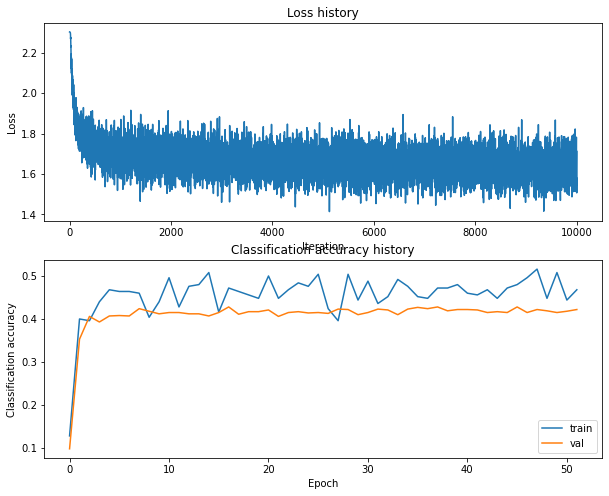

Training network with h_s 50, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.302797
iteration 100 / 10000: loss 2.301567
iteration 200 / 10000: loss 2.284595
iteration 300 / 10000: loss 2.244663
iteration 400 / 10000: loss 2.137050
iteration 500 / 10000: loss 2.097844
iteration 600 / 10000: loss 2.064109
iteration 700 / 10000: loss 2.006268
iteration 800 / 10000: loss 1.986009
iteration 900 / 10000: loss 1.917570
iteration 1000 / 10000: loss 1.875115
iteration 1100 / 10000: loss 1.873800
iteration 1200 / 10000: loss 1.883999
iteration 1300 / 10000: loss 1.836450
iteration 1400 / 10000: loss 1.965715
iteration 1500 / 10000: loss 1.784111
iteration 1600 / 10000: loss 1.848802
iteration 1700 / 10000: loss 1.750157
iteration 1800 / 10000: loss 1.792757
iteration 1900 / 10000: loss 1.844203
iteration 2000 / 10000: loss 1.666312
iteration 2100 / 10000: loss 1.828375
iteration 2200 / 10000: loss 1.805314
iteration 2300 / 10000: loss 1.808212
iteration 2400 / 10000: loss 1.741796
i

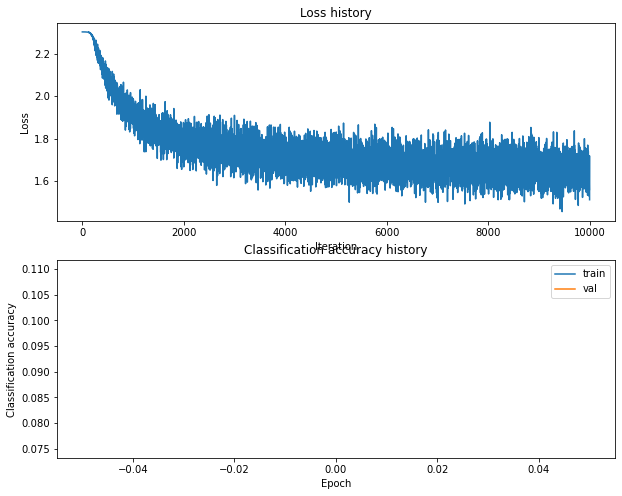

Training network with h_s 50, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.302760
iteration 100 / 10000: loss 1.942440
iteration 200 / 10000: loss 1.767033
iteration 300 / 10000: loss 1.784507
iteration 400 / 10000: loss 1.762872
iteration 500 / 10000: loss 1.681744
iteration 600 / 10000: loss 1.572755
iteration 700 / 10000: loss 1.537456
iteration 800 / 10000: loss 1.618476
iteration 900 / 10000: loss 1.729661
iteration 1000 / 10000: loss 1.681177
iteration 1100 / 10000: loss 1.748219
iteration 1200 / 10000: loss 1.670184
iteration 1300 / 10000: loss 1.718409
iteration 1400 / 10000: loss 1.760921
iteration 1500 / 10000: loss 1.717225
iteration 1600 / 10000: loss 1.743740
iteration 1700 / 10000: loss 1.646216
iteration 1800 / 10000: loss 1.589936
iteration 1900 / 10000: loss 1.742339
iteration 2000 / 10000: loss 1.731335
iteration 2100 / 10000: loss 1.800609
iteration 2200 / 10000: loss 1.775490
iteration 2300 / 10000: loss 1.713957
iteration 2400 / 10000: loss 1.742770
it

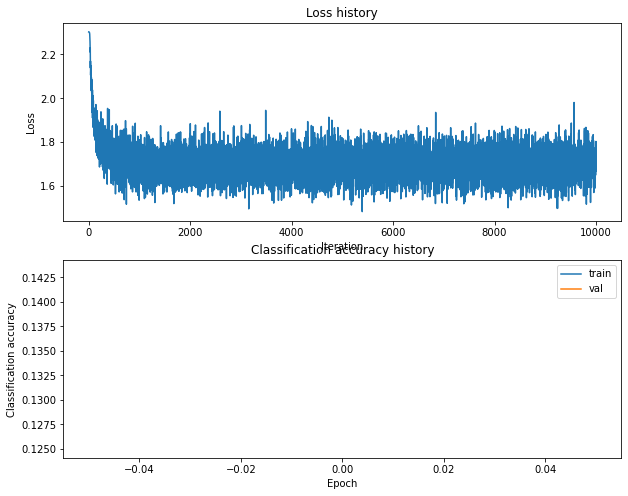

Training network with h_s 50, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.302790
iteration 100 / 10000: loss 2.301911
iteration 200 / 10000: loss 2.285628
iteration 300 / 10000: loss 2.184292
iteration 400 / 10000: loss 2.160708
iteration 500 / 10000: loss 2.094992
iteration 600 / 10000: loss 2.042383
iteration 700 / 10000: loss 2.003093
iteration 800 / 10000: loss 1.982343
iteration 900 / 10000: loss 2.031305
iteration 1000 / 10000: loss 1.955393
iteration 1100 / 10000: loss 1.913387
iteration 1200 / 10000: loss 1.875632
iteration 1300 / 10000: loss 1.909749
iteration 1400 / 10000: loss 1.892407
iteration 1500 / 10000: loss 1.853440
iteration 1600 / 10000: loss 1.882213
iteration 1700 / 10000: loss 1.824757
iteration 1800 / 10000: loss 1.882903
iteration 1900 / 10000: loss 1.876150
iteration 2000 / 10000: loss 1.883397
iteration 2100 / 10000: loss 1.830269
iteration 2200 / 10000: loss 1.858918
iteration 2300 / 10000: loss 1.852867
iteration 2400 / 10000: loss 1.814208
i

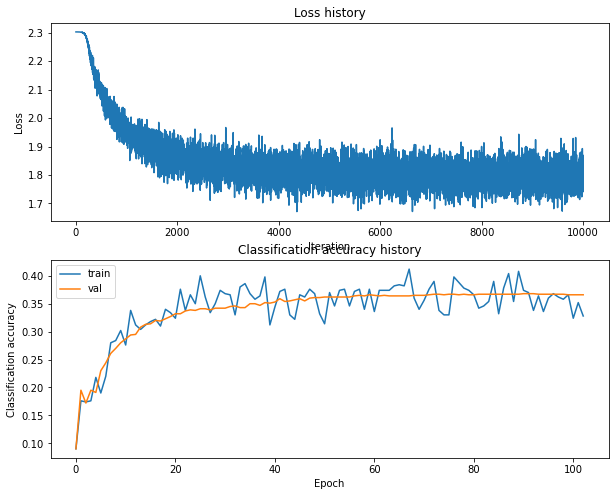

Training network with h_s 50, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.302779
iteration 100 / 10000: loss 1.945141
iteration 200 / 10000: loss 1.785830
iteration 300 / 10000: loss 1.789089
iteration 400 / 10000: loss 1.736864
iteration 500 / 10000: loss 1.705296
iteration 600 / 10000: loss 1.663617
iteration 700 / 10000: loss 1.814157
iteration 800 / 10000: loss 1.623503
iteration 900 / 10000: loss 1.730049
iteration 1000 / 10000: loss 1.664611
iteration 1100 / 10000: loss 1.624227
iteration 1200 / 10000: loss 1.650988
iteration 1300 / 10000: loss 1.730268
iteration 1400 / 10000: loss 1.753743
iteration 1500 / 10000: loss 1.657845
iteration 1600 / 10000: loss 1.640275
iteration 1700 / 10000: loss 1.645440
iteration 1800 / 10000: loss 1.635504
iteration 1900 / 10000: loss 1.679219
iteration 2000 / 10000: loss 1.661660
iteration 2100 / 10000: loss 1.674269
iteration 2200 / 10000: loss 1.673195
iteration 2300 / 10000: loss 1.724949
iteration 2400 / 10000: loss 1.688866
it

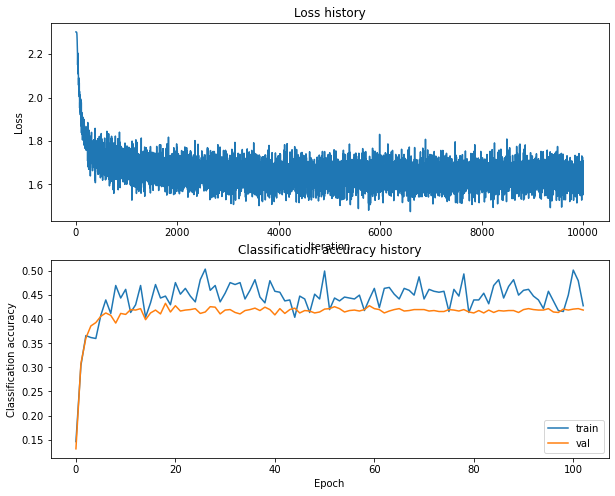

Training network with h_s 50, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.302763
iteration 100 / 15000: loss 2.302047
iteration 200 / 15000: loss 2.280711
iteration 300 / 15000: loss 2.136246
iteration 400 / 15000: loss 2.090513
iteration 500 / 15000: loss 2.113721
iteration 600 / 15000: loss 2.031556
iteration 700 / 15000: loss 2.057748
iteration 800 / 15000: loss 2.034829
iteration 900 / 15000: loss 1.957276
iteration 1000 / 15000: loss 1.848818
iteration 1100 / 15000: loss 1.913338
iteration 1200 / 15000: loss 2.016648
iteration 1300 / 15000: loss 1.814339
iteration 1400 / 15000: loss 1.813560
iteration 1500 / 15000: loss 1.746341
iteration 1600 / 15000: loss 1.858370
iteration 1700 / 15000: loss 1.883881
iteration 1800 / 15000: loss 1.713406
iteration 1900 / 15000: loss 1.723322
iteration 2000 / 15000: loss 1.969861
iteration 2100 / 15000: loss 1.642370
iteration 2200 / 15000: loss 1.771914
iteration 2300 / 15000: loss 1.774331
iteration 2400 / 15000: loss 1.720474
i

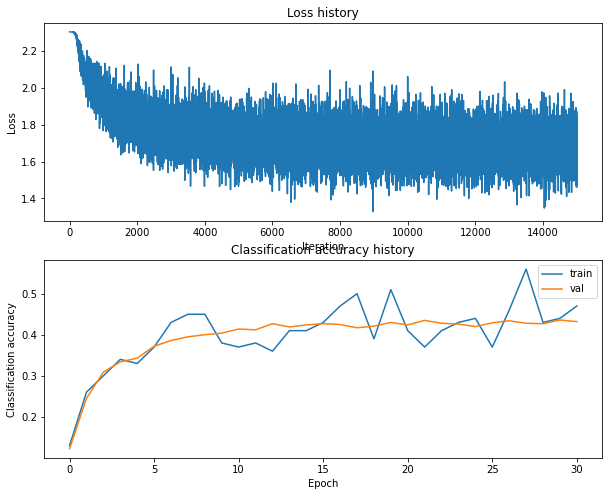

Training network with h_s 50, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.302761
iteration 100 / 15000: loss 2.030838
iteration 200 / 15000: loss 1.815884
iteration 300 / 15000: loss 2.037003
iteration 400 / 15000: loss 1.839791
iteration 500 / 15000: loss 1.866790
iteration 600 / 15000: loss 1.930551
iteration 700 / 15000: loss 1.715285
iteration 800 / 15000: loss 1.752275
iteration 900 / 15000: loss 1.801918
iteration 1000 / 15000: loss 1.816843
iteration 1100 / 15000: loss 1.793593
iteration 1200 / 15000: loss 2.046190
iteration 1300 / 15000: loss 1.860869
iteration 1400 / 15000: loss 1.854976
iteration 1500 / 15000: loss 1.669864
iteration 1600 / 15000: loss 1.823226
iteration 1700 / 15000: loss 1.658814
iteration 1800 / 15000: loss 1.611015
iteration 1900 / 15000: loss 1.634411
iteration 2000 / 15000: loss 1.648231
iteration 2100 / 15000: loss 1.659183
iteration 2200 / 15000: loss 1.776958
iteration 2300 / 15000: loss 1.764844
iteration 2400 / 15000: loss 1.521356
it

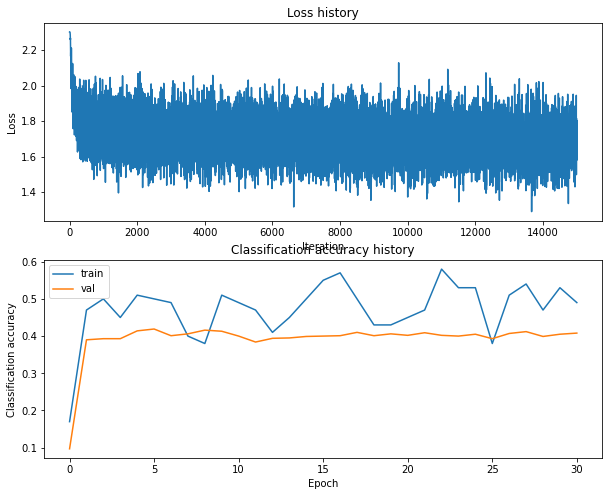

Training network with h_s 50, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.302776
iteration 100 / 15000: loss 2.301340
iteration 200 / 15000: loss 2.273183
iteration 300 / 15000: loss 2.185115
iteration 400 / 15000: loss 2.121771
iteration 500 / 15000: loss 2.093044
iteration 600 / 15000: loss 2.073584
iteration 700 / 15000: loss 2.062786
iteration 800 / 15000: loss 1.959181
iteration 900 / 15000: loss 1.976204
iteration 1000 / 15000: loss 1.940149
iteration 1100 / 15000: loss 1.881625
iteration 1200 / 15000: loss 1.941620
iteration 1300 / 15000: loss 1.863172
iteration 1400 / 15000: loss 1.847384
iteration 1500 / 15000: loss 1.839891
iteration 1600 / 15000: loss 1.845662
iteration 1700 / 15000: loss 1.857058
iteration 1800 / 15000: loss 1.861902
iteration 1900 / 15000: loss 1.834943
iteration 2000 / 15000: loss 1.804698
iteration 2100 / 15000: loss 1.800706
iteration 2200 / 15000: loss 1.774440
iteration 2300 / 15000: loss 1.812356
iteration 2400 / 15000: loss 2.000591
i

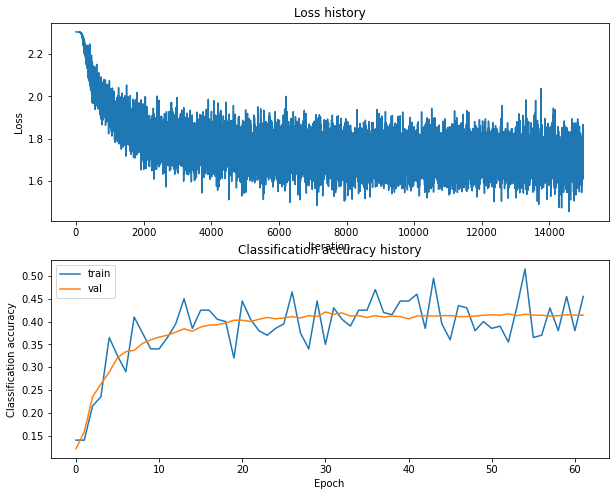

Training network with h_s 50, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.302784
iteration 100 / 15000: loss 1.956339
iteration 200 / 15000: loss 1.821651
iteration 300 / 15000: loss 1.689598
iteration 400 / 15000: loss 1.741018
iteration 500 / 15000: loss 1.741844
iteration 600 / 15000: loss 1.868711
iteration 700 / 15000: loss 1.800093
iteration 800 / 15000: loss 1.678078
iteration 900 / 15000: loss 1.769696
iteration 1000 / 15000: loss 1.700961
iteration 1100 / 15000: loss 1.768870
iteration 1200 / 15000: loss 1.742295
iteration 1300 / 15000: loss 1.633829
iteration 1400 / 15000: loss 1.686668
iteration 1500 / 15000: loss 1.694810
iteration 1600 / 15000: loss 1.661707
iteration 1700 / 15000: loss 1.772361
iteration 1800 / 15000: loss 1.654439
iteration 1900 / 15000: loss 1.654467
iteration 2000 / 15000: loss 1.817836
iteration 2100 / 15000: loss 1.741783
iteration 2200 / 15000: loss 1.648290
iteration 2300 / 15000: loss 1.718928
iteration 2400 / 15000: loss 1.743528
it

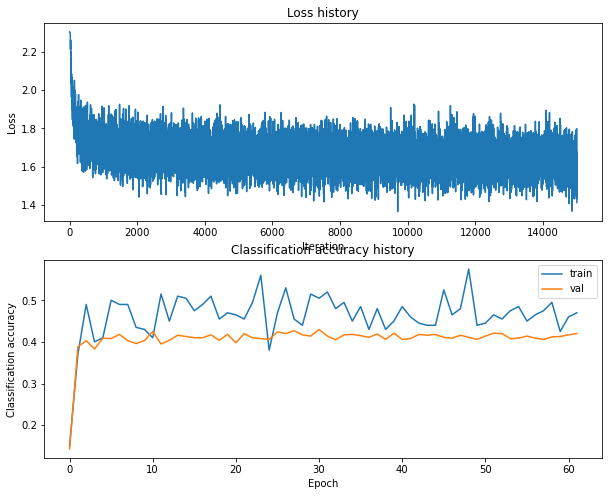

Training network with h_s 50, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.302750
iteration 100 / 15000: loss 2.301757
iteration 200 / 15000: loss 2.280988
iteration 300 / 15000: loss 2.181505
iteration 400 / 15000: loss 2.104043
iteration 500 / 15000: loss 2.065313
iteration 600 / 15000: loss 2.039318
iteration 700 / 15000: loss 2.053832
iteration 800 / 15000: loss 1.974413
iteration 900 / 15000: loss 1.990467
iteration 1000 / 15000: loss 1.916427
iteration 1100 / 15000: loss 1.921516
iteration 1200 / 15000: loss 1.915901
iteration 1300 / 15000: loss 1.902532
iteration 1400 / 15000: loss 1.900931
iteration 1500 / 15000: loss 1.846680
iteration 1600 / 15000: loss 1.806819
iteration 1700 / 15000: loss 1.841685
iteration 1800 / 15000: loss 1.832500
iteration 1900 / 15000: loss 1.824196
iteration 2000 / 15000: loss 1.881886
iteration 2100 / 15000: loss 1.796553
iteration 2200 / 15000: loss 1.783335
iteration 2300 / 15000: loss 1.885634
iteration 2400 / 15000: loss 1.893152
i

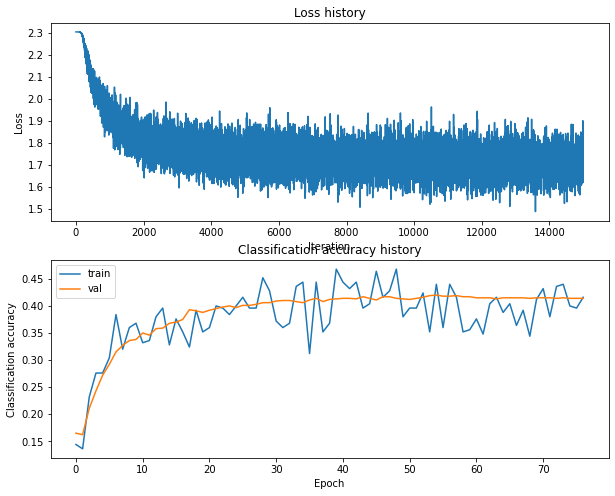

Training network with h_s 50, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.302744
iteration 100 / 15000: loss 1.878700
iteration 200 / 15000: loss 1.764381
iteration 300 / 15000: loss 1.742026
iteration 400 / 15000: loss 1.633091
iteration 500 / 15000: loss 1.740285
iteration 600 / 15000: loss 1.727621
iteration 700 / 15000: loss 1.759444
iteration 800 / 15000: loss 1.537530
iteration 900 / 15000: loss 1.679226
iteration 1000 / 15000: loss 1.660609
iteration 1100 / 15000: loss 1.787548
iteration 1200 / 15000: loss 1.680082
iteration 1300 / 15000: loss 1.722104
iteration 1400 / 15000: loss 1.716038
iteration 1500 / 15000: loss 1.665501
iteration 1600 / 15000: loss 1.767148
iteration 1700 / 15000: loss 1.659931
iteration 1800 / 15000: loss 1.629687
iteration 1900 / 15000: loss 1.796223
iteration 2000 / 15000: loss 1.727929
iteration 2100 / 15000: loss 1.678377
iteration 2200 / 15000: loss 1.695864
iteration 2300 / 15000: loss 1.721780
iteration 2400 / 15000: loss 1.794575
it

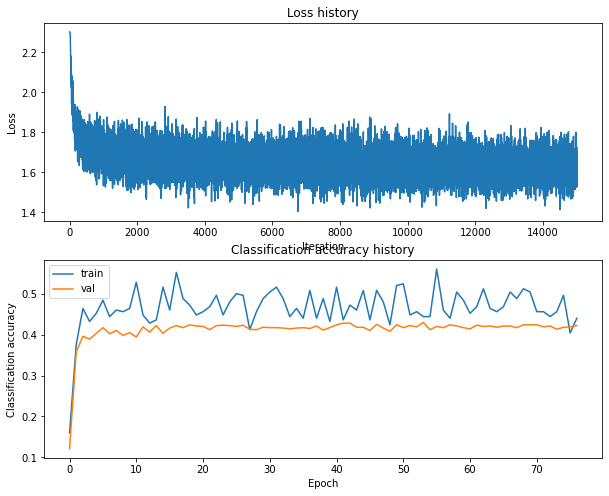

Training network with h_s 50, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.302777
iteration 100 / 15000: loss 2.301605
iteration 200 / 15000: loss 2.274406
iteration 300 / 15000: loss 2.155537
iteration 400 / 15000: loss 2.143747
iteration 500 / 15000: loss 2.087444
iteration 600 / 15000: loss 2.036332
iteration 700 / 15000: loss 1.961759
iteration 800 / 15000: loss 1.993921
iteration 900 / 15000: loss 1.897262
iteration 1000 / 15000: loss 1.943033
iteration 1100 / 15000: loss 1.817457
iteration 1200 / 15000: loss 1.944167
iteration 1300 / 15000: loss 1.825967
iteration 1400 / 15000: loss 1.861132
iteration 1500 / 15000: loss 1.811424
iteration 1600 / 15000: loss 1.845725
iteration 1700 / 15000: loss 1.796168
iteration 1800 / 15000: loss 1.707621
iteration 1900 / 15000: loss 1.793176
iteration 2000 / 15000: loss 1.751217
iteration 2100 / 15000: loss 1.856287
iteration 2200 / 15000: loss 1.766693
iteration 2300 / 15000: loss 1.740915
iteration 2400 / 15000: loss 1.833553
i

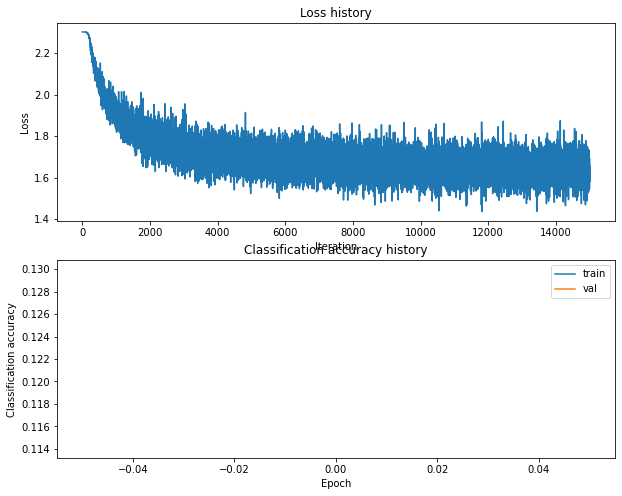

Training network with h_s 50, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.302795
iteration 100 / 15000: loss 1.924872
iteration 200 / 15000: loss 1.844228
iteration 300 / 15000: loss 1.787568
iteration 400 / 15000: loss 1.807597
iteration 500 / 15000: loss 1.650395
iteration 600 / 15000: loss 1.711690
iteration 700 / 15000: loss 1.721339
iteration 800 / 15000: loss 1.712906
iteration 900 / 15000: loss 1.732065
iteration 1000 / 15000: loss 1.819514
iteration 1100 / 15000: loss 1.712204
iteration 1200 / 15000: loss 1.789450
iteration 1300 / 15000: loss 1.713779
iteration 1400 / 15000: loss 1.673427
iteration 1500 / 15000: loss 1.720429
iteration 1600 / 15000: loss 1.643874
iteration 1700 / 15000: loss 1.705980
iteration 1800 / 15000: loss 1.806671
iteration 1900 / 15000: loss 1.741016
iteration 2000 / 15000: loss 1.655506
iteration 2100 / 15000: loss 1.674630
iteration 2200 / 15000: loss 1.660391
iteration 2300 / 15000: loss 1.783345
iteration 2400 / 15000: loss 1.688572
it

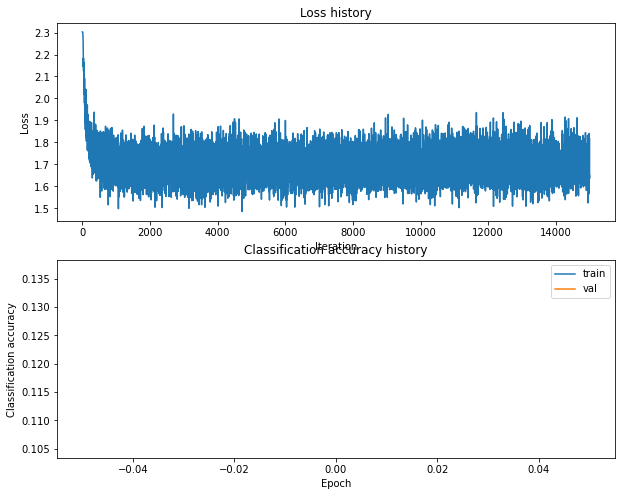

Training network with h_s 50, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.302771
iteration 100 / 15000: loss 2.301465
iteration 200 / 15000: loss 2.279239
iteration 300 / 15000: loss 2.218866
iteration 400 / 15000: loss 2.110304
iteration 500 / 15000: loss 2.131199
iteration 600 / 15000: loss 2.052333
iteration 700 / 15000: loss 2.027986
iteration 800 / 15000: loss 1.995330
iteration 900 / 15000: loss 1.980896
iteration 1000 / 15000: loss 1.938214
iteration 1100 / 15000: loss 1.993014
iteration 1200 / 15000: loss 1.940614
iteration 1300 / 15000: loss 1.906292
iteration 1400 / 15000: loss 1.896848
iteration 1500 / 15000: loss 1.875425
iteration 1600 / 15000: loss 1.865503
iteration 1700 / 15000: loss 1.935237
iteration 1800 / 15000: loss 1.914453
iteration 1900 / 15000: loss 1.910428
iteration 2000 / 15000: loss 1.851157
iteration 2100 / 15000: loss 1.865854
iteration 2200 / 15000: loss 1.877217
iteration 2300 / 15000: loss 1.895632
iteration 2400 / 15000: loss 1.884563
i

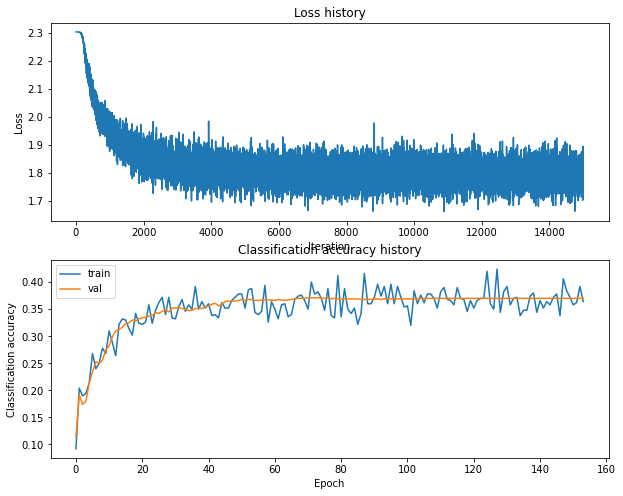

Training network with h_s 50, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.302782
iteration 100 / 15000: loss 1.977775
iteration 200 / 15000: loss 1.800726
iteration 300 / 15000: loss 1.828806
iteration 400 / 15000: loss 1.728098
iteration 500 / 15000: loss 1.749416
iteration 600 / 15000: loss 1.654127
iteration 700 / 15000: loss 1.671777
iteration 800 / 15000: loss 1.689340
iteration 900 / 15000: loss 1.710283
iteration 1000 / 15000: loss 1.695491
iteration 1100 / 15000: loss 1.683493
iteration 1200 / 15000: loss 1.745289
iteration 1300 / 15000: loss 1.642055
iteration 1400 / 15000: loss 1.681007
iteration 1500 / 15000: loss 1.724598
iteration 1600 / 15000: loss 1.641817
iteration 1700 / 15000: loss 1.597277
iteration 1800 / 15000: loss 1.644191
iteration 1900 / 15000: loss 1.596176
iteration 2000 / 15000: loss 1.638544
iteration 2100 / 15000: loss 1.635898
iteration 2200 / 15000: loss 1.601652
iteration 2300 / 15000: loss 1.671354
iteration 2400 / 15000: loss 1.611290
it

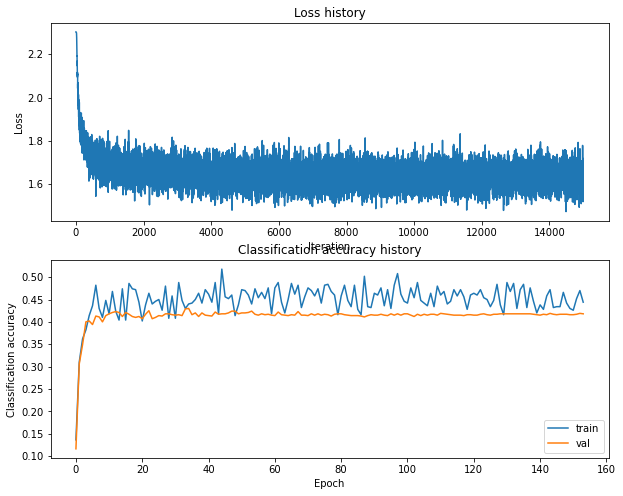

Training network with h_s 50, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.302796
iteration 100 / 20000: loss 2.301828
iteration 200 / 20000: loss 2.291948
iteration 300 / 20000: loss 2.212812
iteration 400 / 20000: loss 2.150766
iteration 500 / 20000: loss 2.090663
iteration 600 / 20000: loss 1.963435
iteration 700 / 20000: loss 2.157597
iteration 800 / 20000: loss 1.991958
iteration 900 / 20000: loss 1.926187
iteration 1000 / 20000: loss 1.935638
iteration 1100 / 20000: loss 1.931618
iteration 1200 / 20000: loss 1.938895
iteration 1300 / 20000: loss 1.953101
iteration 1400 / 20000: loss 1.894552
iteration 1500 / 20000: loss 1.970060
iteration 1600 / 20000: loss 1.790128
iteration 1700 / 20000: loss 1.963286
iteration 1800 / 20000: loss 1.905344
iteration 1900 / 20000: loss 1.849980
iteration 2000 / 20000: loss 1.790455
iteration 2100 / 20000: loss 1.655630
iteration 2200 / 20000: loss 1.866645
iteration 2300 / 20000: loss 1.845241
iteration 2400 / 20000: loss 1.855785
i

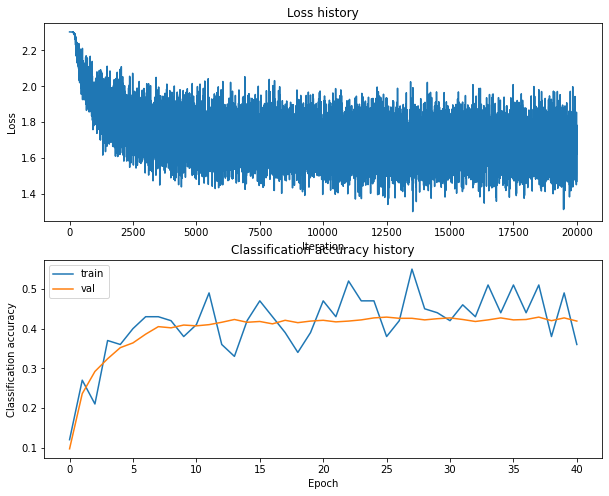

Training network with h_s 50, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.302779
iteration 100 / 20000: loss 1.911459
iteration 200 / 20000: loss 1.808564
iteration 300 / 20000: loss 1.740373
iteration 400 / 20000: loss 1.621084
iteration 500 / 20000: loss 1.768273
iteration 600 / 20000: loss 1.897507
iteration 700 / 20000: loss 1.748399
iteration 800 / 20000: loss 1.937114
iteration 900 / 20000: loss 1.857877
iteration 1000 / 20000: loss 1.791319
iteration 1100 / 20000: loss 1.653241
iteration 1200 / 20000: loss 1.759656
iteration 1300 / 20000: loss 1.844824
iteration 1400 / 20000: loss 1.565703
iteration 1500 / 20000: loss 1.835186
iteration 1600 / 20000: loss 1.595288
iteration 1700 / 20000: loss 1.557460
iteration 1800 / 20000: loss 1.679508
iteration 1900 / 20000: loss 1.716430
iteration 2000 / 20000: loss 1.792927
iteration 2100 / 20000: loss 1.590401
iteration 2200 / 20000: loss 1.458609
iteration 2300 / 20000: loss 1.874302
iteration 2400 / 20000: loss 1.665450
it

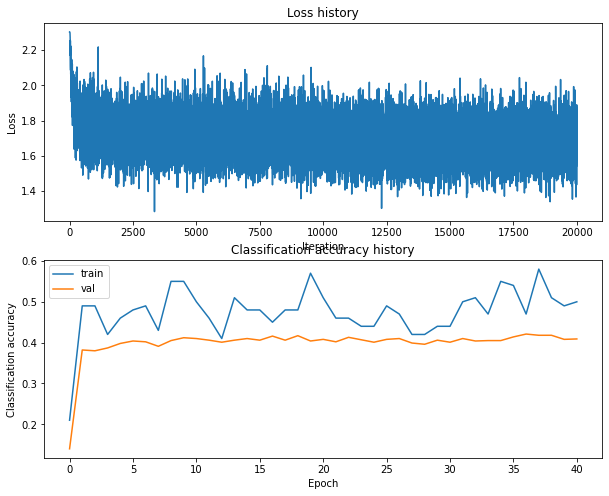

Training network with h_s 50, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.302773
iteration 100 / 20000: loss 2.302028
iteration 200 / 20000: loss 2.282571
iteration 300 / 20000: loss 2.133316
iteration 400 / 20000: loss 2.108732
iteration 500 / 20000: loss 2.138052
iteration 600 / 20000: loss 2.047954
iteration 700 / 20000: loss 1.928906
iteration 800 / 20000: loss 1.958080
iteration 900 / 20000: loss 1.951560
iteration 1000 / 20000: loss 1.886559
iteration 1100 / 20000: loss 1.863288
iteration 1200 / 20000: loss 1.930538
iteration 1300 / 20000: loss 1.900090
iteration 1400 / 20000: loss 1.832361
iteration 1500 / 20000: loss 1.790143
iteration 1600 / 20000: loss 1.814882
iteration 1700 / 20000: loss 1.776740
iteration 1800 / 20000: loss 1.722353
iteration 1900 / 20000: loss 1.877856
iteration 2000 / 20000: loss 1.906382
iteration 2100 / 20000: loss 1.794055
iteration 2200 / 20000: loss 1.864685
iteration 2300 / 20000: loss 1.764055
iteration 2400 / 20000: loss 1.759776
i

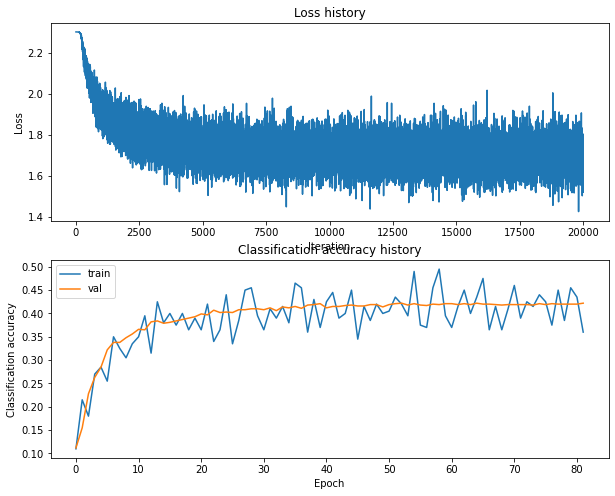

Training network with h_s 50, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.302778
iteration 100 / 20000: loss 1.902414
iteration 200 / 20000: loss 1.880583
iteration 300 / 20000: loss 1.766467
iteration 400 / 20000: loss 1.766348
iteration 500 / 20000: loss 1.824660
iteration 600 / 20000: loss 1.741065
iteration 700 / 20000: loss 1.871490
iteration 800 / 20000: loss 1.654769
iteration 900 / 20000: loss 1.629339
iteration 1000 / 20000: loss 1.621160
iteration 1100 / 20000: loss 1.731331
iteration 1200 / 20000: loss 1.652584
iteration 1300 / 20000: loss 1.611422
iteration 1400 / 20000: loss 1.657195
iteration 1500 / 20000: loss 1.595388
iteration 1600 / 20000: loss 1.650013
iteration 1700 / 20000: loss 1.639920
iteration 1800 / 20000: loss 1.628007
iteration 1900 / 20000: loss 1.767718
iteration 2000 / 20000: loss 1.765201
iteration 2100 / 20000: loss 1.752474
iteration 2200 / 20000: loss 1.587146
iteration 2300 / 20000: loss 1.886572
iteration 2400 / 20000: loss 1.802546
it

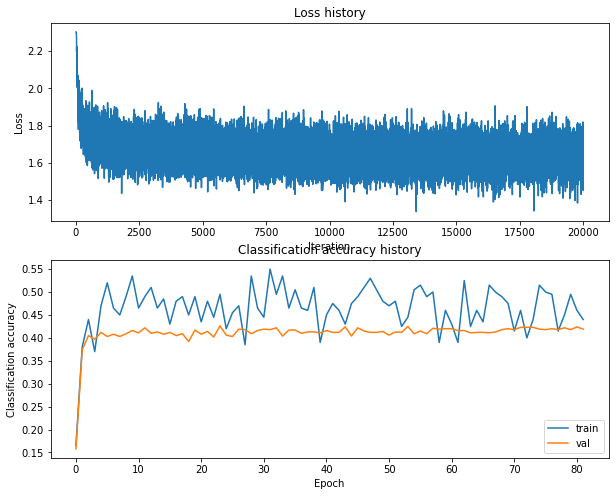

Training network with h_s 50, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.302783
iteration 100 / 20000: loss 2.301528
iteration 200 / 20000: loss 2.267212
iteration 300 / 20000: loss 2.185944
iteration 400 / 20000: loss 2.112831
iteration 500 / 20000: loss 2.082114
iteration 600 / 20000: loss 2.134091
iteration 700 / 20000: loss 2.028229
iteration 800 / 20000: loss 2.082072
iteration 900 / 20000: loss 2.018091
iteration 1000 / 20000: loss 1.938702
iteration 1100 / 20000: loss 1.945493
iteration 1200 / 20000: loss 1.950286
iteration 1300 / 20000: loss 1.918499
iteration 1400 / 20000: loss 1.875655
iteration 1500 / 20000: loss 1.850229
iteration 1600 / 20000: loss 1.885305
iteration 1700 / 20000: loss 1.886501
iteration 1800 / 20000: loss 1.761062
iteration 1900 / 20000: loss 1.835799
iteration 2000 / 20000: loss 1.802767
iteration 2100 / 20000: loss 1.810955
iteration 2200 / 20000: loss 1.856192
iteration 2300 / 20000: loss 1.784522
iteration 2400 / 20000: loss 1.766858
i

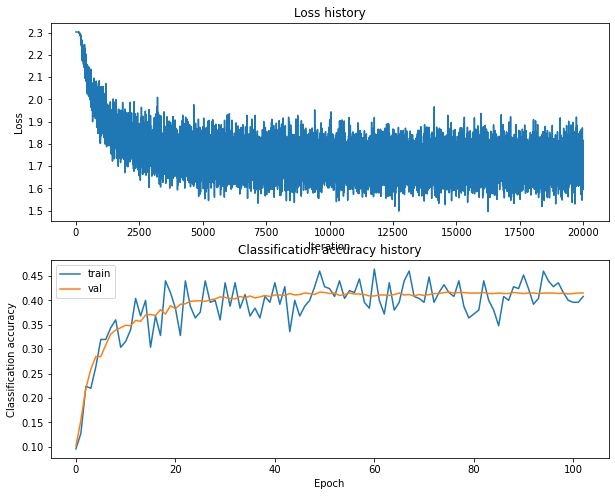

Training network with h_s 50, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.302774
iteration 100 / 20000: loss 1.844634
iteration 200 / 20000: loss 1.800894
iteration 300 / 20000: loss 1.737309
iteration 400 / 20000: loss 1.834554
iteration 500 / 20000: loss 1.809395
iteration 600 / 20000: loss 1.819735
iteration 700 / 20000: loss 1.701993
iteration 800 / 20000: loss 1.694745
iteration 900 / 20000: loss 1.740376
iteration 1000 / 20000: loss 1.767467
iteration 1100 / 20000: loss 1.808226
iteration 1200 / 20000: loss 1.793062
iteration 1300 / 20000: loss 1.704948
iteration 1400 / 20000: loss 1.626984
iteration 1500 / 20000: loss 1.700290
iteration 1600 / 20000: loss 1.689768
iteration 1700 / 20000: loss 1.705886
iteration 1800 / 20000: loss 1.669828
iteration 1900 / 20000: loss 1.730925
iteration 2000 / 20000: loss 1.838867
iteration 2100 / 20000: loss 1.610292
iteration 2200 / 20000: loss 1.706679
iteration 2300 / 20000: loss 1.737292
iteration 2400 / 20000: loss 1.747633
it

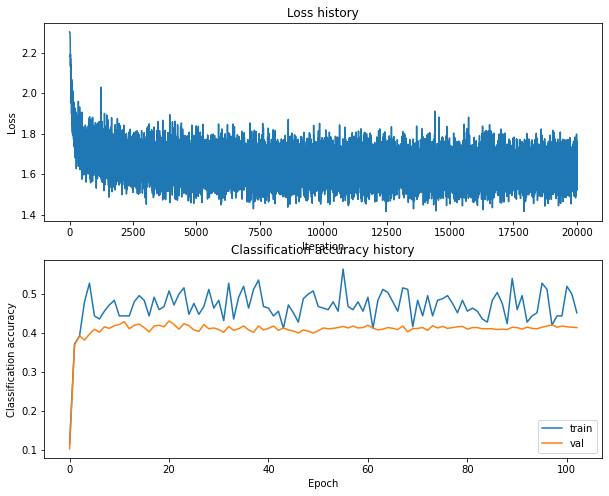

Training network with h_s 50, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.302777
iteration 100 / 20000: loss 2.301950
iteration 200 / 20000: loss 2.279399
iteration 300 / 20000: loss 2.198806
iteration 400 / 20000: loss 2.190245
iteration 500 / 20000: loss 2.044536
iteration 600 / 20000: loss 1.988619
iteration 700 / 20000: loss 1.993418
iteration 800 / 20000: loss 1.998637
iteration 900 / 20000: loss 1.980274
iteration 1000 / 20000: loss 1.961205
iteration 1100 / 20000: loss 1.901375
iteration 1200 / 20000: loss 1.934746
iteration 1300 / 20000: loss 1.867614
iteration 1400 / 20000: loss 1.873329
iteration 1500 / 20000: loss 1.901311
iteration 1600 / 20000: loss 1.865080
iteration 1700 / 20000: loss 1.798773
iteration 1800 / 20000: loss 1.757405
iteration 1900 / 20000: loss 1.714844
iteration 2000 / 20000: loss 1.800561
iteration 2100 / 20000: loss 1.744753
iteration 2200 / 20000: loss 1.730275
iteration 2300 / 20000: loss 1.799622
iteration 2400 / 20000: loss 1.764818
i

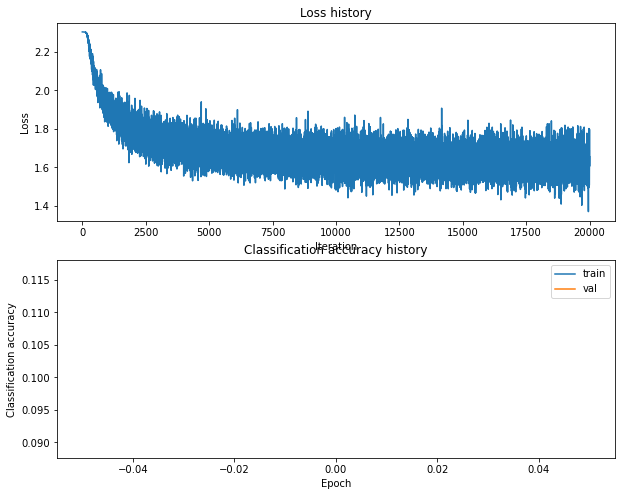

Training network with h_s 50, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.302790
iteration 100 / 20000: loss 1.863435
iteration 200 / 20000: loss 1.849566
iteration 300 / 20000: loss 1.840824
iteration 400 / 20000: loss 1.757691
iteration 500 / 20000: loss 1.691483
iteration 600 / 20000: loss 1.677728
iteration 700 / 20000: loss 1.775478
iteration 800 / 20000: loss 1.668060
iteration 900 / 20000: loss 1.704878
iteration 1000 / 20000: loss 1.719821
iteration 1100 / 20000: loss 1.722225
iteration 1200 / 20000: loss 1.550301
iteration 1300 / 20000: loss 1.730439
iteration 1400 / 20000: loss 1.792034
iteration 1500 / 20000: loss 1.610293
iteration 1600 / 20000: loss 1.777183
iteration 1700 / 20000: loss 1.741238
iteration 1800 / 20000: loss 1.751317
iteration 1900 / 20000: loss 1.651618
iteration 2000 / 20000: loss 1.658049
iteration 2100 / 20000: loss 1.630573
iteration 2200 / 20000: loss 1.781616
iteration 2300 / 20000: loss 1.715256
iteration 2400 / 20000: loss 1.800351
it

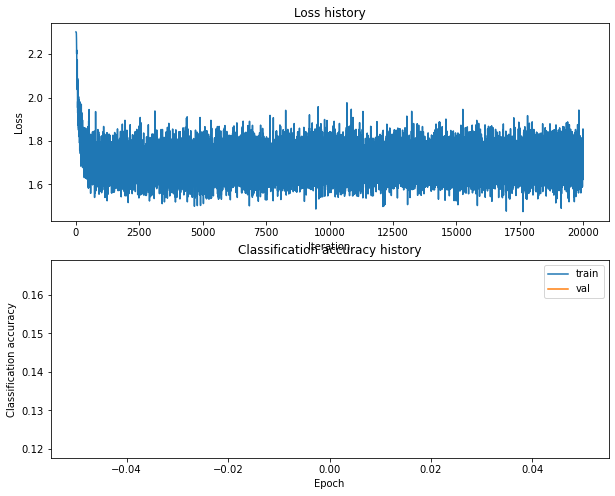

Training network with h_s 50, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.302775
iteration 100 / 20000: loss 2.301427
iteration 200 / 20000: loss 2.278798
iteration 300 / 20000: loss 2.175964
iteration 400 / 20000: loss 2.119042
iteration 500 / 20000: loss 2.091360
iteration 600 / 20000: loss 2.062922
iteration 700 / 20000: loss 2.026759
iteration 800 / 20000: loss 2.025754
iteration 900 / 20000: loss 1.993540
iteration 1000 / 20000: loss 1.984890
iteration 1100 / 20000: loss 2.000245
iteration 1200 / 20000: loss 1.926677
iteration 1300 / 20000: loss 1.944570
iteration 1400 / 20000: loss 1.937628
iteration 1500 / 20000: loss 1.905183
iteration 1600 / 20000: loss 1.821156
iteration 1700 / 20000: loss 1.891304
iteration 1800 / 20000: loss 1.887345
iteration 1900 / 20000: loss 1.896787
iteration 2000 / 20000: loss 1.868173
iteration 2100 / 20000: loss 1.860082
iteration 2200 / 20000: loss 1.856254
iteration 2300 / 20000: loss 1.841209
iteration 2400 / 20000: loss 1.866824
i

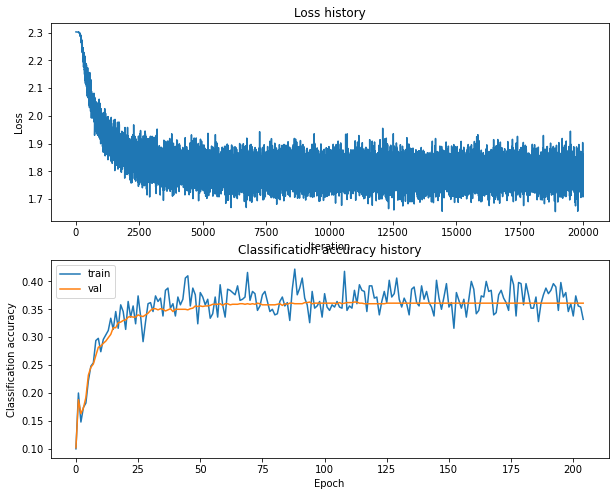

Training network with h_s 50, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.302774
iteration 100 / 20000: loss 1.942429
iteration 200 / 20000: loss 1.815154
iteration 300 / 20000: loss 1.777358
iteration 400 / 20000: loss 1.766868
iteration 500 / 20000: loss 1.689587
iteration 600 / 20000: loss 1.717804
iteration 700 / 20000: loss 1.737313
iteration 800 / 20000: loss 1.710279
iteration 900 / 20000: loss 1.743687
iteration 1000 / 20000: loss 1.640140
iteration 1100 / 20000: loss 1.607185
iteration 1200 / 20000: loss 1.661229
iteration 1300 / 20000: loss 1.754848
iteration 1400 / 20000: loss 1.664593
iteration 1500 / 20000: loss 1.616995
iteration 1600 / 20000: loss 1.657433
iteration 1700 / 20000: loss 1.683473
iteration 1800 / 20000: loss 1.712392
iteration 1900 / 20000: loss 1.636114
iteration 2000 / 20000: loss 1.607979
iteration 2100 / 20000: loss 1.643392
iteration 2200 / 20000: loss 1.673226
iteration 2300 / 20000: loss 1.636283
iteration 2400 / 20000: loss 1.679699
it

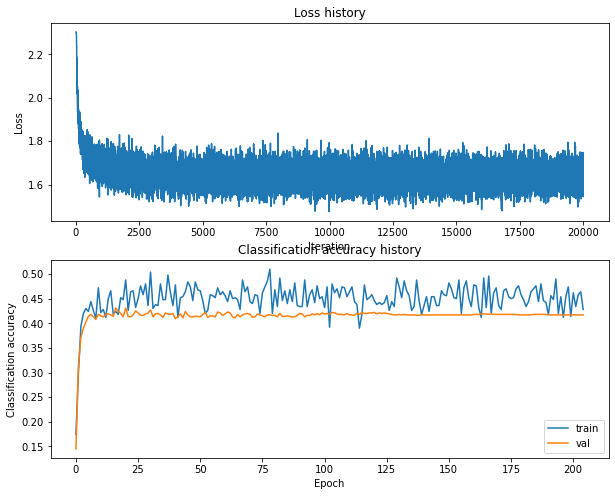

Training network with h_s 50, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.302810
iteration 100 / 25000: loss 2.301772
iteration 200 / 25000: loss 2.278710
iteration 300 / 25000: loss 2.186850
iteration 400 / 25000: loss 2.129098
iteration 500 / 25000: loss 2.030735
iteration 600 / 25000: loss 2.028114
iteration 700 / 25000: loss 1.937702
iteration 800 / 25000: loss 1.947152
iteration 900 / 25000: loss 1.908982
iteration 1000 / 25000: loss 1.821791
iteration 1100 / 25000: loss 1.961891
iteration 1200 / 25000: loss 2.034616
iteration 1300 / 25000: loss 1.900495
iteration 1400 / 25000: loss 2.047143
iteration 1500 / 25000: loss 1.754239
iteration 1600 / 25000: loss 1.865346
iteration 1700 / 25000: loss 1.737919
iteration 1800 / 25000: loss 1.907980
iteration 1900 / 25000: loss 1.738489
iteration 2000 / 25000: loss 1.750531
iteration 2100 / 25000: loss 1.766907
iteration 2200 / 25000: loss 1.919813
iteration 2300 / 25000: loss 1.680164
iteration 2400 / 25000: loss 1.736743
i

iteration 21200 / 25000: loss 1.656487
iteration 21300 / 25000: loss 1.584546
iteration 21400 / 25000: loss 1.549915
iteration 21500 / 25000: loss 1.752283
iteration 21600 / 25000: loss 1.617956
iteration 21700 / 25000: loss 1.534761
iteration 21800 / 25000: loss 1.719374
iteration 21900 / 25000: loss 1.907868
iteration 22000 / 25000: loss 1.689343
iteration 22100 / 25000: loss 1.578093
iteration 22200 / 25000: loss 1.681514
iteration 22300 / 25000: loss 1.585926
iteration 22400 / 25000: loss 1.609516
iteration 22500 / 25000: loss 1.601096
iteration 22600 / 25000: loss 1.812275
iteration 22700 / 25000: loss 1.647130
iteration 22800 / 25000: loss 1.949090
iteration 22900 / 25000: loss 1.682227
iteration 23000 / 25000: loss 1.555642
iteration 23100 / 25000: loss 1.568838
iteration 23200 / 25000: loss 1.725756
iteration 23300 / 25000: loss 1.580073
iteration 23400 / 25000: loss 1.556073
iteration 23500 / 25000: loss 1.569829
iteration 23600 / 25000: loss 1.724729
iteration 23700 / 25000: 

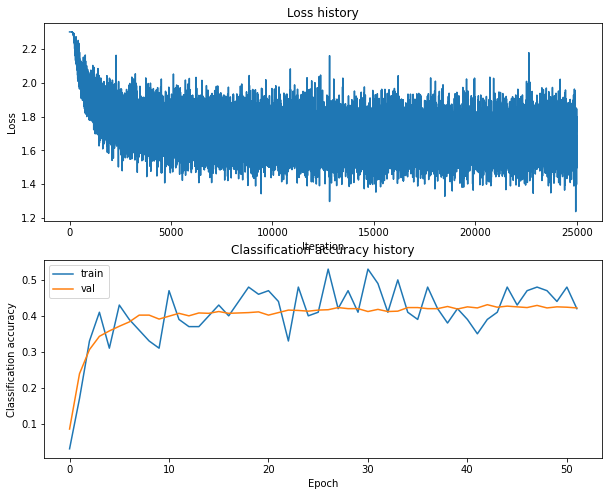

Training network with h_s 50, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.302792
iteration 100 / 25000: loss 2.127363
iteration 200 / 25000: loss 1.963530
iteration 300 / 25000: loss 1.841890
iteration 400 / 25000: loss 1.736220
iteration 500 / 25000: loss 1.803563
iteration 600 / 25000: loss 1.733007
iteration 700 / 25000: loss 1.840672
iteration 800 / 25000: loss 1.768481
iteration 900 / 25000: loss 1.708099
iteration 1000 / 25000: loss 1.850886
iteration 1100 / 25000: loss 1.872287
iteration 1200 / 25000: loss 1.732800
iteration 1300 / 25000: loss 1.773658
iteration 1400 / 25000: loss 1.703207
iteration 1500 / 25000: loss 1.650698
iteration 1600 / 25000: loss 1.633252
iteration 1700 / 25000: loss 1.669010
iteration 1800 / 25000: loss 1.796421
iteration 1900 / 25000: loss 1.712098
iteration 2000 / 25000: loss 1.653652
iteration 2100 / 25000: loss 1.798096
iteration 2200 / 25000: loss 1.726451
iteration 2300 / 25000: loss 1.610050
iteration 2400 / 25000: loss 1.777036
it

iteration 21200 / 25000: loss 1.623473
iteration 21300 / 25000: loss 1.566792
iteration 21400 / 25000: loss 1.581928
iteration 21500 / 25000: loss 1.504154
iteration 21600 / 25000: loss 1.644599
iteration 21700 / 25000: loss 1.771186
iteration 21800 / 25000: loss 1.649881
iteration 21900 / 25000: loss 1.691322
iteration 22000 / 25000: loss 1.797384
iteration 22100 / 25000: loss 1.755112
iteration 22200 / 25000: loss 1.562767
iteration 22300 / 25000: loss 1.705561
iteration 22400 / 25000: loss 1.812370
iteration 22500 / 25000: loss 1.694066
iteration 22600 / 25000: loss 1.609512
iteration 22700 / 25000: loss 1.562738
iteration 22800 / 25000: loss 1.455894
iteration 22900 / 25000: loss 1.537380
iteration 23000 / 25000: loss 1.565119
iteration 23100 / 25000: loss 1.662264
iteration 23200 / 25000: loss 1.625451
iteration 23300 / 25000: loss 1.553270
iteration 23400 / 25000: loss 1.565153
iteration 23500 / 25000: loss 1.718362
iteration 23600 / 25000: loss 1.736714
iteration 23700 / 25000: 

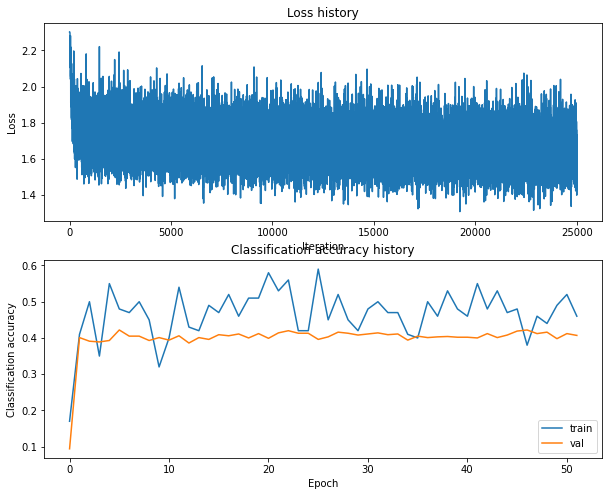

Training network with h_s 50, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.302789
iteration 100 / 25000: loss 2.301591
iteration 200 / 25000: loss 2.282592
iteration 300 / 25000: loss 2.196763
iteration 400 / 25000: loss 2.143332
iteration 500 / 25000: loss 2.048004
iteration 600 / 25000: loss 1.985747
iteration 700 / 25000: loss 1.980166
iteration 800 / 25000: loss 1.939657
iteration 900 / 25000: loss 1.948528
iteration 1000 / 25000: loss 1.835625
iteration 1100 / 25000: loss 1.942738
iteration 1200 / 25000: loss 1.819752
iteration 1300 / 25000: loss 1.853345
iteration 1400 / 25000: loss 1.813605
iteration 1500 / 25000: loss 1.883949
iteration 1600 / 25000: loss 1.787873
iteration 1700 / 25000: loss 1.775730
iteration 1800 / 25000: loss 1.749662
iteration 1900 / 25000: loss 1.789466
iteration 2000 / 25000: loss 1.777231
iteration 2100 / 25000: loss 1.684979
iteration 2200 / 25000: loss 1.861186
iteration 2300 / 25000: loss 1.775966
iteration 2400 / 25000: loss 1.622504
i

iteration 21200 / 25000: loss 1.696922
iteration 21300 / 25000: loss 1.790884
iteration 21400 / 25000: loss 1.729859
iteration 21500 / 25000: loss 1.650728
iteration 21600 / 25000: loss 1.759676
iteration 21700 / 25000: loss 1.755784
iteration 21800 / 25000: loss 1.656859
iteration 21900 / 25000: loss 1.636124
iteration 22000 / 25000: loss 1.622369
iteration 22100 / 25000: loss 1.798623
iteration 22200 / 25000: loss 1.724868
iteration 22300 / 25000: loss 1.717904
iteration 22400 / 25000: loss 1.733718
iteration 22500 / 25000: loss 1.789805
iteration 22600 / 25000: loss 1.795185
iteration 22700 / 25000: loss 1.762839
iteration 22800 / 25000: loss 1.702885
iteration 22900 / 25000: loss 1.796774
iteration 23000 / 25000: loss 1.610442
iteration 23100 / 25000: loss 1.705576
iteration 23200 / 25000: loss 1.702480
iteration 23300 / 25000: loss 1.741418
iteration 23400 / 25000: loss 1.619903
iteration 23500 / 25000: loss 1.707459
iteration 23600 / 25000: loss 1.684767
iteration 23700 / 25000: 

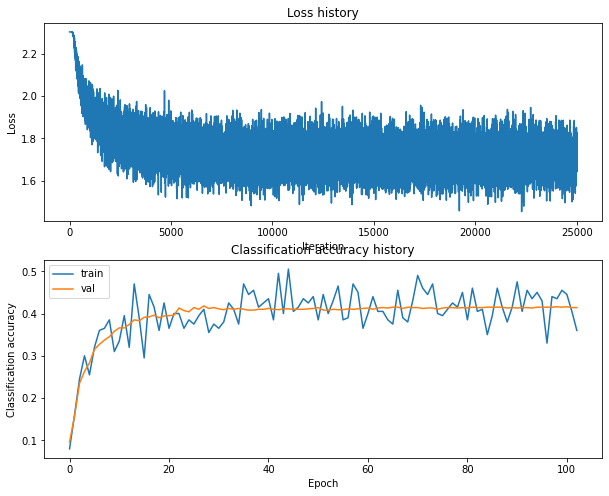

Training network with h_s 50, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.302759
iteration 100 / 25000: loss 1.921810
iteration 200 / 25000: loss 1.776090
iteration 300 / 25000: loss 1.722422
iteration 400 / 25000: loss 1.720800
iteration 500 / 25000: loss 1.762030
iteration 600 / 25000: loss 1.810189
iteration 700 / 25000: loss 1.724591
iteration 800 / 25000: loss 1.709066
iteration 900 / 25000: loss 1.793516
iteration 1000 / 25000: loss 1.635582
iteration 1100 / 25000: loss 1.688008
iteration 1200 / 25000: loss 1.778201
iteration 1300 / 25000: loss 1.857901
iteration 1400 / 25000: loss 1.770889
iteration 1500 / 25000: loss 1.864669
iteration 1600 / 25000: loss 1.616298
iteration 1700 / 25000: loss 1.725381
iteration 1800 / 25000: loss 1.672223
iteration 1900 / 25000: loss 1.703495
iteration 2000 / 25000: loss 1.701662
iteration 2100 / 25000: loss 1.806294
iteration 2200 / 25000: loss 1.821083
iteration 2300 / 25000: loss 1.670181
iteration 2400 / 25000: loss 1.718980
it

iteration 21200 / 25000: loss 1.717749
iteration 21300 / 25000: loss 1.695937
iteration 21400 / 25000: loss 1.510378
iteration 21500 / 25000: loss 1.670572
iteration 21600 / 25000: loss 1.567501
iteration 21700 / 25000: loss 1.671191
iteration 21800 / 25000: loss 1.704018
iteration 21900 / 25000: loss 1.533763
iteration 22000 / 25000: loss 1.525753
iteration 22100 / 25000: loss 1.499340
iteration 22200 / 25000: loss 1.545801
iteration 22300 / 25000: loss 1.566582
iteration 22400 / 25000: loss 1.607892
iteration 22500 / 25000: loss 1.653226
iteration 22600 / 25000: loss 1.744030
iteration 22700 / 25000: loss 1.517697
iteration 22800 / 25000: loss 1.614917
iteration 22900 / 25000: loss 1.710216
iteration 23000 / 25000: loss 1.649816
iteration 23100 / 25000: loss 1.563031
iteration 23200 / 25000: loss 1.666088
iteration 23300 / 25000: loss 1.773705
iteration 23400 / 25000: loss 1.679950
iteration 23500 / 25000: loss 1.643604
iteration 23600 / 25000: loss 1.624230
iteration 23700 / 25000: 

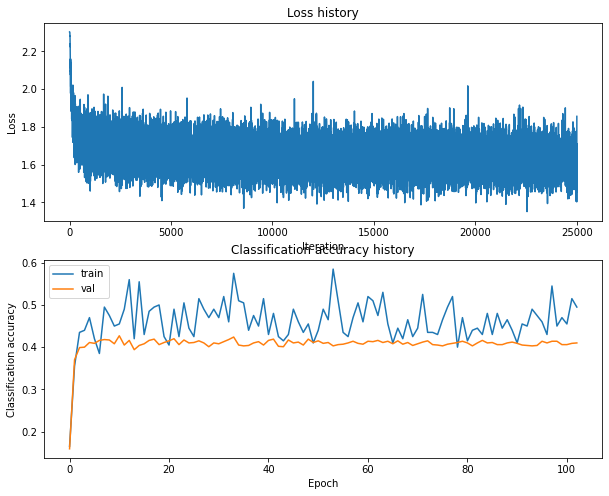

Training network with h_s 50, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.302763
iteration 100 / 25000: loss 2.301685
iteration 200 / 25000: loss 2.272307
iteration 300 / 25000: loss 2.186283
iteration 400 / 25000: loss 2.079747
iteration 500 / 25000: loss 2.086604
iteration 600 / 25000: loss 2.045903
iteration 700 / 25000: loss 1.995461
iteration 800 / 25000: loss 1.984196
iteration 900 / 25000: loss 1.981944
iteration 1000 / 25000: loss 1.903500
iteration 1100 / 25000: loss 1.970979
iteration 1200 / 25000: loss 1.809437
iteration 1300 / 25000: loss 1.878029
iteration 1400 / 25000: loss 1.891768
iteration 1500 / 25000: loss 1.793300
iteration 1600 / 25000: loss 1.843818
iteration 1700 / 25000: loss 1.783870
iteration 1800 / 25000: loss 1.824931
iteration 1900 / 25000: loss 1.881557
iteration 2000 / 25000: loss 1.771296
iteration 2100 / 25000: loss 1.685293
iteration 2200 / 25000: loss 1.743069
iteration 2300 / 25000: loss 1.853462
iteration 2400 / 25000: loss 1.874386
i

iteration 21200 / 25000: loss 1.722972
iteration 21300 / 25000: loss 1.735099
iteration 21400 / 25000: loss 1.799182
iteration 21500 / 25000: loss 1.600059
iteration 21600 / 25000: loss 1.639371
iteration 21700 / 25000: loss 1.632041
iteration 21800 / 25000: loss 1.747319
iteration 21900 / 25000: loss 1.739501
iteration 22000 / 25000: loss 1.841234
iteration 22100 / 25000: loss 1.788124
iteration 22200 / 25000: loss 1.684250
iteration 22300 / 25000: loss 1.698739
iteration 22400 / 25000: loss 1.751744
iteration 22500 / 25000: loss 1.617767
iteration 22600 / 25000: loss 1.682703
iteration 22700 / 25000: loss 1.697452
iteration 22800 / 25000: loss 1.646921
iteration 22900 / 25000: loss 1.744259
iteration 23000 / 25000: loss 1.679626
iteration 23100 / 25000: loss 1.793812
iteration 23200 / 25000: loss 1.672610
iteration 23300 / 25000: loss 1.749880
iteration 23400 / 25000: loss 1.731042
iteration 23500 / 25000: loss 1.762439
iteration 23600 / 25000: loss 1.652594
iteration 23700 / 25000: 

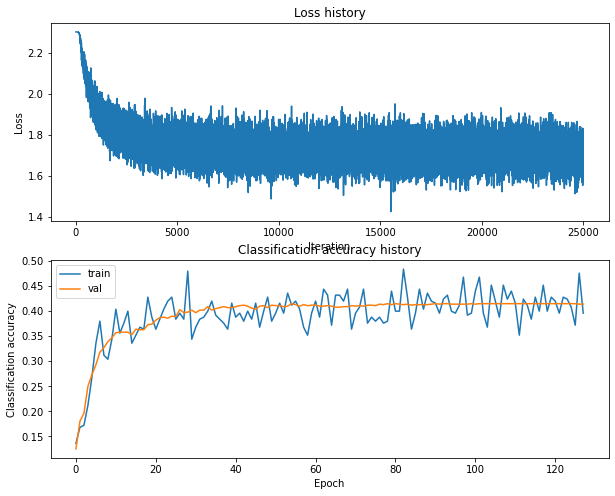

Training network with h_s 50, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.302775
iteration 100 / 25000: loss 1.991700
iteration 200 / 25000: loss 1.847288
iteration 300 / 25000: loss 1.759491
iteration 400 / 25000: loss 1.806460
iteration 500 / 25000: loss 1.801883
iteration 600 / 25000: loss 1.721780
iteration 700 / 25000: loss 1.690532
iteration 800 / 25000: loss 1.666145
iteration 900 / 25000: loss 1.727814
iteration 1000 / 25000: loss 1.775628
iteration 1100 / 25000: loss 1.733137
iteration 1200 / 25000: loss 1.516735
iteration 1300 / 25000: loss 1.728605
iteration 1400 / 25000: loss 1.667652
iteration 1500 / 25000: loss 1.641048
iteration 1600 / 25000: loss 1.658201
iteration 1700 / 25000: loss 1.735603
iteration 1800 / 25000: loss 1.677088
iteration 1900 / 25000: loss 1.578244
iteration 2000 / 25000: loss 1.674478
iteration 2100 / 25000: loss 1.583848
iteration 2200 / 25000: loss 1.609685
iteration 2300 / 25000: loss 1.657379
iteration 2400 / 25000: loss 1.734759
it

iteration 21200 / 25000: loss 1.586148
iteration 21300 / 25000: loss 1.572003
iteration 21400 / 25000: loss 1.592135
iteration 21500 / 25000: loss 1.723862
iteration 21600 / 25000: loss 1.552262
iteration 21700 / 25000: loss 1.646411
iteration 21800 / 25000: loss 1.632023
iteration 21900 / 25000: loss 1.630415
iteration 22000 / 25000: loss 1.607189
iteration 22100 / 25000: loss 1.626213
iteration 22200 / 25000: loss 1.610737
iteration 22300 / 25000: loss 1.507449
iteration 22400 / 25000: loss 1.638012
iteration 22500 / 25000: loss 1.552756
iteration 22600 / 25000: loss 1.626275
iteration 22700 / 25000: loss 1.604673
iteration 22800 / 25000: loss 1.668213
iteration 22900 / 25000: loss 1.625497
iteration 23000 / 25000: loss 1.709564
iteration 23100 / 25000: loss 1.631402
iteration 23200 / 25000: loss 1.552219
iteration 23300 / 25000: loss 1.650623
iteration 23400 / 25000: loss 1.637467
iteration 23500 / 25000: loss 1.609708
iteration 23600 / 25000: loss 1.715745
iteration 23700 / 25000: 

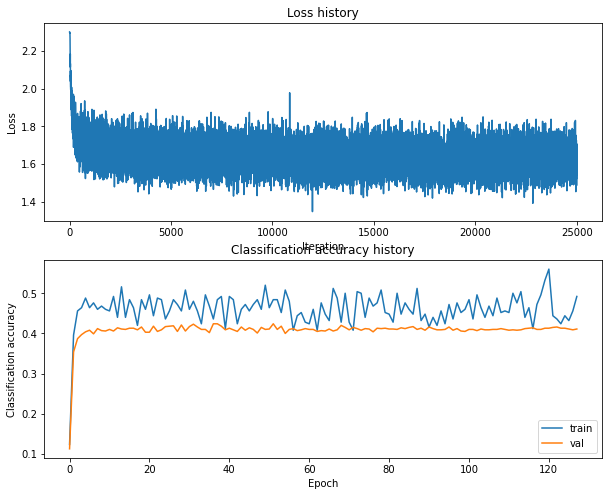

Training network with h_s 50, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.302758
iteration 100 / 25000: loss 2.301922
iteration 200 / 25000: loss 2.285146
iteration 300 / 25000: loss 2.177439
iteration 400 / 25000: loss 2.121278
iteration 500 / 25000: loss 2.043005
iteration 600 / 25000: loss 2.063754
iteration 700 / 25000: loss 2.009971
iteration 800 / 25000: loss 1.994783
iteration 900 / 25000: loss 1.910871
iteration 1000 / 25000: loss 1.957032
iteration 1100 / 25000: loss 1.884226
iteration 1200 / 25000: loss 1.834084
iteration 1300 / 25000: loss 1.823963
iteration 1400 / 25000: loss 1.919073
iteration 1500 / 25000: loss 1.832499
iteration 1600 / 25000: loss 1.794400
iteration 1700 / 25000: loss 1.815271
iteration 1800 / 25000: loss 1.748838
iteration 1900 / 25000: loss 1.768336
iteration 2000 / 25000: loss 1.849555
iteration 2100 / 25000: loss 1.724222
iteration 2200 / 25000: loss 1.774269
iteration 2300 / 25000: loss 1.841897
iteration 2400 / 25000: loss 1.878837
i

iteration 21200 / 25000: loss 1.620764
iteration 21300 / 25000: loss 1.692202
iteration 21400 / 25000: loss 1.724306
iteration 21500 / 25000: loss 1.615950
iteration 21600 / 25000: loss 1.565623
iteration 21700 / 25000: loss 1.557910
iteration 21800 / 25000: loss 1.608761
iteration 21900 / 25000: loss 1.605007
iteration 22000 / 25000: loss 1.635168
iteration 22100 / 25000: loss 1.671850
iteration 22200 / 25000: loss 1.529765
iteration 22300 / 25000: loss 1.580507
iteration 22400 / 25000: loss 1.690866
iteration 22500 / 25000: loss 1.707599
iteration 22600 / 25000: loss 1.568480
iteration 22700 / 25000: loss 1.613216
iteration 22800 / 25000: loss 1.574569
iteration 22900 / 25000: loss 1.664575
iteration 23000 / 25000: loss 1.715886
iteration 23100 / 25000: loss 1.613592
iteration 23200 / 25000: loss 1.620731
iteration 23300 / 25000: loss 1.512479
iteration 23400 / 25000: loss 1.717122
iteration 23500 / 25000: loss 1.630285
iteration 23600 / 25000: loss 1.589823
iteration 23700 / 25000: 

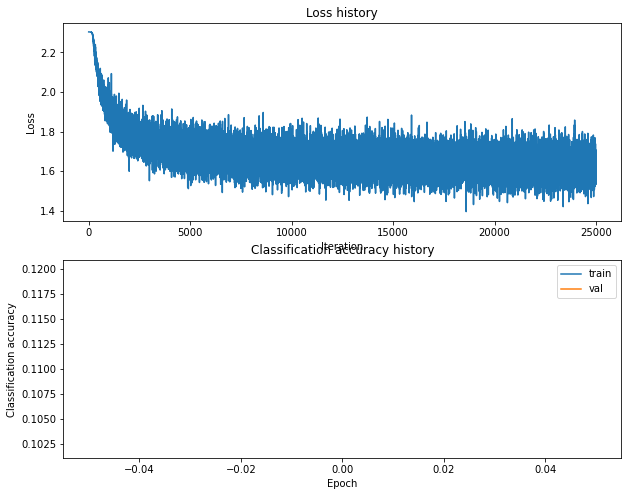

Training network with h_s 50, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.302759
iteration 100 / 25000: loss 1.828576
iteration 200 / 25000: loss 1.787736
iteration 300 / 25000: loss 1.810730
iteration 400 / 25000: loss 1.721356
iteration 500 / 25000: loss 1.727661
iteration 600 / 25000: loss 1.770657
iteration 700 / 25000: loss 1.684174
iteration 800 / 25000: loss 1.669065
iteration 900 / 25000: loss 1.600921
iteration 1000 / 25000: loss 1.764289
iteration 1100 / 25000: loss 1.682771
iteration 1200 / 25000: loss 1.678077
iteration 1300 / 25000: loss 1.706907
iteration 1400 / 25000: loss 1.670215
iteration 1500 / 25000: loss 1.680186
iteration 1600 / 25000: loss 1.774059
iteration 1700 / 25000: loss 1.641674
iteration 1800 / 25000: loss 1.707311
iteration 1900 / 25000: loss 1.683737
iteration 2000 / 25000: loss 1.793551
iteration 2100 / 25000: loss 1.718444
iteration 2200 / 25000: loss 1.684341
iteration 2300 / 25000: loss 1.604452
iteration 2400 / 25000: loss 1.753085
it

iteration 21200 / 25000: loss 1.515458
iteration 21300 / 25000: loss 1.687364
iteration 21400 / 25000: loss 1.676674
iteration 21500 / 25000: loss 1.633824
iteration 21600 / 25000: loss 1.683863
iteration 21700 / 25000: loss 1.755937
iteration 21800 / 25000: loss 1.670383
iteration 21900 / 25000: loss 1.617383
iteration 22000 / 25000: loss 1.743724
iteration 22100 / 25000: loss 1.701993
iteration 22200 / 25000: loss 1.769205
iteration 22300 / 25000: loss 1.834092
iteration 22400 / 25000: loss 1.751076
iteration 22500 / 25000: loss 1.644999
iteration 22600 / 25000: loss 1.798402
iteration 22700 / 25000: loss 1.483557
iteration 22800 / 25000: loss 1.628640
iteration 22900 / 25000: loss 1.744957
iteration 23000 / 25000: loss 1.679170
iteration 23100 / 25000: loss 1.626997
iteration 23200 / 25000: loss 1.637966
iteration 23300 / 25000: loss 1.702861
iteration 23400 / 25000: loss 1.775560
iteration 23500 / 25000: loss 1.720149
iteration 23600 / 25000: loss 1.721338
iteration 23700 / 25000: 

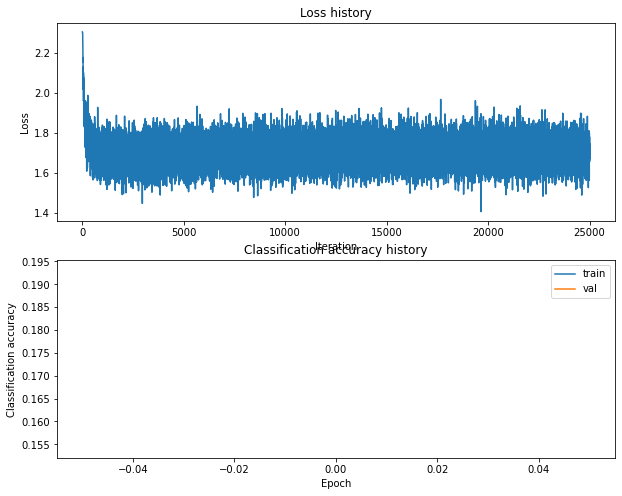

Training network with h_s 50, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.302767
iteration 100 / 25000: loss 2.301826
iteration 200 / 25000: loss 2.281146
iteration 300 / 25000: loss 2.209858
iteration 400 / 25000: loss 2.163484
iteration 500 / 25000: loss 2.083122
iteration 600 / 25000: loss 2.109336
iteration 700 / 25000: loss 2.055373
iteration 800 / 25000: loss 1.995104
iteration 900 / 25000: loss 1.967492
iteration 1000 / 25000: loss 1.954862
iteration 1100 / 25000: loss 1.935456
iteration 1200 / 25000: loss 1.884039
iteration 1300 / 25000: loss 1.894038
iteration 1400 / 25000: loss 1.899148
iteration 1500 / 25000: loss 1.925278
iteration 1600 / 25000: loss 1.914292
iteration 1700 / 25000: loss 1.862831
iteration 1800 / 25000: loss 1.829448
iteration 1900 / 25000: loss 1.871302
iteration 2000 / 25000: loss 1.817835
iteration 2100 / 25000: loss 1.875142
iteration 2200 / 25000: loss 1.848863
iteration 2300 / 25000: loss 1.834561
iteration 2400 / 25000: loss 1.843327
i

iteration 21200 / 25000: loss 1.852922
iteration 21300 / 25000: loss 1.830038
iteration 21400 / 25000: loss 1.828615
iteration 21500 / 25000: loss 1.772598
iteration 21600 / 25000: loss 1.841209
iteration 21700 / 25000: loss 1.797654
iteration 21800 / 25000: loss 1.797666
iteration 21900 / 25000: loss 1.794034
iteration 22000 / 25000: loss 1.829856
iteration 22100 / 25000: loss 1.743001
iteration 22200 / 25000: loss 1.786790
iteration 22300 / 25000: loss 1.824079
iteration 22400 / 25000: loss 1.787177
iteration 22500 / 25000: loss 1.749249
iteration 22600 / 25000: loss 1.781072
iteration 22700 / 25000: loss 1.739835
iteration 22800 / 25000: loss 1.723587
iteration 22900 / 25000: loss 1.803445
iteration 23000 / 25000: loss 1.793383
iteration 23100 / 25000: loss 1.811933
iteration 23200 / 25000: loss 1.755193
iteration 23300 / 25000: loss 1.797726
iteration 23400 / 25000: loss 1.783171
iteration 23500 / 25000: loss 1.841149
iteration 23600 / 25000: loss 1.799733
iteration 23700 / 25000: 

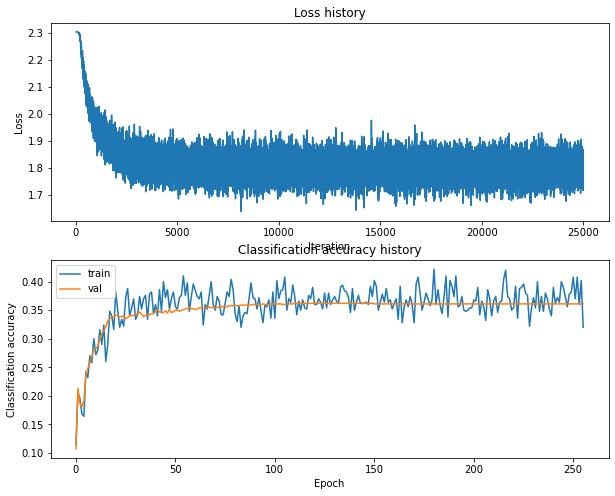

Training network with h_s 50, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.302776
iteration 100 / 25000: loss 1.887163
iteration 200 / 25000: loss 1.748906
iteration 300 / 25000: loss 1.797640
iteration 400 / 25000: loss 1.765694
iteration 500 / 25000: loss 1.742082
iteration 600 / 25000: loss 1.653935
iteration 700 / 25000: loss 1.749504
iteration 800 / 25000: loss 1.722093
iteration 900 / 25000: loss 1.764208
iteration 1000 / 25000: loss 1.671486
iteration 1100 / 25000: loss 1.698699
iteration 1200 / 25000: loss 1.673742
iteration 1300 / 25000: loss 1.658153
iteration 1400 / 25000: loss 1.674357
iteration 1500 / 25000: loss 1.701157
iteration 1600 / 25000: loss 1.732565
iteration 1700 / 25000: loss 1.697532
iteration 1800 / 25000: loss 1.619187
iteration 1900 / 25000: loss 1.699614
iteration 2000 / 25000: loss 1.563977
iteration 2100 / 25000: loss 1.703889
iteration 2200 / 25000: loss 1.736052
iteration 2300 / 25000: loss 1.706267
iteration 2400 / 25000: loss 1.538689
it

iteration 21200 / 25000: loss 1.651169
iteration 21300 / 25000: loss 1.652532
iteration 21400 / 25000: loss 1.667783
iteration 21500 / 25000: loss 1.646350
iteration 21600 / 25000: loss 1.672903
iteration 21700 / 25000: loss 1.739925
iteration 21800 / 25000: loss 1.732344
iteration 21900 / 25000: loss 1.607074
iteration 22000 / 25000: loss 1.664695
iteration 22100 / 25000: loss 1.638317
iteration 22200 / 25000: loss 1.634026
iteration 22300 / 25000: loss 1.634610
iteration 22400 / 25000: loss 1.600953
iteration 22500 / 25000: loss 1.625819
iteration 22600 / 25000: loss 1.654358
iteration 22700 / 25000: loss 1.604404
iteration 22800 / 25000: loss 1.593131
iteration 22900 / 25000: loss 1.603587
iteration 23000 / 25000: loss 1.535222
iteration 23100 / 25000: loss 1.670509
iteration 23200 / 25000: loss 1.628932
iteration 23300 / 25000: loss 1.659793
iteration 23400 / 25000: loss 1.660190
iteration 23500 / 25000: loss 1.549979
iteration 23600 / 25000: loss 1.735014
iteration 23700 / 25000: 

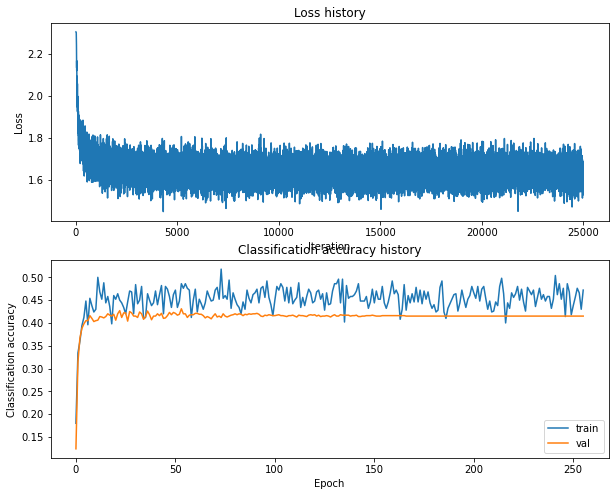

Training network with h_s 100, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.302998
iteration 100 / 500: loss 2.301199
iteration 200 / 500: loss 2.263227
iteration 300 / 500: loss 2.118646
iteration 400 / 500: loss 2.168752
Validation accuracy:  0.254


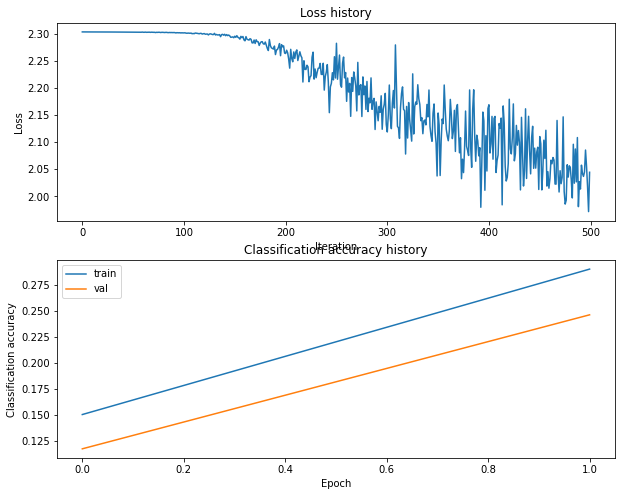

Training network with h_s 100, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.303004
iteration 100 / 500: loss 2.051401
iteration 200 / 500: loss 1.820875
iteration 300 / 500: loss 1.813143
iteration 400 / 500: loss 1.761113
Validation accuracy:  0.382


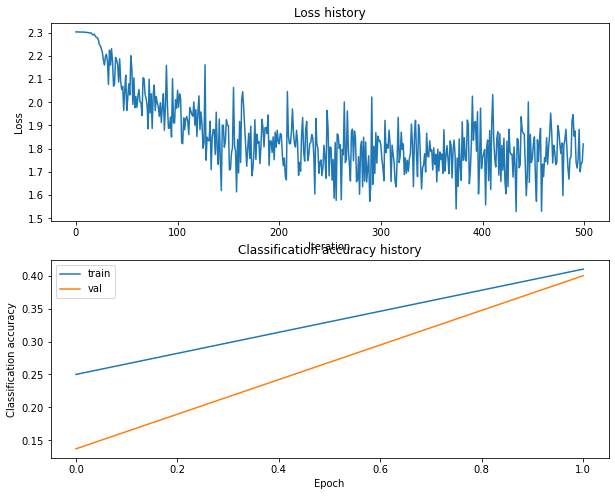

Training network with h_s 100, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.302936
iteration 100 / 500: loss 2.300693
iteration 200 / 500: loss 2.266444
iteration 300 / 500: loss 2.157110
iteration 400 / 500: loss 2.134090
Validation accuracy:  0.245


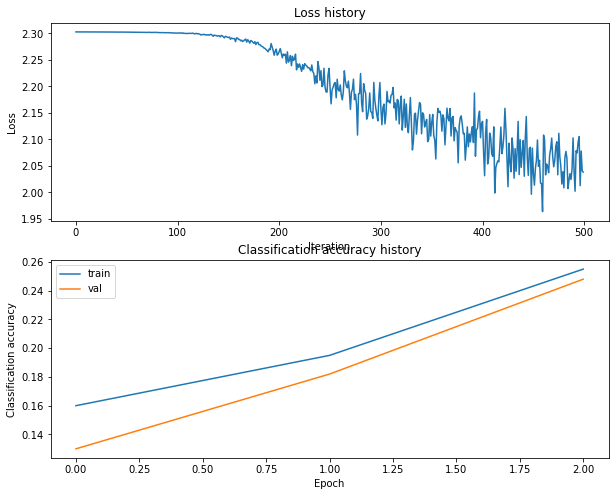

Training network with h_s 100, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.302978
iteration 100 / 500: loss 1.772281
iteration 200 / 500: loss 1.849418
iteration 300 / 500: loss 1.792939
iteration 400 / 500: loss 1.663419
Validation accuracy:  0.394


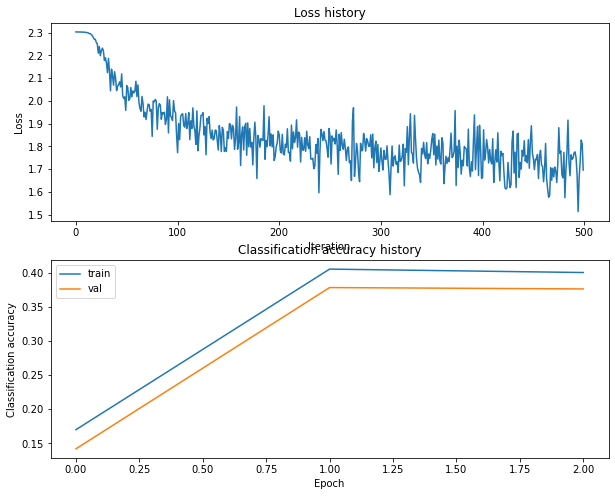

Training network with h_s 100, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.302988
iteration 100 / 500: loss 2.301439
iteration 200 / 500: loss 2.267103
iteration 300 / 500: loss 2.168258
iteration 400 / 500: loss 2.135388
Validation accuracy:  0.254


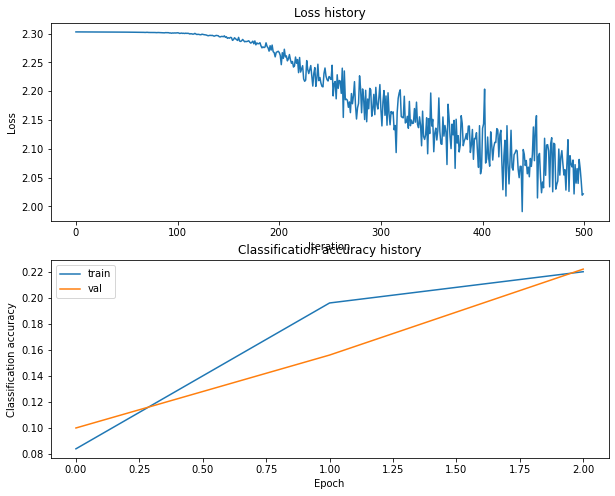

Training network with h_s 100, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.302959
iteration 100 / 500: loss 1.949683
iteration 200 / 500: loss 1.942510
iteration 300 / 500: loss 1.695336
iteration 400 / 500: loss 1.651220
Validation accuracy:  0.402


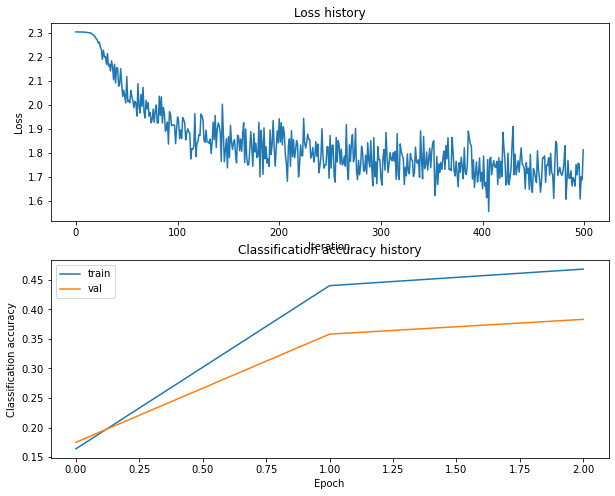

Training network with h_s 100, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.302975
iteration 100 / 500: loss 2.301209
iteration 200 / 500: loss 2.258561
iteration 300 / 500: loss 2.221139
iteration 400 / 500: loss 2.092139
Validation accuracy:  0.247


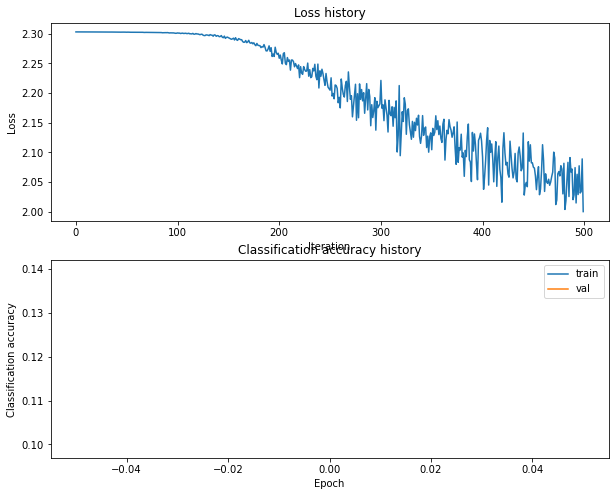

Training network with h_s 100, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.302990
iteration 100 / 500: loss 1.892074
iteration 200 / 500: loss 1.722259
iteration 300 / 500: loss 1.645504
iteration 400 / 500: loss 1.688875
Validation accuracy:  0.391


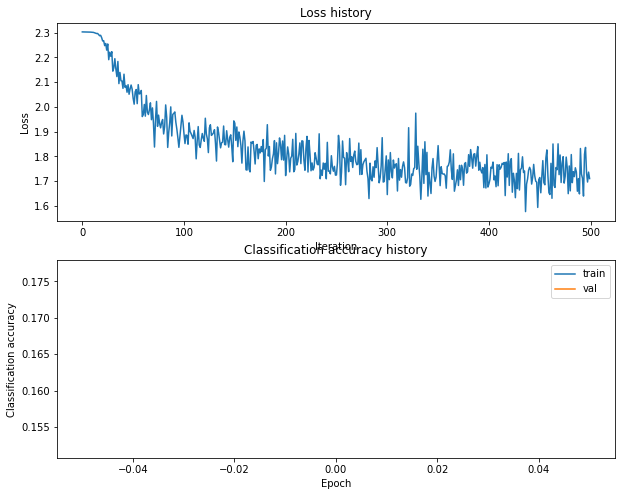

Training network with h_s 100, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.302964
iteration 100 / 500: loss 2.299801
iteration 200 / 500: loss 2.257311
iteration 300 / 500: loss 2.164484
iteration 400 / 500: loss 2.131072
Validation accuracy:  0.247


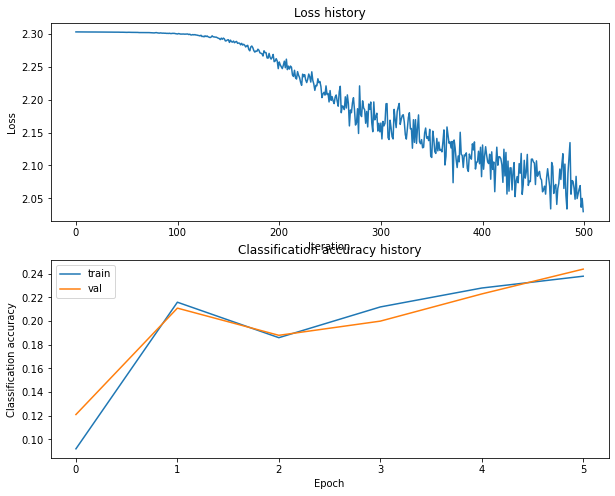

Training network with h_s 100, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.302973
iteration 100 / 500: loss 1.873023
iteration 200 / 500: loss 1.717665
iteration 300 / 500: loss 1.762844
iteration 400 / 500: loss 1.733621
Validation accuracy:  0.412


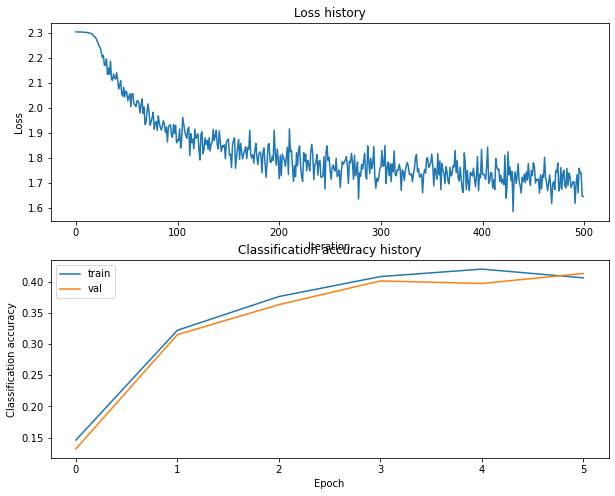

Training network with h_s 100, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.303008
iteration 100 / 1000: loss 2.301167
iteration 200 / 1000: loss 2.271897
iteration 300 / 1000: loss 2.122292
iteration 400 / 1000: loss 2.106482
iteration 500 / 1000: loss 2.112407
iteration 600 / 1000: loss 2.067434
iteration 700 / 1000: loss 1.993155
iteration 800 / 1000: loss 2.006416
iteration 900 / 1000: loss 1.788761
Validation accuracy:  0.303


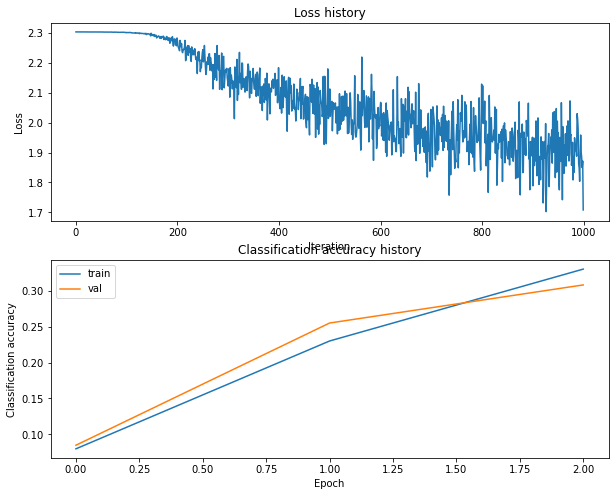

Training network with h_s 100, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.302941
iteration 100 / 1000: loss 1.895648
iteration 200 / 1000: loss 1.774300
iteration 300 / 1000: loss 1.791707
iteration 400 / 1000: loss 1.809634
iteration 500 / 1000: loss 1.704491
iteration 600 / 1000: loss 1.787013
iteration 700 / 1000: loss 1.809059
iteration 800 / 1000: loss 1.767927
iteration 900 / 1000: loss 1.850613
Validation accuracy:  0.386


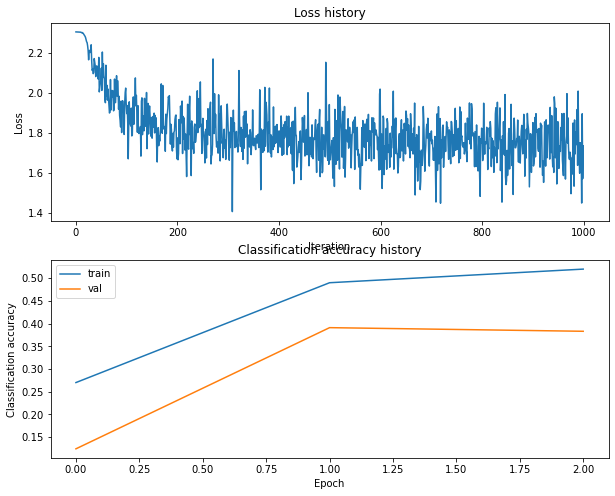

Training network with h_s 100, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.302983
iteration 100 / 1000: loss 2.300940
iteration 200 / 1000: loss 2.262367
iteration 300 / 1000: loss 2.201148
iteration 400 / 1000: loss 2.114133
iteration 500 / 1000: loss 2.022945
iteration 600 / 1000: loss 2.069327
iteration 700 / 1000: loss 1.986217
iteration 800 / 1000: loss 1.911562
iteration 900 / 1000: loss 2.058631
Validation accuracy:  0.308


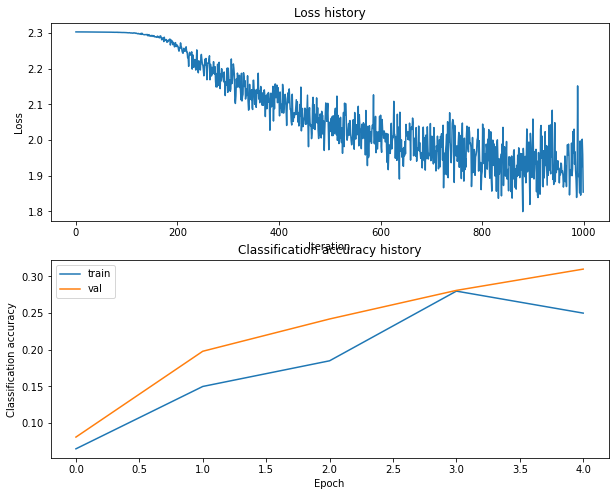

Training network with h_s 100, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.302948
iteration 100 / 1000: loss 1.910023
iteration 200 / 1000: loss 1.866103
iteration 300 / 1000: loss 1.823098
iteration 400 / 1000: loss 1.764159
iteration 500 / 1000: loss 1.668494
iteration 600 / 1000: loss 1.562400
iteration 700 / 1000: loss 1.720313
iteration 800 / 1000: loss 1.752252
iteration 900 / 1000: loss 1.653299
Validation accuracy:  0.412


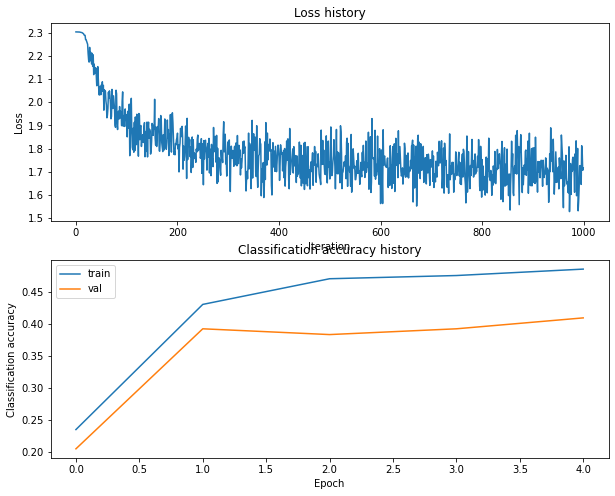

Training network with h_s 100, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.302986
iteration 100 / 1000: loss 2.300675
iteration 200 / 1000: loss 2.262615
iteration 300 / 1000: loss 2.168141
iteration 400 / 1000: loss 2.088812
iteration 500 / 1000: loss 2.034586
iteration 600 / 1000: loss 2.054220
iteration 700 / 1000: loss 1.915241
iteration 800 / 1000: loss 1.965524
iteration 900 / 1000: loss 1.995230
Validation accuracy:  0.31


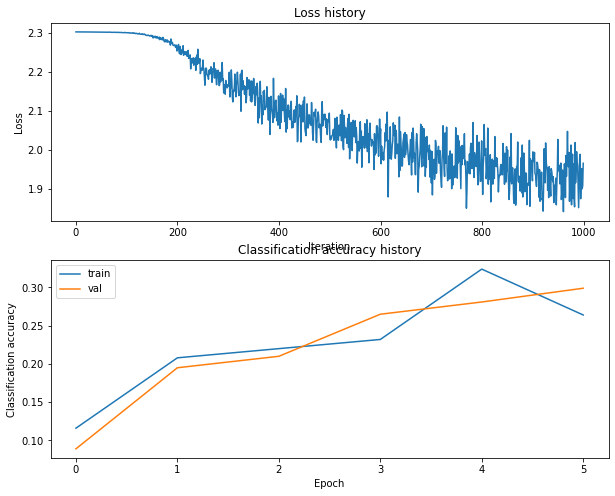

Training network with h_s 100, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.302945
iteration 100 / 1000: loss 1.935909
iteration 200 / 1000: loss 1.788912
iteration 300 / 1000: loss 1.864833
iteration 400 / 1000: loss 1.764005
iteration 500 / 1000: loss 1.673952
iteration 600 / 1000: loss 1.726372
iteration 700 / 1000: loss 1.789900
iteration 800 / 1000: loss 1.751526
iteration 900 / 1000: loss 1.750140
Validation accuracy:  0.408


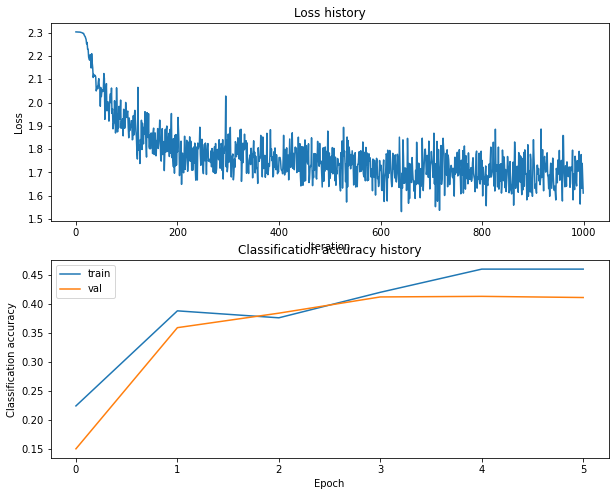

Training network with h_s 100, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.302965
iteration 100 / 1000: loss 2.300655
iteration 200 / 1000: loss 2.272656
iteration 300 / 1000: loss 2.159402
iteration 400 / 1000: loss 2.089259
iteration 500 / 1000: loss 2.049484
iteration 600 / 1000: loss 1.994069
iteration 700 / 1000: loss 1.961347
iteration 800 / 1000: loss 1.957871
iteration 900 / 1000: loss 1.955456
Validation accuracy:  0.326


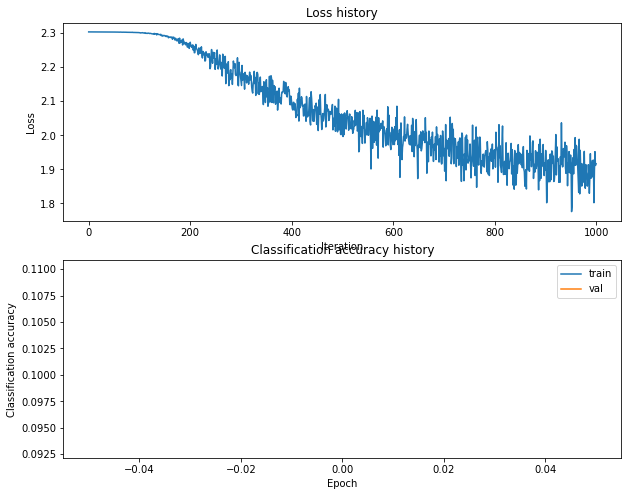

Training network with h_s 100, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.302953
iteration 100 / 1000: loss 1.926203
iteration 200 / 1000: loss 1.860895
iteration 300 / 1000: loss 1.872766
iteration 400 / 1000: loss 1.733278
iteration 500 / 1000: loss 1.812693
iteration 600 / 1000: loss 1.735959
iteration 700 / 1000: loss 1.736408
iteration 800 / 1000: loss 1.633238
iteration 900 / 1000: loss 1.685543
Validation accuracy:  0.406


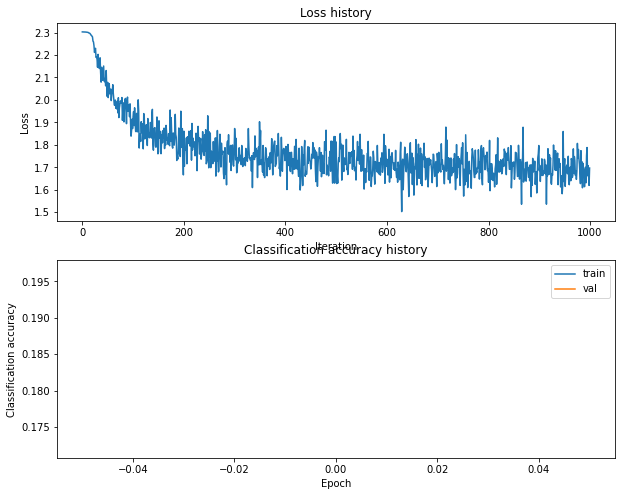

Training network with h_s 100, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.302976
iteration 100 / 1000: loss 2.301057
iteration 200 / 1000: loss 2.277601
iteration 300 / 1000: loss 2.159677
iteration 400 / 1000: loss 2.111602
iteration 500 / 1000: loss 2.067879
iteration 600 / 1000: loss 2.030390
iteration 700 / 1000: loss 1.991794
iteration 800 / 1000: loss 1.956878
iteration 900 / 1000: loss 1.972581
Validation accuracy:  0.283


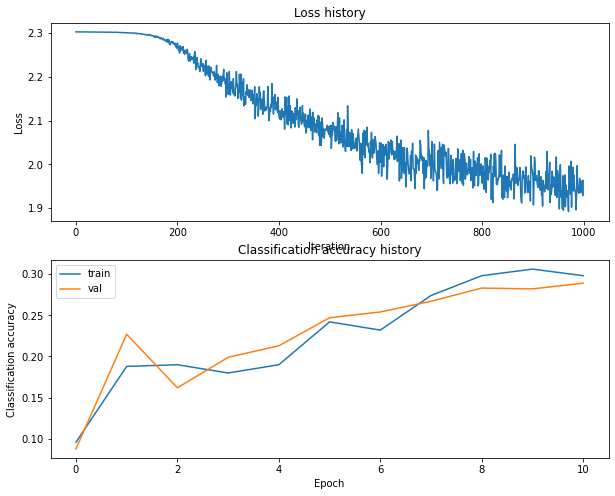

Training network with h_s 100, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.303007
iteration 100 / 1000: loss 1.876270
iteration 200 / 1000: loss 1.815040
iteration 300 / 1000: loss 1.804847
iteration 400 / 1000: loss 1.649745
iteration 500 / 1000: loss 1.742074
iteration 600 / 1000: loss 1.668683
iteration 700 / 1000: loss 1.662299
iteration 800 / 1000: loss 1.634310
iteration 900 / 1000: loss 1.700291
Validation accuracy:  0.429


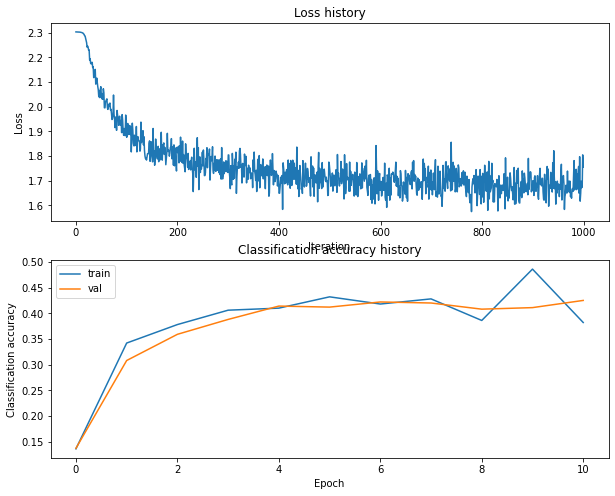

Training network with h_s 100, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.302915
iteration 100 / 1500: loss 2.301510
iteration 200 / 1500: loss 2.245395
iteration 300 / 1500: loss 2.108587
iteration 400 / 1500: loss 2.173470
iteration 500 / 1500: loss 1.972968
iteration 600 / 1500: loss 2.133538
iteration 700 / 1500: loss 1.883281
iteration 800 / 1500: loss 1.965094
iteration 900 / 1500: loss 1.914867
iteration 1000 / 1500: loss 1.894608
iteration 1100 / 1500: loss 1.901975
iteration 1200 / 1500: loss 1.848040
iteration 1300 / 1500: loss 1.862499
iteration 1400 / 1500: loss 1.729850
Validation accuracy:  0.34


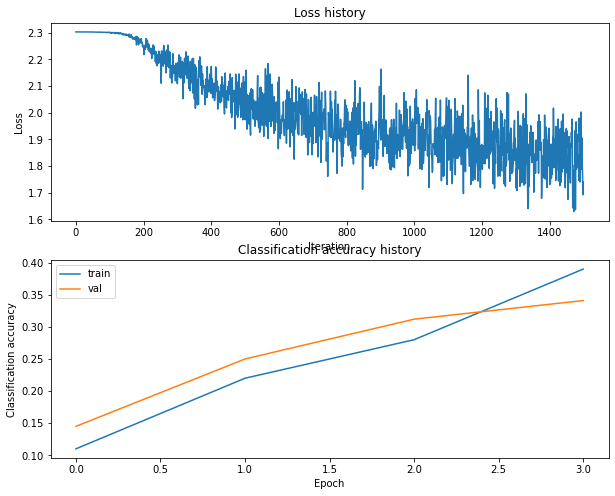

Training network with h_s 100, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.302981
iteration 100 / 1500: loss 1.961440
iteration 200 / 1500: loss 1.768573
iteration 300 / 1500: loss 1.775153
iteration 400 / 1500: loss 1.894891
iteration 500 / 1500: loss 1.889686
iteration 600 / 1500: loss 1.784605
iteration 700 / 1500: loss 1.803465
iteration 800 / 1500: loss 1.502726
iteration 900 / 1500: loss 1.798721
iteration 1000 / 1500: loss 1.574125
iteration 1100 / 1500: loss 1.779398
iteration 1200 / 1500: loss 1.741177
iteration 1300 / 1500: loss 1.595958
iteration 1400 / 1500: loss 1.708216
Validation accuracy:  0.398


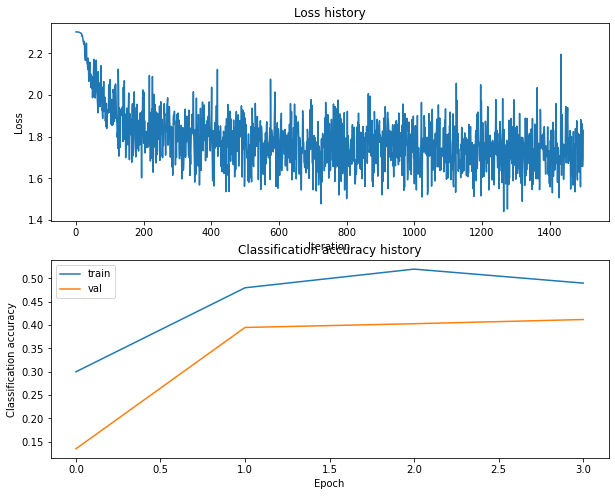

Training network with h_s 100, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.302967
iteration 100 / 1500: loss 2.300749
iteration 200 / 1500: loss 2.274135
iteration 300 / 1500: loss 2.177313
iteration 400 / 1500: loss 2.145434
iteration 500 / 1500: loss 2.059555
iteration 600 / 1500: loss 2.008473
iteration 700 / 1500: loss 1.906876
iteration 800 / 1500: loss 2.027296
iteration 900 / 1500: loss 1.920675
iteration 1000 / 1500: loss 1.898311
iteration 1100 / 1500: loss 1.938572
iteration 1200 / 1500: loss 1.772359
iteration 1300 / 1500: loss 1.859874
iteration 1400 / 1500: loss 1.897541
Validation accuracy:  0.339


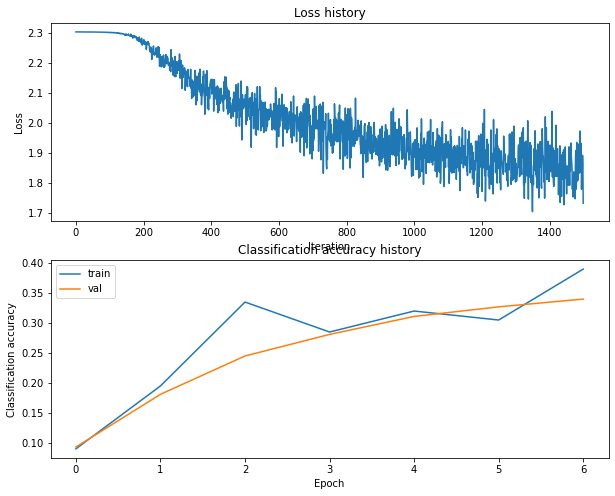

Training network with h_s 100, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.302935
iteration 100 / 1500: loss 1.851104
iteration 200 / 1500: loss 1.851542
iteration 300 / 1500: loss 1.770604
iteration 400 / 1500: loss 1.850243
iteration 500 / 1500: loss 1.662858
iteration 600 / 1500: loss 1.765841
iteration 700 / 1500: loss 1.753406
iteration 800 / 1500: loss 1.788578
iteration 900 / 1500: loss 1.714096
iteration 1000 / 1500: loss 1.732348
iteration 1100 / 1500: loss 1.775695
iteration 1200 / 1500: loss 1.579992
iteration 1300 / 1500: loss 1.735648
iteration 1400 / 1500: loss 1.685907
Validation accuracy:  0.412


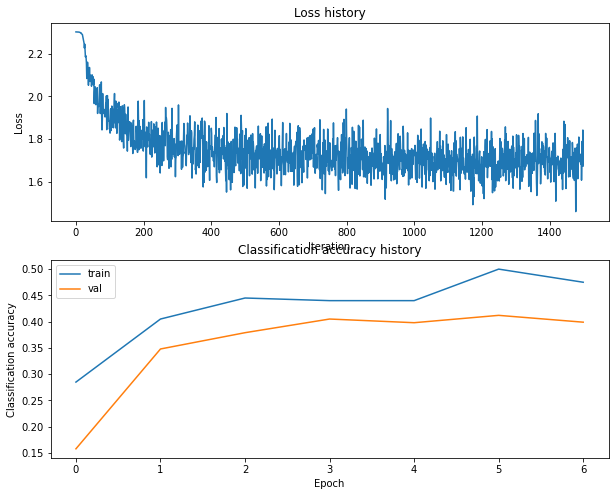

Training network with h_s 100, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.302932
iteration 100 / 1500: loss 2.300501
iteration 200 / 1500: loss 2.255647
iteration 300 / 1500: loss 2.184822
iteration 400 / 1500: loss 2.142240
iteration 500 / 1500: loss 2.013095
iteration 600 / 1500: loss 1.988771
iteration 700 / 1500: loss 2.016556
iteration 800 / 1500: loss 1.928522
iteration 900 / 1500: loss 1.990162
iteration 1000 / 1500: loss 1.963796
iteration 1100 / 1500: loss 1.941894
iteration 1200 / 1500: loss 1.833190
iteration 1300 / 1500: loss 1.877101
iteration 1400 / 1500: loss 1.941926
Validation accuracy:  0.345


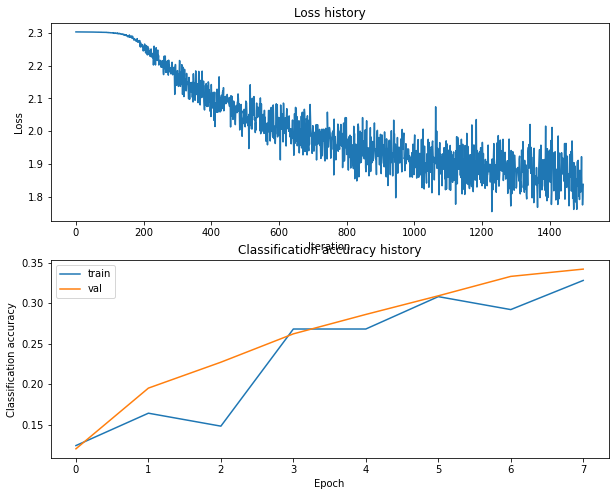

Training network with h_s 100, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.302973
iteration 100 / 1500: loss 1.933030
iteration 200 / 1500: loss 1.865443
iteration 300 / 1500: loss 1.752533
iteration 400 / 1500: loss 1.830672
iteration 500 / 1500: loss 1.723948
iteration 600 / 1500: loss 1.669805
iteration 700 / 1500: loss 1.802434
iteration 800 / 1500: loss 1.657477
iteration 900 / 1500: loss 1.673148
iteration 1000 / 1500: loss 1.749603
iteration 1100 / 1500: loss 1.717688
iteration 1200 / 1500: loss 1.661817
iteration 1300 / 1500: loss 1.680908
iteration 1400 / 1500: loss 1.610023
Validation accuracy:  0.416


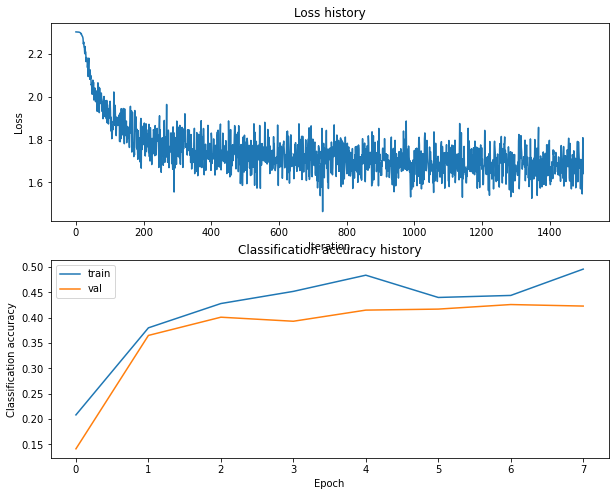

Training network with h_s 100, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.302977
iteration 100 / 1500: loss 2.301378
iteration 200 / 1500: loss 2.268044
iteration 300 / 1500: loss 2.134785
iteration 400 / 1500: loss 2.107915
iteration 500 / 1500: loss 1.970558
iteration 600 / 1500: loss 2.053926
iteration 700 / 1500: loss 2.045855
iteration 800 / 1500: loss 1.915334
iteration 900 / 1500: loss 1.910682
iteration 1000 / 1500: loss 1.925277
iteration 1100 / 1500: loss 1.810151
iteration 1200 / 1500: loss 1.791050
iteration 1300 / 1500: loss 1.873621
iteration 1400 / 1500: loss 1.822111
Validation accuracy:  0.352


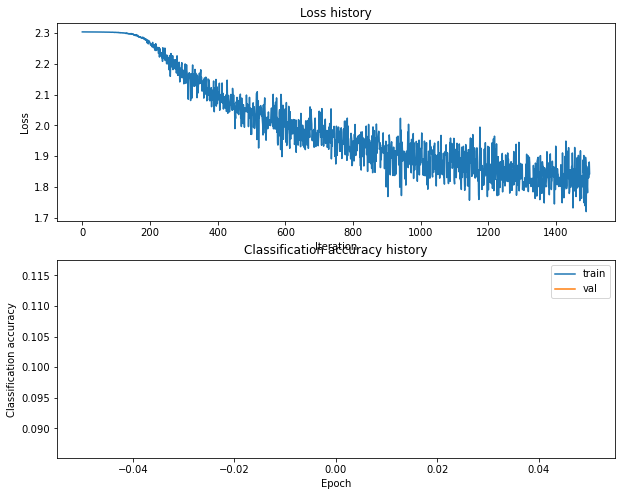

Training network with h_s 100, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.302995
iteration 100 / 1500: loss 1.946747
iteration 200 / 1500: loss 1.809983
iteration 300 / 1500: loss 1.722657
iteration 400 / 1500: loss 1.665993
iteration 500 / 1500: loss 1.630411
iteration 600 / 1500: loss 1.730071
iteration 700 / 1500: loss 1.746506
iteration 800 / 1500: loss 1.808214
iteration 900 / 1500: loss 1.630601
iteration 1000 / 1500: loss 1.680786
iteration 1100 / 1500: loss 1.628880
iteration 1200 / 1500: loss 1.695162
iteration 1300 / 1500: loss 1.809932
iteration 1400 / 1500: loss 1.747339
Validation accuracy:  0.387


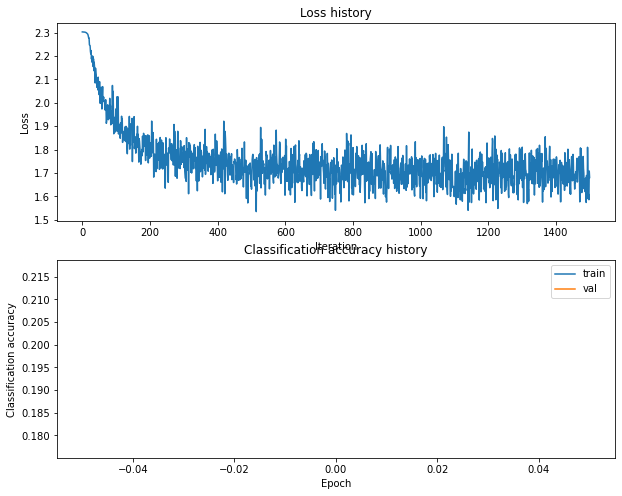

Training network with h_s 100, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.302957
iteration 100 / 1500: loss 2.300524
iteration 200 / 1500: loss 2.259519
iteration 300 / 1500: loss 2.164703
iteration 400 / 1500: loss 2.079873
iteration 500 / 1500: loss 2.073173
iteration 600 / 1500: loss 2.018249
iteration 700 / 1500: loss 1.994556
iteration 800 / 1500: loss 2.020353
iteration 900 / 1500: loss 1.964109
iteration 1000 / 1500: loss 2.004426
iteration 1100 / 1500: loss 1.909404
iteration 1200 / 1500: loss 1.888335
iteration 1300 / 1500: loss 1.863026
iteration 1400 / 1500: loss 1.892976
Validation accuracy:  0.329


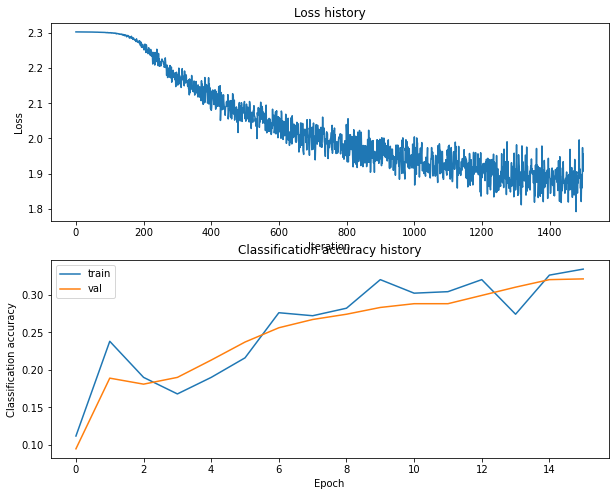

Training network with h_s 100, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.302946
iteration 100 / 1500: loss 1.848718
iteration 200 / 1500: loss 1.827827
iteration 300 / 1500: loss 1.808248
iteration 400 / 1500: loss 1.672350
iteration 500 / 1500: loss 1.688130
iteration 600 / 1500: loss 1.673090
iteration 700 / 1500: loss 1.681431
iteration 800 / 1500: loss 1.713852
iteration 900 / 1500: loss 1.658684
iteration 1000 / 1500: loss 1.738754
iteration 1100 / 1500: loss 1.673076
iteration 1200 / 1500: loss 1.654209
iteration 1300 / 1500: loss 1.690122
iteration 1400 / 1500: loss 1.702248
Validation accuracy:  0.423


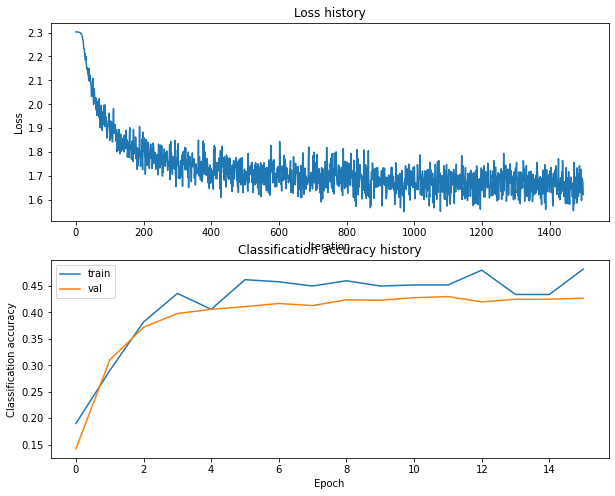

Training network with h_s 100, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.302942
iteration 100 / 2500: loss 2.300649
iteration 200 / 2500: loss 2.249289
iteration 300 / 2500: loss 2.205474
iteration 400 / 2500: loss 2.151477
iteration 500 / 2500: loss 2.151007
iteration 600 / 2500: loss 2.037021
iteration 700 / 2500: loss 1.948680
iteration 800 / 2500: loss 2.025571
iteration 900 / 2500: loss 1.844372
iteration 1000 / 2500: loss 2.036500
iteration 1100 / 2500: loss 1.934243
iteration 1200 / 2500: loss 1.849537
iteration 1300 / 2500: loss 1.932801
iteration 1400 / 2500: loss 1.802461
iteration 1500 / 2500: loss 1.818720
iteration 1600 / 2500: loss 1.854297
iteration 1700 / 2500: loss 1.710663
iteration 1800 / 2500: loss 1.841150
iteration 1900 / 2500: loss 1.820789
iteration 2000 / 2500: loss 2.078144
iteration 2100 / 2500: loss 1.826384
iteration 2200 / 2500: loss 1.857673
iteration 2300 / 2500: loss 1.813384
iteration 2400 / 2500: loss 1.930736
Validation accuracy:  0.38

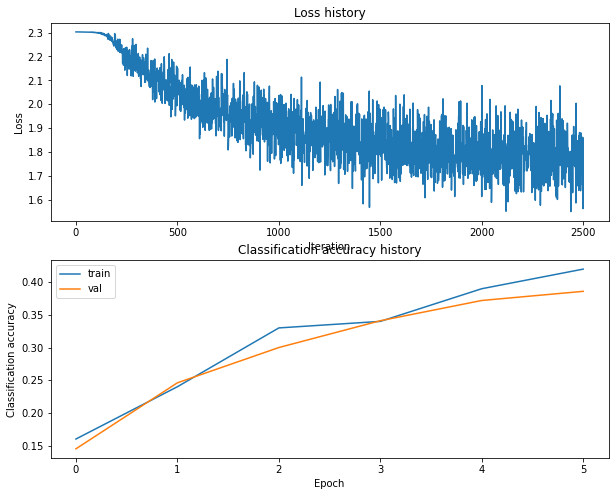

Training network with h_s 100, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.302958
iteration 100 / 2500: loss 1.905333
iteration 200 / 2500: loss 1.919911
iteration 300 / 2500: loss 1.649423
iteration 400 / 2500: loss 1.713095
iteration 500 / 2500: loss 1.769853
iteration 600 / 2500: loss 1.760185
iteration 700 / 2500: loss 1.835327
iteration 800 / 2500: loss 1.702908
iteration 900 / 2500: loss 1.805536
iteration 1000 / 2500: loss 1.673472
iteration 1100 / 2500: loss 1.725208
iteration 1200 / 2500: loss 1.776054
iteration 1300 / 2500: loss 1.578208
iteration 1400 / 2500: loss 1.612085
iteration 1500 / 2500: loss 1.886404
iteration 1600 / 2500: loss 1.649133
iteration 1700 / 2500: loss 1.736257
iteration 1800 / 2500: loss 1.839276
iteration 1900 / 2500: loss 1.758867
iteration 2000 / 2500: loss 1.695974
iteration 2100 / 2500: loss 1.811452
iteration 2200 / 2500: loss 1.615336
iteration 2300 / 2500: loss 1.738098
iteration 2400 / 2500: loss 1.751792
Validation accuracy:  0.397

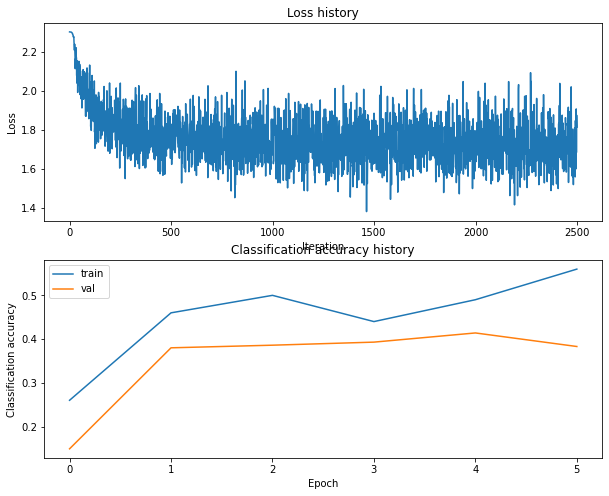

Training network with h_s 100, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.302966
iteration 100 / 2500: loss 2.300833
iteration 200 / 2500: loss 2.264657
iteration 300 / 2500: loss 2.194200
iteration 400 / 2500: loss 2.082283
iteration 500 / 2500: loss 2.067908
iteration 600 / 2500: loss 2.087113
iteration 700 / 2500: loss 1.910893
iteration 800 / 2500: loss 1.882768
iteration 900 / 2500: loss 1.915715
iteration 1000 / 2500: loss 1.846852
iteration 1100 / 2500: loss 1.857907
iteration 1200 / 2500: loss 1.928640
iteration 1300 / 2500: loss 1.941621
iteration 1400 / 2500: loss 1.816230
iteration 1500 / 2500: loss 1.817070
iteration 1600 / 2500: loss 1.838358
iteration 1700 / 2500: loss 1.962925
iteration 1800 / 2500: loss 1.860664
iteration 1900 / 2500: loss 1.695475
iteration 2000 / 2500: loss 1.867847
iteration 2100 / 2500: loss 1.887832
iteration 2200 / 2500: loss 1.706969
iteration 2300 / 2500: loss 1.897403
iteration 2400 / 2500: loss 1.746688
Validation accuracy:  0.37

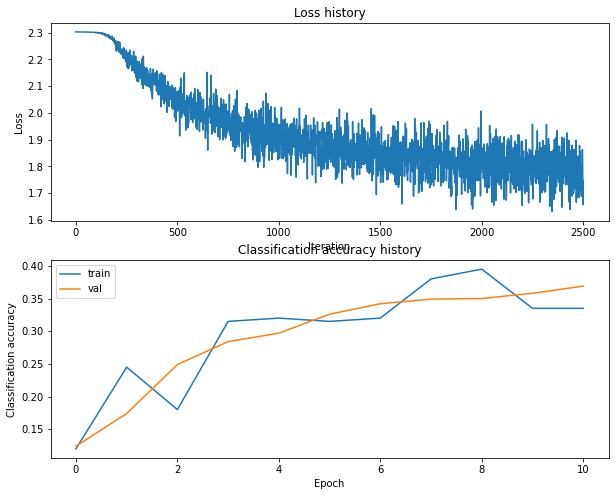

Training network with h_s 100, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.302955
iteration 100 / 2500: loss 1.892538
iteration 200 / 2500: loss 1.825244
iteration 300 / 2500: loss 1.780412
iteration 400 / 2500: loss 1.763401
iteration 500 / 2500: loss 1.780517
iteration 600 / 2500: loss 1.766508
iteration 700 / 2500: loss 1.614239
iteration 800 / 2500: loss 1.682799
iteration 900 / 2500: loss 1.725671
iteration 1000 / 2500: loss 1.645435
iteration 1100 / 2500: loss 1.667988
iteration 1200 / 2500: loss 1.706691
iteration 1300 / 2500: loss 1.685430
iteration 1400 / 2500: loss 1.566183
iteration 1500 / 2500: loss 1.818316
iteration 1600 / 2500: loss 1.673368
iteration 1700 / 2500: loss 1.808062
iteration 1800 / 2500: loss 1.632153
iteration 1900 / 2500: loss 1.743542
iteration 2000 / 2500: loss 1.656654
iteration 2100 / 2500: loss 1.772039
iteration 2200 / 2500: loss 1.615273
iteration 2300 / 2500: loss 1.733402
iteration 2400 / 2500: loss 1.675514
Validation accuracy:  0.392

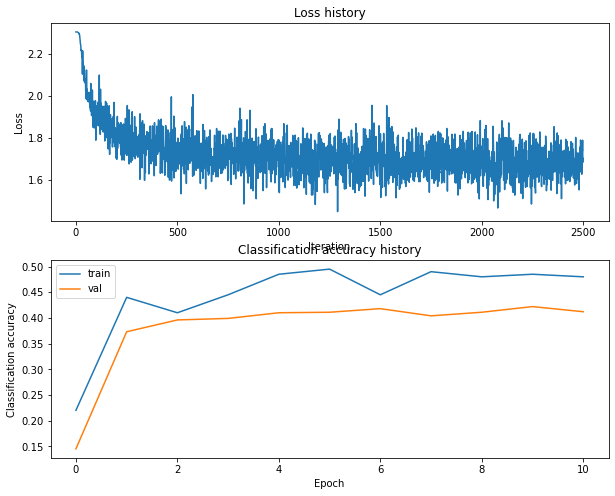

Training network with h_s 100, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.302958
iteration 100 / 2500: loss 2.300688
iteration 200 / 2500: loss 2.259531
iteration 300 / 2500: loss 2.160425
iteration 400 / 2500: loss 2.103896
iteration 500 / 2500: loss 2.051880
iteration 600 / 2500: loss 2.021169
iteration 700 / 2500: loss 1.984740
iteration 800 / 2500: loss 1.906969
iteration 900 / 2500: loss 1.919333
iteration 1000 / 2500: loss 1.874040
iteration 1100 / 2500: loss 1.872877
iteration 1200 / 2500: loss 1.913821
iteration 1300 / 2500: loss 1.897424
iteration 1400 / 2500: loss 1.820943
iteration 1500 / 2500: loss 1.849367
iteration 1600 / 2500: loss 1.935329
iteration 1700 / 2500: loss 1.772643
iteration 1800 / 2500: loss 1.772595
iteration 1900 / 2500: loss 1.914300
iteration 2000 / 2500: loss 1.866242
iteration 2100 / 2500: loss 1.876563
iteration 2200 / 2500: loss 1.945186
iteration 2300 / 2500: loss 1.801277
iteration 2400 / 2500: loss 1.767224
Validation accuracy:  0.36

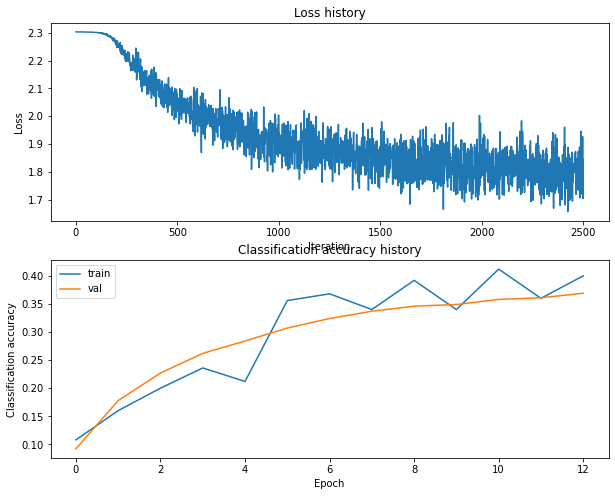

Training network with h_s 100, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.302969
iteration 100 / 2500: loss 1.966550
iteration 200 / 2500: loss 1.858798
iteration 300 / 2500: loss 1.693180
iteration 400 / 2500: loss 1.710510
iteration 500 / 2500: loss 1.760475
iteration 600 / 2500: loss 1.675681
iteration 700 / 2500: loss 1.646275
iteration 800 / 2500: loss 1.614201
iteration 900 / 2500: loss 1.592048
iteration 1000 / 2500: loss 1.663812
iteration 1100 / 2500: loss 1.669899
iteration 1200 / 2500: loss 1.782088
iteration 1300 / 2500: loss 1.593323
iteration 1400 / 2500: loss 1.732011
iteration 1500 / 2500: loss 1.656720
iteration 1600 / 2500: loss 1.486293
iteration 1700 / 2500: loss 1.676363
iteration 1800 / 2500: loss 1.600900
iteration 1900 / 2500: loss 1.663943
iteration 2000 / 2500: loss 1.624026
iteration 2100 / 2500: loss 1.626149
iteration 2200 / 2500: loss 1.585973
iteration 2300 / 2500: loss 1.640667
iteration 2400 / 2500: loss 1.645615
Validation accuracy:  0.4


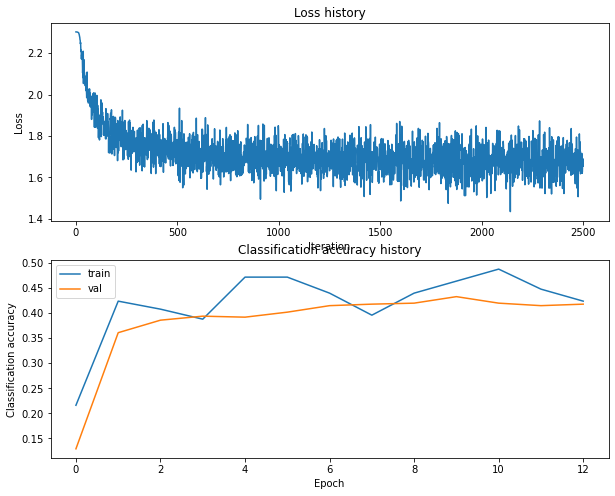

Training network with h_s 100, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.302955
iteration 100 / 2500: loss 2.301146
iteration 200 / 2500: loss 2.259159
iteration 300 / 2500: loss 2.134749
iteration 400 / 2500: loss 2.107961
iteration 500 / 2500: loss 2.031024
iteration 600 / 2500: loss 1.992865
iteration 700 / 2500: loss 1.991885
iteration 800 / 2500: loss 1.982848
iteration 900 / 2500: loss 1.899020
iteration 1000 / 2500: loss 1.873132
iteration 1100 / 2500: loss 1.884713
iteration 1200 / 2500: loss 1.861544
iteration 1300 / 2500: loss 1.888167
iteration 1400 / 2500: loss 1.780277
iteration 1500 / 2500: loss 1.767866
iteration 1600 / 2500: loss 1.829491
iteration 1700 / 2500: loss 1.781656
iteration 1800 / 2500: loss 1.804909
iteration 1900 / 2500: loss 1.806771
iteration 2000 / 2500: loss 1.813063
iteration 2100 / 2500: loss 1.777784
iteration 2200 / 2500: loss 1.729294
iteration 2300 / 2500: loss 1.718616
iteration 2400 / 2500: loss 1.682189
Validation accuracy:  0.39

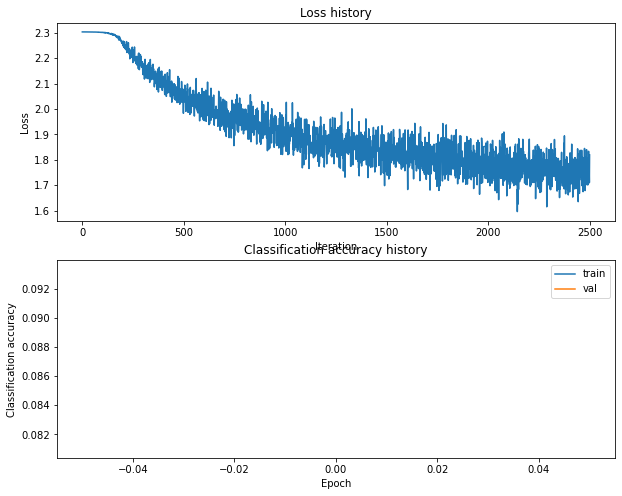

Training network with h_s 100, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.302927
iteration 100 / 2500: loss 1.900887
iteration 200 / 2500: loss 1.707667
iteration 300 / 2500: loss 1.691053
iteration 400 / 2500: loss 1.688624
iteration 500 / 2500: loss 1.743693
iteration 600 / 2500: loss 1.699923
iteration 700 / 2500: loss 1.708043
iteration 800 / 2500: loss 1.646583
iteration 900 / 2500: loss 1.687631
iteration 1000 / 2500: loss 1.670042
iteration 1100 / 2500: loss 1.745626
iteration 1200 / 2500: loss 1.678614
iteration 1300 / 2500: loss 1.788164
iteration 1400 / 2500: loss 1.754789
iteration 1500 / 2500: loss 1.592688
iteration 1600 / 2500: loss 1.679903
iteration 1700 / 2500: loss 1.750295
iteration 1800 / 2500: loss 1.648719
iteration 1900 / 2500: loss 1.670525
iteration 2000 / 2500: loss 1.744191
iteration 2100 / 2500: loss 1.856689
iteration 2200 / 2500: loss 1.704839
iteration 2300 / 2500: loss 1.711256
iteration 2400 / 2500: loss 1.781151
Validation accuracy:  0.41


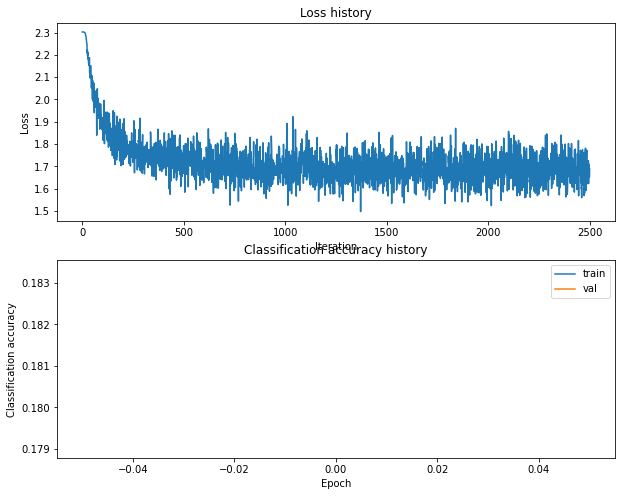

Training network with h_s 100, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.302953
iteration 100 / 2500: loss 2.300890
iteration 200 / 2500: loss 2.265701
iteration 300 / 2500: loss 2.173042
iteration 400 / 2500: loss 2.086692
iteration 500 / 2500: loss 2.075706
iteration 600 / 2500: loss 2.040023
iteration 700 / 2500: loss 2.000968
iteration 800 / 2500: loss 1.977603
iteration 900 / 2500: loss 1.930103
iteration 1000 / 2500: loss 1.984555
iteration 1100 / 2500: loss 1.894128
iteration 1200 / 2500: loss 1.887086
iteration 1300 / 2500: loss 1.904230
iteration 1400 / 2500: loss 1.894258
iteration 1500 / 2500: loss 1.858816
iteration 1600 / 2500: loss 1.868543
iteration 1700 / 2500: loss 1.861126
iteration 1800 / 2500: loss 1.898337
iteration 1900 / 2500: loss 1.846028
iteration 2000 / 2500: loss 1.938100
iteration 2100 / 2500: loss 1.865094
iteration 2200 / 2500: loss 1.815306
iteration 2300 / 2500: loss 1.832565
iteration 2400 / 2500: loss 1.765740
Validation accuracy:  0.34

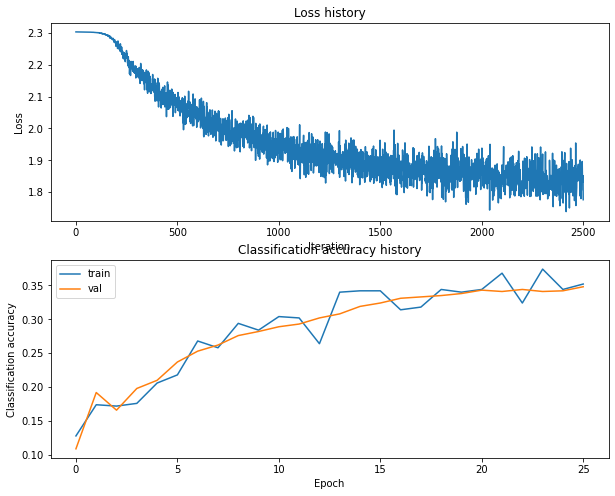

Training network with h_s 100, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.302945
iteration 100 / 2500: loss 1.842036
iteration 200 / 2500: loss 1.746244
iteration 300 / 2500: loss 1.722214
iteration 400 / 2500: loss 1.756765
iteration 500 / 2500: loss 1.756533
iteration 600 / 2500: loss 1.614429
iteration 700 / 2500: loss 1.670599
iteration 800 / 2500: loss 1.677678
iteration 900 / 2500: loss 1.707908
iteration 1000 / 2500: loss 1.596410
iteration 1100 / 2500: loss 1.652112
iteration 1200 / 2500: loss 1.665616
iteration 1300 / 2500: loss 1.663481
iteration 1400 / 2500: loss 1.627882
iteration 1500 / 2500: loss 1.620841
iteration 1600 / 2500: loss 1.714975
iteration 1700 / 2500: loss 1.709544
iteration 1800 / 2500: loss 1.672360
iteration 1900 / 2500: loss 1.669932
iteration 2000 / 2500: loss 1.643837
iteration 2100 / 2500: loss 1.632052
iteration 2200 / 2500: loss 1.678464
iteration 2300 / 2500: loss 1.716646
iteration 2400 / 2500: loss 1.576327
Validation accuracy:  0.413

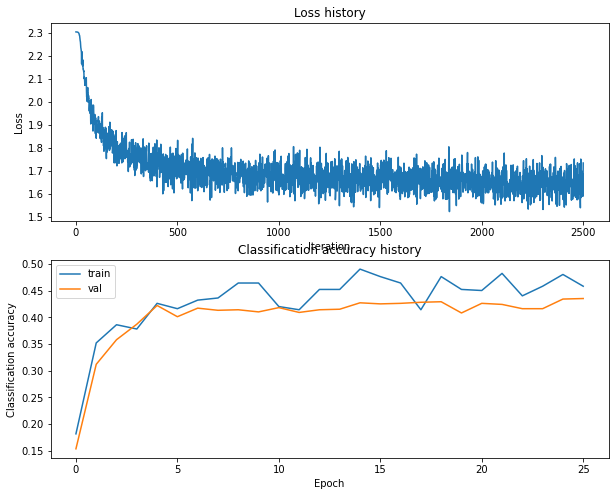

Training network with h_s 100, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.302943
iteration 100 / 5000: loss 2.300321
iteration 200 / 5000: loss 2.260055
iteration 300 / 5000: loss 2.148308
iteration 400 / 5000: loss 2.084666
iteration 500 / 5000: loss 2.049460
iteration 600 / 5000: loss 2.021166
iteration 700 / 5000: loss 1.963634
iteration 800 / 5000: loss 1.880209
iteration 900 / 5000: loss 1.754425
iteration 1000 / 5000: loss 1.792077
iteration 1100 / 5000: loss 1.897029
iteration 1200 / 5000: loss 1.925117
iteration 1300 / 5000: loss 1.944466
iteration 1400 / 5000: loss 1.804653
iteration 1500 / 5000: loss 1.840193
iteration 1600 / 5000: loss 1.845045
iteration 1700 / 5000: loss 1.764343
iteration 1800 / 5000: loss 1.677369
iteration 1900 / 5000: loss 1.825948
iteration 2000 / 5000: loss 1.647731
iteration 2100 / 5000: loss 1.809571
iteration 2200 / 5000: loss 1.716751
iteration 2300 / 5000: loss 1.769740
iteration 2400 / 5000: loss 1.796759
iteration 2500 / 5000: los

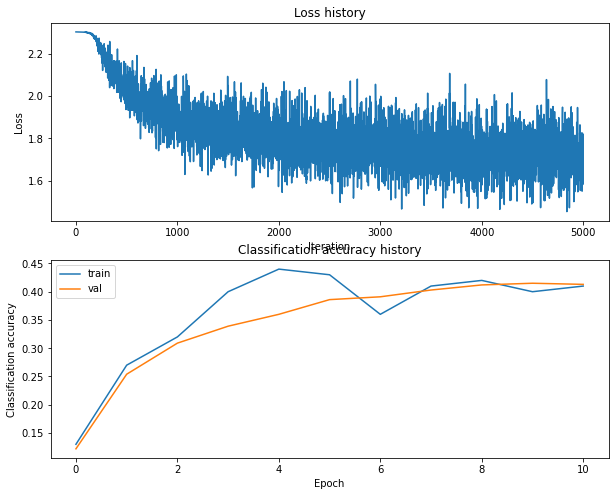

Training network with h_s 100, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.303003
iteration 100 / 5000: loss 2.022653
iteration 200 / 5000: loss 1.663610
iteration 300 / 5000: loss 1.993436
iteration 400 / 5000: loss 1.686871
iteration 500 / 5000: loss 1.759725
iteration 600 / 5000: loss 1.702318
iteration 700 / 5000: loss 1.863221
iteration 800 / 5000: loss 1.631282
iteration 900 / 5000: loss 1.679306
iteration 1000 / 5000: loss 1.753215
iteration 1100 / 5000: loss 1.787167
iteration 1200 / 5000: loss 1.783625
iteration 1300 / 5000: loss 1.911657
iteration 1400 / 5000: loss 1.736956
iteration 1500 / 5000: loss 1.954978
iteration 1600 / 5000: loss 1.506953
iteration 1700 / 5000: loss 1.676044
iteration 1800 / 5000: loss 1.800985
iteration 1900 / 5000: loss 1.998208
iteration 2000 / 5000: loss 1.678550
iteration 2100 / 5000: loss 1.803693
iteration 2200 / 5000: loss 1.714128
iteration 2300 / 5000: loss 1.682172
iteration 2400 / 5000: loss 1.677855
iteration 2500 / 5000: loss

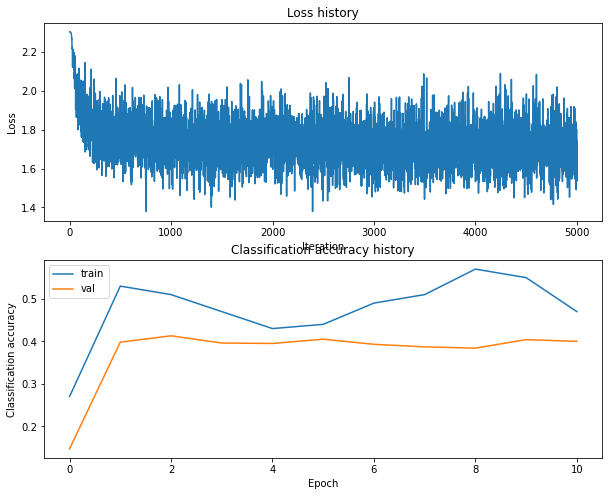

Training network with h_s 100, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.302981
iteration 100 / 5000: loss 2.300725
iteration 200 / 5000: loss 2.253548
iteration 300 / 5000: loss 2.142562
iteration 400 / 5000: loss 2.124810
iteration 500 / 5000: loss 2.093571
iteration 600 / 5000: loss 1.955221
iteration 700 / 5000: loss 1.983904
iteration 800 / 5000: loss 1.923468
iteration 900 / 5000: loss 1.969457
iteration 1000 / 5000: loss 1.875959
iteration 1100 / 5000: loss 1.876030
iteration 1200 / 5000: loss 1.873682
iteration 1300 / 5000: loss 1.833582
iteration 1400 / 5000: loss 1.787861
iteration 1500 / 5000: loss 1.776782
iteration 1600 / 5000: loss 1.885918
iteration 1700 / 5000: loss 1.776691
iteration 1800 / 5000: loss 1.813841
iteration 1900 / 5000: loss 1.733751
iteration 2000 / 5000: loss 1.770915
iteration 2100 / 5000: loss 1.737461
iteration 2200 / 5000: loss 1.782260
iteration 2300 / 5000: loss 1.818106
iteration 2400 / 5000: loss 1.902653
iteration 2500 / 5000: los

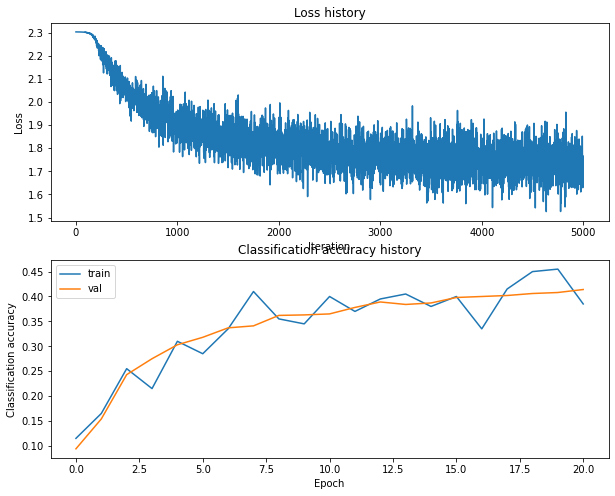

Training network with h_s 100, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.302981
iteration 100 / 5000: loss 1.897271
iteration 200 / 5000: loss 1.745646
iteration 300 / 5000: loss 1.678378
iteration 400 / 5000: loss 1.833418
iteration 500 / 5000: loss 1.720314
iteration 600 / 5000: loss 1.718141
iteration 700 / 5000: loss 1.683918
iteration 800 / 5000: loss 1.749254
iteration 900 / 5000: loss 1.586088
iteration 1000 / 5000: loss 1.723265
iteration 1100 / 5000: loss 1.605253
iteration 1200 / 5000: loss 1.717396
iteration 1300 / 5000: loss 1.700403
iteration 1400 / 5000: loss 1.547263
iteration 1500 / 5000: loss 1.748307
iteration 1600 / 5000: loss 1.597751
iteration 1700 / 5000: loss 1.793810
iteration 1800 / 5000: loss 1.678022
iteration 1900 / 5000: loss 1.667480
iteration 2000 / 5000: loss 1.758245
iteration 2100 / 5000: loss 1.715053
iteration 2200 / 5000: loss 1.697510
iteration 2300 / 5000: loss 1.650641
iteration 2400 / 5000: loss 1.686778
iteration 2500 / 5000: loss

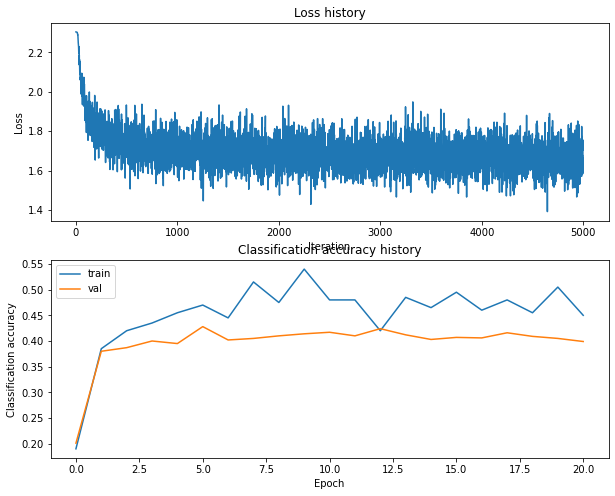

Training network with h_s 100, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.302980
iteration 100 / 5000: loss 2.299904
iteration 200 / 5000: loss 2.278744
iteration 300 / 5000: loss 2.116318
iteration 400 / 5000: loss 2.096352
iteration 500 / 5000: loss 2.070203
iteration 600 / 5000: loss 2.051360
iteration 700 / 5000: loss 2.071589
iteration 800 / 5000: loss 1.955723
iteration 900 / 5000: loss 1.986687
iteration 1000 / 5000: loss 2.019127
iteration 1100 / 5000: loss 1.869435
iteration 1200 / 5000: loss 1.938712
iteration 1300 / 5000: loss 1.876153
iteration 1400 / 5000: loss 1.958273
iteration 1500 / 5000: loss 1.929772
iteration 1600 / 5000: loss 1.812551
iteration 1700 / 5000: loss 1.820712
iteration 1800 / 5000: loss 1.804111
iteration 1900 / 5000: loss 1.739886
iteration 2000 / 5000: loss 1.771768
iteration 2100 / 5000: loss 1.846847
iteration 2200 / 5000: loss 1.817359
iteration 2300 / 5000: loss 1.756706
iteration 2400 / 5000: loss 1.769152
iteration 2500 / 5000: los

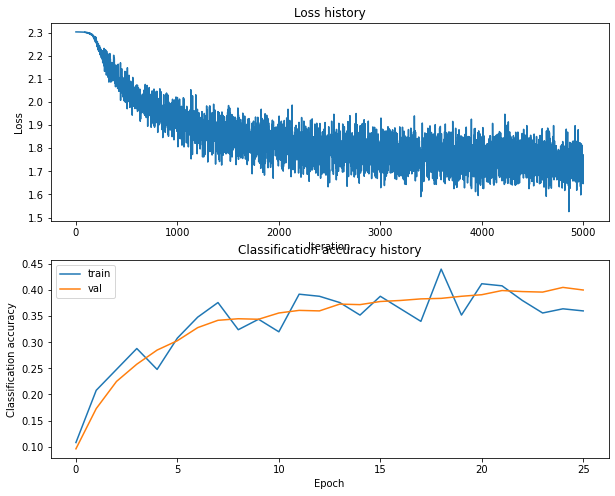

Training network with h_s 100, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.302966
iteration 100 / 5000: loss 1.899558
iteration 200 / 5000: loss 1.825776
iteration 300 / 5000: loss 1.799224
iteration 400 / 5000: loss 1.761587
iteration 500 / 5000: loss 1.754446
iteration 600 / 5000: loss 1.723826
iteration 700 / 5000: loss 1.688755
iteration 800 / 5000: loss 1.676181
iteration 900 / 5000: loss 1.770990
iteration 1000 / 5000: loss 1.754974
iteration 1100 / 5000: loss 1.701913
iteration 1200 / 5000: loss 1.682386
iteration 1300 / 5000: loss 1.684148
iteration 1400 / 5000: loss 1.800556
iteration 1500 / 5000: loss 1.628578
iteration 1600 / 5000: loss 1.661881
iteration 1700 / 5000: loss 1.809807
iteration 1800 / 5000: loss 1.605524
iteration 1900 / 5000: loss 1.573282
iteration 2000 / 5000: loss 1.610478
iteration 2100 / 5000: loss 1.646083
iteration 2200 / 5000: loss 1.664897
iteration 2300 / 5000: loss 1.644159
iteration 2400 / 5000: loss 1.666056
iteration 2500 / 5000: loss

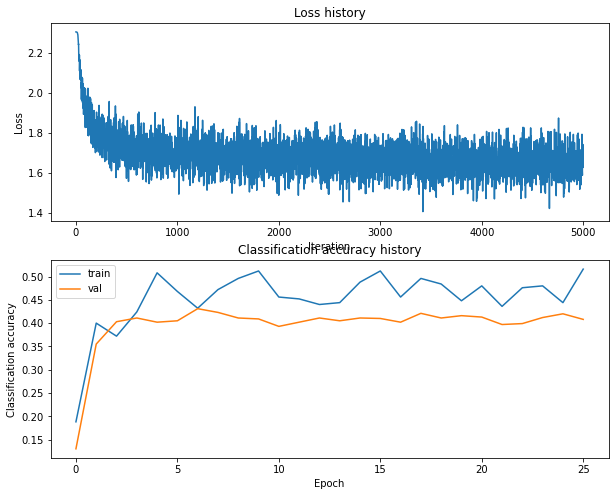

Training network with h_s 100, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.302970
iteration 100 / 5000: loss 2.300178
iteration 200 / 5000: loss 2.257574
iteration 300 / 5000: loss 2.183112
iteration 400 / 5000: loss 2.138182
iteration 500 / 5000: loss 2.002366
iteration 600 / 5000: loss 1.949288
iteration 700 / 5000: loss 1.940882
iteration 800 / 5000: loss 1.934529
iteration 900 / 5000: loss 1.933154
iteration 1000 / 5000: loss 1.848264
iteration 1100 / 5000: loss 1.872486
iteration 1200 / 5000: loss 1.801608
iteration 1300 / 5000: loss 1.873299
iteration 1400 / 5000: loss 1.919198
iteration 1500 / 5000: loss 1.810375
iteration 1600 / 5000: loss 1.855913
iteration 1700 / 5000: loss 1.839909
iteration 1800 / 5000: loss 1.827140
iteration 1900 / 5000: loss 1.824193
iteration 2000 / 5000: loss 1.866459
iteration 2100 / 5000: loss 1.815119
iteration 2200 / 5000: loss 1.741309
iteration 2300 / 5000: loss 1.734927
iteration 2400 / 5000: loss 1.711061
iteration 2500 / 5000: los

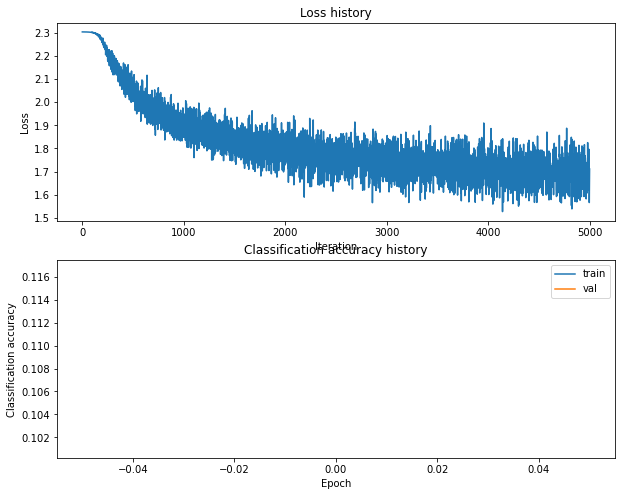

Training network with h_s 100, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.302979
iteration 100 / 5000: loss 1.901517
iteration 200 / 5000: loss 1.847547
iteration 300 / 5000: loss 1.635909
iteration 400 / 5000: loss 1.661166
iteration 500 / 5000: loss 1.822594
iteration 600 / 5000: loss 1.764931
iteration 700 / 5000: loss 1.704735
iteration 800 / 5000: loss 1.639172
iteration 900 / 5000: loss 1.731338
iteration 1000 / 5000: loss 1.811035
iteration 1100 / 5000: loss 1.616911
iteration 1200 / 5000: loss 1.757289
iteration 1300 / 5000: loss 1.735215
iteration 1400 / 5000: loss 1.729290
iteration 1500 / 5000: loss 1.671988
iteration 1600 / 5000: loss 1.661859
iteration 1700 / 5000: loss 1.658984
iteration 1800 / 5000: loss 1.640281
iteration 1900 / 5000: loss 1.623383
iteration 2000 / 5000: loss 1.676704
iteration 2100 / 5000: loss 1.594657
iteration 2200 / 5000: loss 1.560425
iteration 2300 / 5000: loss 1.607459
iteration 2400 / 5000: loss 1.740361
iteration 2500 / 5000: loss

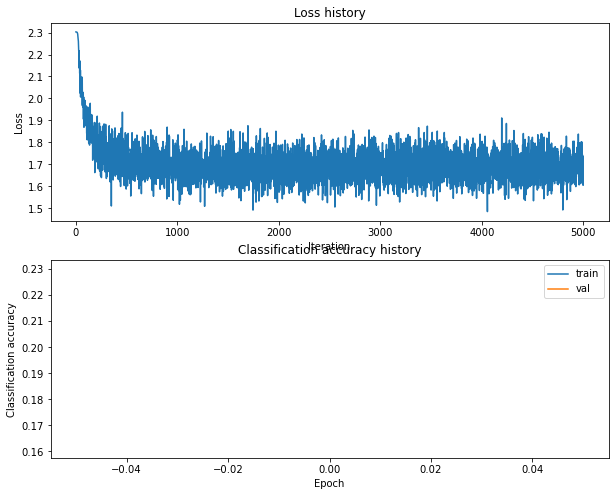

Training network with h_s 100, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.302994
iteration 100 / 5000: loss 2.301090
iteration 200 / 5000: loss 2.279413
iteration 300 / 5000: loss 2.171232
iteration 400 / 5000: loss 2.094903
iteration 500 / 5000: loss 2.053173
iteration 600 / 5000: loss 2.007104
iteration 700 / 5000: loss 1.972267
iteration 800 / 5000: loss 2.000658
iteration 900 / 5000: loss 1.933460
iteration 1000 / 5000: loss 1.887370
iteration 1100 / 5000: loss 1.927911
iteration 1200 / 5000: loss 1.925128
iteration 1300 / 5000: loss 1.876893
iteration 1400 / 5000: loss 1.898158
iteration 1500 / 5000: loss 1.877467
iteration 1600 / 5000: loss 1.881132
iteration 1700 / 5000: loss 1.867950
iteration 1800 / 5000: loss 1.836266
iteration 1900 / 5000: loss 1.815106
iteration 2000 / 5000: loss 1.842920
iteration 2100 / 5000: loss 1.880317
iteration 2200 / 5000: loss 1.838150
iteration 2300 / 5000: loss 1.802414
iteration 2400 / 5000: loss 1.832090
iteration 2500 / 5000: los

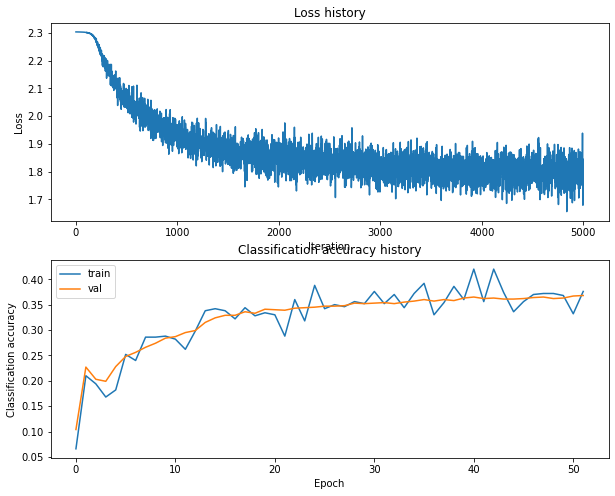

Training network with h_s 100, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.302966
iteration 100 / 5000: loss 1.901093
iteration 200 / 5000: loss 1.811835
iteration 300 / 5000: loss 1.724123
iteration 400 / 5000: loss 1.670873
iteration 500 / 5000: loss 1.645454
iteration 600 / 5000: loss 1.758466
iteration 700 / 5000: loss 1.720426
iteration 800 / 5000: loss 1.650536
iteration 900 / 5000: loss 1.688314
iteration 1000 / 5000: loss 1.624951
iteration 1100 / 5000: loss 1.699003
iteration 1200 / 5000: loss 1.718714
iteration 1300 / 5000: loss 1.647358
iteration 1400 / 5000: loss 1.688732
iteration 1500 / 5000: loss 1.564862
iteration 1600 / 5000: loss 1.609227
iteration 1700 / 5000: loss 1.630371
iteration 1800 / 5000: loss 1.713299
iteration 1900 / 5000: loss 1.692695
iteration 2000 / 5000: loss 1.665439
iteration 2100 / 5000: loss 1.617174
iteration 2200 / 5000: loss 1.600924
iteration 2300 / 5000: loss 1.667286
iteration 2400 / 5000: loss 1.668102
iteration 2500 / 5000: loss

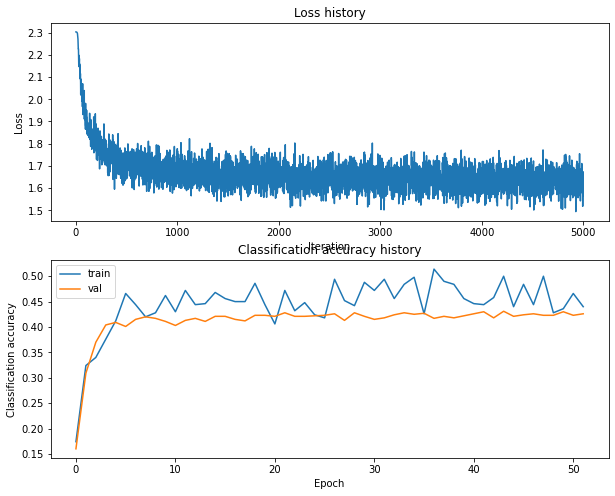

Training network with h_s 100, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.302978
iteration 100 / 10000: loss 2.301324
iteration 200 / 10000: loss 2.277141
iteration 300 / 10000: loss 2.252812
iteration 400 / 10000: loss 2.083717
iteration 500 / 10000: loss 2.087465
iteration 600 / 10000: loss 2.031434
iteration 700 / 10000: loss 1.972656
iteration 800 / 10000: loss 1.980364
iteration 900 / 10000: loss 1.900699
iteration 1000 / 10000: loss 1.866692
iteration 1100 / 10000: loss 1.827669
iteration 1200 / 10000: loss 1.938817
iteration 1300 / 10000: loss 1.946701
iteration 1400 / 10000: loss 1.820685
iteration 1500 / 10000: loss 1.720761
iteration 1600 / 10000: loss 1.859384
iteration 1700 / 10000: loss 1.828698
iteration 1800 / 10000: loss 1.809913
iteration 1900 / 10000: loss 1.926451
iteration 2000 / 10000: loss 1.828435
iteration 2100 / 10000: loss 1.733579
iteration 2200 / 10000: loss 1.684774
iteration 2300 / 10000: loss 1.725467
iteration 2400 / 10000: loss 1.764191


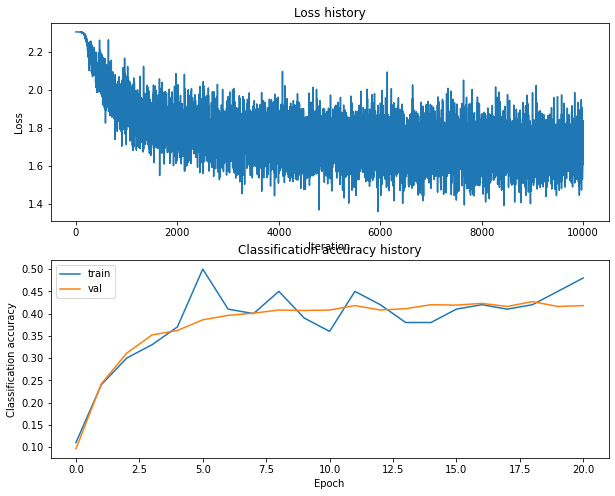

Training network with h_s 100, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.302993
iteration 100 / 10000: loss 1.975830
iteration 200 / 10000: loss 1.677102
iteration 300 / 10000: loss 1.855411
iteration 400 / 10000: loss 2.010550
iteration 500 / 10000: loss 1.749313
iteration 600 / 10000: loss 1.791308
iteration 700 / 10000: loss 1.863316
iteration 800 / 10000: loss 1.668777
iteration 900 / 10000: loss 1.777918
iteration 1000 / 10000: loss 1.684497
iteration 1100 / 10000: loss 1.815627
iteration 1200 / 10000: loss 1.585203
iteration 1300 / 10000: loss 1.786069
iteration 1400 / 10000: loss 1.809672
iteration 1500 / 10000: loss 1.762390
iteration 1600 / 10000: loss 1.664339
iteration 1700 / 10000: loss 1.743284
iteration 1800 / 10000: loss 1.826871
iteration 1900 / 10000: loss 1.577598
iteration 2000 / 10000: loss 1.659550
iteration 2100 / 10000: loss 1.668210
iteration 2200 / 10000: loss 1.761164
iteration 2300 / 10000: loss 1.756519
iteration 2400 / 10000: loss 1.684851
i

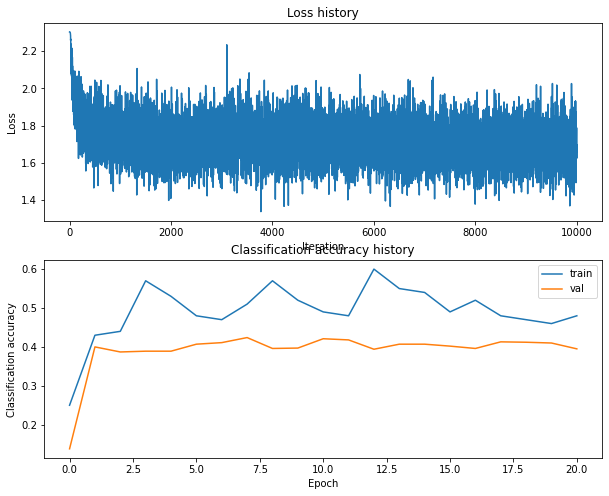

Training network with h_s 100, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.302962
iteration 100 / 10000: loss 2.300503
iteration 200 / 10000: loss 2.270103
iteration 300 / 10000: loss 2.173854
iteration 400 / 10000: loss 2.151992
iteration 500 / 10000: loss 2.075157
iteration 600 / 10000: loss 1.954395
iteration 700 / 10000: loss 1.985533
iteration 800 / 10000: loss 1.892337
iteration 900 / 10000: loss 2.024517
iteration 1000 / 10000: loss 1.926647
iteration 1100 / 10000: loss 1.833674
iteration 1200 / 10000: loss 1.758493
iteration 1300 / 10000: loss 1.847505
iteration 1400 / 10000: loss 1.963901
iteration 1500 / 10000: loss 1.908644
iteration 1600 / 10000: loss 1.814739
iteration 1700 / 10000: loss 1.937046
iteration 1800 / 10000: loss 1.805210
iteration 1900 / 10000: loss 1.909188
iteration 2000 / 10000: loss 1.841823
iteration 2100 / 10000: loss 1.800331
iteration 2200 / 10000: loss 1.844286
iteration 2300 / 10000: loss 1.747649
iteration 2400 / 10000: loss 1.852117


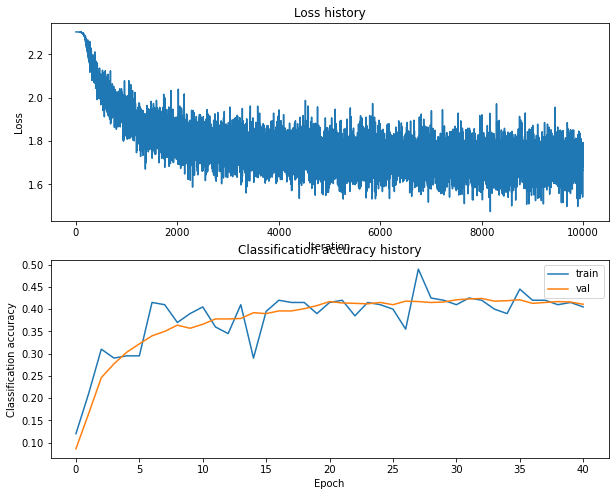

Training network with h_s 100, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.303021
iteration 100 / 10000: loss 1.913291
iteration 200 / 10000: loss 1.775915
iteration 300 / 10000: loss 1.761767
iteration 400 / 10000: loss 1.768277
iteration 500 / 10000: loss 1.725274
iteration 600 / 10000: loss 1.792750
iteration 700 / 10000: loss 1.790331
iteration 800 / 10000: loss 1.733907
iteration 900 / 10000: loss 1.729615
iteration 1000 / 10000: loss 1.574260
iteration 1100 / 10000: loss 1.719461
iteration 1200 / 10000: loss 1.565151
iteration 1300 / 10000: loss 1.787930
iteration 1400 / 10000: loss 1.718513
iteration 1500 / 10000: loss 1.729054
iteration 1600 / 10000: loss 1.765390
iteration 1700 / 10000: loss 1.779465
iteration 1800 / 10000: loss 1.574953
iteration 1900 / 10000: loss 1.683294
iteration 2000 / 10000: loss 1.760211
iteration 2100 / 10000: loss 1.624323
iteration 2200 / 10000: loss 1.627547
iteration 2300 / 10000: loss 1.835153
iteration 2400 / 10000: loss 1.716203
i

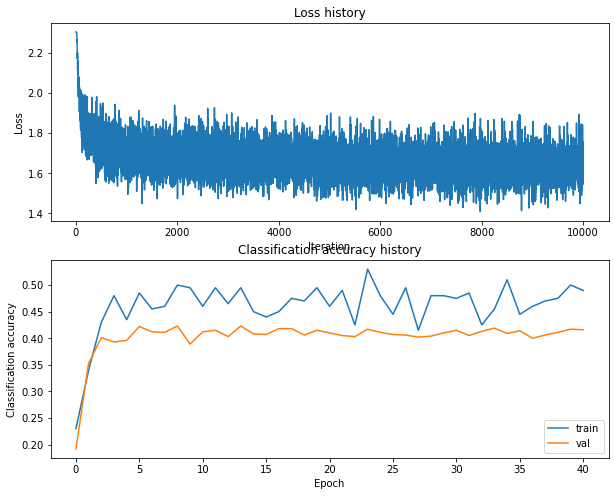

Training network with h_s 100, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.302975
iteration 100 / 10000: loss 2.300901
iteration 200 / 10000: loss 2.270296
iteration 300 / 10000: loss 2.191605
iteration 400 / 10000: loss 2.070248
iteration 500 / 10000: loss 2.048697
iteration 600 / 10000: loss 2.018827
iteration 700 / 10000: loss 1.908036
iteration 800 / 10000: loss 2.012997
iteration 900 / 10000: loss 1.985450
iteration 1000 / 10000: loss 1.928355
iteration 1100 / 10000: loss 1.909296
iteration 1200 / 10000: loss 1.852012
iteration 1300 / 10000: loss 1.810337
iteration 1400 / 10000: loss 1.767982
iteration 1500 / 10000: loss 1.858104
iteration 1600 / 10000: loss 1.803281
iteration 1700 / 10000: loss 1.859194
iteration 1800 / 10000: loss 1.681713
iteration 1900 / 10000: loss 1.749159
iteration 2000 / 10000: loss 1.802998
iteration 2100 / 10000: loss 1.822009
iteration 2200 / 10000: loss 1.776451
iteration 2300 / 10000: loss 1.792315
iteration 2400 / 10000: loss 1.819095


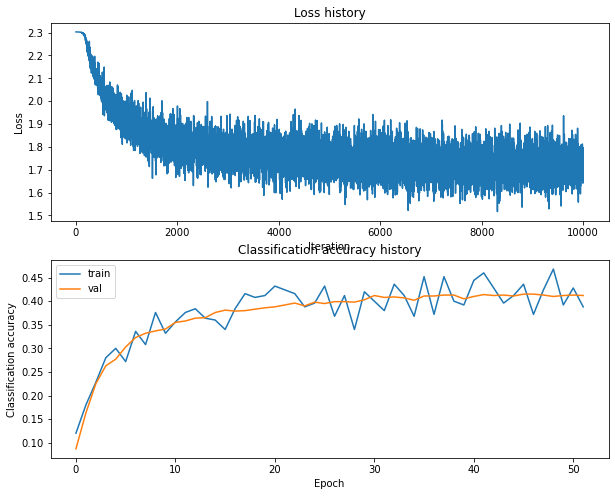

Training network with h_s 100, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.302921
iteration 100 / 10000: loss 1.873044
iteration 200 / 10000: loss 1.721593
iteration 300 / 10000: loss 1.798103
iteration 400 / 10000: loss 1.768870
iteration 500 / 10000: loss 1.777712
iteration 600 / 10000: loss 1.666449
iteration 700 / 10000: loss 1.639502
iteration 800 / 10000: loss 1.626100
iteration 900 / 10000: loss 1.681853
iteration 1000 / 10000: loss 1.831245
iteration 1100 / 10000: loss 1.784732
iteration 1200 / 10000: loss 1.787290
iteration 1300 / 10000: loss 1.667792
iteration 1400 / 10000: loss 1.739146
iteration 1500 / 10000: loss 1.687436
iteration 1600 / 10000: loss 1.755902
iteration 1700 / 10000: loss 1.596409
iteration 1800 / 10000: loss 1.625133
iteration 1900 / 10000: loss 1.642011
iteration 2000 / 10000: loss 1.610567
iteration 2100 / 10000: loss 1.608871
iteration 2200 / 10000: loss 1.692858
iteration 2300 / 10000: loss 1.670032
iteration 2400 / 10000: loss 1.650153
i

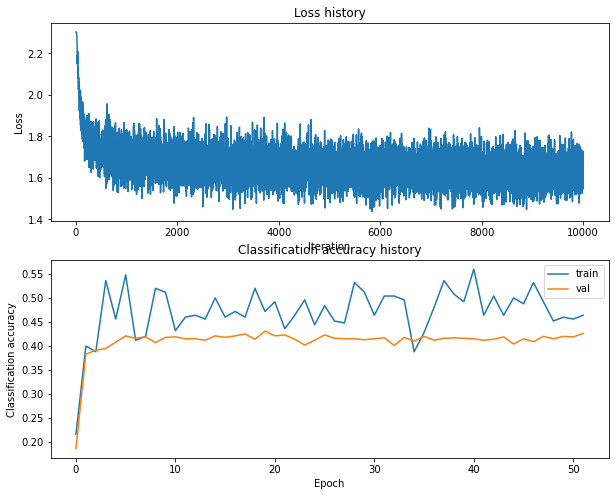

Training network with h_s 100, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.302939
iteration 100 / 10000: loss 2.301036
iteration 200 / 10000: loss 2.259406
iteration 300 / 10000: loss 2.202635
iteration 400 / 10000: loss 2.080654
iteration 500 / 10000: loss 2.057818
iteration 600 / 10000: loss 2.027734
iteration 700 / 10000: loss 1.931459
iteration 800 / 10000: loss 2.002869
iteration 900 / 10000: loss 2.028743
iteration 1000 / 10000: loss 1.987078
iteration 1100 / 10000: loss 1.939891
iteration 1200 / 10000: loss 1.908429
iteration 1300 / 10000: loss 1.873968
iteration 1400 / 10000: loss 1.839249
iteration 1500 / 10000: loss 1.938897
iteration 1600 / 10000: loss 1.865196
iteration 1700 / 10000: loss 1.757983
iteration 1800 / 10000: loss 1.746704
iteration 1900 / 10000: loss 1.743546
iteration 2000 / 10000: loss 1.757692
iteration 2100 / 10000: loss 1.761774
iteration 2200 / 10000: loss 1.773767
iteration 2300 / 10000: loss 1.779265
iteration 2400 / 10000: loss 1.739711


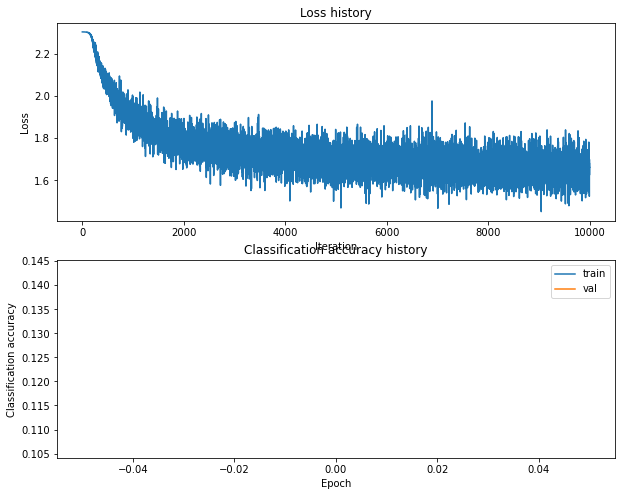

Training network with h_s 100, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.302951
iteration 100 / 10000: loss 1.912559
iteration 200 / 10000: loss 1.889359
iteration 300 / 10000: loss 1.732566
iteration 400 / 10000: loss 1.707789
iteration 500 / 10000: loss 1.664204
iteration 600 / 10000: loss 1.784869
iteration 700 / 10000: loss 1.831428
iteration 800 / 10000: loss 1.679194
iteration 900 / 10000: loss 1.695398
iteration 1000 / 10000: loss 1.643613
iteration 1100 / 10000: loss 1.723897
iteration 1200 / 10000: loss 1.759742
iteration 1300 / 10000: loss 1.719102
iteration 1400 / 10000: loss 1.723380
iteration 1500 / 10000: loss 1.594276
iteration 1600 / 10000: loss 1.659562
iteration 1700 / 10000: loss 1.558304
iteration 1800 / 10000: loss 1.821580
iteration 1900 / 10000: loss 1.654556
iteration 2000 / 10000: loss 1.704864
iteration 2100 / 10000: loss 1.818800
iteration 2200 / 10000: loss 1.637496
iteration 2300 / 10000: loss 1.653687
iteration 2400 / 10000: loss 1.670867
i

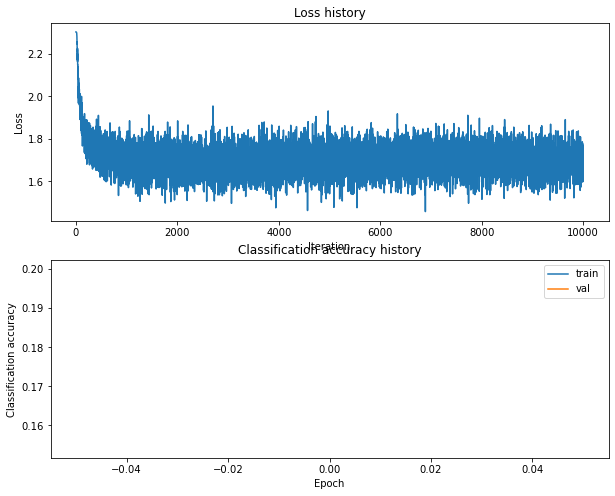

Training network with h_s 100, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.302951
iteration 100 / 10000: loss 2.301164
iteration 200 / 10000: loss 2.272970
iteration 300 / 10000: loss 2.193071
iteration 400 / 10000: loss 2.149337
iteration 500 / 10000: loss 2.027036
iteration 600 / 10000: loss 2.007849
iteration 700 / 10000: loss 2.031293
iteration 800 / 10000: loss 2.005222
iteration 900 / 10000: loss 1.944457
iteration 1000 / 10000: loss 1.928778
iteration 1100 / 10000: loss 1.955944
iteration 1200 / 10000: loss 1.958820
iteration 1300 / 10000: loss 1.948019
iteration 1400 / 10000: loss 1.892132
iteration 1500 / 10000: loss 1.929092
iteration 1600 / 10000: loss 1.879412
iteration 1700 / 10000: loss 1.865555
iteration 1800 / 10000: loss 1.888924
iteration 1900 / 10000: loss 1.855936
iteration 2000 / 10000: loss 1.840970
iteration 2100 / 10000: loss 1.878702
iteration 2200 / 10000: loss 1.831011
iteration 2300 / 10000: loss 1.841970
iteration 2400 / 10000: loss 1.792289


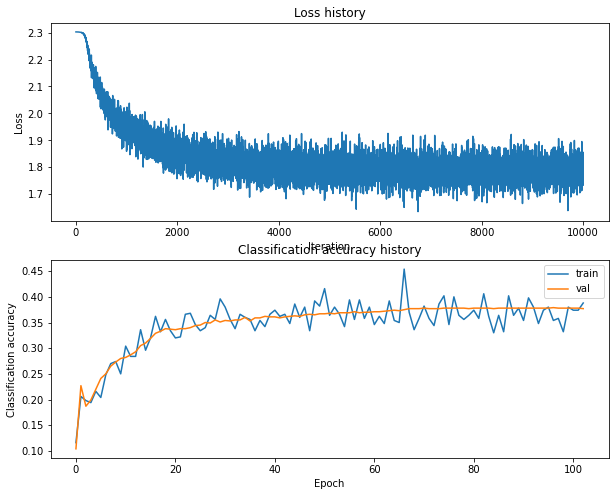

Training network with h_s 100, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.302996
iteration 100 / 10000: loss 1.951556
iteration 200 / 10000: loss 1.851976
iteration 300 / 10000: loss 1.725285
iteration 400 / 10000: loss 1.781189
iteration 500 / 10000: loss 1.695143
iteration 600 / 10000: loss 1.724701
iteration 700 / 10000: loss 1.676260
iteration 800 / 10000: loss 1.729541
iteration 900 / 10000: loss 1.676185
iteration 1000 / 10000: loss 1.730613
iteration 1100 / 10000: loss 1.663161
iteration 1200 / 10000: loss 1.649443
iteration 1300 / 10000: loss 1.712764
iteration 1400 / 10000: loss 1.762663
iteration 1500 / 10000: loss 1.601897
iteration 1600 / 10000: loss 1.688462
iteration 1700 / 10000: loss 1.690912
iteration 1800 / 10000: loss 1.591720
iteration 1900 / 10000: loss 1.680724
iteration 2000 / 10000: loss 1.703991
iteration 2100 / 10000: loss 1.690551
iteration 2200 / 10000: loss 1.645339
iteration 2300 / 10000: loss 1.663189
iteration 2400 / 10000: loss 1.678717
i

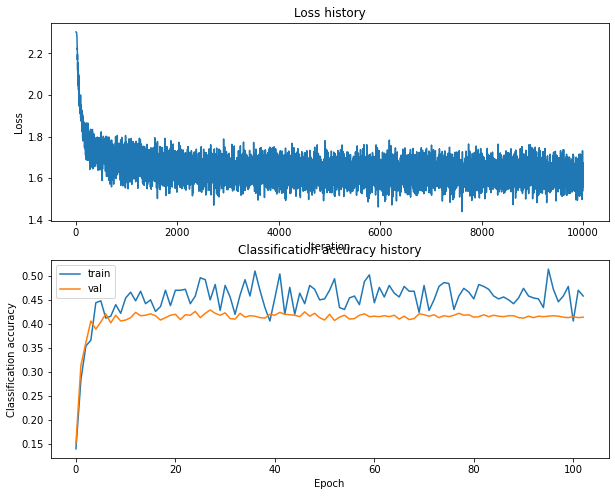

Training network with h_s 100, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.302991
iteration 100 / 15000: loss 2.300271
iteration 200 / 15000: loss 2.248866
iteration 300 / 15000: loss 2.219592
iteration 400 / 15000: loss 2.060761
iteration 500 / 15000: loss 1.904917
iteration 600 / 15000: loss 1.890909
iteration 700 / 15000: loss 1.996311
iteration 800 / 15000: loss 1.845411
iteration 900 / 15000: loss 1.828499
iteration 1000 / 15000: loss 1.904839
iteration 1100 / 15000: loss 1.838173
iteration 1200 / 15000: loss 1.852034
iteration 1300 / 15000: loss 1.790986
iteration 1400 / 15000: loss 1.966402
iteration 1500 / 15000: loss 1.864400
iteration 1600 / 15000: loss 1.852946
iteration 1700 / 15000: loss 1.767876
iteration 1800 / 15000: loss 1.821387
iteration 1900 / 15000: loss 1.736750
iteration 2000 / 15000: loss 1.904886
iteration 2100 / 15000: loss 1.771705
iteration 2200 / 15000: loss 1.796548
iteration 2300 / 15000: loss 1.784316
iteration 2400 / 15000: loss 1.740426


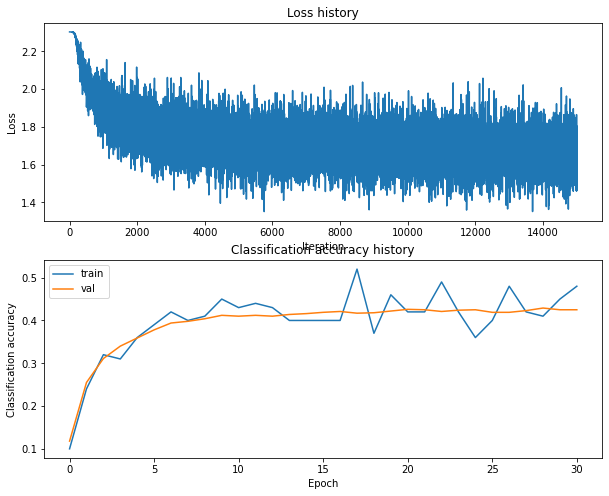

Training network with h_s 100, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.302987
iteration 100 / 15000: loss 2.048039
iteration 200 / 15000: loss 1.892380
iteration 300 / 15000: loss 1.932970
iteration 400 / 15000: loss 1.824809
iteration 500 / 15000: loss 1.794702
iteration 600 / 15000: loss 1.746532
iteration 700 / 15000: loss 1.755805
iteration 800 / 15000: loss 1.764600
iteration 900 / 15000: loss 1.820894
iteration 1000 / 15000: loss 1.797195
iteration 1100 / 15000: loss 1.619994
iteration 1200 / 15000: loss 1.881265
iteration 1300 / 15000: loss 1.764884
iteration 1400 / 15000: loss 1.804611
iteration 1500 / 15000: loss 1.745913
iteration 1600 / 15000: loss 1.807923
iteration 1700 / 15000: loss 1.705451
iteration 1800 / 15000: loss 1.750461
iteration 1900 / 15000: loss 1.664529
iteration 2000 / 15000: loss 1.622729
iteration 2100 / 15000: loss 1.674508
iteration 2200 / 15000: loss 1.782689
iteration 2300 / 15000: loss 1.614944
iteration 2400 / 15000: loss 1.673916
i

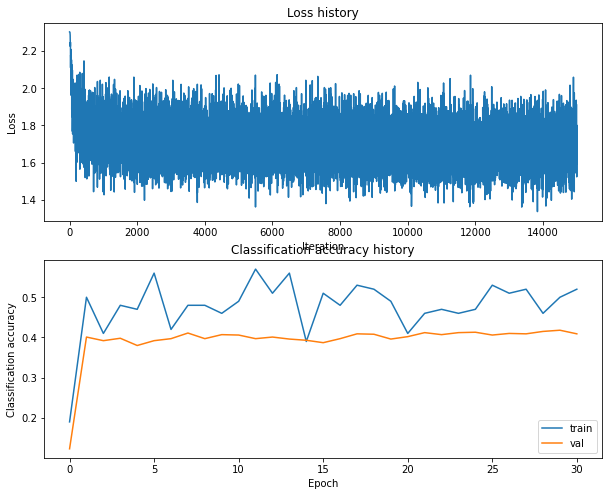

Training network with h_s 100, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.302996
iteration 100 / 15000: loss 2.301188
iteration 200 / 15000: loss 2.270466
iteration 300 / 15000: loss 2.173290
iteration 400 / 15000: loss 2.089670
iteration 500 / 15000: loss 2.120422
iteration 600 / 15000: loss 1.983889
iteration 700 / 15000: loss 2.042793
iteration 800 / 15000: loss 1.909477
iteration 900 / 15000: loss 1.883449
iteration 1000 / 15000: loss 1.768010
iteration 1100 / 15000: loss 1.804868
iteration 1200 / 15000: loss 1.892793
iteration 1300 / 15000: loss 1.814179
iteration 1400 / 15000: loss 1.873521
iteration 1500 / 15000: loss 1.859646
iteration 1600 / 15000: loss 1.801439
iteration 1700 / 15000: loss 1.881163
iteration 1800 / 15000: loss 1.804974
iteration 1900 / 15000: loss 1.820537
iteration 2000 / 15000: loss 1.703221
iteration 2100 / 15000: loss 1.803202
iteration 2200 / 15000: loss 1.821915
iteration 2300 / 15000: loss 1.683092
iteration 2400 / 15000: loss 1.692616


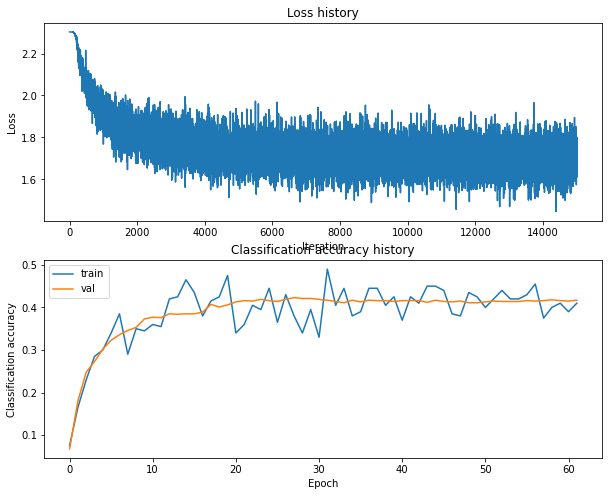

Training network with h_s 100, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.302979
iteration 100 / 15000: loss 1.973676
iteration 200 / 15000: loss 1.764049
iteration 300 / 15000: loss 1.739708
iteration 400 / 15000: loss 1.638785
iteration 500 / 15000: loss 1.725797
iteration 600 / 15000: loss 1.762571
iteration 700 / 15000: loss 1.716379
iteration 800 / 15000: loss 1.755103
iteration 900 / 15000: loss 1.670347
iteration 1000 / 15000: loss 1.727072
iteration 1100 / 15000: loss 1.776325
iteration 1200 / 15000: loss 1.646171
iteration 1300 / 15000: loss 1.678799
iteration 1400 / 15000: loss 1.656536
iteration 1500 / 15000: loss 1.816579
iteration 1600 / 15000: loss 1.720383
iteration 1700 / 15000: loss 1.908782
iteration 1800 / 15000: loss 1.652449
iteration 1900 / 15000: loss 1.686566
iteration 2000 / 15000: loss 1.655382
iteration 2100 / 15000: loss 1.702404
iteration 2200 / 15000: loss 1.516089
iteration 2300 / 15000: loss 1.677732
iteration 2400 / 15000: loss 1.672107
i

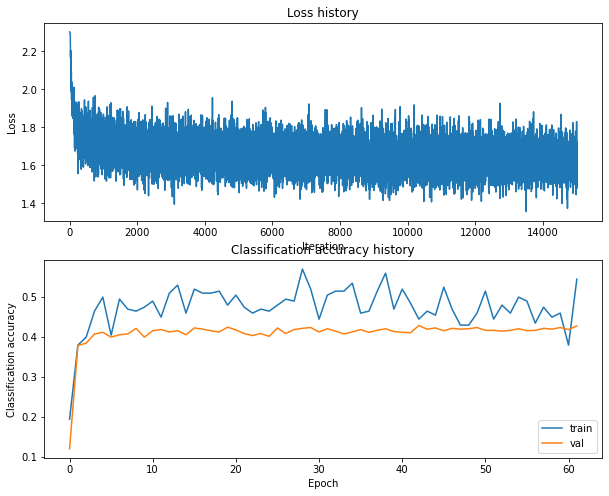

Training network with h_s 100, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.302979
iteration 100 / 15000: loss 2.301336
iteration 200 / 15000: loss 2.258800
iteration 300 / 15000: loss 2.149544
iteration 400 / 15000: loss 2.083034
iteration 500 / 15000: loss 2.095369
iteration 600 / 15000: loss 2.037835
iteration 700 / 15000: loss 2.031201
iteration 800 / 15000: loss 1.962674
iteration 900 / 15000: loss 1.948924
iteration 1000 / 15000: loss 1.917013
iteration 1100 / 15000: loss 1.795411
iteration 1200 / 15000: loss 1.912057
iteration 1300 / 15000: loss 1.903413
iteration 1400 / 15000: loss 1.850041
iteration 1500 / 15000: loss 1.870767
iteration 1600 / 15000: loss 1.804928
iteration 1700 / 15000: loss 1.885399
iteration 1800 / 15000: loss 1.932381
iteration 1900 / 15000: loss 1.715884
iteration 2000 / 15000: loss 1.771452
iteration 2100 / 15000: loss 1.777943
iteration 2200 / 15000: loss 1.747371
iteration 2300 / 15000: loss 1.746234
iteration 2400 / 15000: loss 1.835660


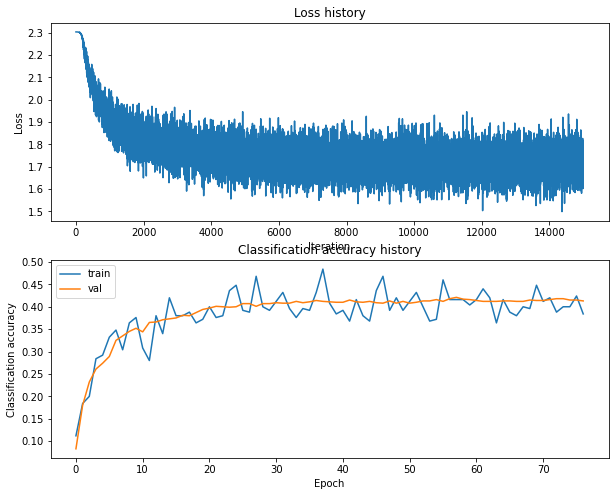

Training network with h_s 100, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.302956
iteration 100 / 15000: loss 1.871951
iteration 200 / 15000: loss 1.878704
iteration 300 / 15000: loss 1.807700
iteration 400 / 15000: loss 1.886474
iteration 500 / 15000: loss 1.693576
iteration 600 / 15000: loss 1.715421
iteration 700 / 15000: loss 1.699902
iteration 800 / 15000: loss 1.574907
iteration 900 / 15000: loss 1.627174
iteration 1000 / 15000: loss 1.712227
iteration 1100 / 15000: loss 1.730710
iteration 1200 / 15000: loss 1.665448
iteration 1300 / 15000: loss 1.712864
iteration 1400 / 15000: loss 1.675618
iteration 1500 / 15000: loss 1.685042
iteration 1600 / 15000: loss 1.737719
iteration 1700 / 15000: loss 1.687670
iteration 1800 / 15000: loss 1.592174
iteration 1900 / 15000: loss 1.577257
iteration 2000 / 15000: loss 1.626294
iteration 2100 / 15000: loss 1.705778
iteration 2200 / 15000: loss 1.721561
iteration 2300 / 15000: loss 1.767043
iteration 2400 / 15000: loss 1.755796
i

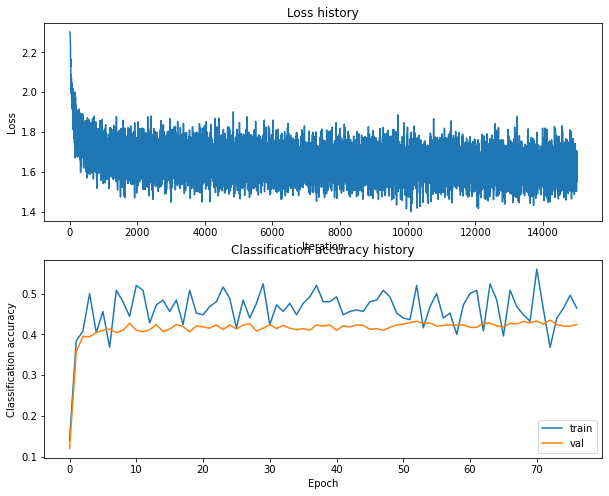

Training network with h_s 100, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.302984
iteration 100 / 15000: loss 2.301208
iteration 200 / 15000: loss 2.263683
iteration 300 / 15000: loss 2.170167
iteration 400 / 15000: loss 2.081963
iteration 500 / 15000: loss 2.057953
iteration 600 / 15000: loss 2.060442
iteration 700 / 15000: loss 1.985679
iteration 800 / 15000: loss 1.948655
iteration 900 / 15000: loss 1.984196
iteration 1000 / 15000: loss 1.933278
iteration 1100 / 15000: loss 1.884630
iteration 1200 / 15000: loss 1.890870
iteration 1300 / 15000: loss 1.820421
iteration 1400 / 15000: loss 1.828406
iteration 1500 / 15000: loss 1.764957
iteration 1600 / 15000: loss 1.788033
iteration 1700 / 15000: loss 1.798073
iteration 1800 / 15000: loss 1.895808
iteration 1900 / 15000: loss 1.785327
iteration 2000 / 15000: loss 1.763598
iteration 2100 / 15000: loss 1.758688
iteration 2200 / 15000: loss 1.793166
iteration 2300 / 15000: loss 1.773136
iteration 2400 / 15000: loss 1.827891


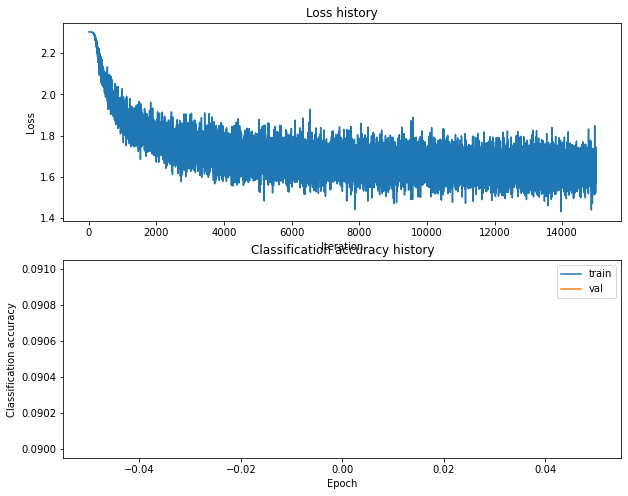

Training network with h_s 100, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.302989
iteration 100 / 15000: loss 1.979286
iteration 200 / 15000: loss 1.712084
iteration 300 / 15000: loss 1.785538
iteration 400 / 15000: loss 1.778974
iteration 500 / 15000: loss 1.760219
iteration 600 / 15000: loss 1.783647
iteration 700 / 15000: loss 1.721023
iteration 800 / 15000: loss 1.666942
iteration 900 / 15000: loss 1.741554
iteration 1000 / 15000: loss 1.677100
iteration 1100 / 15000: loss 1.746133
iteration 1200 / 15000: loss 1.634846
iteration 1300 / 15000: loss 1.684388
iteration 1400 / 15000: loss 1.708596
iteration 1500 / 15000: loss 1.767905
iteration 1600 / 15000: loss 1.803538
iteration 1700 / 15000: loss 1.734948
iteration 1800 / 15000: loss 1.778606
iteration 1900 / 15000: loss 1.717065
iteration 2000 / 15000: loss 1.598830
iteration 2100 / 15000: loss 1.742028
iteration 2200 / 15000: loss 1.684487
iteration 2300 / 15000: loss 1.715118
iteration 2400 / 15000: loss 1.675510
i

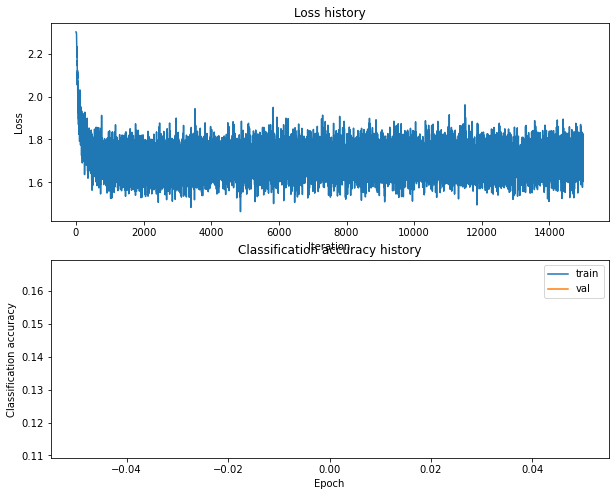

Training network with h_s 100, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.302967
iteration 100 / 15000: loss 2.300917
iteration 200 / 15000: loss 2.267051
iteration 300 / 15000: loss 2.196683
iteration 400 / 15000: loss 2.145791
iteration 500 / 15000: loss 2.077137
iteration 600 / 15000: loss 2.057664
iteration 700 / 15000: loss 1.973574
iteration 800 / 15000: loss 1.988317
iteration 900 / 15000: loss 1.973307
iteration 1000 / 15000: loss 1.884176
iteration 1100 / 15000: loss 1.933247
iteration 1200 / 15000: loss 1.925885
iteration 1300 / 15000: loss 1.910585
iteration 1400 / 15000: loss 1.878123
iteration 1500 / 15000: loss 1.839124
iteration 1600 / 15000: loss 1.885581
iteration 1700 / 15000: loss 1.830241
iteration 1800 / 15000: loss 1.829447
iteration 1900 / 15000: loss 1.879033
iteration 2000 / 15000: loss 1.868285
iteration 2100 / 15000: loss 1.782367
iteration 2200 / 15000: loss 1.815941
iteration 2300 / 15000: loss 1.919823
iteration 2400 / 15000: loss 1.827507


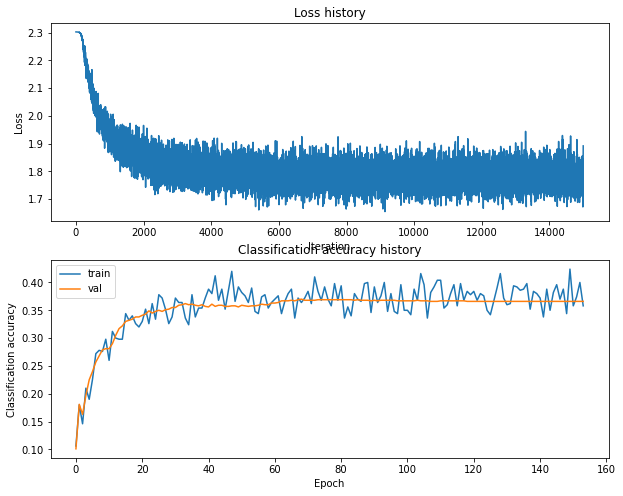

Training network with h_s 100, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.302985
iteration 100 / 15000: loss 1.904163
iteration 200 / 15000: loss 1.745609
iteration 300 / 15000: loss 1.692420
iteration 400 / 15000: loss 1.812276
iteration 500 / 15000: loss 1.806150
iteration 600 / 15000: loss 1.706914
iteration 700 / 15000: loss 1.762814
iteration 800 / 15000: loss 1.795142
iteration 900 / 15000: loss 1.713704
iteration 1000 / 15000: loss 1.714420
iteration 1100 / 15000: loss 1.689949
iteration 1200 / 15000: loss 1.734836
iteration 1300 / 15000: loss 1.626774
iteration 1400 / 15000: loss 1.649640
iteration 1500 / 15000: loss 1.662320
iteration 1600 / 15000: loss 1.566300
iteration 1700 / 15000: loss 1.695386
iteration 1800 / 15000: loss 1.645775
iteration 1900 / 15000: loss 1.683600
iteration 2000 / 15000: loss 1.693713
iteration 2100 / 15000: loss 1.663948
iteration 2200 / 15000: loss 1.641905
iteration 2300 / 15000: loss 1.593214
iteration 2400 / 15000: loss 1.628726
i

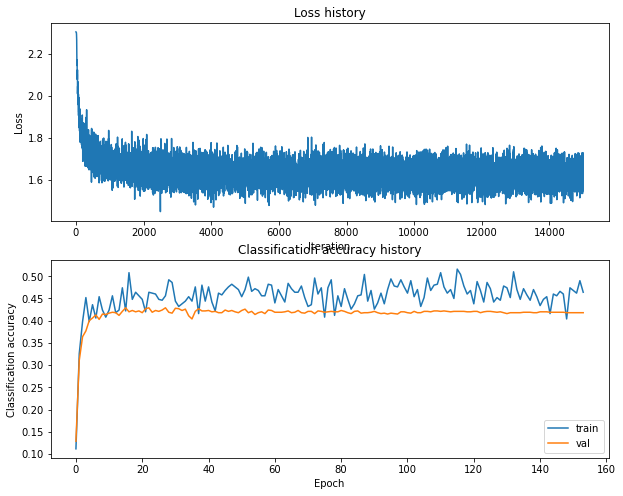

Training network with h_s 100, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.302928
iteration 100 / 20000: loss 2.301119
iteration 200 / 20000: loss 2.275861
iteration 300 / 20000: loss 2.202571
iteration 400 / 20000: loss 2.093799
iteration 500 / 20000: loss 1.968026
iteration 600 / 20000: loss 1.939524
iteration 700 / 20000: loss 1.954978
iteration 800 / 20000: loss 2.019957
iteration 900 / 20000: loss 1.896385
iteration 1000 / 20000: loss 1.850123
iteration 1100 / 20000: loss 1.873013
iteration 1200 / 20000: loss 1.885117
iteration 1300 / 20000: loss 1.858187
iteration 1400 / 20000: loss 1.955922
iteration 1500 / 20000: loss 1.845046
iteration 1600 / 20000: loss 1.753777
iteration 1700 / 20000: loss 1.743493
iteration 1800 / 20000: loss 1.696120
iteration 1900 / 20000: loss 1.951055
iteration 2000 / 20000: loss 1.857446
iteration 2100 / 20000: loss 1.740387
iteration 2200 / 20000: loss 1.745824
iteration 2300 / 20000: loss 1.645348
iteration 2400 / 20000: loss 1.833987


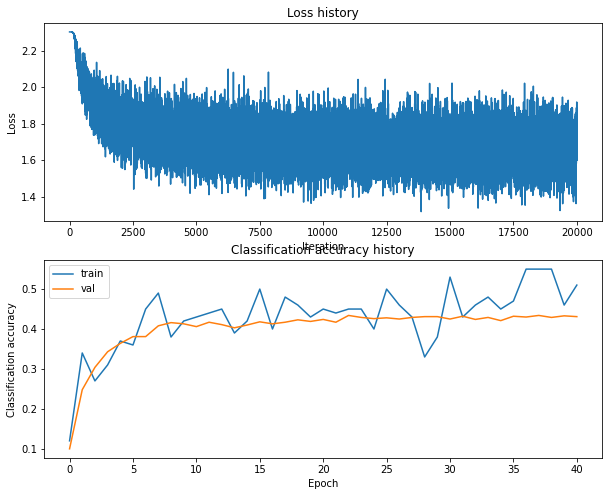

Training network with h_s 100, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.303013
iteration 100 / 20000: loss 1.827976
iteration 200 / 20000: loss 1.898413
iteration 300 / 20000: loss 1.646756
iteration 400 / 20000: loss 1.734992
iteration 500 / 20000: loss 1.759913
iteration 600 / 20000: loss 1.732770
iteration 700 / 20000: loss 1.587954
iteration 800 / 20000: loss 1.664789
iteration 900 / 20000: loss 1.574826
iteration 1000 / 20000: loss 1.835739
iteration 1100 / 20000: loss 1.642032
iteration 1200 / 20000: loss 1.812347
iteration 1300 / 20000: loss 1.924243
iteration 1400 / 20000: loss 1.712055
iteration 1500 / 20000: loss 1.749832
iteration 1600 / 20000: loss 1.660026
iteration 1700 / 20000: loss 1.550587
iteration 1800 / 20000: loss 1.777494
iteration 1900 / 20000: loss 1.772124
iteration 2000 / 20000: loss 1.747256
iteration 2100 / 20000: loss 1.695224
iteration 2200 / 20000: loss 1.811204
iteration 2300 / 20000: loss 1.836465
iteration 2400 / 20000: loss 1.611377
i

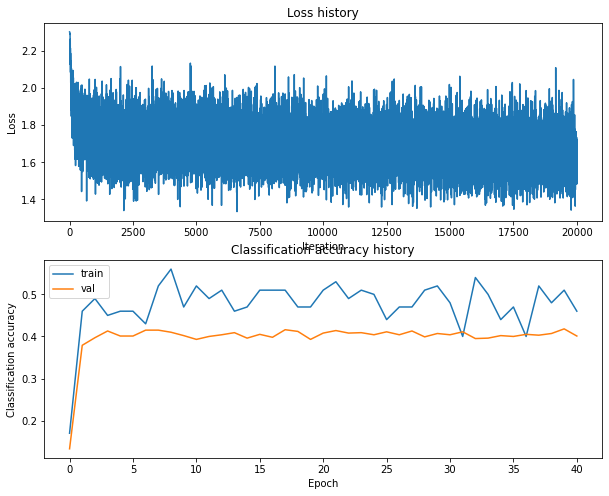

Training network with h_s 100, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.302944
iteration 100 / 20000: loss 2.300965
iteration 200 / 20000: loss 2.270696
iteration 300 / 20000: loss 2.205074
iteration 400 / 20000: loss 2.104526
iteration 500 / 20000: loss 2.012950
iteration 600 / 20000: loss 2.024426
iteration 700 / 20000: loss 1.955347
iteration 800 / 20000: loss 1.892004
iteration 900 / 20000: loss 1.932052
iteration 1000 / 20000: loss 1.966629
iteration 1100 / 20000: loss 1.918479
iteration 1200 / 20000: loss 1.870696
iteration 1300 / 20000: loss 1.825999
iteration 1400 / 20000: loss 1.920163
iteration 1500 / 20000: loss 1.815833
iteration 1600 / 20000: loss 1.790879
iteration 1700 / 20000: loss 1.785901
iteration 1800 / 20000: loss 1.786201
iteration 1900 / 20000: loss 1.713356
iteration 2000 / 20000: loss 1.764583
iteration 2100 / 20000: loss 1.871313
iteration 2200 / 20000: loss 1.713116
iteration 2300 / 20000: loss 1.752562
iteration 2400 / 20000: loss 1.831426


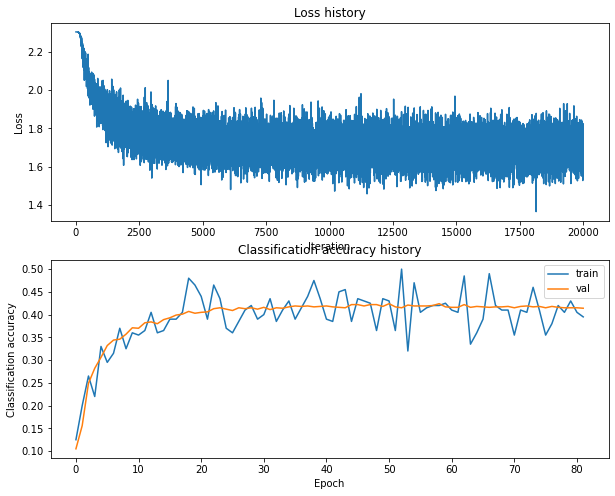

Training network with h_s 100, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.302981
iteration 100 / 20000: loss 1.946071
iteration 200 / 20000: loss 1.817424
iteration 300 / 20000: loss 1.733051
iteration 400 / 20000: loss 1.715759
iteration 500 / 20000: loss 1.558223
iteration 600 / 20000: loss 1.896301
iteration 700 / 20000: loss 1.687069
iteration 800 / 20000: loss 1.694231
iteration 900 / 20000: loss 1.694992
iteration 1000 / 20000: loss 1.565414
iteration 1100 / 20000: loss 1.719473
iteration 1200 / 20000: loss 1.657794
iteration 1300 / 20000: loss 1.714078
iteration 1400 / 20000: loss 1.713257
iteration 1500 / 20000: loss 1.685405
iteration 1600 / 20000: loss 1.707730
iteration 1700 / 20000: loss 1.658314
iteration 1800 / 20000: loss 1.521294
iteration 1900 / 20000: loss 1.679555
iteration 2000 / 20000: loss 1.740046
iteration 2100 / 20000: loss 1.732399
iteration 2200 / 20000: loss 1.713996
iteration 2300 / 20000: loss 1.670907
iteration 2400 / 20000: loss 1.619380
i

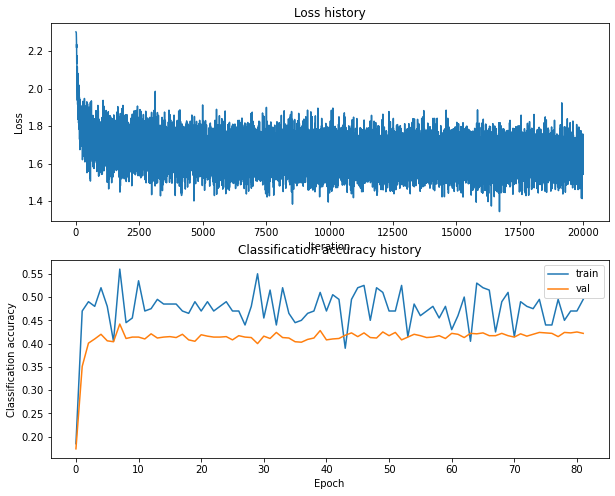

Training network with h_s 100, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.302958
iteration 100 / 20000: loss 2.300720
iteration 200 / 20000: loss 2.261487
iteration 300 / 20000: loss 2.145526
iteration 400 / 20000: loss 2.123917
iteration 500 / 20000: loss 2.083357
iteration 600 / 20000: loss 1.989674
iteration 700 / 20000: loss 1.948498
iteration 800 / 20000: loss 1.966519
iteration 900 / 20000: loss 1.976297
iteration 1000 / 20000: loss 1.822804
iteration 1100 / 20000: loss 1.905380
iteration 1200 / 20000: loss 1.855282
iteration 1300 / 20000: loss 1.823130
iteration 1400 / 20000: loss 1.867113
iteration 1500 / 20000: loss 1.814149
iteration 1600 / 20000: loss 1.740797
iteration 1700 / 20000: loss 1.805115
iteration 1800 / 20000: loss 1.816040
iteration 1900 / 20000: loss 1.765529
iteration 2000 / 20000: loss 1.860717
iteration 2100 / 20000: loss 1.839689
iteration 2200 / 20000: loss 1.710981
iteration 2300 / 20000: loss 1.865759
iteration 2400 / 20000: loss 1.861008


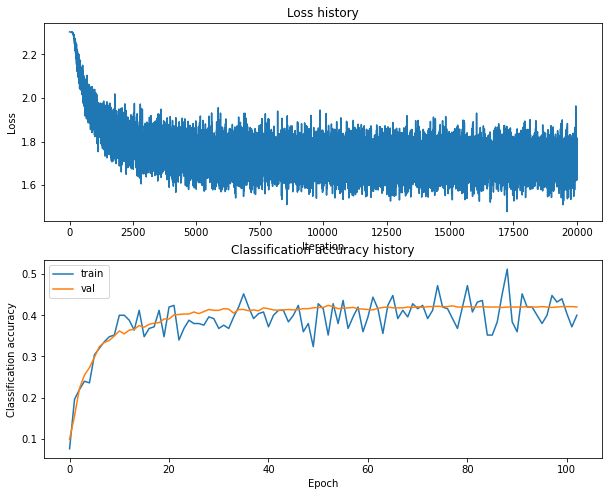

Training network with h_s 100, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.302981
iteration 100 / 20000: loss 1.949883
iteration 200 / 20000: loss 1.819595
iteration 300 / 20000: loss 1.698525
iteration 400 / 20000: loss 1.775300
iteration 500 / 20000: loss 1.692212
iteration 600 / 20000: loss 1.679511
iteration 700 / 20000: loss 1.623442
iteration 800 / 20000: loss 1.779181
iteration 900 / 20000: loss 1.681892
iteration 1000 / 20000: loss 1.707991
iteration 1100 / 20000: loss 1.752635
iteration 1200 / 20000: loss 1.701003
iteration 1300 / 20000: loss 1.664785
iteration 1400 / 20000: loss 1.702166
iteration 1500 / 20000: loss 1.676875
iteration 1600 / 20000: loss 1.598203
iteration 1700 / 20000: loss 1.732536
iteration 1800 / 20000: loss 1.685688
iteration 1900 / 20000: loss 1.614392
iteration 2000 / 20000: loss 1.551257
iteration 2100 / 20000: loss 1.743904
iteration 2200 / 20000: loss 1.640187
iteration 2300 / 20000: loss 1.781518
iteration 2400 / 20000: loss 1.756664
i

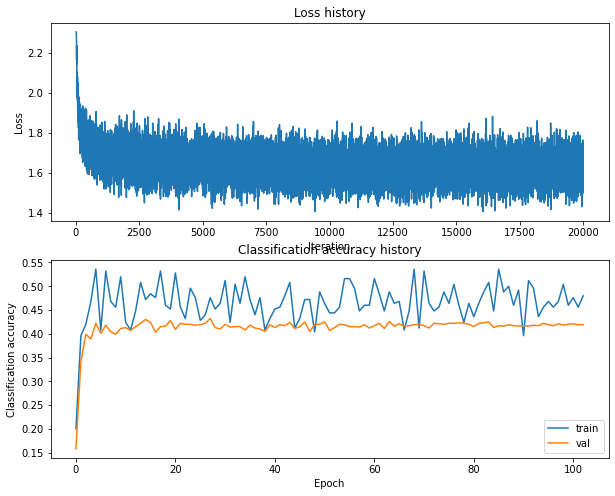

Training network with h_s 100, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.302990
iteration 100 / 20000: loss 2.301407
iteration 200 / 20000: loss 2.272549
iteration 300 / 20000: loss 2.161355
iteration 400 / 20000: loss 2.066648
iteration 500 / 20000: loss 2.078788
iteration 600 / 20000: loss 1.887281
iteration 700 / 20000: loss 1.977663
iteration 800 / 20000: loss 1.985165
iteration 900 / 20000: loss 1.875223
iteration 1000 / 20000: loss 1.841715
iteration 1100 / 20000: loss 1.853800
iteration 1200 / 20000: loss 1.851828
iteration 1300 / 20000: loss 1.925091
iteration 1400 / 20000: loss 1.824437
iteration 1500 / 20000: loss 1.796519
iteration 1600 / 20000: loss 1.820467
iteration 1700 / 20000: loss 1.805997
iteration 1800 / 20000: loss 1.833411
iteration 1900 / 20000: loss 1.925953
iteration 2000 / 20000: loss 1.842351
iteration 2100 / 20000: loss 1.843023
iteration 2200 / 20000: loss 1.781742
iteration 2300 / 20000: loss 1.849780
iteration 2400 / 20000: loss 1.813910


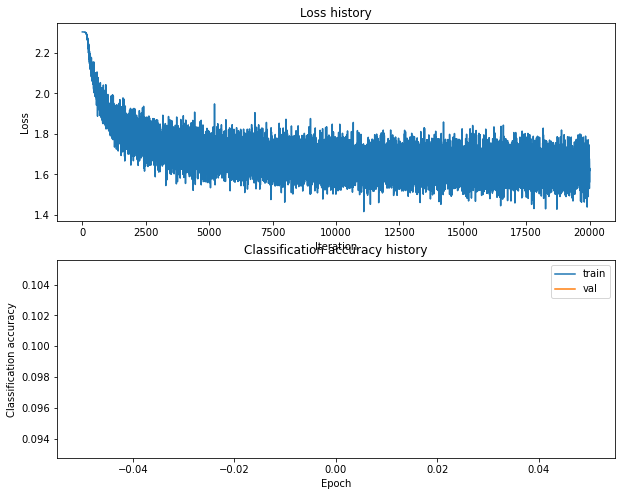

Training network with h_s 100, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.302974
iteration 100 / 20000: loss 1.858270
iteration 200 / 20000: loss 1.870148
iteration 300 / 20000: loss 1.808983
iteration 400 / 20000: loss 1.757626
iteration 500 / 20000: loss 1.643470
iteration 600 / 20000: loss 1.727484
iteration 700 / 20000: loss 1.801801
iteration 800 / 20000: loss 1.659066
iteration 900 / 20000: loss 1.731990
iteration 1000 / 20000: loss 1.757460
iteration 1100 / 20000: loss 1.693667
iteration 1200 / 20000: loss 1.657219
iteration 1300 / 20000: loss 1.720600
iteration 1400 / 20000: loss 1.803760
iteration 1500 / 20000: loss 1.673043
iteration 1600 / 20000: loss 1.684177
iteration 1700 / 20000: loss 1.641292
iteration 1800 / 20000: loss 1.719639
iteration 1900 / 20000: loss 1.726343
iteration 2000 / 20000: loss 1.791345
iteration 2100 / 20000: loss 1.676337
iteration 2200 / 20000: loss 1.578883
iteration 2300 / 20000: loss 1.683501
iteration 2400 / 20000: loss 1.609128
i

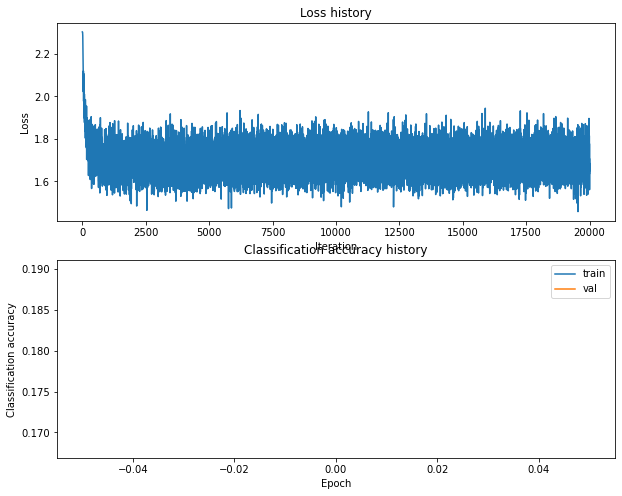

Training network with h_s 100, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.302969
iteration 100 / 20000: loss 2.301115
iteration 200 / 20000: loss 2.272045
iteration 300 / 20000: loss 2.124252
iteration 400 / 20000: loss 2.142253
iteration 500 / 20000: loss 2.069904
iteration 600 / 20000: loss 1.953915
iteration 700 / 20000: loss 2.021953
iteration 800 / 20000: loss 1.982839
iteration 900 / 20000: loss 1.900583
iteration 1000 / 20000: loss 1.938724
iteration 1100 / 20000: loss 1.927197
iteration 1200 / 20000: loss 1.885922
iteration 1300 / 20000: loss 1.923506
iteration 1400 / 20000: loss 1.920720
iteration 1500 / 20000: loss 1.856065
iteration 1600 / 20000: loss 1.891621
iteration 1700 / 20000: loss 1.966241
iteration 1800 / 20000: loss 1.879742
iteration 1900 / 20000: loss 1.842143
iteration 2000 / 20000: loss 1.881614
iteration 2100 / 20000: loss 1.879497
iteration 2200 / 20000: loss 1.830037
iteration 2300 / 20000: loss 1.850159
iteration 2400 / 20000: loss 1.836398


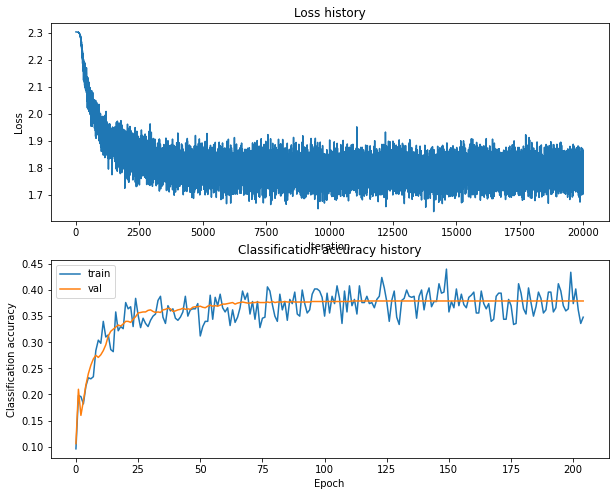

Training network with h_s 100, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.302943
iteration 100 / 20000: loss 1.943618
iteration 200 / 20000: loss 1.798526
iteration 300 / 20000: loss 1.747207
iteration 400 / 20000: loss 1.681018
iteration 500 / 20000: loss 1.668618
iteration 600 / 20000: loss 1.618199
iteration 700 / 20000: loss 1.817780
iteration 800 / 20000: loss 1.587512
iteration 900 / 20000: loss 1.580592
iteration 1000 / 20000: loss 1.730537
iteration 1100 / 20000: loss 1.708099
iteration 1200 / 20000: loss 1.630906
iteration 1300 / 20000: loss 1.628827
iteration 1400 / 20000: loss 1.623783
iteration 1500 / 20000: loss 1.643117
iteration 1600 / 20000: loss 1.709350
iteration 1700 / 20000: loss 1.724159
iteration 1800 / 20000: loss 1.690559
iteration 1900 / 20000: loss 1.694117
iteration 2000 / 20000: loss 1.598562
iteration 2100 / 20000: loss 1.695717
iteration 2200 / 20000: loss 1.627552
iteration 2300 / 20000: loss 1.686148
iteration 2400 / 20000: loss 1.649872
i

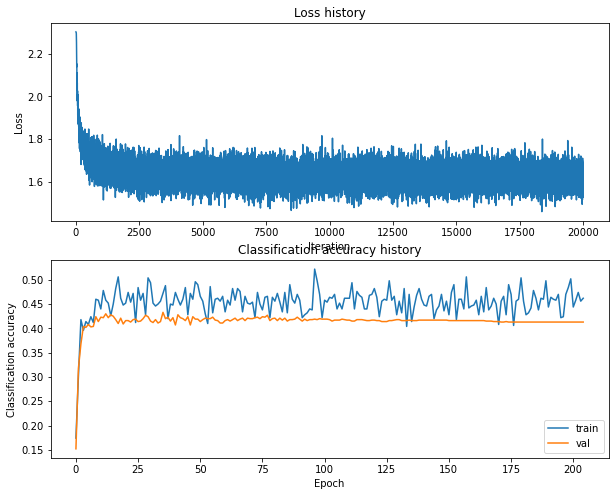

Training network with h_s 100, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.303006
iteration 100 / 25000: loss 2.300777
iteration 200 / 25000: loss 2.262891
iteration 300 / 25000: loss 2.129144
iteration 400 / 25000: loss 2.102620
iteration 500 / 25000: loss 2.016665
iteration 600 / 25000: loss 2.107758
iteration 700 / 25000: loss 1.991892
iteration 800 / 25000: loss 1.902938
iteration 900 / 25000: loss 1.848569
iteration 1000 / 25000: loss 1.967755
iteration 1100 / 25000: loss 1.913585
iteration 1200 / 25000: loss 2.031877
iteration 1300 / 25000: loss 1.905192
iteration 1400 / 25000: loss 1.931743
iteration 1500 / 25000: loss 1.771228
iteration 1600 / 25000: loss 1.865204
iteration 1700 / 25000: loss 1.855544
iteration 1800 / 25000: loss 1.791334
iteration 1900 / 25000: loss 1.738280
iteration 2000 / 25000: loss 1.674426
iteration 2100 / 25000: loss 1.936148
iteration 2200 / 25000: loss 1.810692
iteration 2300 / 25000: loss 1.826432
iteration 2400 / 25000: loss 1.905242


iteration 21200 / 25000: loss 1.654679
iteration 21300 / 25000: loss 1.798123
iteration 21400 / 25000: loss 1.765440
iteration 21500 / 25000: loss 1.657394
iteration 21600 / 25000: loss 1.807130
iteration 21700 / 25000: loss 1.526410
iteration 21800 / 25000: loss 1.638949
iteration 21900 / 25000: loss 1.461957
iteration 22000 / 25000: loss 1.623619
iteration 22100 / 25000: loss 1.764915
iteration 22200 / 25000: loss 1.511892
iteration 22300 / 25000: loss 1.593670
iteration 22400 / 25000: loss 1.524894
iteration 22500 / 25000: loss 1.521665
iteration 22600 / 25000: loss 1.715620
iteration 22700 / 25000: loss 1.488572
iteration 22800 / 25000: loss 1.549629
iteration 22900 / 25000: loss 1.566942
iteration 23000 / 25000: loss 1.738212
iteration 23100 / 25000: loss 1.756843
iteration 23200 / 25000: loss 1.526996
iteration 23300 / 25000: loss 1.772313
iteration 23400 / 25000: loss 1.648897
iteration 23500 / 25000: loss 1.699155
iteration 23600 / 25000: loss 1.635860
iteration 23700 / 25000: 

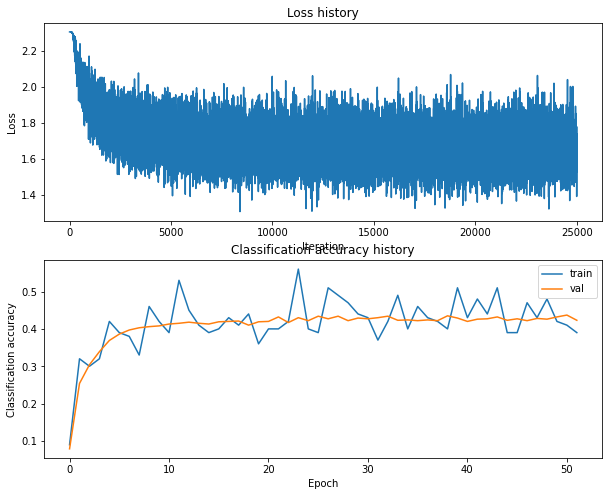

Training network with h_s 100, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.302931
iteration 100 / 25000: loss 1.909855
iteration 200 / 25000: loss 1.808194
iteration 300 / 25000: loss 1.839122
iteration 400 / 25000: loss 1.858436
iteration 500 / 25000: loss 1.827181
iteration 600 / 25000: loss 1.865904
iteration 700 / 25000: loss 1.821820
iteration 800 / 25000: loss 1.751238
iteration 900 / 25000: loss 1.717297
iteration 1000 / 25000: loss 1.843813
iteration 1100 / 25000: loss 1.602534
iteration 1200 / 25000: loss 1.638906
iteration 1300 / 25000: loss 1.714009
iteration 1400 / 25000: loss 1.764746
iteration 1500 / 25000: loss 1.641792
iteration 1600 / 25000: loss 1.612203
iteration 1700 / 25000: loss 1.575929
iteration 1800 / 25000: loss 1.608626
iteration 1900 / 25000: loss 1.780227
iteration 2000 / 25000: loss 1.753399
iteration 2100 / 25000: loss 1.678233
iteration 2200 / 25000: loss 1.754830
iteration 2300 / 25000: loss 1.767282
iteration 2400 / 25000: loss 1.595207
i

iteration 21200 / 25000: loss 1.821911
iteration 21300 / 25000: loss 1.694428
iteration 21400 / 25000: loss 1.617900
iteration 21500 / 25000: loss 1.545226
iteration 21600 / 25000: loss 1.540439
iteration 21700 / 25000: loss 1.706517
iteration 21800 / 25000: loss 1.665361
iteration 21900 / 25000: loss 1.764556
iteration 22000 / 25000: loss 1.950975
iteration 22100 / 25000: loss 1.749605
iteration 22200 / 25000: loss 1.652635
iteration 22300 / 25000: loss 1.585594
iteration 22400 / 25000: loss 1.713363
iteration 22500 / 25000: loss 1.567872
iteration 22600 / 25000: loss 1.822331
iteration 22700 / 25000: loss 1.746988
iteration 22800 / 25000: loss 1.798311
iteration 22900 / 25000: loss 1.524833
iteration 23000 / 25000: loss 1.577925
iteration 23100 / 25000: loss 1.616685
iteration 23200 / 25000: loss 1.718213
iteration 23300 / 25000: loss 1.703226
iteration 23400 / 25000: loss 1.571777
iteration 23500 / 25000: loss 1.793992
iteration 23600 / 25000: loss 1.582276
iteration 23700 / 25000: 

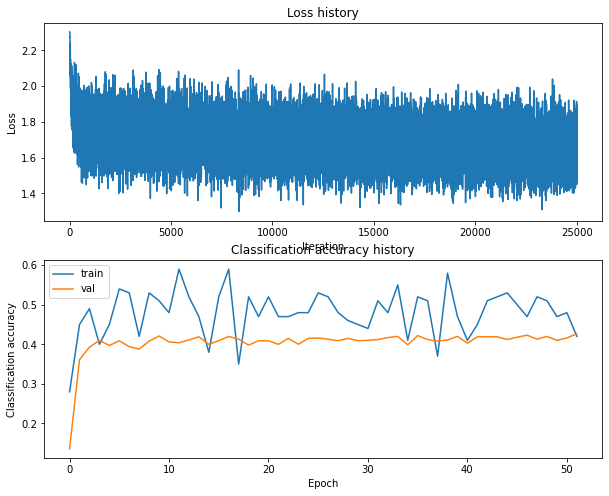

Training network with h_s 100, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.302965
iteration 100 / 25000: loss 2.301435
iteration 200 / 25000: loss 2.267661
iteration 300 / 25000: loss 2.166789
iteration 400 / 25000: loss 2.052579
iteration 500 / 25000: loss 2.061763
iteration 600 / 25000: loss 2.037856
iteration 700 / 25000: loss 1.987513
iteration 800 / 25000: loss 1.978318
iteration 900 / 25000: loss 1.832098
iteration 1000 / 25000: loss 1.826446
iteration 1100 / 25000: loss 1.860332
iteration 1200 / 25000: loss 1.800732
iteration 1300 / 25000: loss 1.712362
iteration 1400 / 25000: loss 1.965352
iteration 1500 / 25000: loss 1.802261
iteration 1600 / 25000: loss 1.846597
iteration 1700 / 25000: loss 2.005561
iteration 1800 / 25000: loss 1.805580
iteration 1900 / 25000: loss 1.849115
iteration 2000 / 25000: loss 1.711800
iteration 2100 / 25000: loss 1.863061
iteration 2200 / 25000: loss 1.809793
iteration 2300 / 25000: loss 1.915372
iteration 2400 / 25000: loss 1.717844


iteration 21200 / 25000: loss 1.745601
iteration 21300 / 25000: loss 1.645145
iteration 21400 / 25000: loss 1.679698
iteration 21500 / 25000: loss 1.670901
iteration 21600 / 25000: loss 1.795221
iteration 21700 / 25000: loss 1.671503
iteration 21800 / 25000: loss 1.637392
iteration 21900 / 25000: loss 1.788264
iteration 22000 / 25000: loss 1.601688
iteration 22100 / 25000: loss 1.672088
iteration 22200 / 25000: loss 1.624218
iteration 22300 / 25000: loss 1.819899
iteration 22400 / 25000: loss 1.743634
iteration 22500 / 25000: loss 1.750033
iteration 22600 / 25000: loss 1.653350
iteration 22700 / 25000: loss 1.654036
iteration 22800 / 25000: loss 1.790050
iteration 22900 / 25000: loss 1.605718
iteration 23000 / 25000: loss 1.759649
iteration 23100 / 25000: loss 1.805974
iteration 23200 / 25000: loss 1.625735
iteration 23300 / 25000: loss 1.625771
iteration 23400 / 25000: loss 1.681404
iteration 23500 / 25000: loss 1.674178
iteration 23600 / 25000: loss 1.752124
iteration 23700 / 25000: 

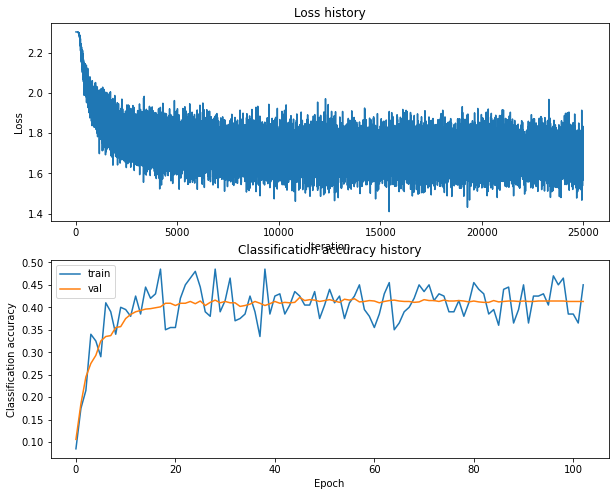

Training network with h_s 100, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.302985
iteration 100 / 25000: loss 1.936997
iteration 200 / 25000: loss 1.778106
iteration 300 / 25000: loss 1.665285
iteration 400 / 25000: loss 1.762417
iteration 500 / 25000: loss 1.681026
iteration 600 / 25000: loss 1.698931
iteration 700 / 25000: loss 1.679047
iteration 800 / 25000: loss 1.548285
iteration 900 / 25000: loss 1.770491
iteration 1000 / 25000: loss 1.994067
iteration 1100 / 25000: loss 1.529564
iteration 1200 / 25000: loss 1.641429
iteration 1300 / 25000: loss 1.584109
iteration 1400 / 25000: loss 1.598873
iteration 1500 / 25000: loss 1.624287
iteration 1600 / 25000: loss 1.691142
iteration 1700 / 25000: loss 1.714061
iteration 1800 / 25000: loss 1.669521
iteration 1900 / 25000: loss 1.619834
iteration 2000 / 25000: loss 1.638225
iteration 2100 / 25000: loss 1.607430
iteration 2200 / 25000: loss 1.766625
iteration 2300 / 25000: loss 1.647594
iteration 2400 / 25000: loss 1.554007
i

iteration 21200 / 25000: loss 1.537562
iteration 21300 / 25000: loss 1.554355
iteration 21400 / 25000: loss 1.662086
iteration 21500 / 25000: loss 1.590529
iteration 21600 / 25000: loss 1.628582
iteration 21700 / 25000: loss 1.700470
iteration 21800 / 25000: loss 1.641488
iteration 21900 / 25000: loss 1.728324
iteration 22000 / 25000: loss 1.647127
iteration 22100 / 25000: loss 1.657280
iteration 22200 / 25000: loss 1.653048
iteration 22300 / 25000: loss 1.676687
iteration 22400 / 25000: loss 1.626329
iteration 22500 / 25000: loss 1.532343
iteration 22600 / 25000: loss 1.650166
iteration 22700 / 25000: loss 1.573114
iteration 22800 / 25000: loss 1.601279
iteration 22900 / 25000: loss 1.567142
iteration 23000 / 25000: loss 1.769842
iteration 23100 / 25000: loss 1.611423
iteration 23200 / 25000: loss 1.737715
iteration 23300 / 25000: loss 1.735417
iteration 23400 / 25000: loss 1.687627
iteration 23500 / 25000: loss 1.716141
iteration 23600 / 25000: loss 1.458603
iteration 23700 / 25000: 

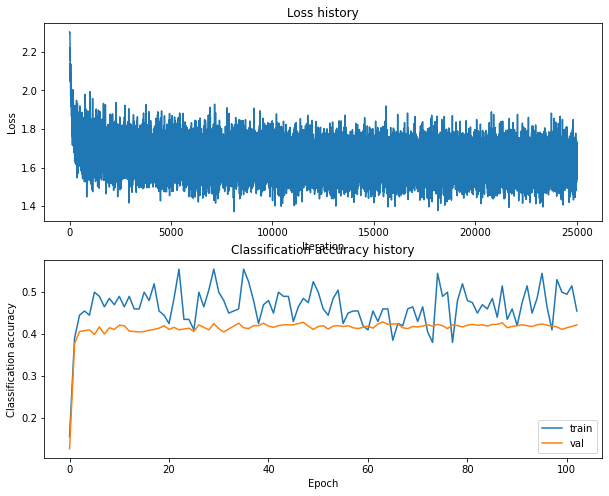

Training network with h_s 100, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.302998
iteration 100 / 25000: loss 2.300866
iteration 200 / 25000: loss 2.253648
iteration 300 / 25000: loss 2.149874
iteration 400 / 25000: loss 2.164195
iteration 500 / 25000: loss 2.038331
iteration 600 / 25000: loss 1.994246
iteration 700 / 25000: loss 2.029241
iteration 800 / 25000: loss 2.005000
iteration 900 / 25000: loss 1.955272
iteration 1000 / 25000: loss 1.871240
iteration 1100 / 25000: loss 1.877923
iteration 1200 / 25000: loss 1.901027
iteration 1300 / 25000: loss 1.902124
iteration 1400 / 25000: loss 1.938682
iteration 1500 / 25000: loss 1.827214
iteration 1600 / 25000: loss 1.716357
iteration 1700 / 25000: loss 1.820097
iteration 1800 / 25000: loss 1.801485
iteration 1900 / 25000: loss 1.852956
iteration 2000 / 25000: loss 1.765475
iteration 2100 / 25000: loss 1.812959
iteration 2200 / 25000: loss 1.835403
iteration 2300 / 25000: loss 1.795122
iteration 2400 / 25000: loss 1.798191


iteration 21200 / 25000: loss 1.622780
iteration 21300 / 25000: loss 1.669144
iteration 21400 / 25000: loss 1.663976
iteration 21500 / 25000: loss 1.666876
iteration 21600 / 25000: loss 1.646026
iteration 21700 / 25000: loss 1.703747
iteration 21800 / 25000: loss 1.642426
iteration 21900 / 25000: loss 1.822851
iteration 22000 / 25000: loss 1.806038
iteration 22100 / 25000: loss 1.737068
iteration 22200 / 25000: loss 1.597443
iteration 22300 / 25000: loss 1.732110
iteration 22400 / 25000: loss 1.636490
iteration 22500 / 25000: loss 1.783732
iteration 22600 / 25000: loss 1.740085
iteration 22700 / 25000: loss 1.624549
iteration 22800 / 25000: loss 1.682157
iteration 22900 / 25000: loss 1.696517
iteration 23000 / 25000: loss 1.712588
iteration 23100 / 25000: loss 1.831652
iteration 23200 / 25000: loss 1.692247
iteration 23300 / 25000: loss 1.698483
iteration 23400 / 25000: loss 1.753105
iteration 23500 / 25000: loss 1.698670
iteration 23600 / 25000: loss 1.778453
iteration 23700 / 25000: 

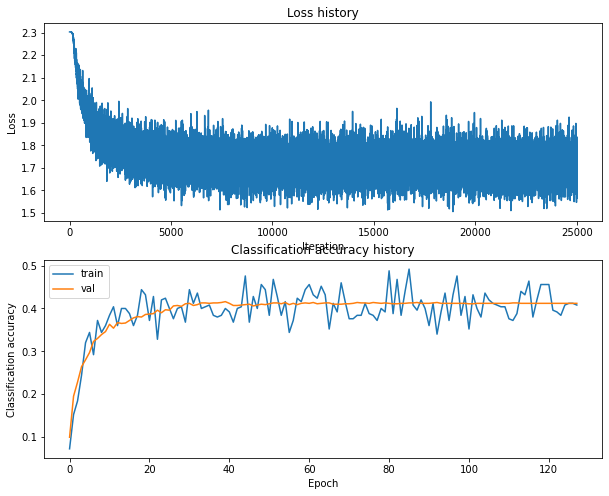

Training network with h_s 100, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.302973
iteration 100 / 25000: loss 1.890406
iteration 200 / 25000: loss 1.856704
iteration 300 / 25000: loss 1.762310
iteration 400 / 25000: loss 1.663110
iteration 500 / 25000: loss 1.767085
iteration 600 / 25000: loss 1.698380
iteration 700 / 25000: loss 1.815234
iteration 800 / 25000: loss 1.723954
iteration 900 / 25000: loss 1.558435
iteration 1000 / 25000: loss 1.683299
iteration 1100 / 25000: loss 1.795196
iteration 1200 / 25000: loss 1.689674
iteration 1300 / 25000: loss 1.757583
iteration 1400 / 25000: loss 1.698066
iteration 1500 / 25000: loss 1.695292
iteration 1600 / 25000: loss 1.612190
iteration 1700 / 25000: loss 1.609443
iteration 1800 / 25000: loss 1.546742
iteration 1900 / 25000: loss 1.696900
iteration 2000 / 25000: loss 1.663931
iteration 2100 / 25000: loss 1.721725
iteration 2200 / 25000: loss 1.733350
iteration 2300 / 25000: loss 1.635561
iteration 2400 / 25000: loss 1.635762
i

iteration 21200 / 25000: loss 1.540933
iteration 21300 / 25000: loss 1.529537
iteration 21400 / 25000: loss 1.437424
iteration 21500 / 25000: loss 1.637843
iteration 21600 / 25000: loss 1.582958
iteration 21700 / 25000: loss 1.713545
iteration 21800 / 25000: loss 1.518937
iteration 21900 / 25000: loss 1.690144
iteration 22000 / 25000: loss 1.617516
iteration 22100 / 25000: loss 1.533164
iteration 22200 / 25000: loss 1.634982
iteration 22300 / 25000: loss 1.578173
iteration 22400 / 25000: loss 1.569978
iteration 22500 / 25000: loss 1.622315
iteration 22600 / 25000: loss 1.629694
iteration 22700 / 25000: loss 1.584952
iteration 22800 / 25000: loss 1.697471
iteration 22900 / 25000: loss 1.639447
iteration 23000 / 25000: loss 1.600587
iteration 23100 / 25000: loss 1.674771
iteration 23200 / 25000: loss 1.601647
iteration 23300 / 25000: loss 1.612485
iteration 23400 / 25000: loss 1.674828
iteration 23500 / 25000: loss 1.537992
iteration 23600 / 25000: loss 1.587325
iteration 23700 / 25000: 

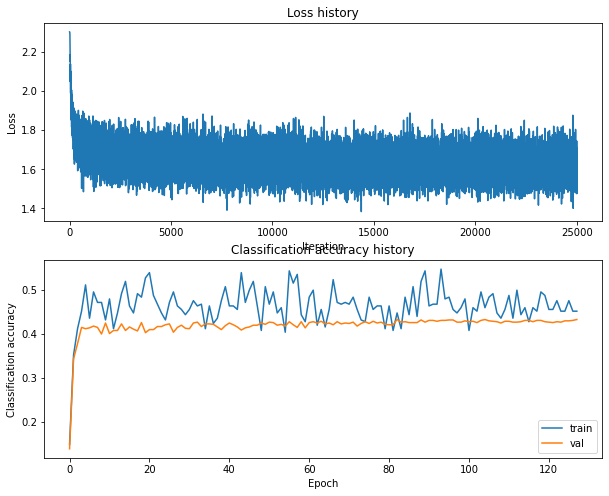

Training network with h_s 100, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.302969
iteration 100 / 25000: loss 2.300713
iteration 200 / 25000: loss 2.253975
iteration 300 / 25000: loss 2.195818
iteration 400 / 25000: loss 2.093498
iteration 500 / 25000: loss 2.069779
iteration 600 / 25000: loss 1.975046
iteration 700 / 25000: loss 1.957890
iteration 800 / 25000: loss 1.946395
iteration 900 / 25000: loss 1.911873
iteration 1000 / 25000: loss 1.897322
iteration 1100 / 25000: loss 1.847610
iteration 1200 / 25000: loss 1.877619
iteration 1300 / 25000: loss 1.802287
iteration 1400 / 25000: loss 1.885545
iteration 1500 / 25000: loss 1.828832
iteration 1600 / 25000: loss 1.854292
iteration 1700 / 25000: loss 1.811449
iteration 1800 / 25000: loss 1.875668
iteration 1900 / 25000: loss 1.808973
iteration 2000 / 25000: loss 1.821299
iteration 2100 / 25000: loss 1.759398
iteration 2200 / 25000: loss 1.755429
iteration 2300 / 25000: loss 1.799603
iteration 2400 / 25000: loss 1.845802


iteration 21200 / 25000: loss 1.689558
iteration 21300 / 25000: loss 1.677759
iteration 21400 / 25000: loss 1.524787
iteration 21500 / 25000: loss 1.749611
iteration 21600 / 25000: loss 1.605489
iteration 21700 / 25000: loss 1.639452
iteration 21800 / 25000: loss 1.664013
iteration 21900 / 25000: loss 1.639225
iteration 22000 / 25000: loss 1.640774
iteration 22100 / 25000: loss 1.633871
iteration 22200 / 25000: loss 1.756660
iteration 22300 / 25000: loss 1.711587
iteration 22400 / 25000: loss 1.671357
iteration 22500 / 25000: loss 1.596366
iteration 22600 / 25000: loss 1.550889
iteration 22700 / 25000: loss 1.634376
iteration 22800 / 25000: loss 1.684238
iteration 22900 / 25000: loss 1.582326
iteration 23000 / 25000: loss 1.682936
iteration 23100 / 25000: loss 1.615774
iteration 23200 / 25000: loss 1.673615
iteration 23300 / 25000: loss 1.534459
iteration 23400 / 25000: loss 1.541815
iteration 23500 / 25000: loss 1.694312
iteration 23600 / 25000: loss 1.524577
iteration 23700 / 25000: 

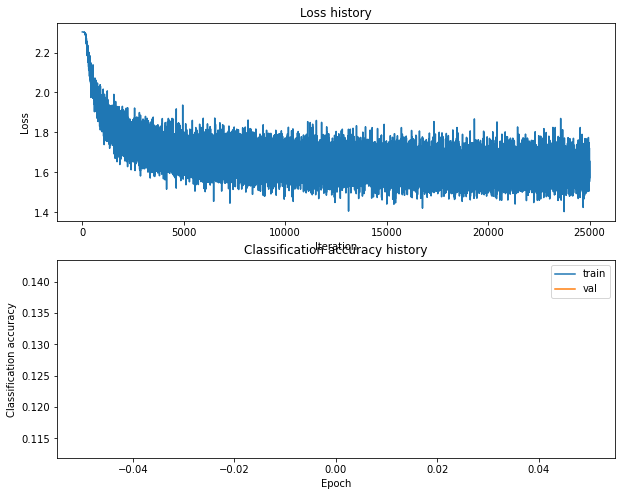

Training network with h_s 100, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.302962
iteration 100 / 25000: loss 1.900545
iteration 200 / 25000: loss 1.839760
iteration 300 / 25000: loss 1.855225
iteration 400 / 25000: loss 1.744690
iteration 500 / 25000: loss 1.632399
iteration 600 / 25000: loss 1.725709
iteration 700 / 25000: loss 1.712491
iteration 800 / 25000: loss 1.751650
iteration 900 / 25000: loss 1.764466
iteration 1000 / 25000: loss 1.538749
iteration 1100 / 25000: loss 1.696132
iteration 1200 / 25000: loss 1.689007
iteration 1300 / 25000: loss 1.720259
iteration 1400 / 25000: loss 1.701511
iteration 1500 / 25000: loss 1.711809
iteration 1600 / 25000: loss 1.657324
iteration 1700 / 25000: loss 1.718196
iteration 1800 / 25000: loss 1.526465
iteration 1900 / 25000: loss 1.707070
iteration 2000 / 25000: loss 1.698854
iteration 2100 / 25000: loss 1.698557
iteration 2200 / 25000: loss 1.726247
iteration 2300 / 25000: loss 1.714335
iteration 2400 / 25000: loss 1.742953
i

iteration 21200 / 25000: loss 1.691441
iteration 21300 / 25000: loss 1.759908
iteration 21400 / 25000: loss 1.818999
iteration 21500 / 25000: loss 1.756539
iteration 21600 / 25000: loss 1.657501
iteration 21700 / 25000: loss 1.779841
iteration 21800 / 25000: loss 1.604872
iteration 21900 / 25000: loss 1.781901
iteration 22000 / 25000: loss 1.663370
iteration 22100 / 25000: loss 1.721199
iteration 22200 / 25000: loss 1.796028
iteration 22300 / 25000: loss 1.659457
iteration 22400 / 25000: loss 1.746788
iteration 22500 / 25000: loss 1.773936
iteration 22600 / 25000: loss 1.715550
iteration 22700 / 25000: loss 1.640951
iteration 22800 / 25000: loss 1.748451
iteration 22900 / 25000: loss 1.714588
iteration 23000 / 25000: loss 1.676718
iteration 23100 / 25000: loss 1.610062
iteration 23200 / 25000: loss 1.652177
iteration 23300 / 25000: loss 1.683696
iteration 23400 / 25000: loss 1.690006
iteration 23500 / 25000: loss 1.626637
iteration 23600 / 25000: loss 1.666759
iteration 23700 / 25000: 

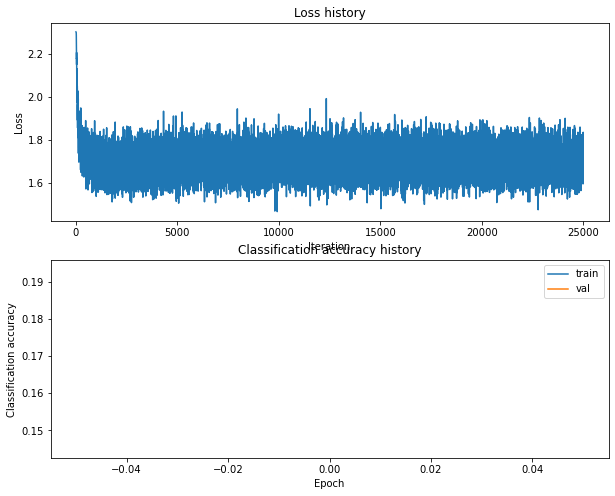

Training network with h_s 100, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.302972
iteration 100 / 25000: loss 2.300717
iteration 200 / 25000: loss 2.269096
iteration 300 / 25000: loss 2.161971
iteration 400 / 25000: loss 2.136923
iteration 500 / 25000: loss 2.080152
iteration 600 / 25000: loss 2.081946
iteration 700 / 25000: loss 2.027842
iteration 800 / 25000: loss 2.003035
iteration 900 / 25000: loss 1.980108
iteration 1000 / 25000: loss 1.965539
iteration 1100 / 25000: loss 1.927224
iteration 1200 / 25000: loss 1.897932
iteration 1300 / 25000: loss 1.899960
iteration 1400 / 25000: loss 1.863477
iteration 1500 / 25000: loss 1.896651
iteration 1600 / 25000: loss 1.827485
iteration 1700 / 25000: loss 1.879560
iteration 1800 / 25000: loss 1.870175
iteration 1900 / 25000: loss 1.902910
iteration 2000 / 25000: loss 1.809948
iteration 2100 / 25000: loss 1.847420
iteration 2200 / 25000: loss 1.815034
iteration 2300 / 25000: loss 1.844663
iteration 2400 / 25000: loss 1.709933


iteration 21200 / 25000: loss 1.853026
iteration 21300 / 25000: loss 1.698794
iteration 21400 / 25000: loss 1.825898
iteration 21500 / 25000: loss 1.800491
iteration 21600 / 25000: loss 1.783311
iteration 21700 / 25000: loss 1.801288
iteration 21800 / 25000: loss 1.740850
iteration 21900 / 25000: loss 1.800297
iteration 22000 / 25000: loss 1.770488
iteration 22100 / 25000: loss 1.789973
iteration 22200 / 25000: loss 1.786924
iteration 22300 / 25000: loss 1.782106
iteration 22400 / 25000: loss 1.886874
iteration 22500 / 25000: loss 1.752389
iteration 22600 / 25000: loss 1.811996
iteration 22700 / 25000: loss 1.749365
iteration 22800 / 25000: loss 1.816862
iteration 22900 / 25000: loss 1.764329
iteration 23000 / 25000: loss 1.805725
iteration 23100 / 25000: loss 1.762773
iteration 23200 / 25000: loss 1.797705
iteration 23300 / 25000: loss 1.803641
iteration 23400 / 25000: loss 1.723822
iteration 23500 / 25000: loss 1.813715
iteration 23600 / 25000: loss 1.762889
iteration 23700 / 25000: 

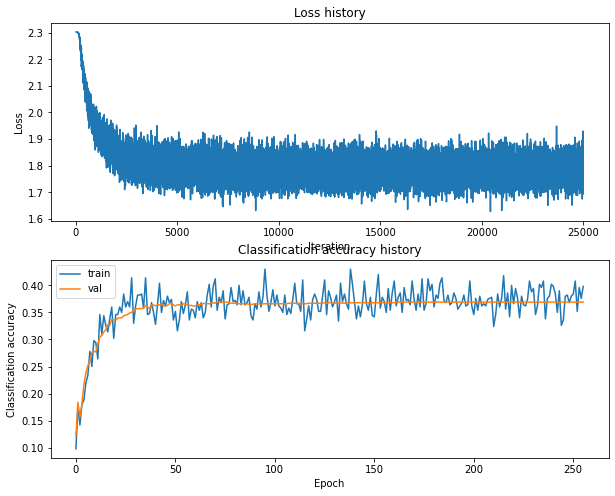

Training network with h_s 100, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.302957
iteration 100 / 25000: loss 1.988470
iteration 200 / 25000: loss 1.812424
iteration 300 / 25000: loss 1.797142
iteration 400 / 25000: loss 1.711000
iteration 500 / 25000: loss 1.626677
iteration 600 / 25000: loss 1.787980
iteration 700 / 25000: loss 1.657458
iteration 800 / 25000: loss 1.705805
iteration 900 / 25000: loss 1.713209
iteration 1000 / 25000: loss 1.652742
iteration 1100 / 25000: loss 1.661924
iteration 1200 / 25000: loss 1.693968
iteration 1300 / 25000: loss 1.655062
iteration 1400 / 25000: loss 1.604102
iteration 1500 / 25000: loss 1.651059
iteration 1600 / 25000: loss 1.688977
iteration 1700 / 25000: loss 1.616611
iteration 1800 / 25000: loss 1.711070
iteration 1900 / 25000: loss 1.596344
iteration 2000 / 25000: loss 1.668911
iteration 2100 / 25000: loss 1.643216
iteration 2200 / 25000: loss 1.623669
iteration 2300 / 25000: loss 1.673611
iteration 2400 / 25000: loss 1.616475
i

iteration 21200 / 25000: loss 1.574395
iteration 21300 / 25000: loss 1.570486
iteration 21400 / 25000: loss 1.660309
iteration 21500 / 25000: loss 1.541032
iteration 21600 / 25000: loss 1.673460
iteration 21700 / 25000: loss 1.570158
iteration 21800 / 25000: loss 1.690305
iteration 21900 / 25000: loss 1.629474
iteration 22000 / 25000: loss 1.715458
iteration 22100 / 25000: loss 1.585094
iteration 22200 / 25000: loss 1.644814
iteration 22300 / 25000: loss 1.651195
iteration 22400 / 25000: loss 1.539566
iteration 22500 / 25000: loss 1.625326
iteration 22600 / 25000: loss 1.675684
iteration 22700 / 25000: loss 1.663833
iteration 22800 / 25000: loss 1.648952
iteration 22900 / 25000: loss 1.654221
iteration 23000 / 25000: loss 1.692826
iteration 23100 / 25000: loss 1.658582
iteration 23200 / 25000: loss 1.610848
iteration 23300 / 25000: loss 1.670293
iteration 23400 / 25000: loss 1.647737
iteration 23500 / 25000: loss 1.543145
iteration 23600 / 25000: loss 1.690718
iteration 23700 / 25000: 

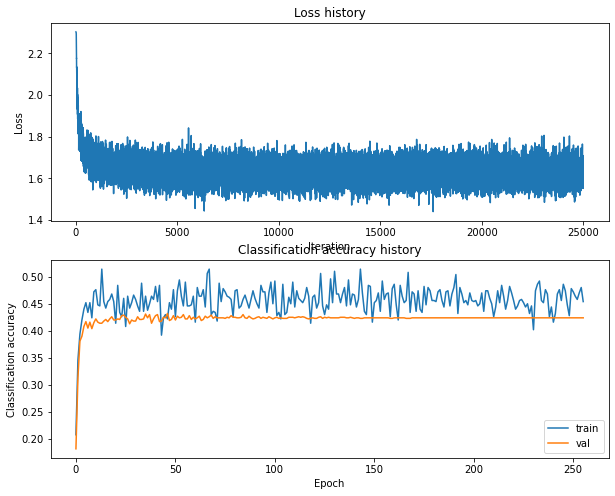

Training network with h_s 170, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.303264
iteration 100 / 500: loss 2.300424
iteration 200 / 500: loss 2.204954
iteration 300 / 500: loss 2.080498
iteration 400 / 500: loss 2.065114
Validation accuracy:  0.267


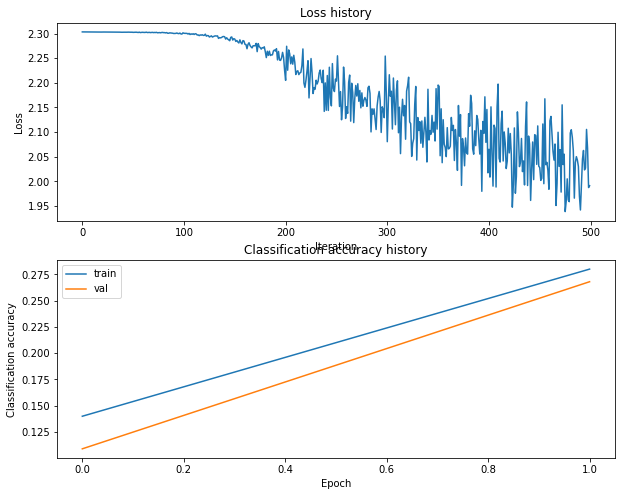

Training network with h_s 170, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.303192
iteration 100 / 500: loss 1.924608
iteration 200 / 500: loss 1.945478
iteration 300 / 500: loss 1.751904
iteration 400 / 500: loss 1.755569
Validation accuracy:  0.365


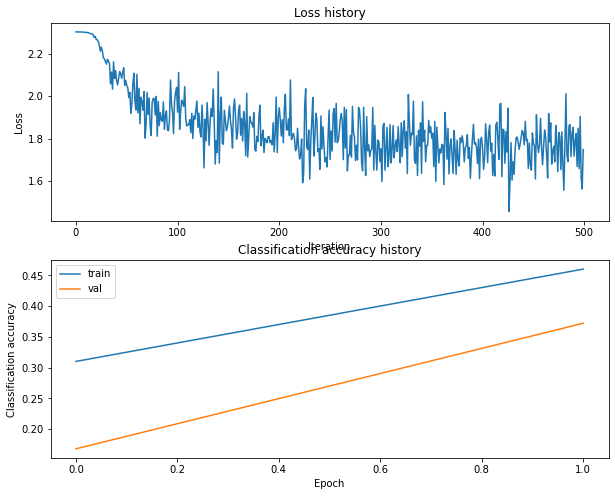

Training network with h_s 170, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.303285
iteration 100 / 500: loss 2.299787
iteration 200 / 500: loss 2.240558
iteration 300 / 500: loss 2.130416
iteration 400 / 500: loss 2.101129
Validation accuracy:  0.256


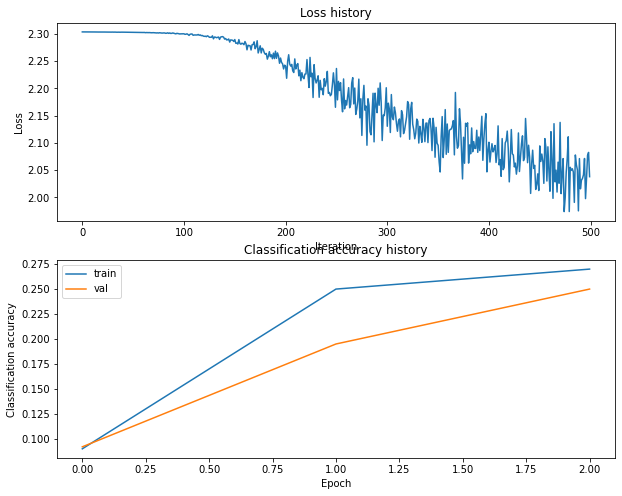

Training network with h_s 170, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.303204
iteration 100 / 500: loss 1.906998
iteration 200 / 500: loss 1.759931
iteration 300 / 500: loss 1.808711
iteration 400 / 500: loss 1.705351
Validation accuracy:  0.409


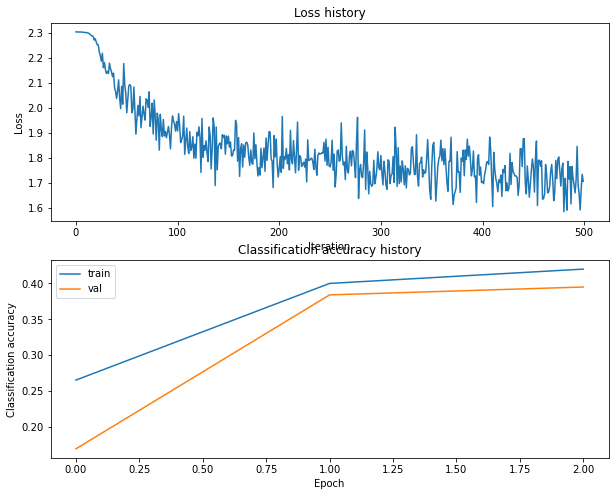

Training network with h_s 170, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.303254
iteration 100 / 500: loss 2.300548
iteration 200 / 500: loss 2.259038
iteration 300 / 500: loss 2.194038
iteration 400 / 500: loss 2.145262
Validation accuracy:  0.253


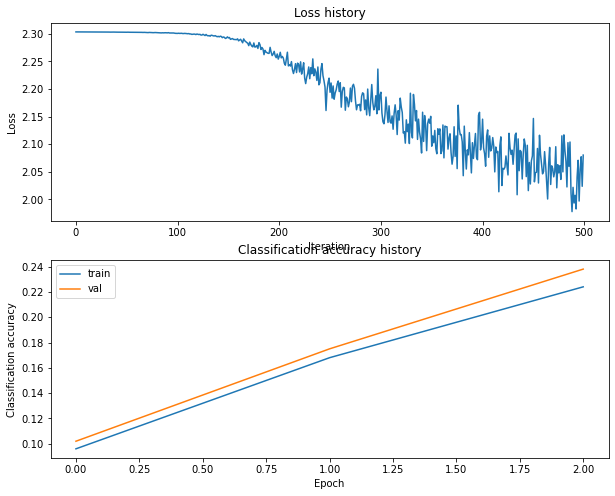

Training network with h_s 170, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.303272
iteration 100 / 500: loss 1.823703
iteration 200 / 500: loss 1.800241
iteration 300 / 500: loss 1.700582
iteration 400 / 500: loss 1.765966
Validation accuracy:  0.404


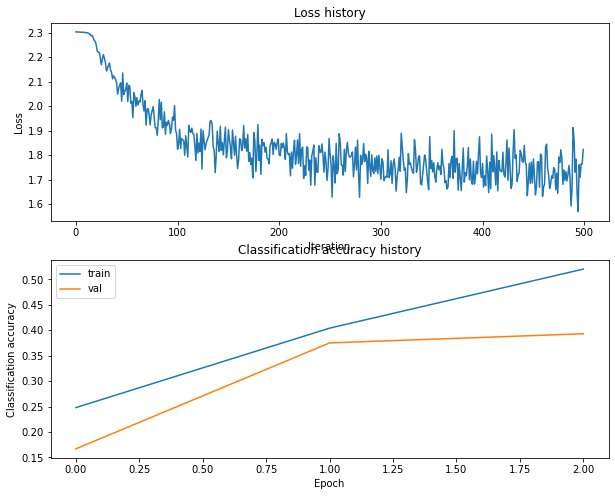

Training network with h_s 170, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.303236
iteration 100 / 500: loss 2.299759
iteration 200 / 500: loss 2.249200
iteration 300 / 500: loss 2.120147
iteration 400 / 500: loss 2.120363
Validation accuracy:  0.264


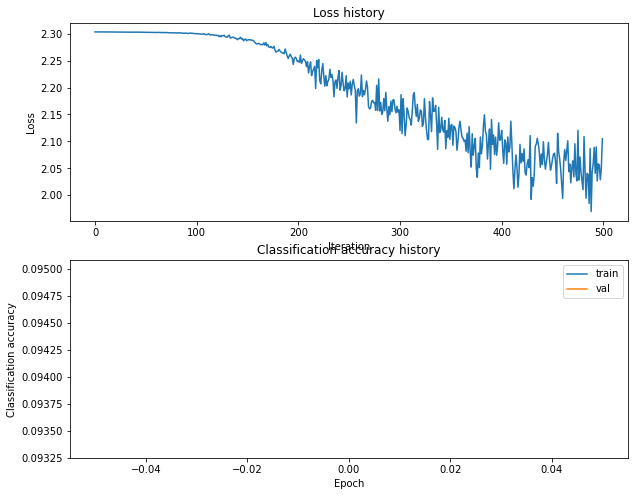

Training network with h_s 170, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.303179
iteration 100 / 500: loss 1.853855
iteration 200 / 500: loss 1.806686
iteration 300 / 500: loss 1.737646
iteration 400 / 500: loss 1.712536
Validation accuracy:  0.392


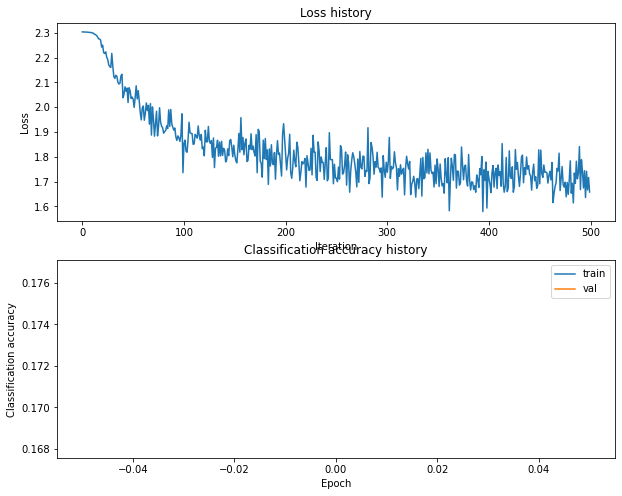

Training network with h_s 170, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.303226
iteration 100 / 500: loss 2.300305
iteration 200 / 500: loss 2.259437
iteration 300 / 500: loss 2.167588
iteration 400 / 500: loss 2.102193
Validation accuracy:  0.249


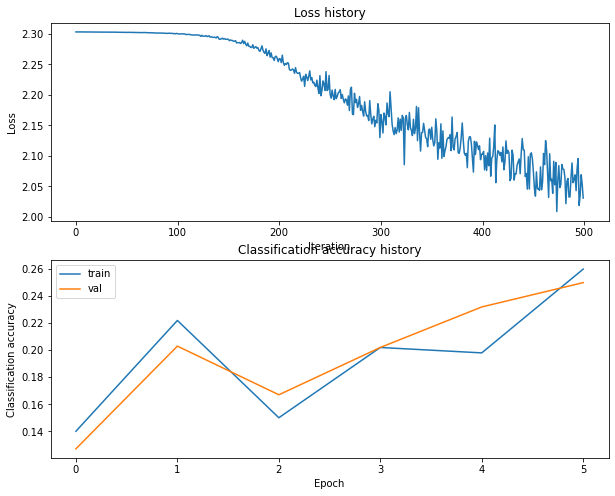

Training network with h_s 170, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.303268
iteration 100 / 500: loss 1.994456
iteration 200 / 500: loss 1.748257
iteration 300 / 500: loss 1.748097
iteration 400 / 500: loss 1.738962
Validation accuracy:  0.395


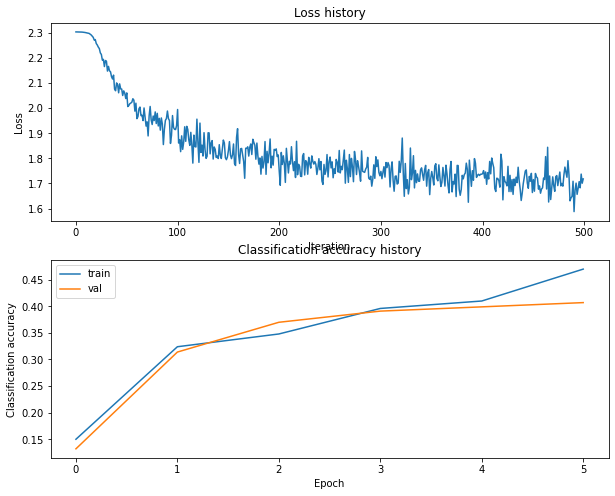

Training network with h_s 170, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.303306
iteration 100 / 1000: loss 2.300516
iteration 200 / 1000: loss 2.256286
iteration 300 / 1000: loss 2.195616
iteration 400 / 1000: loss 2.048942
iteration 500 / 1000: loss 2.008621
iteration 600 / 1000: loss 1.994514
iteration 700 / 1000: loss 2.006647
iteration 800 / 1000: loss 1.942050
iteration 900 / 1000: loss 1.912804
Validation accuracy:  0.321


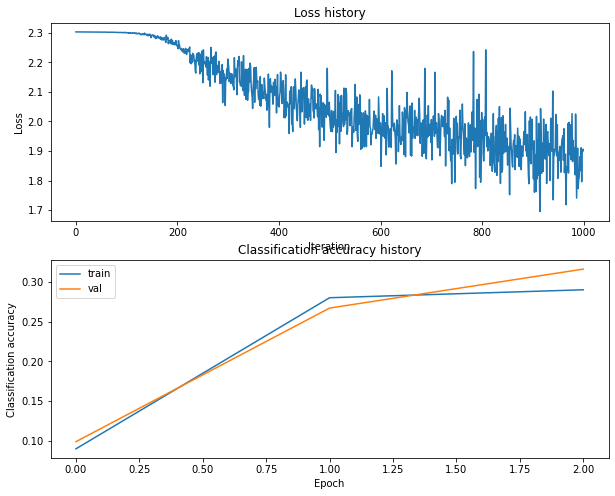

Training network with h_s 170, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.303220
iteration 100 / 1000: loss 1.758739
iteration 200 / 1000: loss 1.843629
iteration 300 / 1000: loss 1.731939
iteration 400 / 1000: loss 1.641412
iteration 500 / 1000: loss 1.889855
iteration 600 / 1000: loss 1.703907
iteration 700 / 1000: loss 1.785332
iteration 800 / 1000: loss 1.784312
iteration 900 / 1000: loss 1.727837
Validation accuracy:  0.399


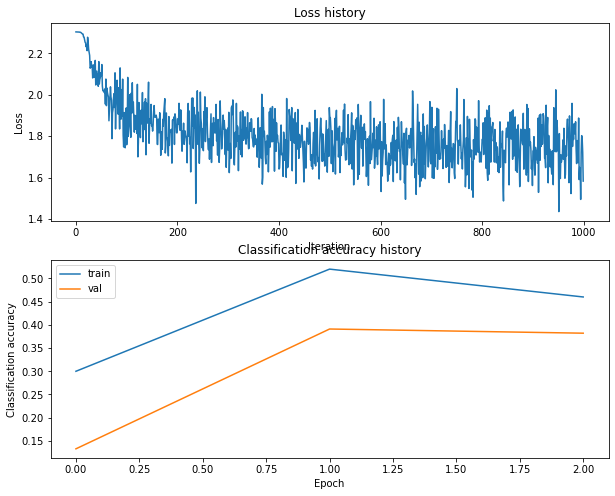

Training network with h_s 170, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.303267
iteration 100 / 1000: loss 2.299156
iteration 200 / 1000: loss 2.259203
iteration 300 / 1000: loss 2.115879
iteration 400 / 1000: loss 2.048957
iteration 500 / 1000: loss 1.997084
iteration 600 / 1000: loss 1.931598
iteration 700 / 1000: loss 2.047340
iteration 800 / 1000: loss 1.908729
iteration 900 / 1000: loss 1.931713
Validation accuracy:  0.32


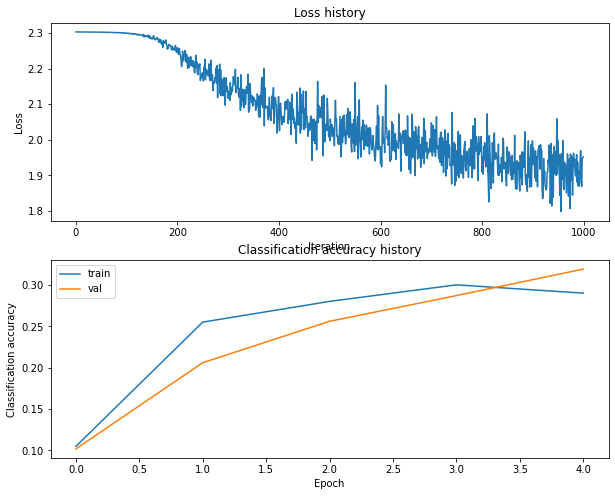

Training network with h_s 170, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.303259
iteration 100 / 1000: loss 1.938017
iteration 200 / 1000: loss 1.701064
iteration 300 / 1000: loss 1.598726
iteration 400 / 1000: loss 1.809086
iteration 500 / 1000: loss 1.739772
iteration 600 / 1000: loss 1.656332
iteration 700 / 1000: loss 1.836968
iteration 800 / 1000: loss 1.730485
iteration 900 / 1000: loss 1.712579
Validation accuracy:  0.409


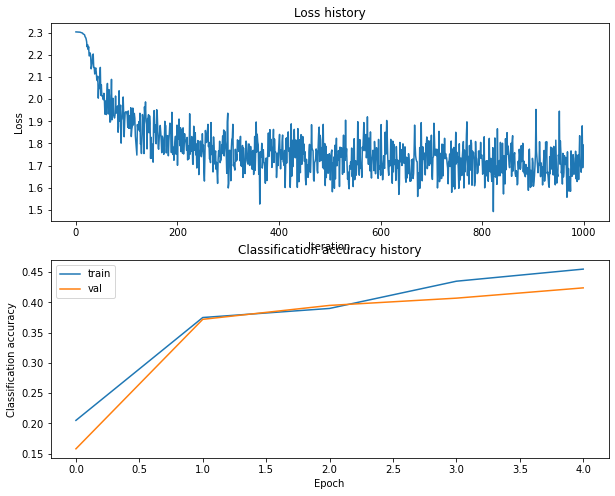

Training network with h_s 170, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.303251
iteration 100 / 1000: loss 2.299530
iteration 200 / 1000: loss 2.244309
iteration 300 / 1000: loss 2.167805
iteration 400 / 1000: loss 2.066032
iteration 500 / 1000: loss 2.024157
iteration 600 / 1000: loss 2.022851
iteration 700 / 1000: loss 1.899510
iteration 800 / 1000: loss 1.924777
iteration 900 / 1000: loss 2.001822
Validation accuracy:  0.31


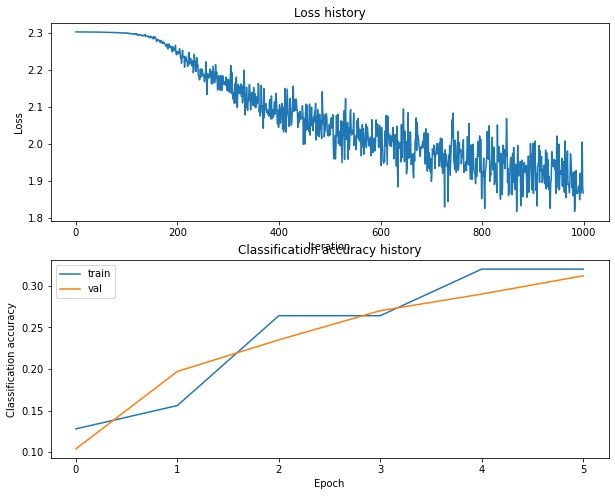

Training network with h_s 170, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.303196
iteration 100 / 1000: loss 1.931028
iteration 200 / 1000: loss 1.770093
iteration 300 / 1000: loss 1.819241
iteration 400 / 1000: loss 1.684311
iteration 500 / 1000: loss 1.722107
iteration 600 / 1000: loss 1.764854
iteration 700 / 1000: loss 1.778959
iteration 800 / 1000: loss 1.716585
iteration 900 / 1000: loss 1.715114
Validation accuracy:  0.425


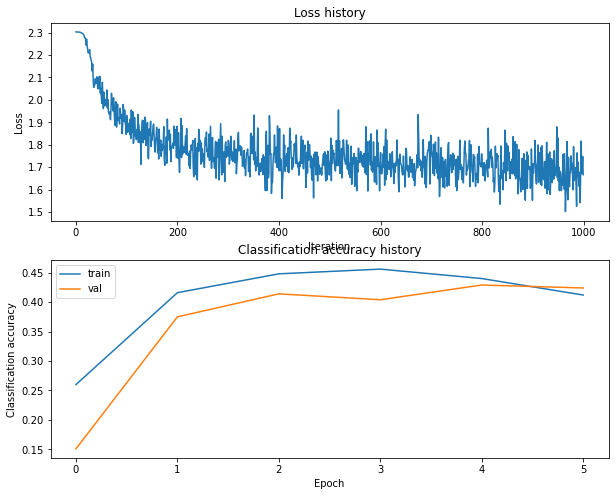

Training network with h_s 170, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.303275
iteration 100 / 1000: loss 2.298922
iteration 200 / 1000: loss 2.240209
iteration 300 / 1000: loss 2.169138
iteration 400 / 1000: loss 2.075754
iteration 500 / 1000: loss 2.042600
iteration 600 / 1000: loss 1.976255
iteration 700 / 1000: loss 1.958101
iteration 800 / 1000: loss 1.906565
iteration 900 / 1000: loss 1.917586
Validation accuracy:  0.322


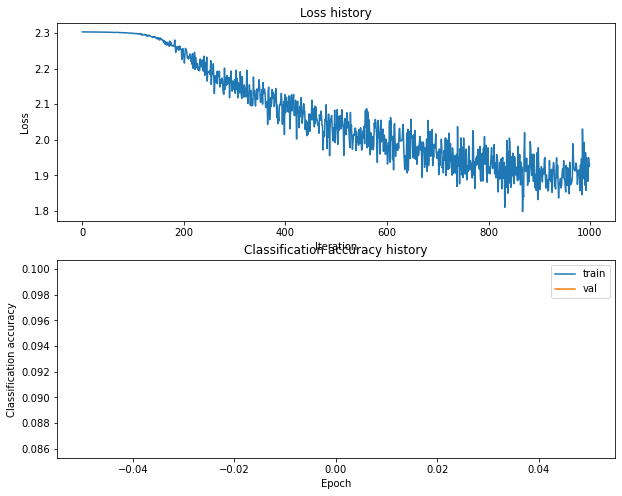

Training network with h_s 170, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.303252
iteration 100 / 1000: loss 1.853008
iteration 200 / 1000: loss 1.774543
iteration 300 / 1000: loss 1.694565
iteration 400 / 1000: loss 1.703025
iteration 500 / 1000: loss 1.674573
iteration 600 / 1000: loss 1.729340
iteration 700 / 1000: loss 1.641369
iteration 800 / 1000: loss 1.732650
iteration 900 / 1000: loss 1.706442
Validation accuracy:  0.396


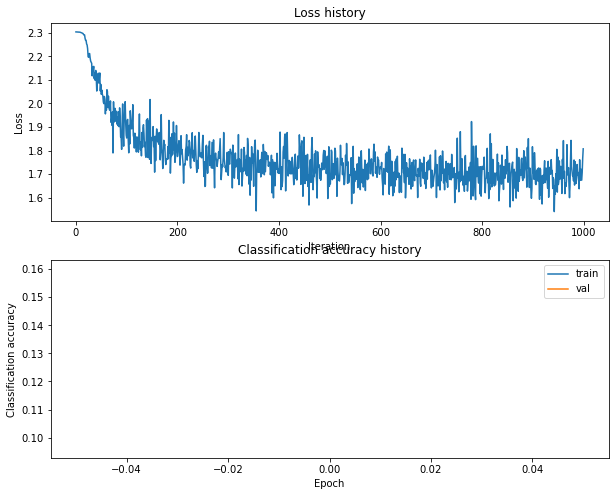

Training network with h_s 170, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.303249
iteration 100 / 1000: loss 2.299754
iteration 200 / 1000: loss 2.249368
iteration 300 / 1000: loss 2.163755
iteration 400 / 1000: loss 2.096706
iteration 500 / 1000: loss 2.052139
iteration 600 / 1000: loss 2.046387
iteration 700 / 1000: loss 2.009861
iteration 800 / 1000: loss 1.933735
iteration 900 / 1000: loss 1.966794
Validation accuracy:  0.296


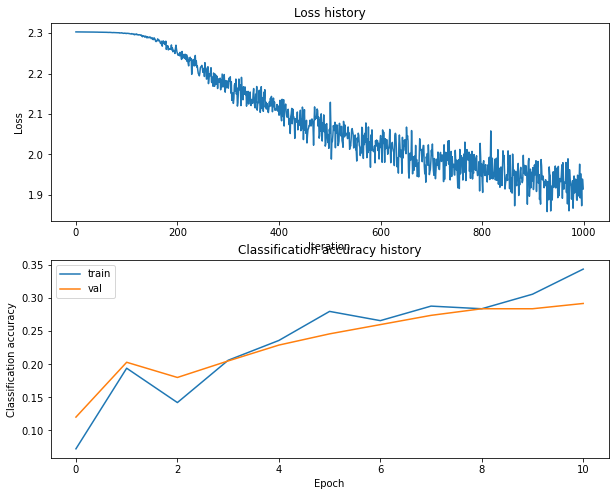

Training network with h_s 170, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.303286
iteration 100 / 1000: loss 1.909306
iteration 200 / 1000: loss 1.771050
iteration 300 / 1000: loss 1.796833
iteration 400 / 1000: loss 1.765892
iteration 500 / 1000: loss 1.779283
iteration 600 / 1000: loss 1.703236
iteration 700 / 1000: loss 1.691374
iteration 800 / 1000: loss 1.624105
iteration 900 / 1000: loss 1.746035
Validation accuracy:  0.423


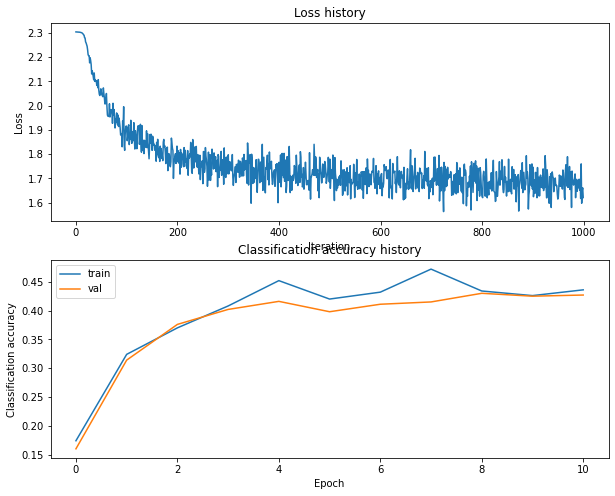

Training network with h_s 170, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.303249
iteration 100 / 1500: loss 2.298933
iteration 200 / 1500: loss 2.224093
iteration 300 / 1500: loss 2.154449
iteration 400 / 1500: loss 2.039918
iteration 500 / 1500: loss 2.033117
iteration 600 / 1500: loss 1.920566
iteration 700 / 1500: loss 1.964278
iteration 800 / 1500: loss 1.902538
iteration 900 / 1500: loss 1.904536
iteration 1000 / 1500: loss 1.877587
iteration 1100 / 1500: loss 1.851028
iteration 1200 / 1500: loss 1.825705
iteration 1300 / 1500: loss 1.850062
iteration 1400 / 1500: loss 1.954507
Validation accuracy:  0.35


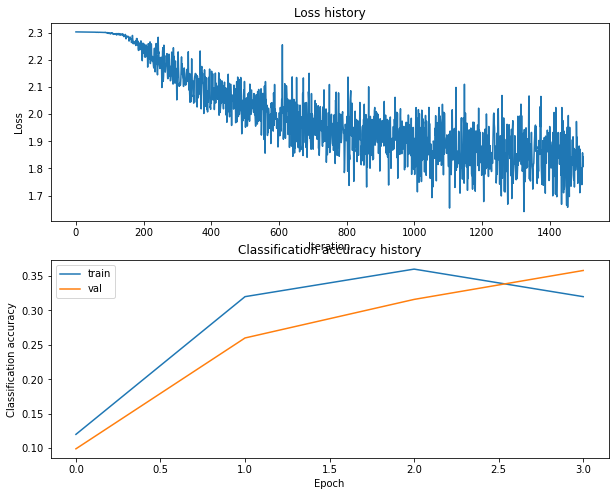

Training network with h_s 170, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.303254
iteration 100 / 1500: loss 1.874068
iteration 200 / 1500: loss 1.732338
iteration 300 / 1500: loss 1.736229
iteration 400 / 1500: loss 1.783292
iteration 500 / 1500: loss 1.625896
iteration 600 / 1500: loss 1.796081
iteration 700 / 1500: loss 1.764779
iteration 800 / 1500: loss 1.720068
iteration 900 / 1500: loss 1.774590
iteration 1000 / 1500: loss 1.675092
iteration 1100 / 1500: loss 1.821480
iteration 1200 / 1500: loss 1.769309
iteration 1300 / 1500: loss 1.659061
iteration 1400 / 1500: loss 1.786600
Validation accuracy:  0.378


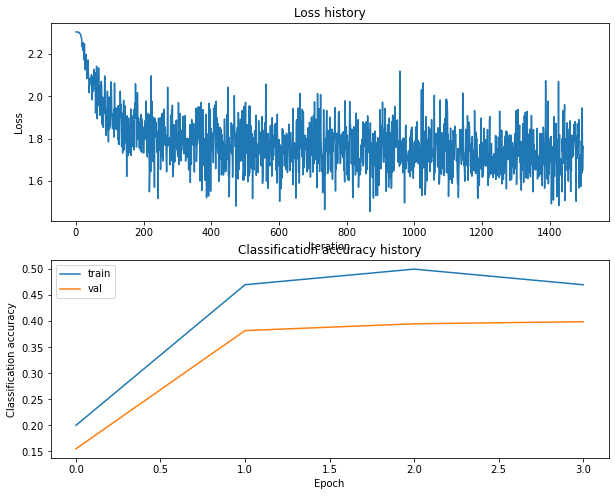

Training network with h_s 170, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.303191
iteration 100 / 1500: loss 2.299806
iteration 200 / 1500: loss 2.235893
iteration 300 / 1500: loss 2.098592
iteration 400 / 1500: loss 2.072344
iteration 500 / 1500: loss 2.033747
iteration 600 / 1500: loss 1.961866
iteration 700 / 1500: loss 1.993395
iteration 800 / 1500: loss 1.925009
iteration 900 / 1500: loss 1.950155
iteration 1000 / 1500: loss 1.875538
iteration 1100 / 1500: loss 1.857884
iteration 1200 / 1500: loss 1.832096
iteration 1300 / 1500: loss 1.889178
iteration 1400 / 1500: loss 1.869480
Validation accuracy:  0.339


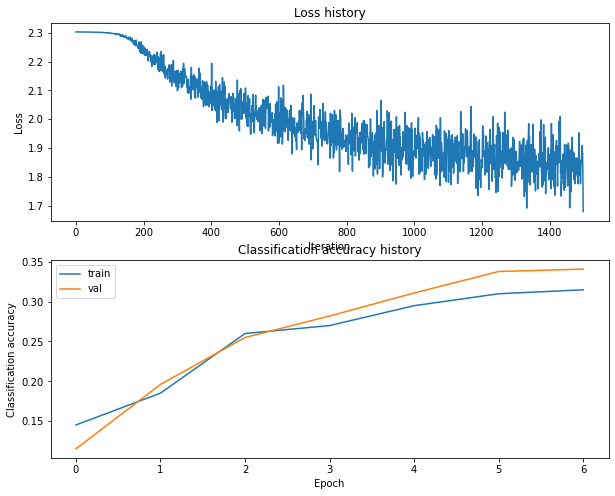

Training network with h_s 170, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.303278
iteration 100 / 1500: loss 1.947701
iteration 200 / 1500: loss 1.836864
iteration 300 / 1500: loss 1.794416
iteration 400 / 1500: loss 1.771531
iteration 500 / 1500: loss 1.691326
iteration 600 / 1500: loss 1.698618
iteration 700 / 1500: loss 1.746561
iteration 800 / 1500: loss 1.735046
iteration 900 / 1500: loss 1.649030
iteration 1000 / 1500: loss 1.766296
iteration 1100 / 1500: loss 1.713902
iteration 1200 / 1500: loss 1.614615
iteration 1300 / 1500: loss 1.785233
iteration 1400 / 1500: loss 1.673875
Validation accuracy:  0.392


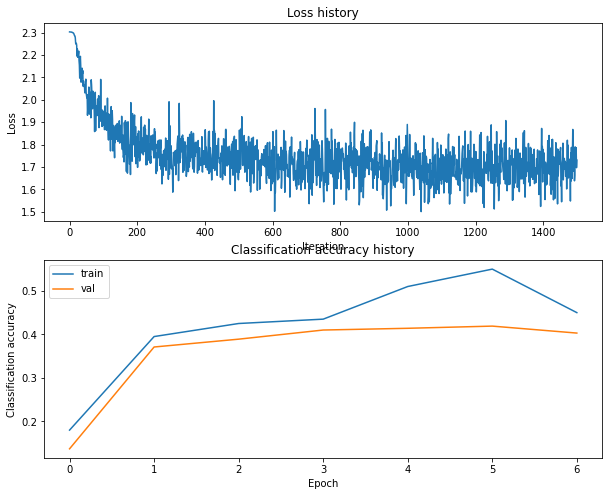

Training network with h_s 170, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.303254
iteration 100 / 1500: loss 2.299988
iteration 200 / 1500: loss 2.247564
iteration 300 / 1500: loss 2.171000
iteration 400 / 1500: loss 2.132788
iteration 500 / 1500: loss 2.063266
iteration 600 / 1500: loss 1.955809
iteration 700 / 1500: loss 1.977425
iteration 800 / 1500: loss 1.988785
iteration 900 / 1500: loss 1.956908
iteration 1000 / 1500: loss 1.905958
iteration 1100 / 1500: loss 1.959390
iteration 1200 / 1500: loss 1.849756
iteration 1300 / 1500: loss 1.915511
iteration 1400 / 1500: loss 1.842215
Validation accuracy:  0.341


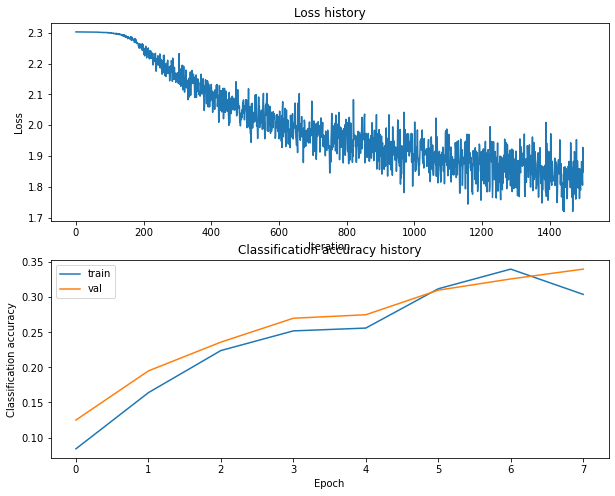

Training network with h_s 170, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.303290
iteration 100 / 1500: loss 1.922839
iteration 200 / 1500: loss 1.777537
iteration 300 / 1500: loss 1.731617
iteration 400 / 1500: loss 1.673107
iteration 500 / 1500: loss 1.737387
iteration 600 / 1500: loss 1.780949
iteration 700 / 1500: loss 1.700950
iteration 800 / 1500: loss 1.643448
iteration 900 / 1500: loss 1.709074
iteration 1000 / 1500: loss 1.637339
iteration 1100 / 1500: loss 1.789415
iteration 1200 / 1500: loss 1.576456
iteration 1300 / 1500: loss 1.677719
iteration 1400 / 1500: loss 1.657205
Validation accuracy:  0.415


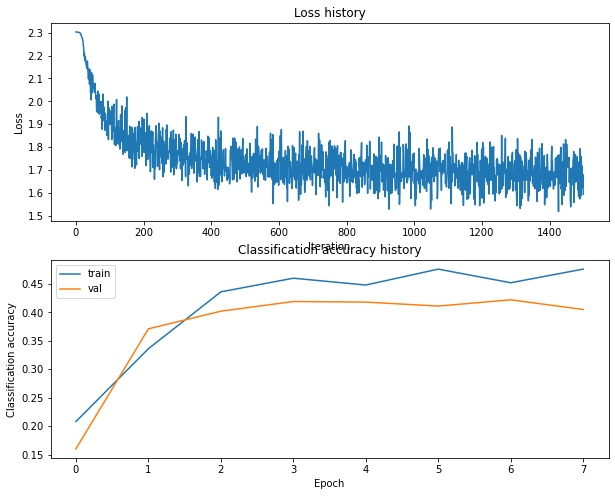

Training network with h_s 170, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.303211
iteration 100 / 1500: loss 2.299833
iteration 200 / 1500: loss 2.243042
iteration 300 / 1500: loss 2.143180
iteration 400 / 1500: loss 2.042178
iteration 500 / 1500: loss 2.023654
iteration 600 / 1500: loss 2.017458
iteration 700 / 1500: loss 1.914785
iteration 800 / 1500: loss 2.001728
iteration 900 / 1500: loss 1.917582
iteration 1000 / 1500: loss 1.899870
iteration 1100 / 1500: loss 1.872125
iteration 1200 / 1500: loss 1.859289
iteration 1300 / 1500: loss 1.837004
iteration 1400 / 1500: loss 1.837861
Validation accuracy:  0.354


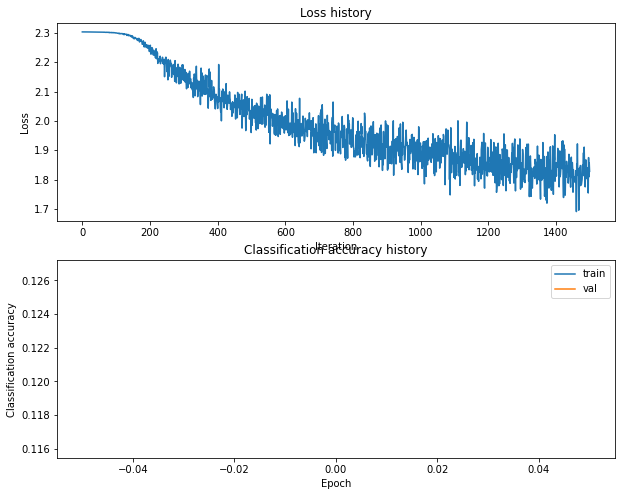

Training network with h_s 170, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.303209
iteration 100 / 1500: loss 1.972060
iteration 200 / 1500: loss 1.832882
iteration 300 / 1500: loss 1.823034
iteration 400 / 1500: loss 1.684081
iteration 500 / 1500: loss 1.754998
iteration 600 / 1500: loss 1.723984
iteration 700 / 1500: loss 1.764825
iteration 800 / 1500: loss 1.702553
iteration 900 / 1500: loss 1.826626
iteration 1000 / 1500: loss 1.615113
iteration 1100 / 1500: loss 1.751094
iteration 1200 / 1500: loss 1.732253
iteration 1300 / 1500: loss 1.738261
iteration 1400 / 1500: loss 1.624236
Validation accuracy:  0.406


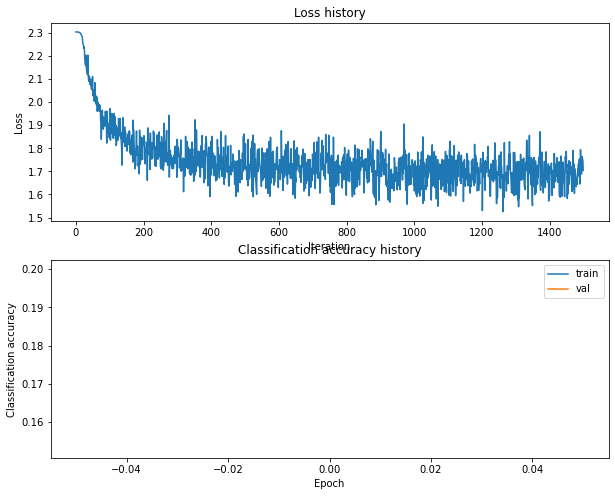

Training network with h_s 170, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.303259
iteration 100 / 1500: loss 2.299934
iteration 200 / 1500: loss 2.252355
iteration 300 / 1500: loss 2.205125
iteration 400 / 1500: loss 2.148705
iteration 500 / 1500: loss 2.006866
iteration 600 / 1500: loss 2.023654
iteration 700 / 1500: loss 1.976647
iteration 800 / 1500: loss 1.944076
iteration 900 / 1500: loss 1.964566
iteration 1000 / 1500: loss 1.924169
iteration 1100 / 1500: loss 1.912187
iteration 1200 / 1500: loss 1.922521
iteration 1300 / 1500: loss 1.889348
iteration 1400 / 1500: loss 1.829484
Validation accuracy:  0.325


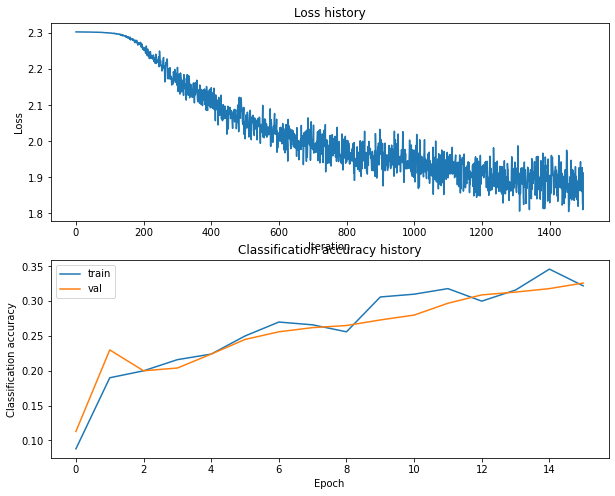

Training network with h_s 170, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.303249
iteration 100 / 1500: loss 1.861147
iteration 200 / 1500: loss 1.786128
iteration 300 / 1500: loss 1.757299
iteration 400 / 1500: loss 1.694671
iteration 500 / 1500: loss 1.677403
iteration 600 / 1500: loss 1.727001
iteration 700 / 1500: loss 1.701566
iteration 800 / 1500: loss 1.764905
iteration 900 / 1500: loss 1.617218
iteration 1000 / 1500: loss 1.718689
iteration 1100 / 1500: loss 1.694451
iteration 1200 / 1500: loss 1.683693
iteration 1300 / 1500: loss 1.624654
iteration 1400 / 1500: loss 1.728659
Validation accuracy:  0.415


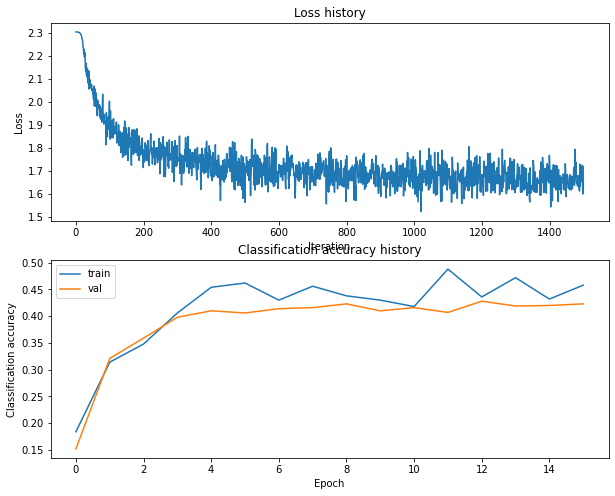

Training network with h_s 170, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.303260
iteration 100 / 2500: loss 2.299274
iteration 200 / 2500: loss 2.268752
iteration 300 / 2500: loss 2.119319
iteration 400 / 2500: loss 2.051569
iteration 500 / 2500: loss 2.062701
iteration 600 / 2500: loss 2.056556
iteration 700 / 2500: loss 2.039451
iteration 800 / 2500: loss 1.989152
iteration 900 / 2500: loss 1.896395
iteration 1000 / 2500: loss 1.977401
iteration 1100 / 2500: loss 1.737826
iteration 1200 / 2500: loss 1.977046
iteration 1300 / 2500: loss 1.799722
iteration 1400 / 2500: loss 1.769220
iteration 1500 / 2500: loss 1.781965
iteration 1600 / 2500: loss 1.767047
iteration 1700 / 2500: loss 1.930415
iteration 1800 / 2500: loss 1.906537
iteration 1900 / 2500: loss 1.841441
iteration 2000 / 2500: loss 1.790720
iteration 2100 / 2500: loss 1.782642
iteration 2200 / 2500: loss 1.617573
iteration 2300 / 2500: loss 1.915063
iteration 2400 / 2500: loss 1.847533
Validation accuracy:  0.38

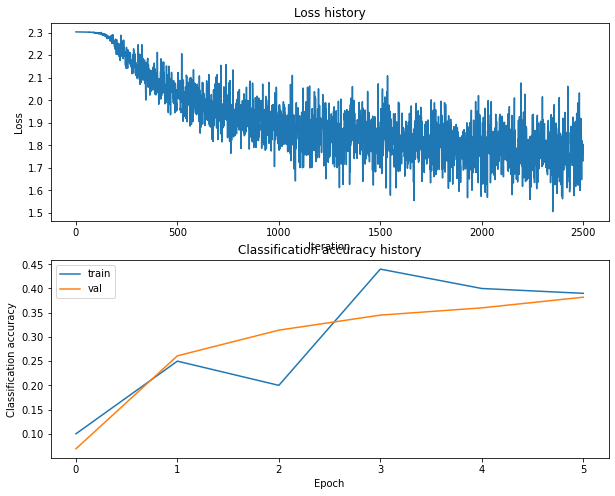

Training network with h_s 170, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.303233
iteration 100 / 2500: loss 2.013014
iteration 200 / 2500: loss 1.756968
iteration 300 / 2500: loss 1.877765
iteration 400 / 2500: loss 1.832021
iteration 500 / 2500: loss 1.694426
iteration 600 / 2500: loss 1.856958
iteration 700 / 2500: loss 1.828742
iteration 800 / 2500: loss 1.672710
iteration 900 / 2500: loss 1.729910
iteration 1000 / 2500: loss 1.821708
iteration 1100 / 2500: loss 1.819511
iteration 1200 / 2500: loss 1.775593
iteration 1300 / 2500: loss 1.766231
iteration 1400 / 2500: loss 1.772244
iteration 1500 / 2500: loss 1.888377
iteration 1600 / 2500: loss 1.828758
iteration 1700 / 2500: loss 1.727309
iteration 1800 / 2500: loss 1.838051
iteration 1900 / 2500: loss 1.873151
iteration 2000 / 2500: loss 1.665468
iteration 2100 / 2500: loss 1.690460
iteration 2200 / 2500: loss 1.824871
iteration 2300 / 2500: loss 1.731648
iteration 2400 / 2500: loss 1.632725
Validation accuracy:  0.405

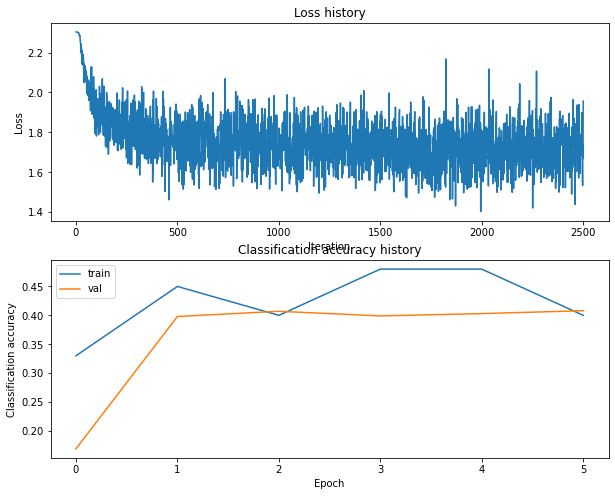

Training network with h_s 170, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.303263
iteration 100 / 2500: loss 2.299870
iteration 200 / 2500: loss 2.251039
iteration 300 / 2500: loss 2.168307
iteration 400 / 2500: loss 2.134630
iteration 500 / 2500: loss 2.024786
iteration 600 / 2500: loss 2.018591
iteration 700 / 2500: loss 1.993445
iteration 800 / 2500: loss 1.877725
iteration 900 / 2500: loss 1.947964
iteration 1000 / 2500: loss 2.014418
iteration 1100 / 2500: loss 1.860608
iteration 1200 / 2500: loss 1.812984
iteration 1300 / 2500: loss 1.841443
iteration 1400 / 2500: loss 1.790392
iteration 1500 / 2500: loss 1.904954
iteration 1600 / 2500: loss 1.780547
iteration 1700 / 2500: loss 1.867564
iteration 1800 / 2500: loss 1.912173
iteration 1900 / 2500: loss 1.752588
iteration 2000 / 2500: loss 1.823529
iteration 2100 / 2500: loss 1.744831
iteration 2200 / 2500: loss 1.739042
iteration 2300 / 2500: loss 1.805889
iteration 2400 / 2500: loss 1.797197
Validation accuracy:  0.38

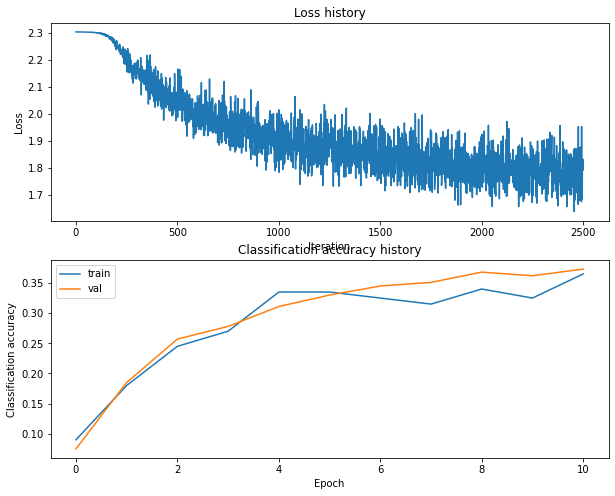

Training network with h_s 170, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.303274
iteration 100 / 2500: loss 1.905894
iteration 200 / 2500: loss 1.694169
iteration 300 / 2500: loss 1.767780
iteration 400 / 2500: loss 1.721417
iteration 500 / 2500: loss 1.790190
iteration 600 / 2500: loss 1.852517
iteration 700 / 2500: loss 1.700547
iteration 800 / 2500: loss 1.785149
iteration 900 / 2500: loss 1.665100
iteration 1000 / 2500: loss 1.779829
iteration 1100 / 2500: loss 1.681991
iteration 1200 / 2500: loss 1.624156
iteration 1300 / 2500: loss 1.790315
iteration 1400 / 2500: loss 1.594160
iteration 1500 / 2500: loss 1.748292
iteration 1600 / 2500: loss 1.724385
iteration 1700 / 2500: loss 1.789339
iteration 1800 / 2500: loss 1.678174
iteration 1900 / 2500: loss 1.647122
iteration 2000 / 2500: loss 1.801475
iteration 2100 / 2500: loss 1.706971
iteration 2200 / 2500: loss 1.733663
iteration 2300 / 2500: loss 1.691384
iteration 2400 / 2500: loss 1.601778
Validation accuracy:  0.398

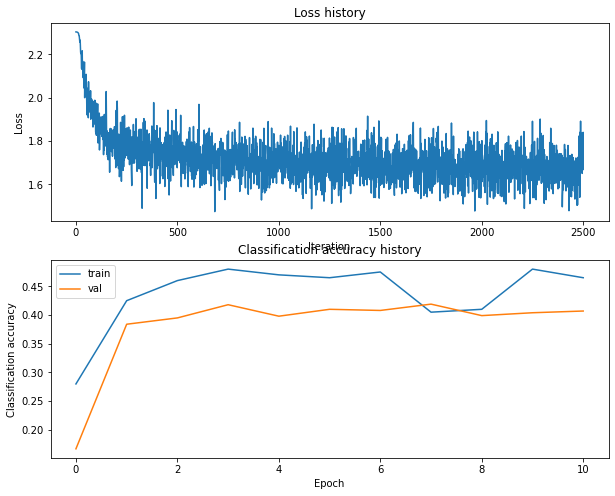

Training network with h_s 170, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.303225
iteration 100 / 2500: loss 2.300441
iteration 200 / 2500: loss 2.242408
iteration 300 / 2500: loss 2.174678
iteration 400 / 2500: loss 2.073688
iteration 500 / 2500: loss 2.006121
iteration 600 / 2500: loss 1.954473
iteration 700 / 2500: loss 1.925211
iteration 800 / 2500: loss 1.947037
iteration 900 / 2500: loss 1.913224
iteration 1000 / 2500: loss 1.800470
iteration 1100 / 2500: loss 1.917549
iteration 1200 / 2500: loss 1.819620
iteration 1300 / 2500: loss 1.843337
iteration 1400 / 2500: loss 1.839399
iteration 1500 / 2500: loss 1.884966
iteration 1600 / 2500: loss 1.810216
iteration 1700 / 2500: loss 1.874406
iteration 1800 / 2500: loss 1.875208
iteration 1900 / 2500: loss 1.721990
iteration 2000 / 2500: loss 1.763138
iteration 2100 / 2500: loss 1.719161
iteration 2200 / 2500: loss 1.817864
iteration 2300 / 2500: loss 1.645245
iteration 2400 / 2500: loss 1.786355
Validation accuracy:  0.37

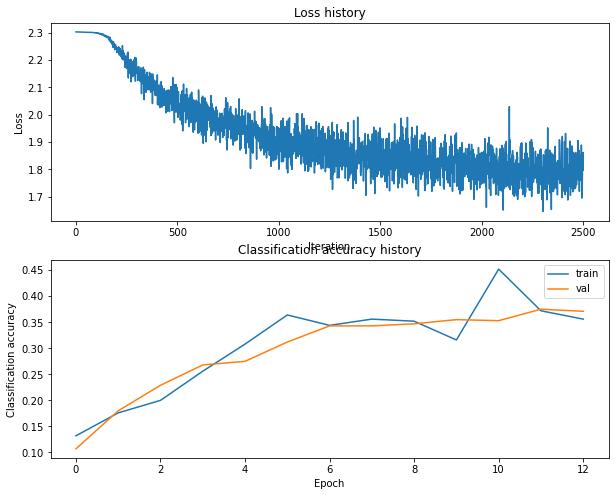

Training network with h_s 170, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.303243
iteration 100 / 2500: loss 1.857444
iteration 200 / 2500: loss 1.703100
iteration 300 / 2500: loss 1.765240
iteration 400 / 2500: loss 1.680566
iteration 500 / 2500: loss 1.676234
iteration 600 / 2500: loss 1.793051
iteration 700 / 2500: loss 1.755950
iteration 800 / 2500: loss 1.817238
iteration 900 / 2500: loss 1.799708
iteration 1000 / 2500: loss 1.604405
iteration 1100 / 2500: loss 1.626475
iteration 1200 / 2500: loss 1.682574
iteration 1300 / 2500: loss 1.572350
iteration 1400 / 2500: loss 1.674325
iteration 1500 / 2500: loss 1.804901
iteration 1600 / 2500: loss 1.618491
iteration 1700 / 2500: loss 1.577136
iteration 1800 / 2500: loss 1.787920
iteration 1900 / 2500: loss 1.690573
iteration 2000 / 2500: loss 1.610368
iteration 2100 / 2500: loss 1.687635
iteration 2200 / 2500: loss 1.644720
iteration 2300 / 2500: loss 1.702442
iteration 2400 / 2500: loss 1.676928
Validation accuracy:  0.414

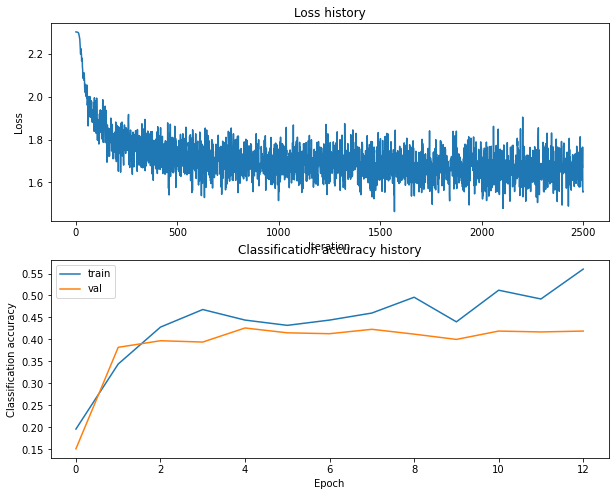

Training network with h_s 170, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.303201
iteration 100 / 2500: loss 2.300153
iteration 200 / 2500: loss 2.246939
iteration 300 / 2500: loss 2.142273
iteration 400 / 2500: loss 2.078766
iteration 500 / 2500: loss 2.038090
iteration 600 / 2500: loss 1.965821
iteration 700 / 2500: loss 1.918177
iteration 800 / 2500: loss 1.864794
iteration 900 / 2500: loss 1.963061
iteration 1000 / 2500: loss 1.897853
iteration 1100 / 2500: loss 1.831696
iteration 1200 / 2500: loss 1.821624
iteration 1300 / 2500: loss 1.801218
iteration 1400 / 2500: loss 1.712292
iteration 1500 / 2500: loss 1.813972
iteration 1600 / 2500: loss 1.820337
iteration 1700 / 2500: loss 1.845250
iteration 1800 / 2500: loss 1.782933
iteration 1900 / 2500: loss 1.835313
iteration 2000 / 2500: loss 1.802551
iteration 2100 / 2500: loss 1.831284
iteration 2200 / 2500: loss 1.789287
iteration 2300 / 2500: loss 1.848238
iteration 2400 / 2500: loss 1.793095
Validation accuracy:  0.40

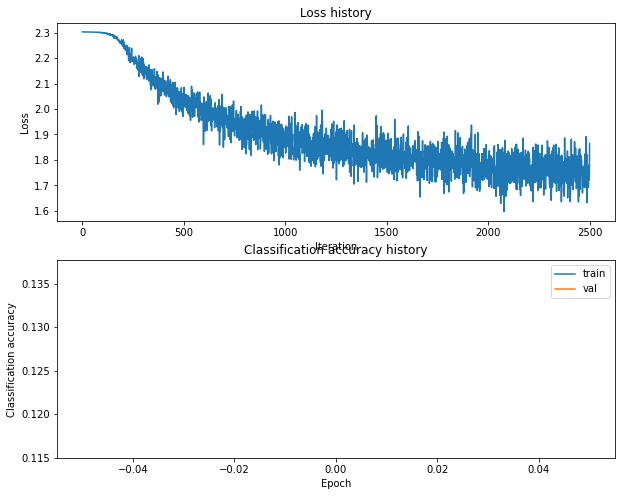

Training network with h_s 170, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.303255
iteration 100 / 2500: loss 1.934172
iteration 200 / 2500: loss 1.822581
iteration 300 / 2500: loss 1.635666
iteration 400 / 2500: loss 1.654861
iteration 500 / 2500: loss 1.719610
iteration 600 / 2500: loss 1.689434
iteration 700 / 2500: loss 1.806773
iteration 800 / 2500: loss 1.750414
iteration 900 / 2500: loss 1.764292
iteration 1000 / 2500: loss 1.669331
iteration 1100 / 2500: loss 1.683847
iteration 1200 / 2500: loss 1.721864
iteration 1300 / 2500: loss 1.609693
iteration 1400 / 2500: loss 1.658427
iteration 1500 / 2500: loss 1.762207
iteration 1600 / 2500: loss 1.714329
iteration 1700 / 2500: loss 1.688964
iteration 1800 / 2500: loss 1.633606
iteration 1900 / 2500: loss 1.586621
iteration 2000 / 2500: loss 1.724927
iteration 2100 / 2500: loss 1.611971
iteration 2200 / 2500: loss 1.722542
iteration 2300 / 2500: loss 1.685880
iteration 2400 / 2500: loss 1.706415
Validation accuracy:  0.392

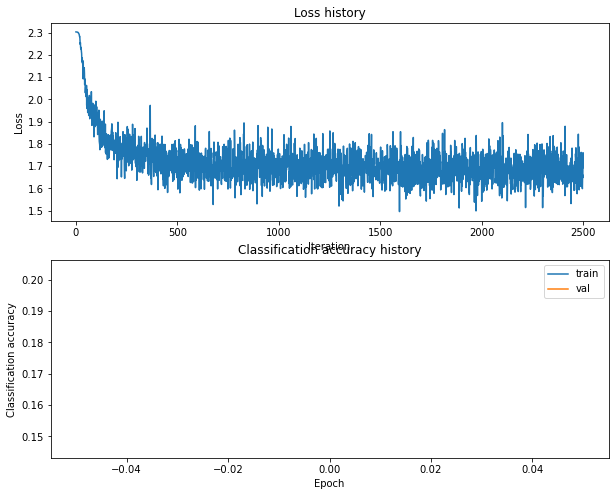

Training network with h_s 170, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.303234
iteration 100 / 2500: loss 2.300169
iteration 200 / 2500: loss 2.253458
iteration 300 / 2500: loss 2.181019
iteration 400 / 2500: loss 2.118876
iteration 500 / 2500: loss 2.027114
iteration 600 / 2500: loss 1.982177
iteration 700 / 2500: loss 1.964373
iteration 800 / 2500: loss 1.946791
iteration 900 / 2500: loss 1.952015
iteration 1000 / 2500: loss 1.864954
iteration 1100 / 2500: loss 1.932356
iteration 1200 / 2500: loss 1.850836
iteration 1300 / 2500: loss 1.890402
iteration 1400 / 2500: loss 1.885470
iteration 1500 / 2500: loss 1.873177
iteration 1600 / 2500: loss 1.857937
iteration 1700 / 2500: loss 1.898963
iteration 1800 / 2500: loss 1.765715
iteration 1900 / 2500: loss 1.781608
iteration 2000 / 2500: loss 1.865320
iteration 2100 / 2500: loss 1.850091
iteration 2200 / 2500: loss 1.830658
iteration 2300 / 2500: loss 1.840330
iteration 2400 / 2500: loss 1.832064
Validation accuracy:  0.35

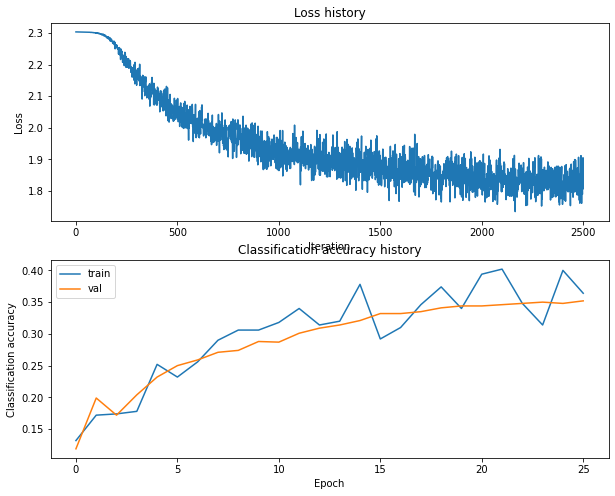

Training network with h_s 170, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.303205
iteration 100 / 2500: loss 1.917429
iteration 200 / 2500: loss 1.829704
iteration 300 / 2500: loss 1.731151
iteration 400 / 2500: loss 1.684547
iteration 500 / 2500: loss 1.702978
iteration 600 / 2500: loss 1.724642
iteration 700 / 2500: loss 1.614497
iteration 800 / 2500: loss 1.668065
iteration 900 / 2500: loss 1.680886
iteration 1000 / 2500: loss 1.664803
iteration 1100 / 2500: loss 1.731100
iteration 1200 / 2500: loss 1.665962
iteration 1300 / 2500: loss 1.711064
iteration 1400 / 2500: loss 1.606943
iteration 1500 / 2500: loss 1.691304
iteration 1600 / 2500: loss 1.704969
iteration 1700 / 2500: loss 1.715097
iteration 1800 / 2500: loss 1.726501
iteration 1900 / 2500: loss 1.685493
iteration 2000 / 2500: loss 1.727736
iteration 2100 / 2500: loss 1.700071
iteration 2200 / 2500: loss 1.613604
iteration 2300 / 2500: loss 1.656032
iteration 2400 / 2500: loss 1.687141
Validation accuracy:  0.417

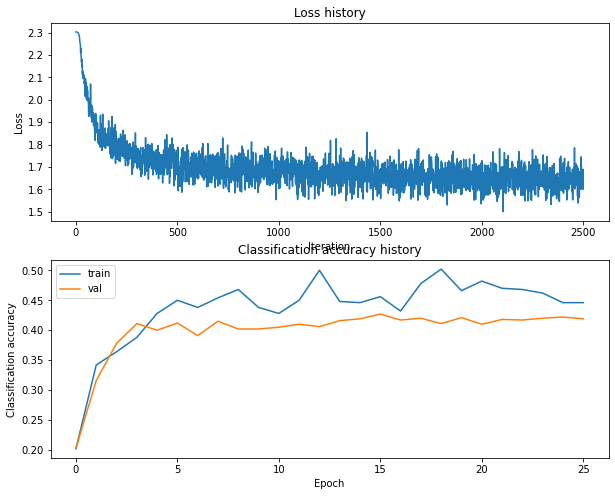

Training network with h_s 170, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.303229
iteration 100 / 5000: loss 2.299251
iteration 200 / 5000: loss 2.253535
iteration 300 / 5000: loss 2.155962
iteration 400 / 5000: loss 2.072599
iteration 500 / 5000: loss 2.029931
iteration 600 / 5000: loss 1.968518
iteration 700 / 5000: loss 1.928964
iteration 800 / 5000: loss 2.062675
iteration 900 / 5000: loss 1.934650
iteration 1000 / 5000: loss 1.777548
iteration 1100 / 5000: loss 1.858262
iteration 1200 / 5000: loss 1.787742
iteration 1300 / 5000: loss 1.811011
iteration 1400 / 5000: loss 1.674246
iteration 1500 / 5000: loss 1.925912
iteration 1600 / 5000: loss 1.687029
iteration 1700 / 5000: loss 1.870137
iteration 1800 / 5000: loss 1.715840
iteration 1900 / 5000: loss 1.567560
iteration 2000 / 5000: loss 1.771390
iteration 2100 / 5000: loss 2.062716
iteration 2200 / 5000: loss 1.611230
iteration 2300 / 5000: loss 1.738485
iteration 2400 / 5000: loss 1.722540
iteration 2500 / 5000: los

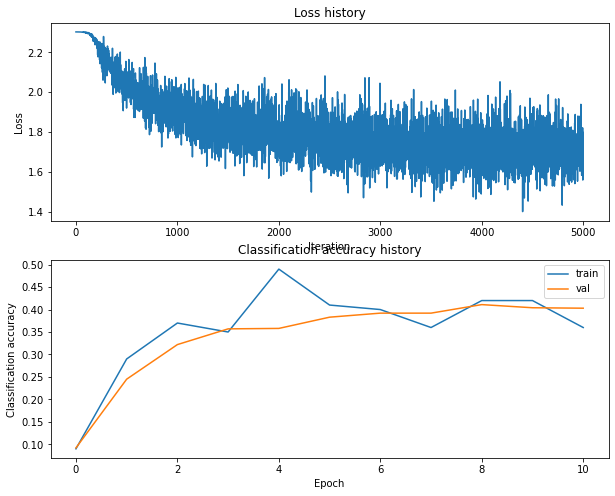

Training network with h_s 170, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.303291
iteration 100 / 5000: loss 1.938270
iteration 200 / 5000: loss 1.907066
iteration 300 / 5000: loss 1.725039
iteration 400 / 5000: loss 1.991148
iteration 500 / 5000: loss 1.765259
iteration 600 / 5000: loss 1.782864
iteration 700 / 5000: loss 1.873693
iteration 800 / 5000: loss 1.804494
iteration 900 / 5000: loss 1.580433
iteration 1000 / 5000: loss 1.805314
iteration 1100 / 5000: loss 1.929505
iteration 1200 / 5000: loss 1.720084
iteration 1300 / 5000: loss 1.779707
iteration 1400 / 5000: loss 1.833252
iteration 1500 / 5000: loss 1.803707
iteration 1600 / 5000: loss 1.621180
iteration 1700 / 5000: loss 1.946460
iteration 1800 / 5000: loss 1.913326
iteration 1900 / 5000: loss 1.651889
iteration 2000 / 5000: loss 1.581327
iteration 2100 / 5000: loss 1.725388
iteration 2200 / 5000: loss 1.692374
iteration 2300 / 5000: loss 1.898365
iteration 2400 / 5000: loss 1.697662
iteration 2500 / 5000: loss

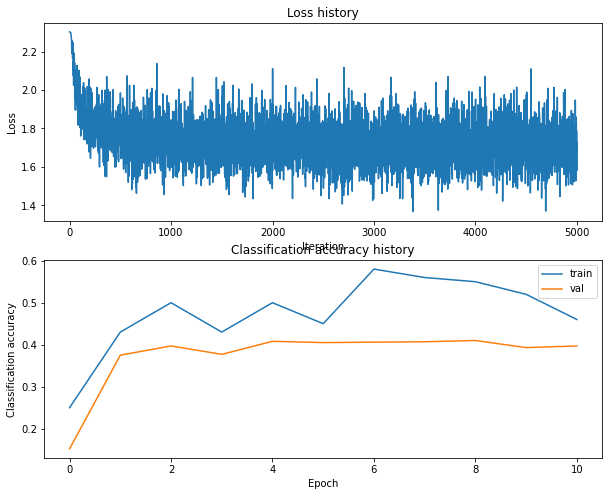

Training network with h_s 170, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.303228
iteration 100 / 5000: loss 2.298458
iteration 200 / 5000: loss 2.231760
iteration 300 / 5000: loss 2.143098
iteration 400 / 5000: loss 2.074378
iteration 500 / 5000: loss 2.049386
iteration 600 / 5000: loss 1.950196
iteration 700 / 5000: loss 1.995982
iteration 800 / 5000: loss 1.900846
iteration 900 / 5000: loss 1.861041
iteration 1000 / 5000: loss 1.983938
iteration 1100 / 5000: loss 1.834270
iteration 1200 / 5000: loss 1.858025
iteration 1300 / 5000: loss 1.925297
iteration 1400 / 5000: loss 1.775648
iteration 1500 / 5000: loss 1.916254
iteration 1600 / 5000: loss 1.799636
iteration 1700 / 5000: loss 1.826859
iteration 1800 / 5000: loss 1.848939
iteration 1900 / 5000: loss 1.791281
iteration 2000 / 5000: loss 1.789035
iteration 2100 / 5000: loss 1.776195
iteration 2200 / 5000: loss 1.725228
iteration 2300 / 5000: loss 1.756439
iteration 2400 / 5000: loss 1.868340
iteration 2500 / 5000: los

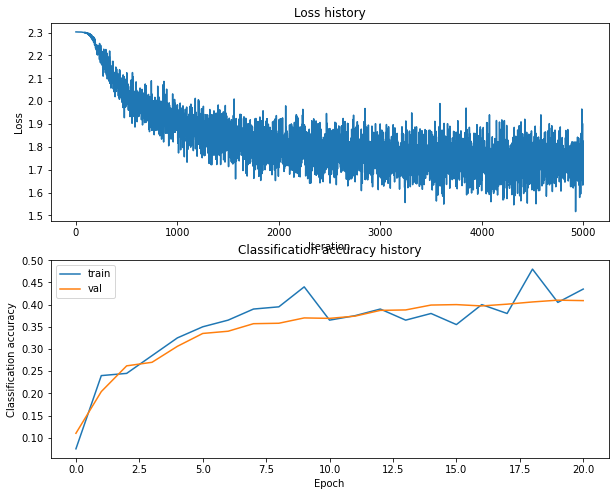

Training network with h_s 170, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.303223
iteration 100 / 5000: loss 1.973344
iteration 200 / 5000: loss 1.763062
iteration 300 / 5000: loss 1.886824
iteration 400 / 5000: loss 1.912560
iteration 500 / 5000: loss 1.687086
iteration 600 / 5000: loss 1.621464
iteration 700 / 5000: loss 1.613895
iteration 800 / 5000: loss 1.683049
iteration 900 / 5000: loss 1.707465
iteration 1000 / 5000: loss 1.831762
iteration 1100 / 5000: loss 1.632478
iteration 1200 / 5000: loss 1.790821
iteration 1300 / 5000: loss 1.697316
iteration 1400 / 5000: loss 1.507941
iteration 1500 / 5000: loss 1.770127
iteration 1600 / 5000: loss 1.614009
iteration 1700 / 5000: loss 1.580619
iteration 1800 / 5000: loss 1.690396
iteration 1900 / 5000: loss 1.751176
iteration 2000 / 5000: loss 1.770629
iteration 2100 / 5000: loss 1.767948
iteration 2200 / 5000: loss 1.643600
iteration 2300 / 5000: loss 1.671131
iteration 2400 / 5000: loss 1.682499
iteration 2500 / 5000: loss

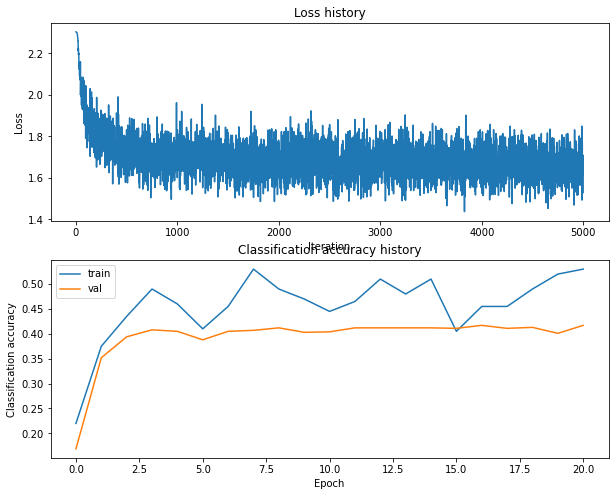

Training network with h_s 170, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.303157
iteration 100 / 5000: loss 2.299807
iteration 200 / 5000: loss 2.259837
iteration 300 / 5000: loss 2.164111
iteration 400 / 5000: loss 2.126016
iteration 500 / 5000: loss 1.950508
iteration 600 / 5000: loss 2.007453
iteration 700 / 5000: loss 1.964870
iteration 800 / 5000: loss 1.858487
iteration 900 / 5000: loss 1.939942
iteration 1000 / 5000: loss 1.810727
iteration 1100 / 5000: loss 1.936121
iteration 1200 / 5000: loss 1.872587
iteration 1300 / 5000: loss 1.895747
iteration 1400 / 5000: loss 1.861642
iteration 1500 / 5000: loss 1.801811
iteration 1600 / 5000: loss 1.778853
iteration 1700 / 5000: loss 1.754385
iteration 1800 / 5000: loss 1.811980
iteration 1900 / 5000: loss 1.776893
iteration 2000 / 5000: loss 1.793111
iteration 2100 / 5000: loss 1.795826
iteration 2200 / 5000: loss 1.883326
iteration 2300 / 5000: loss 1.716480
iteration 2400 / 5000: loss 1.816975
iteration 2500 / 5000: los

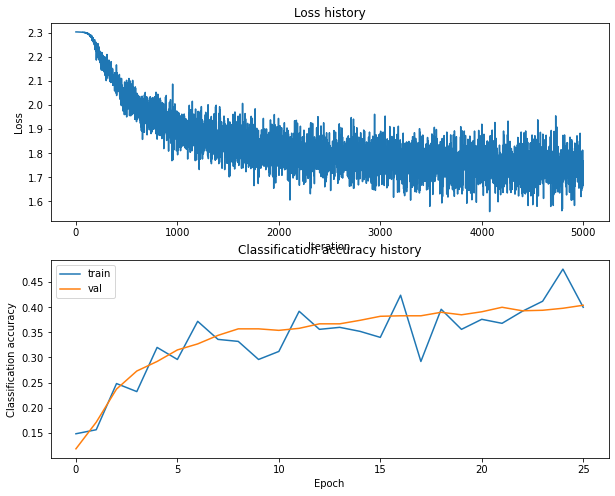

Training network with h_s 170, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.303273
iteration 100 / 5000: loss 1.748561
iteration 200 / 5000: loss 1.708177
iteration 300 / 5000: loss 1.816935
iteration 400 / 5000: loss 1.815140
iteration 500 / 5000: loss 1.693304
iteration 600 / 5000: loss 1.735845
iteration 700 / 5000: loss 1.783312
iteration 800 / 5000: loss 1.751923
iteration 900 / 5000: loss 1.679576
iteration 1000 / 5000: loss 1.598411
iteration 1100 / 5000: loss 1.677009
iteration 1200 / 5000: loss 1.608414
iteration 1300 / 5000: loss 1.862357
iteration 1400 / 5000: loss 1.536652
iteration 1500 / 5000: loss 1.650270
iteration 1600 / 5000: loss 1.709521
iteration 1700 / 5000: loss 1.720009
iteration 1800 / 5000: loss 1.656925
iteration 1900 / 5000: loss 1.711131
iteration 2000 / 5000: loss 1.625225
iteration 2100 / 5000: loss 1.648471
iteration 2200 / 5000: loss 1.761042
iteration 2300 / 5000: loss 1.734303
iteration 2400 / 5000: loss 1.760482
iteration 2500 / 5000: loss

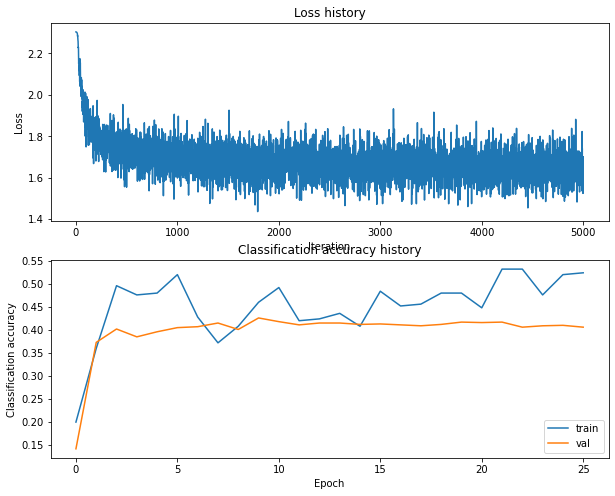

Training network with h_s 170, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.303218
iteration 100 / 5000: loss 2.299275
iteration 200 / 5000: loss 2.252806
iteration 300 / 5000: loss 2.125968
iteration 400 / 5000: loss 2.092234
iteration 500 / 5000: loss 2.044744
iteration 600 / 5000: loss 1.953646
iteration 700 / 5000: loss 1.980749
iteration 800 / 5000: loss 1.902261
iteration 900 / 5000: loss 1.951525
iteration 1000 / 5000: loss 1.874197
iteration 1100 / 5000: loss 1.868899
iteration 1200 / 5000: loss 1.758498
iteration 1300 / 5000: loss 1.950411
iteration 1400 / 5000: loss 1.823273
iteration 1500 / 5000: loss 1.765254
iteration 1600 / 5000: loss 1.853769
iteration 1700 / 5000: loss 1.785810
iteration 1800 / 5000: loss 1.830752
iteration 1900 / 5000: loss 1.851266
iteration 2000 / 5000: loss 1.707726
iteration 2100 / 5000: loss 1.845390
iteration 2200 / 5000: loss 1.785564
iteration 2300 / 5000: loss 1.832941
iteration 2400 / 5000: loss 1.696059
iteration 2500 / 5000: los

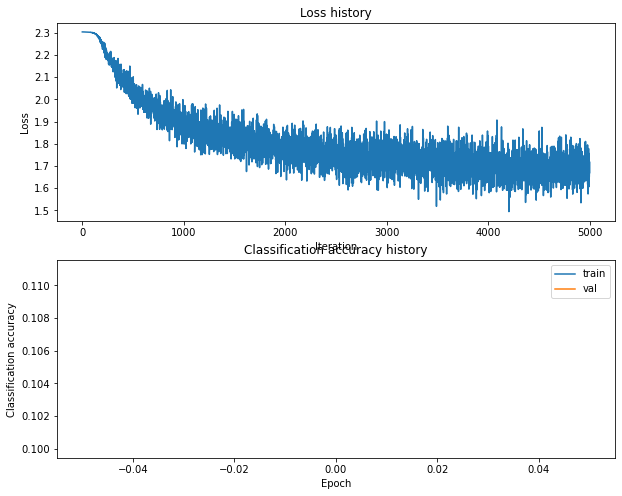

Training network with h_s 170, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.303262
iteration 100 / 5000: loss 1.822601
iteration 200 / 5000: loss 1.783659
iteration 300 / 5000: loss 1.770270
iteration 400 / 5000: loss 1.826245
iteration 500 / 5000: loss 1.703375
iteration 600 / 5000: loss 1.699132
iteration 700 / 5000: loss 1.715651
iteration 800 / 5000: loss 1.704665
iteration 900 / 5000: loss 1.680910
iteration 1000 / 5000: loss 1.741953
iteration 1100 / 5000: loss 1.710907
iteration 1200 / 5000: loss 1.695066
iteration 1300 / 5000: loss 1.716742
iteration 1400 / 5000: loss 1.584515
iteration 1500 / 5000: loss 1.632739
iteration 1600 / 5000: loss 1.749711
iteration 1700 / 5000: loss 1.652190
iteration 1800 / 5000: loss 1.675572
iteration 1900 / 5000: loss 1.570611
iteration 2000 / 5000: loss 1.715370
iteration 2100 / 5000: loss 1.728261
iteration 2200 / 5000: loss 1.621530
iteration 2300 / 5000: loss 1.703152
iteration 2400 / 5000: loss 1.615644
iteration 2500 / 5000: loss

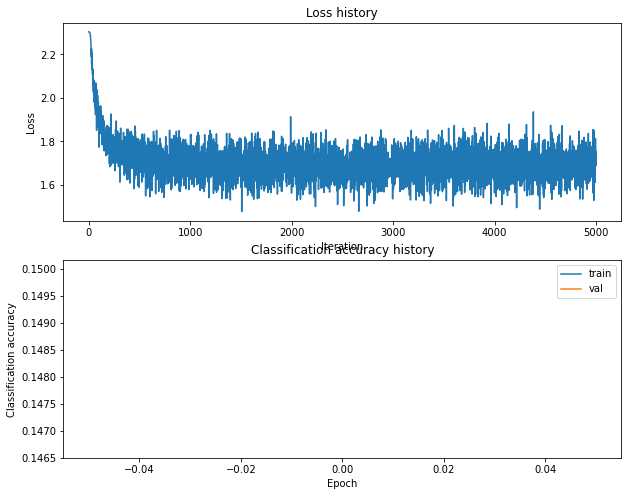

Training network with h_s 170, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.303262
iteration 100 / 5000: loss 2.299217
iteration 200 / 5000: loss 2.255149
iteration 300 / 5000: loss 2.179796
iteration 400 / 5000: loss 2.079585
iteration 500 / 5000: loss 2.029220
iteration 600 / 5000: loss 2.025829
iteration 700 / 5000: loss 2.006125
iteration 800 / 5000: loss 1.903753
iteration 900 / 5000: loss 1.958427
iteration 1000 / 5000: loss 1.941950
iteration 1100 / 5000: loss 1.878900
iteration 1200 / 5000: loss 1.873424
iteration 1300 / 5000: loss 1.906561
iteration 1400 / 5000: loss 1.891511
iteration 1500 / 5000: loss 1.869986
iteration 1600 / 5000: loss 1.900108
iteration 1700 / 5000: loss 1.832269
iteration 1800 / 5000: loss 1.830159
iteration 1900 / 5000: loss 1.921460
iteration 2000 / 5000: loss 1.865988
iteration 2100 / 5000: loss 1.798908
iteration 2200 / 5000: loss 1.790827
iteration 2300 / 5000: loss 1.860064
iteration 2400 / 5000: loss 1.783406
iteration 2500 / 5000: los

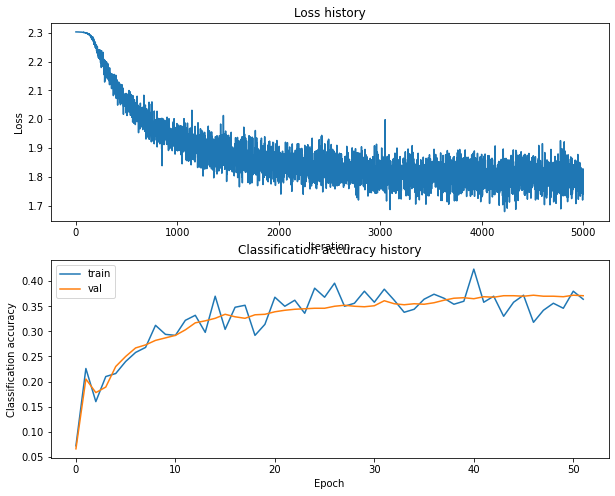

Training network with h_s 170, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.303239
iteration 100 / 5000: loss 1.889887
iteration 200 / 5000: loss 1.828449
iteration 300 / 5000: loss 1.741279
iteration 400 / 5000: loss 1.733291
iteration 500 / 5000: loss 1.740065
iteration 600 / 5000: loss 1.809756
iteration 700 / 5000: loss 1.638795
iteration 800 / 5000: loss 1.754585
iteration 900 / 5000: loss 1.611052
iteration 1000 / 5000: loss 1.621954
iteration 1100 / 5000: loss 1.629931
iteration 1200 / 5000: loss 1.642317
iteration 1300 / 5000: loss 1.642472
iteration 1400 / 5000: loss 1.676816
iteration 1500 / 5000: loss 1.702181
iteration 1600 / 5000: loss 1.647404
iteration 1700 / 5000: loss 1.680310
iteration 1800 / 5000: loss 1.736917
iteration 1900 / 5000: loss 1.625214
iteration 2000 / 5000: loss 1.556571
iteration 2100 / 5000: loss 1.585146
iteration 2200 / 5000: loss 1.674209
iteration 2300 / 5000: loss 1.758860
iteration 2400 / 5000: loss 1.649513
iteration 2500 / 5000: loss

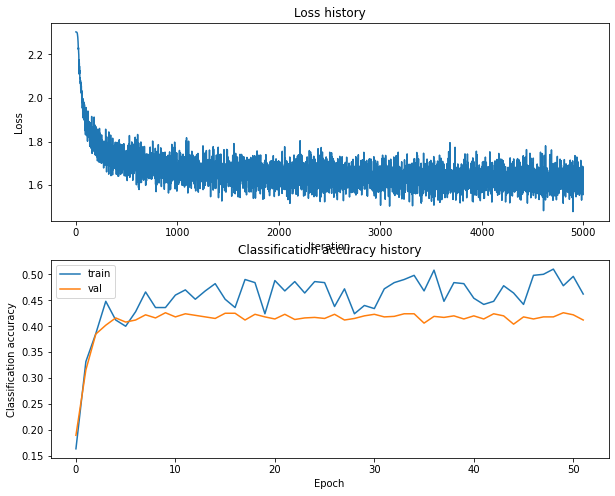

Training network with h_s 170, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.303282
iteration 100 / 10000: loss 2.297385
iteration 200 / 10000: loss 2.247517
iteration 300 / 10000: loss 2.112686
iteration 400 / 10000: loss 2.059637
iteration 500 / 10000: loss 1.946089
iteration 600 / 10000: loss 1.923596
iteration 700 / 10000: loss 1.986851
iteration 800 / 10000: loss 1.869176
iteration 900 / 10000: loss 1.884257
iteration 1000 / 10000: loss 1.904167
iteration 1100 / 10000: loss 1.758988
iteration 1200 / 10000: loss 1.889850
iteration 1300 / 10000: loss 1.914123
iteration 1400 / 10000: loss 1.850390
iteration 1500 / 10000: loss 1.879178
iteration 1600 / 10000: loss 1.748043
iteration 1700 / 10000: loss 1.872701
iteration 1800 / 10000: loss 1.733127
iteration 1900 / 10000: loss 1.849726
iteration 2000 / 10000: loss 1.612058
iteration 2100 / 10000: loss 1.782664
iteration 2200 / 10000: loss 1.893726
iteration 2300 / 10000: loss 1.648598
iteration 2400 / 10000: loss 1.770254


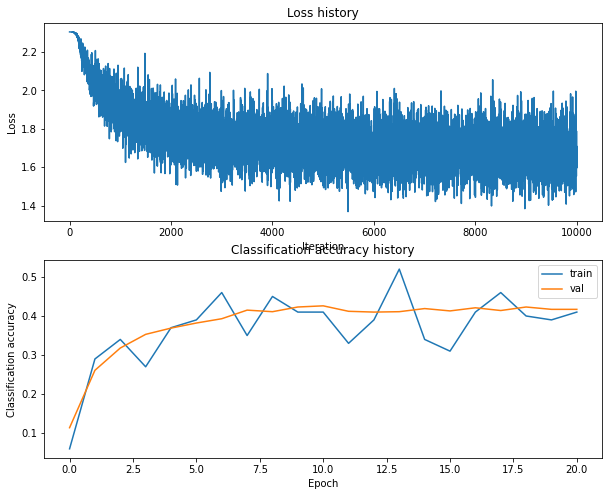

Training network with h_s 170, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.303258
iteration 100 / 10000: loss 1.884841
iteration 200 / 10000: loss 1.849367
iteration 300 / 10000: loss 1.759928
iteration 400 / 10000: loss 1.657643
iteration 500 / 10000: loss 1.773749
iteration 600 / 10000: loss 1.790536
iteration 700 / 10000: loss 1.747100
iteration 800 / 10000: loss 1.685579
iteration 900 / 10000: loss 1.674907
iteration 1000 / 10000: loss 1.749853
iteration 1100 / 10000: loss 1.853411
iteration 1200 / 10000: loss 1.763021
iteration 1300 / 10000: loss 1.768978
iteration 1400 / 10000: loss 1.739879
iteration 1500 / 10000: loss 1.695695
iteration 1600 / 10000: loss 1.723217
iteration 1700 / 10000: loss 1.748806
iteration 1800 / 10000: loss 1.628787
iteration 1900 / 10000: loss 1.757489
iteration 2000 / 10000: loss 2.004638
iteration 2100 / 10000: loss 1.494557
iteration 2200 / 10000: loss 1.684605
iteration 2300 / 10000: loss 1.811628
iteration 2400 / 10000: loss 1.626029
i

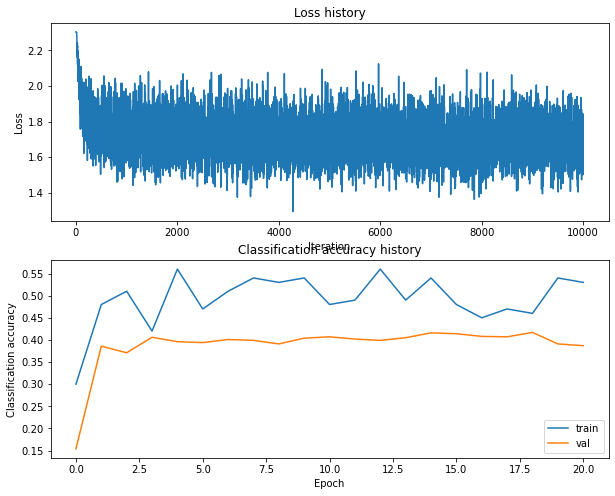

Training network with h_s 170, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.303176
iteration 100 / 10000: loss 2.299314
iteration 200 / 10000: loss 2.266079
iteration 300 / 10000: loss 2.123096
iteration 400 / 10000: loss 2.052917
iteration 500 / 10000: loss 2.055330
iteration 600 / 10000: loss 1.991849
iteration 700 / 10000: loss 1.973679
iteration 800 / 10000: loss 1.863789
iteration 900 / 10000: loss 1.891993
iteration 1000 / 10000: loss 1.862962
iteration 1100 / 10000: loss 1.807232
iteration 1200 / 10000: loss 1.919863
iteration 1300 / 10000: loss 1.888506
iteration 1400 / 10000: loss 1.889566
iteration 1500 / 10000: loss 1.779410
iteration 1600 / 10000: loss 1.782850
iteration 1700 / 10000: loss 1.730181
iteration 1800 / 10000: loss 1.790690
iteration 1900 / 10000: loss 1.821038
iteration 2000 / 10000: loss 1.844400
iteration 2100 / 10000: loss 1.844378
iteration 2200 / 10000: loss 1.812324
iteration 2300 / 10000: loss 1.825756
iteration 2400 / 10000: loss 1.853314


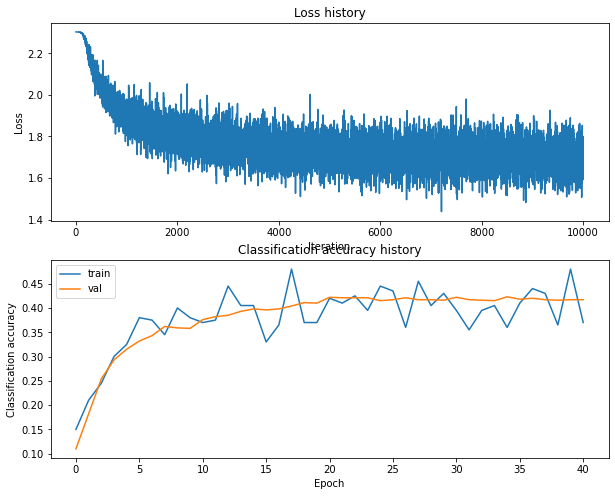

Training network with h_s 170, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.303165
iteration 100 / 10000: loss 1.919038
iteration 200 / 10000: loss 1.810557
iteration 300 / 10000: loss 1.586266
iteration 400 / 10000: loss 1.585864
iteration 500 / 10000: loss 1.775437
iteration 600 / 10000: loss 1.688874
iteration 700 / 10000: loss 1.734474
iteration 800 / 10000: loss 1.585849
iteration 900 / 10000: loss 1.645264
iteration 1000 / 10000: loss 1.768981
iteration 1100 / 10000: loss 1.806695
iteration 1200 / 10000: loss 1.614047
iteration 1300 / 10000: loss 1.667098
iteration 1400 / 10000: loss 1.893727
iteration 1500 / 10000: loss 1.714572
iteration 1600 / 10000: loss 1.644802
iteration 1700 / 10000: loss 1.676794
iteration 1800 / 10000: loss 1.648918
iteration 1900 / 10000: loss 1.753061
iteration 2000 / 10000: loss 1.689641
iteration 2100 / 10000: loss 1.774066
iteration 2200 / 10000: loss 1.708364
iteration 2300 / 10000: loss 1.667016
iteration 2400 / 10000: loss 1.541913
i

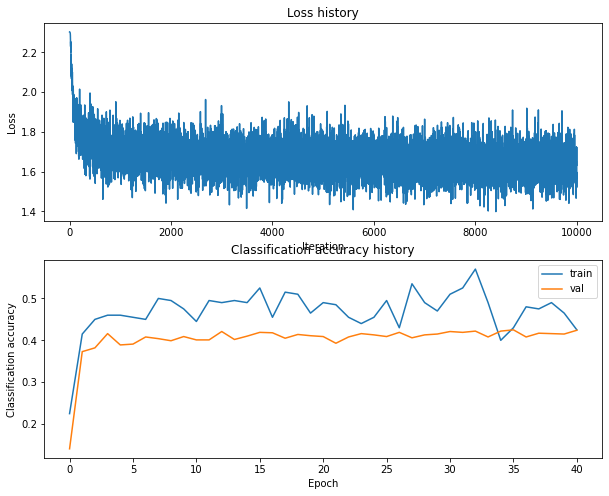

Training network with h_s 170, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.303167
iteration 100 / 10000: loss 2.299503
iteration 200 / 10000: loss 2.262613
iteration 300 / 10000: loss 2.176591
iteration 400 / 10000: loss 2.085133
iteration 500 / 10000: loss 2.000203
iteration 600 / 10000: loss 2.043938
iteration 700 / 10000: loss 1.973182
iteration 800 / 10000: loss 1.970250
iteration 900 / 10000: loss 1.974778
iteration 1000 / 10000: loss 1.922606
iteration 1100 / 10000: loss 1.876102
iteration 1200 / 10000: loss 1.855605
iteration 1300 / 10000: loss 1.808415
iteration 1400 / 10000: loss 1.877514
iteration 1500 / 10000: loss 1.840433
iteration 1600 / 10000: loss 1.793774
iteration 1700 / 10000: loss 1.916416
iteration 1800 / 10000: loss 1.877775
iteration 1900 / 10000: loss 1.813121
iteration 2000 / 10000: loss 1.898204
iteration 2100 / 10000: loss 1.755223
iteration 2200 / 10000: loss 1.784611
iteration 2300 / 10000: loss 1.831267
iteration 2400 / 10000: loss 1.737786


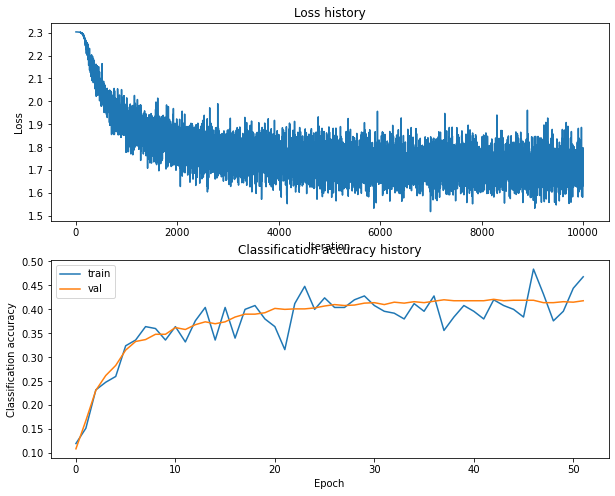

Training network with h_s 170, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.303219
iteration 100 / 10000: loss 1.873857
iteration 200 / 10000: loss 1.738499
iteration 300 / 10000: loss 1.695570
iteration 400 / 10000: loss 1.763806
iteration 500 / 10000: loss 1.829183
iteration 600 / 10000: loss 1.869480
iteration 700 / 10000: loss 1.722152
iteration 800 / 10000: loss 1.672477
iteration 900 / 10000: loss 1.808188
iteration 1000 / 10000: loss 1.676141
iteration 1100 / 10000: loss 1.647778
iteration 1200 / 10000: loss 1.749874
iteration 1300 / 10000: loss 1.609428
iteration 1400 / 10000: loss 1.640386
iteration 1500 / 10000: loss 1.706675
iteration 1600 / 10000: loss 1.666590
iteration 1700 / 10000: loss 1.651152
iteration 1800 / 10000: loss 1.591179
iteration 1900 / 10000: loss 1.705215
iteration 2000 / 10000: loss 1.728181
iteration 2100 / 10000: loss 1.696317
iteration 2200 / 10000: loss 1.537797
iteration 2300 / 10000: loss 1.644084
iteration 2400 / 10000: loss 1.564037
i

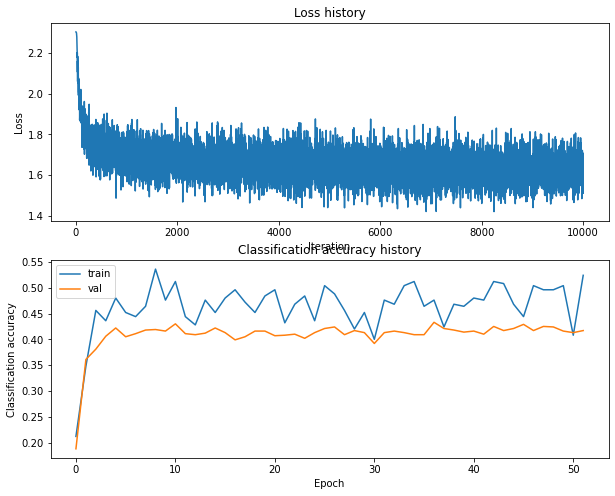

Training network with h_s 170, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.303260
iteration 100 / 10000: loss 2.299925
iteration 200 / 10000: loss 2.250359
iteration 300 / 10000: loss 2.121021
iteration 400 / 10000: loss 2.071245
iteration 500 / 10000: loss 2.016858
iteration 600 / 10000: loss 1.974840
iteration 700 / 10000: loss 1.940478
iteration 800 / 10000: loss 1.930703
iteration 900 / 10000: loss 1.908031
iteration 1000 / 10000: loss 1.864642
iteration 1100 / 10000: loss 1.950384
iteration 1200 / 10000: loss 1.860373
iteration 1300 / 10000: loss 1.846405
iteration 1400 / 10000: loss 1.768141
iteration 1500 / 10000: loss 1.823032
iteration 1600 / 10000: loss 1.818957
iteration 1700 / 10000: loss 1.742690
iteration 1800 / 10000: loss 1.717797
iteration 1900 / 10000: loss 1.817362
iteration 2000 / 10000: loss 1.928311
iteration 2100 / 10000: loss 1.720024
iteration 2200 / 10000: loss 1.765388
iteration 2300 / 10000: loss 1.631944
iteration 2400 / 10000: loss 1.753531


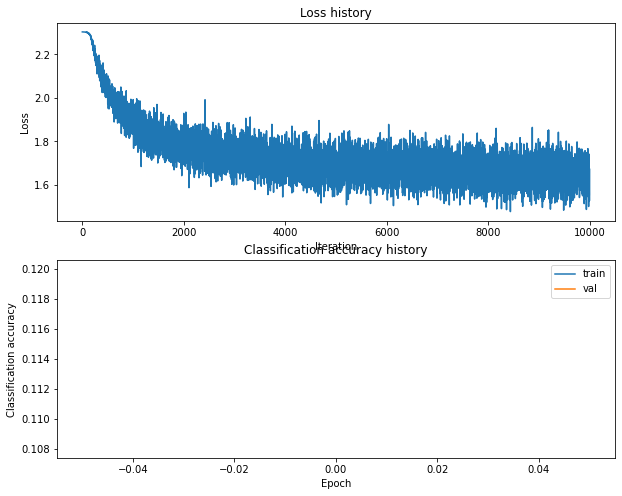

Training network with h_s 170, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.303259
iteration 100 / 10000: loss 1.899295
iteration 200 / 10000: loss 1.734305
iteration 300 / 10000: loss 1.760636
iteration 400 / 10000: loss 1.714881
iteration 500 / 10000: loss 1.683793
iteration 600 / 10000: loss 1.764817
iteration 700 / 10000: loss 1.708082
iteration 800 / 10000: loss 1.662515
iteration 900 / 10000: loss 1.732622
iteration 1000 / 10000: loss 1.574933
iteration 1100 / 10000: loss 1.676251
iteration 1200 / 10000: loss 1.671352
iteration 1300 / 10000: loss 1.739321
iteration 1400 / 10000: loss 1.692199
iteration 1500 / 10000: loss 1.572157
iteration 1600 / 10000: loss 1.646456
iteration 1700 / 10000: loss 1.624577
iteration 1800 / 10000: loss 1.680363
iteration 1900 / 10000: loss 1.606661
iteration 2000 / 10000: loss 1.741611
iteration 2100 / 10000: loss 1.737220
iteration 2200 / 10000: loss 1.657820
iteration 2300 / 10000: loss 1.709415
iteration 2400 / 10000: loss 1.650511
i

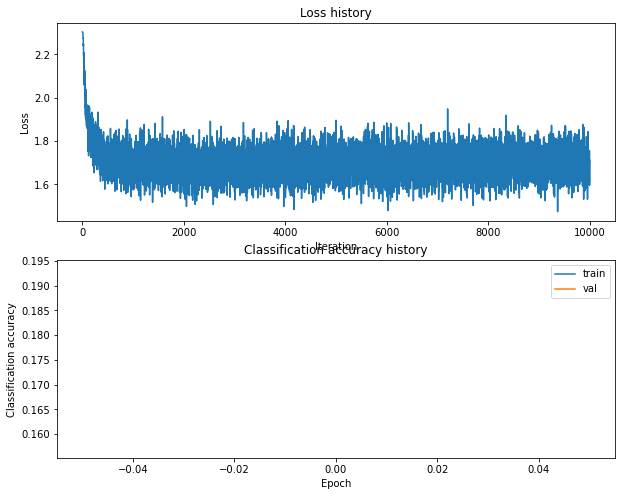

Training network with h_s 170, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.303209
iteration 100 / 10000: loss 2.298389
iteration 200 / 10000: loss 2.244311
iteration 300 / 10000: loss 2.138246
iteration 400 / 10000: loss 2.129513
iteration 500 / 10000: loss 2.055556
iteration 600 / 10000: loss 2.004217
iteration 700 / 10000: loss 2.010595
iteration 800 / 10000: loss 1.978148
iteration 900 / 10000: loss 1.924731
iteration 1000 / 10000: loss 1.917359
iteration 1100 / 10000: loss 1.927490
iteration 1200 / 10000: loss 1.868195
iteration 1300 / 10000: loss 1.946843
iteration 1400 / 10000: loss 1.925099
iteration 1500 / 10000: loss 1.856137
iteration 1600 / 10000: loss 1.857443
iteration 1700 / 10000: loss 1.852948
iteration 1800 / 10000: loss 1.853016
iteration 1900 / 10000: loss 1.809055
iteration 2000 / 10000: loss 1.857779
iteration 2100 / 10000: loss 1.919831
iteration 2200 / 10000: loss 1.860291
iteration 2300 / 10000: loss 1.753866
iteration 2400 / 10000: loss 1.947368


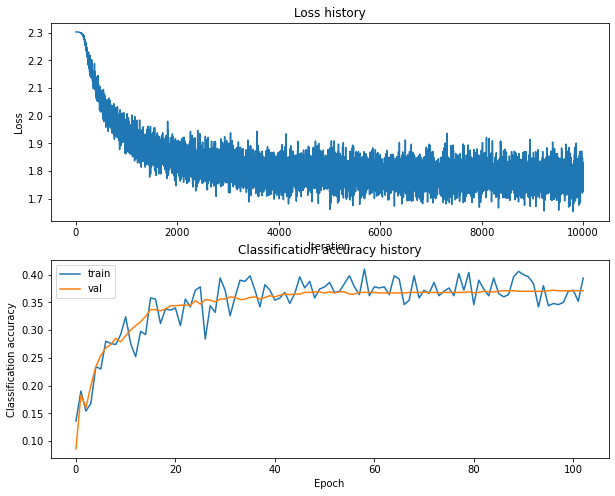

Training network with h_s 170, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.303264
iteration 100 / 10000: loss 1.828981
iteration 200 / 10000: loss 1.842452
iteration 300 / 10000: loss 1.706361
iteration 400 / 10000: loss 1.819364
iteration 500 / 10000: loss 1.725395
iteration 600 / 10000: loss 1.700156
iteration 700 / 10000: loss 1.751341
iteration 800 / 10000: loss 1.783149
iteration 900 / 10000: loss 1.781214
iteration 1000 / 10000: loss 1.723274
iteration 1100 / 10000: loss 1.708589
iteration 1200 / 10000: loss 1.626457
iteration 1300 / 10000: loss 1.742523
iteration 1400 / 10000: loss 1.647395
iteration 1500 / 10000: loss 1.687463
iteration 1600 / 10000: loss 1.649746
iteration 1700 / 10000: loss 1.630989
iteration 1800 / 10000: loss 1.608319
iteration 1900 / 10000: loss 1.709297
iteration 2000 / 10000: loss 1.576798
iteration 2100 / 10000: loss 1.638796
iteration 2200 / 10000: loss 1.648583
iteration 2300 / 10000: loss 1.672363
iteration 2400 / 10000: loss 1.594805
i

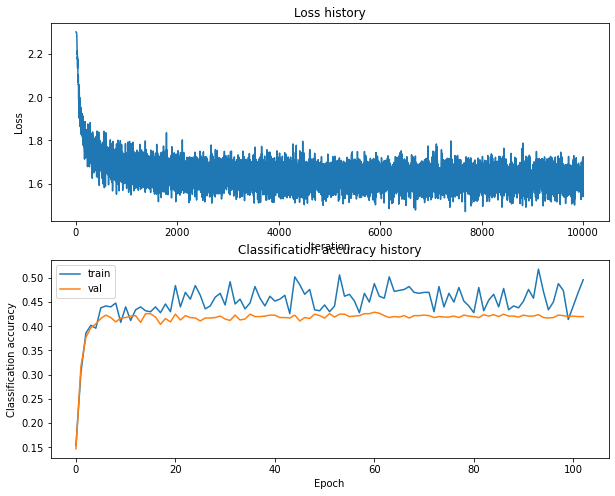

Training network with h_s 170, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.303236
iteration 100 / 15000: loss 2.300550
iteration 200 / 15000: loss 2.249030
iteration 300 / 15000: loss 2.093931
iteration 400 / 15000: loss 2.063438
iteration 500 / 15000: loss 1.947884
iteration 600 / 15000: loss 1.969441
iteration 700 / 15000: loss 2.042598
iteration 800 / 15000: loss 1.932943
iteration 900 / 15000: loss 1.799405
iteration 1000 / 15000: loss 1.935511
iteration 1100 / 15000: loss 1.854702
iteration 1200 / 15000: loss 1.930144
iteration 1300 / 15000: loss 1.938839
iteration 1400 / 15000: loss 1.786202
iteration 1500 / 15000: loss 1.891307
iteration 1600 / 15000: loss 1.800589
iteration 1700 / 15000: loss 1.924339
iteration 1800 / 15000: loss 1.847152
iteration 1900 / 15000: loss 1.835469
iteration 2000 / 15000: loss 1.880117
iteration 2100 / 15000: loss 1.769507
iteration 2200 / 15000: loss 1.824475
iteration 2300 / 15000: loss 1.694396
iteration 2400 / 15000: loss 1.493934


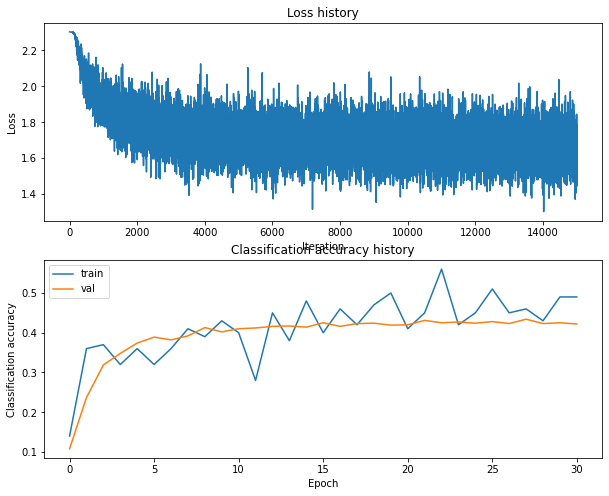

Training network with h_s 170, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.303259
iteration 100 / 15000: loss 1.933610
iteration 200 / 15000: loss 1.867610
iteration 300 / 15000: loss 1.694138
iteration 400 / 15000: loss 1.849428
iteration 500 / 15000: loss 1.750797
iteration 600 / 15000: loss 1.890343
iteration 700 / 15000: loss 1.603013
iteration 800 / 15000: loss 1.541751
iteration 900 / 15000: loss 1.789119
iteration 1000 / 15000: loss 1.719695
iteration 1100 / 15000: loss 1.947337
iteration 1200 / 15000: loss 1.813090
iteration 1300 / 15000: loss 1.586072
iteration 1400 / 15000: loss 1.665770
iteration 1500 / 15000: loss 1.740597
iteration 1600 / 15000: loss 1.714318
iteration 1700 / 15000: loss 1.754564
iteration 1800 / 15000: loss 1.722110
iteration 1900 / 15000: loss 1.683228
iteration 2000 / 15000: loss 1.487101
iteration 2100 / 15000: loss 1.763607
iteration 2200 / 15000: loss 1.580457
iteration 2300 / 15000: loss 1.577467
iteration 2400 / 15000: loss 1.744668
i

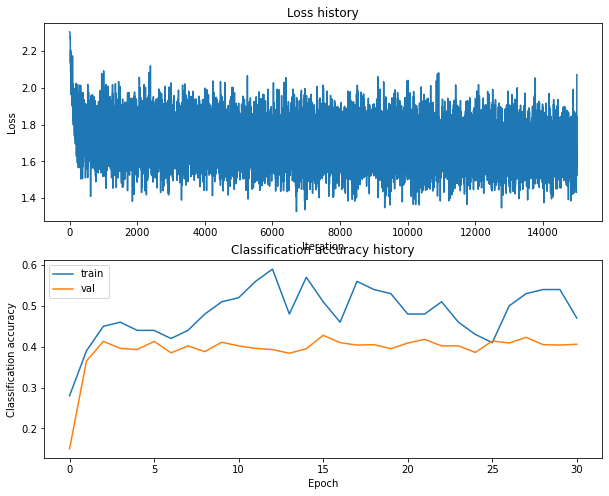

Training network with h_s 170, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.303214
iteration 100 / 15000: loss 2.300387
iteration 200 / 15000: loss 2.248202
iteration 300 / 15000: loss 2.157434
iteration 400 / 15000: loss 2.073583
iteration 500 / 15000: loss 1.984866
iteration 600 / 15000: loss 1.967574
iteration 700 / 15000: loss 1.923563
iteration 800 / 15000: loss 1.912759
iteration 900 / 15000: loss 1.882047
iteration 1000 / 15000: loss 1.889028
iteration 1100 / 15000: loss 1.794624
iteration 1200 / 15000: loss 1.872801
iteration 1300 / 15000: loss 1.944556
iteration 1400 / 15000: loss 1.896680
iteration 1500 / 15000: loss 1.853206
iteration 1600 / 15000: loss 1.840959
iteration 1700 / 15000: loss 1.868028
iteration 1800 / 15000: loss 1.749481
iteration 1900 / 15000: loss 1.795797
iteration 2000 / 15000: loss 1.948642
iteration 2100 / 15000: loss 1.862190
iteration 2200 / 15000: loss 1.745308
iteration 2300 / 15000: loss 1.745342
iteration 2400 / 15000: loss 1.756277


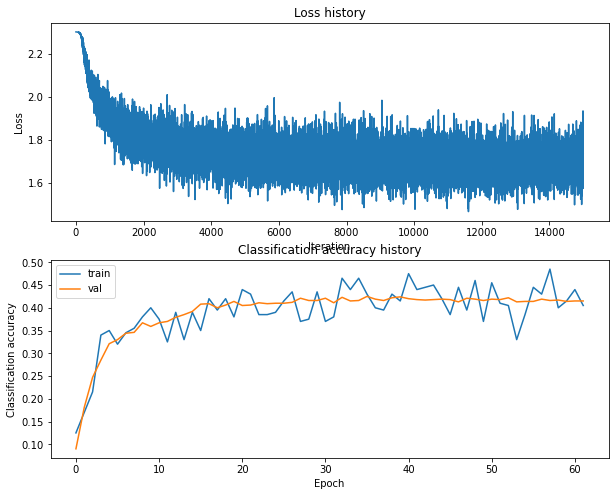

Training network with h_s 170, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.303201
iteration 100 / 15000: loss 1.925084
iteration 200 / 15000: loss 1.870615
iteration 300 / 15000: loss 1.697761
iteration 400 / 15000: loss 1.817532
iteration 500 / 15000: loss 1.804614
iteration 600 / 15000: loss 1.736007
iteration 700 / 15000: loss 1.624302
iteration 800 / 15000: loss 1.664260
iteration 900 / 15000: loss 1.612487
iteration 1000 / 15000: loss 1.561294
iteration 1100 / 15000: loss 1.645182
iteration 1200 / 15000: loss 1.666626
iteration 1300 / 15000: loss 1.554007
iteration 1400 / 15000: loss 1.881956
iteration 1500 / 15000: loss 1.682839
iteration 1600 / 15000: loss 1.761645
iteration 1700 / 15000: loss 1.710806
iteration 1800 / 15000: loss 1.665599
iteration 1900 / 15000: loss 1.552822
iteration 2000 / 15000: loss 1.614281
iteration 2100 / 15000: loss 1.669954
iteration 2200 / 15000: loss 1.620105
iteration 2300 / 15000: loss 1.776123
iteration 2400 / 15000: loss 1.677115
i

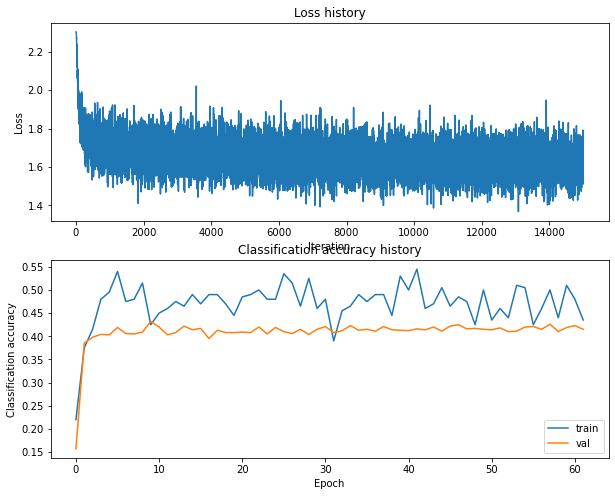

Training network with h_s 170, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.303249
iteration 100 / 15000: loss 2.299502
iteration 200 / 15000: loss 2.236136
iteration 300 / 15000: loss 2.181209
iteration 400 / 15000: loss 2.092520
iteration 500 / 15000: loss 2.041992
iteration 600 / 15000: loss 2.031265
iteration 700 / 15000: loss 1.949788
iteration 800 / 15000: loss 1.962508
iteration 900 / 15000: loss 1.956796
iteration 1000 / 15000: loss 1.935557
iteration 1100 / 15000: loss 1.868216
iteration 1200 / 15000: loss 1.841021
iteration 1300 / 15000: loss 1.880068
iteration 1400 / 15000: loss 1.814868
iteration 1500 / 15000: loss 1.831116
iteration 1600 / 15000: loss 1.886246
iteration 1700 / 15000: loss 1.839316
iteration 1800 / 15000: loss 1.758887
iteration 1900 / 15000: loss 1.912391
iteration 2000 / 15000: loss 1.808208
iteration 2100 / 15000: loss 1.836180
iteration 2200 / 15000: loss 1.764037
iteration 2300 / 15000: loss 1.815196
iteration 2400 / 15000: loss 1.714955


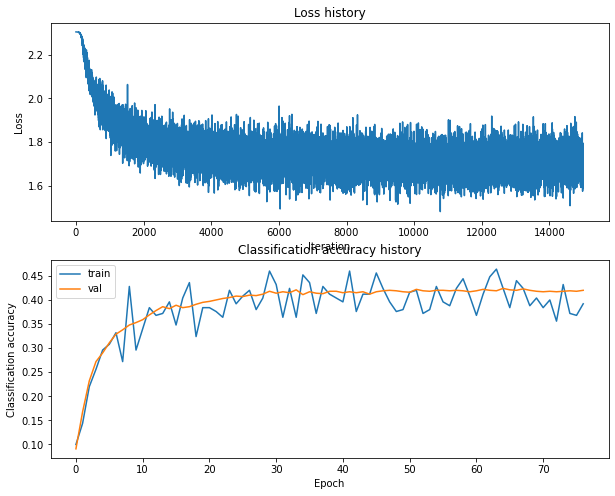

Training network with h_s 170, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.303234
iteration 100 / 15000: loss 1.895831
iteration 200 / 15000: loss 1.875268
iteration 300 / 15000: loss 1.822129
iteration 400 / 15000: loss 1.707518
iteration 500 / 15000: loss 1.667877
iteration 600 / 15000: loss 1.891453
iteration 700 / 15000: loss 1.856336
iteration 800 / 15000: loss 1.621450
iteration 900 / 15000: loss 1.580274
iteration 1000 / 15000: loss 1.837520
iteration 1100 / 15000: loss 1.717581
iteration 1200 / 15000: loss 1.752488
iteration 1300 / 15000: loss 1.591742
iteration 1400 / 15000: loss 1.609753
iteration 1500 / 15000: loss 1.563872
iteration 1600 / 15000: loss 1.769476
iteration 1700 / 15000: loss 1.746910
iteration 1800 / 15000: loss 1.678302
iteration 1900 / 15000: loss 1.536669
iteration 2000 / 15000: loss 1.675153
iteration 2100 / 15000: loss 1.573279
iteration 2200 / 15000: loss 1.633569
iteration 2300 / 15000: loss 1.649918
iteration 2400 / 15000: loss 1.642860
i

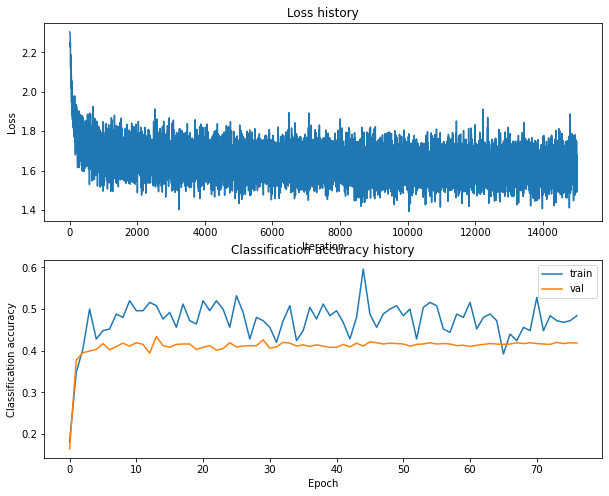

Training network with h_s 170, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.303214
iteration 100 / 15000: loss 2.300647
iteration 200 / 15000: loss 2.240680
iteration 300 / 15000: loss 2.208525
iteration 400 / 15000: loss 2.089608
iteration 500 / 15000: loss 1.977542
iteration 600 / 15000: loss 2.019490
iteration 700 / 15000: loss 1.941566
iteration 800 / 15000: loss 2.005664
iteration 900 / 15000: loss 1.978789
iteration 1000 / 15000: loss 1.876418
iteration 1100 / 15000: loss 1.787685
iteration 1200 / 15000: loss 1.845803
iteration 1300 / 15000: loss 1.814667
iteration 1400 / 15000: loss 1.793422
iteration 1500 / 15000: loss 1.860575
iteration 1600 / 15000: loss 1.777004
iteration 1700 / 15000: loss 1.762761
iteration 1800 / 15000: loss 1.835470
iteration 1900 / 15000: loss 1.815187
iteration 2000 / 15000: loss 1.738647
iteration 2100 / 15000: loss 1.745332
iteration 2200 / 15000: loss 1.716085
iteration 2300 / 15000: loss 1.729671
iteration 2400 / 15000: loss 1.836881


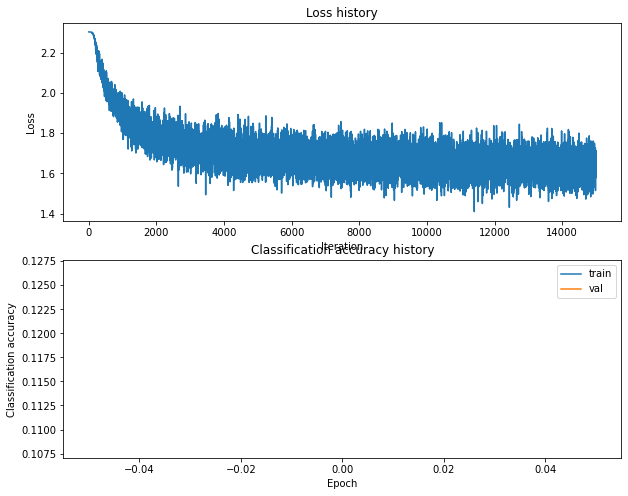

Training network with h_s 170, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.303253
iteration 100 / 15000: loss 1.801405
iteration 200 / 15000: loss 1.810482
iteration 300 / 15000: loss 1.761846
iteration 400 / 15000: loss 1.763293
iteration 500 / 15000: loss 1.648332
iteration 600 / 15000: loss 1.797830
iteration 700 / 15000: loss 1.763527
iteration 800 / 15000: loss 1.797551
iteration 900 / 15000: loss 1.685888
iteration 1000 / 15000: loss 1.592059
iteration 1100 / 15000: loss 1.660496
iteration 1200 / 15000: loss 1.723304
iteration 1300 / 15000: loss 1.697432
iteration 1400 / 15000: loss 1.777704
iteration 1500 / 15000: loss 1.627469
iteration 1600 / 15000: loss 1.813691
iteration 1700 / 15000: loss 1.769856
iteration 1800 / 15000: loss 1.741206
iteration 1900 / 15000: loss 1.635716
iteration 2000 / 15000: loss 1.717438
iteration 2100 / 15000: loss 1.712317
iteration 2200 / 15000: loss 1.554742
iteration 2300 / 15000: loss 1.781683
iteration 2400 / 15000: loss 1.625218
i

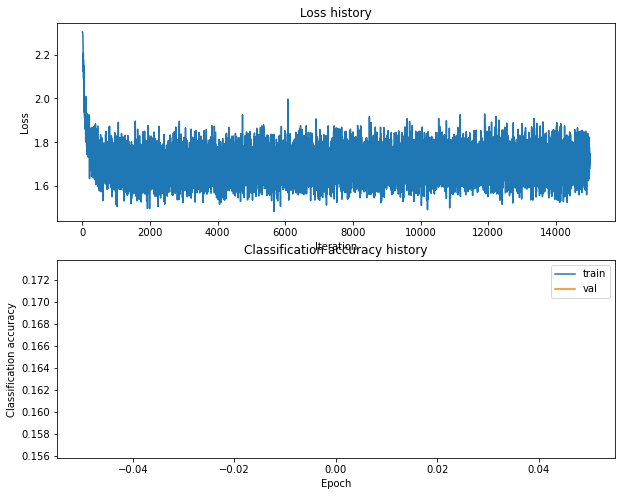

Training network with h_s 170, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.303227
iteration 100 / 15000: loss 2.299129
iteration 200 / 15000: loss 2.252105
iteration 300 / 15000: loss 2.168708
iteration 400 / 15000: loss 2.110279
iteration 500 / 15000: loss 2.023069
iteration 600 / 15000: loss 2.053725
iteration 700 / 15000: loss 1.988222
iteration 800 / 15000: loss 2.005116
iteration 900 / 15000: loss 1.950097
iteration 1000 / 15000: loss 1.934089
iteration 1100 / 15000: loss 1.931670
iteration 1200 / 15000: loss 1.874882
iteration 1300 / 15000: loss 1.875991
iteration 1400 / 15000: loss 1.905072
iteration 1500 / 15000: loss 1.870370
iteration 1600 / 15000: loss 1.836073
iteration 1700 / 15000: loss 1.864134
iteration 1800 / 15000: loss 1.949261
iteration 1900 / 15000: loss 1.832795
iteration 2000 / 15000: loss 1.819736
iteration 2100 / 15000: loss 1.847724
iteration 2200 / 15000: loss 1.833605
iteration 2300 / 15000: loss 1.870223
iteration 2400 / 15000: loss 1.802232


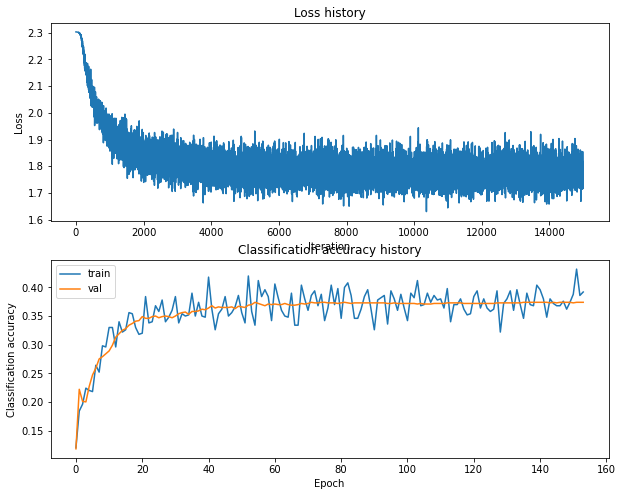

Training network with h_s 170, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.303246
iteration 100 / 15000: loss 1.941018
iteration 200 / 15000: loss 1.734076
iteration 300 / 15000: loss 1.729055
iteration 400 / 15000: loss 1.754944
iteration 500 / 15000: loss 1.728055
iteration 600 / 15000: loss 1.677570
iteration 700 / 15000: loss 1.756099
iteration 800 / 15000: loss 1.612165
iteration 900 / 15000: loss 1.652356
iteration 1000 / 15000: loss 1.804317
iteration 1100 / 15000: loss 1.636086
iteration 1200 / 15000: loss 1.716555
iteration 1300 / 15000: loss 1.672644
iteration 1400 / 15000: loss 1.669369
iteration 1500 / 15000: loss 1.640720
iteration 1600 / 15000: loss 1.577645
iteration 1700 / 15000: loss 1.696439
iteration 1800 / 15000: loss 1.639424
iteration 1900 / 15000: loss 1.654404
iteration 2000 / 15000: loss 1.647291
iteration 2100 / 15000: loss 1.567703
iteration 2200 / 15000: loss 1.639032
iteration 2300 / 15000: loss 1.675733
iteration 2400 / 15000: loss 1.677077
i

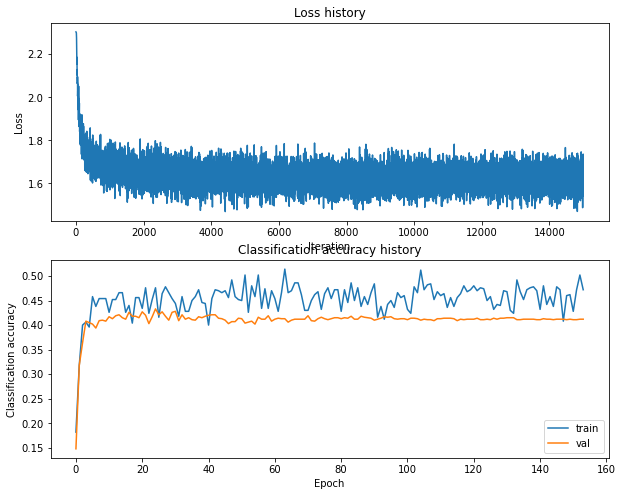

Training network with h_s 170, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.303216
iteration 100 / 20000: loss 2.299654
iteration 200 / 20000: loss 2.245377
iteration 300 / 20000: loss 2.162158
iteration 400 / 20000: loss 2.075414
iteration 500 / 20000: loss 2.046697
iteration 600 / 20000: loss 2.001572
iteration 700 / 20000: loss 1.919465
iteration 800 / 20000: loss 1.883186
iteration 900 / 20000: loss 1.935685
iteration 1000 / 20000: loss 1.869506
iteration 1100 / 20000: loss 1.828302
iteration 1200 / 20000: loss 1.758682
iteration 1300 / 20000: loss 1.810217
iteration 1400 / 20000: loss 1.723674
iteration 1500 / 20000: loss 1.784642
iteration 1600 / 20000: loss 1.742795
iteration 1700 / 20000: loss 1.923424
iteration 1800 / 20000: loss 1.885240
iteration 1900 / 20000: loss 1.803903
iteration 2000 / 20000: loss 1.734138
iteration 2100 / 20000: loss 1.647978
iteration 2200 / 20000: loss 1.793991
iteration 2300 / 20000: loss 1.683787
iteration 2400 / 20000: loss 1.675595


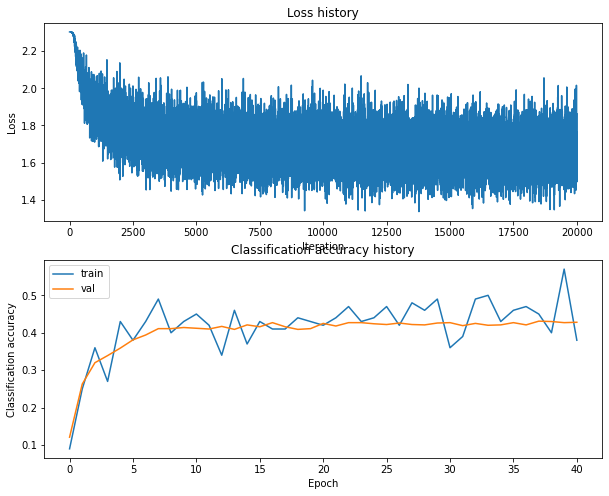

Training network with h_s 170, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.303132
iteration 100 / 20000: loss 1.921762
iteration 200 / 20000: loss 1.827212
iteration 300 / 20000: loss 1.742090
iteration 400 / 20000: loss 1.576100
iteration 500 / 20000: loss 1.746808
iteration 600 / 20000: loss 1.555790
iteration 700 / 20000: loss 1.754328
iteration 800 / 20000: loss 1.747836
iteration 900 / 20000: loss 1.737287
iteration 1000 / 20000: loss 1.872301
iteration 1100 / 20000: loss 1.558480
iteration 1200 / 20000: loss 1.827998
iteration 1300 / 20000: loss 1.620454
iteration 1400 / 20000: loss 1.726266
iteration 1500 / 20000: loss 1.726042
iteration 1600 / 20000: loss 1.660669
iteration 1700 / 20000: loss 1.790367
iteration 1800 / 20000: loss 1.763974
iteration 1900 / 20000: loss 1.629851
iteration 2000 / 20000: loss 1.566791
iteration 2100 / 20000: loss 1.688611
iteration 2200 / 20000: loss 1.780308
iteration 2300 / 20000: loss 1.585674
iteration 2400 / 20000: loss 1.842850
i

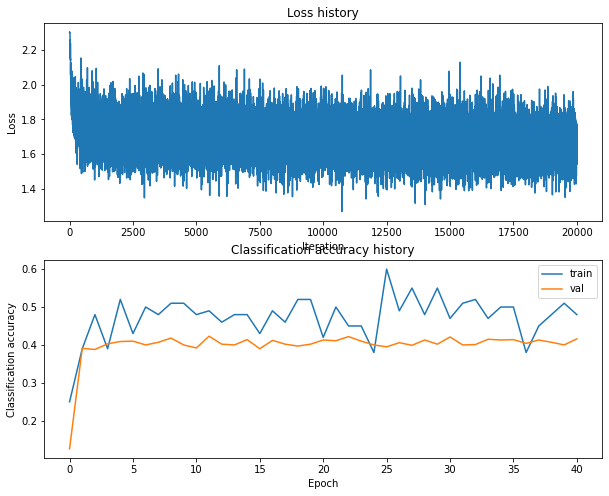

Training network with h_s 170, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.303282
iteration 100 / 20000: loss 2.298959
iteration 200 / 20000: loss 2.235651
iteration 300 / 20000: loss 2.132169
iteration 400 / 20000: loss 2.037874
iteration 500 / 20000: loss 1.985490
iteration 600 / 20000: loss 2.021575
iteration 700 / 20000: loss 1.933843
iteration 800 / 20000: loss 1.967576
iteration 900 / 20000: loss 1.964595
iteration 1000 / 20000: loss 1.925647
iteration 1100 / 20000: loss 1.893225
iteration 1200 / 20000: loss 1.878838
iteration 1300 / 20000: loss 1.803552
iteration 1400 / 20000: loss 1.762625
iteration 1500 / 20000: loss 1.834634
iteration 1600 / 20000: loss 1.809065
iteration 1700 / 20000: loss 1.713106
iteration 1800 / 20000: loss 1.778259
iteration 1900 / 20000: loss 1.804508
iteration 2000 / 20000: loss 1.714622
iteration 2100 / 20000: loss 1.803040
iteration 2200 / 20000: loss 1.975420
iteration 2300 / 20000: loss 1.778014
iteration 2400 / 20000: loss 1.766126


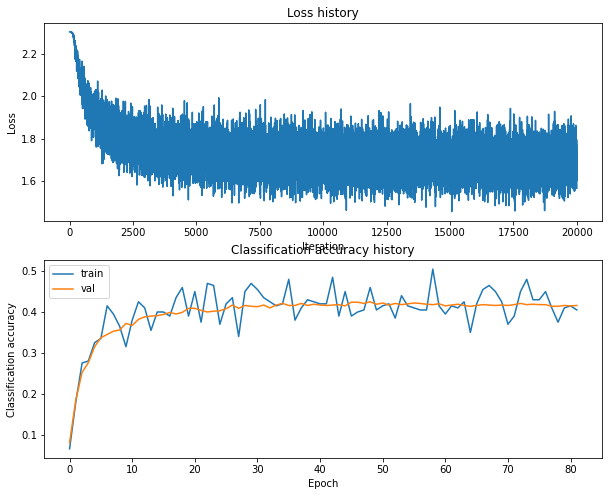

Training network with h_s 170, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.303262
iteration 100 / 20000: loss 1.961135
iteration 200 / 20000: loss 1.812206
iteration 300 / 20000: loss 1.793961
iteration 400 / 20000: loss 1.846497
iteration 500 / 20000: loss 1.837016
iteration 600 / 20000: loss 1.625230
iteration 700 / 20000: loss 1.709866
iteration 800 / 20000: loss 1.664503
iteration 900 / 20000: loss 1.773246
iteration 1000 / 20000: loss 1.615530
iteration 1100 / 20000: loss 1.710956
iteration 1200 / 20000: loss 1.722755
iteration 1300 / 20000: loss 1.866665
iteration 1400 / 20000: loss 1.856003
iteration 1500 / 20000: loss 1.686687
iteration 1600 / 20000: loss 1.687020
iteration 1700 / 20000: loss 1.695693
iteration 1800 / 20000: loss 1.638310
iteration 1900 / 20000: loss 1.674830
iteration 2000 / 20000: loss 1.699631
iteration 2100 / 20000: loss 1.753530
iteration 2200 / 20000: loss 1.650459
iteration 2300 / 20000: loss 1.726626
iteration 2400 / 20000: loss 1.648421
i

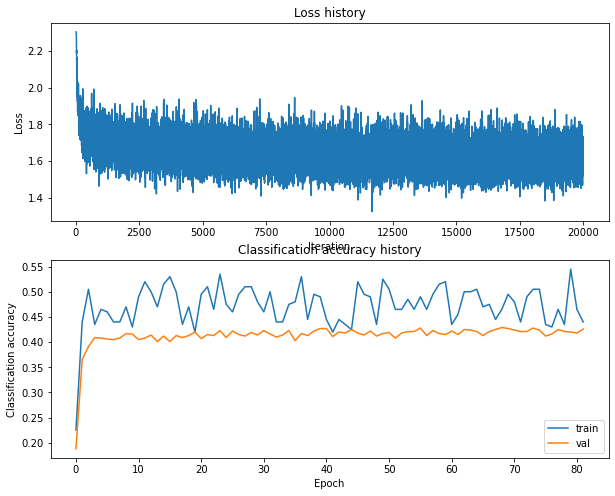

Training network with h_s 170, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.303243
iteration 100 / 20000: loss 2.298511
iteration 200 / 20000: loss 2.243170
iteration 300 / 20000: loss 2.156142
iteration 400 / 20000: loss 2.073930
iteration 500 / 20000: loss 1.959341
iteration 600 / 20000: loss 2.060262
iteration 700 / 20000: loss 1.924167
iteration 800 / 20000: loss 1.984165
iteration 900 / 20000: loss 1.949437
iteration 1000 / 20000: loss 2.037706
iteration 1100 / 20000: loss 1.976136
iteration 1200 / 20000: loss 1.834977
iteration 1300 / 20000: loss 1.837384
iteration 1400 / 20000: loss 1.935629
iteration 1500 / 20000: loss 1.799974
iteration 1600 / 20000: loss 1.862785
iteration 1700 / 20000: loss 1.846005
iteration 1800 / 20000: loss 1.800488
iteration 1900 / 20000: loss 1.906267
iteration 2000 / 20000: loss 1.715193
iteration 2100 / 20000: loss 1.728402
iteration 2200 / 20000: loss 1.795302
iteration 2300 / 20000: loss 1.823768
iteration 2400 / 20000: loss 1.764821


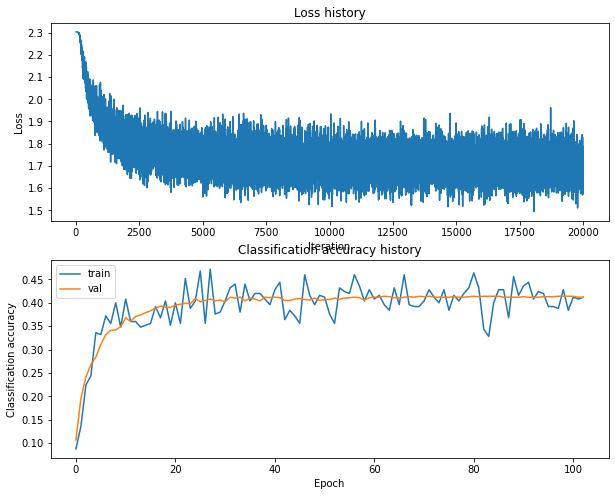

Training network with h_s 170, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.303218
iteration 100 / 20000: loss 1.917568
iteration 200 / 20000: loss 1.835941
iteration 300 / 20000: loss 1.755732
iteration 400 / 20000: loss 1.708515
iteration 500 / 20000: loss 1.726425
iteration 600 / 20000: loss 1.651659
iteration 700 / 20000: loss 1.700031
iteration 800 / 20000: loss 1.859706
iteration 900 / 20000: loss 1.831681
iteration 1000 / 20000: loss 1.743092
iteration 1100 / 20000: loss 1.659049
iteration 1200 / 20000: loss 1.662990
iteration 1300 / 20000: loss 1.602816
iteration 1400 / 20000: loss 1.735884
iteration 1500 / 20000: loss 1.636548
iteration 1600 / 20000: loss 1.706447
iteration 1700 / 20000: loss 1.769749
iteration 1800 / 20000: loss 1.675404
iteration 1900 / 20000: loss 1.643012
iteration 2000 / 20000: loss 1.686999
iteration 2100 / 20000: loss 1.649886
iteration 2200 / 20000: loss 1.642971
iteration 2300 / 20000: loss 1.723707
iteration 2400 / 20000: loss 1.588361
i

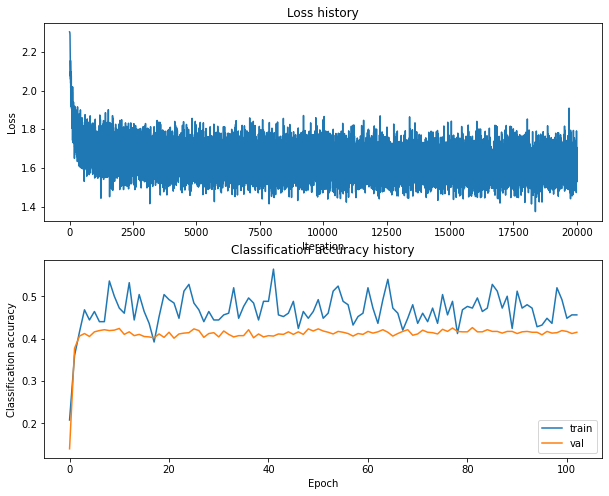

Training network with h_s 170, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.303241
iteration 100 / 20000: loss 2.299755
iteration 200 / 20000: loss 2.255291
iteration 300 / 20000: loss 2.151755
iteration 400 / 20000: loss 2.055269
iteration 500 / 20000: loss 1.980478
iteration 600 / 20000: loss 1.991494
iteration 700 / 20000: loss 1.945535
iteration 800 / 20000: loss 1.917890
iteration 900 / 20000: loss 1.908023
iteration 1000 / 20000: loss 1.960077
iteration 1100 / 20000: loss 1.842723
iteration 1200 / 20000: loss 1.819268
iteration 1300 / 20000: loss 1.841351
iteration 1400 / 20000: loss 1.786707
iteration 1500 / 20000: loss 1.850669
iteration 1600 / 20000: loss 1.850029
iteration 1700 / 20000: loss 1.775375
iteration 1800 / 20000: loss 1.811023
iteration 1900 / 20000: loss 1.806834
iteration 2000 / 20000: loss 1.726881
iteration 2100 / 20000: loss 1.801415
iteration 2200 / 20000: loss 1.849187
iteration 2300 / 20000: loss 1.822505
iteration 2400 / 20000: loss 1.758348


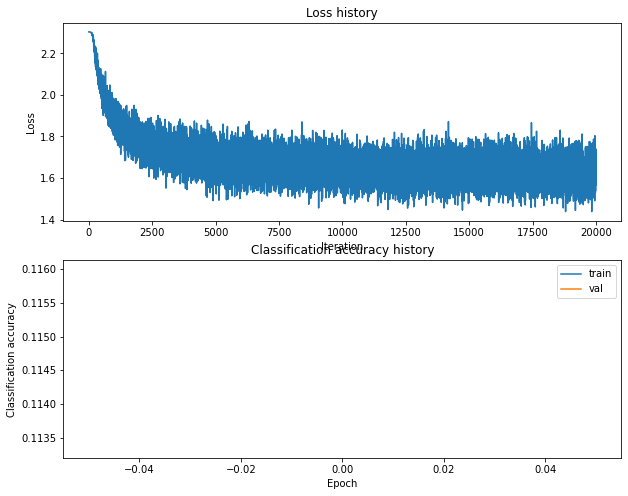

Training network with h_s 170, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.303205
iteration 100 / 20000: loss 1.915149
iteration 200 / 20000: loss 1.826469
iteration 300 / 20000: loss 1.713684
iteration 400 / 20000: loss 1.706230
iteration 500 / 20000: loss 1.705332
iteration 600 / 20000: loss 1.760976
iteration 700 / 20000: loss 1.669613
iteration 800 / 20000: loss 1.679565
iteration 900 / 20000: loss 1.740400
iteration 1000 / 20000: loss 1.722727
iteration 1100 / 20000: loss 1.713107
iteration 1200 / 20000: loss 1.665977
iteration 1300 / 20000: loss 1.755514
iteration 1400 / 20000: loss 1.744497
iteration 1500 / 20000: loss 1.695835
iteration 1600 / 20000: loss 1.633144
iteration 1700 / 20000: loss 1.608657
iteration 1800 / 20000: loss 1.706477
iteration 1900 / 20000: loss 1.667881
iteration 2000 / 20000: loss 1.715898
iteration 2100 / 20000: loss 1.694911
iteration 2200 / 20000: loss 1.730979
iteration 2300 / 20000: loss 1.630614
iteration 2400 / 20000: loss 1.678238
i

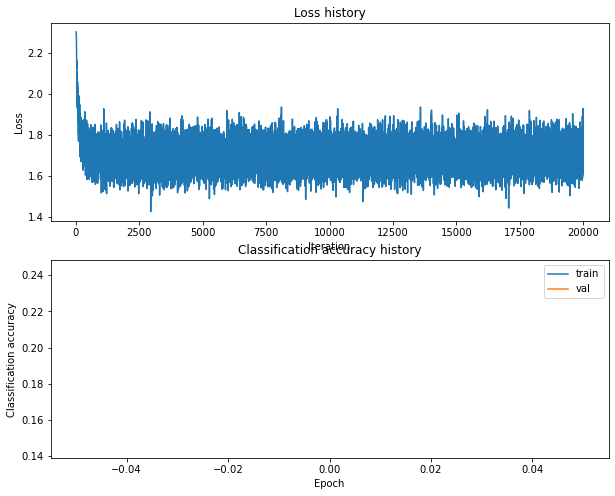

Training network with h_s 170, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.303252
iteration 100 / 20000: loss 2.299758
iteration 200 / 20000: loss 2.248054
iteration 300 / 20000: loss 2.174831
iteration 400 / 20000: loss 2.079575
iteration 500 / 20000: loss 2.098071
iteration 600 / 20000: loss 2.031096
iteration 700 / 20000: loss 2.013046
iteration 800 / 20000: loss 1.994926
iteration 900 / 20000: loss 1.920913
iteration 1000 / 20000: loss 1.990598
iteration 1100 / 20000: loss 1.893704
iteration 1200 / 20000: loss 1.926989
iteration 1300 / 20000: loss 1.899918
iteration 1400 / 20000: loss 1.859856
iteration 1500 / 20000: loss 1.868145
iteration 1600 / 20000: loss 1.877180
iteration 1700 / 20000: loss 1.863097
iteration 1800 / 20000: loss 1.878938
iteration 1900 / 20000: loss 1.842323
iteration 2000 / 20000: loss 1.873347
iteration 2100 / 20000: loss 1.830246
iteration 2200 / 20000: loss 1.872019
iteration 2300 / 20000: loss 1.785520
iteration 2400 / 20000: loss 1.849167


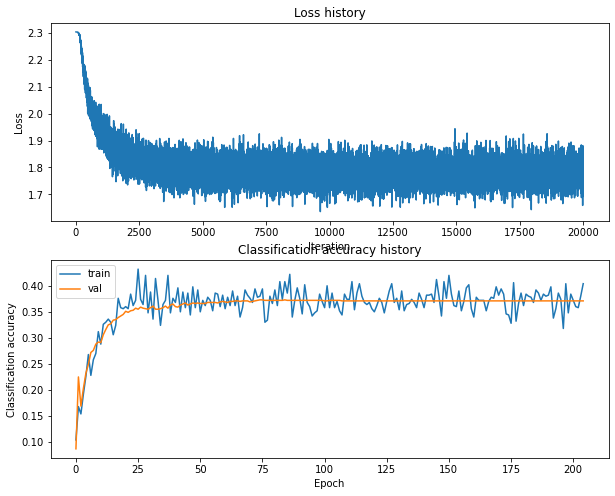

Training network with h_s 170, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.303228
iteration 100 / 20000: loss 1.809881
iteration 200 / 20000: loss 1.780215
iteration 300 / 20000: loss 1.710238
iteration 400 / 20000: loss 1.692715
iteration 500 / 20000: loss 1.651229
iteration 600 / 20000: loss 1.727437
iteration 700 / 20000: loss 1.694174
iteration 800 / 20000: loss 1.608072
iteration 900 / 20000: loss 1.761576
iteration 1000 / 20000: loss 1.639366
iteration 1100 / 20000: loss 1.771414
iteration 1200 / 20000: loss 1.666192
iteration 1300 / 20000: loss 1.667943
iteration 1400 / 20000: loss 1.605410
iteration 1500 / 20000: loss 1.674653
iteration 1600 / 20000: loss 1.715671
iteration 1700 / 20000: loss 1.717871
iteration 1800 / 20000: loss 1.635320
iteration 1900 / 20000: loss 1.648265
iteration 2000 / 20000: loss 1.675553
iteration 2100 / 20000: loss 1.624995
iteration 2200 / 20000: loss 1.614161
iteration 2300 / 20000: loss 1.593990
iteration 2400 / 20000: loss 1.623170
i

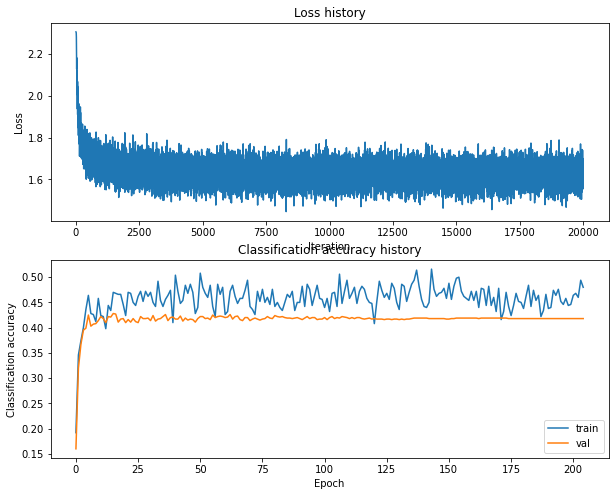

Training network with h_s 170, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.303247
iteration 100 / 25000: loss 2.299500
iteration 200 / 25000: loss 2.236542
iteration 300 / 25000: loss 2.164301
iteration 400 / 25000: loss 2.104561
iteration 500 / 25000: loss 2.016397
iteration 600 / 25000: loss 2.031735
iteration 700 / 25000: loss 1.978779
iteration 800 / 25000: loss 1.922958
iteration 900 / 25000: loss 1.977233
iteration 1000 / 25000: loss 1.945819
iteration 1100 / 25000: loss 1.911819
iteration 1200 / 25000: loss 1.959414
iteration 1300 / 25000: loss 1.699227
iteration 1400 / 25000: loss 1.986003
iteration 1500 / 25000: loss 1.714655
iteration 1600 / 25000: loss 1.818539
iteration 1700 / 25000: loss 1.929345
iteration 1800 / 25000: loss 1.802462
iteration 1900 / 25000: loss 1.730002
iteration 2000 / 25000: loss 1.931008
iteration 2100 / 25000: loss 1.828843
iteration 2200 / 25000: loss 1.799754
iteration 2300 / 25000: loss 1.799607
iteration 2400 / 25000: loss 1.713992


iteration 21200 / 25000: loss 1.635649
iteration 21300 / 25000: loss 1.823403
iteration 21400 / 25000: loss 1.903115
iteration 21500 / 25000: loss 1.793439
iteration 21600 / 25000: loss 1.446435
iteration 21700 / 25000: loss 1.598005
iteration 21800 / 25000: loss 1.687526
iteration 21900 / 25000: loss 1.684415
iteration 22000 / 25000: loss 1.663556
iteration 22100 / 25000: loss 1.631008
iteration 22200 / 25000: loss 1.615889
iteration 22300 / 25000: loss 1.755782
iteration 22400 / 25000: loss 1.853033
iteration 22500 / 25000: loss 1.578371
iteration 22600 / 25000: loss 1.644535
iteration 22700 / 25000: loss 1.482130
iteration 22800 / 25000: loss 1.452715
iteration 22900 / 25000: loss 1.731393
iteration 23000 / 25000: loss 1.666337
iteration 23100 / 25000: loss 1.714898
iteration 23200 / 25000: loss 1.649041
iteration 23300 / 25000: loss 1.639667
iteration 23400 / 25000: loss 1.631871
iteration 23500 / 25000: loss 1.745896
iteration 23600 / 25000: loss 1.560776
iteration 23700 / 25000: 

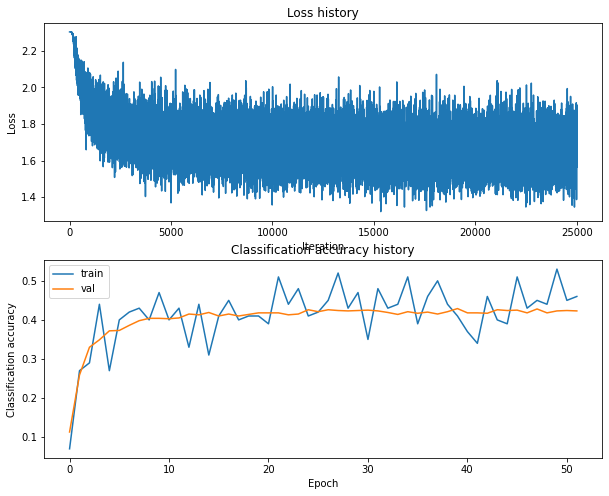

Training network with h_s 170, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.303196
iteration 100 / 25000: loss 1.943816
iteration 200 / 25000: loss 1.715692
iteration 300 / 25000: loss 1.843947
iteration 400 / 25000: loss 1.815532
iteration 500 / 25000: loss 1.699845
iteration 600 / 25000: loss 1.997433
iteration 700 / 25000: loss 1.732242
iteration 800 / 25000: loss 1.739145
iteration 900 / 25000: loss 1.851681
iteration 1000 / 25000: loss 1.731999
iteration 1100 / 25000: loss 1.619638
iteration 1200 / 25000: loss 1.844679
iteration 1300 / 25000: loss 1.845567
iteration 1400 / 25000: loss 1.787245
iteration 1500 / 25000: loss 1.899895
iteration 1600 / 25000: loss 1.556090
iteration 1700 / 25000: loss 1.609023
iteration 1800 / 25000: loss 1.848806
iteration 1900 / 25000: loss 1.596409
iteration 2000 / 25000: loss 1.699365
iteration 2100 / 25000: loss 1.806352
iteration 2200 / 25000: loss 1.704078
iteration 2300 / 25000: loss 1.706645
iteration 2400 / 25000: loss 1.709794
i

iteration 21200 / 25000: loss 1.711174
iteration 21300 / 25000: loss 1.720573
iteration 21400 / 25000: loss 1.569738
iteration 21500 / 25000: loss 1.864250
iteration 21600 / 25000: loss 1.612959
iteration 21700 / 25000: loss 1.774763
iteration 21800 / 25000: loss 1.572835
iteration 21900 / 25000: loss 1.662679
iteration 22000 / 25000: loss 1.656410
iteration 22100 / 25000: loss 1.789162
iteration 22200 / 25000: loss 1.564975
iteration 22300 / 25000: loss 1.691756
iteration 22400 / 25000: loss 1.627821
iteration 22500 / 25000: loss 1.537140
iteration 22600 / 25000: loss 1.671391
iteration 22700 / 25000: loss 1.604834
iteration 22800 / 25000: loss 1.679222
iteration 22900 / 25000: loss 1.697973
iteration 23000 / 25000: loss 1.588863
iteration 23100 / 25000: loss 1.694106
iteration 23200 / 25000: loss 1.647797
iteration 23300 / 25000: loss 1.794912
iteration 23400 / 25000: loss 1.682794
iteration 23500 / 25000: loss 1.714698
iteration 23600 / 25000: loss 1.768955
iteration 23700 / 25000: 

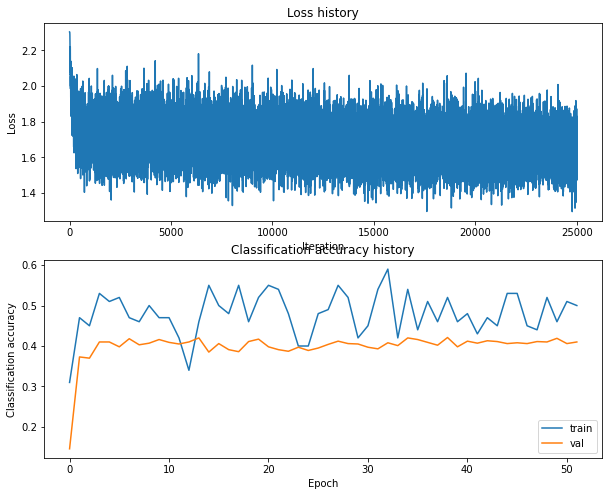

Training network with h_s 170, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.303184
iteration 100 / 25000: loss 2.299838
iteration 200 / 25000: loss 2.265393
iteration 300 / 25000: loss 2.164329
iteration 400 / 25000: loss 2.068866
iteration 500 / 25000: loss 2.011133
iteration 600 / 25000: loss 1.979625
iteration 700 / 25000: loss 1.964383
iteration 800 / 25000: loss 1.905389
iteration 900 / 25000: loss 1.915201
iteration 1000 / 25000: loss 1.990865
iteration 1100 / 25000: loss 1.859476
iteration 1200 / 25000: loss 1.837271
iteration 1300 / 25000: loss 1.953125
iteration 1400 / 25000: loss 1.794046
iteration 1500 / 25000: loss 1.976209
iteration 1600 / 25000: loss 1.895784
iteration 1700 / 25000: loss 1.838850
iteration 1800 / 25000: loss 1.863641
iteration 1900 / 25000: loss 1.750108
iteration 2000 / 25000: loss 1.766406
iteration 2100 / 25000: loss 1.782961
iteration 2200 / 25000: loss 1.634988
iteration 2300 / 25000: loss 1.785472
iteration 2400 / 25000: loss 1.723857


iteration 21200 / 25000: loss 1.748640
iteration 21300 / 25000: loss 1.689164
iteration 21400 / 25000: loss 1.731183
iteration 21500 / 25000: loss 1.673438
iteration 21600 / 25000: loss 1.652758
iteration 21700 / 25000: loss 1.594002
iteration 21800 / 25000: loss 1.601866
iteration 21900 / 25000: loss 1.742543
iteration 22000 / 25000: loss 1.718931
iteration 22100 / 25000: loss 1.636439
iteration 22200 / 25000: loss 1.589714
iteration 22300 / 25000: loss 1.796196
iteration 22400 / 25000: loss 1.742559
iteration 22500 / 25000: loss 1.596319
iteration 22600 / 25000: loss 1.664940
iteration 22700 / 25000: loss 1.745167
iteration 22800 / 25000: loss 1.693158
iteration 22900 / 25000: loss 1.729041
iteration 23000 / 25000: loss 1.674321
iteration 23100 / 25000: loss 1.697678
iteration 23200 / 25000: loss 1.622677
iteration 23300 / 25000: loss 1.683741
iteration 23400 / 25000: loss 1.661989
iteration 23500 / 25000: loss 1.747722
iteration 23600 / 25000: loss 1.627034
iteration 23700 / 25000: 

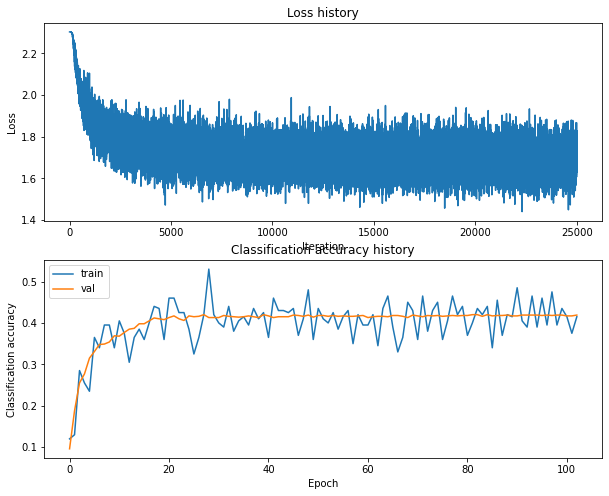

Training network with h_s 170, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.303223
iteration 100 / 25000: loss 1.853081
iteration 200 / 25000: loss 1.890037
iteration 300 / 25000: loss 1.807497
iteration 400 / 25000: loss 1.848681
iteration 500 / 25000: loss 1.740672
iteration 600 / 25000: loss 1.756016
iteration 700 / 25000: loss 1.857116
iteration 800 / 25000: loss 1.723336
iteration 900 / 25000: loss 1.743899
iteration 1000 / 25000: loss 1.541284
iteration 1100 / 25000: loss 1.651477
iteration 1200 / 25000: loss 1.517264
iteration 1300 / 25000: loss 1.653243
iteration 1400 / 25000: loss 1.637782
iteration 1500 / 25000: loss 1.669815
iteration 1600 / 25000: loss 1.787879
iteration 1700 / 25000: loss 1.720893
iteration 1800 / 25000: loss 1.697896
iteration 1900 / 25000: loss 1.586482
iteration 2000 / 25000: loss 1.699508
iteration 2100 / 25000: loss 1.624173
iteration 2200 / 25000: loss 1.712010
iteration 2300 / 25000: loss 1.550787
iteration 2400 / 25000: loss 1.600656
i

iteration 21200 / 25000: loss 1.569541
iteration 21300 / 25000: loss 1.794525
iteration 21400 / 25000: loss 1.605659
iteration 21500 / 25000: loss 1.563140
iteration 21600 / 25000: loss 1.634564
iteration 21700 / 25000: loss 1.664030
iteration 21800 / 25000: loss 1.639282
iteration 21900 / 25000: loss 1.591923
iteration 22000 / 25000: loss 1.511136
iteration 22100 / 25000: loss 1.552890
iteration 22200 / 25000: loss 1.576388
iteration 22300 / 25000: loss 1.616943
iteration 22400 / 25000: loss 1.532277
iteration 22500 / 25000: loss 1.582909
iteration 22600 / 25000: loss 1.691518
iteration 22700 / 25000: loss 1.633939
iteration 22800 / 25000: loss 1.566051
iteration 22900 / 25000: loss 1.638173
iteration 23000 / 25000: loss 1.784428
iteration 23100 / 25000: loss 1.824226
iteration 23200 / 25000: loss 1.614250
iteration 23300 / 25000: loss 1.592102
iteration 23400 / 25000: loss 1.649653
iteration 23500 / 25000: loss 1.531191
iteration 23600 / 25000: loss 1.531812
iteration 23700 / 25000: 

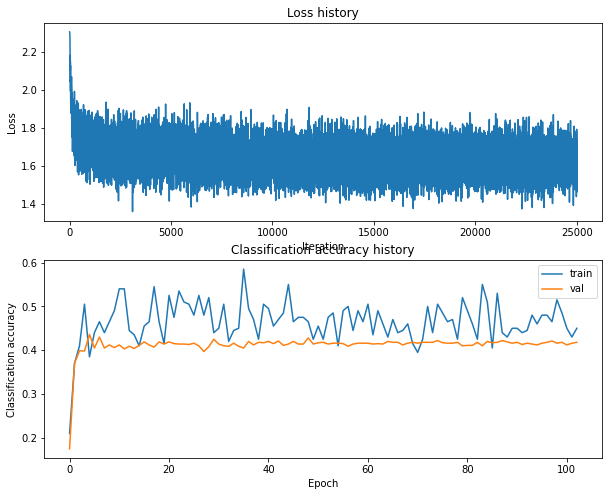

Training network with h_s 170, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.303263
iteration 100 / 25000: loss 2.299682
iteration 200 / 25000: loss 2.216013
iteration 300 / 25000: loss 2.175678
iteration 400 / 25000: loss 2.067672
iteration 500 / 25000: loss 2.084751
iteration 600 / 25000: loss 2.068090
iteration 700 / 25000: loss 1.914168
iteration 800 / 25000: loss 1.929709
iteration 900 / 25000: loss 1.983070
iteration 1000 / 25000: loss 1.902923
iteration 1100 / 25000: loss 1.958176
iteration 1200 / 25000: loss 1.847627
iteration 1300 / 25000: loss 1.853997
iteration 1400 / 25000: loss 1.840045
iteration 1500 / 25000: loss 1.787914
iteration 1600 / 25000: loss 1.800820
iteration 1700 / 25000: loss 1.827553
iteration 1800 / 25000: loss 1.801975
iteration 1900 / 25000: loss 1.847576
iteration 2000 / 25000: loss 1.777063
iteration 2100 / 25000: loss 1.844973
iteration 2200 / 25000: loss 1.742006
iteration 2300 / 25000: loss 1.918965
iteration 2400 / 25000: loss 1.867278


iteration 21200 / 25000: loss 1.707876
iteration 21300 / 25000: loss 1.591245
iteration 21400 / 25000: loss 1.719719
iteration 21500 / 25000: loss 1.725242
iteration 21600 / 25000: loss 1.680586
iteration 21700 / 25000: loss 1.681915
iteration 21800 / 25000: loss 1.851325
iteration 21900 / 25000: loss 1.647213
iteration 22000 / 25000: loss 1.719821
iteration 22100 / 25000: loss 1.684148
iteration 22200 / 25000: loss 1.681085
iteration 22300 / 25000: loss 1.695613
iteration 22400 / 25000: loss 1.755152
iteration 22500 / 25000: loss 1.727726
iteration 22600 / 25000: loss 1.633348
iteration 22700 / 25000: loss 1.663588
iteration 22800 / 25000: loss 1.737937
iteration 22900 / 25000: loss 1.674116
iteration 23000 / 25000: loss 1.673831
iteration 23100 / 25000: loss 1.819309
iteration 23200 / 25000: loss 1.647454
iteration 23300 / 25000: loss 1.729440
iteration 23400 / 25000: loss 1.646201
iteration 23500 / 25000: loss 1.894662
iteration 23600 / 25000: loss 1.808581
iteration 23700 / 25000: 

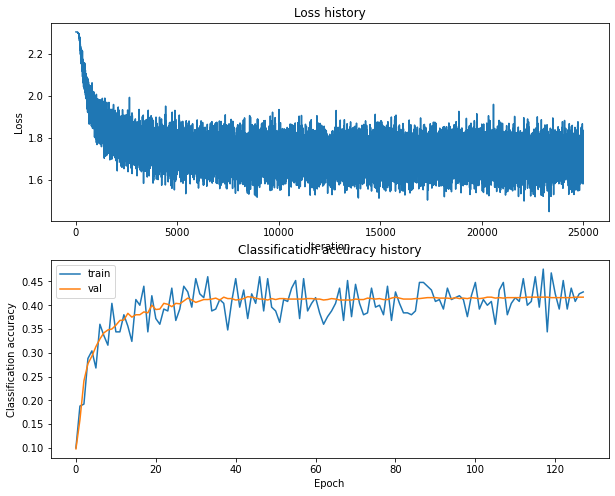

Training network with h_s 170, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.303216
iteration 100 / 25000: loss 1.900429
iteration 200 / 25000: loss 1.792574
iteration 300 / 25000: loss 1.695872
iteration 400 / 25000: loss 1.700151
iteration 500 / 25000: loss 1.761908
iteration 600 / 25000: loss 1.673834
iteration 700 / 25000: loss 1.641520
iteration 800 / 25000: loss 1.718441
iteration 900 / 25000: loss 1.737009
iteration 1000 / 25000: loss 1.611554
iteration 1100 / 25000: loss 1.684797
iteration 1200 / 25000: loss 1.680174
iteration 1300 / 25000: loss 1.711695
iteration 1400 / 25000: loss 1.710389
iteration 1500 / 25000: loss 1.799427
iteration 1600 / 25000: loss 1.673038
iteration 1700 / 25000: loss 1.606387
iteration 1800 / 25000: loss 1.824446
iteration 1900 / 25000: loss 1.590234
iteration 2000 / 25000: loss 1.497492
iteration 2100 / 25000: loss 1.760978
iteration 2200 / 25000: loss 1.609039
iteration 2300 / 25000: loss 1.672257
iteration 2400 / 25000: loss 1.596208
i

iteration 21200 / 25000: loss 1.609338
iteration 21300 / 25000: loss 1.690446
iteration 21400 / 25000: loss 1.702472
iteration 21500 / 25000: loss 1.635247
iteration 21600 / 25000: loss 1.606968
iteration 21700 / 25000: loss 1.637470
iteration 21800 / 25000: loss 1.664320
iteration 21900 / 25000: loss 1.662226
iteration 22000 / 25000: loss 1.675730
iteration 22100 / 25000: loss 1.727399
iteration 22200 / 25000: loss 1.630228
iteration 22300 / 25000: loss 1.523830
iteration 22400 / 25000: loss 1.549130
iteration 22500 / 25000: loss 1.616705
iteration 22600 / 25000: loss 1.694439
iteration 22700 / 25000: loss 1.588912
iteration 22800 / 25000: loss 1.657013
iteration 22900 / 25000: loss 1.686507
iteration 23000 / 25000: loss 1.710039
iteration 23100 / 25000: loss 1.662925
iteration 23200 / 25000: loss 1.538451
iteration 23300 / 25000: loss 1.596634
iteration 23400 / 25000: loss 1.594646
iteration 23500 / 25000: loss 1.616581
iteration 23600 / 25000: loss 1.715228
iteration 23700 / 25000: 

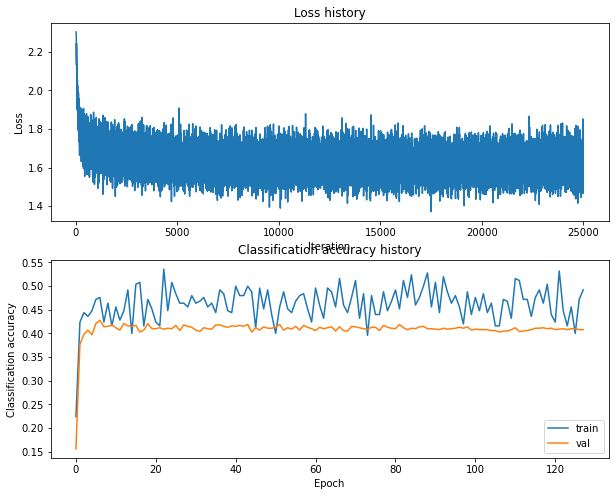

Training network with h_s 170, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.303230
iteration 100 / 25000: loss 2.298765
iteration 200 / 25000: loss 2.260265
iteration 300 / 25000: loss 2.145128
iteration 400 / 25000: loss 2.042321
iteration 500 / 25000: loss 2.005069
iteration 600 / 25000: loss 1.925371
iteration 700 / 25000: loss 1.918655
iteration 800 / 25000: loss 1.827946
iteration 900 / 25000: loss 1.852166
iteration 1000 / 25000: loss 1.792699
iteration 1100 / 25000: loss 1.835040
iteration 1200 / 25000: loss 1.846249
iteration 1300 / 25000: loss 1.830840
iteration 1400 / 25000: loss 1.865345
iteration 1500 / 25000: loss 1.843149
iteration 1600 / 25000: loss 1.810482
iteration 1700 / 25000: loss 1.740227
iteration 1800 / 25000: loss 1.793286
iteration 1900 / 25000: loss 1.750881
iteration 2000 / 25000: loss 1.699647
iteration 2100 / 25000: loss 1.777266
iteration 2200 / 25000: loss 1.860032
iteration 2300 / 25000: loss 1.691997
iteration 2400 / 25000: loss 1.750741


iteration 21200 / 25000: loss 1.695028
iteration 21300 / 25000: loss 1.593198
iteration 21400 / 25000: loss 1.615020
iteration 21500 / 25000: loss 1.691529
iteration 21600 / 25000: loss 1.682472
iteration 21700 / 25000: loss 1.586633
iteration 21800 / 25000: loss 1.618572
iteration 21900 / 25000: loss 1.602521
iteration 22000 / 25000: loss 1.558925
iteration 22100 / 25000: loss 1.723906
iteration 22200 / 25000: loss 1.558674
iteration 22300 / 25000: loss 1.603004
iteration 22400 / 25000: loss 1.623656
iteration 22500 / 25000: loss 1.693526
iteration 22600 / 25000: loss 1.650052
iteration 22700 / 25000: loss 1.601002
iteration 22800 / 25000: loss 1.774826
iteration 22900 / 25000: loss 1.599424
iteration 23000 / 25000: loss 1.612835
iteration 23100 / 25000: loss 1.526328
iteration 23200 / 25000: loss 1.529622
iteration 23300 / 25000: loss 1.625480
iteration 23400 / 25000: loss 1.661162
iteration 23500 / 25000: loss 1.533002
iteration 23600 / 25000: loss 1.644834
iteration 23700 / 25000: 

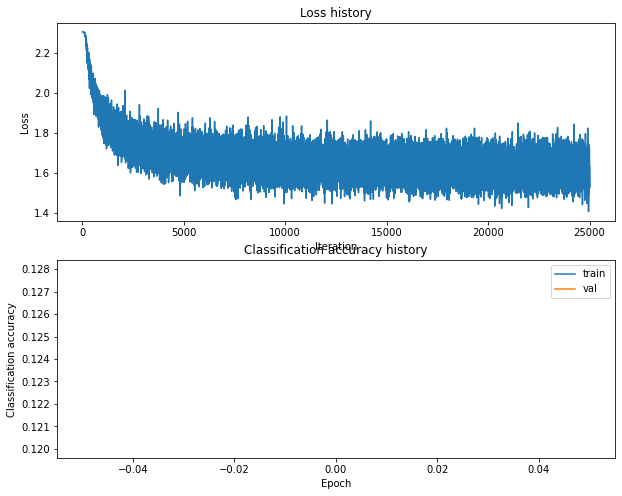

Training network with h_s 170, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.303262
iteration 100 / 25000: loss 1.877384
iteration 200 / 25000: loss 1.825354
iteration 300 / 25000: loss 1.745246
iteration 400 / 25000: loss 1.683538
iteration 500 / 25000: loss 1.730800
iteration 600 / 25000: loss 1.658765
iteration 700 / 25000: loss 1.729404
iteration 800 / 25000: loss 1.704463
iteration 900 / 25000: loss 1.760592
iteration 1000 / 25000: loss 1.692196
iteration 1100 / 25000: loss 1.801643
iteration 1200 / 25000: loss 1.790693
iteration 1300 / 25000: loss 1.768226
iteration 1400 / 25000: loss 1.754113
iteration 1500 / 25000: loss 1.677749
iteration 1600 / 25000: loss 1.728344
iteration 1700 / 25000: loss 1.693570
iteration 1800 / 25000: loss 1.618602
iteration 1900 / 25000: loss 1.568283
iteration 2000 / 25000: loss 1.649139
iteration 2100 / 25000: loss 1.613931
iteration 2200 / 25000: loss 1.659273
iteration 2300 / 25000: loss 1.628025
iteration 2400 / 25000: loss 1.670647
i

iteration 21200 / 25000: loss 1.681744
iteration 21300 / 25000: loss 1.711525
iteration 21400 / 25000: loss 1.677544
iteration 21500 / 25000: loss 1.795774
iteration 21600 / 25000: loss 1.707061
iteration 21700 / 25000: loss 1.696924
iteration 21800 / 25000: loss 1.732213
iteration 21900 / 25000: loss 1.601875
iteration 22000 / 25000: loss 1.769796
iteration 22100 / 25000: loss 1.741978
iteration 22200 / 25000: loss 1.717001
iteration 22300 / 25000: loss 1.655229
iteration 22400 / 25000: loss 1.598415
iteration 22500 / 25000: loss 1.588333
iteration 22600 / 25000: loss 1.629545
iteration 22700 / 25000: loss 1.670974
iteration 22800 / 25000: loss 1.699747
iteration 22900 / 25000: loss 1.693214
iteration 23000 / 25000: loss 1.619186
iteration 23100 / 25000: loss 1.680238
iteration 23200 / 25000: loss 1.652371
iteration 23300 / 25000: loss 1.570478
iteration 23400 / 25000: loss 1.634034
iteration 23500 / 25000: loss 1.752491
iteration 23600 / 25000: loss 1.710861
iteration 23700 / 25000: 

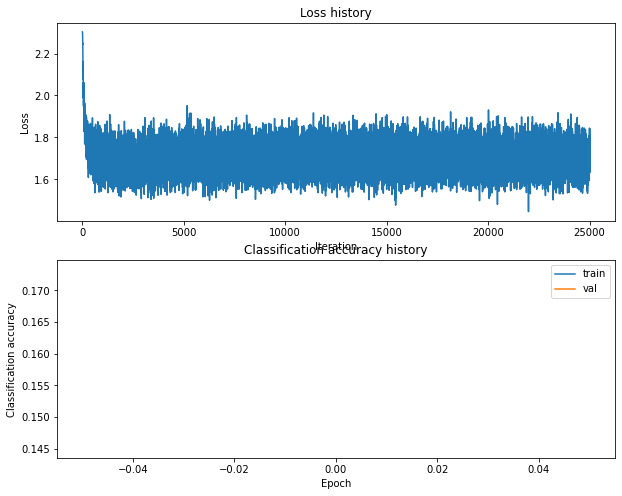

Training network with h_s 170, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.303255
iteration 100 / 25000: loss 2.299905
iteration 200 / 25000: loss 2.271142
iteration 300 / 25000: loss 2.140695
iteration 400 / 25000: loss 2.113458
iteration 500 / 25000: loss 2.079837
iteration 600 / 25000: loss 2.044515
iteration 700 / 25000: loss 1.953835
iteration 800 / 25000: loss 1.961292
iteration 900 / 25000: loss 1.962963
iteration 1000 / 25000: loss 1.964010
iteration 1100 / 25000: loss 1.892907
iteration 1200 / 25000: loss 1.897486
iteration 1300 / 25000: loss 1.892740
iteration 1400 / 25000: loss 1.875202
iteration 1500 / 25000: loss 1.855331
iteration 1600 / 25000: loss 1.811923
iteration 1700 / 25000: loss 1.881707
iteration 1800 / 25000: loss 1.874133
iteration 1900 / 25000: loss 1.839821
iteration 2000 / 25000: loss 1.850740
iteration 2100 / 25000: loss 1.812476
iteration 2200 / 25000: loss 1.826831
iteration 2300 / 25000: loss 1.834588
iteration 2400 / 25000: loss 1.844927


iteration 21200 / 25000: loss 1.874777
iteration 21300 / 25000: loss 1.878800
iteration 21400 / 25000: loss 1.855936
iteration 21500 / 25000: loss 1.744334
iteration 21600 / 25000: loss 1.747634
iteration 21700 / 25000: loss 1.710068
iteration 21800 / 25000: loss 1.731503
iteration 21900 / 25000: loss 1.775446
iteration 22000 / 25000: loss 1.795125
iteration 22100 / 25000: loss 1.803789
iteration 22200 / 25000: loss 1.813840
iteration 22300 / 25000: loss 1.780617
iteration 22400 / 25000: loss 1.751001
iteration 22500 / 25000: loss 1.792488
iteration 22600 / 25000: loss 1.742524
iteration 22700 / 25000: loss 1.828187
iteration 22800 / 25000: loss 1.769568
iteration 22900 / 25000: loss 1.793542
iteration 23000 / 25000: loss 1.773868
iteration 23100 / 25000: loss 1.752678
iteration 23200 / 25000: loss 1.770047
iteration 23300 / 25000: loss 1.757185
iteration 23400 / 25000: loss 1.789703
iteration 23500 / 25000: loss 1.803318
iteration 23600 / 25000: loss 1.762235
iteration 23700 / 25000: 

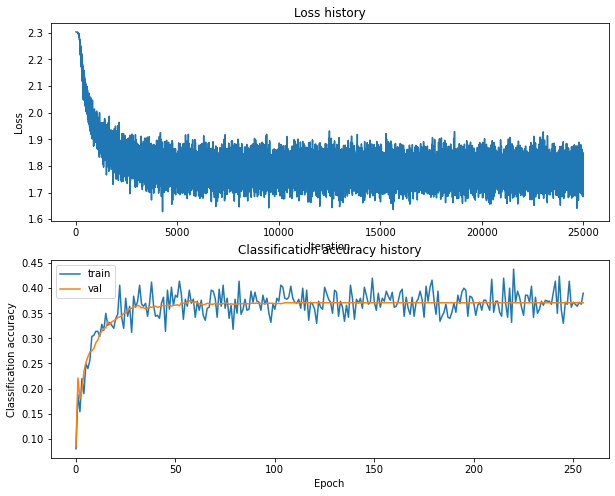

Training network with h_s 170, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.303245
iteration 100 / 25000: loss 1.863089
iteration 200 / 25000: loss 1.746620
iteration 300 / 25000: loss 1.728088
iteration 400 / 25000: loss 1.727126
iteration 500 / 25000: loss 1.746487
iteration 600 / 25000: loss 1.749116
iteration 700 / 25000: loss 1.673411
iteration 800 / 25000: loss 1.672009
iteration 900 / 25000: loss 1.670905
iteration 1000 / 25000: loss 1.705290
iteration 1100 / 25000: loss 1.720169
iteration 1200 / 25000: loss 1.635266
iteration 1300 / 25000: loss 1.637313
iteration 1400 / 25000: loss 1.611524
iteration 1500 / 25000: loss 1.716076
iteration 1600 / 25000: loss 1.735800
iteration 1700 / 25000: loss 1.684960
iteration 1800 / 25000: loss 1.738832
iteration 1900 / 25000: loss 1.648833
iteration 2000 / 25000: loss 1.653433
iteration 2100 / 25000: loss 1.687289
iteration 2200 / 25000: loss 1.560873
iteration 2300 / 25000: loss 1.704278
iteration 2400 / 25000: loss 1.727874
i

iteration 21200 / 25000: loss 1.636989
iteration 21300 / 25000: loss 1.729955
iteration 21400 / 25000: loss 1.703771
iteration 21500 / 25000: loss 1.612666
iteration 21600 / 25000: loss 1.581565
iteration 21700 / 25000: loss 1.728977
iteration 21800 / 25000: loss 1.648425
iteration 21900 / 25000: loss 1.573899
iteration 22000 / 25000: loss 1.676418
iteration 22100 / 25000: loss 1.654723
iteration 22200 / 25000: loss 1.624060
iteration 22300 / 25000: loss 1.619123
iteration 22400 / 25000: loss 1.630061
iteration 22500 / 25000: loss 1.712805
iteration 22600 / 25000: loss 1.670814
iteration 22700 / 25000: loss 1.601356
iteration 22800 / 25000: loss 1.640632
iteration 22900 / 25000: loss 1.580730
iteration 23000 / 25000: loss 1.592399
iteration 23100 / 25000: loss 1.628353
iteration 23200 / 25000: loss 1.543863
iteration 23300 / 25000: loss 1.629412
iteration 23400 / 25000: loss 1.589766
iteration 23500 / 25000: loss 1.632953
iteration 23600 / 25000: loss 1.655377
iteration 23700 / 25000: 

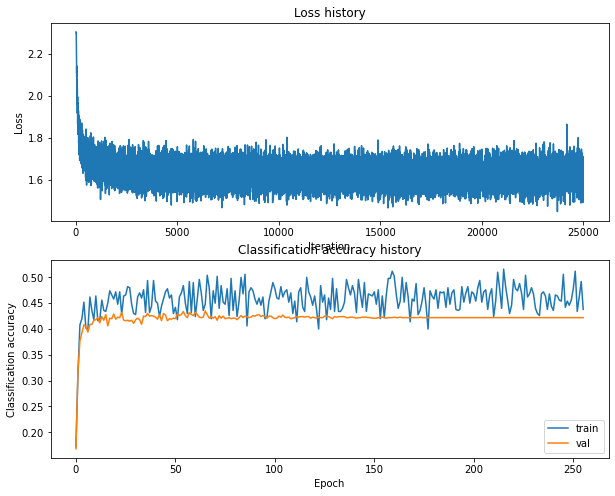

Training network with h_s 175, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.303261
iteration 100 / 500: loss 2.301075
iteration 200 / 500: loss 2.218044
iteration 300 / 500: loss 2.163001
iteration 400 / 500: loss 2.048615
Validation accuracy:  0.247


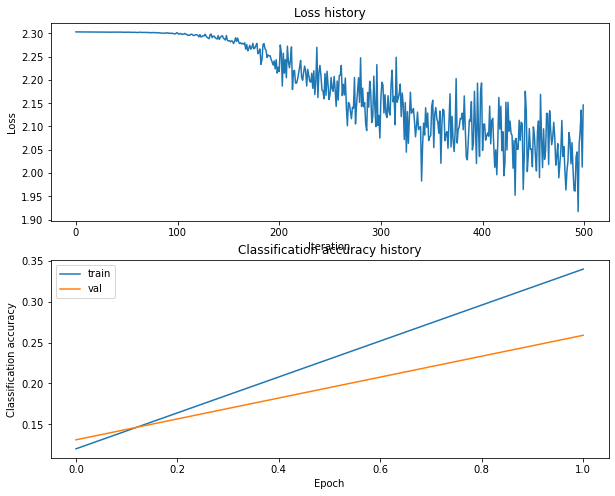

Training network with h_s 175, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.303200
iteration 100 / 500: loss 1.959864
iteration 200 / 500: loss 1.895034
iteration 300 / 500: loss 1.726047
iteration 400 / 500: loss 1.779444
Validation accuracy:  0.394


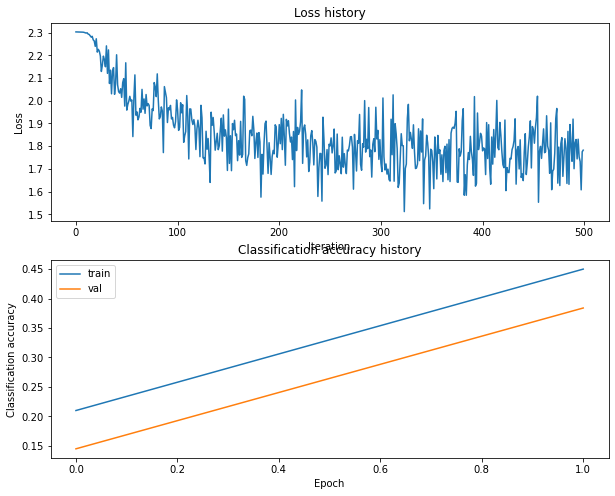

Training network with h_s 175, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.303316
iteration 100 / 500: loss 2.299638
iteration 200 / 500: loss 2.249666
iteration 300 / 500: loss 2.146991
iteration 400 / 500: loss 2.057289
Validation accuracy:  0.261


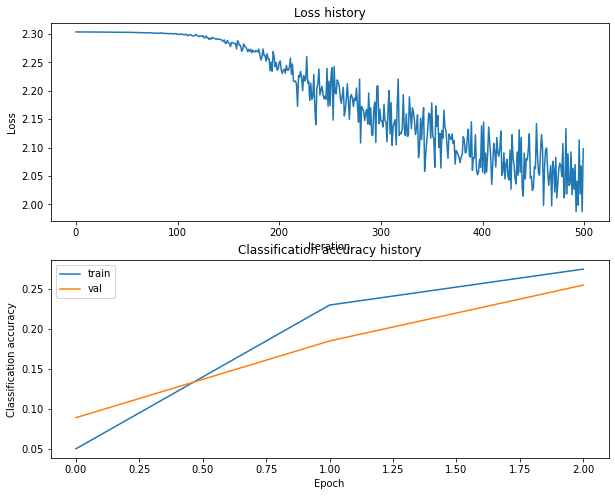

Training network with h_s 175, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.303170
iteration 100 / 500: loss 1.876238
iteration 200 / 500: loss 1.663857
iteration 300 / 500: loss 1.721417
iteration 400 / 500: loss 1.805561
Validation accuracy:  0.393


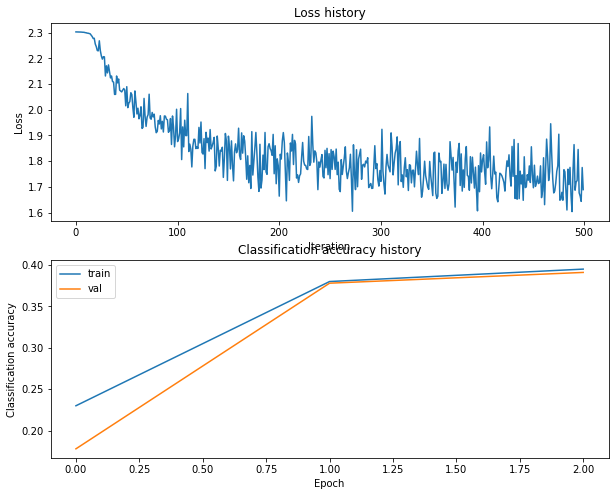

Training network with h_s 175, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.303212
iteration 100 / 500: loss 2.298907
iteration 200 / 500: loss 2.223428
iteration 300 / 500: loss 2.171085
iteration 400 / 500: loss 2.061708
Validation accuracy:  0.257


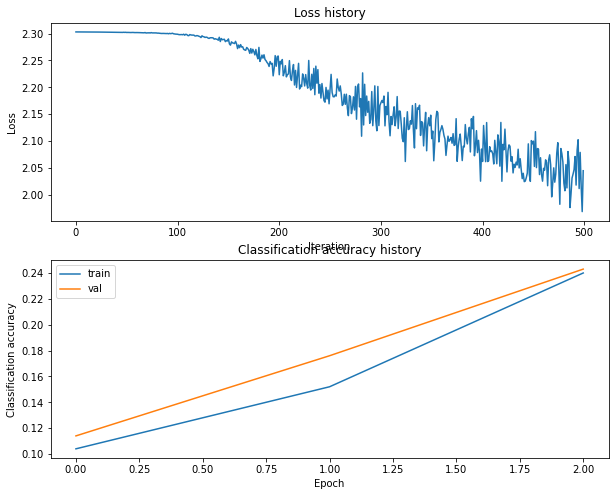

Training network with h_s 175, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.303228
iteration 100 / 500: loss 1.858555
iteration 200 / 500: loss 1.793567
iteration 300 / 500: loss 1.772365
iteration 400 / 500: loss 1.788571
Validation accuracy:  0.401


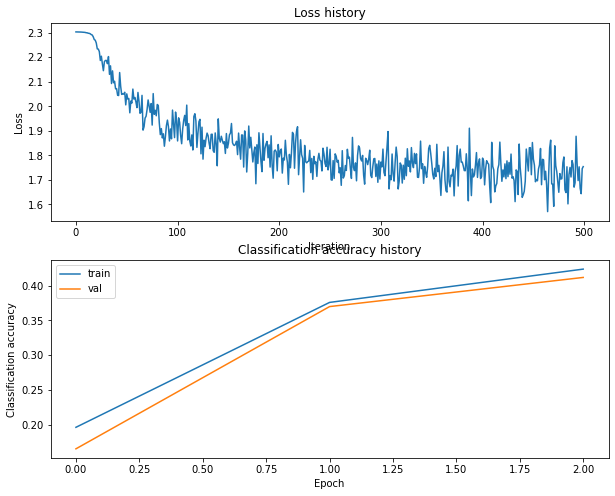

Training network with h_s 175, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.303275
iteration 100 / 500: loss 2.300370
iteration 200 / 500: loss 2.246194
iteration 300 / 500: loss 2.122965
iteration 400 / 500: loss 2.108753
Validation accuracy:  0.26


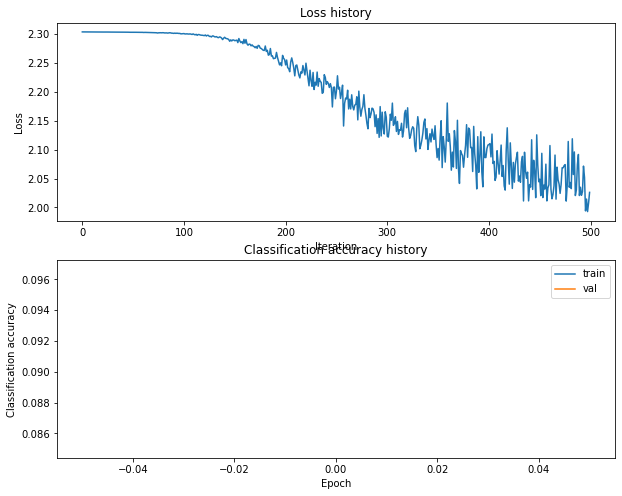

Training network with h_s 175, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.303279
iteration 100 / 500: loss 1.923235
iteration 200 / 500: loss 1.742429
iteration 300 / 500: loss 1.754834
iteration 400 / 500: loss 1.818034
Validation accuracy:  0.396


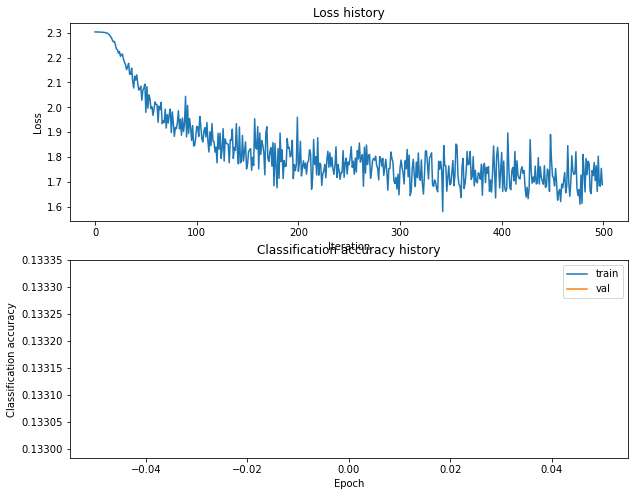

Training network with h_s 175, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.303274
iteration 100 / 500: loss 2.299856
iteration 200 / 500: loss 2.251682
iteration 300 / 500: loss 2.167996
iteration 400 / 500: loss 2.115593
Validation accuracy:  0.249


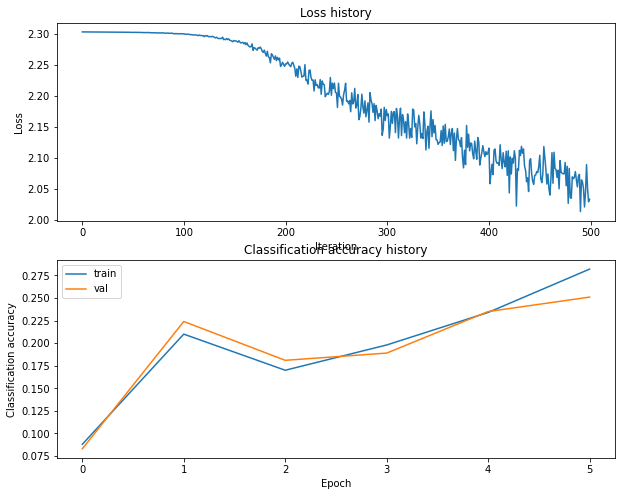

Training network with h_s 175, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.303251
iteration 100 / 500: loss 1.878398
iteration 200 / 500: loss 1.737931
iteration 300 / 500: loss 1.756444
iteration 400 / 500: loss 1.704210
Validation accuracy:  0.397


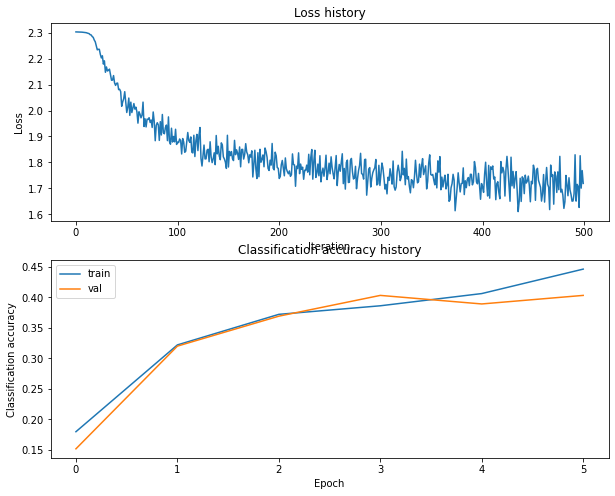

Training network with h_s 175, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.303255
iteration 100 / 1000: loss 2.300003
iteration 200 / 1000: loss 2.264663
iteration 300 / 1000: loss 2.130322
iteration 400 / 1000: loss 1.999353
iteration 500 / 1000: loss 2.086464
iteration 600 / 1000: loss 2.073738
iteration 700 / 1000: loss 1.950112
iteration 800 / 1000: loss 1.910495
iteration 900 / 1000: loss 1.888714
Validation accuracy:  0.331


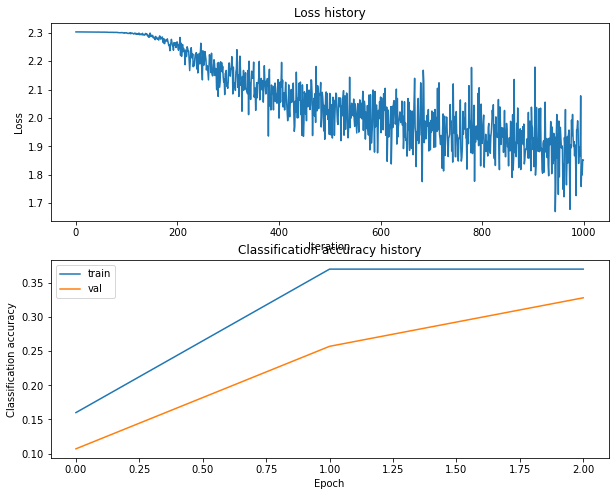

Training network with h_s 175, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.303237
iteration 100 / 1000: loss 1.941521
iteration 200 / 1000: loss 1.863758
iteration 300 / 1000: loss 1.864090
iteration 400 / 1000: loss 1.687680
iteration 500 / 1000: loss 1.661761
iteration 600 / 1000: loss 1.937135
iteration 700 / 1000: loss 1.689946
iteration 800 / 1000: loss 1.704988
iteration 900 / 1000: loss 1.676310
Validation accuracy:  0.388


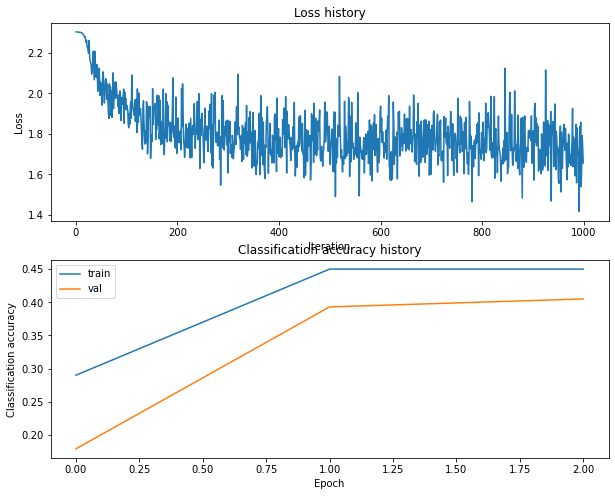

Training network with h_s 175, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.303209
iteration 100 / 1000: loss 2.300058
iteration 200 / 1000: loss 2.237413
iteration 300 / 1000: loss 2.139561
iteration 400 / 1000: loss 2.059171
iteration 500 / 1000: loss 2.036688
iteration 600 / 1000: loss 1.998545
iteration 700 / 1000: loss 1.959580
iteration 800 / 1000: loss 1.916334
iteration 900 / 1000: loss 1.896758
Validation accuracy:  0.324


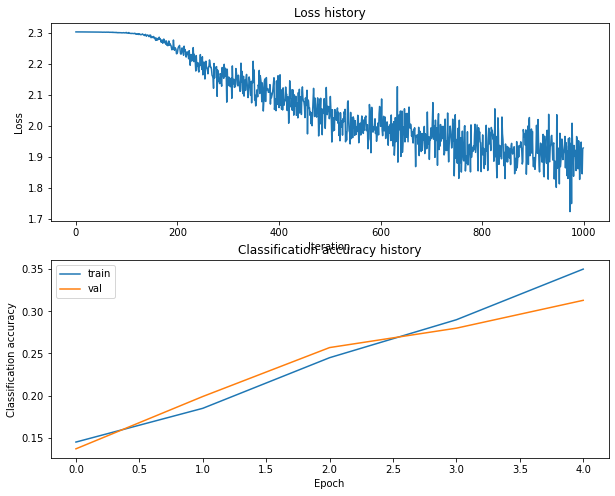

Training network with h_s 175, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.303356
iteration 100 / 1000: loss 2.020331
iteration 200 / 1000: loss 1.810938
iteration 300 / 1000: loss 1.795377
iteration 400 / 1000: loss 1.729276
iteration 500 / 1000: loss 1.760567
iteration 600 / 1000: loss 1.786297
iteration 700 / 1000: loss 1.700496
iteration 800 / 1000: loss 1.778524
iteration 900 / 1000: loss 1.702018
Validation accuracy:  0.41


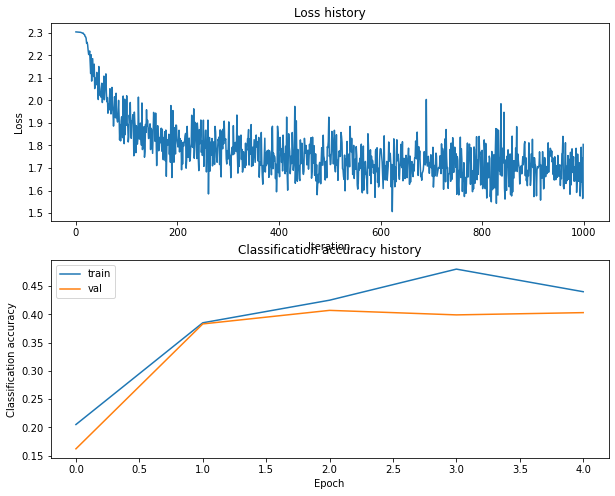

Training network with h_s 175, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.303263
iteration 100 / 1000: loss 2.299967
iteration 200 / 1000: loss 2.255559
iteration 300 / 1000: loss 2.160073
iteration 400 / 1000: loss 2.066219
iteration 500 / 1000: loss 2.049563
iteration 600 / 1000: loss 2.011760
iteration 700 / 1000: loss 2.014710
iteration 800 / 1000: loss 1.950192
iteration 900 / 1000: loss 1.921230
Validation accuracy:  0.308


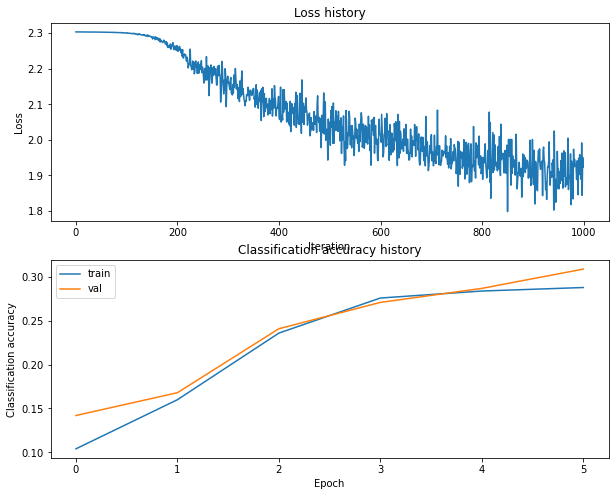

Training network with h_s 175, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.303274
iteration 100 / 1000: loss 1.982445
iteration 200 / 1000: loss 1.777259
iteration 300 / 1000: loss 1.845392
iteration 400 / 1000: loss 1.674537
iteration 500 / 1000: loss 1.700363
iteration 600 / 1000: loss 1.787655
iteration 700 / 1000: loss 1.746425
iteration 800 / 1000: loss 1.657759
iteration 900 / 1000: loss 1.739235
Validation accuracy:  0.404


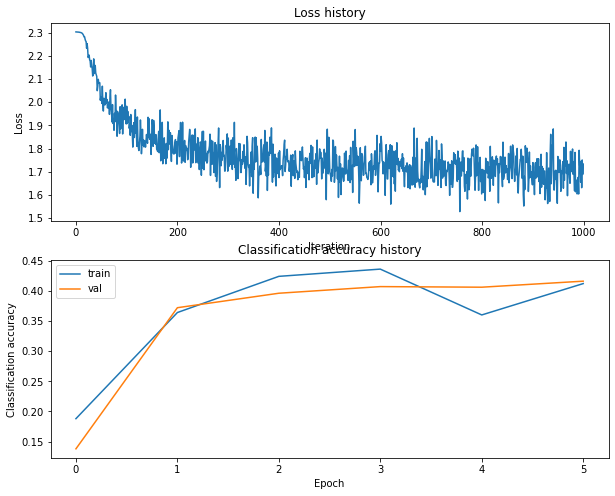

Training network with h_s 175, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.303252
iteration 100 / 1000: loss 2.299753
iteration 200 / 1000: loss 2.235774
iteration 300 / 1000: loss 2.145627
iteration 400 / 1000: loss 2.042883
iteration 500 / 1000: loss 2.012796
iteration 600 / 1000: loss 1.957392
iteration 700 / 1000: loss 1.969677
iteration 800 / 1000: loss 1.896998
iteration 900 / 1000: loss 1.929943
Validation accuracy:  0.325


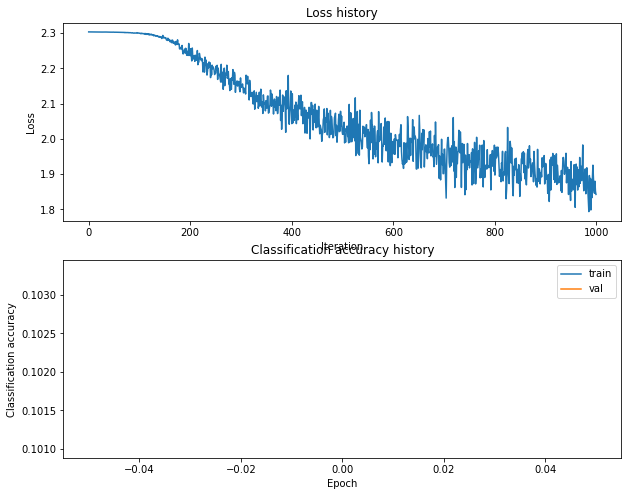

Training network with h_s 175, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.303248
iteration 100 / 1000: loss 1.904410
iteration 200 / 1000: loss 1.711291
iteration 300 / 1000: loss 1.843430
iteration 400 / 1000: loss 1.721753
iteration 500 / 1000: loss 1.721624
iteration 600 / 1000: loss 1.717355
iteration 700 / 1000: loss 1.635267
iteration 800 / 1000: loss 1.712381
iteration 900 / 1000: loss 1.713030
Validation accuracy:  0.397


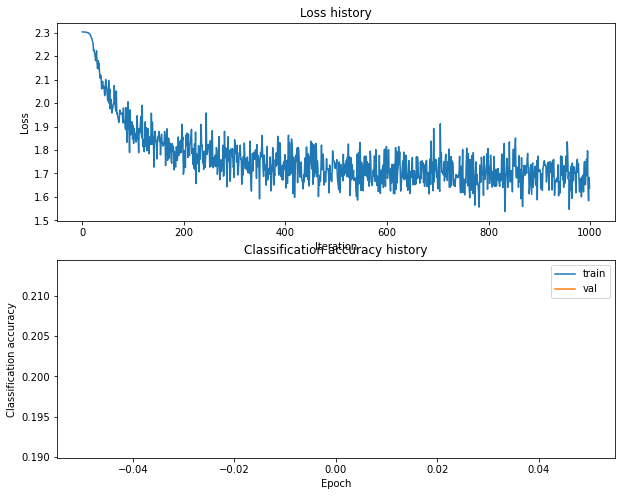

Training network with h_s 175, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.303236
iteration 100 / 1000: loss 2.298461
iteration 200 / 1000: loss 2.255409
iteration 300 / 1000: loss 2.144459
iteration 400 / 1000: loss 2.122518
iteration 500 / 1000: loss 2.030089
iteration 600 / 1000: loss 2.048960
iteration 700 / 1000: loss 2.029531
iteration 800 / 1000: loss 2.012854
iteration 900 / 1000: loss 1.900554
Validation accuracy:  0.301


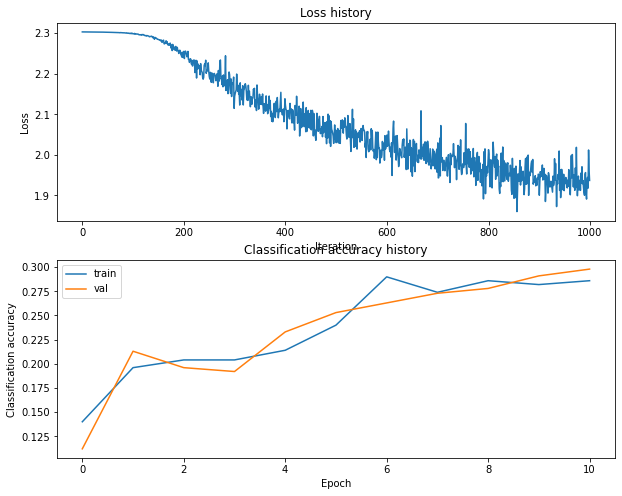

Training network with h_s 175, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.303286
iteration 100 / 1000: loss 1.818900
iteration 200 / 1000: loss 1.780791
iteration 300 / 1000: loss 1.768444
iteration 400 / 1000: loss 1.703299
iteration 500 / 1000: loss 1.748620
iteration 600 / 1000: loss 1.696325
iteration 700 / 1000: loss 1.691395
iteration 800 / 1000: loss 1.698780
iteration 900 / 1000: loss 1.654401
Validation accuracy:  0.406


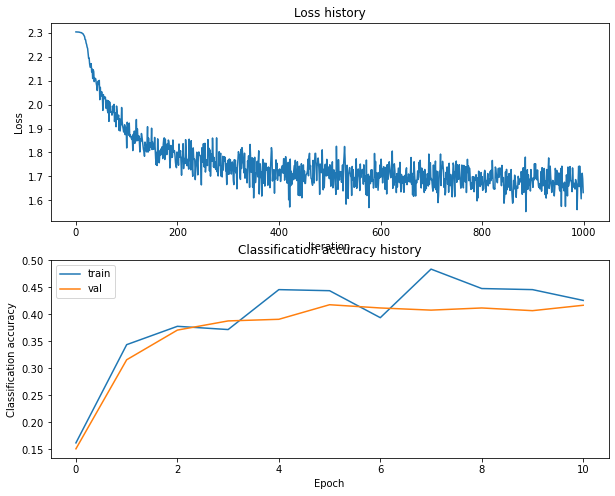

Training network with h_s 175, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.303271
iteration 100 / 1500: loss 2.298674
iteration 200 / 1500: loss 2.247019
iteration 300 / 1500: loss 2.153880
iteration 400 / 1500: loss 2.112518
iteration 500 / 1500: loss 2.061058
iteration 600 / 1500: loss 1.972459
iteration 700 / 1500: loss 1.971475
iteration 800 / 1500: loss 2.015444
iteration 900 / 1500: loss 1.888779
iteration 1000 / 1500: loss 1.964452
iteration 1100 / 1500: loss 1.933447
iteration 1200 / 1500: loss 1.979711
iteration 1300 / 1500: loss 1.789773
iteration 1400 / 1500: loss 1.960827
Validation accuracy:  0.347


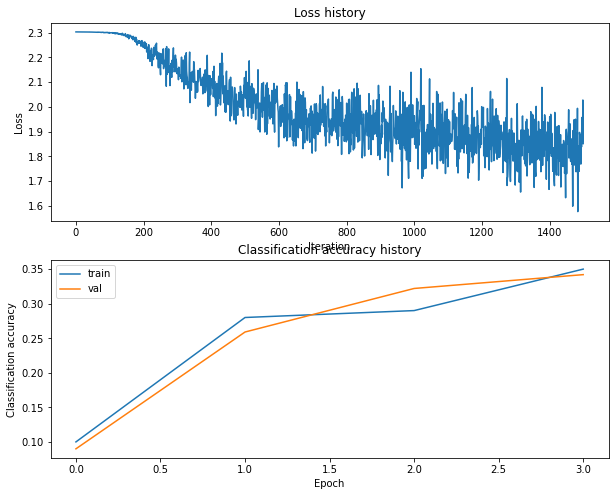

Training network with h_s 175, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.303309
iteration 100 / 1500: loss 1.953883
iteration 200 / 1500: loss 1.841305
iteration 300 / 1500: loss 1.896984
iteration 400 / 1500: loss 1.779028
iteration 500 / 1500: loss 1.671305
iteration 600 / 1500: loss 1.697652
iteration 700 / 1500: loss 1.725364
iteration 800 / 1500: loss 1.863927
iteration 900 / 1500: loss 1.745279
iteration 1000 / 1500: loss 1.692340
iteration 1100 / 1500: loss 1.634572
iteration 1200 / 1500: loss 1.807665
iteration 1300 / 1500: loss 1.543831
iteration 1400 / 1500: loss 1.646188
Validation accuracy:  0.407


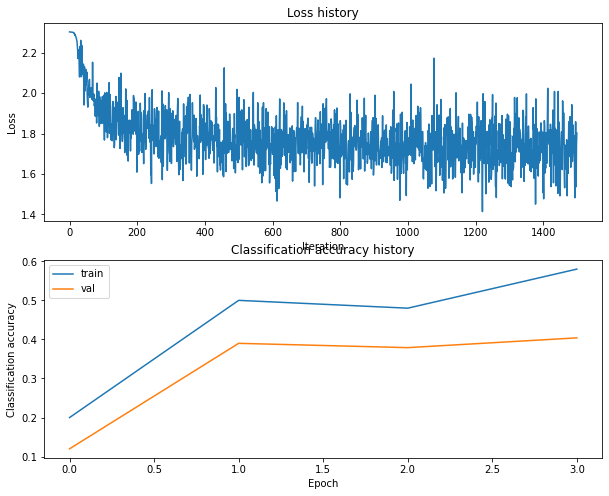

Training network with h_s 175, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.303233
iteration 100 / 1500: loss 2.299677
iteration 200 / 1500: loss 2.218759
iteration 300 / 1500: loss 2.156130
iteration 400 / 1500: loss 2.114112
iteration 500 / 1500: loss 2.017176
iteration 600 / 1500: loss 2.034689
iteration 700 / 1500: loss 1.982538
iteration 800 / 1500: loss 1.992266
iteration 900 / 1500: loss 1.867562
iteration 1000 / 1500: loss 1.904669
iteration 1100 / 1500: loss 1.853947
iteration 1200 / 1500: loss 1.819395
iteration 1300 / 1500: loss 1.968925
iteration 1400 / 1500: loss 1.742004
Validation accuracy:  0.34


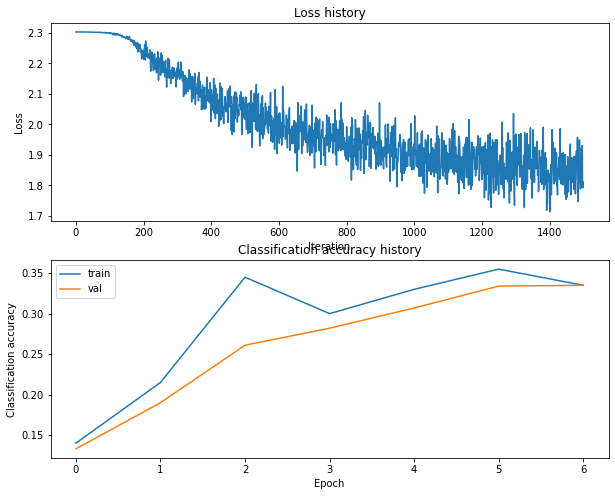

Training network with h_s 175, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.303261
iteration 100 / 1500: loss 1.929914
iteration 200 / 1500: loss 1.818153
iteration 300 / 1500: loss 1.726913
iteration 400 / 1500: loss 1.663352
iteration 500 / 1500: loss 1.802339
iteration 600 / 1500: loss 1.675133
iteration 700 / 1500: loss 1.740990
iteration 800 / 1500: loss 1.655145
iteration 900 / 1500: loss 1.779337
iteration 1000 / 1500: loss 1.671792
iteration 1100 / 1500: loss 1.649784
iteration 1200 / 1500: loss 1.652547
iteration 1300 / 1500: loss 1.697292
iteration 1400 / 1500: loss 1.653983
Validation accuracy:  0.414


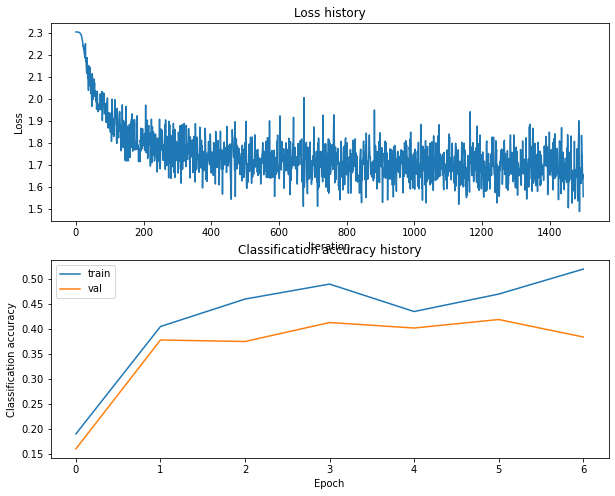

Training network with h_s 175, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.303272
iteration 100 / 1500: loss 2.300374
iteration 200 / 1500: loss 2.251033
iteration 300 / 1500: loss 2.144467
iteration 400 / 1500: loss 2.107043
iteration 500 / 1500: loss 2.095386
iteration 600 / 1500: loss 2.009939
iteration 700 / 1500: loss 1.937806
iteration 800 / 1500: loss 1.956327
iteration 900 / 1500: loss 1.982349
iteration 1000 / 1500: loss 1.877377
iteration 1100 / 1500: loss 1.904655
iteration 1200 / 1500: loss 1.863829
iteration 1300 / 1500: loss 1.811934
iteration 1400 / 1500: loss 1.844709
Validation accuracy:  0.344


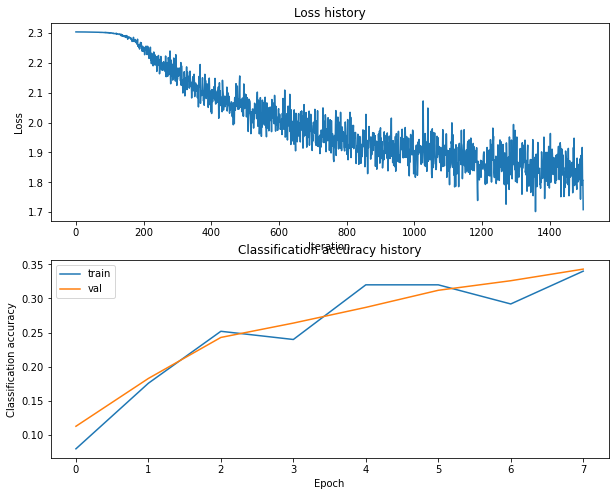

Training network with h_s 175, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.303237
iteration 100 / 1500: loss 1.920694
iteration 200 / 1500: loss 1.779057
iteration 300 / 1500: loss 1.691617
iteration 400 / 1500: loss 1.749275
iteration 500 / 1500: loss 1.708414
iteration 600 / 1500: loss 1.675924
iteration 700 / 1500: loss 1.696482
iteration 800 / 1500: loss 1.702175
iteration 900 / 1500: loss 1.700175
iteration 1000 / 1500: loss 1.714610
iteration 1100 / 1500: loss 1.704703
iteration 1200 / 1500: loss 1.795888
iteration 1300 / 1500: loss 1.681249
iteration 1400 / 1500: loss 1.681418
Validation accuracy:  0.423


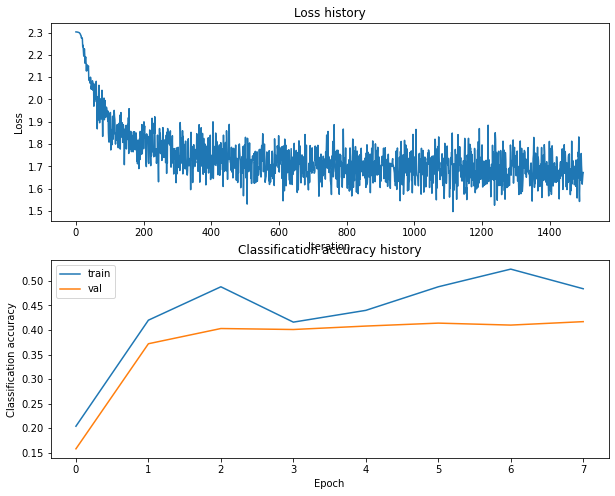

Training network with h_s 175, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.303254
iteration 100 / 1500: loss 2.298843
iteration 200 / 1500: loss 2.228913
iteration 300 / 1500: loss 2.160523
iteration 400 / 1500: loss 2.109956
iteration 500 / 1500: loss 2.094050
iteration 600 / 1500: loss 2.045522
iteration 700 / 1500: loss 1.964941
iteration 800 / 1500: loss 1.939145
iteration 900 / 1500: loss 1.951848
iteration 1000 / 1500: loss 1.898325
iteration 1100 / 1500: loss 1.892435
iteration 1200 / 1500: loss 1.855671
iteration 1300 / 1500: loss 1.836723
iteration 1400 / 1500: loss 1.890573
Validation accuracy:  0.352


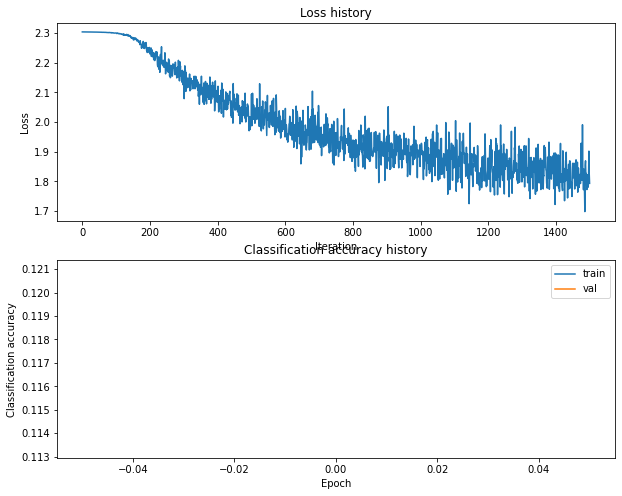

Training network with h_s 175, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.303256
iteration 100 / 1500: loss 2.045348
iteration 200 / 1500: loss 1.834652
iteration 300 / 1500: loss 1.809854
iteration 400 / 1500: loss 1.711774
iteration 500 / 1500: loss 1.771072
iteration 600 / 1500: loss 1.814825
iteration 700 / 1500: loss 1.703288
iteration 800 / 1500: loss 1.651296
iteration 900 / 1500: loss 1.744241
iteration 1000 / 1500: loss 1.706823
iteration 1100 / 1500: loss 1.736776
iteration 1200 / 1500: loss 1.741705
iteration 1300 / 1500: loss 1.629236
iteration 1400 / 1500: loss 1.587542
Validation accuracy:  0.4


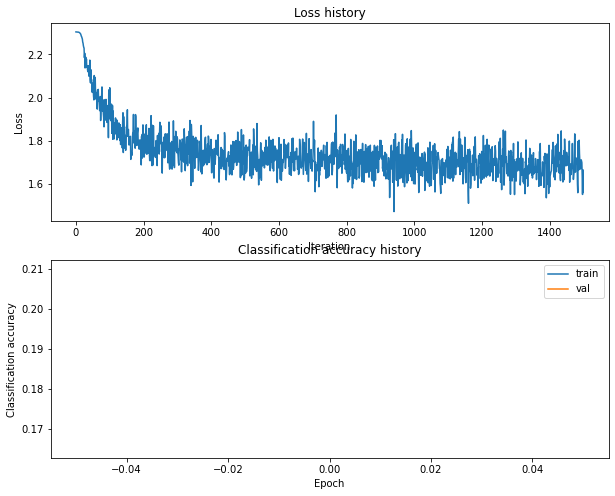

Training network with h_s 175, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.303248
iteration 100 / 1500: loss 2.299214
iteration 200 / 1500: loss 2.239055
iteration 300 / 1500: loss 2.132250
iteration 400 / 1500: loss 2.084496
iteration 500 / 1500: loss 2.090546
iteration 600 / 1500: loss 2.042888
iteration 700 / 1500: loss 1.940710
iteration 800 / 1500: loss 1.947768
iteration 900 / 1500: loss 1.989170
iteration 1000 / 1500: loss 1.933447
iteration 1100 / 1500: loss 1.878039
iteration 1200 / 1500: loss 1.882966
iteration 1300 / 1500: loss 1.922827
iteration 1400 / 1500: loss 1.804907
Validation accuracy:  0.331


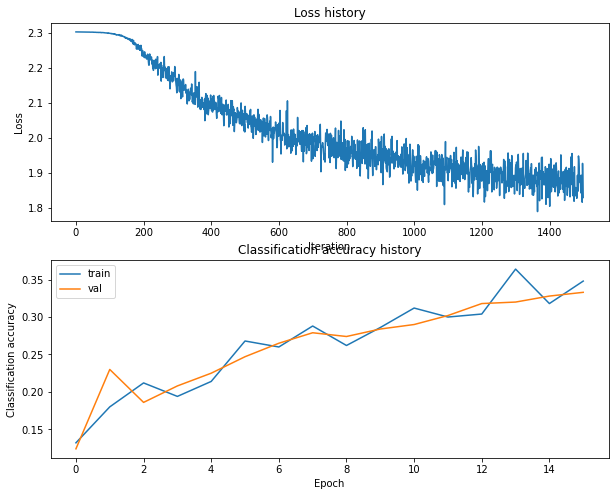

Training network with h_s 175, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.303254
iteration 100 / 1500: loss 1.859906
iteration 200 / 1500: loss 1.787514
iteration 300 / 1500: loss 1.754893
iteration 400 / 1500: loss 1.753914
iteration 500 / 1500: loss 1.676563
iteration 600 / 1500: loss 1.681987
iteration 700 / 1500: loss 1.651144
iteration 800 / 1500: loss 1.695437
iteration 900 / 1500: loss 1.630604
iteration 1000 / 1500: loss 1.632666
iteration 1100 / 1500: loss 1.660771
iteration 1200 / 1500: loss 1.654766
iteration 1300 / 1500: loss 1.643150
iteration 1400 / 1500: loss 1.774794
Validation accuracy:  0.418


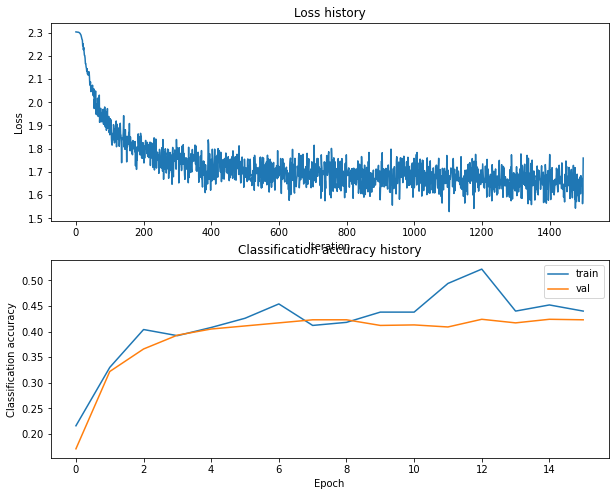

Training network with h_s 175, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.303252
iteration 100 / 2500: loss 2.300006
iteration 200 / 2500: loss 2.231339
iteration 300 / 2500: loss 2.140548
iteration 400 / 2500: loss 2.127808
iteration 500 / 2500: loss 2.137059
iteration 600 / 2500: loss 1.924956
iteration 700 / 2500: loss 1.947968
iteration 800 / 2500: loss 1.861185
iteration 900 / 2500: loss 1.982125
iteration 1000 / 2500: loss 1.870144
iteration 1100 / 2500: loss 1.861656
iteration 1200 / 2500: loss 1.893463
iteration 1300 / 2500: loss 1.880926
iteration 1400 / 2500: loss 1.875430
iteration 1500 / 2500: loss 1.772872
iteration 1600 / 2500: loss 1.931413
iteration 1700 / 2500: loss 1.911949
iteration 1800 / 2500: loss 1.857676
iteration 1900 / 2500: loss 1.911126
iteration 2000 / 2500: loss 1.902866
iteration 2100 / 2500: loss 1.824085
iteration 2200 / 2500: loss 1.692579
iteration 2300 / 2500: loss 1.938083
iteration 2400 / 2500: loss 1.684893
Validation accuracy:  0.38

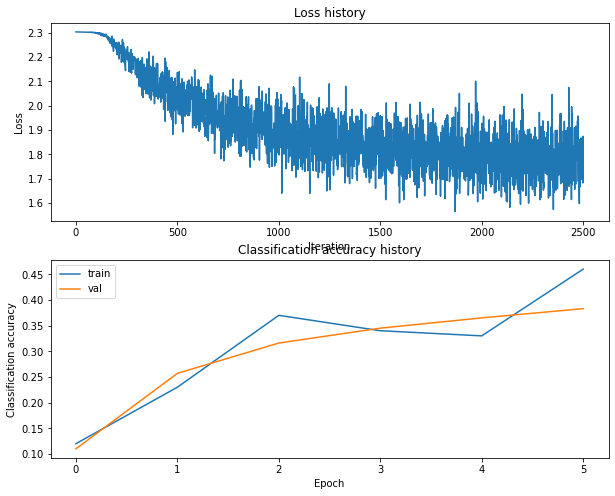

Training network with h_s 175, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.303239
iteration 100 / 2500: loss 1.900413
iteration 200 / 2500: loss 1.901504
iteration 300 / 2500: loss 1.692452
iteration 400 / 2500: loss 1.901333
iteration 500 / 2500: loss 1.620730
iteration 600 / 2500: loss 1.659242
iteration 700 / 2500: loss 1.578073
iteration 800 / 2500: loss 1.643336
iteration 900 / 2500: loss 1.747744
iteration 1000 / 2500: loss 1.565765
iteration 1100 / 2500: loss 1.914407
iteration 1200 / 2500: loss 1.672970
iteration 1300 / 2500: loss 1.776463
iteration 1400 / 2500: loss 1.577893
iteration 1500 / 2500: loss 1.739479
iteration 1600 / 2500: loss 1.733400
iteration 1700 / 2500: loss 1.701572
iteration 1800 / 2500: loss 1.705463
iteration 1900 / 2500: loss 1.787135
iteration 2000 / 2500: loss 1.597361
iteration 2100 / 2500: loss 1.893258
iteration 2200 / 2500: loss 1.619384
iteration 2300 / 2500: loss 1.605905
iteration 2400 / 2500: loss 1.818457
Validation accuracy:  0.394

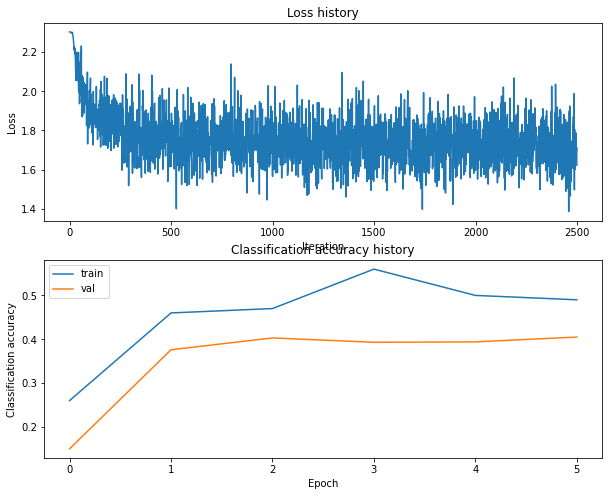

Training network with h_s 175, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.303255
iteration 100 / 2500: loss 2.298933
iteration 200 / 2500: loss 2.233348
iteration 300 / 2500: loss 2.189215
iteration 400 / 2500: loss 2.101827
iteration 500 / 2500: loss 2.076396
iteration 600 / 2500: loss 1.967186
iteration 700 / 2500: loss 1.964591
iteration 800 / 2500: loss 1.973296
iteration 900 / 2500: loss 1.936895
iteration 1000 / 2500: loss 1.777669
iteration 1100 / 2500: loss 1.888151
iteration 1200 / 2500: loss 1.891173
iteration 1300 / 2500: loss 1.828687
iteration 1400 / 2500: loss 1.794401
iteration 1500 / 2500: loss 1.842925
iteration 1600 / 2500: loss 1.776238
iteration 1700 / 2500: loss 1.765650
iteration 1800 / 2500: loss 1.867367
iteration 1900 / 2500: loss 1.723507
iteration 2000 / 2500: loss 1.863588
iteration 2100 / 2500: loss 1.842910
iteration 2200 / 2500: loss 1.848630
iteration 2300 / 2500: loss 1.769815
iteration 2400 / 2500: loss 1.826857
Validation accuracy:  0.38

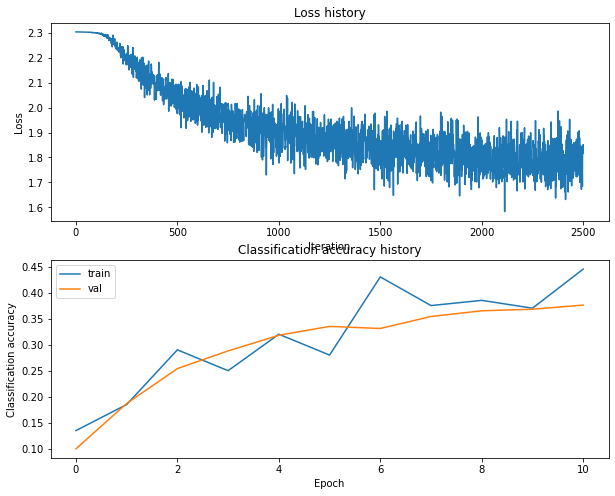

Training network with h_s 175, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.303310
iteration 100 / 2500: loss 1.940208
iteration 200 / 2500: loss 1.858154
iteration 300 / 2500: loss 1.662506
iteration 400 / 2500: loss 1.713548
iteration 500 / 2500: loss 1.725059
iteration 600 / 2500: loss 1.736975
iteration 700 / 2500: loss 1.782394
iteration 800 / 2500: loss 1.683200
iteration 900 / 2500: loss 1.716466
iteration 1000 / 2500: loss 1.665053
iteration 1100 / 2500: loss 1.639464
iteration 1200 / 2500: loss 1.695043
iteration 1300 / 2500: loss 1.645036
iteration 1400 / 2500: loss 1.679577
iteration 1500 / 2500: loss 1.771117
iteration 1600 / 2500: loss 1.696308
iteration 1700 / 2500: loss 1.725947
iteration 1800 / 2500: loss 1.758198
iteration 1900 / 2500: loss 1.757648
iteration 2000 / 2500: loss 1.666998
iteration 2100 / 2500: loss 1.724913
iteration 2200 / 2500: loss 1.632407
iteration 2300 / 2500: loss 1.715902
iteration 2400 / 2500: loss 1.553029
Validation accuracy:  0.414

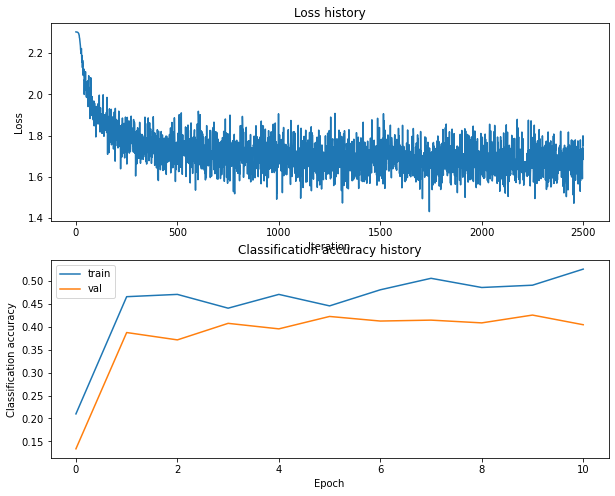

Training network with h_s 175, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.303237
iteration 100 / 2500: loss 2.299155
iteration 200 / 2500: loss 2.242044
iteration 300 / 2500: loss 2.149911
iteration 400 / 2500: loss 2.086572
iteration 500 / 2500: loss 1.965992
iteration 600 / 2500: loss 1.925458
iteration 700 / 2500: loss 2.050407
iteration 800 / 2500: loss 1.929918
iteration 900 / 2500: loss 1.996159
iteration 1000 / 2500: loss 1.907905
iteration 1100 / 2500: loss 1.894963
iteration 1200 / 2500: loss 1.910556
iteration 1300 / 2500: loss 1.804873
iteration 1400 / 2500: loss 1.808910
iteration 1500 / 2500: loss 1.846564
iteration 1600 / 2500: loss 1.882632
iteration 1700 / 2500: loss 1.755585
iteration 1800 / 2500: loss 1.841133
iteration 1900 / 2500: loss 1.740576
iteration 2000 / 2500: loss 1.786996
iteration 2100 / 2500: loss 1.766177
iteration 2200 / 2500: loss 1.770501
iteration 2300 / 2500: loss 1.785943
iteration 2400 / 2500: loss 1.793190
Validation accuracy:  0.37

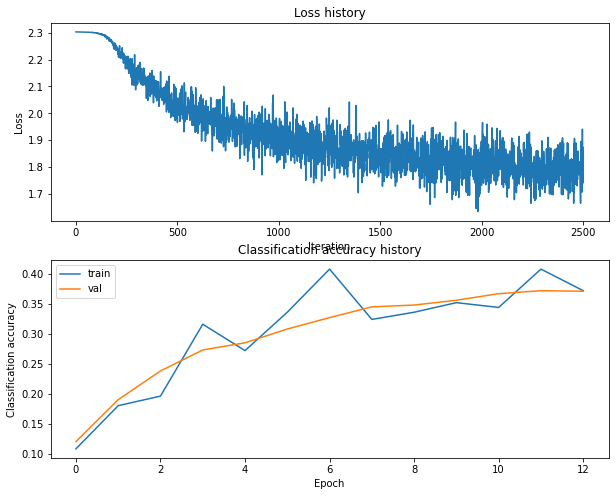

Training network with h_s 175, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.303263
iteration 100 / 2500: loss 1.864185
iteration 200 / 2500: loss 1.782907
iteration 300 / 2500: loss 1.811097
iteration 400 / 2500: loss 1.669195
iteration 500 / 2500: loss 1.631052
iteration 600 / 2500: loss 1.755540
iteration 700 / 2500: loss 1.707598
iteration 800 / 2500: loss 1.689991
iteration 900 / 2500: loss 1.653245
iteration 1000 / 2500: loss 1.579175
iteration 1100 / 2500: loss 1.650428
iteration 1200 / 2500: loss 1.611778
iteration 1300 / 2500: loss 1.736663
iteration 1400 / 2500: loss 1.730482
iteration 1500 / 2500: loss 1.618670
iteration 1600 / 2500: loss 1.735164
iteration 1700 / 2500: loss 1.595242
iteration 1800 / 2500: loss 1.708070
iteration 1900 / 2500: loss 1.695393
iteration 2000 / 2500: loss 1.682648
iteration 2100 / 2500: loss 1.700386
iteration 2200 / 2500: loss 1.679316
iteration 2300 / 2500: loss 1.666297
iteration 2400 / 2500: loss 1.592649
Validation accuracy:  0.406

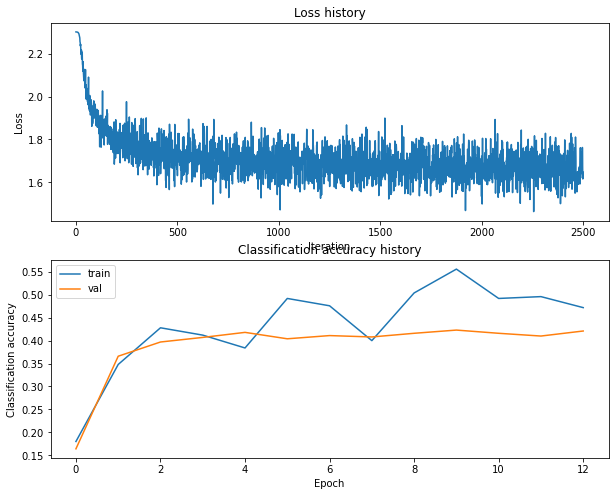

Training network with h_s 175, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.303297
iteration 100 / 2500: loss 2.299629
iteration 200 / 2500: loss 2.238707
iteration 300 / 2500: loss 2.124884
iteration 400 / 2500: loss 2.104432
iteration 500 / 2500: loss 2.043997
iteration 600 / 2500: loss 2.011314
iteration 700 / 2500: loss 1.983108
iteration 800 / 2500: loss 1.923129
iteration 900 / 2500: loss 1.924310
iteration 1000 / 2500: loss 1.888928
iteration 1100 / 2500: loss 1.876280
iteration 1200 / 2500: loss 1.829598
iteration 1300 / 2500: loss 1.891882
iteration 1400 / 2500: loss 1.775917
iteration 1500 / 2500: loss 1.857174
iteration 1600 / 2500: loss 1.652408
iteration 1700 / 2500: loss 1.809647
iteration 1800 / 2500: loss 1.737610
iteration 1900 / 2500: loss 1.717444
iteration 2000 / 2500: loss 1.682630
iteration 2100 / 2500: loss 1.801577
iteration 2200 / 2500: loss 1.841369
iteration 2300 / 2500: loss 1.810844
iteration 2400 / 2500: loss 1.784755
Validation accuracy:  0.39

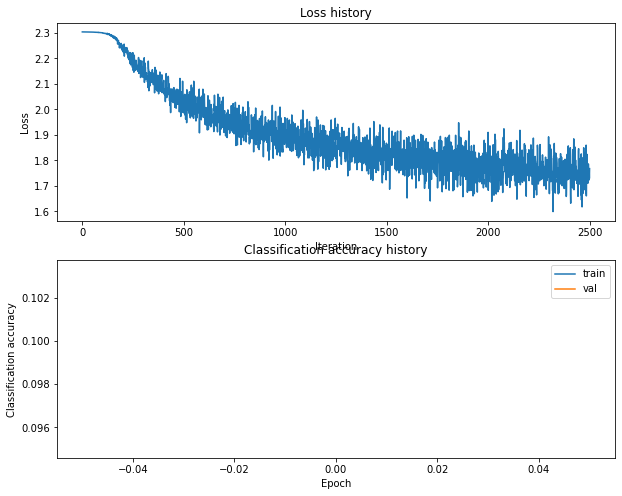

Training network with h_s 175, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.303277
iteration 100 / 2500: loss 1.909619
iteration 200 / 2500: loss 1.813855
iteration 300 / 2500: loss 1.690629
iteration 400 / 2500: loss 1.833931
iteration 500 / 2500: loss 1.642621
iteration 600 / 2500: loss 1.693866
iteration 700 / 2500: loss 1.689694
iteration 800 / 2500: loss 1.644067
iteration 900 / 2500: loss 1.761750
iteration 1000 / 2500: loss 1.791798
iteration 1100 / 2500: loss 1.719646
iteration 1200 / 2500: loss 1.652661
iteration 1300 / 2500: loss 1.730261
iteration 1400 / 2500: loss 1.571062
iteration 1500 / 2500: loss 1.709842
iteration 1600 / 2500: loss 1.734141
iteration 1700 / 2500: loss 1.732858
iteration 1800 / 2500: loss 1.703288
iteration 1900 / 2500: loss 1.638393
iteration 2000 / 2500: loss 1.686849
iteration 2100 / 2500: loss 1.755210
iteration 2200 / 2500: loss 1.734525
iteration 2300 / 2500: loss 1.710856
iteration 2400 / 2500: loss 1.634286
Validation accuracy:  0.415

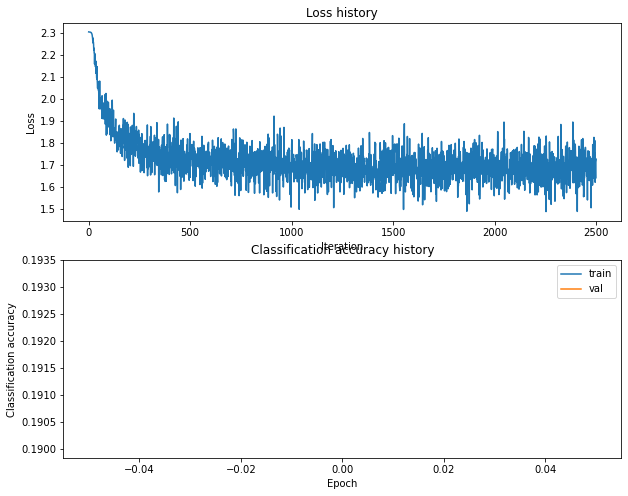

Training network with h_s 175, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.303220
iteration 100 / 2500: loss 2.299282
iteration 200 / 2500: loss 2.237915
iteration 300 / 2500: loss 2.165876
iteration 400 / 2500: loss 2.120086
iteration 500 / 2500: loss 2.001344
iteration 600 / 2500: loss 2.031993
iteration 700 / 2500: loss 1.998252
iteration 800 / 2500: loss 1.988912
iteration 900 / 2500: loss 1.935917
iteration 1000 / 2500: loss 1.932275
iteration 1100 / 2500: loss 1.960558
iteration 1200 / 2500: loss 1.907556
iteration 1300 / 2500: loss 1.909696
iteration 1400 / 2500: loss 1.889131
iteration 1500 / 2500: loss 1.829399
iteration 1600 / 2500: loss 1.781016
iteration 1700 / 2500: loss 1.854948
iteration 1800 / 2500: loss 1.806568
iteration 1900 / 2500: loss 1.834448
iteration 2000 / 2500: loss 1.810567
iteration 2100 / 2500: loss 1.853246
iteration 2200 / 2500: loss 1.808772
iteration 2300 / 2500: loss 1.862718
iteration 2400 / 2500: loss 1.808198
Validation accuracy:  0.35

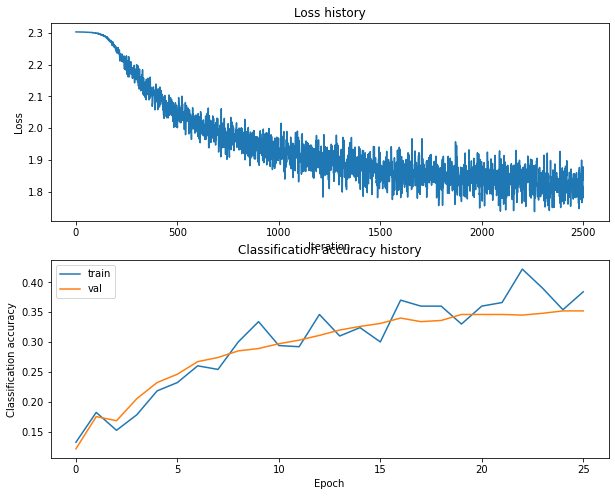

Training network with h_s 175, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.303255
iteration 100 / 2500: loss 1.913583
iteration 200 / 2500: loss 1.856019
iteration 300 / 2500: loss 1.709271
iteration 400 / 2500: loss 1.655688
iteration 500 / 2500: loss 1.719498
iteration 600 / 2500: loss 1.678271
iteration 700 / 2500: loss 1.637843
iteration 800 / 2500: loss 1.648208
iteration 900 / 2500: loss 1.646049
iteration 1000 / 2500: loss 1.721589
iteration 1100 / 2500: loss 1.605800
iteration 1200 / 2500: loss 1.715982
iteration 1300 / 2500: loss 1.761948
iteration 1400 / 2500: loss 1.630362
iteration 1500 / 2500: loss 1.673054
iteration 1600 / 2500: loss 1.667458
iteration 1700 / 2500: loss 1.640261
iteration 1800 / 2500: loss 1.652771
iteration 1900 / 2500: loss 1.666973
iteration 2000 / 2500: loss 1.599927
iteration 2100 / 2500: loss 1.646407
iteration 2200 / 2500: loss 1.672665
iteration 2300 / 2500: loss 1.613344
iteration 2400 / 2500: loss 1.671127
Validation accuracy:  0.423

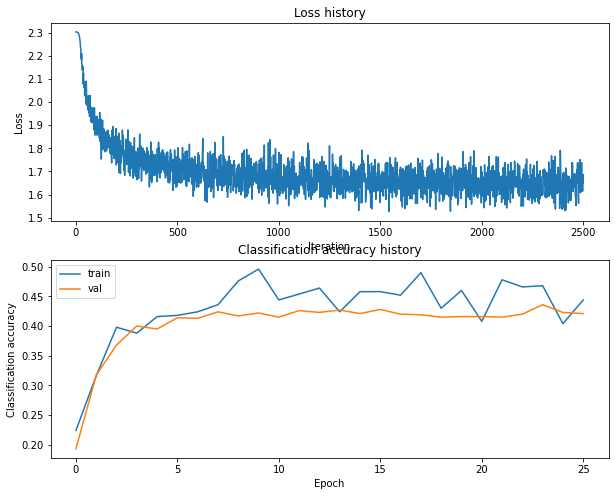

Training network with h_s 175, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.303256
iteration 100 / 5000: loss 2.300141
iteration 200 / 5000: loss 2.244188
iteration 300 / 5000: loss 2.177577
iteration 400 / 5000: loss 2.180696
iteration 500 / 5000: loss 2.068815
iteration 600 / 5000: loss 1.995879
iteration 700 / 5000: loss 2.016426
iteration 800 / 5000: loss 1.902058
iteration 900 / 5000: loss 1.998540
iteration 1000 / 5000: loss 1.857839
iteration 1100 / 5000: loss 1.929103
iteration 1200 / 5000: loss 1.841747
iteration 1300 / 5000: loss 1.906095
iteration 1400 / 5000: loss 1.837000
iteration 1500 / 5000: loss 1.909265
iteration 1600 / 5000: loss 1.911751
iteration 1700 / 5000: loss 1.865048
iteration 1800 / 5000: loss 1.775882
iteration 1900 / 5000: loss 1.795509
iteration 2000 / 5000: loss 1.885223
iteration 2100 / 5000: loss 1.675976
iteration 2200 / 5000: loss 1.662851
iteration 2300 / 5000: loss 1.796492
iteration 2400 / 5000: loss 1.939360
iteration 2500 / 5000: los

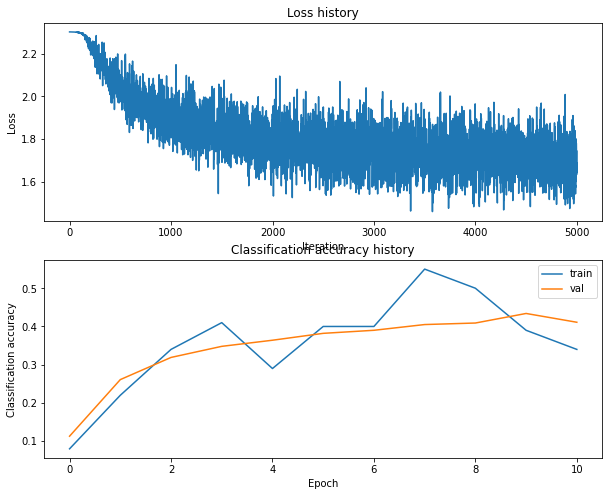

Training network with h_s 175, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.303248
iteration 100 / 5000: loss 1.795367
iteration 200 / 5000: loss 1.850004
iteration 300 / 5000: loss 1.837183
iteration 400 / 5000: loss 1.558979
iteration 500 / 5000: loss 1.730405
iteration 600 / 5000: loss 1.831489
iteration 700 / 5000: loss 1.682851
iteration 800 / 5000: loss 1.892488
iteration 900 / 5000: loss 1.580106
iteration 1000 / 5000: loss 1.790576
iteration 1100 / 5000: loss 1.923607
iteration 1200 / 5000: loss 1.702230
iteration 1300 / 5000: loss 1.771761
iteration 1400 / 5000: loss 1.526817
iteration 1500 / 5000: loss 1.850494
iteration 1600 / 5000: loss 1.708644
iteration 1700 / 5000: loss 1.719046
iteration 1800 / 5000: loss 1.653689
iteration 1900 / 5000: loss 1.813121
iteration 2000 / 5000: loss 1.595948
iteration 2100 / 5000: loss 1.803373
iteration 2200 / 5000: loss 1.601044
iteration 2300 / 5000: loss 1.733898
iteration 2400 / 5000: loss 1.745185
iteration 2500 / 5000: loss

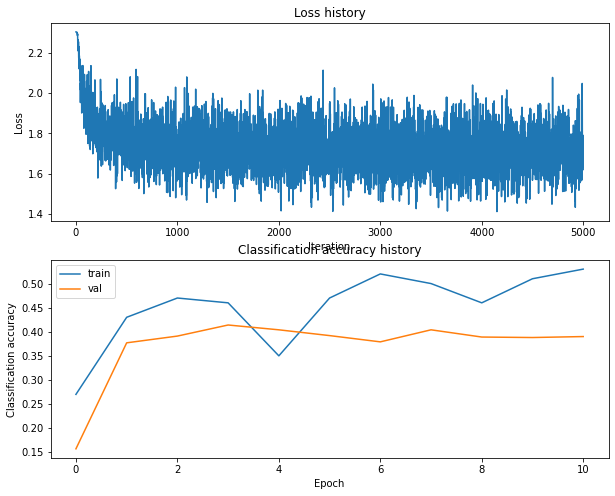

Training network with h_s 175, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.303284
iteration 100 / 5000: loss 2.299478
iteration 200 / 5000: loss 2.259870
iteration 300 / 5000: loss 2.176335
iteration 400 / 5000: loss 2.077902
iteration 500 / 5000: loss 2.078558
iteration 600 / 5000: loss 2.015494
iteration 700 / 5000: loss 2.049073
iteration 800 / 5000: loss 1.991420
iteration 900 / 5000: loss 1.926249
iteration 1000 / 5000: loss 1.815908
iteration 1100 / 5000: loss 1.903654
iteration 1200 / 5000: loss 1.838234
iteration 1300 / 5000: loss 1.848156
iteration 1400 / 5000: loss 1.820024
iteration 1500 / 5000: loss 1.832567
iteration 1600 / 5000: loss 1.841449
iteration 1700 / 5000: loss 1.790827
iteration 1800 / 5000: loss 1.826001
iteration 1900 / 5000: loss 1.889740
iteration 2000 / 5000: loss 1.783121
iteration 2100 / 5000: loss 1.846343
iteration 2200 / 5000: loss 1.772811
iteration 2300 / 5000: loss 1.706709
iteration 2400 / 5000: loss 1.763969
iteration 2500 / 5000: los

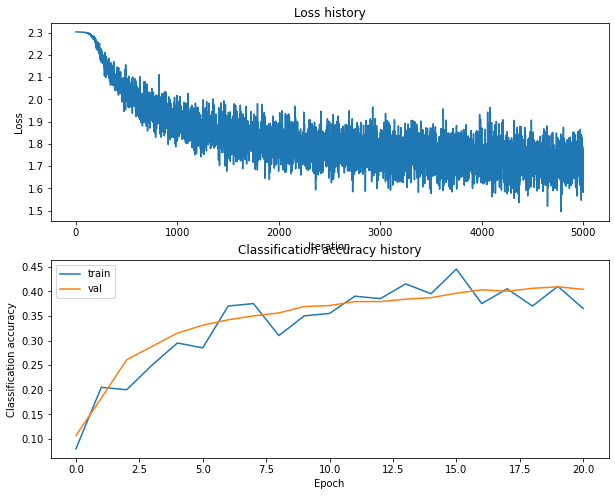

Training network with h_s 175, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.303271
iteration 100 / 5000: loss 1.862366
iteration 200 / 5000: loss 1.833168
iteration 300 / 5000: loss 1.811768
iteration 400 / 5000: loss 1.899310
iteration 500 / 5000: loss 1.758583
iteration 600 / 5000: loss 1.793753
iteration 700 / 5000: loss 1.768602
iteration 800 / 5000: loss 1.656229
iteration 900 / 5000: loss 1.675108
iteration 1000 / 5000: loss 1.721592
iteration 1100 / 5000: loss 1.532319
iteration 1200 / 5000: loss 1.646017
iteration 1300 / 5000: loss 1.595252
iteration 1400 / 5000: loss 1.742761
iteration 1500 / 5000: loss 1.659368
iteration 1600 / 5000: loss 1.678724
iteration 1700 / 5000: loss 1.661195
iteration 1800 / 5000: loss 1.597763
iteration 1900 / 5000: loss 1.616870
iteration 2000 / 5000: loss 1.661356
iteration 2100 / 5000: loss 1.649548
iteration 2200 / 5000: loss 1.602432
iteration 2300 / 5000: loss 1.730346
iteration 2400 / 5000: loss 1.555826
iteration 2500 / 5000: loss

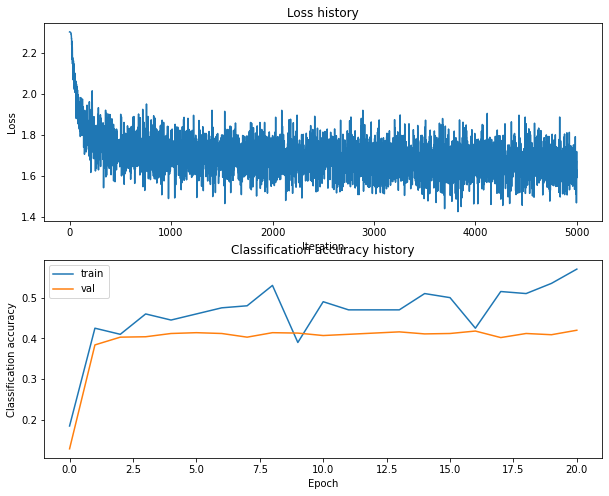

Training network with h_s 175, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.303244
iteration 100 / 5000: loss 2.299104
iteration 200 / 5000: loss 2.240667
iteration 300 / 5000: loss 2.171459
iteration 400 / 5000: loss 2.056662
iteration 500 / 5000: loss 2.013564
iteration 600 / 5000: loss 1.965420
iteration 700 / 5000: loss 1.863120
iteration 800 / 5000: loss 1.956846
iteration 900 / 5000: loss 1.928580
iteration 1000 / 5000: loss 1.917600
iteration 1100 / 5000: loss 1.894167
iteration 1200 / 5000: loss 1.956202
iteration 1300 / 5000: loss 1.838548
iteration 1400 / 5000: loss 1.778719
iteration 1500 / 5000: loss 1.887138
iteration 1600 / 5000: loss 1.773452
iteration 1700 / 5000: loss 1.876983
iteration 1800 / 5000: loss 1.804067
iteration 1900 / 5000: loss 1.787918
iteration 2000 / 5000: loss 1.827034
iteration 2100 / 5000: loss 1.829452
iteration 2200 / 5000: loss 1.781379
iteration 2300 / 5000: loss 1.731582
iteration 2400 / 5000: loss 1.812585
iteration 2500 / 5000: los

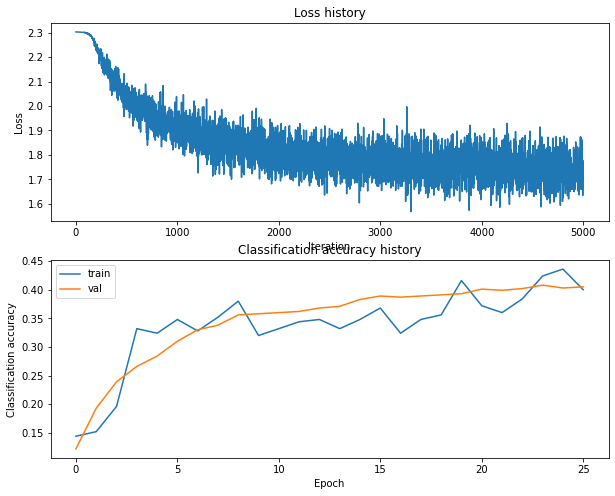

Training network with h_s 175, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.303278
iteration 100 / 5000: loss 1.950543
iteration 200 / 5000: loss 1.837566
iteration 300 / 5000: loss 1.663678
iteration 400 / 5000: loss 1.598163
iteration 500 / 5000: loss 1.688374
iteration 600 / 5000: loss 1.856909
iteration 700 / 5000: loss 1.696019
iteration 800 / 5000: loss 1.744145
iteration 900 / 5000: loss 1.625774
iteration 1000 / 5000: loss 1.687125
iteration 1100 / 5000: loss 1.802791
iteration 1200 / 5000: loss 1.706435
iteration 1300 / 5000: loss 1.659577
iteration 1400 / 5000: loss 1.639370
iteration 1500 / 5000: loss 1.609355
iteration 1600 / 5000: loss 1.779364
iteration 1700 / 5000: loss 1.691859
iteration 1800 / 5000: loss 1.663991
iteration 1900 / 5000: loss 1.700627
iteration 2000 / 5000: loss 1.672635
iteration 2100 / 5000: loss 1.616049
iteration 2200 / 5000: loss 1.614392
iteration 2300 / 5000: loss 1.628230
iteration 2400 / 5000: loss 1.644582
iteration 2500 / 5000: loss

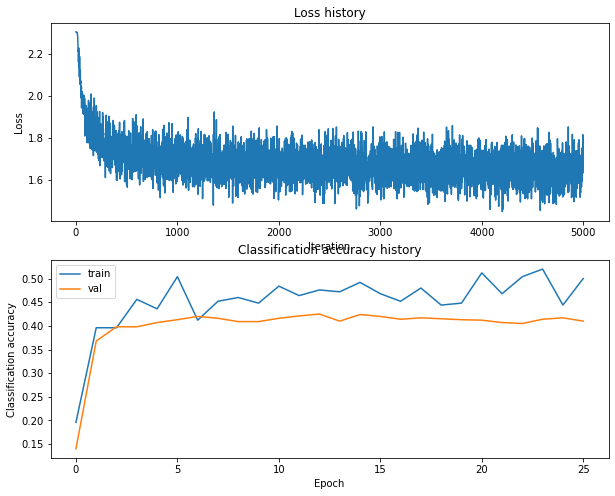

Training network with h_s 175, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.303242
iteration 100 / 5000: loss 2.299699
iteration 200 / 5000: loss 2.240550
iteration 300 / 5000: loss 2.199826
iteration 400 / 5000: loss 2.087537
iteration 500 / 5000: loss 2.018416
iteration 600 / 5000: loss 1.998471
iteration 700 / 5000: loss 1.983691
iteration 800 / 5000: loss 1.932434
iteration 900 / 5000: loss 1.913828
iteration 1000 / 5000: loss 1.926980
iteration 1100 / 5000: loss 1.823283
iteration 1200 / 5000: loss 1.829274
iteration 1300 / 5000: loss 1.866928
iteration 1400 / 5000: loss 1.768826
iteration 1500 / 5000: loss 1.773827
iteration 1600 / 5000: loss 1.831340
iteration 1700 / 5000: loss 1.773165
iteration 1800 / 5000: loss 1.753738
iteration 1900 / 5000: loss 1.752665
iteration 2000 / 5000: loss 1.734993
iteration 2100 / 5000: loss 1.764490
iteration 2200 / 5000: loss 1.675681
iteration 2300 / 5000: loss 1.809474
iteration 2400 / 5000: loss 1.741448
iteration 2500 / 5000: los

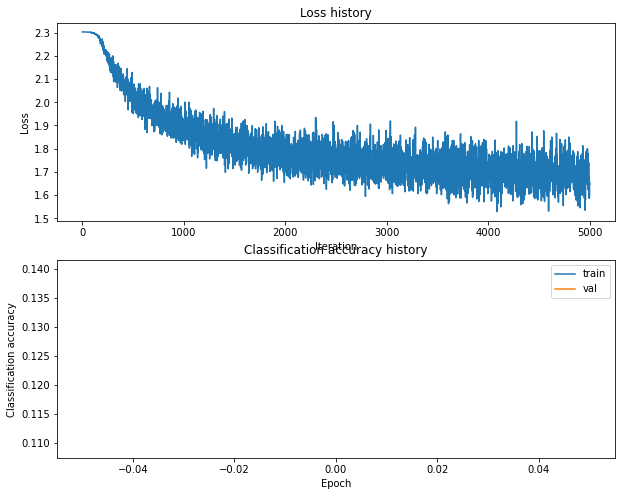

Training network with h_s 175, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.303207
iteration 100 / 5000: loss 1.895470
iteration 200 / 5000: loss 1.834379
iteration 300 / 5000: loss 1.728822
iteration 400 / 5000: loss 1.719508
iteration 500 / 5000: loss 1.701174
iteration 600 / 5000: loss 1.743936
iteration 700 / 5000: loss 1.691843
iteration 800 / 5000: loss 1.720307
iteration 900 / 5000: loss 1.655558
iteration 1000 / 5000: loss 1.617039
iteration 1100 / 5000: loss 1.707584
iteration 1200 / 5000: loss 1.631290
iteration 1300 / 5000: loss 1.690792
iteration 1400 / 5000: loss 1.627392
iteration 1500 / 5000: loss 1.678270
iteration 1600 / 5000: loss 1.552530
iteration 1700 / 5000: loss 1.611555
iteration 1800 / 5000: loss 1.728975
iteration 1900 / 5000: loss 1.704610
iteration 2000 / 5000: loss 1.692272
iteration 2100 / 5000: loss 1.695045
iteration 2200 / 5000: loss 1.738380
iteration 2300 / 5000: loss 1.652023
iteration 2400 / 5000: loss 1.710620
iteration 2500 / 5000: loss

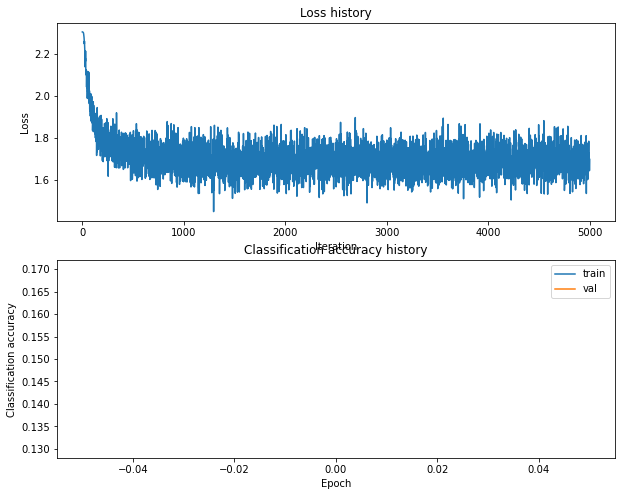

Training network with h_s 175, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.303267
iteration 100 / 5000: loss 2.299480
iteration 200 / 5000: loss 2.254601
iteration 300 / 5000: loss 2.159288
iteration 400 / 5000: loss 2.111460
iteration 500 / 5000: loss 2.040433
iteration 600 / 5000: loss 2.017510
iteration 700 / 5000: loss 1.985656
iteration 800 / 5000: loss 1.976667
iteration 900 / 5000: loss 1.912424
iteration 1000 / 5000: loss 1.956987
iteration 1100 / 5000: loss 1.978570
iteration 1200 / 5000: loss 1.925728
iteration 1300 / 5000: loss 1.927154
iteration 1400 / 5000: loss 1.854417
iteration 1500 / 5000: loss 1.871454
iteration 1600 / 5000: loss 1.805441
iteration 1700 / 5000: loss 1.910328
iteration 1800 / 5000: loss 1.808974
iteration 1900 / 5000: loss 1.789757
iteration 2000 / 5000: loss 1.875202
iteration 2100 / 5000: loss 1.893618
iteration 2200 / 5000: loss 1.844811
iteration 2300 / 5000: loss 1.814488
iteration 2400 / 5000: loss 1.848116
iteration 2500 / 5000: los

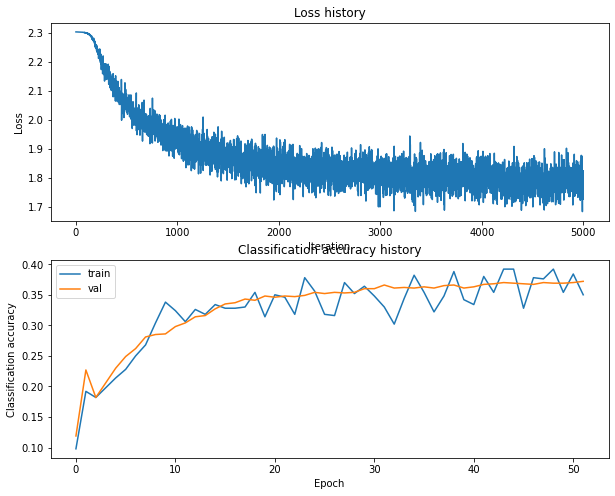

Training network with h_s 175, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.303247
iteration 100 / 5000: loss 1.920377
iteration 200 / 5000: loss 1.857153
iteration 300 / 5000: loss 1.681616
iteration 400 / 5000: loss 1.741127
iteration 500 / 5000: loss 1.754698
iteration 600 / 5000: loss 1.640658
iteration 700 / 5000: loss 1.696391
iteration 800 / 5000: loss 1.675447
iteration 900 / 5000: loss 1.663320
iteration 1000 / 5000: loss 1.651935
iteration 1100 / 5000: loss 1.626396
iteration 1200 / 5000: loss 1.683054
iteration 1300 / 5000: loss 1.655254
iteration 1400 / 5000: loss 1.563984
iteration 1500 / 5000: loss 1.581081
iteration 1600 / 5000: loss 1.671346
iteration 1700 / 5000: loss 1.718560
iteration 1800 / 5000: loss 1.662836
iteration 1900 / 5000: loss 1.588277
iteration 2000 / 5000: loss 1.649138
iteration 2100 / 5000: loss 1.677770
iteration 2200 / 5000: loss 1.694970
iteration 2300 / 5000: loss 1.625448
iteration 2400 / 5000: loss 1.646521
iteration 2500 / 5000: loss

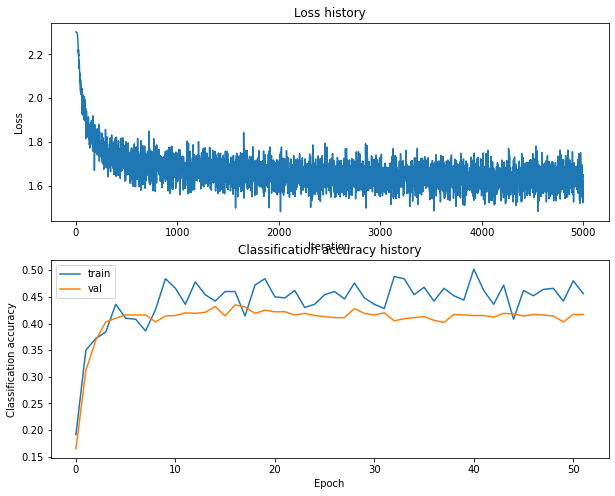

Training network with h_s 175, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.303214
iteration 100 / 10000: loss 2.299443
iteration 200 / 10000: loss 2.227188
iteration 300 / 10000: loss 2.178647
iteration 400 / 10000: loss 2.084195
iteration 500 / 10000: loss 2.093650
iteration 600 / 10000: loss 1.920222
iteration 700 / 10000: loss 1.967909
iteration 800 / 10000: loss 1.902471
iteration 900 / 10000: loss 1.935456
iteration 1000 / 10000: loss 1.890519
iteration 1100 / 10000: loss 2.111205
iteration 1200 / 10000: loss 1.934355
iteration 1300 / 10000: loss 1.856281
iteration 1400 / 10000: loss 1.946667
iteration 1500 / 10000: loss 1.924575
iteration 1600 / 10000: loss 1.741497
iteration 1700 / 10000: loss 1.768659
iteration 1800 / 10000: loss 1.901700
iteration 1900 / 10000: loss 1.700228
iteration 2000 / 10000: loss 1.702269
iteration 2100 / 10000: loss 1.826487
iteration 2200 / 10000: loss 1.839947
iteration 2300 / 10000: loss 1.691846
iteration 2400 / 10000: loss 1.856826


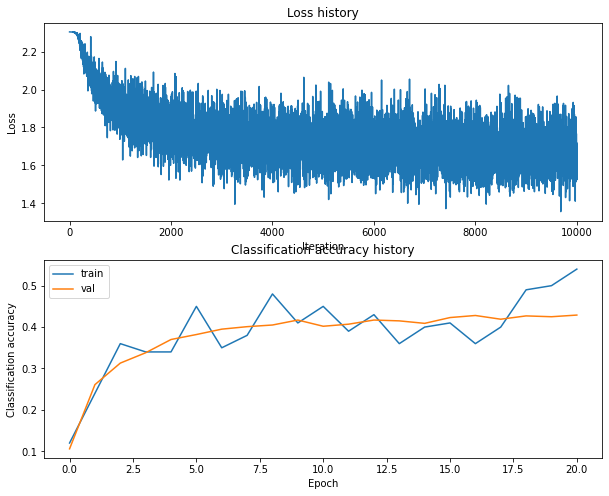

Training network with h_s 175, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.303226
iteration 100 / 10000: loss 1.910030
iteration 200 / 10000: loss 1.974233
iteration 300 / 10000: loss 1.640613
iteration 400 / 10000: loss 1.973669
iteration 500 / 10000: loss 1.716073
iteration 600 / 10000: loss 1.637652
iteration 700 / 10000: loss 1.670947
iteration 800 / 10000: loss 1.717581
iteration 900 / 10000: loss 1.613184
iteration 1000 / 10000: loss 1.832502
iteration 1100 / 10000: loss 1.608404
iteration 1200 / 10000: loss 1.648385
iteration 1300 / 10000: loss 1.636669
iteration 1400 / 10000: loss 1.614119
iteration 1500 / 10000: loss 1.951047
iteration 1600 / 10000: loss 1.851681
iteration 1700 / 10000: loss 1.775533
iteration 1800 / 10000: loss 1.831313
iteration 1900 / 10000: loss 1.730999
iteration 2000 / 10000: loss 1.697130
iteration 2100 / 10000: loss 1.743809
iteration 2200 / 10000: loss 1.705922
iteration 2300 / 10000: loss 1.665766
iteration 2400 / 10000: loss 1.656327
i

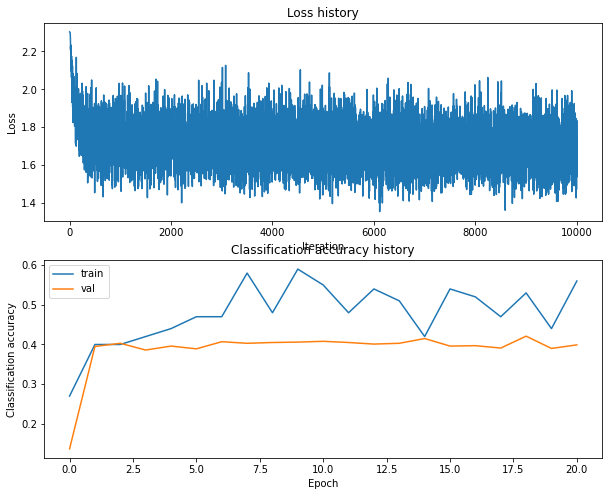

Training network with h_s 175, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.303269
iteration 100 / 10000: loss 2.298563
iteration 200 / 10000: loss 2.243688
iteration 300 / 10000: loss 2.119814
iteration 400 / 10000: loss 2.105383
iteration 500 / 10000: loss 2.049983
iteration 600 / 10000: loss 1.993530
iteration 700 / 10000: loss 2.068750
iteration 800 / 10000: loss 1.971386
iteration 900 / 10000: loss 1.943916
iteration 1000 / 10000: loss 1.967541
iteration 1100 / 10000: loss 1.869507
iteration 1200 / 10000: loss 1.890842
iteration 1300 / 10000: loss 1.903613
iteration 1400 / 10000: loss 1.740320
iteration 1500 / 10000: loss 1.844771
iteration 1600 / 10000: loss 1.807567
iteration 1700 / 10000: loss 1.876366
iteration 1800 / 10000: loss 1.776694
iteration 1900 / 10000: loss 1.764901
iteration 2000 / 10000: loss 1.736080
iteration 2100 / 10000: loss 1.705934
iteration 2200 / 10000: loss 1.835951
iteration 2300 / 10000: loss 1.829883
iteration 2400 / 10000: loss 1.756473


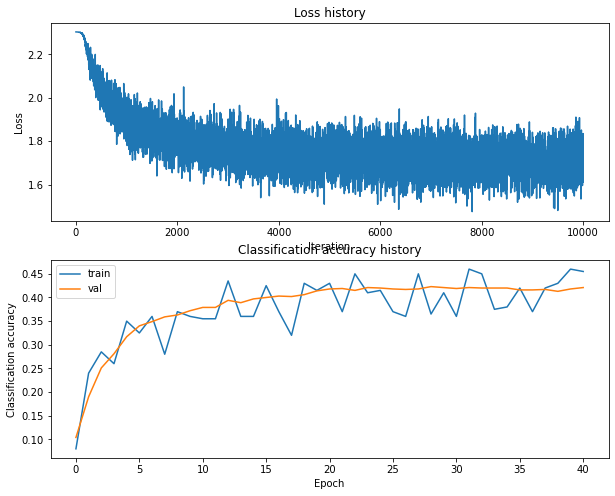

Training network with h_s 175, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.303231
iteration 100 / 10000: loss 1.824003
iteration 200 / 10000: loss 1.687280
iteration 300 / 10000: loss 1.757976
iteration 400 / 10000: loss 1.697708
iteration 500 / 10000: loss 1.648926
iteration 600 / 10000: loss 1.785983
iteration 700 / 10000: loss 1.670925
iteration 800 / 10000: loss 1.732956
iteration 900 / 10000: loss 1.726324
iteration 1000 / 10000: loss 1.636650
iteration 1100 / 10000: loss 1.841862
iteration 1200 / 10000: loss 1.610668
iteration 1300 / 10000: loss 1.732549
iteration 1400 / 10000: loss 1.782730
iteration 1500 / 10000: loss 1.711972
iteration 1600 / 10000: loss 1.659554
iteration 1700 / 10000: loss 1.665042
iteration 1800 / 10000: loss 1.567168
iteration 1900 / 10000: loss 1.650858
iteration 2000 / 10000: loss 1.714289
iteration 2100 / 10000: loss 1.655013
iteration 2200 / 10000: loss 1.761515
iteration 2300 / 10000: loss 1.672515
iteration 2400 / 10000: loss 1.530706
i

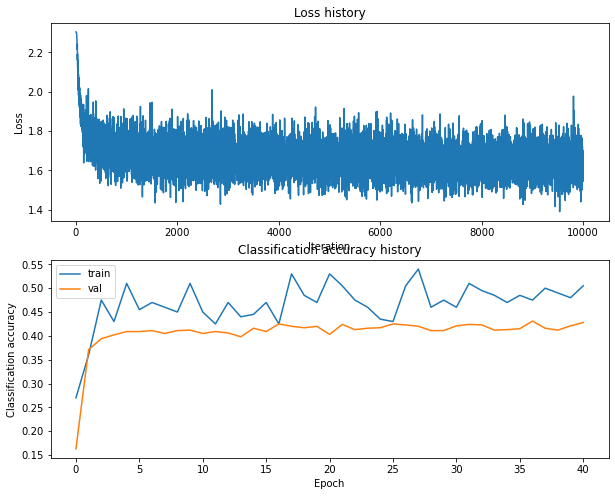

Training network with h_s 175, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.303301
iteration 100 / 10000: loss 2.300110
iteration 200 / 10000: loss 2.247961
iteration 300 / 10000: loss 2.173749
iteration 400 / 10000: loss 2.101897
iteration 500 / 10000: loss 2.054978
iteration 600 / 10000: loss 1.950646
iteration 700 / 10000: loss 2.008066
iteration 800 / 10000: loss 1.937743
iteration 900 / 10000: loss 1.922880
iteration 1000 / 10000: loss 1.949566
iteration 1100 / 10000: loss 1.814661
iteration 1200 / 10000: loss 1.984240
iteration 1300 / 10000: loss 1.819546
iteration 1400 / 10000: loss 1.776546
iteration 1500 / 10000: loss 1.918180
iteration 1600 / 10000: loss 1.869201
iteration 1700 / 10000: loss 1.778014
iteration 1800 / 10000: loss 1.773961
iteration 1900 / 10000: loss 1.938131
iteration 2000 / 10000: loss 1.882281
iteration 2100 / 10000: loss 1.722245
iteration 2200 / 10000: loss 1.859203
iteration 2300 / 10000: loss 1.778374
iteration 2400 / 10000: loss 1.805031


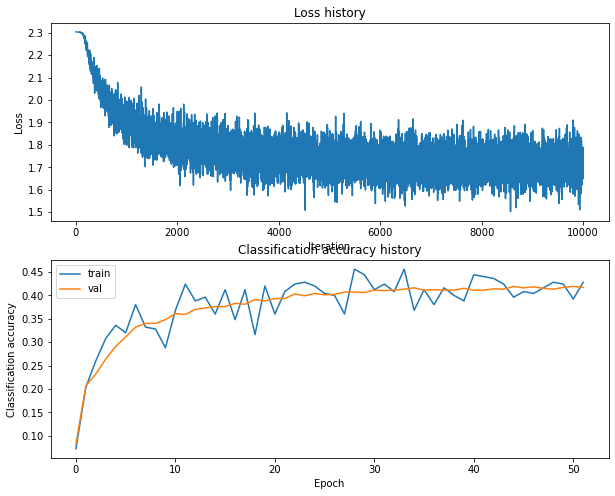

Training network with h_s 175, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.303233
iteration 100 / 10000: loss 1.914117
iteration 200 / 10000: loss 1.696483
iteration 300 / 10000: loss 1.632001
iteration 400 / 10000: loss 1.828238
iteration 500 / 10000: loss 1.721709
iteration 600 / 10000: loss 1.756132
iteration 700 / 10000: loss 1.653218
iteration 800 / 10000: loss 1.779106
iteration 900 / 10000: loss 1.825846
iteration 1000 / 10000: loss 1.732911
iteration 1100 / 10000: loss 1.667947
iteration 1200 / 10000: loss 1.656602
iteration 1300 / 10000: loss 1.641587
iteration 1400 / 10000: loss 1.668494
iteration 1500 / 10000: loss 1.685953
iteration 1600 / 10000: loss 1.593426
iteration 1700 / 10000: loss 1.674429
iteration 1800 / 10000: loss 1.656089
iteration 1900 / 10000: loss 1.613260
iteration 2000 / 10000: loss 1.738608
iteration 2100 / 10000: loss 1.707238
iteration 2200 / 10000: loss 1.673767
iteration 2300 / 10000: loss 1.736069
iteration 2400 / 10000: loss 1.672721
i

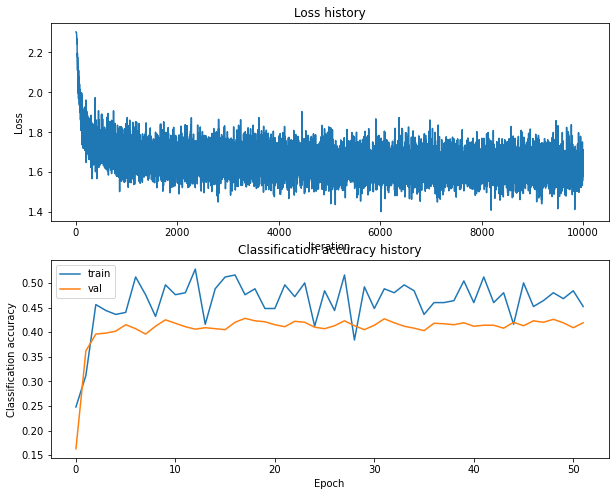

Training network with h_s 175, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.303270
iteration 100 / 10000: loss 2.299488
iteration 200 / 10000: loss 2.240432
iteration 300 / 10000: loss 2.134947
iteration 400 / 10000: loss 2.091239
iteration 500 / 10000: loss 2.055372
iteration 600 / 10000: loss 2.035279
iteration 700 / 10000: loss 1.992667
iteration 800 / 10000: loss 1.898883
iteration 900 / 10000: loss 1.970526
iteration 1000 / 10000: loss 1.895436
iteration 1100 / 10000: loss 1.812237
iteration 1200 / 10000: loss 1.847515
iteration 1300 / 10000: loss 1.810114
iteration 1400 / 10000: loss 1.840202
iteration 1500 / 10000: loss 1.800058
iteration 1600 / 10000: loss 1.786258
iteration 1700 / 10000: loss 1.701687
iteration 1800 / 10000: loss 1.814394
iteration 1900 / 10000: loss 1.827613
iteration 2000 / 10000: loss 1.779542
iteration 2100 / 10000: loss 1.770037
iteration 2200 / 10000: loss 1.727510
iteration 2300 / 10000: loss 1.799473
iteration 2400 / 10000: loss 1.769694


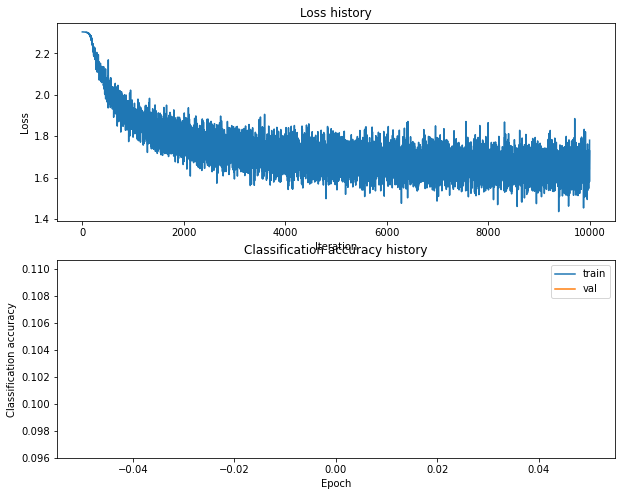

Training network with h_s 175, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.303247
iteration 100 / 10000: loss 1.919155
iteration 200 / 10000: loss 1.908921
iteration 300 / 10000: loss 1.667135
iteration 400 / 10000: loss 1.766999
iteration 500 / 10000: loss 1.732904
iteration 600 / 10000: loss 1.658762
iteration 700 / 10000: loss 1.705466
iteration 800 / 10000: loss 1.760940
iteration 900 / 10000: loss 1.748770
iteration 1000 / 10000: loss 1.754426
iteration 1100 / 10000: loss 1.696776
iteration 1200 / 10000: loss 1.686490
iteration 1300 / 10000: loss 1.733736
iteration 1400 / 10000: loss 1.775038
iteration 1500 / 10000: loss 1.636377
iteration 1600 / 10000: loss 1.698719
iteration 1700 / 10000: loss 1.619326
iteration 1800 / 10000: loss 1.549838
iteration 1900 / 10000: loss 1.746601
iteration 2000 / 10000: loss 1.710349
iteration 2100 / 10000: loss 1.624027
iteration 2200 / 10000: loss 1.675656
iteration 2300 / 10000: loss 1.680577
iteration 2400 / 10000: loss 1.657365
i

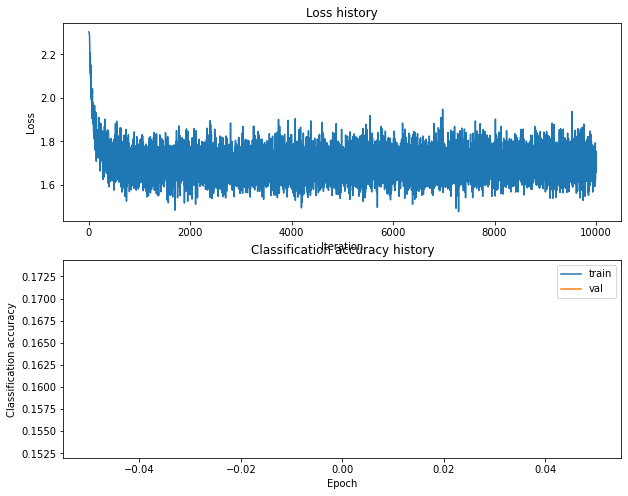

Training network with h_s 175, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.303282
iteration 100 / 10000: loss 2.300609
iteration 200 / 10000: loss 2.262922
iteration 300 / 10000: loss 2.205145
iteration 400 / 10000: loss 2.161573
iteration 500 / 10000: loss 2.002730
iteration 600 / 10000: loss 2.045343
iteration 700 / 10000: loss 2.018294
iteration 800 / 10000: loss 2.004978
iteration 900 / 10000: loss 1.940567
iteration 1000 / 10000: loss 1.921958
iteration 1100 / 10000: loss 1.903308
iteration 1200 / 10000: loss 1.859630
iteration 1300 / 10000: loss 1.907603
iteration 1400 / 10000: loss 1.914629
iteration 1500 / 10000: loss 1.897460
iteration 1600 / 10000: loss 1.895680
iteration 1700 / 10000: loss 1.855276
iteration 1800 / 10000: loss 1.809542
iteration 1900 / 10000: loss 1.834970
iteration 2000 / 10000: loss 1.791287
iteration 2100 / 10000: loss 1.827590
iteration 2200 / 10000: loss 1.859398
iteration 2300 / 10000: loss 1.834387
iteration 2400 / 10000: loss 1.855183


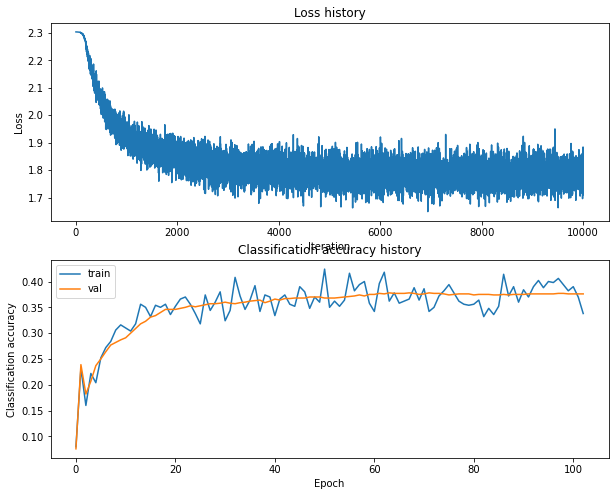

Training network with h_s 175, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.303280
iteration 100 / 10000: loss 1.913093
iteration 200 / 10000: loss 1.818139
iteration 300 / 10000: loss 1.803309
iteration 400 / 10000: loss 1.663736
iteration 500 / 10000: loss 1.670559
iteration 600 / 10000: loss 1.672047
iteration 700 / 10000: loss 1.669924
iteration 800 / 10000: loss 1.708033
iteration 900 / 10000: loss 1.598773
iteration 1000 / 10000: loss 1.710654
iteration 1100 / 10000: loss 1.723787
iteration 1200 / 10000: loss 1.707433
iteration 1300 / 10000: loss 1.644633
iteration 1400 / 10000: loss 1.665086
iteration 1500 / 10000: loss 1.623898
iteration 1600 / 10000: loss 1.663107
iteration 1700 / 10000: loss 1.717278
iteration 1800 / 10000: loss 1.634400
iteration 1900 / 10000: loss 1.623616
iteration 2000 / 10000: loss 1.598101
iteration 2100 / 10000: loss 1.596850
iteration 2200 / 10000: loss 1.593894
iteration 2300 / 10000: loss 1.673245
iteration 2400 / 10000: loss 1.684467
i

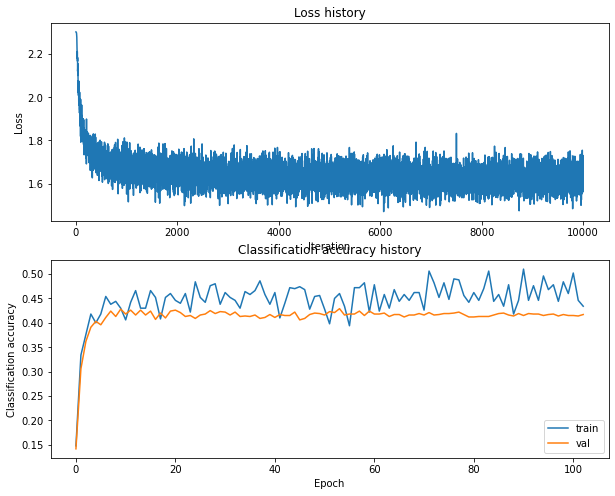

Training network with h_s 175, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.303288
iteration 100 / 15000: loss 2.300341
iteration 200 / 15000: loss 2.245181
iteration 300 / 15000: loss 2.134313
iteration 400 / 15000: loss 2.160107
iteration 500 / 15000: loss 2.044162
iteration 600 / 15000: loss 1.919360
iteration 700 / 15000: loss 2.008825
iteration 800 / 15000: loss 2.058645
iteration 900 / 15000: loss 2.136194
iteration 1000 / 15000: loss 1.856260
iteration 1100 / 15000: loss 1.792598
iteration 1200 / 15000: loss 1.885169
iteration 1300 / 15000: loss 1.871490
iteration 1400 / 15000: loss 1.950932
iteration 1500 / 15000: loss 1.727984
iteration 1600 / 15000: loss 1.845263
iteration 1700 / 15000: loss 1.788888
iteration 1800 / 15000: loss 1.886651
iteration 1900 / 15000: loss 1.816285
iteration 2000 / 15000: loss 1.867837
iteration 2100 / 15000: loss 1.808271
iteration 2200 / 15000: loss 1.956852
iteration 2300 / 15000: loss 1.711262
iteration 2400 / 15000: loss 1.757625


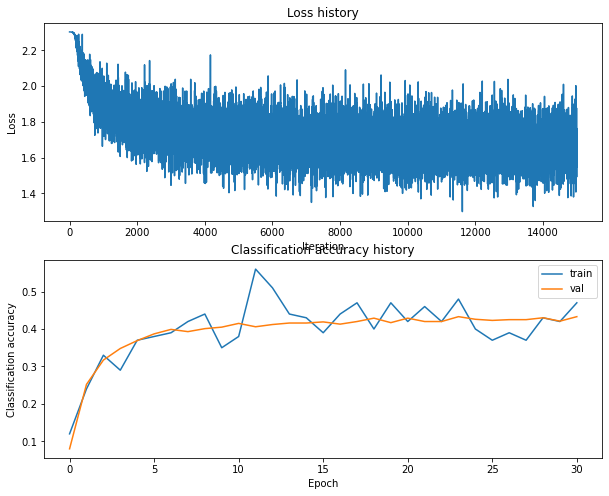

Training network with h_s 175, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.303252
iteration 100 / 15000: loss 1.798657
iteration 200 / 15000: loss 1.694509
iteration 300 / 15000: loss 1.681973
iteration 400 / 15000: loss 1.756993
iteration 500 / 15000: loss 1.814171
iteration 600 / 15000: loss 1.604944
iteration 700 / 15000: loss 1.736392
iteration 800 / 15000: loss 1.789670
iteration 900 / 15000: loss 1.606319
iteration 1000 / 15000: loss 1.603024
iteration 1100 / 15000: loss 1.892786
iteration 1200 / 15000: loss 1.818017
iteration 1300 / 15000: loss 1.721489
iteration 1400 / 15000: loss 1.675504
iteration 1500 / 15000: loss 1.637380
iteration 1600 / 15000: loss 1.745901
iteration 1700 / 15000: loss 1.795723
iteration 1800 / 15000: loss 1.715777
iteration 1900 / 15000: loss 1.599661
iteration 2000 / 15000: loss 1.673685
iteration 2100 / 15000: loss 1.804745
iteration 2200 / 15000: loss 1.690879
iteration 2300 / 15000: loss 1.648636
iteration 2400 / 15000: loss 1.808791
i

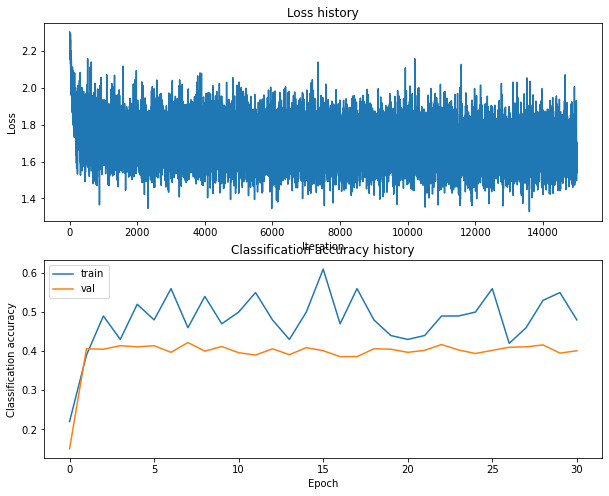

Training network with h_s 175, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.303242
iteration 100 / 15000: loss 2.299598
iteration 200 / 15000: loss 2.259140
iteration 300 / 15000: loss 2.165615
iteration 400 / 15000: loss 2.118763
iteration 500 / 15000: loss 2.024482
iteration 600 / 15000: loss 1.943759
iteration 700 / 15000: loss 1.971451
iteration 800 / 15000: loss 1.970498
iteration 900 / 15000: loss 1.940280
iteration 1000 / 15000: loss 1.914838
iteration 1100 / 15000: loss 2.027615
iteration 1200 / 15000: loss 1.833370
iteration 1300 / 15000: loss 1.832564
iteration 1400 / 15000: loss 1.821335
iteration 1500 / 15000: loss 1.780794
iteration 1600 / 15000: loss 1.790999
iteration 1700 / 15000: loss 1.790124
iteration 1800 / 15000: loss 1.837656
iteration 1900 / 15000: loss 1.948389
iteration 2000 / 15000: loss 1.886508
iteration 2100 / 15000: loss 1.686954
iteration 2200 / 15000: loss 1.802981
iteration 2300 / 15000: loss 1.795911
iteration 2400 / 15000: loss 1.777707


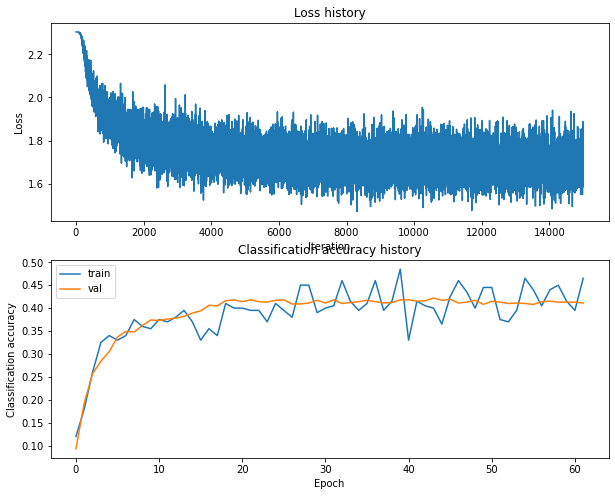

Training network with h_s 175, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.303251
iteration 100 / 15000: loss 1.917541
iteration 200 / 15000: loss 1.738144
iteration 300 / 15000: loss 1.753039
iteration 400 / 15000: loss 1.742783
iteration 500 / 15000: loss 1.837860
iteration 600 / 15000: loss 1.656797
iteration 700 / 15000: loss 1.694729
iteration 800 / 15000: loss 1.766253
iteration 900 / 15000: loss 1.708352
iteration 1000 / 15000: loss 1.622720
iteration 1100 / 15000: loss 1.646042
iteration 1200 / 15000: loss 1.748331
iteration 1300 / 15000: loss 1.684342
iteration 1400 / 15000: loss 1.688053
iteration 1500 / 15000: loss 1.633772
iteration 1600 / 15000: loss 1.785816
iteration 1700 / 15000: loss 1.702208
iteration 1800 / 15000: loss 1.737023
iteration 1900 / 15000: loss 1.661359
iteration 2000 / 15000: loss 1.693843
iteration 2100 / 15000: loss 1.634711
iteration 2200 / 15000: loss 1.608094
iteration 2300 / 15000: loss 1.705400
iteration 2400 / 15000: loss 1.775169
i

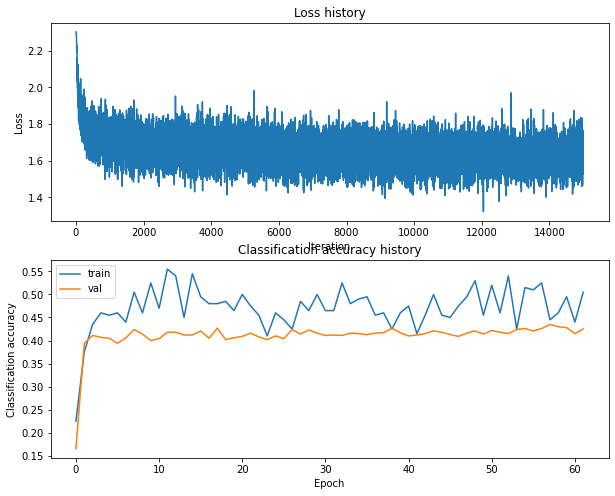

Training network with h_s 175, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.303242
iteration 100 / 15000: loss 2.299482
iteration 200 / 15000: loss 2.246172
iteration 300 / 15000: loss 2.148692
iteration 400 / 15000: loss 2.147478
iteration 500 / 15000: loss 2.061106
iteration 600 / 15000: loss 2.001042
iteration 700 / 15000: loss 1.936587
iteration 800 / 15000: loss 1.966902
iteration 900 / 15000: loss 1.984363
iteration 1000 / 15000: loss 1.884000
iteration 1100 / 15000: loss 1.921997
iteration 1200 / 15000: loss 1.888106
iteration 1300 / 15000: loss 1.811941
iteration 1400 / 15000: loss 1.838704
iteration 1500 / 15000: loss 1.902886
iteration 1600 / 15000: loss 1.821119
iteration 1700 / 15000: loss 1.807581
iteration 1800 / 15000: loss 1.823053
iteration 1900 / 15000: loss 1.776727
iteration 2000 / 15000: loss 1.748813
iteration 2100 / 15000: loss 1.731919
iteration 2200 / 15000: loss 1.867274
iteration 2300 / 15000: loss 1.834212
iteration 2400 / 15000: loss 1.843194


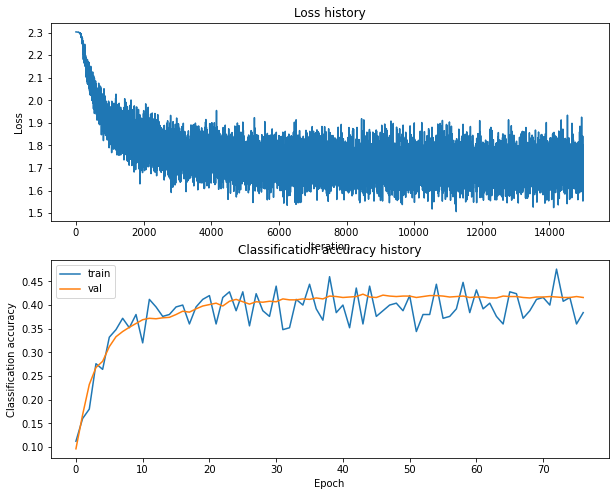

Training network with h_s 175, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.303240
iteration 100 / 15000: loss 1.851104
iteration 200 / 15000: loss 1.763608
iteration 300 / 15000: loss 1.822090
iteration 400 / 15000: loss 1.668281
iteration 500 / 15000: loss 1.686286
iteration 600 / 15000: loss 1.591512
iteration 700 / 15000: loss 1.736701
iteration 800 / 15000: loss 1.704009
iteration 900 / 15000: loss 1.601014
iteration 1000 / 15000: loss 1.772342
iteration 1100 / 15000: loss 1.640848
iteration 1200 / 15000: loss 1.716990
iteration 1300 / 15000: loss 1.681686
iteration 1400 / 15000: loss 1.674081
iteration 1500 / 15000: loss 1.767959
iteration 1600 / 15000: loss 1.615468
iteration 1700 / 15000: loss 1.688410
iteration 1800 / 15000: loss 1.629029
iteration 1900 / 15000: loss 1.786395
iteration 2000 / 15000: loss 1.690857
iteration 2100 / 15000: loss 1.618178
iteration 2200 / 15000: loss 1.625442
iteration 2300 / 15000: loss 1.576689
iteration 2400 / 15000: loss 1.722464
i

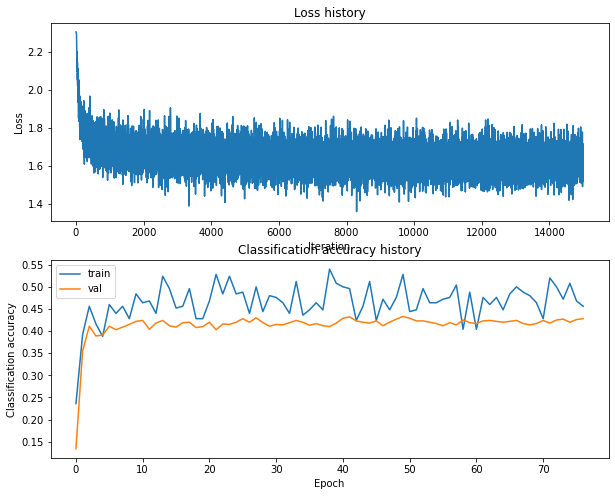

Training network with h_s 175, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.303278
iteration 100 / 15000: loss 2.299874
iteration 200 / 15000: loss 2.249596
iteration 300 / 15000: loss 2.123149
iteration 400 / 15000: loss 2.097405
iteration 500 / 15000: loss 2.022583
iteration 600 / 15000: loss 2.021718
iteration 700 / 15000: loss 1.955766
iteration 800 / 15000: loss 2.002066
iteration 900 / 15000: loss 1.827339
iteration 1000 / 15000: loss 1.907984
iteration 1100 / 15000: loss 1.903983
iteration 1200 / 15000: loss 1.870128
iteration 1300 / 15000: loss 1.820053
iteration 1400 / 15000: loss 1.923663
iteration 1500 / 15000: loss 1.765824
iteration 1600 / 15000: loss 1.740616
iteration 1700 / 15000: loss 1.801198
iteration 1800 / 15000: loss 1.813977
iteration 1900 / 15000: loss 1.691529
iteration 2000 / 15000: loss 1.797810
iteration 2100 / 15000: loss 1.819177
iteration 2200 / 15000: loss 1.784453
iteration 2300 / 15000: loss 1.783970
iteration 2400 / 15000: loss 1.821583


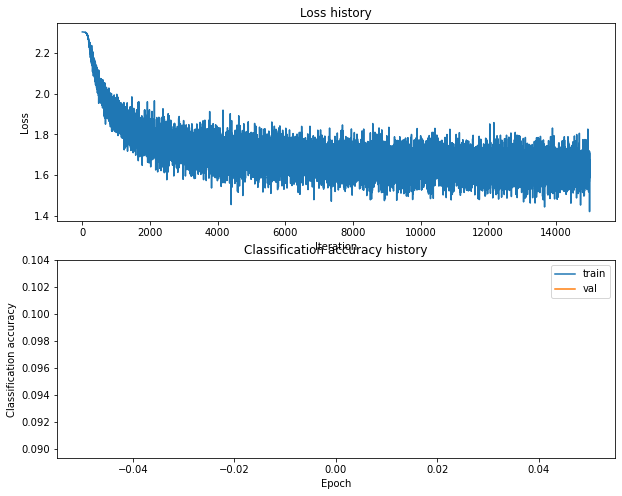

Training network with h_s 175, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.303241
iteration 100 / 15000: loss 1.928835
iteration 200 / 15000: loss 1.757608
iteration 300 / 15000: loss 1.820688
iteration 400 / 15000: loss 1.708918
iteration 500 / 15000: loss 1.741905
iteration 600 / 15000: loss 1.567142
iteration 700 / 15000: loss 1.689186
iteration 800 / 15000: loss 1.758903
iteration 900 / 15000: loss 1.741860
iteration 1000 / 15000: loss 1.700303
iteration 1100 / 15000: loss 1.734512
iteration 1200 / 15000: loss 1.631261
iteration 1300 / 15000: loss 1.793346
iteration 1400 / 15000: loss 1.773195
iteration 1500 / 15000: loss 1.642408
iteration 1600 / 15000: loss 1.597122
iteration 1700 / 15000: loss 1.744981
iteration 1800 / 15000: loss 1.701590
iteration 1900 / 15000: loss 1.684598
iteration 2000 / 15000: loss 1.711765
iteration 2100 / 15000: loss 1.760686
iteration 2200 / 15000: loss 1.736789
iteration 2300 / 15000: loss 1.670778
iteration 2400 / 15000: loss 1.657427
i

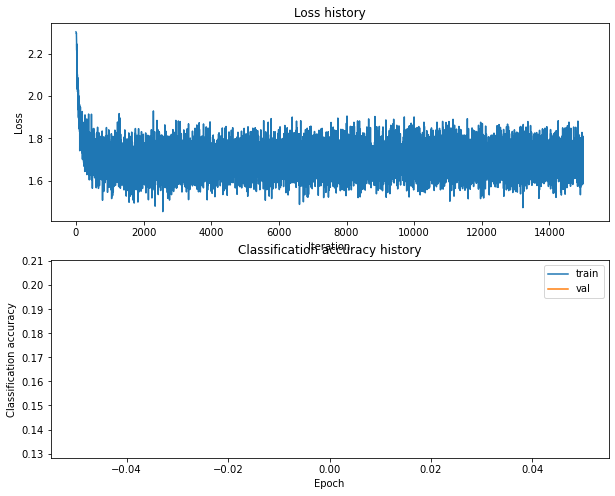

Training network with h_s 175, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.303261
iteration 100 / 15000: loss 2.299191
iteration 200 / 15000: loss 2.244902
iteration 300 / 15000: loss 2.187808
iteration 400 / 15000: loss 2.117306
iteration 500 / 15000: loss 2.026806
iteration 600 / 15000: loss 1.994423
iteration 700 / 15000: loss 2.039305
iteration 800 / 15000: loss 1.909445
iteration 900 / 15000: loss 1.958975
iteration 1000 / 15000: loss 1.944286
iteration 1100 / 15000: loss 1.950228
iteration 1200 / 15000: loss 1.930206
iteration 1300 / 15000: loss 1.886679
iteration 1400 / 15000: loss 1.905264
iteration 1500 / 15000: loss 1.877301
iteration 1600 / 15000: loss 1.864148
iteration 1700 / 15000: loss 1.792808
iteration 1800 / 15000: loss 1.890388
iteration 1900 / 15000: loss 1.901631
iteration 2000 / 15000: loss 1.882257
iteration 2100 / 15000: loss 1.785906
iteration 2200 / 15000: loss 1.861177
iteration 2300 / 15000: loss 1.859542
iteration 2400 / 15000: loss 1.850291


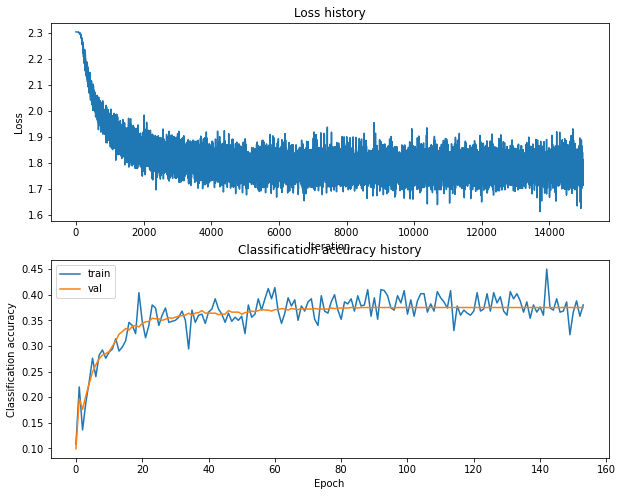

Training network with h_s 175, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.303257
iteration 100 / 15000: loss 1.892662
iteration 200 / 15000: loss 1.793663
iteration 300 / 15000: loss 1.762952
iteration 400 / 15000: loss 1.742175
iteration 500 / 15000: loss 1.684073
iteration 600 / 15000: loss 1.741354
iteration 700 / 15000: loss 1.680369
iteration 800 / 15000: loss 1.618841
iteration 900 / 15000: loss 1.668940
iteration 1000 / 15000: loss 1.698644
iteration 1100 / 15000: loss 1.725805
iteration 1200 / 15000: loss 1.595948
iteration 1300 / 15000: loss 1.571214
iteration 1400 / 15000: loss 1.685794
iteration 1500 / 15000: loss 1.587787
iteration 1600 / 15000: loss 1.608810
iteration 1700 / 15000: loss 1.579066
iteration 1800 / 15000: loss 1.713778
iteration 1900 / 15000: loss 1.641910
iteration 2000 / 15000: loss 1.694574
iteration 2100 / 15000: loss 1.625960
iteration 2200 / 15000: loss 1.657923
iteration 2300 / 15000: loss 1.724749
iteration 2400 / 15000: loss 1.642222
i

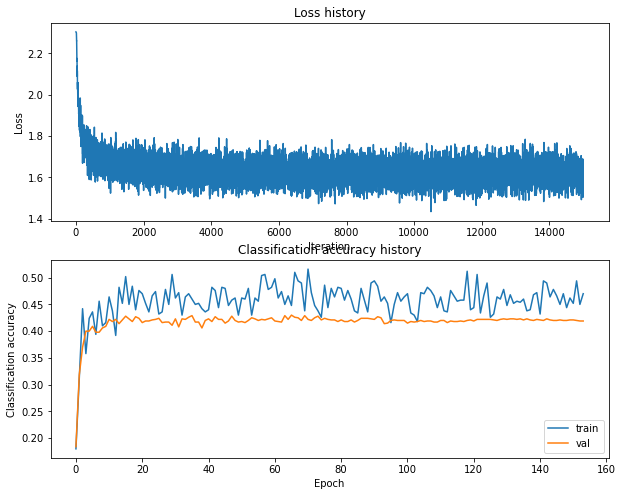

Training network with h_s 175, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.303252
iteration 100 / 20000: loss 2.299010
iteration 200 / 20000: loss 2.267453
iteration 300 / 20000: loss 2.193808
iteration 400 / 20000: loss 2.018067
iteration 500 / 20000: loss 2.050771
iteration 600 / 20000: loss 2.029635
iteration 700 / 20000: loss 1.936519
iteration 800 / 20000: loss 2.048060
iteration 900 / 20000: loss 1.884664
iteration 1000 / 20000: loss 1.868893
iteration 1100 / 20000: loss 1.763009
iteration 1200 / 20000: loss 1.985971
iteration 1300 / 20000: loss 1.756510
iteration 1400 / 20000: loss 1.868504
iteration 1500 / 20000: loss 1.858199
iteration 1600 / 20000: loss 1.802348
iteration 1700 / 20000: loss 1.934233
iteration 1800 / 20000: loss 1.873041
iteration 1900 / 20000: loss 1.722092
iteration 2000 / 20000: loss 1.637575
iteration 2100 / 20000: loss 1.763569
iteration 2200 / 20000: loss 1.724265
iteration 2300 / 20000: loss 1.693198
iteration 2400 / 20000: loss 1.843224


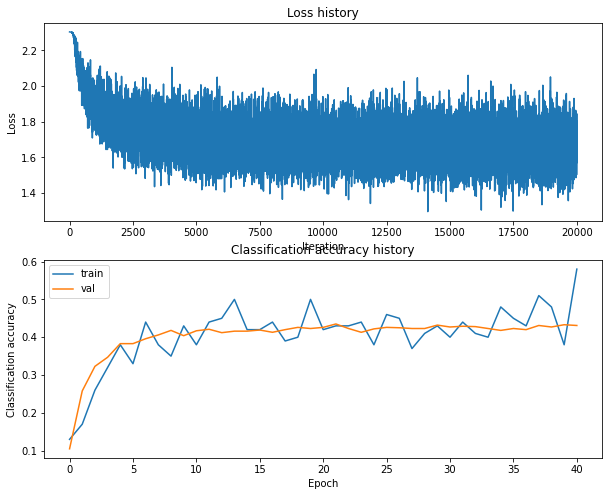

Training network with h_s 175, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.303231
iteration 100 / 20000: loss 1.955942
iteration 200 / 20000: loss 1.927980
iteration 300 / 20000: loss 1.853930
iteration 400 / 20000: loss 1.820858
iteration 500 / 20000: loss 1.875161
iteration 600 / 20000: loss 1.893885
iteration 700 / 20000: loss 1.903890
iteration 800 / 20000: loss 1.703055
iteration 900 / 20000: loss 1.708615
iteration 1000 / 20000: loss 1.778317
iteration 1100 / 20000: loss 1.515366
iteration 1200 / 20000: loss 1.638487
iteration 1300 / 20000: loss 1.635893
iteration 1400 / 20000: loss 1.802951
iteration 1500 / 20000: loss 1.831602
iteration 1600 / 20000: loss 1.871281
iteration 1700 / 20000: loss 1.974742
iteration 1800 / 20000: loss 1.901243
iteration 1900 / 20000: loss 1.781681
iteration 2000 / 20000: loss 1.689500
iteration 2100 / 20000: loss 1.857344
iteration 2200 / 20000: loss 1.823631
iteration 2300 / 20000: loss 1.775752
iteration 2400 / 20000: loss 1.901418
i

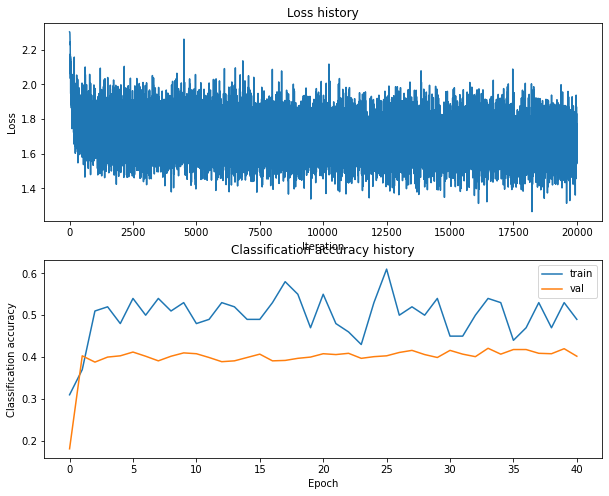

Training network with h_s 175, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.303223
iteration 100 / 20000: loss 2.299825
iteration 200 / 20000: loss 2.253761
iteration 300 / 20000: loss 2.134999
iteration 400 / 20000: loss 2.097979
iteration 500 / 20000: loss 2.021037
iteration 600 / 20000: loss 1.997832
iteration 700 / 20000: loss 1.959516
iteration 800 / 20000: loss 1.943158
iteration 900 / 20000: loss 1.874804
iteration 1000 / 20000: loss 1.857253
iteration 1100 / 20000: loss 1.864014
iteration 1200 / 20000: loss 1.851237
iteration 1300 / 20000: loss 1.766828
iteration 1400 / 20000: loss 1.869506
iteration 1500 / 20000: loss 1.846200
iteration 1600 / 20000: loss 1.923862
iteration 1700 / 20000: loss 1.805184
iteration 1800 / 20000: loss 1.738443
iteration 1900 / 20000: loss 1.808016
iteration 2000 / 20000: loss 1.803005
iteration 2100 / 20000: loss 1.769697
iteration 2200 / 20000: loss 1.757416
iteration 2300 / 20000: loss 1.805903
iteration 2400 / 20000: loss 1.873776


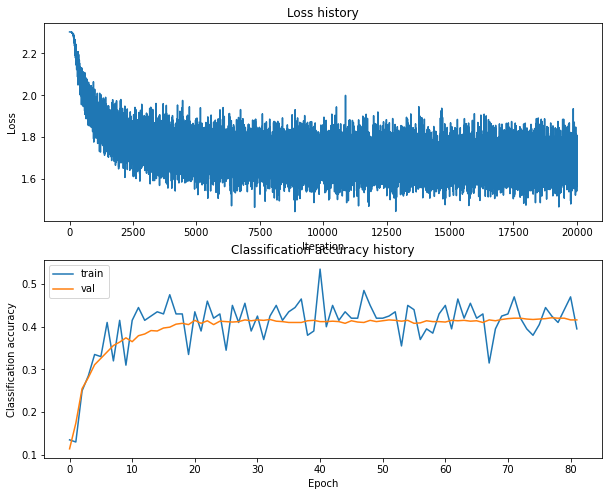

Training network with h_s 175, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.303254
iteration 100 / 20000: loss 1.911474
iteration 200 / 20000: loss 1.794839
iteration 300 / 20000: loss 1.867040
iteration 400 / 20000: loss 1.648768
iteration 500 / 20000: loss 1.682852
iteration 600 / 20000: loss 1.740902
iteration 700 / 20000: loss 1.749005
iteration 800 / 20000: loss 1.622108
iteration 900 / 20000: loss 1.773254
iteration 1000 / 20000: loss 1.715836
iteration 1100 / 20000: loss 1.692556
iteration 1200 / 20000: loss 1.789230
iteration 1300 / 20000: loss 1.679719
iteration 1400 / 20000: loss 1.874118
iteration 1500 / 20000: loss 1.586011
iteration 1600 / 20000: loss 1.642931
iteration 1700 / 20000: loss 1.470636
iteration 1800 / 20000: loss 1.678125
iteration 1900 / 20000: loss 1.627682
iteration 2000 / 20000: loss 1.772014
iteration 2100 / 20000: loss 1.685017
iteration 2200 / 20000: loss 1.639193
iteration 2300 / 20000: loss 1.614389
iteration 2400 / 20000: loss 1.742492
i

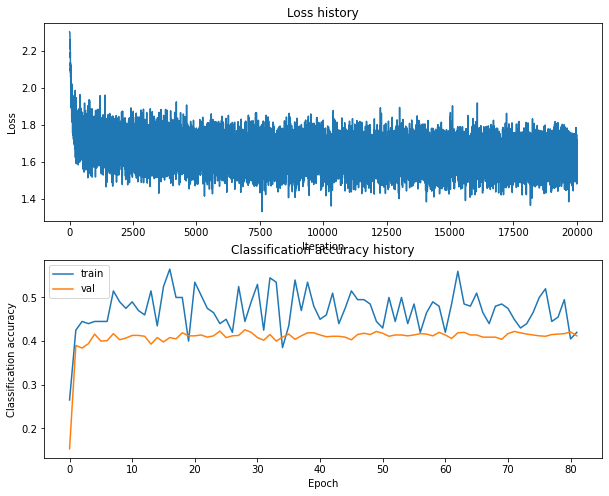

Training network with h_s 175, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.303279
iteration 100 / 20000: loss 2.300181
iteration 200 / 20000: loss 2.238453
iteration 300 / 20000: loss 2.117034
iteration 400 / 20000: loss 2.145062
iteration 500 / 20000: loss 1.994145
iteration 600 / 20000: loss 1.951885
iteration 700 / 20000: loss 1.980068
iteration 800 / 20000: loss 1.969799
iteration 900 / 20000: loss 1.870992
iteration 1000 / 20000: loss 1.956639
iteration 1100 / 20000: loss 1.923497
iteration 1200 / 20000: loss 1.920024
iteration 1300 / 20000: loss 1.816624
iteration 1400 / 20000: loss 1.860019
iteration 1500 / 20000: loss 1.766603
iteration 1600 / 20000: loss 1.783160
iteration 1700 / 20000: loss 1.787749
iteration 1800 / 20000: loss 1.903056
iteration 1900 / 20000: loss 1.816894
iteration 2000 / 20000: loss 1.813375
iteration 2100 / 20000: loss 1.810667
iteration 2200 / 20000: loss 1.809648
iteration 2300 / 20000: loss 1.927470
iteration 2400 / 20000: loss 1.865868


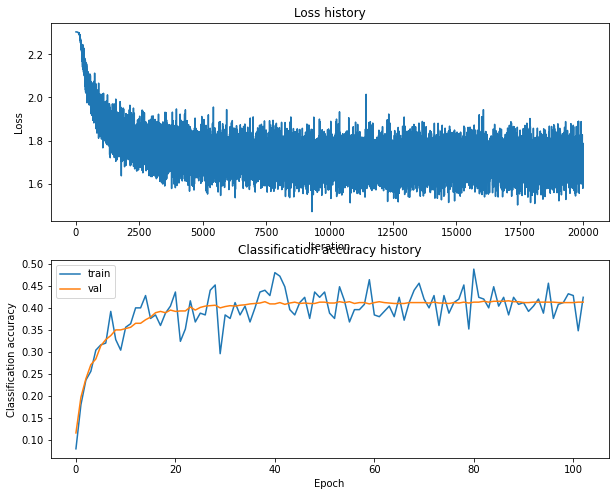

Training network with h_s 175, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.303201
iteration 100 / 20000: loss 1.927002
iteration 200 / 20000: loss 1.807838
iteration 300 / 20000: loss 1.828749
iteration 400 / 20000: loss 1.804357
iteration 500 / 20000: loss 1.784361
iteration 600 / 20000: loss 1.706881
iteration 700 / 20000: loss 1.641753
iteration 800 / 20000: loss 1.771889
iteration 900 / 20000: loss 1.685643
iteration 1000 / 20000: loss 1.802905
iteration 1100 / 20000: loss 1.638531
iteration 1200 / 20000: loss 1.566202
iteration 1300 / 20000: loss 1.791892
iteration 1400 / 20000: loss 1.688953
iteration 1500 / 20000: loss 1.650688
iteration 1600 / 20000: loss 1.709655
iteration 1700 / 20000: loss 1.706906
iteration 1800 / 20000: loss 1.675702
iteration 1900 / 20000: loss 1.687983
iteration 2000 / 20000: loss 1.602008
iteration 2100 / 20000: loss 1.621237
iteration 2200 / 20000: loss 1.667821
iteration 2300 / 20000: loss 1.637579
iteration 2400 / 20000: loss 1.651937
i

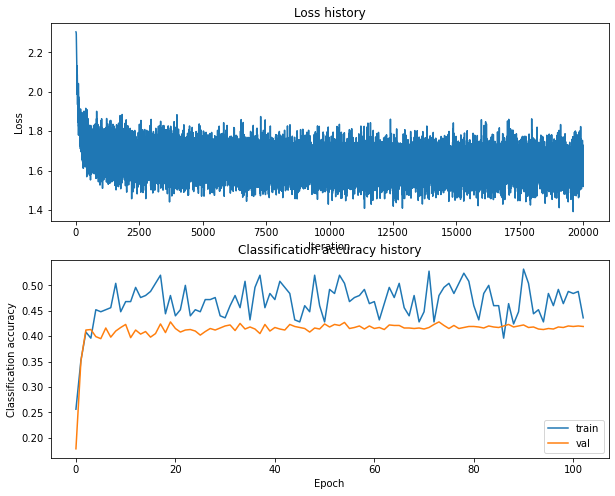

Training network with h_s 175, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.303242
iteration 100 / 20000: loss 2.299886
iteration 200 / 20000: loss 2.254995
iteration 300 / 20000: loss 2.148699
iteration 400 / 20000: loss 2.058195
iteration 500 / 20000: loss 2.071862
iteration 600 / 20000: loss 2.078468
iteration 700 / 20000: loss 1.970221
iteration 800 / 20000: loss 1.876902
iteration 900 / 20000: loss 1.863929
iteration 1000 / 20000: loss 1.872858
iteration 1100 / 20000: loss 1.877825
iteration 1200 / 20000: loss 1.876756
iteration 1300 / 20000: loss 1.816311
iteration 1400 / 20000: loss 1.970854
iteration 1500 / 20000: loss 1.786624
iteration 1600 / 20000: loss 1.815010
iteration 1700 / 20000: loss 1.719741
iteration 1800 / 20000: loss 1.752659
iteration 1900 / 20000: loss 1.863928
iteration 2000 / 20000: loss 1.823776
iteration 2100 / 20000: loss 1.733512
iteration 2200 / 20000: loss 1.796702
iteration 2300 / 20000: loss 1.737417
iteration 2400 / 20000: loss 1.748109


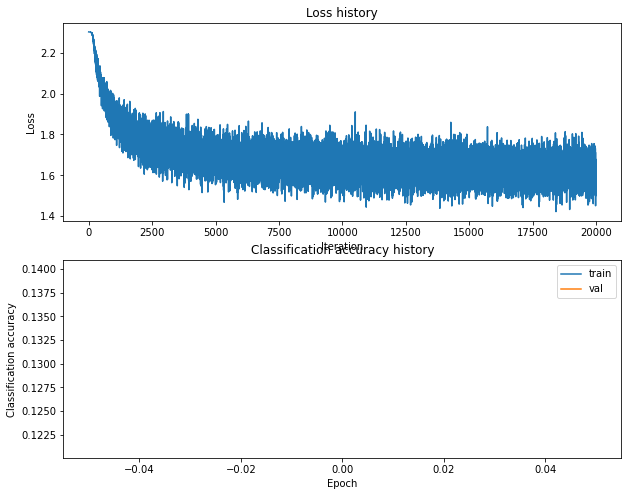

Training network with h_s 175, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.303243
iteration 100 / 20000: loss 1.874503
iteration 200 / 20000: loss 1.831949
iteration 300 / 20000: loss 1.729732
iteration 400 / 20000: loss 1.677852
iteration 500 / 20000: loss 1.652477
iteration 600 / 20000: loss 1.582369
iteration 700 / 20000: loss 1.660559
iteration 800 / 20000: loss 1.690971
iteration 900 / 20000: loss 1.825768
iteration 1000 / 20000: loss 1.656760
iteration 1100 / 20000: loss 1.720149
iteration 1200 / 20000: loss 1.784273
iteration 1300 / 20000: loss 1.681810
iteration 1400 / 20000: loss 1.693938
iteration 1500 / 20000: loss 1.750317
iteration 1600 / 20000: loss 1.777799
iteration 1700 / 20000: loss 1.637258
iteration 1800 / 20000: loss 1.643553
iteration 1900 / 20000: loss 1.634558
iteration 2000 / 20000: loss 1.708923
iteration 2100 / 20000: loss 1.693187
iteration 2200 / 20000: loss 1.644800
iteration 2300 / 20000: loss 1.649254
iteration 2400 / 20000: loss 1.808181
i

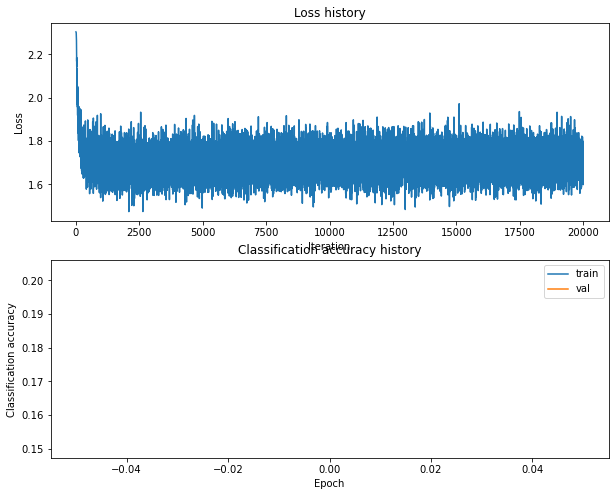

Training network with h_s 175, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.303283
iteration 100 / 20000: loss 2.300095
iteration 200 / 20000: loss 2.258404
iteration 300 / 20000: loss 2.130213
iteration 400 / 20000: loss 2.084174
iteration 500 / 20000: loss 2.041909
iteration 600 / 20000: loss 2.013638
iteration 700 / 20000: loss 1.952082
iteration 800 / 20000: loss 1.985462
iteration 900 / 20000: loss 1.963054
iteration 1000 / 20000: loss 1.922599
iteration 1100 / 20000: loss 1.923911
iteration 1200 / 20000: loss 1.899767
iteration 1300 / 20000: loss 1.880666
iteration 1400 / 20000: loss 1.877756
iteration 1500 / 20000: loss 1.886076
iteration 1600 / 20000: loss 1.879467
iteration 1700 / 20000: loss 1.886209
iteration 1800 / 20000: loss 1.873736
iteration 1900 / 20000: loss 1.783093
iteration 2000 / 20000: loss 1.863365
iteration 2100 / 20000: loss 1.813453
iteration 2200 / 20000: loss 1.792320
iteration 2300 / 20000: loss 1.866084
iteration 2400 / 20000: loss 1.857598


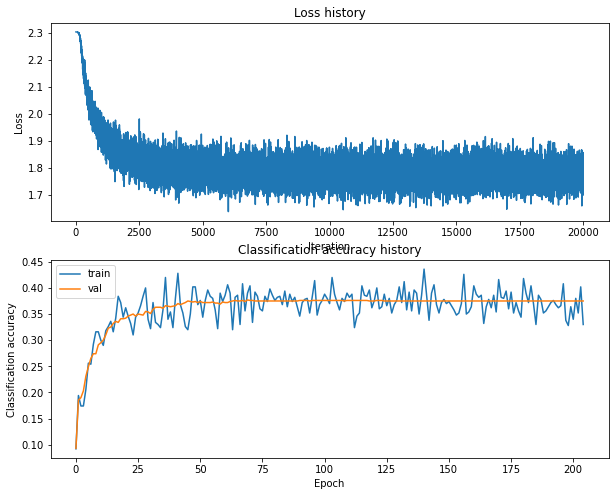

Training network with h_s 175, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.303278
iteration 100 / 20000: loss 1.921916
iteration 200 / 20000: loss 1.822199
iteration 300 / 20000: loss 1.742419
iteration 400 / 20000: loss 1.722254
iteration 500 / 20000: loss 1.715009
iteration 600 / 20000: loss 1.661931
iteration 700 / 20000: loss 1.689507
iteration 800 / 20000: loss 1.670090
iteration 900 / 20000: loss 1.781593
iteration 1000 / 20000: loss 1.709632
iteration 1100 / 20000: loss 1.605584
iteration 1200 / 20000: loss 1.640274
iteration 1300 / 20000: loss 1.667072
iteration 1400 / 20000: loss 1.690285
iteration 1500 / 20000: loss 1.636510
iteration 1600 / 20000: loss 1.736053
iteration 1700 / 20000: loss 1.632023
iteration 1800 / 20000: loss 1.596100
iteration 1900 / 20000: loss 1.597178
iteration 2000 / 20000: loss 1.592309
iteration 2100 / 20000: loss 1.611729
iteration 2200 / 20000: loss 1.631475
iteration 2300 / 20000: loss 1.678165
iteration 2400 / 20000: loss 1.621123
i

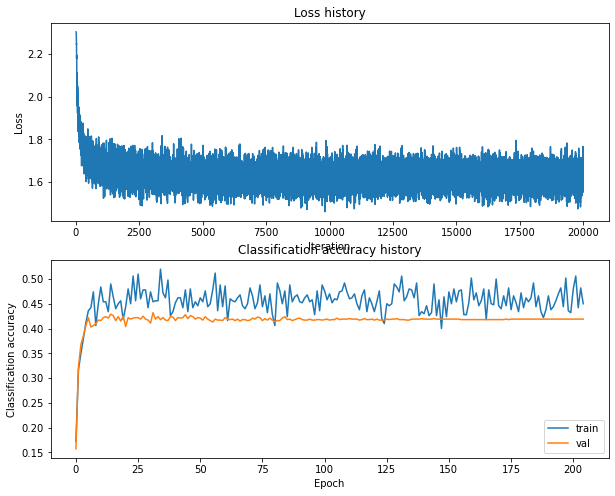

Training network with h_s 175, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.303218
iteration 100 / 25000: loss 2.300649
iteration 200 / 25000: loss 2.246000
iteration 300 / 25000: loss 2.136554
iteration 400 / 25000: loss 2.116117
iteration 500 / 25000: loss 2.011963
iteration 600 / 25000: loss 2.035333
iteration 700 / 25000: loss 1.927740
iteration 800 / 25000: loss 1.941569
iteration 900 / 25000: loss 1.926680
iteration 1000 / 25000: loss 2.006064
iteration 1100 / 25000: loss 1.858448
iteration 1200 / 25000: loss 1.978359
iteration 1300 / 25000: loss 1.773897
iteration 1400 / 25000: loss 1.910224
iteration 1500 / 25000: loss 1.852148
iteration 1600 / 25000: loss 1.696883
iteration 1700 / 25000: loss 1.791291
iteration 1800 / 25000: loss 1.929778
iteration 1900 / 25000: loss 1.703694
iteration 2000 / 25000: loss 1.757709
iteration 2100 / 25000: loss 1.833520
iteration 2200 / 25000: loss 1.841948
iteration 2300 / 25000: loss 1.867337
iteration 2400 / 25000: loss 1.801757


iteration 21200 / 25000: loss 1.761417
iteration 21300 / 25000: loss 1.768118
iteration 21400 / 25000: loss 1.737793
iteration 21500 / 25000: loss 1.442997
iteration 21600 / 25000: loss 1.681201
iteration 21700 / 25000: loss 1.580378
iteration 21800 / 25000: loss 1.607583
iteration 21900 / 25000: loss 1.359789
iteration 22000 / 25000: loss 1.685443
iteration 22100 / 25000: loss 1.659485
iteration 22200 / 25000: loss 1.515930
iteration 22300 / 25000: loss 1.764936
iteration 22400 / 25000: loss 1.719984
iteration 22500 / 25000: loss 1.597243
iteration 22600 / 25000: loss 1.851324
iteration 22700 / 25000: loss 1.547490
iteration 22800 / 25000: loss 1.570970
iteration 22900 / 25000: loss 1.571892
iteration 23000 / 25000: loss 1.591706
iteration 23100 / 25000: loss 1.647168
iteration 23200 / 25000: loss 1.524285
iteration 23300 / 25000: loss 1.726833
iteration 23400 / 25000: loss 1.688437
iteration 23500 / 25000: loss 1.533160
iteration 23600 / 25000: loss 1.607013
iteration 23700 / 25000: 

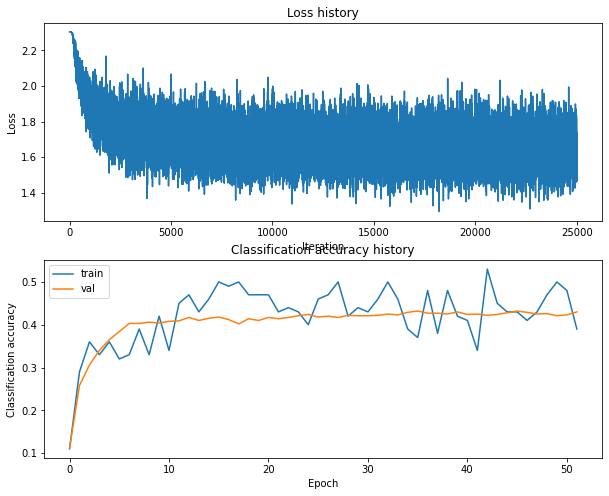

Training network with h_s 175, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.303196
iteration 100 / 25000: loss 1.935157
iteration 200 / 25000: loss 1.931466
iteration 300 / 25000: loss 1.779351
iteration 400 / 25000: loss 1.747624
iteration 500 / 25000: loss 1.704210
iteration 600 / 25000: loss 1.567837
iteration 700 / 25000: loss 1.846498
iteration 800 / 25000: loss 1.869007
iteration 900 / 25000: loss 1.851407
iteration 1000 / 25000: loss 1.761376
iteration 1100 / 25000: loss 1.594440
iteration 1200 / 25000: loss 1.825244
iteration 1300 / 25000: loss 1.537452
iteration 1400 / 25000: loss 1.918714
iteration 1500 / 25000: loss 1.689624
iteration 1600 / 25000: loss 1.653321
iteration 1700 / 25000: loss 1.725209
iteration 1800 / 25000: loss 1.551808
iteration 1900 / 25000: loss 1.629710
iteration 2000 / 25000: loss 1.926909
iteration 2100 / 25000: loss 1.581867
iteration 2200 / 25000: loss 1.775871
iteration 2300 / 25000: loss 1.830091
iteration 2400 / 25000: loss 1.766618
i

iteration 21200 / 25000: loss 1.686640
iteration 21300 / 25000: loss 1.703845
iteration 21400 / 25000: loss 1.694037
iteration 21500 / 25000: loss 1.742109
iteration 21600 / 25000: loss 1.632242
iteration 21700 / 25000: loss 1.600657
iteration 21800 / 25000: loss 1.683708
iteration 21900 / 25000: loss 1.709277
iteration 22000 / 25000: loss 1.583390
iteration 22100 / 25000: loss 1.752919
iteration 22200 / 25000: loss 1.504675
iteration 22300 / 25000: loss 1.610415
iteration 22400 / 25000: loss 1.787883
iteration 22500 / 25000: loss 1.540865
iteration 22600 / 25000: loss 1.559651
iteration 22700 / 25000: loss 1.533076
iteration 22800 / 25000: loss 1.549417
iteration 22900 / 25000: loss 1.751745
iteration 23000 / 25000: loss 1.927096
iteration 23100 / 25000: loss 1.621930
iteration 23200 / 25000: loss 1.873660
iteration 23300 / 25000: loss 1.837181
iteration 23400 / 25000: loss 1.465458
iteration 23500 / 25000: loss 1.489208
iteration 23600 / 25000: loss 1.581762
iteration 23700 / 25000: 

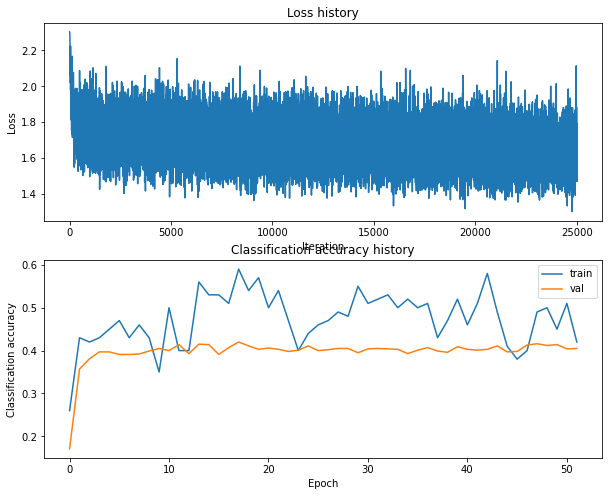

Training network with h_s 175, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.303230
iteration 100 / 25000: loss 2.299576
iteration 200 / 25000: loss 2.246206
iteration 300 / 25000: loss 2.178008
iteration 400 / 25000: loss 2.063619
iteration 500 / 25000: loss 2.021347
iteration 600 / 25000: loss 2.109349
iteration 700 / 25000: loss 1.919767
iteration 800 / 25000: loss 1.835353
iteration 900 / 25000: loss 1.899033
iteration 1000 / 25000: loss 1.881721
iteration 1100 / 25000: loss 1.915970
iteration 1200 / 25000: loss 1.789147
iteration 1300 / 25000: loss 1.962275
iteration 1400 / 25000: loss 1.897191
iteration 1500 / 25000: loss 1.891522
iteration 1600 / 25000: loss 1.806029
iteration 1700 / 25000: loss 1.851420
iteration 1800 / 25000: loss 1.816509
iteration 1900 / 25000: loss 1.836664
iteration 2000 / 25000: loss 1.847386
iteration 2100 / 25000: loss 1.715558
iteration 2200 / 25000: loss 1.757799
iteration 2300 / 25000: loss 1.811892
iteration 2400 / 25000: loss 1.821836


iteration 21200 / 25000: loss 1.625951
iteration 21300 / 25000: loss 1.732373
iteration 21400 / 25000: loss 1.737336
iteration 21500 / 25000: loss 1.715291
iteration 21600 / 25000: loss 1.524175
iteration 21700 / 25000: loss 1.721686
iteration 21800 / 25000: loss 1.672948
iteration 21900 / 25000: loss 1.591998
iteration 22000 / 25000: loss 1.714872
iteration 22100 / 25000: loss 1.639278
iteration 22200 / 25000: loss 1.716615
iteration 22300 / 25000: loss 1.597442
iteration 22400 / 25000: loss 1.727377
iteration 22500 / 25000: loss 1.668678
iteration 22600 / 25000: loss 1.926488
iteration 22700 / 25000: loss 1.744339
iteration 22800 / 25000: loss 1.649130
iteration 22900 / 25000: loss 1.674974
iteration 23000 / 25000: loss 1.721983
iteration 23100 / 25000: loss 1.677241
iteration 23200 / 25000: loss 1.733634
iteration 23300 / 25000: loss 1.763526
iteration 23400 / 25000: loss 1.748659
iteration 23500 / 25000: loss 1.705998
iteration 23600 / 25000: loss 1.665321
iteration 23700 / 25000: 

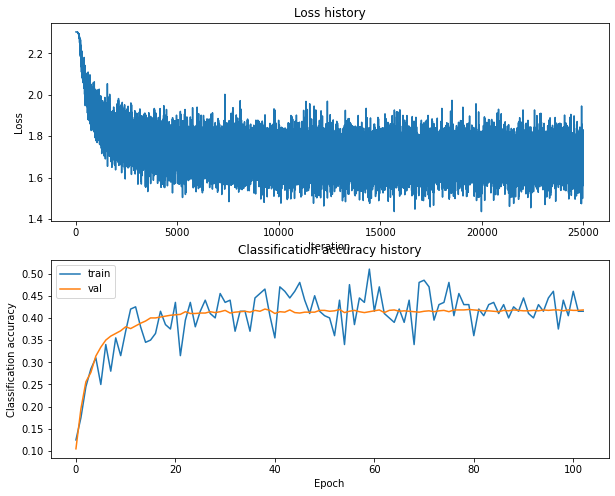

Training network with h_s 175, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.303259
iteration 100 / 25000: loss 1.913759
iteration 200 / 25000: loss 1.729707
iteration 300 / 25000: loss 1.868667
iteration 400 / 25000: loss 1.843272
iteration 500 / 25000: loss 1.666129
iteration 600 / 25000: loss 1.666378
iteration 700 / 25000: loss 1.582034
iteration 800 / 25000: loss 1.703485
iteration 900 / 25000: loss 1.745002
iteration 1000 / 25000: loss 1.745030
iteration 1100 / 25000: loss 1.820911
iteration 1200 / 25000: loss 1.635238
iteration 1300 / 25000: loss 1.704190
iteration 1400 / 25000: loss 1.640634
iteration 1500 / 25000: loss 1.601574
iteration 1600 / 25000: loss 1.766487
iteration 1700 / 25000: loss 1.720087
iteration 1800 / 25000: loss 1.774055
iteration 1900 / 25000: loss 1.598698
iteration 2000 / 25000: loss 1.708535
iteration 2100 / 25000: loss 1.724410
iteration 2200 / 25000: loss 1.777296
iteration 2300 / 25000: loss 1.673946
iteration 2400 / 25000: loss 1.689267
i

iteration 21200 / 25000: loss 1.665396
iteration 21300 / 25000: loss 1.645647
iteration 21400 / 25000: loss 1.514673
iteration 21500 / 25000: loss 1.700631
iteration 21600 / 25000: loss 1.754234
iteration 21700 / 25000: loss 1.592661
iteration 21800 / 25000: loss 1.667379
iteration 21900 / 25000: loss 1.677722
iteration 22000 / 25000: loss 1.557125
iteration 22100 / 25000: loss 1.662091
iteration 22200 / 25000: loss 1.719022
iteration 22300 / 25000: loss 1.564698
iteration 22400 / 25000: loss 1.492533
iteration 22500 / 25000: loss 1.642661
iteration 22600 / 25000: loss 1.560050
iteration 22700 / 25000: loss 1.658578
iteration 22800 / 25000: loss 1.685338
iteration 22900 / 25000: loss 1.623363
iteration 23000 / 25000: loss 1.653863
iteration 23100 / 25000: loss 1.689277
iteration 23200 / 25000: loss 1.610605
iteration 23300 / 25000: loss 1.576317
iteration 23400 / 25000: loss 1.518222
iteration 23500 / 25000: loss 1.593943
iteration 23600 / 25000: loss 1.593445
iteration 23700 / 25000: 

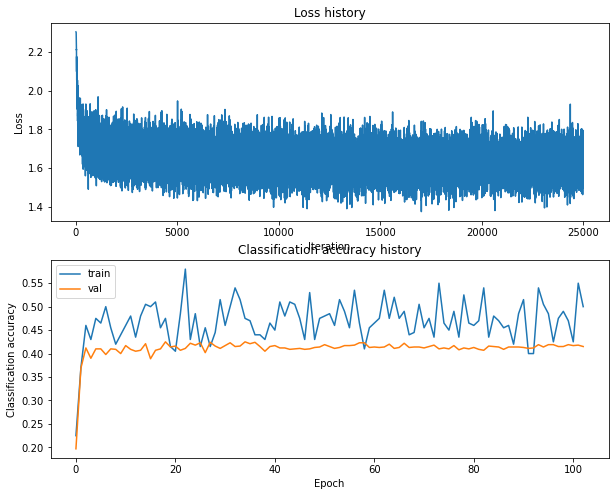

Training network with h_s 175, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.303289
iteration 100 / 25000: loss 2.299787
iteration 200 / 25000: loss 2.248158
iteration 300 / 25000: loss 2.220757
iteration 400 / 25000: loss 2.047548
iteration 500 / 25000: loss 1.995054
iteration 600 / 25000: loss 1.973466
iteration 700 / 25000: loss 1.935969
iteration 800 / 25000: loss 1.975169
iteration 900 / 25000: loss 1.866917
iteration 1000 / 25000: loss 1.929028
iteration 1100 / 25000: loss 1.877165
iteration 1200 / 25000: loss 1.921499
iteration 1300 / 25000: loss 1.844860
iteration 1400 / 25000: loss 1.764357
iteration 1500 / 25000: loss 1.885579
iteration 1600 / 25000: loss 1.820007
iteration 1700 / 25000: loss 1.818669
iteration 1800 / 25000: loss 1.751907
iteration 1900 / 25000: loss 1.815821
iteration 2000 / 25000: loss 1.737708
iteration 2100 / 25000: loss 1.719654
iteration 2200 / 25000: loss 1.698712
iteration 2300 / 25000: loss 1.807500
iteration 2400 / 25000: loss 1.830018


iteration 21200 / 25000: loss 1.758400
iteration 21300 / 25000: loss 1.734258
iteration 21400 / 25000: loss 1.716344
iteration 21500 / 25000: loss 1.657484
iteration 21600 / 25000: loss 1.849981
iteration 21700 / 25000: loss 1.699551
iteration 21800 / 25000: loss 1.671707
iteration 21900 / 25000: loss 1.720618
iteration 22000 / 25000: loss 1.830322
iteration 22100 / 25000: loss 1.666273
iteration 22200 / 25000: loss 1.680836
iteration 22300 / 25000: loss 1.698692
iteration 22400 / 25000: loss 1.740338
iteration 22500 / 25000: loss 1.661948
iteration 22600 / 25000: loss 1.740495
iteration 22700 / 25000: loss 1.739753
iteration 22800 / 25000: loss 1.760282
iteration 22900 / 25000: loss 1.708642
iteration 23000 / 25000: loss 1.634876
iteration 23100 / 25000: loss 1.698724
iteration 23200 / 25000: loss 1.703110
iteration 23300 / 25000: loss 1.770513
iteration 23400 / 25000: loss 1.697319
iteration 23500 / 25000: loss 1.638360
iteration 23600 / 25000: loss 1.619182
iteration 23700 / 25000: 

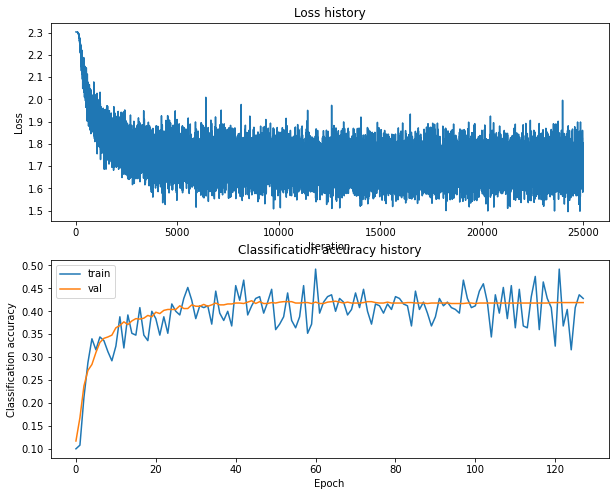

Training network with h_s 175, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.303220
iteration 100 / 25000: loss 1.980089
iteration 200 / 25000: loss 1.834123
iteration 300 / 25000: loss 1.679284
iteration 400 / 25000: loss 1.783991
iteration 500 / 25000: loss 1.749384
iteration 600 / 25000: loss 1.729288
iteration 700 / 25000: loss 1.704982
iteration 800 / 25000: loss 1.657620
iteration 900 / 25000: loss 1.655642
iteration 1000 / 25000: loss 1.748285
iteration 1100 / 25000: loss 1.676073
iteration 1200 / 25000: loss 1.676629
iteration 1300 / 25000: loss 1.699278
iteration 1400 / 25000: loss 1.615420
iteration 1500 / 25000: loss 1.793968
iteration 1600 / 25000: loss 1.744744
iteration 1700 / 25000: loss 1.635131
iteration 1800 / 25000: loss 1.623150
iteration 1900 / 25000: loss 1.761292
iteration 2000 / 25000: loss 1.725472
iteration 2100 / 25000: loss 1.638639
iteration 2200 / 25000: loss 1.654075
iteration 2300 / 25000: loss 1.729090
iteration 2400 / 25000: loss 1.534276
i

iteration 21200 / 25000: loss 1.664372
iteration 21300 / 25000: loss 1.605627
iteration 21400 / 25000: loss 1.667245
iteration 21500 / 25000: loss 1.623579
iteration 21600 / 25000: loss 1.696568
iteration 21700 / 25000: loss 1.618529
iteration 21800 / 25000: loss 1.520499
iteration 21900 / 25000: loss 1.635744
iteration 22000 / 25000: loss 1.677045
iteration 22100 / 25000: loss 1.544901
iteration 22200 / 25000: loss 1.642248
iteration 22300 / 25000: loss 1.675484
iteration 22400 / 25000: loss 1.629613
iteration 22500 / 25000: loss 1.492243
iteration 22600 / 25000: loss 1.523145
iteration 22700 / 25000: loss 1.667639
iteration 22800 / 25000: loss 1.618715
iteration 22900 / 25000: loss 1.691760
iteration 23000 / 25000: loss 1.612086
iteration 23100 / 25000: loss 1.647439
iteration 23200 / 25000: loss 1.703947
iteration 23300 / 25000: loss 1.683867
iteration 23400 / 25000: loss 1.659313
iteration 23500 / 25000: loss 1.709546
iteration 23600 / 25000: loss 1.693569
iteration 23700 / 25000: 

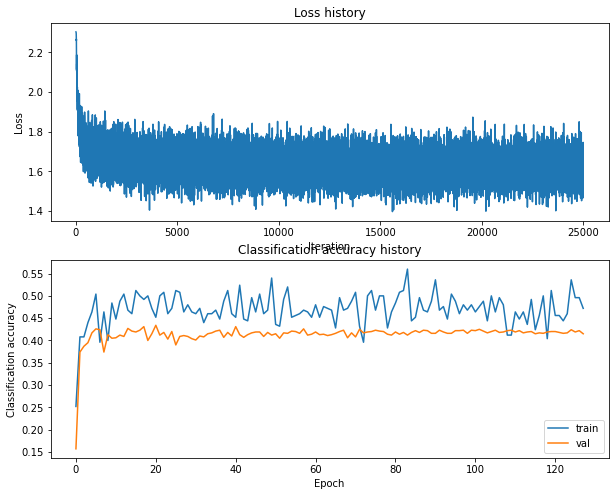

Training network with h_s 175, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.303258
iteration 100 / 25000: loss 2.298630
iteration 200 / 25000: loss 2.243526
iteration 300 / 25000: loss 2.173631
iteration 400 / 25000: loss 2.094058
iteration 500 / 25000: loss 2.031434
iteration 600 / 25000: loss 1.975545
iteration 700 / 25000: loss 1.972703
iteration 800 / 25000: loss 1.897762
iteration 900 / 25000: loss 1.903208
iteration 1000 / 25000: loss 1.873474
iteration 1100 / 25000: loss 1.950838
iteration 1200 / 25000: loss 1.883026
iteration 1300 / 25000: loss 1.843289
iteration 1400 / 25000: loss 1.871999
iteration 1500 / 25000: loss 1.888696
iteration 1600 / 25000: loss 1.804435
iteration 1700 / 25000: loss 1.826244
iteration 1800 / 25000: loss 1.791064
iteration 1900 / 25000: loss 1.723907
iteration 2000 / 25000: loss 1.763206
iteration 2100 / 25000: loss 1.901125
iteration 2200 / 25000: loss 1.678045
iteration 2300 / 25000: loss 1.805453
iteration 2400 / 25000: loss 1.769247


iteration 21200 / 25000: loss 1.734956
iteration 21300 / 25000: loss 1.515397
iteration 21400 / 25000: loss 1.706773
iteration 21500 / 25000: loss 1.599627
iteration 21600 / 25000: loss 1.727221
iteration 21700 / 25000: loss 1.645282
iteration 21800 / 25000: loss 1.600256
iteration 21900 / 25000: loss 1.542987
iteration 22000 / 25000: loss 1.564516
iteration 22100 / 25000: loss 1.583187
iteration 22200 / 25000: loss 1.554591
iteration 22300 / 25000: loss 1.602718
iteration 22400 / 25000: loss 1.543319
iteration 22500 / 25000: loss 1.498386
iteration 22600 / 25000: loss 1.628099
iteration 22700 / 25000: loss 1.589596
iteration 22800 / 25000: loss 1.641231
iteration 22900 / 25000: loss 1.714520
iteration 23000 / 25000: loss 1.550155
iteration 23100 / 25000: loss 1.588011
iteration 23200 / 25000: loss 1.632268
iteration 23300 / 25000: loss 1.583320
iteration 23400 / 25000: loss 1.592271
iteration 23500 / 25000: loss 1.700886
iteration 23600 / 25000: loss 1.545955
iteration 23700 / 25000: 

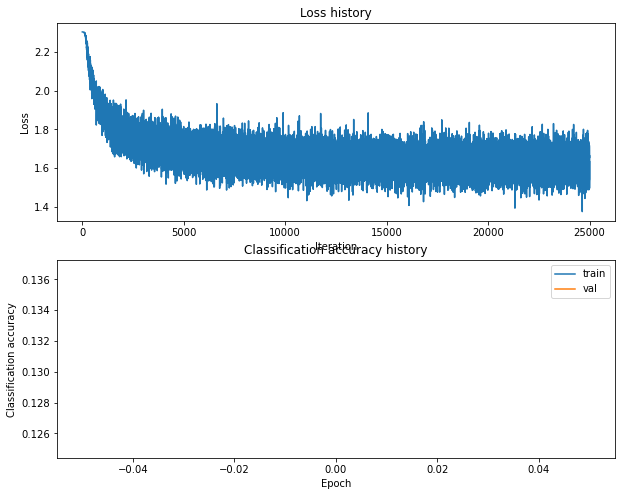

Training network with h_s 175, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.303282
iteration 100 / 25000: loss 1.923283
iteration 200 / 25000: loss 1.811847
iteration 300 / 25000: loss 1.752544
iteration 400 / 25000: loss 1.705335
iteration 500 / 25000: loss 1.628798
iteration 600 / 25000: loss 1.615637
iteration 700 / 25000: loss 1.721057
iteration 800 / 25000: loss 1.700862
iteration 900 / 25000: loss 1.709874
iteration 1000 / 25000: loss 1.634544
iteration 1100 / 25000: loss 1.698891
iteration 1200 / 25000: loss 1.659269
iteration 1300 / 25000: loss 1.656270
iteration 1400 / 25000: loss 1.695526
iteration 1500 / 25000: loss 1.713076
iteration 1600 / 25000: loss 1.649390
iteration 1700 / 25000: loss 1.731003
iteration 1800 / 25000: loss 1.759983
iteration 1900 / 25000: loss 1.531882
iteration 2000 / 25000: loss 1.678384
iteration 2100 / 25000: loss 1.737694
iteration 2200 / 25000: loss 1.711002
iteration 2300 / 25000: loss 1.686888
iteration 2400 / 25000: loss 1.665616
i

iteration 21200 / 25000: loss 1.699010
iteration 21300 / 25000: loss 1.641282
iteration 21400 / 25000: loss 1.709524
iteration 21500 / 25000: loss 1.666761
iteration 21600 / 25000: loss 1.730476
iteration 21700 / 25000: loss 1.733264
iteration 21800 / 25000: loss 1.737167
iteration 21900 / 25000: loss 1.680221
iteration 22000 / 25000: loss 1.715661
iteration 22100 / 25000: loss 1.593381
iteration 22200 / 25000: loss 1.695985
iteration 22300 / 25000: loss 1.697065
iteration 22400 / 25000: loss 1.743406
iteration 22500 / 25000: loss 1.691099
iteration 22600 / 25000: loss 1.588215
iteration 22700 / 25000: loss 1.725749
iteration 22800 / 25000: loss 1.705393
iteration 22900 / 25000: loss 1.690210
iteration 23000 / 25000: loss 1.652831
iteration 23100 / 25000: loss 1.744633
iteration 23200 / 25000: loss 1.837369
iteration 23300 / 25000: loss 1.747560
iteration 23400 / 25000: loss 1.779159
iteration 23500 / 25000: loss 1.681819
iteration 23600 / 25000: loss 1.674948
iteration 23700 / 25000: 

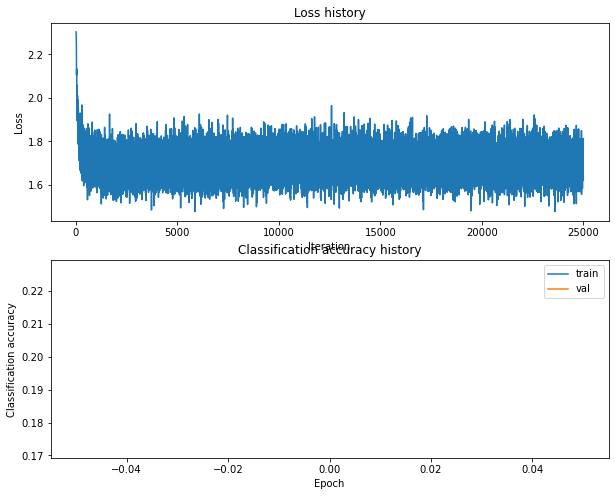

Training network with h_s 175, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.303259
iteration 100 / 25000: loss 2.299607
iteration 200 / 25000: loss 2.248553
iteration 300 / 25000: loss 2.172408
iteration 400 / 25000: loss 2.137363
iteration 500 / 25000: loss 2.052537
iteration 600 / 25000: loss 2.027033
iteration 700 / 25000: loss 1.966731
iteration 800 / 25000: loss 1.965652
iteration 900 / 25000: loss 1.916723
iteration 1000 / 25000: loss 1.943520
iteration 1100 / 25000: loss 1.914182
iteration 1200 / 25000: loss 1.908350
iteration 1300 / 25000: loss 1.897233
iteration 1400 / 25000: loss 1.880441
iteration 1500 / 25000: loss 1.821263
iteration 1600 / 25000: loss 1.907710
iteration 1700 / 25000: loss 1.832558
iteration 1800 / 25000: loss 1.799128
iteration 1900 / 25000: loss 1.793272
iteration 2000 / 25000: loss 1.801963
iteration 2100 / 25000: loss 1.793646
iteration 2200 / 25000: loss 1.893049
iteration 2300 / 25000: loss 1.835757
iteration 2400 / 25000: loss 1.869151


iteration 21200 / 25000: loss 1.784671
iteration 21300 / 25000: loss 1.741859
iteration 21400 / 25000: loss 1.750279
iteration 21500 / 25000: loss 1.777246
iteration 21600 / 25000: loss 1.853675
iteration 21700 / 25000: loss 1.730920
iteration 21800 / 25000: loss 1.812938
iteration 21900 / 25000: loss 1.807529
iteration 22000 / 25000: loss 1.754024
iteration 22100 / 25000: loss 1.731594
iteration 22200 / 25000: loss 1.762628
iteration 22300 / 25000: loss 1.748695
iteration 22400 / 25000: loss 1.766615
iteration 22500 / 25000: loss 1.854127
iteration 22600 / 25000: loss 1.774655
iteration 22700 / 25000: loss 1.805839
iteration 22800 / 25000: loss 1.853666
iteration 22900 / 25000: loss 1.858237
iteration 23000 / 25000: loss 1.786573
iteration 23100 / 25000: loss 1.715844
iteration 23200 / 25000: loss 1.779460
iteration 23300 / 25000: loss 1.782257
iteration 23400 / 25000: loss 1.726604
iteration 23500 / 25000: loss 1.716650
iteration 23600 / 25000: loss 1.758949
iteration 23700 / 25000: 

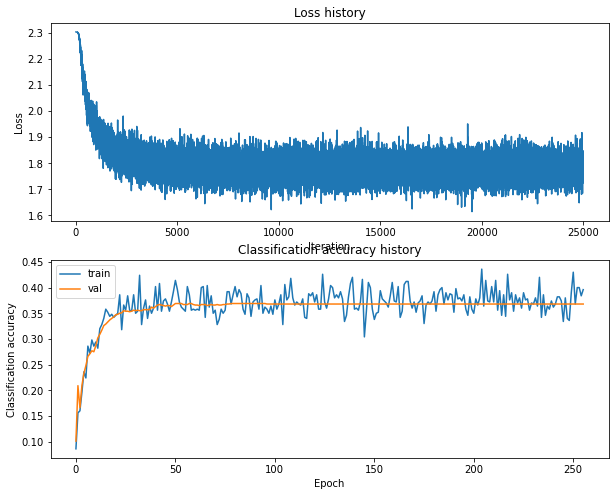

Training network with h_s 175, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.303209
iteration 100 / 25000: loss 1.862668
iteration 200 / 25000: loss 1.818351
iteration 300 / 25000: loss 1.766442
iteration 400 / 25000: loss 1.709908
iteration 500 / 25000: loss 1.699206
iteration 600 / 25000: loss 1.645901
iteration 700 / 25000: loss 1.678511
iteration 800 / 25000: loss 1.677439
iteration 900 / 25000: loss 1.632134
iteration 1000 / 25000: loss 1.677837
iteration 1100 / 25000: loss 1.690655
iteration 1200 / 25000: loss 1.654180
iteration 1300 / 25000: loss 1.700180
iteration 1400 / 25000: loss 1.617667
iteration 1500 / 25000: loss 1.637665
iteration 1600 / 25000: loss 1.635585
iteration 1700 / 25000: loss 1.670502
iteration 1800 / 25000: loss 1.674985
iteration 1900 / 25000: loss 1.688745
iteration 2000 / 25000: loss 1.646584
iteration 2100 / 25000: loss 1.595651
iteration 2200 / 25000: loss 1.627595
iteration 2300 / 25000: loss 1.681651
iteration 2400 / 25000: loss 1.681325
i

iteration 21200 / 25000: loss 1.602037
iteration 21300 / 25000: loss 1.582351
iteration 21400 / 25000: loss 1.627515
iteration 21500 / 25000: loss 1.569148
iteration 21600 / 25000: loss 1.580067
iteration 21700 / 25000: loss 1.571727
iteration 21800 / 25000: loss 1.662370
iteration 21900 / 25000: loss 1.654079
iteration 22000 / 25000: loss 1.671634
iteration 22100 / 25000: loss 1.558769
iteration 22200 / 25000: loss 1.741827
iteration 22300 / 25000: loss 1.688232
iteration 22400 / 25000: loss 1.661896
iteration 22500 / 25000: loss 1.605136
iteration 22600 / 25000: loss 1.698910
iteration 22700 / 25000: loss 1.575561
iteration 22800 / 25000: loss 1.674490
iteration 22900 / 25000: loss 1.585149
iteration 23000 / 25000: loss 1.595048
iteration 23100 / 25000: loss 1.710451
iteration 23200 / 25000: loss 1.639373
iteration 23300 / 25000: loss 1.564330
iteration 23400 / 25000: loss 1.605475
iteration 23500 / 25000: loss 1.662570
iteration 23600 / 25000: loss 1.572748
iteration 23700 / 25000: 

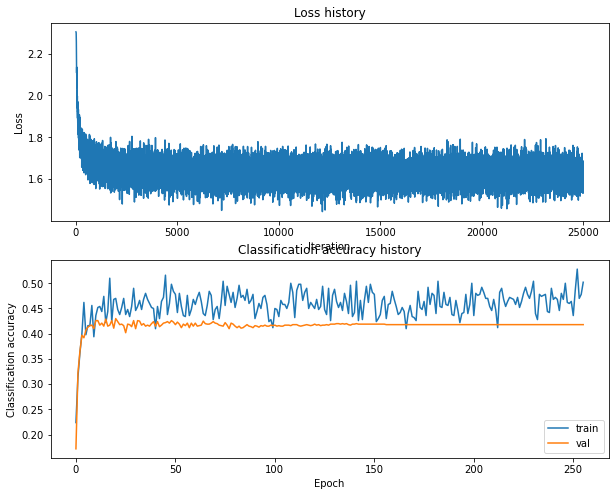

Training network with h_s 200, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.303357
iteration 100 / 500: loss 2.299557
iteration 200 / 500: loss 2.255073
iteration 300 / 500: loss 2.150663
iteration 400 / 500: loss 2.034440
Validation accuracy:  0.26


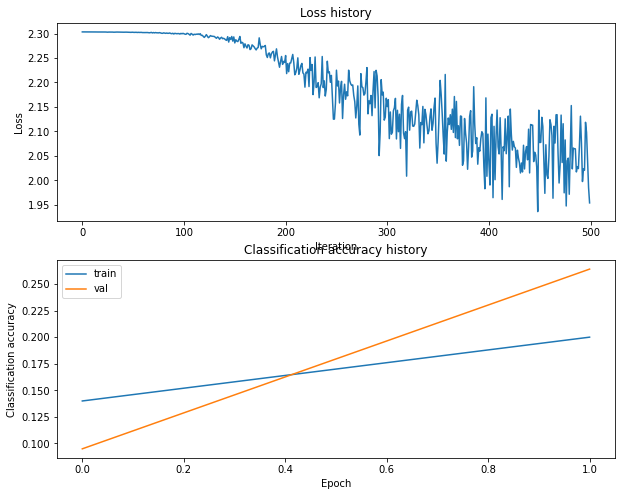

Training network with h_s 200, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.303394
iteration 100 / 500: loss 1.804869
iteration 200 / 500: loss 1.706711
iteration 300 / 500: loss 1.688669
iteration 400 / 500: loss 1.810436
Validation accuracy:  0.4


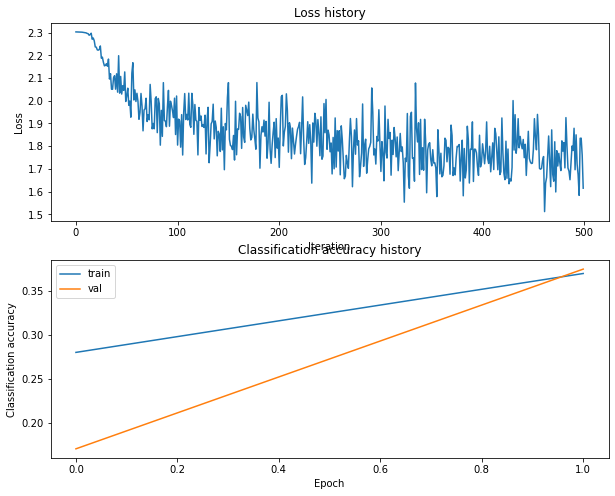

Training network with h_s 200, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.303343
iteration 100 / 500: loss 2.299607
iteration 200 / 500: loss 2.220836
iteration 300 / 500: loss 2.188823
iteration 400 / 500: loss 2.122901
Validation accuracy:  0.25


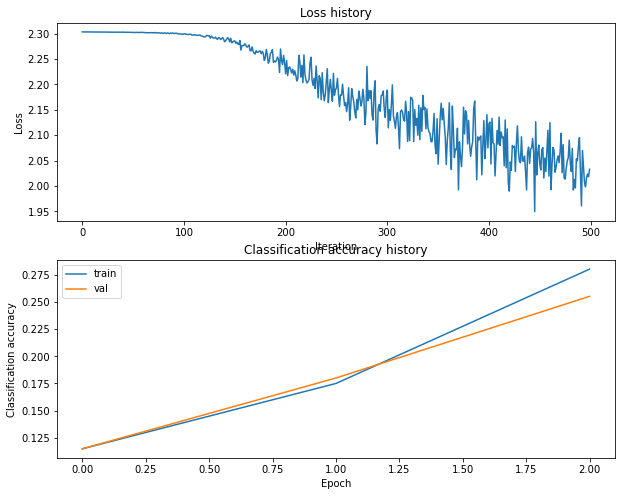

Training network with h_s 200, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.303326
iteration 100 / 500: loss 1.867599
iteration 200 / 500: loss 1.752724
iteration 300 / 500: loss 1.632517
iteration 400 / 500: loss 1.667939
Validation accuracy:  0.387


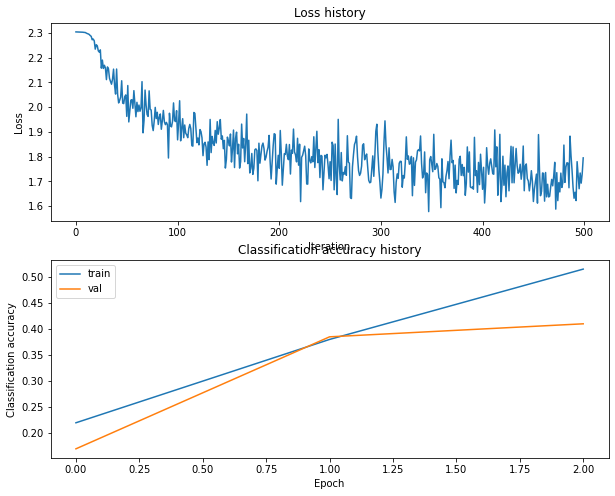

Training network with h_s 200, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.303357
iteration 100 / 500: loss 2.298783
iteration 200 / 500: loss 2.225189
iteration 300 / 500: loss 2.116912
iteration 400 / 500: loss 2.086261
Validation accuracy:  0.255


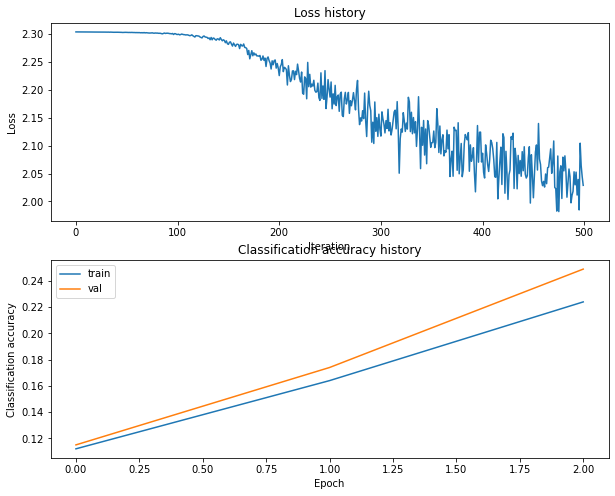

Training network with h_s 200, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.303349
iteration 100 / 500: loss 1.915651
iteration 200 / 500: loss 1.707585
iteration 300 / 500: loss 1.826670
iteration 400 / 500: loss 1.742273
Validation accuracy:  0.398


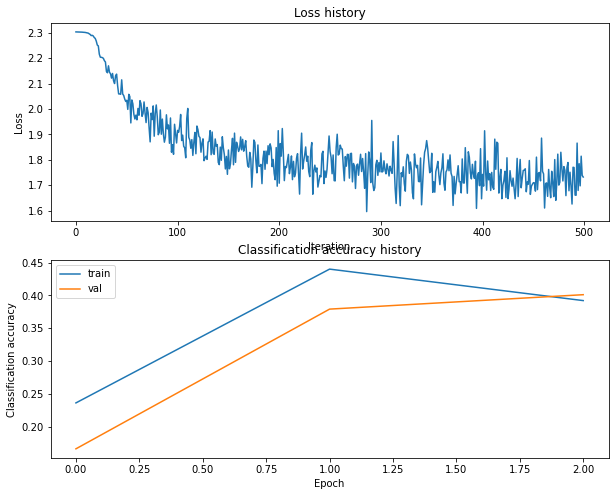

Training network with h_s 200, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.303430
iteration 100 / 500: loss 2.300045
iteration 200 / 500: loss 2.238049
iteration 300 / 500: loss 2.199990
iteration 400 / 500: loss 2.088093
Validation accuracy:  0.26


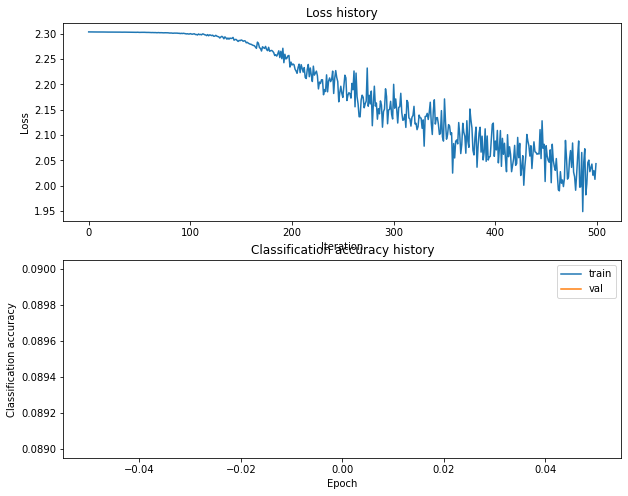

Training network with h_s 200, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.303369
iteration 100 / 500: loss 1.918198
iteration 200 / 500: loss 1.774794
iteration 300 / 500: loss 1.791367
iteration 400 / 500: loss 1.682138
Validation accuracy:  0.387


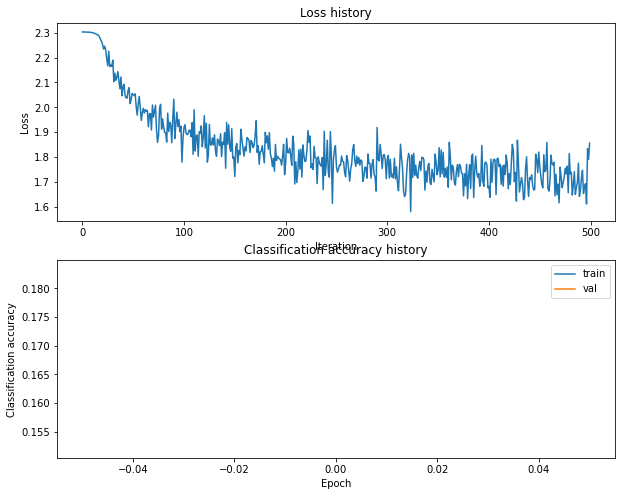

Training network with h_s 200, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.303389
iteration 100 / 500: loss 2.300032
iteration 200 / 500: loss 2.248353
iteration 300 / 500: loss 2.156181
iteration 400 / 500: loss 2.116271
Validation accuracy:  0.255


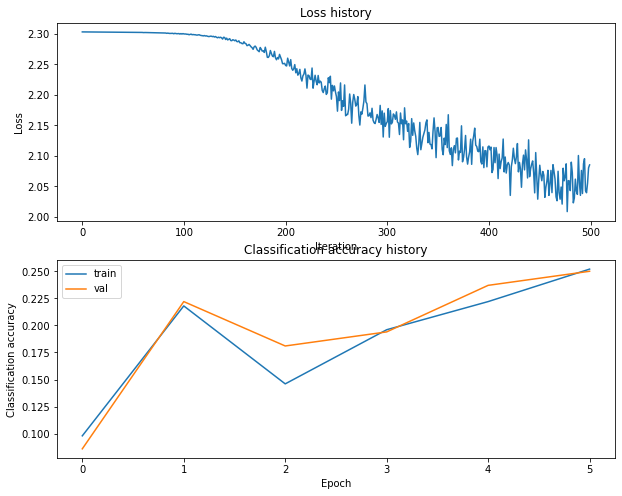

Training network with h_s 200, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.303385
iteration 100 / 500: loss 1.883280
iteration 200 / 500: loss 1.777383
iteration 300 / 500: loss 1.713261
iteration 400 / 500: loss 1.765487
Validation accuracy:  0.409


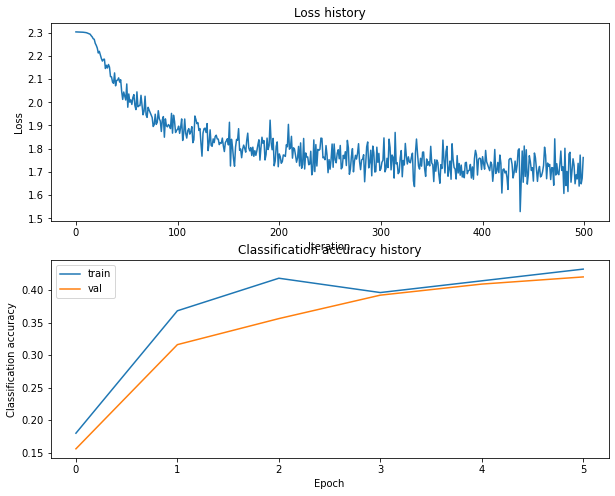

Training network with h_s 200, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.303305
iteration 100 / 1000: loss 2.300632
iteration 200 / 1000: loss 2.260345
iteration 300 / 1000: loss 2.140315
iteration 400 / 1000: loss 2.151842
iteration 500 / 1000: loss 2.156323
iteration 600 / 1000: loss 2.083597
iteration 700 / 1000: loss 1.962100
iteration 800 / 1000: loss 1.948576
iteration 900 / 1000: loss 2.134697
Validation accuracy:  0.324


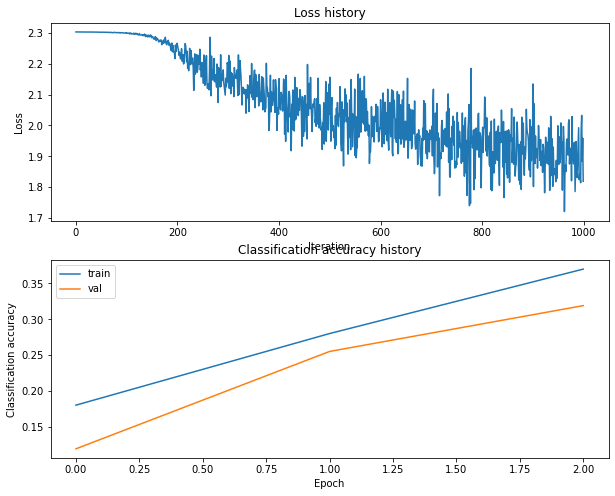

Training network with h_s 200, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.303377
iteration 100 / 1000: loss 1.971818
iteration 200 / 1000: loss 1.858420
iteration 300 / 1000: loss 1.960445
iteration 400 / 1000: loss 1.704496
iteration 500 / 1000: loss 1.826584
iteration 600 / 1000: loss 1.926645
iteration 700 / 1000: loss 1.851862
iteration 800 / 1000: loss 1.628586
iteration 900 / 1000: loss 1.579334
Validation accuracy:  0.401


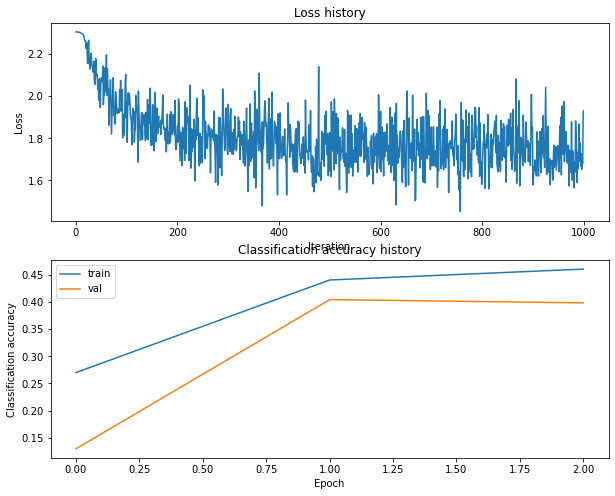

Training network with h_s 200, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.303378
iteration 100 / 1000: loss 2.298204
iteration 200 / 1000: loss 2.228484
iteration 300 / 1000: loss 2.150715
iteration 400 / 1000: loss 2.075180
iteration 500 / 1000: loss 1.996001
iteration 600 / 1000: loss 2.006881
iteration 700 / 1000: loss 1.933419
iteration 800 / 1000: loss 1.871374
iteration 900 / 1000: loss 1.989556
Validation accuracy:  0.318


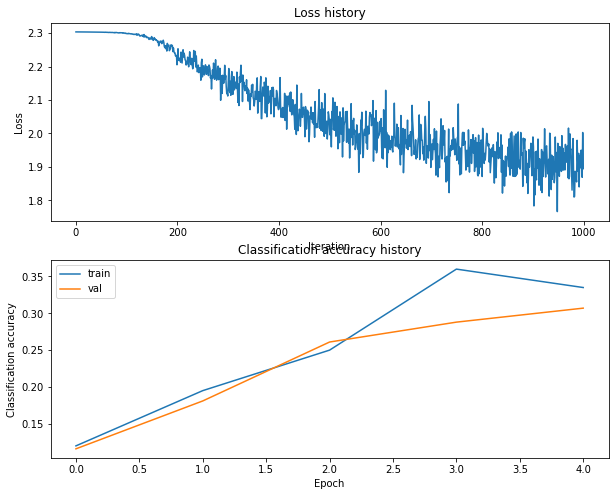

Training network with h_s 200, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.303394
iteration 100 / 1000: loss 1.881378
iteration 200 / 1000: loss 1.939714
iteration 300 / 1000: loss 1.819391
iteration 400 / 1000: loss 1.779317
iteration 500 / 1000: loss 1.756530
iteration 600 / 1000: loss 1.764733
iteration 700 / 1000: loss 1.773085
iteration 800 / 1000: loss 1.808876
iteration 900 / 1000: loss 1.786864
Validation accuracy:  0.4


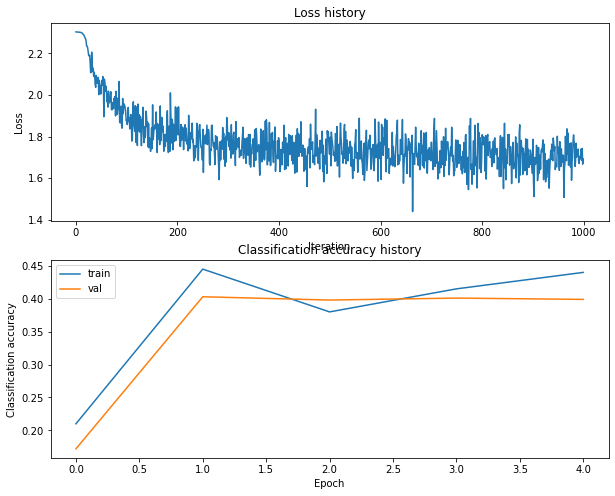

Training network with h_s 200, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.303351
iteration 100 / 1000: loss 2.299810
iteration 200 / 1000: loss 2.256914
iteration 300 / 1000: loss 2.169298
iteration 400 / 1000: loss 2.121851
iteration 500 / 1000: loss 2.042026
iteration 600 / 1000: loss 2.015068
iteration 700 / 1000: loss 1.989070
iteration 800 / 1000: loss 2.027762
iteration 900 / 1000: loss 1.879635
Validation accuracy:  0.317


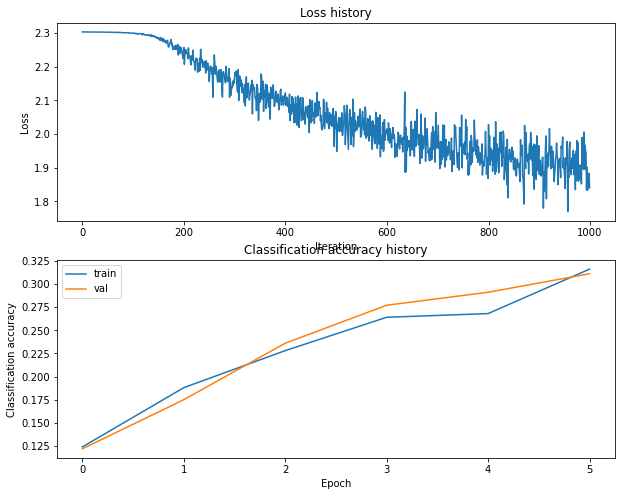

Training network with h_s 200, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.303349
iteration 100 / 1000: loss 1.834256
iteration 200 / 1000: loss 1.859357
iteration 300 / 1000: loss 1.780917
iteration 400 / 1000: loss 1.787819
iteration 500 / 1000: loss 1.735809
iteration 600 / 1000: loss 1.665057
iteration 700 / 1000: loss 1.671444
iteration 800 / 1000: loss 1.596235
iteration 900 / 1000: loss 1.666843
Validation accuracy:  0.41


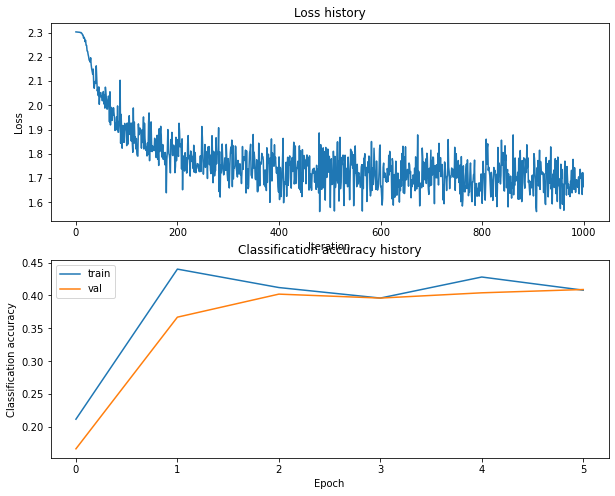

Training network with h_s 200, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.303350
iteration 100 / 1000: loss 2.300563
iteration 200 / 1000: loss 2.250220
iteration 300 / 1000: loss 2.141223
iteration 400 / 1000: loss 2.101065
iteration 500 / 1000: loss 2.046830
iteration 600 / 1000: loss 2.056171
iteration 700 / 1000: loss 1.977675
iteration 800 / 1000: loss 1.956007
iteration 900 / 1000: loss 1.896684
Validation accuracy:  0.327


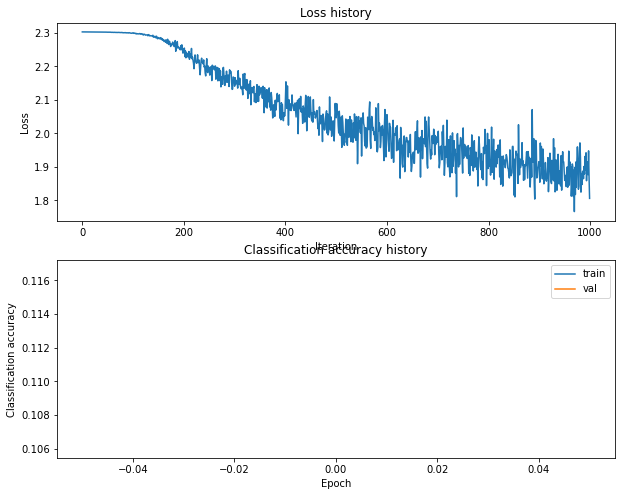

Training network with h_s 200, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.303347
iteration 100 / 1000: loss 1.905296
iteration 200 / 1000: loss 1.741286
iteration 300 / 1000: loss 1.810102
iteration 400 / 1000: loss 1.762464
iteration 500 / 1000: loss 1.768827
iteration 600 / 1000: loss 1.599071
iteration 700 / 1000: loss 1.666223
iteration 800 / 1000: loss 1.719917
iteration 900 / 1000: loss 1.653289
Validation accuracy:  0.414


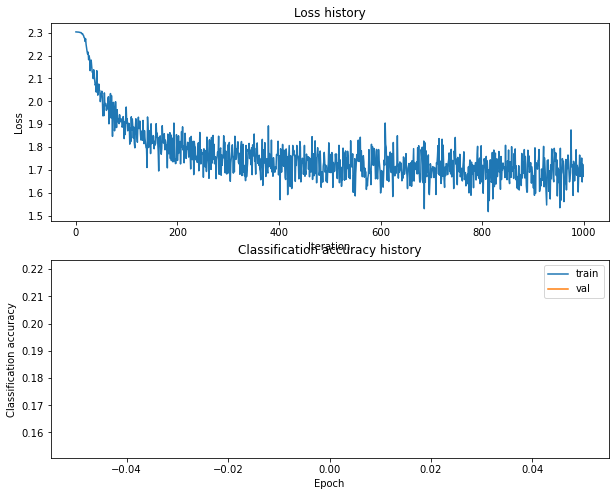

Training network with h_s 200, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.303359
iteration 100 / 1000: loss 2.299073
iteration 200 / 1000: loss 2.243611
iteration 300 / 1000: loss 2.173582
iteration 400 / 1000: loss 2.106754
iteration 500 / 1000: loss 2.061055
iteration 600 / 1000: loss 1.982432
iteration 700 / 1000: loss 1.977480
iteration 800 / 1000: loss 1.984438
iteration 900 / 1000: loss 1.940235
Validation accuracy:  0.292


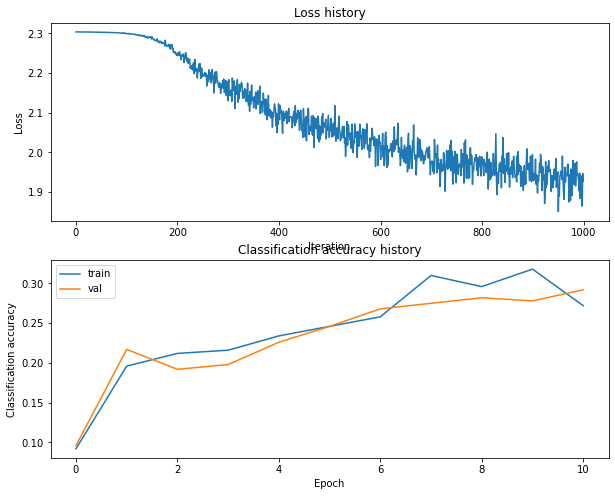

Training network with h_s 200, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.303364
iteration 100 / 1000: loss 1.895654
iteration 200 / 1000: loss 1.776964
iteration 300 / 1000: loss 1.693911
iteration 400 / 1000: loss 1.713672
iteration 500 / 1000: loss 1.671072
iteration 600 / 1000: loss 1.710382
iteration 700 / 1000: loss 1.678219
iteration 800 / 1000: loss 1.629361
iteration 900 / 1000: loss 1.672204
Validation accuracy:  0.406


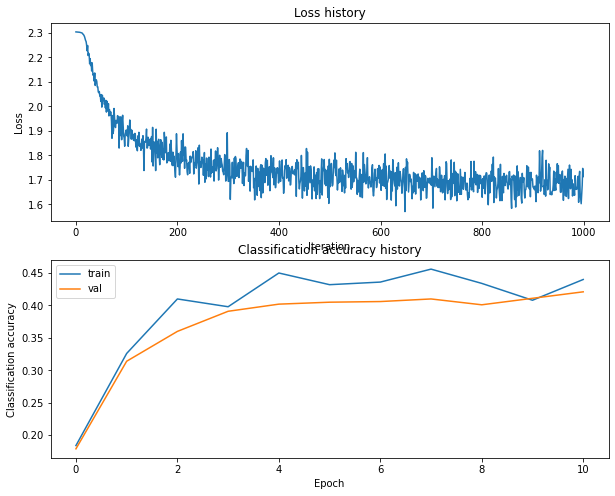

Training network with h_s 200, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.303339
iteration 100 / 1500: loss 2.300008
iteration 200 / 1500: loss 2.255053
iteration 300 / 1500: loss 2.182261
iteration 400 / 1500: loss 2.061506
iteration 500 / 1500: loss 1.987199
iteration 600 / 1500: loss 1.977607
iteration 700 / 1500: loss 1.982348
iteration 800 / 1500: loss 1.964593
iteration 900 / 1500: loss 1.849564
iteration 1000 / 1500: loss 1.933111
iteration 1100 / 1500: loss 1.983660
iteration 1200 / 1500: loss 1.959981
iteration 1300 / 1500: loss 1.916882
iteration 1400 / 1500: loss 1.740665
Validation accuracy:  0.356


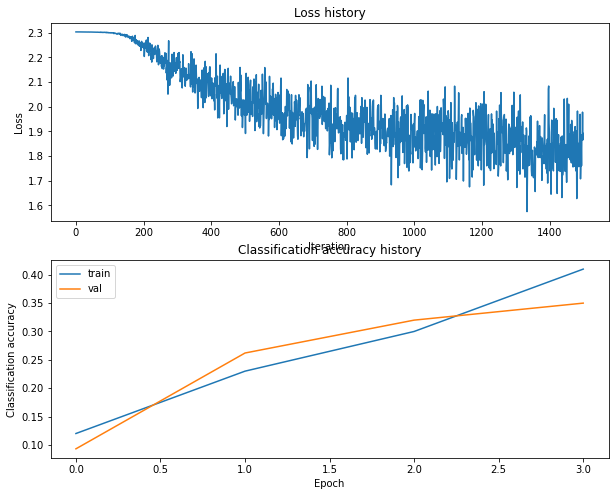

Training network with h_s 200, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.303368
iteration 100 / 1500: loss 1.841682
iteration 200 / 1500: loss 1.867451
iteration 300 / 1500: loss 2.054834
iteration 400 / 1500: loss 1.744325
iteration 500 / 1500: loss 1.810901
iteration 600 / 1500: loss 1.654624
iteration 700 / 1500: loss 1.758505
iteration 800 / 1500: loss 1.668941
iteration 900 / 1500: loss 1.620523
iteration 1000 / 1500: loss 1.731747
iteration 1100 / 1500: loss 1.781197
iteration 1200 / 1500: loss 1.722875
iteration 1300 / 1500: loss 1.583530
iteration 1400 / 1500: loss 1.694520
Validation accuracy:  0.399


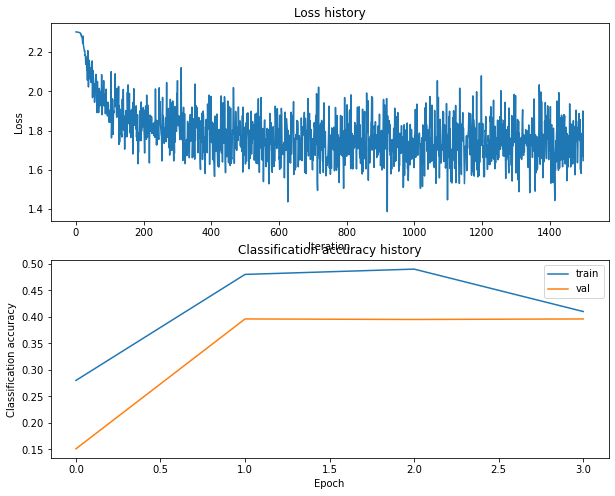

Training network with h_s 200, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.303319
iteration 100 / 1500: loss 2.298062
iteration 200 / 1500: loss 2.233499
iteration 300 / 1500: loss 2.141190
iteration 400 / 1500: loss 2.069140
iteration 500 / 1500: loss 2.120213
iteration 600 / 1500: loss 1.954119
iteration 700 / 1500: loss 1.945413
iteration 800 / 1500: loss 1.937017
iteration 900 / 1500: loss 2.051174
iteration 1000 / 1500: loss 1.931926
iteration 1100 / 1500: loss 1.848612
iteration 1200 / 1500: loss 1.875595
iteration 1300 / 1500: loss 1.825041
iteration 1400 / 1500: loss 1.783028
Validation accuracy:  0.351


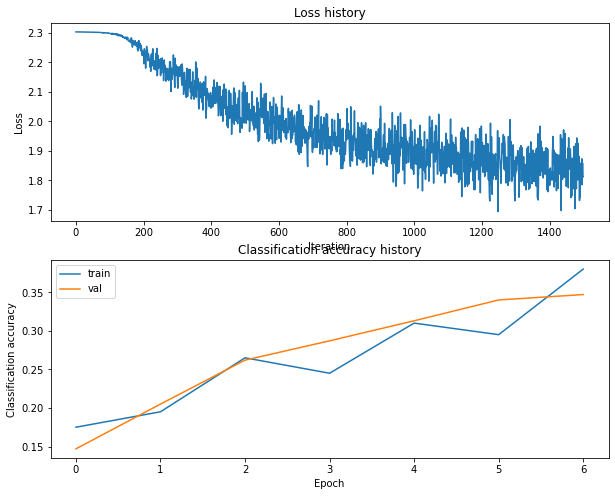

Training network with h_s 200, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.303323
iteration 100 / 1500: loss 1.987303
iteration 200 / 1500: loss 1.721141
iteration 300 / 1500: loss 1.815028
iteration 400 / 1500: loss 1.805266
iteration 500 / 1500: loss 1.735415
iteration 600 / 1500: loss 1.794617
iteration 700 / 1500: loss 1.708655
iteration 800 / 1500: loss 1.694786
iteration 900 / 1500: loss 1.694373
iteration 1000 / 1500: loss 1.753735
iteration 1100 / 1500: loss 1.703816
iteration 1200 / 1500: loss 1.805393
iteration 1300 / 1500: loss 1.682274
iteration 1400 / 1500: loss 1.780784
Validation accuracy:  0.408


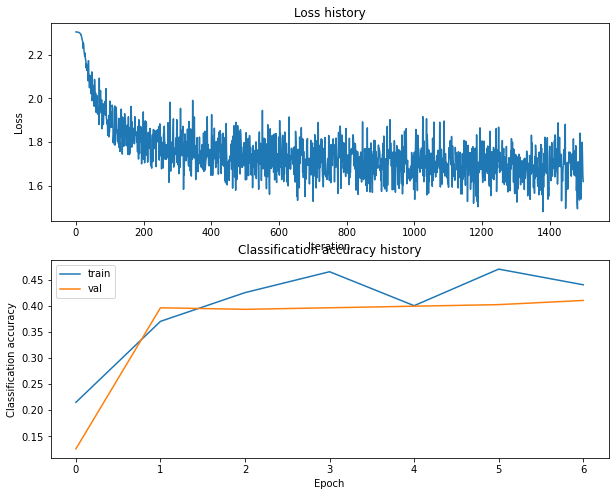

Training network with h_s 200, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.303338
iteration 100 / 1500: loss 2.299401
iteration 200 / 1500: loss 2.252165
iteration 300 / 1500: loss 2.143419
iteration 400 / 1500: loss 2.108986
iteration 500 / 1500: loss 2.073199
iteration 600 / 1500: loss 2.036667
iteration 700 / 1500: loss 1.922205
iteration 800 / 1500: loss 1.996277
iteration 900 / 1500: loss 2.021232
iteration 1000 / 1500: loss 1.926802
iteration 1100 / 1500: loss 1.817401
iteration 1200 / 1500: loss 1.878574
iteration 1300 / 1500: loss 1.886755
iteration 1400 / 1500: loss 1.786222
Validation accuracy:  0.344


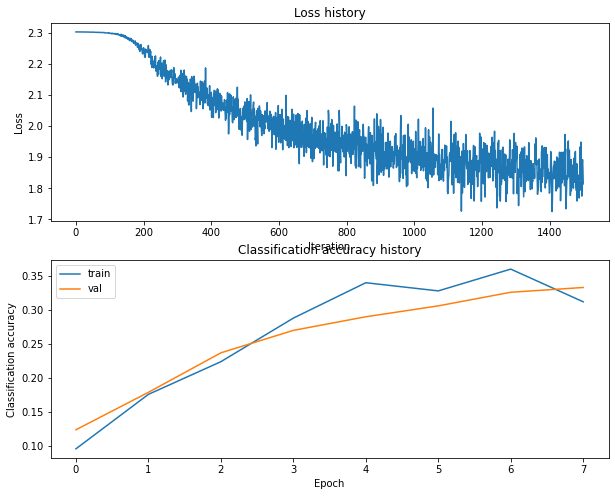

Training network with h_s 200, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.303353
iteration 100 / 1500: loss 1.833475
iteration 200 / 1500: loss 1.849078
iteration 300 / 1500: loss 1.619567
iteration 400 / 1500: loss 1.672234
iteration 500 / 1500: loss 1.657598
iteration 600 / 1500: loss 1.649164
iteration 700 / 1500: loss 1.619391
iteration 800 / 1500: loss 1.652640
iteration 900 / 1500: loss 1.695757
iteration 1000 / 1500: loss 1.632972
iteration 1100 / 1500: loss 1.722618
iteration 1200 / 1500: loss 1.715735
iteration 1300 / 1500: loss 1.636797
iteration 1400 / 1500: loss 1.676958
Validation accuracy:  0.426


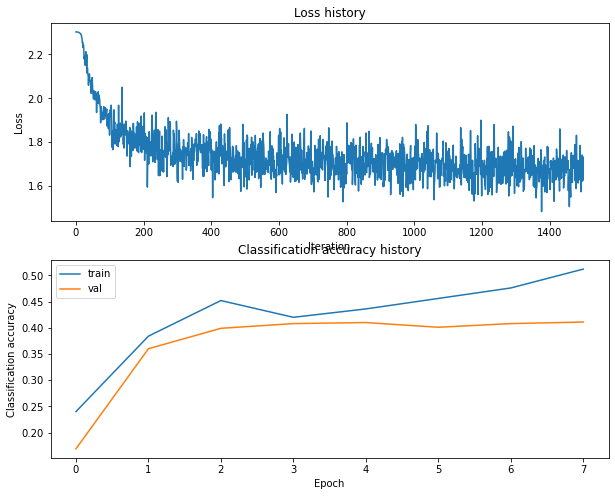

Training network with h_s 200, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.303409
iteration 100 / 1500: loss 2.299831
iteration 200 / 1500: loss 2.250607
iteration 300 / 1500: loss 2.159707
iteration 400 / 1500: loss 2.072884
iteration 500 / 1500: loss 2.052571
iteration 600 / 1500: loss 1.980232
iteration 700 / 1500: loss 1.935414
iteration 800 / 1500: loss 1.934384
iteration 900 / 1500: loss 1.918556
iteration 1000 / 1500: loss 1.915619
iteration 1100 / 1500: loss 1.875941
iteration 1200 / 1500: loss 1.852998
iteration 1300 / 1500: loss 1.921649
iteration 1400 / 1500: loss 1.805355
Validation accuracy:  0.358


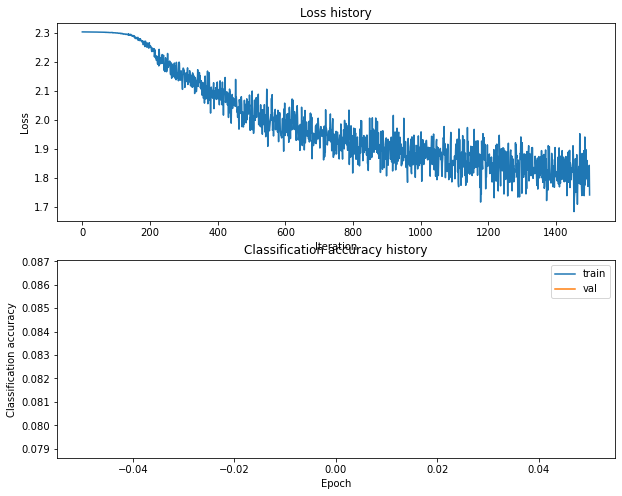

Training network with h_s 200, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.303352
iteration 100 / 1500: loss 1.880684
iteration 200 / 1500: loss 1.813882
iteration 300 / 1500: loss 1.757861
iteration 400 / 1500: loss 1.704585
iteration 500 / 1500: loss 1.707952
iteration 600 / 1500: loss 1.702005
iteration 700 / 1500: loss 1.751607
iteration 800 / 1500: loss 1.616933
iteration 900 / 1500: loss 1.648056
iteration 1000 / 1500: loss 1.704418
iteration 1100 / 1500: loss 1.605746
iteration 1200 / 1500: loss 1.690054
iteration 1300 / 1500: loss 1.703909
iteration 1400 / 1500: loss 1.715285
Validation accuracy:  0.411


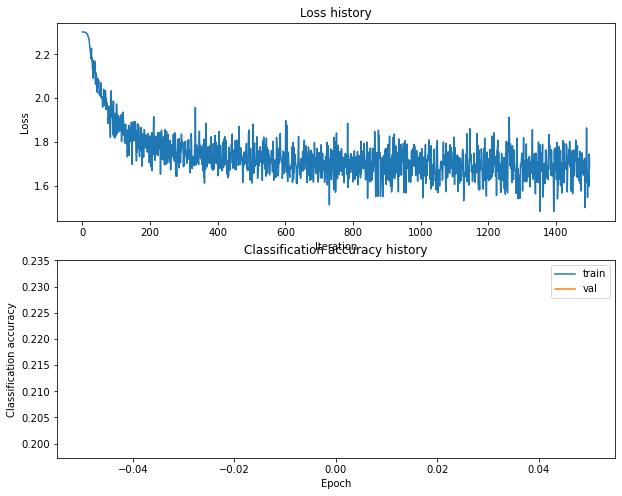

Training network with h_s 200, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.303320
iteration 100 / 1500: loss 2.298452
iteration 200 / 1500: loss 2.238214
iteration 300 / 1500: loss 2.180750
iteration 400 / 1500: loss 2.099039
iteration 500 / 1500: loss 2.012677
iteration 600 / 1500: loss 1.972745
iteration 700 / 1500: loss 1.961601
iteration 800 / 1500: loss 2.005871
iteration 900 / 1500: loss 1.936656
iteration 1000 / 1500: loss 1.933633
iteration 1100 / 1500: loss 1.898257
iteration 1200 / 1500: loss 1.849886
iteration 1300 / 1500: loss 1.892095
iteration 1400 / 1500: loss 1.849226
Validation accuracy:  0.335


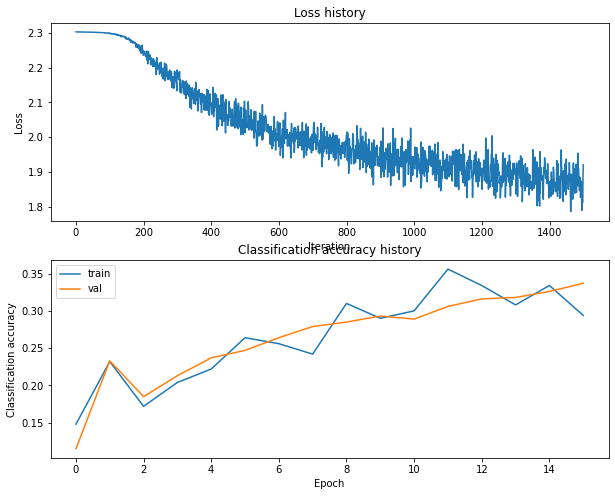

Training network with h_s 200, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.303393
iteration 100 / 1500: loss 1.886404
iteration 200 / 1500: loss 1.853845
iteration 300 / 1500: loss 1.696906
iteration 400 / 1500: loss 1.704002
iteration 500 / 1500: loss 1.695052
iteration 600 / 1500: loss 1.668108
iteration 700 / 1500: loss 1.694629
iteration 800 / 1500: loss 1.687505
iteration 900 / 1500: loss 1.641105
iteration 1000 / 1500: loss 1.659997
iteration 1100 / 1500: loss 1.554828
iteration 1200 / 1500: loss 1.679266
iteration 1300 / 1500: loss 1.688341
iteration 1400 / 1500: loss 1.620238
Validation accuracy:  0.416


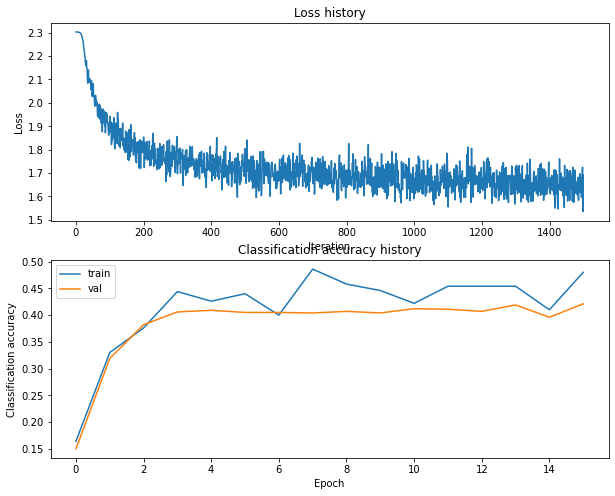

Training network with h_s 200, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.303365
iteration 100 / 2500: loss 2.298557
iteration 200 / 2500: loss 2.282845
iteration 300 / 2500: loss 2.137645
iteration 400 / 2500: loss 2.027427
iteration 500 / 2500: loss 2.078434
iteration 600 / 2500: loss 2.050433
iteration 700 / 2500: loss 2.006894
iteration 800 / 2500: loss 1.840631
iteration 900 / 2500: loss 1.872180
iteration 1000 / 2500: loss 1.844758
iteration 1100 / 2500: loss 1.881602
iteration 1200 / 2500: loss 1.863442
iteration 1300 / 2500: loss 1.772790
iteration 1400 / 2500: loss 1.834143
iteration 1500 / 2500: loss 1.779752
iteration 1600 / 2500: loss 1.766149
iteration 1700 / 2500: loss 1.881130
iteration 1800 / 2500: loss 1.993260
iteration 1900 / 2500: loss 1.842506
iteration 2000 / 2500: loss 1.693865
iteration 2100 / 2500: loss 1.748112
iteration 2200 / 2500: loss 1.651096
iteration 2300 / 2500: loss 1.732832
iteration 2400 / 2500: loss 1.694642
Validation accuracy:  0.39

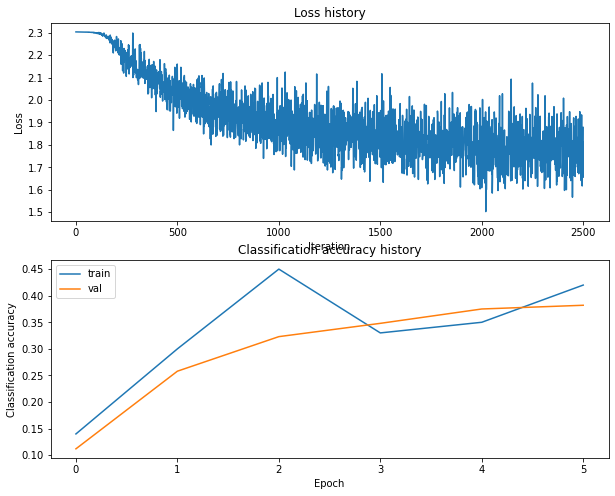

Training network with h_s 200, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.303295
iteration 100 / 2500: loss 1.988137
iteration 200 / 2500: loss 1.724170
iteration 300 / 2500: loss 2.021677
iteration 400 / 2500: loss 1.855013
iteration 500 / 2500: loss 1.705501
iteration 600 / 2500: loss 1.739843
iteration 700 / 2500: loss 1.658496
iteration 800 / 2500: loss 1.603024
iteration 900 / 2500: loss 1.684542
iteration 1000 / 2500: loss 1.629872
iteration 1100 / 2500: loss 1.827330
iteration 1200 / 2500: loss 1.760543
iteration 1300 / 2500: loss 1.781444
iteration 1400 / 2500: loss 1.690119
iteration 1500 / 2500: loss 1.773677
iteration 1600 / 2500: loss 1.767478
iteration 1700 / 2500: loss 1.750958
iteration 1800 / 2500: loss 1.736234
iteration 1900 / 2500: loss 1.826046
iteration 2000 / 2500: loss 1.757185
iteration 2100 / 2500: loss 1.852138
iteration 2200 / 2500: loss 1.637336
iteration 2300 / 2500: loss 1.750517
iteration 2400 / 2500: loss 1.782767
Validation accuracy:  0.388

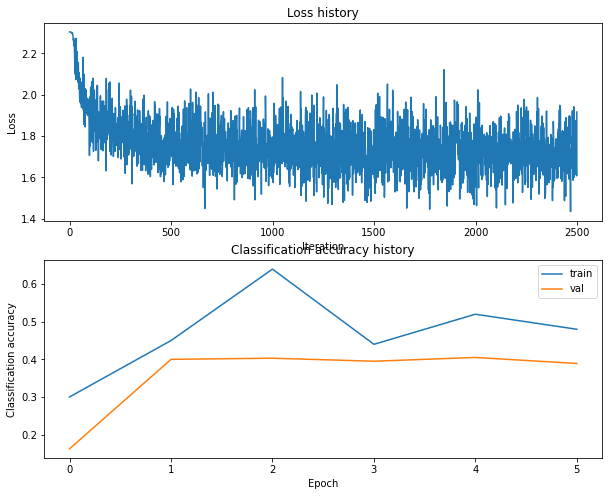

Training network with h_s 200, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.303415
iteration 100 / 2500: loss 2.299017
iteration 200 / 2500: loss 2.220815
iteration 300 / 2500: loss 2.107547
iteration 400 / 2500: loss 2.010652
iteration 500 / 2500: loss 2.000536
iteration 600 / 2500: loss 1.958246
iteration 700 / 2500: loss 1.887706
iteration 800 / 2500: loss 1.972285
iteration 900 / 2500: loss 1.906588
iteration 1000 / 2500: loss 1.972561
iteration 1100 / 2500: loss 1.899004
iteration 1200 / 2500: loss 1.964173
iteration 1300 / 2500: loss 1.811575
iteration 1400 / 2500: loss 1.887550
iteration 1500 / 2500: loss 1.933999
iteration 1600 / 2500: loss 1.849262
iteration 1700 / 2500: loss 1.792142
iteration 1800 / 2500: loss 1.791682
iteration 1900 / 2500: loss 1.780212
iteration 2000 / 2500: loss 1.769445
iteration 2100 / 2500: loss 1.810562
iteration 2200 / 2500: loss 1.721666
iteration 2300 / 2500: loss 1.802303
iteration 2400 / 2500: loss 1.812598
Validation accuracy:  0.37

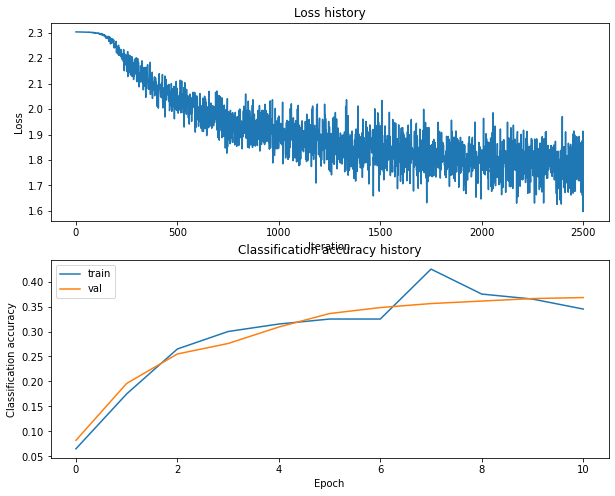

Training network with h_s 200, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.303331
iteration 100 / 2500: loss 1.825897
iteration 200 / 2500: loss 1.875703
iteration 300 / 2500: loss 1.721638
iteration 400 / 2500: loss 1.647619
iteration 500 / 2500: loss 1.615648
iteration 600 / 2500: loss 1.689310
iteration 700 / 2500: loss 1.729933
iteration 800 / 2500: loss 1.810920
iteration 900 / 2500: loss 1.577560
iteration 1000 / 2500: loss 1.667626
iteration 1100 / 2500: loss 1.608132
iteration 1200 / 2500: loss 1.702409
iteration 1300 / 2500: loss 1.557396
iteration 1400 / 2500: loss 1.674979
iteration 1500 / 2500: loss 1.578191
iteration 1600 / 2500: loss 1.721492
iteration 1700 / 2500: loss 1.698721
iteration 1800 / 2500: loss 1.646198
iteration 1900 / 2500: loss 1.701647
iteration 2000 / 2500: loss 1.658737
iteration 2100 / 2500: loss 1.616956
iteration 2200 / 2500: loss 1.636044
iteration 2300 / 2500: loss 1.703809
iteration 2400 / 2500: loss 1.435600
Validation accuracy:  0.398

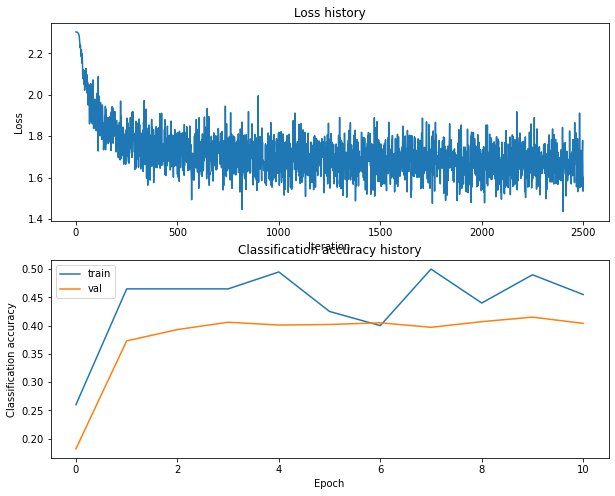

Training network with h_s 200, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.303392
iteration 100 / 2500: loss 2.297752
iteration 200 / 2500: loss 2.215260
iteration 300 / 2500: loss 2.143554
iteration 400 / 2500: loss 2.086056
iteration 500 / 2500: loss 1.998538
iteration 600 / 2500: loss 2.001392
iteration 700 / 2500: loss 1.953700
iteration 800 / 2500: loss 1.972065
iteration 900 / 2500: loss 1.954109
iteration 1000 / 2500: loss 1.896423
iteration 1100 / 2500: loss 1.914579
iteration 1200 / 2500: loss 1.863136
iteration 1300 / 2500: loss 1.861206
iteration 1400 / 2500: loss 1.861368
iteration 1500 / 2500: loss 1.892281
iteration 1600 / 2500: loss 1.825963
iteration 1700 / 2500: loss 1.850465
iteration 1800 / 2500: loss 1.819390
iteration 1900 / 2500: loss 1.837793
iteration 2000 / 2500: loss 1.876279
iteration 2100 / 2500: loss 1.847954
iteration 2200 / 2500: loss 1.762315
iteration 2300 / 2500: loss 1.823843
iteration 2400 / 2500: loss 1.802156
Validation accuracy:  0.37

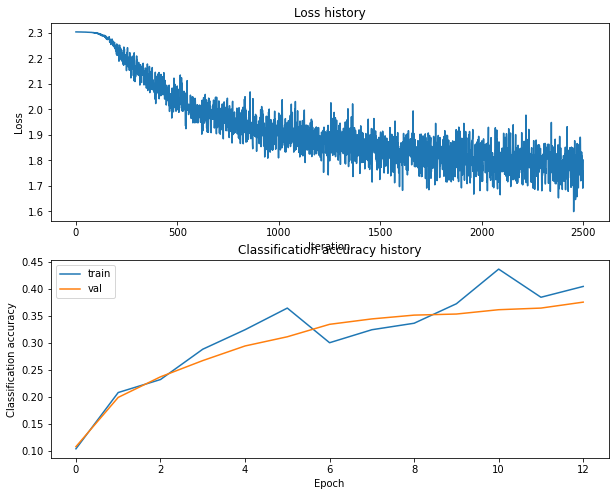

Training network with h_s 200, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.303338
iteration 100 / 2500: loss 1.927774
iteration 200 / 2500: loss 1.735265
iteration 300 / 2500: loss 1.862624
iteration 400 / 2500: loss 1.742603
iteration 500 / 2500: loss 1.677419
iteration 600 / 2500: loss 1.705999
iteration 700 / 2500: loss 1.666727
iteration 800 / 2500: loss 1.785934
iteration 900 / 2500: loss 1.685425
iteration 1000 / 2500: loss 1.739445
iteration 1100 / 2500: loss 1.691256
iteration 1200 / 2500: loss 1.764013
iteration 1300 / 2500: loss 1.760990
iteration 1400 / 2500: loss 1.642937
iteration 1500 / 2500: loss 1.674645
iteration 1600 / 2500: loss 1.670608
iteration 1700 / 2500: loss 1.720194
iteration 1800 / 2500: loss 1.649098
iteration 1900 / 2500: loss 1.629914
iteration 2000 / 2500: loss 1.688118
iteration 2100 / 2500: loss 1.586467
iteration 2200 / 2500: loss 1.745171
iteration 2300 / 2500: loss 1.665495
iteration 2400 / 2500: loss 1.690163
Validation accuracy:  0.409

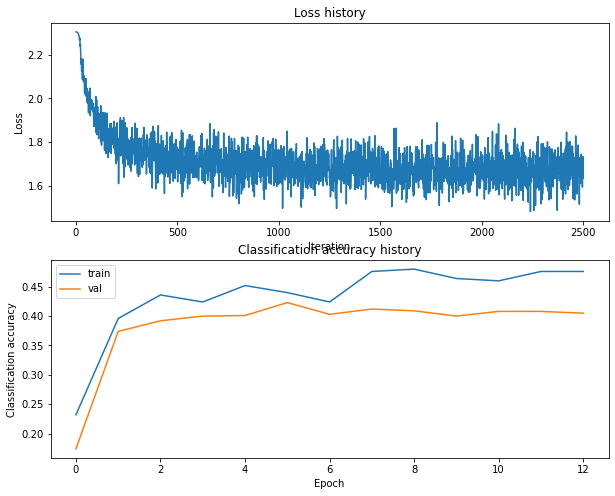

Training network with h_s 200, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.303344
iteration 100 / 2500: loss 2.299988
iteration 200 / 2500: loss 2.250256
iteration 300 / 2500: loss 2.124152
iteration 400 / 2500: loss 2.086390
iteration 500 / 2500: loss 2.001674
iteration 600 / 2500: loss 2.000059
iteration 700 / 2500: loss 1.950940
iteration 800 / 2500: loss 1.885959
iteration 900 / 2500: loss 1.902480
iteration 1000 / 2500: loss 1.913478
iteration 1100 / 2500: loss 1.987904
iteration 1200 / 2500: loss 1.814535
iteration 1300 / 2500: loss 1.790485
iteration 1400 / 2500: loss 1.798907
iteration 1500 / 2500: loss 1.796656
iteration 1600 / 2500: loss 1.802699
iteration 1700 / 2500: loss 1.816349
iteration 1800 / 2500: loss 1.832446
iteration 1900 / 2500: loss 1.742847
iteration 2000 / 2500: loss 1.875959
iteration 2100 / 2500: loss 1.806918
iteration 2200 / 2500: loss 1.835123
iteration 2300 / 2500: loss 1.816909
iteration 2400 / 2500: loss 1.647360
Validation accuracy:  0.39

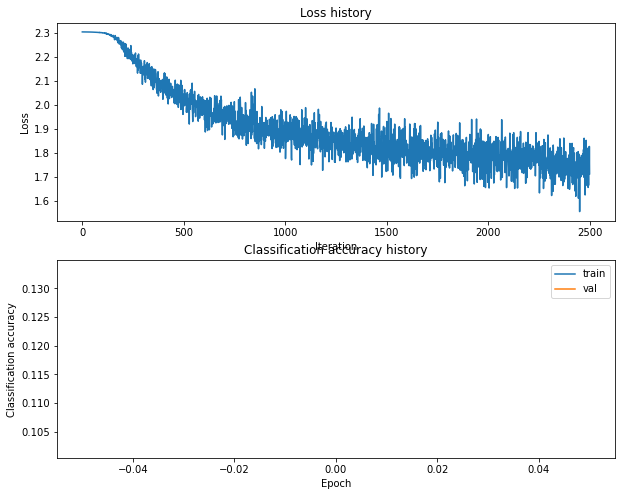

Training network with h_s 200, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.303367
iteration 100 / 2500: loss 1.846805
iteration 200 / 2500: loss 1.767080
iteration 300 / 2500: loss 1.797429
iteration 400 / 2500: loss 1.750051
iteration 500 / 2500: loss 1.706719
iteration 600 / 2500: loss 1.693348
iteration 700 / 2500: loss 1.729360
iteration 800 / 2500: loss 1.710950
iteration 900 / 2500: loss 1.626005
iteration 1000 / 2500: loss 1.769979
iteration 1100 / 2500: loss 1.570408
iteration 1200 / 2500: loss 1.774823
iteration 1300 / 2500: loss 1.720072
iteration 1400 / 2500: loss 1.545362
iteration 1500 / 2500: loss 1.784414
iteration 1600 / 2500: loss 1.663448
iteration 1700 / 2500: loss 1.625675
iteration 1800 / 2500: loss 1.704681
iteration 1900 / 2500: loss 1.753139
iteration 2000 / 2500: loss 1.817692
iteration 2100 / 2500: loss 1.706487
iteration 2200 / 2500: loss 1.633358
iteration 2300 / 2500: loss 1.602754
iteration 2400 / 2500: loss 1.833571
Validation accuracy:  0.41


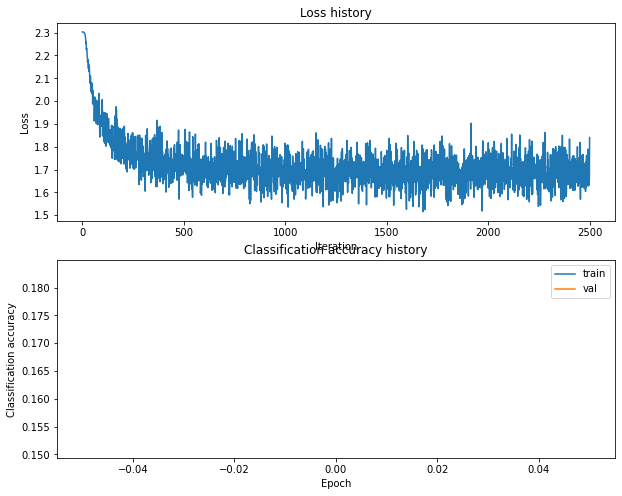

Training network with h_s 200, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.303338
iteration 100 / 2500: loss 2.299655
iteration 200 / 2500: loss 2.242145
iteration 300 / 2500: loss 2.170731
iteration 400 / 2500: loss 2.069955
iteration 500 / 2500: loss 2.060028
iteration 600 / 2500: loss 2.011665
iteration 700 / 2500: loss 1.971163
iteration 800 / 2500: loss 1.969507
iteration 900 / 2500: loss 1.946619
iteration 1000 / 2500: loss 1.898927
iteration 1100 / 2500: loss 1.892801
iteration 1200 / 2500: loss 1.905095
iteration 1300 / 2500: loss 1.917410
iteration 1400 / 2500: loss 1.826765
iteration 1500 / 2500: loss 1.890090
iteration 1600 / 2500: loss 1.851948
iteration 1700 / 2500: loss 1.816677
iteration 1800 / 2500: loss 1.875450
iteration 1900 / 2500: loss 1.779448
iteration 2000 / 2500: loss 1.832082
iteration 2100 / 2500: loss 1.851364
iteration 2200 / 2500: loss 1.860193
iteration 2300 / 2500: loss 1.860240
iteration 2400 / 2500: loss 1.823208
Validation accuracy:  0.34

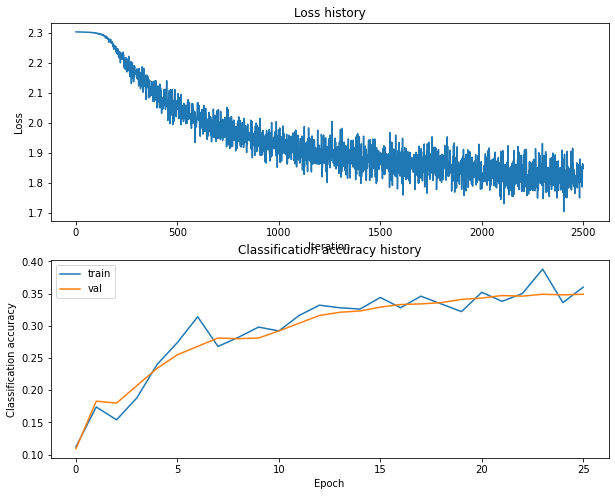

Training network with h_s 200, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.303387
iteration 100 / 2500: loss 1.888183
iteration 200 / 2500: loss 1.812739
iteration 300 / 2500: loss 1.675390
iteration 400 / 2500: loss 1.708295
iteration 500 / 2500: loss 1.685298
iteration 600 / 2500: loss 1.662757
iteration 700 / 2500: loss 1.693196
iteration 800 / 2500: loss 1.604475
iteration 900 / 2500: loss 1.672553
iteration 1000 / 2500: loss 1.689933
iteration 1100 / 2500: loss 1.695237
iteration 1200 / 2500: loss 1.624095
iteration 1300 / 2500: loss 1.634145
iteration 1400 / 2500: loss 1.684956
iteration 1500 / 2500: loss 1.650771
iteration 1600 / 2500: loss 1.720354
iteration 1700 / 2500: loss 1.661324
iteration 1800 / 2500: loss 1.633330
iteration 1900 / 2500: loss 1.695510
iteration 2000 / 2500: loss 1.673378
iteration 2100 / 2500: loss 1.615871
iteration 2200 / 2500: loss 1.697335
iteration 2300 / 2500: loss 1.632894
iteration 2400 / 2500: loss 1.591760
Validation accuracy:  0.411

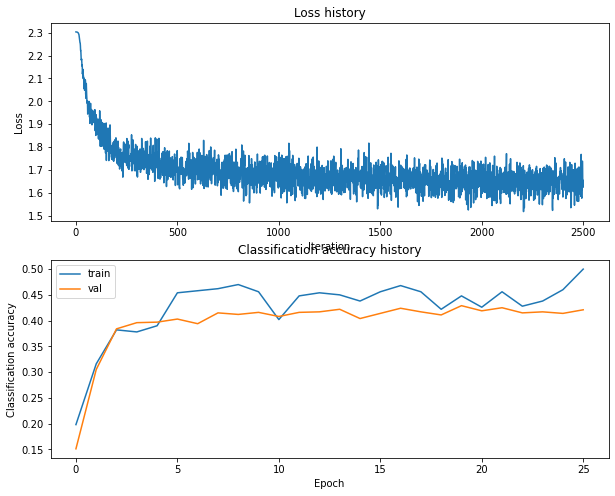

Training network with h_s 200, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.303423
iteration 100 / 5000: loss 2.299994
iteration 200 / 5000: loss 2.262561
iteration 300 / 5000: loss 2.120459
iteration 400 / 5000: loss 2.044279
iteration 500 / 5000: loss 1.986282
iteration 600 / 5000: loss 1.986996
iteration 700 / 5000: loss 2.032479
iteration 800 / 5000: loss 2.019546
iteration 900 / 5000: loss 1.921617
iteration 1000 / 5000: loss 1.933538
iteration 1100 / 5000: loss 1.895177
iteration 1200 / 5000: loss 1.836688
iteration 1300 / 5000: loss 1.896433
iteration 1400 / 5000: loss 1.853924
iteration 1500 / 5000: loss 1.727887
iteration 1600 / 5000: loss 1.831852
iteration 1700 / 5000: loss 1.851795
iteration 1800 / 5000: loss 1.842189
iteration 1900 / 5000: loss 1.929574
iteration 2000 / 5000: loss 1.730844
iteration 2100 / 5000: loss 1.652267
iteration 2200 / 5000: loss 1.752553
iteration 2300 / 5000: loss 1.761426
iteration 2400 / 5000: loss 1.893485
iteration 2500 / 5000: los

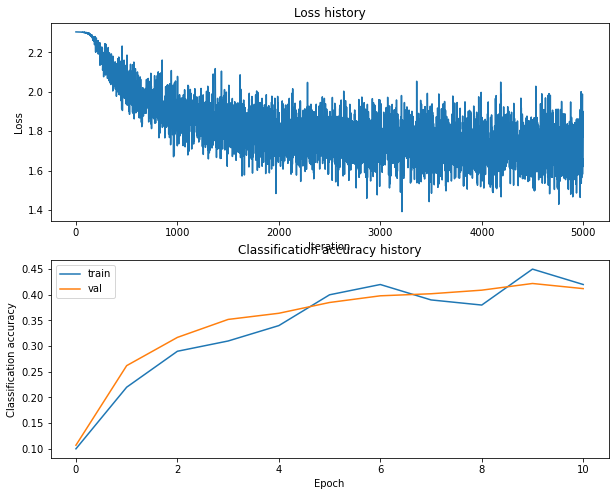

Training network with h_s 200, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.303383
iteration 100 / 5000: loss 1.890091
iteration 200 / 5000: loss 1.851042
iteration 300 / 5000: loss 1.704301
iteration 400 / 5000: loss 1.850155
iteration 500 / 5000: loss 1.661705
iteration 600 / 5000: loss 1.757650
iteration 700 / 5000: loss 1.847359
iteration 800 / 5000: loss 1.784872
iteration 900 / 5000: loss 1.895872
iteration 1000 / 5000: loss 1.683210
iteration 1100 / 5000: loss 1.785641
iteration 1200 / 5000: loss 1.877761
iteration 1300 / 5000: loss 1.749151
iteration 1400 / 5000: loss 1.727379
iteration 1500 / 5000: loss 1.693417
iteration 1600 / 5000: loss 1.501760
iteration 1700 / 5000: loss 1.660692
iteration 1800 / 5000: loss 1.914577
iteration 1900 / 5000: loss 1.730216
iteration 2000 / 5000: loss 1.721322
iteration 2100 / 5000: loss 1.799377
iteration 2200 / 5000: loss 1.719252
iteration 2300 / 5000: loss 1.776188
iteration 2400 / 5000: loss 1.666911
iteration 2500 / 5000: loss

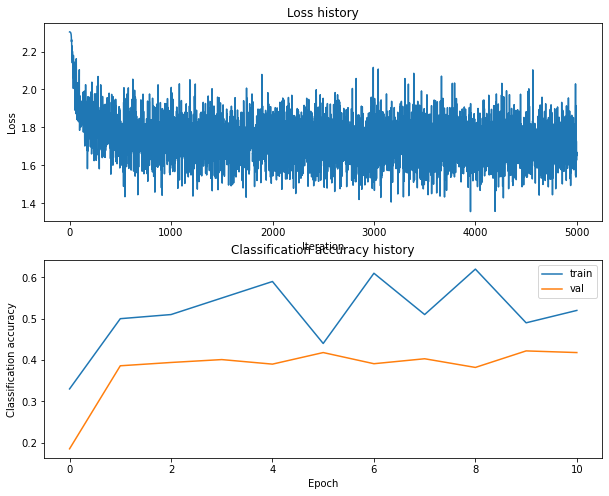

Training network with h_s 200, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.303363
iteration 100 / 5000: loss 2.299390
iteration 200 / 5000: loss 2.253107
iteration 300 / 5000: loss 2.167088
iteration 400 / 5000: loss 2.100216
iteration 500 / 5000: loss 2.027154
iteration 600 / 5000: loss 2.008485
iteration 700 / 5000: loss 1.976189
iteration 800 / 5000: loss 1.926501
iteration 900 / 5000: loss 1.923779
iteration 1000 / 5000: loss 1.950574
iteration 1100 / 5000: loss 1.843386
iteration 1200 / 5000: loss 1.863934
iteration 1300 / 5000: loss 1.864770
iteration 1400 / 5000: loss 1.928226
iteration 1500 / 5000: loss 1.788283
iteration 1600 / 5000: loss 1.841432
iteration 1700 / 5000: loss 1.656152
iteration 1800 / 5000: loss 1.987957
iteration 1900 / 5000: loss 1.804679
iteration 2000 / 5000: loss 1.815293
iteration 2100 / 5000: loss 1.856299
iteration 2200 / 5000: loss 1.788169
iteration 2300 / 5000: loss 1.763274
iteration 2400 / 5000: loss 1.802175
iteration 2500 / 5000: los

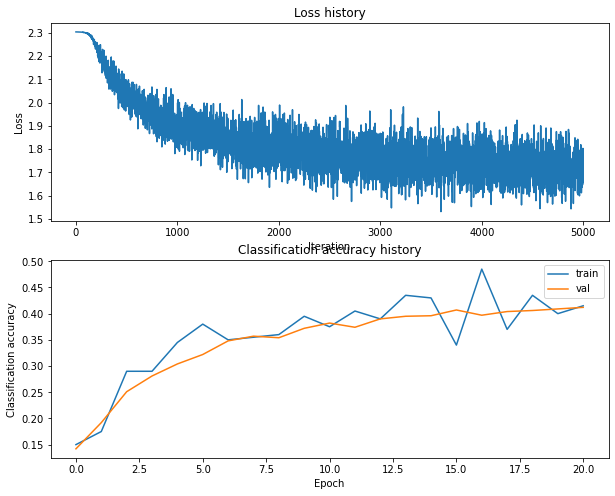

Training network with h_s 200, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.303355
iteration 100 / 5000: loss 1.928373
iteration 200 / 5000: loss 1.743665
iteration 300 / 5000: loss 1.795181
iteration 400 / 5000: loss 1.646356
iteration 500 / 5000: loss 1.715137
iteration 600 / 5000: loss 1.819760
iteration 700 / 5000: loss 1.682311
iteration 800 / 5000: loss 1.643258
iteration 900 / 5000: loss 1.681035
iteration 1000 / 5000: loss 1.601700
iteration 1100 / 5000: loss 1.688886
iteration 1200 / 5000: loss 1.696790
iteration 1300 / 5000: loss 1.635642
iteration 1400 / 5000: loss 1.686973
iteration 1500 / 5000: loss 1.623970
iteration 1600 / 5000: loss 1.730072
iteration 1700 / 5000: loss 1.713794
iteration 1800 / 5000: loss 1.698489
iteration 1900 / 5000: loss 1.691589
iteration 2000 / 5000: loss 1.654821
iteration 2100 / 5000: loss 1.599497
iteration 2200 / 5000: loss 1.634540
iteration 2300 / 5000: loss 1.821521
iteration 2400 / 5000: loss 1.817036
iteration 2500 / 5000: loss

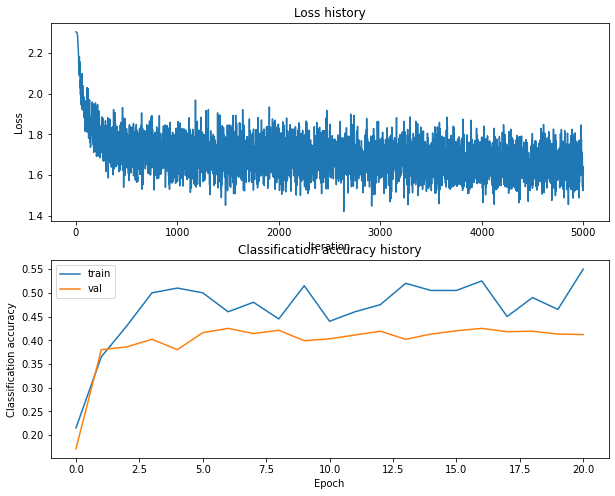

Training network with h_s 200, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.303357
iteration 100 / 5000: loss 2.299500
iteration 200 / 5000: loss 2.248027
iteration 300 / 5000: loss 2.152968
iteration 400 / 5000: loss 2.106091
iteration 500 / 5000: loss 1.998830
iteration 600 / 5000: loss 1.996087
iteration 700 / 5000: loss 1.877899
iteration 800 / 5000: loss 1.894254
iteration 900 / 5000: loss 1.915104
iteration 1000 / 5000: loss 1.929637
iteration 1100 / 5000: loss 1.866006
iteration 1200 / 5000: loss 1.797281
iteration 1300 / 5000: loss 1.772126
iteration 1400 / 5000: loss 1.839056
iteration 1500 / 5000: loss 1.761630
iteration 1600 / 5000: loss 1.908226
iteration 1700 / 5000: loss 1.897031
iteration 1800 / 5000: loss 1.780437
iteration 1900 / 5000: loss 1.810965
iteration 2000 / 5000: loss 1.762169
iteration 2100 / 5000: loss 1.915645
iteration 2200 / 5000: loss 1.740246
iteration 2300 / 5000: loss 1.769670
iteration 2400 / 5000: loss 1.807131
iteration 2500 / 5000: los

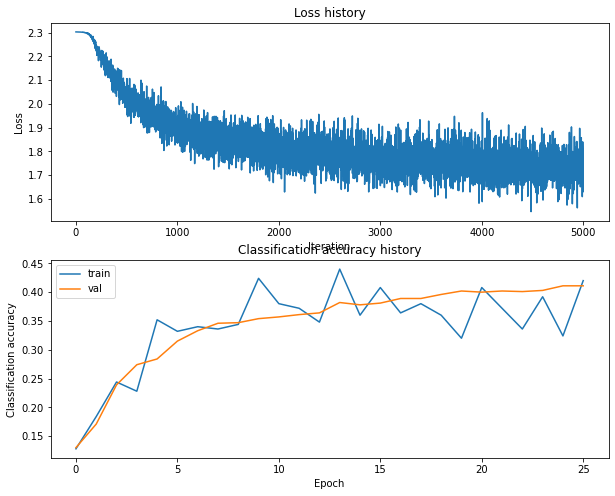

Training network with h_s 200, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.303332
iteration 100 / 5000: loss 1.871062
iteration 200 / 5000: loss 1.703522
iteration 300 / 5000: loss 1.801766
iteration 400 / 5000: loss 1.781628
iteration 500 / 5000: loss 1.691341
iteration 600 / 5000: loss 1.722479
iteration 700 / 5000: loss 1.694212
iteration 800 / 5000: loss 1.689576
iteration 900 / 5000: loss 1.757400
iteration 1000 / 5000: loss 1.733124
iteration 1100 / 5000: loss 1.661699
iteration 1200 / 5000: loss 1.756696
iteration 1300 / 5000: loss 1.630780
iteration 1400 / 5000: loss 1.845651
iteration 1500 / 5000: loss 1.693523
iteration 1600 / 5000: loss 1.564763
iteration 1700 / 5000: loss 1.594376
iteration 1800 / 5000: loss 1.793631
iteration 1900 / 5000: loss 1.611493
iteration 2000 / 5000: loss 1.707530
iteration 2100 / 5000: loss 1.731210
iteration 2200 / 5000: loss 1.726580
iteration 2300 / 5000: loss 1.723296
iteration 2400 / 5000: loss 1.616224
iteration 2500 / 5000: loss

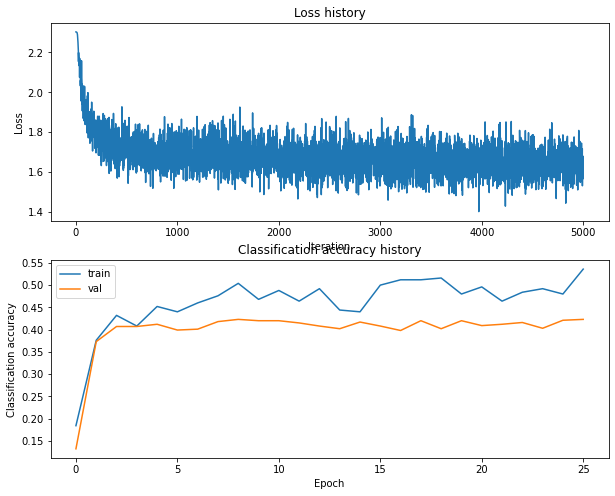

Training network with h_s 200, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.303366
iteration 100 / 5000: loss 2.298332
iteration 200 / 5000: loss 2.241568
iteration 300 / 5000: loss 2.155774
iteration 400 / 5000: loss 2.074474
iteration 500 / 5000: loss 1.990189
iteration 600 / 5000: loss 1.935611
iteration 700 / 5000: loss 1.939314
iteration 800 / 5000: loss 1.913392
iteration 900 / 5000: loss 1.906325
iteration 1000 / 5000: loss 1.872169
iteration 1100 / 5000: loss 1.800709
iteration 1200 / 5000: loss 1.952347
iteration 1300 / 5000: loss 1.830729
iteration 1400 / 5000: loss 1.867514
iteration 1500 / 5000: loss 1.807629
iteration 1600 / 5000: loss 1.813214
iteration 1700 / 5000: loss 1.844356
iteration 1800 / 5000: loss 1.767886
iteration 1900 / 5000: loss 1.743492
iteration 2000 / 5000: loss 1.922950
iteration 2100 / 5000: loss 1.784891
iteration 2200 / 5000: loss 1.782940
iteration 2300 / 5000: loss 1.711242
iteration 2400 / 5000: loss 1.682938
iteration 2500 / 5000: los

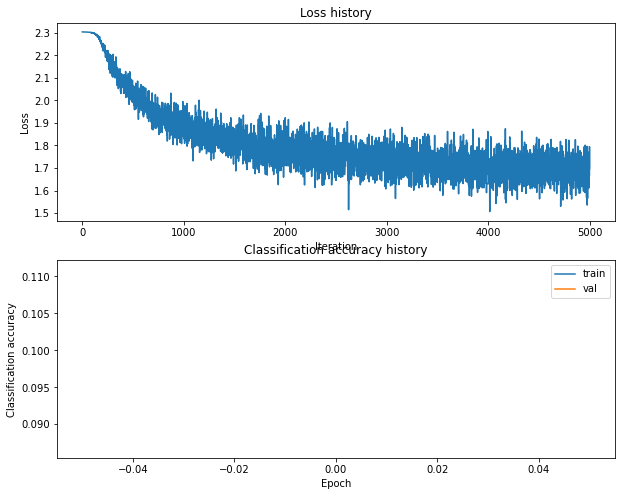

Training network with h_s 200, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.303302
iteration 100 / 5000: loss 1.869668
iteration 200 / 5000: loss 1.840782
iteration 300 / 5000: loss 1.679036
iteration 400 / 5000: loss 1.801037
iteration 500 / 5000: loss 1.830693
iteration 600 / 5000: loss 1.744684
iteration 700 / 5000: loss 1.706935
iteration 800 / 5000: loss 1.813995
iteration 900 / 5000: loss 1.733773
iteration 1000 / 5000: loss 1.745321
iteration 1100 / 5000: loss 1.683036
iteration 1200 / 5000: loss 1.715118
iteration 1300 / 5000: loss 1.645494
iteration 1400 / 5000: loss 1.623720
iteration 1500 / 5000: loss 1.669435
iteration 1600 / 5000: loss 1.618091
iteration 1700 / 5000: loss 1.643001
iteration 1800 / 5000: loss 1.732014
iteration 1900 / 5000: loss 1.629176
iteration 2000 / 5000: loss 1.626881
iteration 2100 / 5000: loss 1.636423
iteration 2200 / 5000: loss 1.659410
iteration 2300 / 5000: loss 1.677882
iteration 2400 / 5000: loss 1.602515
iteration 2500 / 5000: loss

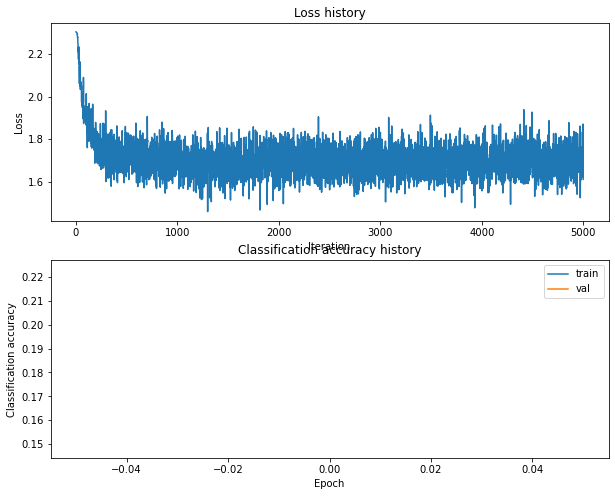

Training network with h_s 200, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.303345
iteration 100 / 5000: loss 2.299119
iteration 200 / 5000: loss 2.245592
iteration 300 / 5000: loss 2.154648
iteration 400 / 5000: loss 2.104192
iteration 500 / 5000: loss 2.028591
iteration 600 / 5000: loss 2.049475
iteration 700 / 5000: loss 1.976739
iteration 800 / 5000: loss 1.926637
iteration 900 / 5000: loss 2.013120
iteration 1000 / 5000: loss 1.939822
iteration 1100 / 5000: loss 1.945927
iteration 1200 / 5000: loss 1.902084
iteration 1300 / 5000: loss 1.872651
iteration 1400 / 5000: loss 1.902081
iteration 1500 / 5000: loss 1.856920
iteration 1600 / 5000: loss 1.911883
iteration 1700 / 5000: loss 1.893634
iteration 1800 / 5000: loss 1.812727
iteration 1900 / 5000: loss 1.856675
iteration 2000 / 5000: loss 1.781369
iteration 2100 / 5000: loss 1.873704
iteration 2200 / 5000: loss 1.815328
iteration 2300 / 5000: loss 1.755580
iteration 2400 / 5000: loss 1.784046
iteration 2500 / 5000: los

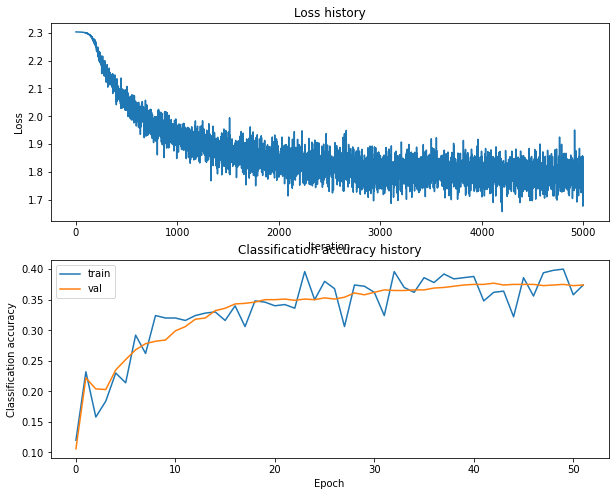

Training network with h_s 200, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.303375
iteration 100 / 5000: loss 1.850103
iteration 200 / 5000: loss 1.860633
iteration 300 / 5000: loss 1.777019
iteration 400 / 5000: loss 1.738068
iteration 500 / 5000: loss 1.652308
iteration 600 / 5000: loss 1.685322
iteration 700 / 5000: loss 1.677839
iteration 800 / 5000: loss 1.692359
iteration 900 / 5000: loss 1.660578
iteration 1000 / 5000: loss 1.603381
iteration 1100 / 5000: loss 1.600007
iteration 1200 / 5000: loss 1.667835
iteration 1300 / 5000: loss 1.623776
iteration 1400 / 5000: loss 1.689690
iteration 1500 / 5000: loss 1.745267
iteration 1600 / 5000: loss 1.661235
iteration 1700 / 5000: loss 1.638553
iteration 1800 / 5000: loss 1.769887
iteration 1900 / 5000: loss 1.609152
iteration 2000 / 5000: loss 1.675937
iteration 2100 / 5000: loss 1.646805
iteration 2200 / 5000: loss 1.688656
iteration 2300 / 5000: loss 1.709308
iteration 2400 / 5000: loss 1.624711
iteration 2500 / 5000: loss

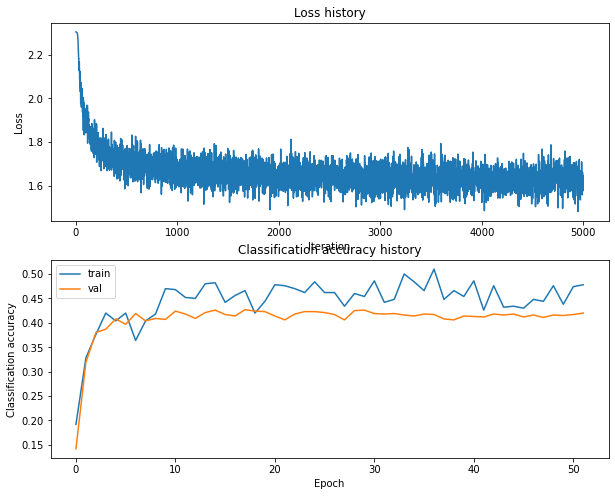

Training network with h_s 200, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.303361
iteration 100 / 10000: loss 2.299110
iteration 200 / 10000: loss 2.227808
iteration 300 / 10000: loss 2.099772
iteration 400 / 10000: loss 2.050059
iteration 500 / 10000: loss 1.971074
iteration 600 / 10000: loss 1.950134
iteration 700 / 10000: loss 1.949264
iteration 800 / 10000: loss 1.883185
iteration 900 / 10000: loss 2.033305
iteration 1000 / 10000: loss 1.949264
iteration 1100 / 10000: loss 1.886406
iteration 1200 / 10000: loss 1.931185
iteration 1300 / 10000: loss 1.679340
iteration 1400 / 10000: loss 1.884221
iteration 1500 / 10000: loss 1.765128
iteration 1600 / 10000: loss 1.713141
iteration 1700 / 10000: loss 1.860664
iteration 1800 / 10000: loss 1.905817
iteration 1900 / 10000: loss 1.662931
iteration 2000 / 10000: loss 1.858168
iteration 2100 / 10000: loss 1.812535
iteration 2200 / 10000: loss 1.715874
iteration 2300 / 10000: loss 1.690487
iteration 2400 / 10000: loss 1.873972


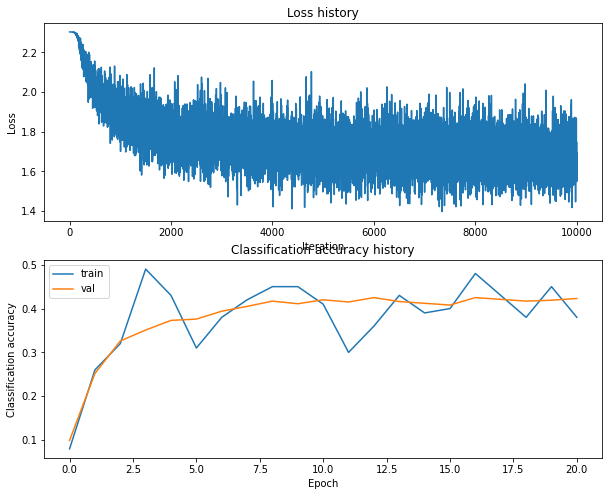

Training network with h_s 200, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.303395
iteration 100 / 10000: loss 1.800470
iteration 200 / 10000: loss 1.822816
iteration 300 / 10000: loss 1.925862
iteration 400 / 10000: loss 1.729135
iteration 500 / 10000: loss 1.692245
iteration 600 / 10000: loss 1.862017
iteration 700 / 10000: loss 1.819835
iteration 800 / 10000: loss 1.696397
iteration 900 / 10000: loss 1.803133
iteration 1000 / 10000: loss 1.697753
iteration 1100 / 10000: loss 1.550797
iteration 1200 / 10000: loss 1.941999
iteration 1300 / 10000: loss 1.424983
iteration 1400 / 10000: loss 1.612452
iteration 1500 / 10000: loss 1.721266
iteration 1600 / 10000: loss 1.750633
iteration 1700 / 10000: loss 1.774841
iteration 1800 / 10000: loss 1.687992
iteration 1900 / 10000: loss 1.705932
iteration 2000 / 10000: loss 1.730037
iteration 2100 / 10000: loss 1.776448
iteration 2200 / 10000: loss 1.720532
iteration 2300 / 10000: loss 1.694084
iteration 2400 / 10000: loss 1.686594
i

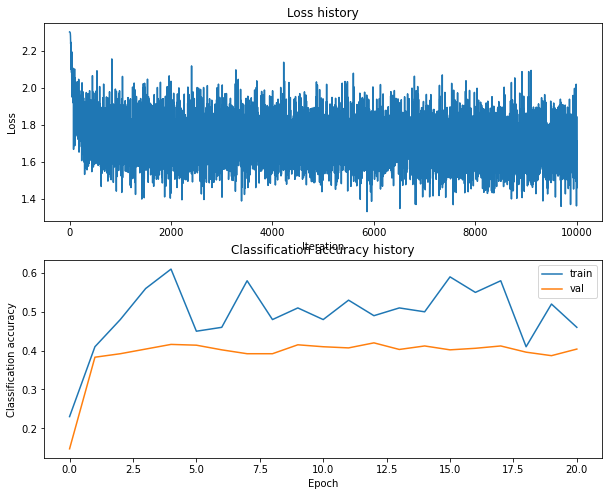

Training network with h_s 200, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.303322
iteration 100 / 10000: loss 2.299500
iteration 200 / 10000: loss 2.207283
iteration 300 / 10000: loss 2.188221
iteration 400 / 10000: loss 2.077421
iteration 500 / 10000: loss 2.032105
iteration 600 / 10000: loss 1.978954
iteration 700 / 10000: loss 2.038910
iteration 800 / 10000: loss 1.976187
iteration 900 / 10000: loss 1.863350
iteration 1000 / 10000: loss 1.934549
iteration 1100 / 10000: loss 1.862196
iteration 1200 / 10000: loss 1.825404
iteration 1300 / 10000: loss 1.970588
iteration 1400 / 10000: loss 1.803532
iteration 1500 / 10000: loss 1.777248
iteration 1600 / 10000: loss 1.870373
iteration 1700 / 10000: loss 1.802731
iteration 1800 / 10000: loss 1.787334
iteration 1900 / 10000: loss 1.801316
iteration 2000 / 10000: loss 1.732384
iteration 2100 / 10000: loss 1.773029
iteration 2200 / 10000: loss 1.717819
iteration 2300 / 10000: loss 1.708665
iteration 2400 / 10000: loss 1.757135


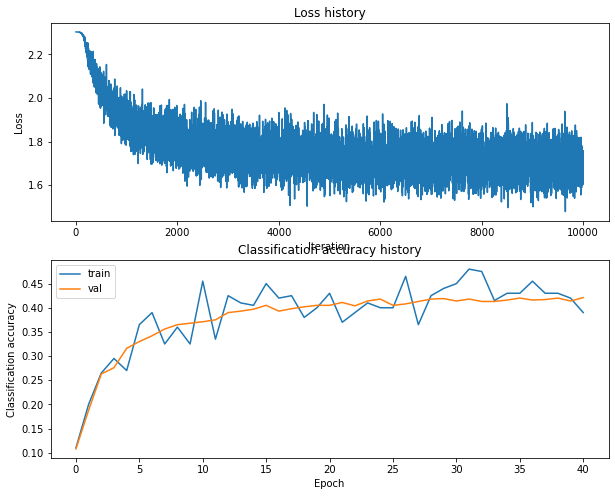

Training network with h_s 200, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.303344
iteration 100 / 10000: loss 1.862882
iteration 200 / 10000: loss 1.704872
iteration 300 / 10000: loss 1.825327
iteration 400 / 10000: loss 1.796312
iteration 500 / 10000: loss 1.744123
iteration 600 / 10000: loss 1.797534
iteration 700 / 10000: loss 1.637143
iteration 800 / 10000: loss 1.807809
iteration 900 / 10000: loss 1.658816
iteration 1000 / 10000: loss 1.699497
iteration 1100 / 10000: loss 1.644830
iteration 1200 / 10000: loss 1.653422
iteration 1300 / 10000: loss 1.778995
iteration 1400 / 10000: loss 1.796828
iteration 1500 / 10000: loss 1.682591
iteration 1600 / 10000: loss 1.858596
iteration 1700 / 10000: loss 1.731527
iteration 1800 / 10000: loss 1.708983
iteration 1900 / 10000: loss 1.790115
iteration 2000 / 10000: loss 1.784542
iteration 2100 / 10000: loss 1.699902
iteration 2200 / 10000: loss 1.670435
iteration 2300 / 10000: loss 1.744615
iteration 2400 / 10000: loss 1.745270
i

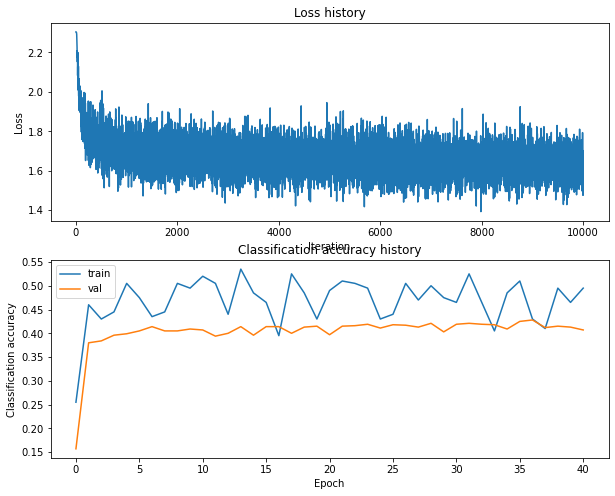

Training network with h_s 200, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.303380
iteration 100 / 10000: loss 2.298976
iteration 200 / 10000: loss 2.234076
iteration 300 / 10000: loss 2.140611
iteration 400 / 10000: loss 2.111168
iteration 500 / 10000: loss 2.063153
iteration 600 / 10000: loss 1.958665
iteration 700 / 10000: loss 1.956442
iteration 800 / 10000: loss 1.963229
iteration 900 / 10000: loss 1.930319
iteration 1000 / 10000: loss 1.859893
iteration 1100 / 10000: loss 1.828241
iteration 1200 / 10000: loss 1.867585
iteration 1300 / 10000: loss 1.844783
iteration 1400 / 10000: loss 1.817640
iteration 1500 / 10000: loss 1.907360
iteration 1600 / 10000: loss 1.916954
iteration 1700 / 10000: loss 1.788421
iteration 1800 / 10000: loss 1.795339
iteration 1900 / 10000: loss 1.869095
iteration 2000 / 10000: loss 1.840896
iteration 2100 / 10000: loss 1.848167
iteration 2200 / 10000: loss 1.837683
iteration 2300 / 10000: loss 1.906727
iteration 2400 / 10000: loss 1.797123


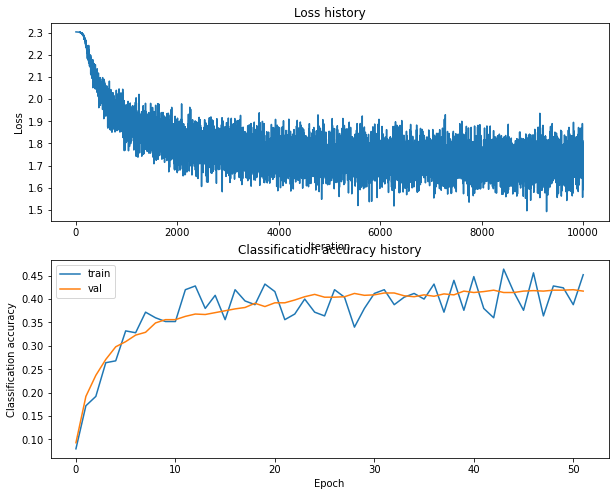

Training network with h_s 200, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.303367
iteration 100 / 10000: loss 1.960171
iteration 200 / 10000: loss 1.710817
iteration 300 / 10000: loss 1.707505
iteration 400 / 10000: loss 1.715885
iteration 500 / 10000: loss 1.665779
iteration 600 / 10000: loss 1.706337
iteration 700 / 10000: loss 1.687912
iteration 800 / 10000: loss 1.719946
iteration 900 / 10000: loss 1.723358
iteration 1000 / 10000: loss 1.659709
iteration 1100 / 10000: loss 1.763586
iteration 1200 / 10000: loss 1.569217
iteration 1300 / 10000: loss 1.774592
iteration 1400 / 10000: loss 1.635483
iteration 1500 / 10000: loss 1.790351
iteration 1600 / 10000: loss 1.687867
iteration 1700 / 10000: loss 1.697189
iteration 1800 / 10000: loss 1.698740
iteration 1900 / 10000: loss 1.705508
iteration 2000 / 10000: loss 1.688263
iteration 2100 / 10000: loss 1.747142
iteration 2200 / 10000: loss 1.614662
iteration 2300 / 10000: loss 1.614874
iteration 2400 / 10000: loss 1.615479
i

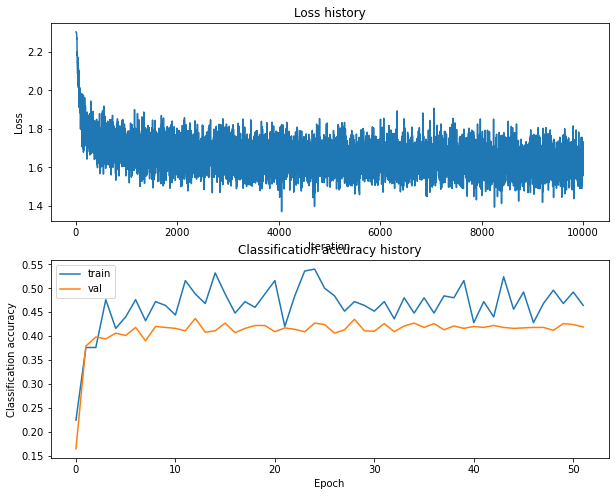

Training network with h_s 200, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.303334
iteration 100 / 10000: loss 2.298059
iteration 200 / 10000: loss 2.226131
iteration 300 / 10000: loss 2.167328
iteration 400 / 10000: loss 2.037502
iteration 500 / 10000: loss 2.081775
iteration 600 / 10000: loss 1.975194
iteration 700 / 10000: loss 1.950124
iteration 800 / 10000: loss 1.896207
iteration 900 / 10000: loss 1.828061
iteration 1000 / 10000: loss 1.887575
iteration 1100 / 10000: loss 1.800288
iteration 1200 / 10000: loss 1.943975
iteration 1300 / 10000: loss 1.870326
iteration 1400 / 10000: loss 1.756644
iteration 1500 / 10000: loss 1.817593
iteration 1600 / 10000: loss 1.731222
iteration 1700 / 10000: loss 1.858922
iteration 1800 / 10000: loss 1.783648
iteration 1900 / 10000: loss 1.773136
iteration 2000 / 10000: loss 1.747897
iteration 2100 / 10000: loss 1.814197
iteration 2200 / 10000: loss 1.815024
iteration 2300 / 10000: loss 1.699729
iteration 2400 / 10000: loss 1.840445


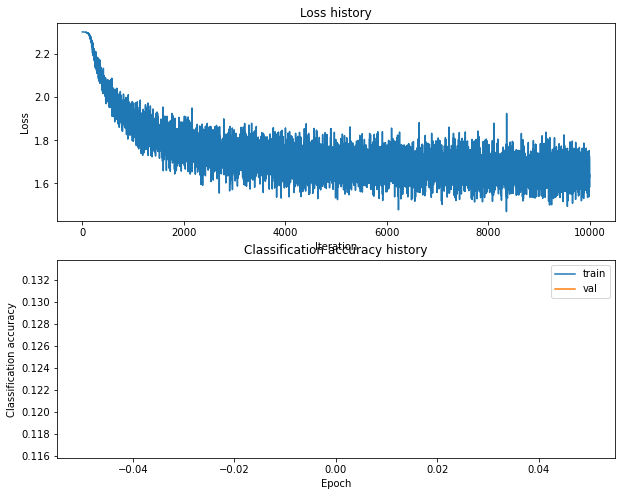

Training network with h_s 200, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.303323
iteration 100 / 10000: loss 1.850060
iteration 200 / 10000: loss 1.816166
iteration 300 / 10000: loss 1.683761
iteration 400 / 10000: loss 1.724848
iteration 500 / 10000: loss 1.770862
iteration 600 / 10000: loss 1.699413
iteration 700 / 10000: loss 1.769559
iteration 800 / 10000: loss 1.809065
iteration 900 / 10000: loss 1.775528
iteration 1000 / 10000: loss 1.686660
iteration 1100 / 10000: loss 1.627866
iteration 1200 / 10000: loss 1.825958
iteration 1300 / 10000: loss 1.750220
iteration 1400 / 10000: loss 1.592969
iteration 1500 / 10000: loss 1.649858
iteration 1600 / 10000: loss 1.569139
iteration 1700 / 10000: loss 1.680941
iteration 1800 / 10000: loss 1.643713
iteration 1900 / 10000: loss 1.645373
iteration 2000 / 10000: loss 1.591110
iteration 2100 / 10000: loss 1.719190
iteration 2200 / 10000: loss 1.748763
iteration 2300 / 10000: loss 1.666090
iteration 2400 / 10000: loss 1.551832
i

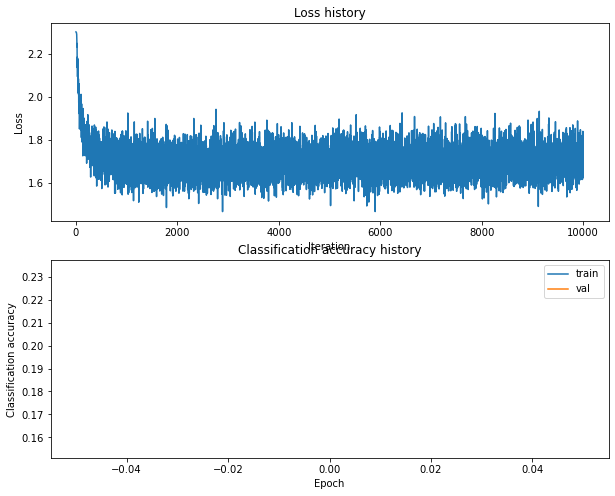

Training network with h_s 200, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.303381
iteration 100 / 10000: loss 2.299285
iteration 200 / 10000: loss 2.242249
iteration 300 / 10000: loss 2.166763
iteration 400 / 10000: loss 2.142213
iteration 500 / 10000: loss 2.034092
iteration 600 / 10000: loss 1.958139
iteration 700 / 10000: loss 1.924657
iteration 800 / 10000: loss 1.962593
iteration 900 / 10000: loss 1.978724
iteration 1000 / 10000: loss 1.954706
iteration 1100 / 10000: loss 1.886585
iteration 1200 / 10000: loss 1.869317
iteration 1300 / 10000: loss 1.901683
iteration 1400 / 10000: loss 1.845480
iteration 1500 / 10000: loss 1.866225
iteration 1600 / 10000: loss 1.794622
iteration 1700 / 10000: loss 1.835093
iteration 1800 / 10000: loss 1.790527
iteration 1900 / 10000: loss 1.826557
iteration 2000 / 10000: loss 1.886030
iteration 2100 / 10000: loss 1.827624
iteration 2200 / 10000: loss 1.841042
iteration 2300 / 10000: loss 1.799578
iteration 2400 / 10000: loss 1.777573


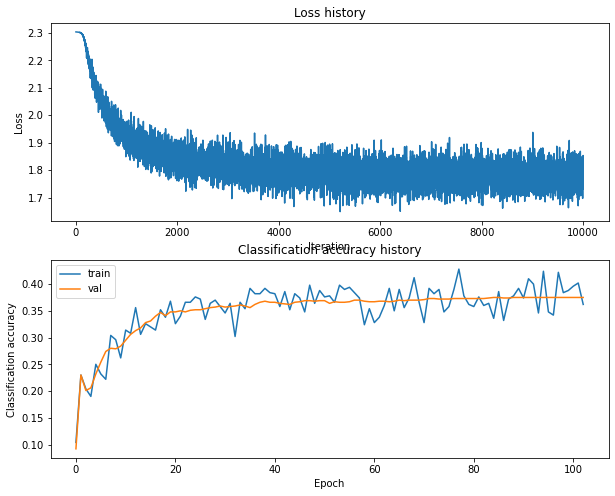

Training network with h_s 200, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.303329
iteration 100 / 10000: loss 1.896208
iteration 200 / 10000: loss 1.872893
iteration 300 / 10000: loss 1.743860
iteration 400 / 10000: loss 1.743487
iteration 500 / 10000: loss 1.725721
iteration 600 / 10000: loss 1.666156
iteration 700 / 10000: loss 1.718343
iteration 800 / 10000: loss 1.683823
iteration 900 / 10000: loss 1.687506
iteration 1000 / 10000: loss 1.649724
iteration 1100 / 10000: loss 1.758886
iteration 1200 / 10000: loss 1.636502
iteration 1300 / 10000: loss 1.651449
iteration 1400 / 10000: loss 1.709652
iteration 1500 / 10000: loss 1.731256
iteration 1600 / 10000: loss 1.734603
iteration 1700 / 10000: loss 1.666819
iteration 1800 / 10000: loss 1.681051
iteration 1900 / 10000: loss 1.687186
iteration 2000 / 10000: loss 1.585105
iteration 2100 / 10000: loss 1.655793
iteration 2200 / 10000: loss 1.698446
iteration 2300 / 10000: loss 1.565116
iteration 2400 / 10000: loss 1.607925
i

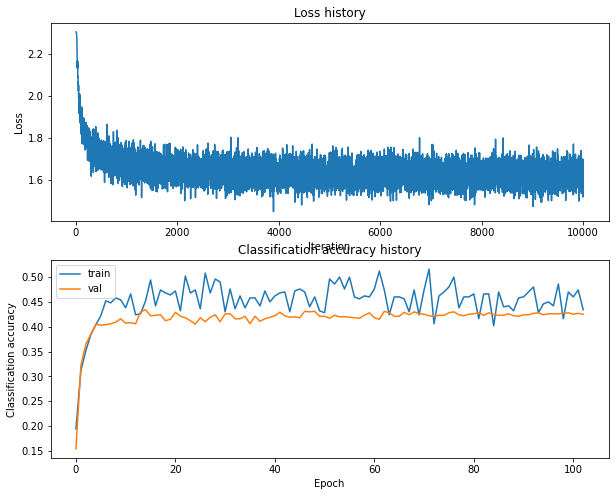

Training network with h_s 200, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.303340
iteration 100 / 15000: loss 2.300329
iteration 200 / 15000: loss 2.235535
iteration 300 / 15000: loss 2.123226
iteration 400 / 15000: loss 2.095055
iteration 500 / 15000: loss 2.014736
iteration 600 / 15000: loss 2.007226
iteration 700 / 15000: loss 1.905561
iteration 800 / 15000: loss 1.920898
iteration 900 / 15000: loss 2.011833
iteration 1000 / 15000: loss 1.905902
iteration 1100 / 15000: loss 1.860513
iteration 1200 / 15000: loss 1.810295
iteration 1300 / 15000: loss 1.903934
iteration 1400 / 15000: loss 1.789370
iteration 1500 / 15000: loss 1.776855
iteration 1600 / 15000: loss 1.693876
iteration 1700 / 15000: loss 1.756000
iteration 1800 / 15000: loss 1.913290
iteration 1900 / 15000: loss 1.733400
iteration 2000 / 15000: loss 1.827214
iteration 2100 / 15000: loss 1.863923
iteration 2200 / 15000: loss 1.681672
iteration 2300 / 15000: loss 1.736963
iteration 2400 / 15000: loss 1.896615


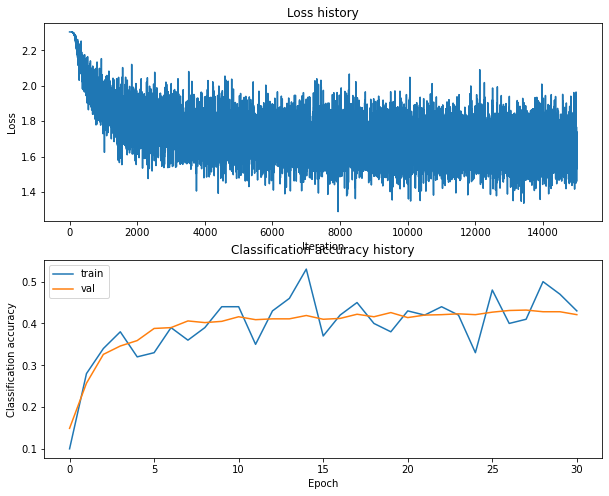

Training network with h_s 200, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.303315
iteration 100 / 15000: loss 1.819562
iteration 200 / 15000: loss 1.955877
iteration 300 / 15000: loss 1.772855
iteration 400 / 15000: loss 1.686863
iteration 500 / 15000: loss 1.823102
iteration 600 / 15000: loss 1.721951
iteration 700 / 15000: loss 1.716251
iteration 800 / 15000: loss 1.737886
iteration 900 / 15000: loss 1.821997
iteration 1000 / 15000: loss 1.711857
iteration 1100 / 15000: loss 1.898212
iteration 1200 / 15000: loss 1.570045
iteration 1300 / 15000: loss 1.797005
iteration 1400 / 15000: loss 2.002109
iteration 1500 / 15000: loss 1.609966
iteration 1600 / 15000: loss 1.768526
iteration 1700 / 15000: loss 1.708685
iteration 1800 / 15000: loss 1.740846
iteration 1900 / 15000: loss 1.731957
iteration 2000 / 15000: loss 1.714914
iteration 2100 / 15000: loss 1.721781
iteration 2200 / 15000: loss 1.878851
iteration 2300 / 15000: loss 1.809464
iteration 2400 / 15000: loss 1.546416
i

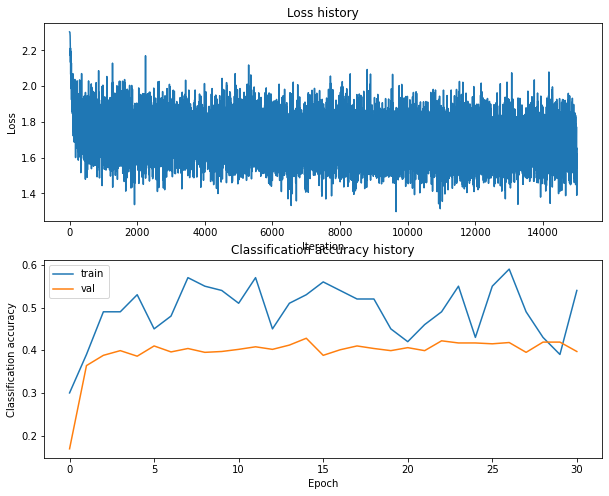

Training network with h_s 200, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.303372
iteration 100 / 15000: loss 2.299734
iteration 200 / 15000: loss 2.254987
iteration 300 / 15000: loss 2.151034
iteration 400 / 15000: loss 2.054947
iteration 500 / 15000: loss 2.043654
iteration 600 / 15000: loss 2.001637
iteration 700 / 15000: loss 2.019185
iteration 800 / 15000: loss 1.917755
iteration 900 / 15000: loss 1.844947
iteration 1000 / 15000: loss 1.879887
iteration 1100 / 15000: loss 1.782624
iteration 1200 / 15000: loss 1.807417
iteration 1300 / 15000: loss 1.879172
iteration 1400 / 15000: loss 1.860217
iteration 1500 / 15000: loss 1.851232
iteration 1600 / 15000: loss 1.859491
iteration 1700 / 15000: loss 1.876737
iteration 1800 / 15000: loss 1.831530
iteration 1900 / 15000: loss 1.743911
iteration 2000 / 15000: loss 1.702413
iteration 2100 / 15000: loss 1.695211
iteration 2200 / 15000: loss 1.782719
iteration 2300 / 15000: loss 1.787770
iteration 2400 / 15000: loss 1.686413


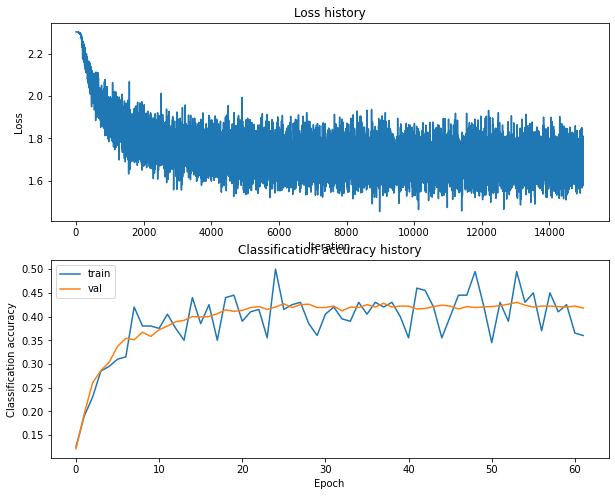

Training network with h_s 200, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.303388
iteration 100 / 15000: loss 1.940894
iteration 200 / 15000: loss 1.743053
iteration 300 / 15000: loss 1.799519
iteration 400 / 15000: loss 1.640396
iteration 500 / 15000: loss 1.818420
iteration 600 / 15000: loss 1.675575
iteration 700 / 15000: loss 1.583162
iteration 800 / 15000: loss 1.904003
iteration 900 / 15000: loss 1.578883
iteration 1000 / 15000: loss 1.654749
iteration 1100 / 15000: loss 1.697218
iteration 1200 / 15000: loss 1.685227
iteration 1300 / 15000: loss 1.705901
iteration 1400 / 15000: loss 1.701943
iteration 1500 / 15000: loss 1.653441
iteration 1600 / 15000: loss 1.829661
iteration 1700 / 15000: loss 1.636421
iteration 1800 / 15000: loss 1.773340
iteration 1900 / 15000: loss 1.775824
iteration 2000 / 15000: loss 1.745046
iteration 2100 / 15000: loss 1.659596
iteration 2200 / 15000: loss 1.704378
iteration 2300 / 15000: loss 1.763188
iteration 2400 / 15000: loss 1.722546
i

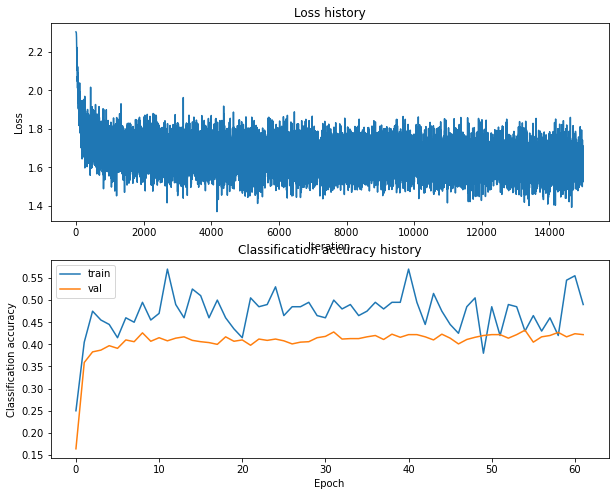

Training network with h_s 200, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.303363
iteration 100 / 15000: loss 2.299618
iteration 200 / 15000: loss 2.234617
iteration 300 / 15000: loss 2.145139
iteration 400 / 15000: loss 2.033610
iteration 500 / 15000: loss 1.948593
iteration 600 / 15000: loss 2.056798
iteration 700 / 15000: loss 1.936976
iteration 800 / 15000: loss 1.977704
iteration 900 / 15000: loss 1.863425
iteration 1000 / 15000: loss 1.980968
iteration 1100 / 15000: loss 1.918161
iteration 1200 / 15000: loss 1.802907
iteration 1300 / 15000: loss 1.826554
iteration 1400 / 15000: loss 1.845594
iteration 1500 / 15000: loss 1.929275
iteration 1600 / 15000: loss 1.812154
iteration 1700 / 15000: loss 1.881647
iteration 1800 / 15000: loss 1.775693
iteration 1900 / 15000: loss 1.760131
iteration 2000 / 15000: loss 1.830220
iteration 2100 / 15000: loss 1.830959
iteration 2200 / 15000: loss 1.830247
iteration 2300 / 15000: loss 1.716751
iteration 2400 / 15000: loss 1.891946


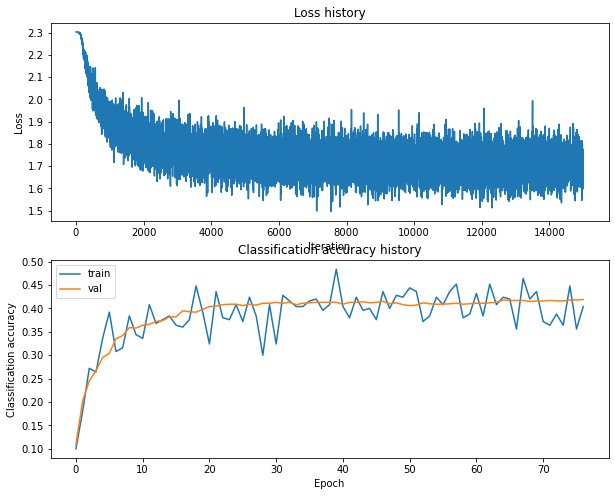

Training network with h_s 200, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.303383
iteration 100 / 15000: loss 1.924082
iteration 200 / 15000: loss 1.824512
iteration 300 / 15000: loss 1.802642
iteration 400 / 15000: loss 1.783659
iteration 500 / 15000: loss 1.673385
iteration 600 / 15000: loss 1.726649
iteration 700 / 15000: loss 1.560920
iteration 800 / 15000: loss 1.690301
iteration 900 / 15000: loss 1.738563
iteration 1000 / 15000: loss 1.868376
iteration 1100 / 15000: loss 1.746366
iteration 1200 / 15000: loss 1.785369
iteration 1300 / 15000: loss 1.644039
iteration 1400 / 15000: loss 1.713028
iteration 1500 / 15000: loss 1.552176
iteration 1600 / 15000: loss 1.704832
iteration 1700 / 15000: loss 1.660822
iteration 1800 / 15000: loss 1.525049
iteration 1900 / 15000: loss 1.701815
iteration 2000 / 15000: loss 1.606450
iteration 2100 / 15000: loss 1.631976
iteration 2200 / 15000: loss 1.718994
iteration 2300 / 15000: loss 1.650570
iteration 2400 / 15000: loss 1.650227
i

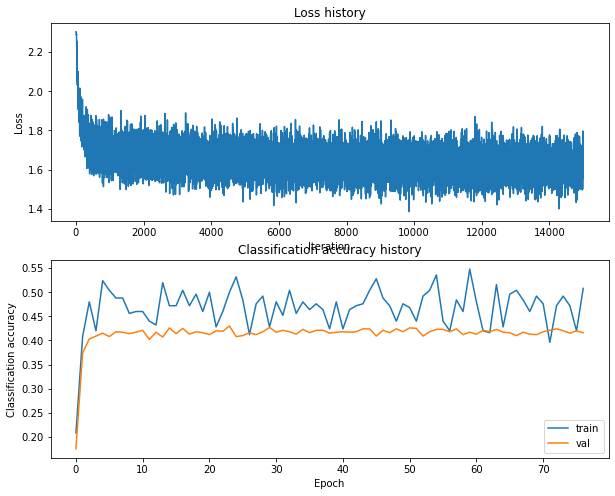

Training network with h_s 200, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.303382
iteration 100 / 15000: loss 2.299562
iteration 200 / 15000: loss 2.231481
iteration 300 / 15000: loss 2.145138
iteration 400 / 15000: loss 2.057457
iteration 500 / 15000: loss 1.987597
iteration 600 / 15000: loss 2.020076
iteration 700 / 15000: loss 1.964147
iteration 800 / 15000: loss 1.898186
iteration 900 / 15000: loss 1.906120
iteration 1000 / 15000: loss 1.839097
iteration 1100 / 15000: loss 1.798994
iteration 1200 / 15000: loss 1.842314
iteration 1300 / 15000: loss 1.991036
iteration 1400 / 15000: loss 1.787386
iteration 1500 / 15000: loss 1.806757
iteration 1600 / 15000: loss 1.785438
iteration 1700 / 15000: loss 1.779523
iteration 1800 / 15000: loss 1.777090
iteration 1900 / 15000: loss 1.773196
iteration 2000 / 15000: loss 1.809437
iteration 2100 / 15000: loss 1.810354
iteration 2200 / 15000: loss 1.774631
iteration 2300 / 15000: loss 1.800176
iteration 2400 / 15000: loss 1.662862


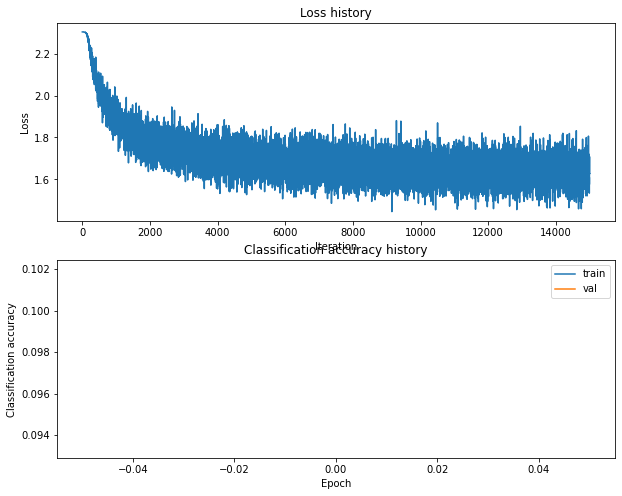

Training network with h_s 200, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.303404
iteration 100 / 15000: loss 1.888202
iteration 200 / 15000: loss 1.712293
iteration 300 / 15000: loss 1.695501
iteration 400 / 15000: loss 1.831792
iteration 500 / 15000: loss 1.727175
iteration 600 / 15000: loss 1.684329
iteration 700 / 15000: loss 1.693563
iteration 800 / 15000: loss 1.633467
iteration 900 / 15000: loss 1.717923
iteration 1000 / 15000: loss 1.786680
iteration 1100 / 15000: loss 1.658549
iteration 1200 / 15000: loss 1.745734
iteration 1300 / 15000: loss 1.617739
iteration 1400 / 15000: loss 1.688972
iteration 1500 / 15000: loss 1.608659
iteration 1600 / 15000: loss 1.695688
iteration 1700 / 15000: loss 1.671940
iteration 1800 / 15000: loss 1.615282
iteration 1900 / 15000: loss 1.670593
iteration 2000 / 15000: loss 1.761265
iteration 2100 / 15000: loss 1.668961
iteration 2200 / 15000: loss 1.626258
iteration 2300 / 15000: loss 1.615805
iteration 2400 / 15000: loss 1.712915
i

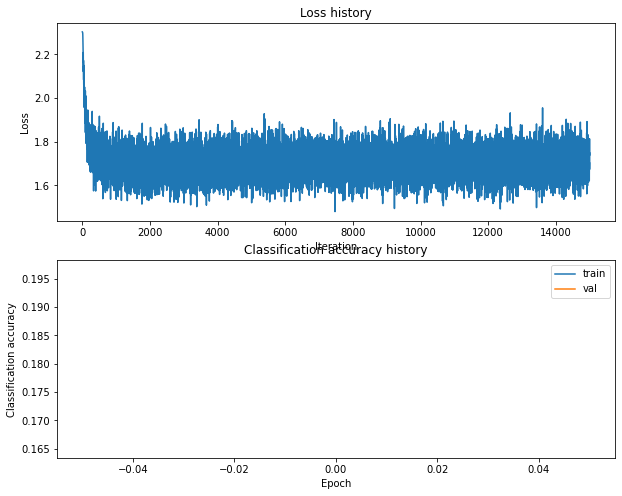

Training network with h_s 200, n_i 15000, b_s 500, l_r 0.0001
iteration 0 / 15000: loss 2.303403
iteration 100 / 15000: loss 2.300467
iteration 200 / 15000: loss 2.251125
iteration 300 / 15000: loss 2.170693
iteration 400 / 15000: loss 2.110731
iteration 500 / 15000: loss 2.063477
iteration 600 / 15000: loss 2.007519
iteration 700 / 15000: loss 1.978975
iteration 800 / 15000: loss 1.928659
iteration 900 / 15000: loss 1.948556
iteration 1000 / 15000: loss 1.939049
iteration 1100 / 15000: loss 1.973704
iteration 1200 / 15000: loss 1.923599
iteration 1300 / 15000: loss 1.970209
iteration 1400 / 15000: loss 1.869155
iteration 1500 / 15000: loss 1.856018
iteration 1600 / 15000: loss 1.854145
iteration 1700 / 15000: loss 1.853479
iteration 1800 / 15000: loss 1.824730
iteration 1900 / 15000: loss 1.845506
iteration 2000 / 15000: loss 1.863792
iteration 2100 / 15000: loss 1.843922
iteration 2200 / 15000: loss 1.835233
iteration 2300 / 15000: loss 1.794334
iteration 2400 / 15000: loss 1.824292


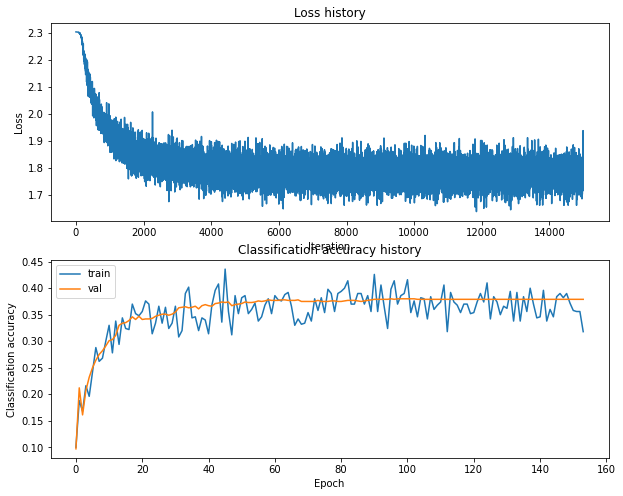

Training network with h_s 200, n_i 15000, b_s 500, l_r 0.001
iteration 0 / 15000: loss 2.303347
iteration 100 / 15000: loss 1.953457
iteration 200 / 15000: loss 1.846519
iteration 300 / 15000: loss 1.735620
iteration 400 / 15000: loss 1.709313
iteration 500 / 15000: loss 1.778101
iteration 600 / 15000: loss 1.695052
iteration 700 / 15000: loss 1.662507
iteration 800 / 15000: loss 1.677519
iteration 900 / 15000: loss 1.700732
iteration 1000 / 15000: loss 1.757779
iteration 1100 / 15000: loss 1.647598
iteration 1200 / 15000: loss 1.650028
iteration 1300 / 15000: loss 1.630966
iteration 1400 / 15000: loss 1.688717
iteration 1500 / 15000: loss 1.697374
iteration 1600 / 15000: loss 1.648558
iteration 1700 / 15000: loss 1.711601
iteration 1800 / 15000: loss 1.596925
iteration 1900 / 15000: loss 1.577506
iteration 2000 / 15000: loss 1.612023
iteration 2100 / 15000: loss 1.697372
iteration 2200 / 15000: loss 1.682005
iteration 2300 / 15000: loss 1.702936
iteration 2400 / 15000: loss 1.672993
i

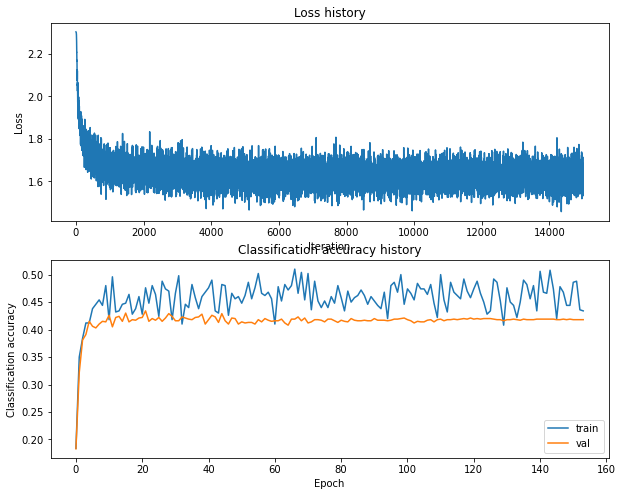

Training network with h_s 200, n_i 20000, b_s 100, l_r 0.0001
iteration 0 / 20000: loss 2.303350
iteration 100 / 20000: loss 2.300873
iteration 200 / 20000: loss 2.240401
iteration 300 / 20000: loss 2.147793
iteration 400 / 20000: loss 2.044745
iteration 500 / 20000: loss 2.005725
iteration 600 / 20000: loss 1.997241
iteration 700 / 20000: loss 1.956916
iteration 800 / 20000: loss 1.861830
iteration 900 / 20000: loss 1.988701
iteration 1000 / 20000: loss 1.856471
iteration 1100 / 20000: loss 1.898615
iteration 1200 / 20000: loss 1.996656
iteration 1300 / 20000: loss 1.737389
iteration 1400 / 20000: loss 1.766299
iteration 1500 / 20000: loss 1.717543
iteration 1600 / 20000: loss 1.744755
iteration 1700 / 20000: loss 1.810774
iteration 1800 / 20000: loss 1.760885
iteration 1900 / 20000: loss 1.745661
iteration 2000 / 20000: loss 1.861295
iteration 2100 / 20000: loss 1.893813
iteration 2200 / 20000: loss 1.678163
iteration 2300 / 20000: loss 1.726987
iteration 2400 / 20000: loss 1.831580


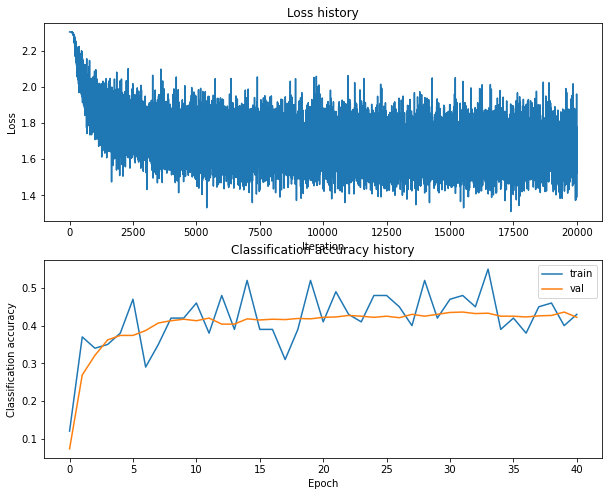

Training network with h_s 200, n_i 20000, b_s 100, l_r 0.001
iteration 0 / 20000: loss 2.303411
iteration 100 / 20000: loss 1.863361
iteration 200 / 20000: loss 1.805134
iteration 300 / 20000: loss 1.969277
iteration 400 / 20000: loss 2.107773
iteration 500 / 20000: loss 1.675963
iteration 600 / 20000: loss 1.641257
iteration 700 / 20000: loss 1.968292
iteration 800 / 20000: loss 1.581764
iteration 900 / 20000: loss 1.598089
iteration 1000 / 20000: loss 1.892488
iteration 1100 / 20000: loss 1.707416
iteration 1200 / 20000: loss 1.862347
iteration 1300 / 20000: loss 1.699550
iteration 1400 / 20000: loss 1.651688
iteration 1500 / 20000: loss 1.583394
iteration 1600 / 20000: loss 1.770850
iteration 1700 / 20000: loss 1.855809
iteration 1800 / 20000: loss 1.638852
iteration 1900 / 20000: loss 1.859060
iteration 2000 / 20000: loss 1.831389
iteration 2100 / 20000: loss 1.433858
iteration 2200 / 20000: loss 1.690778
iteration 2300 / 20000: loss 1.648456
iteration 2400 / 20000: loss 1.747311
i

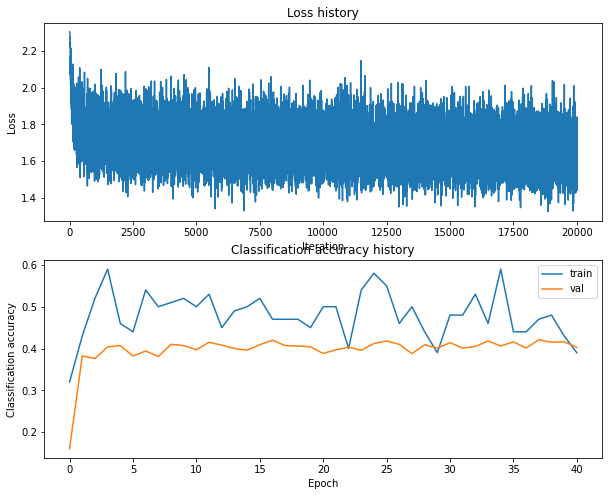

Training network with h_s 200, n_i 20000, b_s 200, l_r 0.0001
iteration 0 / 20000: loss 2.303367
iteration 100 / 20000: loss 2.299386
iteration 200 / 20000: loss 2.253926
iteration 300 / 20000: loss 2.137843
iteration 400 / 20000: loss 2.112465
iteration 500 / 20000: loss 2.062638
iteration 600 / 20000: loss 2.031012
iteration 700 / 20000: loss 1.975591
iteration 800 / 20000: loss 1.935752
iteration 900 / 20000: loss 1.873099
iteration 1000 / 20000: loss 1.938110
iteration 1100 / 20000: loss 1.891441
iteration 1200 / 20000: loss 1.826938
iteration 1300 / 20000: loss 1.907750
iteration 1400 / 20000: loss 1.856163
iteration 1500 / 20000: loss 1.892711
iteration 1600 / 20000: loss 1.793453
iteration 1700 / 20000: loss 1.734187
iteration 1800 / 20000: loss 1.824474
iteration 1900 / 20000: loss 1.878584
iteration 2000 / 20000: loss 1.749607
iteration 2100 / 20000: loss 1.771639
iteration 2200 / 20000: loss 1.793998
iteration 2300 / 20000: loss 1.811711
iteration 2400 / 20000: loss 1.827678


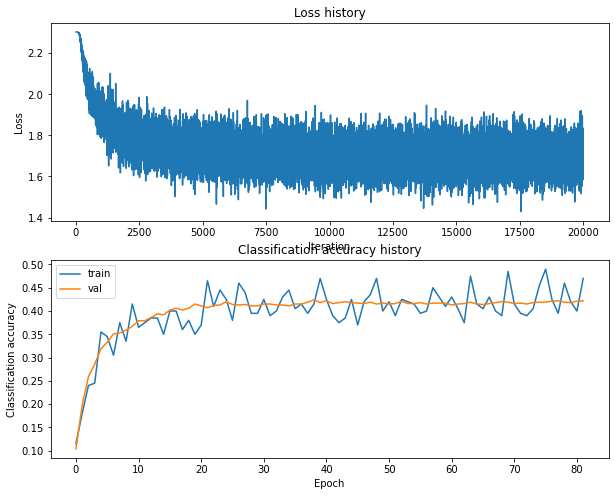

Training network with h_s 200, n_i 20000, b_s 200, l_r 0.001
iteration 0 / 20000: loss 2.303380
iteration 100 / 20000: loss 1.790127
iteration 200 / 20000: loss 1.739660
iteration 300 / 20000: loss 1.654971
iteration 400 / 20000: loss 1.854451
iteration 500 / 20000: loss 1.766189
iteration 600 / 20000: loss 1.782418
iteration 700 / 20000: loss 1.728142
iteration 800 / 20000: loss 1.732791
iteration 900 / 20000: loss 1.762058
iteration 1000 / 20000: loss 1.713877
iteration 1100 / 20000: loss 1.669841
iteration 1200 / 20000: loss 1.889370
iteration 1300 / 20000: loss 1.689950
iteration 1400 / 20000: loss 1.779900
iteration 1500 / 20000: loss 1.807174
iteration 1600 / 20000: loss 1.561939
iteration 1700 / 20000: loss 1.610450
iteration 1800 / 20000: loss 1.668361
iteration 1900 / 20000: loss 1.696006
iteration 2000 / 20000: loss 1.681939
iteration 2100 / 20000: loss 1.696695
iteration 2200 / 20000: loss 1.728097
iteration 2300 / 20000: loss 1.585708
iteration 2400 / 20000: loss 1.727548
i

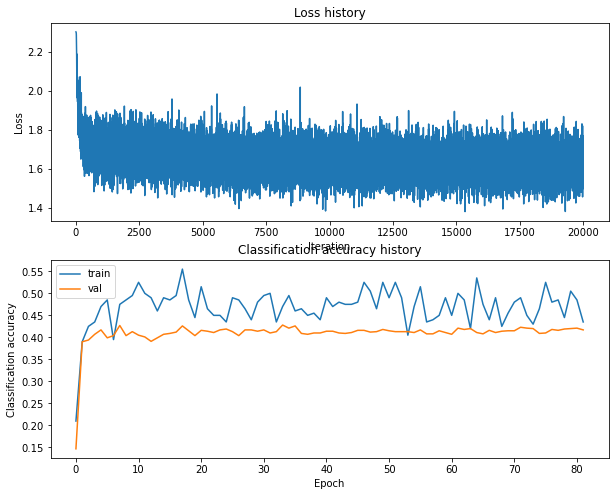

Training network with h_s 200, n_i 20000, b_s 250, l_r 0.0001
iteration 0 / 20000: loss 2.303376
iteration 100 / 20000: loss 2.298936
iteration 200 / 20000: loss 2.235892
iteration 300 / 20000: loss 2.159273
iteration 400 / 20000: loss 2.060621
iteration 500 / 20000: loss 1.981357
iteration 600 / 20000: loss 2.002198
iteration 700 / 20000: loss 1.976364
iteration 800 / 20000: loss 1.895892
iteration 900 / 20000: loss 1.970271
iteration 1000 / 20000: loss 1.983605
iteration 1100 / 20000: loss 1.925996
iteration 1200 / 20000: loss 1.840758
iteration 1300 / 20000: loss 1.850959
iteration 1400 / 20000: loss 1.781547
iteration 1500 / 20000: loss 1.830329
iteration 1600 / 20000: loss 1.765687
iteration 1700 / 20000: loss 1.840334
iteration 1800 / 20000: loss 1.851267
iteration 1900 / 20000: loss 1.823372
iteration 2000 / 20000: loss 1.783714
iteration 2100 / 20000: loss 1.766872
iteration 2200 / 20000: loss 1.856818
iteration 2300 / 20000: loss 1.780637
iteration 2400 / 20000: loss 1.780873


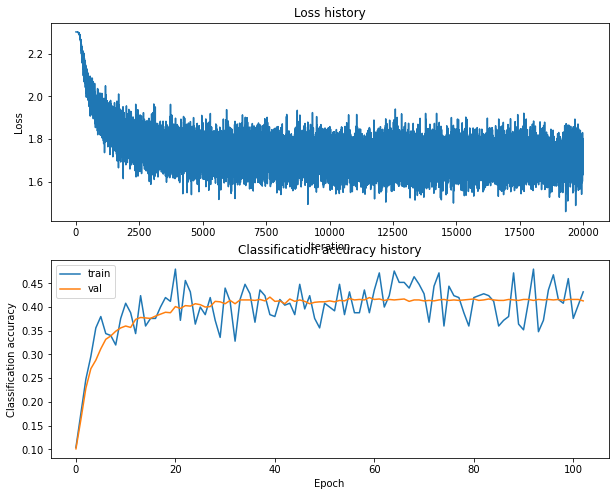

Training network with h_s 200, n_i 20000, b_s 250, l_r 0.001
iteration 0 / 20000: loss 2.303358
iteration 100 / 20000: loss 1.841018
iteration 200 / 20000: loss 1.693325
iteration 300 / 20000: loss 1.886891
iteration 400 / 20000: loss 1.712647
iteration 500 / 20000: loss 1.707108
iteration 600 / 20000: loss 1.752552
iteration 700 / 20000: loss 1.711713
iteration 800 / 20000: loss 1.660821
iteration 900 / 20000: loss 1.755402
iteration 1000 / 20000: loss 1.669794
iteration 1100 / 20000: loss 1.632961
iteration 1200 / 20000: loss 1.637194
iteration 1300 / 20000: loss 1.667658
iteration 1400 / 20000: loss 1.587981
iteration 1500 / 20000: loss 1.709707
iteration 1600 / 20000: loss 1.678792
iteration 1700 / 20000: loss 1.658933
iteration 1800 / 20000: loss 1.703842
iteration 1900 / 20000: loss 1.701383
iteration 2000 / 20000: loss 1.676038
iteration 2100 / 20000: loss 1.713592
iteration 2200 / 20000: loss 1.655025
iteration 2300 / 20000: loss 1.698984
iteration 2400 / 20000: loss 1.643611
i

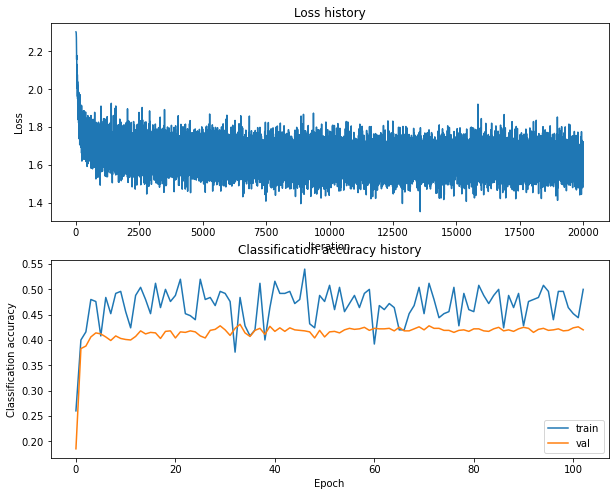

Training network with h_s 200, n_i 20000, b_s 300, l_r 0.0001
iteration 0 / 20000: loss 2.303355
iteration 100 / 20000: loss 2.299255
iteration 200 / 20000: loss 2.245630
iteration 300 / 20000: loss 2.171279
iteration 400 / 20000: loss 2.121452
iteration 500 / 20000: loss 2.019642
iteration 600 / 20000: loss 1.983997
iteration 700 / 20000: loss 1.964594
iteration 800 / 20000: loss 1.925101
iteration 900 / 20000: loss 1.884363
iteration 1000 / 20000: loss 1.856858
iteration 1100 / 20000: loss 1.818405
iteration 1200 / 20000: loss 1.772289
iteration 1300 / 20000: loss 1.834713
iteration 1400 / 20000: loss 1.826850
iteration 1500 / 20000: loss 1.856021
iteration 1600 / 20000: loss 1.871853
iteration 1700 / 20000: loss 1.807147
iteration 1800 / 20000: loss 1.787871
iteration 1900 / 20000: loss 1.767500
iteration 2000 / 20000: loss 1.807308
iteration 2100 / 20000: loss 1.793995
iteration 2200 / 20000: loss 1.769243
iteration 2300 / 20000: loss 1.654934
iteration 2400 / 20000: loss 1.709524


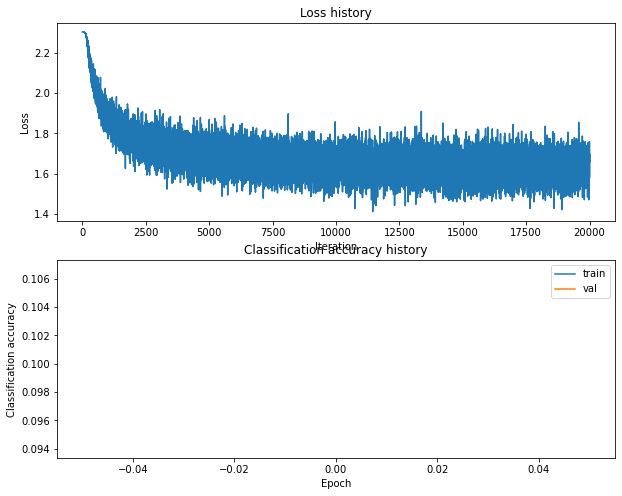

Training network with h_s 200, n_i 20000, b_s 300, l_r 0.001
iteration 0 / 20000: loss 2.303350
iteration 100 / 20000: loss 1.915135
iteration 200 / 20000: loss 1.760388
iteration 300 / 20000: loss 1.697413
iteration 400 / 20000: loss 1.782885
iteration 500 / 20000: loss 1.728118
iteration 600 / 20000: loss 1.680715
iteration 700 / 20000: loss 1.689210
iteration 800 / 20000: loss 1.629823
iteration 900 / 20000: loss 1.676126
iteration 1000 / 20000: loss 1.699297
iteration 1100 / 20000: loss 1.716384
iteration 1200 / 20000: loss 1.747200
iteration 1300 / 20000: loss 1.627853
iteration 1400 / 20000: loss 1.614222
iteration 1500 / 20000: loss 1.759317
iteration 1600 / 20000: loss 1.655618
iteration 1700 / 20000: loss 1.640207
iteration 1800 / 20000: loss 1.737853
iteration 1900 / 20000: loss 1.690987
iteration 2000 / 20000: loss 1.697132
iteration 2100 / 20000: loss 1.689601
iteration 2200 / 20000: loss 1.768135
iteration 2300 / 20000: loss 1.597624
iteration 2400 / 20000: loss 1.674062
i

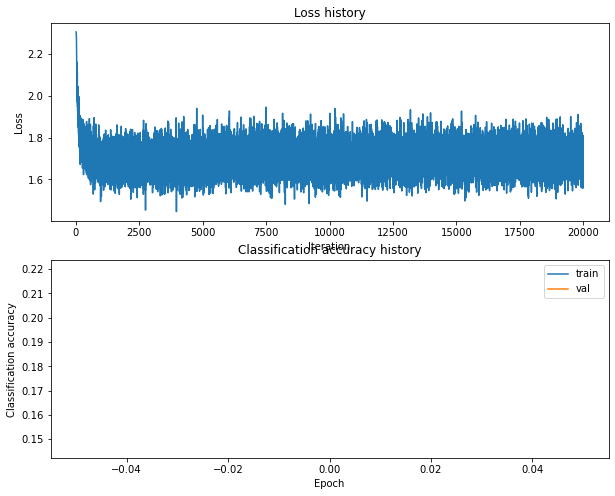

Training network with h_s 200, n_i 20000, b_s 500, l_r 0.0001
iteration 0 / 20000: loss 2.303345
iteration 100 / 20000: loss 2.299184
iteration 200 / 20000: loss 2.250642
iteration 300 / 20000: loss 2.160559
iteration 400 / 20000: loss 2.080556
iteration 500 / 20000: loss 2.066355
iteration 600 / 20000: loss 1.991317
iteration 700 / 20000: loss 2.013201
iteration 800 / 20000: loss 1.922940
iteration 900 / 20000: loss 1.952583
iteration 1000 / 20000: loss 1.945960
iteration 1100 / 20000: loss 1.879223
iteration 1200 / 20000: loss 1.883279
iteration 1300 / 20000: loss 1.916667
iteration 1400 / 20000: loss 1.842822
iteration 1500 / 20000: loss 1.911217
iteration 1600 / 20000: loss 1.866634
iteration 1700 / 20000: loss 1.856184
iteration 1800 / 20000: loss 1.854246
iteration 1900 / 20000: loss 1.838489
iteration 2000 / 20000: loss 1.880014
iteration 2100 / 20000: loss 1.796000
iteration 2200 / 20000: loss 1.905992
iteration 2300 / 20000: loss 1.855061
iteration 2400 / 20000: loss 1.950107


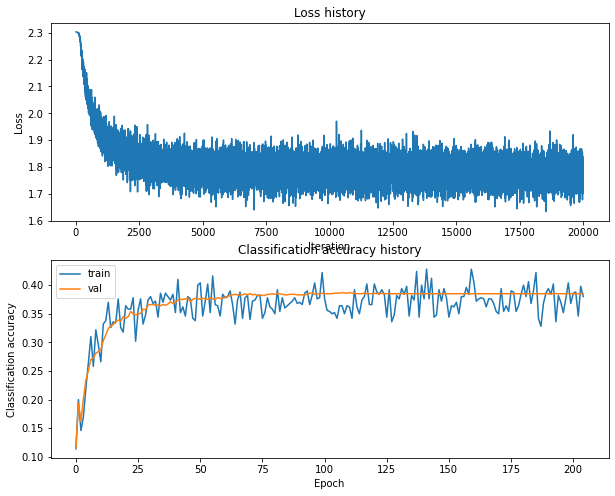

Training network with h_s 200, n_i 20000, b_s 500, l_r 0.001
iteration 0 / 20000: loss 2.303363
iteration 100 / 20000: loss 1.863863
iteration 200 / 20000: loss 1.806207
iteration 300 / 20000: loss 1.737561
iteration 400 / 20000: loss 1.678286
iteration 500 / 20000: loss 1.641392
iteration 600 / 20000: loss 1.755722
iteration 700 / 20000: loss 1.653038
iteration 800 / 20000: loss 1.655441
iteration 900 / 20000: loss 1.625281
iteration 1000 / 20000: loss 1.563068
iteration 1100 / 20000: loss 1.734237
iteration 1200 / 20000: loss 1.708448
iteration 1300 / 20000: loss 1.601054
iteration 1400 / 20000: loss 1.647448
iteration 1500 / 20000: loss 1.655374
iteration 1600 / 20000: loss 1.669631
iteration 1700 / 20000: loss 1.670540
iteration 1800 / 20000: loss 1.601430
iteration 1900 / 20000: loss 1.588748
iteration 2000 / 20000: loss 1.645322
iteration 2100 / 20000: loss 1.621484
iteration 2200 / 20000: loss 1.563117
iteration 2300 / 20000: loss 1.506062
iteration 2400 / 20000: loss 1.655973
i

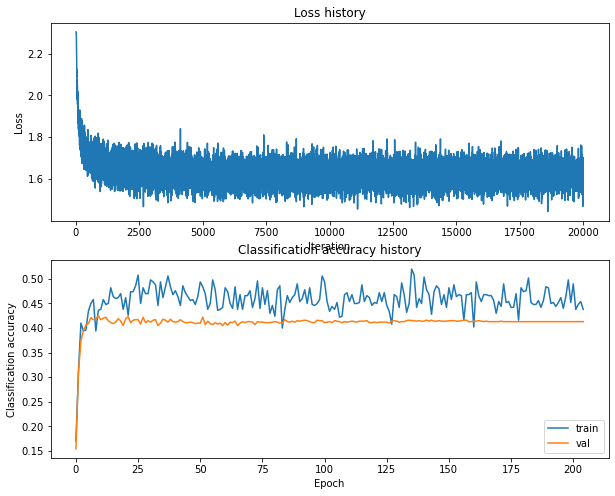

Training network with h_s 200, n_i 25000, b_s 100, l_r 0.0001
iteration 0 / 25000: loss 2.303372
iteration 100 / 25000: loss 2.299910
iteration 200 / 25000: loss 2.227453
iteration 300 / 25000: loss 2.231326
iteration 400 / 25000: loss 2.062388
iteration 500 / 25000: loss 2.087582
iteration 600 / 25000: loss 2.054113
iteration 700 / 25000: loss 2.062779
iteration 800 / 25000: loss 1.998581
iteration 900 / 25000: loss 1.889347
iteration 1000 / 25000: loss 1.852644
iteration 1100 / 25000: loss 1.938660
iteration 1200 / 25000: loss 1.939270
iteration 1300 / 25000: loss 1.673046
iteration 1400 / 25000: loss 1.750877
iteration 1500 / 25000: loss 1.744799
iteration 1600 / 25000: loss 1.858435
iteration 1700 / 25000: loss 1.824212
iteration 1800 / 25000: loss 1.911678
iteration 1900 / 25000: loss 1.923492
iteration 2000 / 25000: loss 1.836898
iteration 2100 / 25000: loss 1.841708
iteration 2200 / 25000: loss 1.781285
iteration 2300 / 25000: loss 1.762473
iteration 2400 / 25000: loss 1.884675


iteration 21200 / 25000: loss 1.850310
iteration 21300 / 25000: loss 1.736475
iteration 21400 / 25000: loss 1.722655
iteration 21500 / 25000: loss 1.722165
iteration 21600 / 25000: loss 1.717686
iteration 21700 / 25000: loss 1.575518
iteration 21800 / 25000: loss 1.603043
iteration 21900 / 25000: loss 1.654457
iteration 22000 / 25000: loss 1.643156
iteration 22100 / 25000: loss 1.754568
iteration 22200 / 25000: loss 1.520978
iteration 22300 / 25000: loss 1.583457
iteration 22400 / 25000: loss 1.653716
iteration 22500 / 25000: loss 1.715870
iteration 22600 / 25000: loss 1.700635
iteration 22700 / 25000: loss 1.590347
iteration 22800 / 25000: loss 1.649334
iteration 22900 / 25000: loss 1.747104
iteration 23000 / 25000: loss 1.825760
iteration 23100 / 25000: loss 1.717618
iteration 23200 / 25000: loss 1.756067
iteration 23300 / 25000: loss 1.651501
iteration 23400 / 25000: loss 1.534434
iteration 23500 / 25000: loss 1.629248
iteration 23600 / 25000: loss 1.558007
iteration 23700 / 25000: 

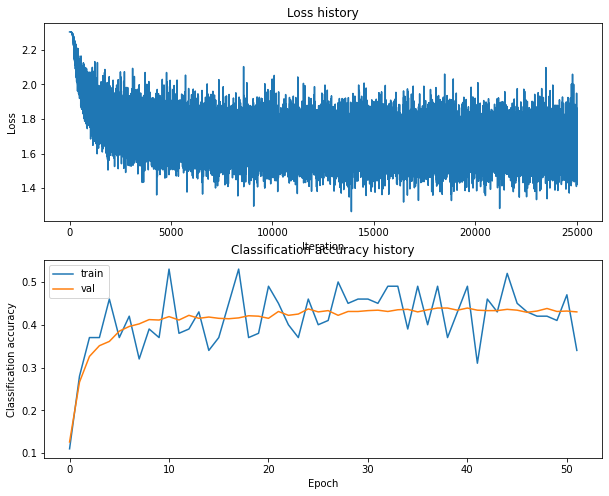

Training network with h_s 200, n_i 25000, b_s 100, l_r 0.001
iteration 0 / 25000: loss 2.303356
iteration 100 / 25000: loss 1.840508
iteration 200 / 25000: loss 1.979041
iteration 300 / 25000: loss 1.846641
iteration 400 / 25000: loss 1.876920
iteration 500 / 25000: loss 1.782219
iteration 600 / 25000: loss 1.741984
iteration 700 / 25000: loss 1.687260
iteration 800 / 25000: loss 1.647730
iteration 900 / 25000: loss 1.695527
iteration 1000 / 25000: loss 1.756343
iteration 1100 / 25000: loss 1.784753
iteration 1200 / 25000: loss 1.857660
iteration 1300 / 25000: loss 1.641888
iteration 1400 / 25000: loss 1.775038
iteration 1500 / 25000: loss 1.621429
iteration 1600 / 25000: loss 1.679745
iteration 1700 / 25000: loss 1.742959
iteration 1800 / 25000: loss 1.578066
iteration 1900 / 25000: loss 1.545188
iteration 2000 / 25000: loss 1.901821
iteration 2100 / 25000: loss 1.797800
iteration 2200 / 25000: loss 1.719626
iteration 2300 / 25000: loss 1.810536
iteration 2400 / 25000: loss 1.722528
i

iteration 21200 / 25000: loss 1.744289
iteration 21300 / 25000: loss 1.784147
iteration 21400 / 25000: loss 1.629049
iteration 21500 / 25000: loss 1.603332
iteration 21600 / 25000: loss 1.705317
iteration 21700 / 25000: loss 1.709290
iteration 21800 / 25000: loss 1.578854
iteration 21900 / 25000: loss 1.623190
iteration 22000 / 25000: loss 1.738377
iteration 22100 / 25000: loss 1.695577
iteration 22200 / 25000: loss 1.557293
iteration 22300 / 25000: loss 1.511887
iteration 22400 / 25000: loss 1.653812
iteration 22500 / 25000: loss 1.519648
iteration 22600 / 25000: loss 1.649348
iteration 22700 / 25000: loss 1.567459
iteration 22800 / 25000: loss 1.766943
iteration 22900 / 25000: loss 1.667346
iteration 23000 / 25000: loss 1.586503
iteration 23100 / 25000: loss 1.586682
iteration 23200 / 25000: loss 1.707120
iteration 23300 / 25000: loss 1.574324
iteration 23400 / 25000: loss 1.781568
iteration 23500 / 25000: loss 1.570012
iteration 23600 / 25000: loss 1.750193
iteration 23700 / 25000: 

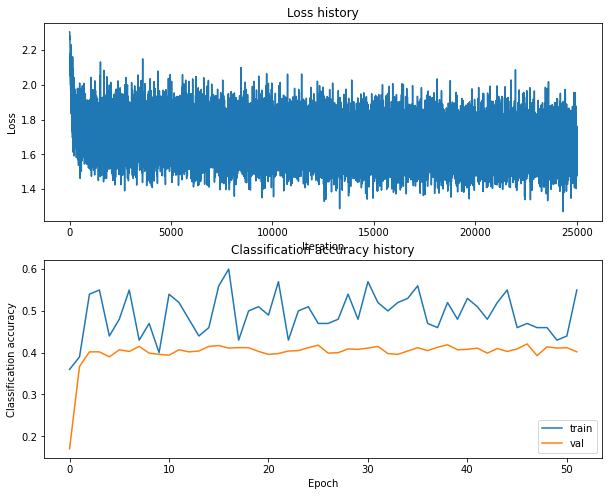

Training network with h_s 200, n_i 25000, b_s 200, l_r 0.0001
iteration 0 / 25000: loss 2.303349
iteration 100 / 25000: loss 2.299599
iteration 200 / 25000: loss 2.242203
iteration 300 / 25000: loss 2.115859
iteration 400 / 25000: loss 2.052417
iteration 500 / 25000: loss 2.006002
iteration 600 / 25000: loss 2.016779
iteration 700 / 25000: loss 1.988817
iteration 800 / 25000: loss 1.992033
iteration 900 / 25000: loss 1.921270
iteration 1000 / 25000: loss 1.892163
iteration 1100 / 25000: loss 1.886796
iteration 1200 / 25000: loss 1.878532
iteration 1300 / 25000: loss 1.830573
iteration 1400 / 25000: loss 1.900972
iteration 1500 / 25000: loss 1.800280
iteration 1600 / 25000: loss 1.864798
iteration 1700 / 25000: loss 1.905086
iteration 1800 / 25000: loss 1.896057
iteration 1900 / 25000: loss 1.703117
iteration 2000 / 25000: loss 1.746120
iteration 2100 / 25000: loss 1.756752
iteration 2200 / 25000: loss 1.887066
iteration 2300 / 25000: loss 1.673363
iteration 2400 / 25000: loss 1.764875


iteration 21200 / 25000: loss 1.648697
iteration 21300 / 25000: loss 1.652922
iteration 21400 / 25000: loss 1.683359
iteration 21500 / 25000: loss 1.608241
iteration 21600 / 25000: loss 1.612766
iteration 21700 / 25000: loss 1.616914
iteration 21800 / 25000: loss 1.752739
iteration 21900 / 25000: loss 1.740398
iteration 22000 / 25000: loss 1.689962
iteration 22100 / 25000: loss 1.588969
iteration 22200 / 25000: loss 1.741644
iteration 22300 / 25000: loss 1.710469
iteration 22400 / 25000: loss 1.658913
iteration 22500 / 25000: loss 1.704112
iteration 22600 / 25000: loss 1.688687
iteration 22700 / 25000: loss 1.716252
iteration 22800 / 25000: loss 1.627427
iteration 22900 / 25000: loss 1.712869
iteration 23000 / 25000: loss 1.690885
iteration 23100 / 25000: loss 1.728053
iteration 23200 / 25000: loss 1.743993
iteration 23300 / 25000: loss 1.699954
iteration 23400 / 25000: loss 1.652061
iteration 23500 / 25000: loss 1.704873
iteration 23600 / 25000: loss 1.724121
iteration 23700 / 25000: 

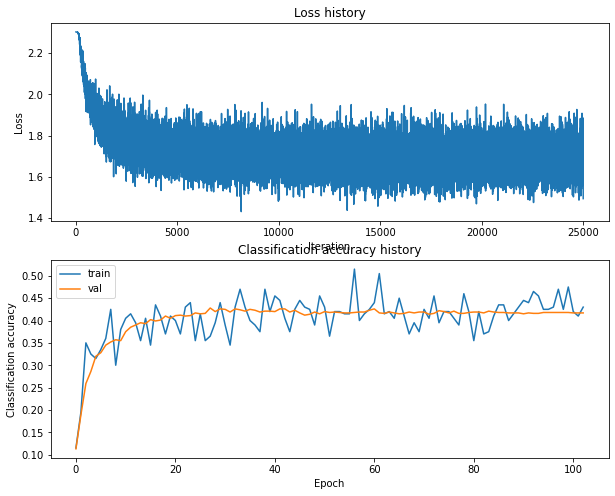

Training network with h_s 200, n_i 25000, b_s 200, l_r 0.001
iteration 0 / 25000: loss 2.303383
iteration 100 / 25000: loss 1.827270
iteration 200 / 25000: loss 1.781484
iteration 300 / 25000: loss 1.824251
iteration 400 / 25000: loss 1.782028
iteration 500 / 25000: loss 1.870249
iteration 600 / 25000: loss 1.701938
iteration 700 / 25000: loss 1.570233
iteration 800 / 25000: loss 1.700013
iteration 900 / 25000: loss 1.654369
iteration 1000 / 25000: loss 1.813439
iteration 1100 / 25000: loss 1.703300
iteration 1200 / 25000: loss 1.811046
iteration 1300 / 25000: loss 1.559841
iteration 1400 / 25000: loss 1.741154
iteration 1500 / 25000: loss 1.621875
iteration 1600 / 25000: loss 1.677335
iteration 1700 / 25000: loss 1.764039
iteration 1800 / 25000: loss 1.782323
iteration 1900 / 25000: loss 1.685684
iteration 2000 / 25000: loss 1.636703
iteration 2100 / 25000: loss 1.617458
iteration 2200 / 25000: loss 1.625628
iteration 2300 / 25000: loss 1.701581
iteration 2400 / 25000: loss 1.665771
i

iteration 21200 / 25000: loss 1.551619
iteration 21300 / 25000: loss 1.652886
iteration 21400 / 25000: loss 1.614578
iteration 21500 / 25000: loss 1.655152
iteration 21600 / 25000: loss 1.575732
iteration 21700 / 25000: loss 1.622729
iteration 21800 / 25000: loss 1.728040
iteration 21900 / 25000: loss 1.589060
iteration 22000 / 25000: loss 1.516316
iteration 22100 / 25000: loss 1.803093
iteration 22200 / 25000: loss 1.632079
iteration 22300 / 25000: loss 1.667507
iteration 22400 / 25000: loss 1.617438
iteration 22500 / 25000: loss 1.593088
iteration 22600 / 25000: loss 1.687726
iteration 22700 / 25000: loss 1.519531
iteration 22800 / 25000: loss 1.510240
iteration 22900 / 25000: loss 1.580033
iteration 23000 / 25000: loss 1.668288
iteration 23100 / 25000: loss 1.701561
iteration 23200 / 25000: loss 1.516733
iteration 23300 / 25000: loss 1.744734
iteration 23400 / 25000: loss 1.547655
iteration 23500 / 25000: loss 1.622682
iteration 23600 / 25000: loss 1.419438
iteration 23700 / 25000: 

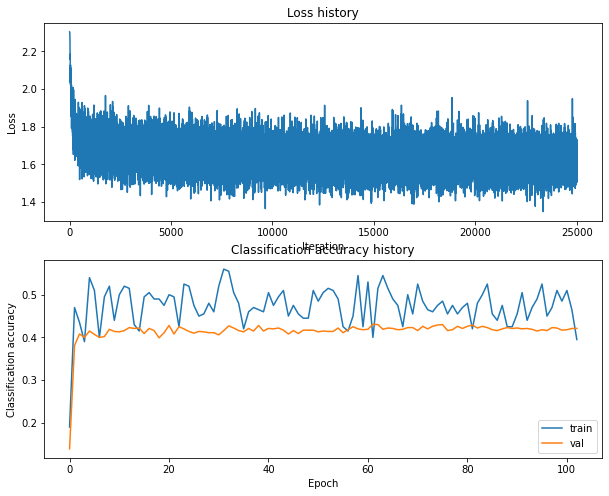

Training network with h_s 200, n_i 25000, b_s 250, l_r 0.0001
iteration 0 / 25000: loss 2.303359
iteration 100 / 25000: loss 2.299336
iteration 200 / 25000: loss 2.242454
iteration 300 / 25000: loss 2.161165
iteration 400 / 25000: loss 2.135330
iteration 500 / 25000: loss 2.032786
iteration 600 / 25000: loss 2.014292
iteration 700 / 25000: loss 1.948440
iteration 800 / 25000: loss 1.993663
iteration 900 / 25000: loss 1.942435
iteration 1000 / 25000: loss 1.947537
iteration 1100 / 25000: loss 1.904612
iteration 1200 / 25000: loss 1.878308
iteration 1300 / 25000: loss 1.830410
iteration 1400 / 25000: loss 1.900897
iteration 1500 / 25000: loss 1.876814
iteration 1600 / 25000: loss 1.848351
iteration 1700 / 25000: loss 1.906872
iteration 1800 / 25000: loss 1.746919
iteration 1900 / 25000: loss 1.820582
iteration 2000 / 25000: loss 1.804975
iteration 2100 / 25000: loss 1.701312
iteration 2200 / 25000: loss 1.861915
iteration 2300 / 25000: loss 1.764860
iteration 2400 / 25000: loss 1.692820


iteration 21200 / 25000: loss 1.698871
iteration 21300 / 25000: loss 1.782552
iteration 21400 / 25000: loss 1.788445
iteration 21500 / 25000: loss 1.757904
iteration 21600 / 25000: loss 1.709782
iteration 21700 / 25000: loss 1.714951
iteration 21800 / 25000: loss 1.744498
iteration 21900 / 25000: loss 1.745102
iteration 22000 / 25000: loss 1.641370
iteration 22100 / 25000: loss 1.595369
iteration 22200 / 25000: loss 1.645788
iteration 22300 / 25000: loss 1.712964
iteration 22400 / 25000: loss 1.677439
iteration 22500 / 25000: loss 1.779048
iteration 22600 / 25000: loss 1.668839
iteration 22700 / 25000: loss 1.605353
iteration 22800 / 25000: loss 1.729209
iteration 22900 / 25000: loss 1.711603
iteration 23000 / 25000: loss 1.752829
iteration 23100 / 25000: loss 1.693040
iteration 23200 / 25000: loss 1.697284
iteration 23300 / 25000: loss 1.806912
iteration 23400 / 25000: loss 1.653378
iteration 23500 / 25000: loss 1.777401
iteration 23600 / 25000: loss 1.691346
iteration 23700 / 25000: 

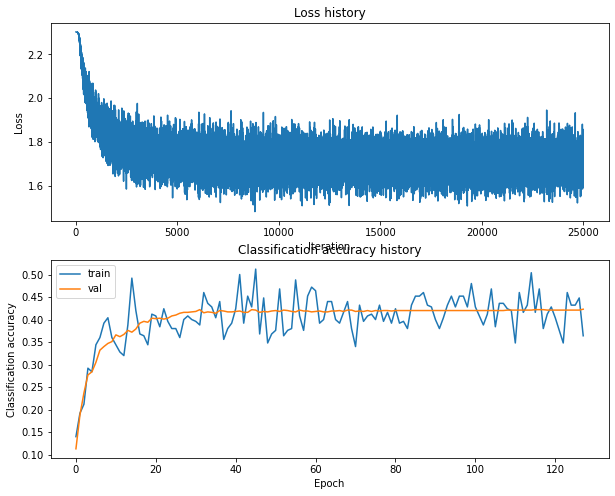

Training network with h_s 200, n_i 25000, b_s 250, l_r 0.001
iteration 0 / 25000: loss 2.303345
iteration 100 / 25000: loss 1.838504
iteration 200 / 25000: loss 1.719639
iteration 300 / 25000: loss 1.815249
iteration 400 / 25000: loss 1.724006
iteration 500 / 25000: loss 1.709217
iteration 600 / 25000: loss 1.681893
iteration 700 / 25000: loss 1.666695
iteration 800 / 25000: loss 1.702406
iteration 900 / 25000: loss 1.727964
iteration 1000 / 25000: loss 1.729127
iteration 1100 / 25000: loss 1.637686
iteration 1200 / 25000: loss 1.745056
iteration 1300 / 25000: loss 1.675992
iteration 1400 / 25000: loss 1.670572
iteration 1500 / 25000: loss 1.582158
iteration 1600 / 25000: loss 1.695709
iteration 1700 / 25000: loss 1.674182
iteration 1800 / 25000: loss 1.737041
iteration 1900 / 25000: loss 1.670931
iteration 2000 / 25000: loss 1.708777
iteration 2100 / 25000: loss 1.704679
iteration 2200 / 25000: loss 1.758367
iteration 2300 / 25000: loss 1.552795
iteration 2400 / 25000: loss 1.657922
i

iteration 21200 / 25000: loss 1.589889
iteration 21300 / 25000: loss 1.575381
iteration 21400 / 25000: loss 1.834263
iteration 21500 / 25000: loss 1.522658
iteration 21600 / 25000: loss 1.577151
iteration 21700 / 25000: loss 1.643890
iteration 21800 / 25000: loss 1.644682
iteration 21900 / 25000: loss 1.658399
iteration 22000 / 25000: loss 1.620737
iteration 22100 / 25000: loss 1.551641
iteration 22200 / 25000: loss 1.586837
iteration 22300 / 25000: loss 1.586324
iteration 22400 / 25000: loss 1.685207
iteration 22500 / 25000: loss 1.578306
iteration 22600 / 25000: loss 1.517754
iteration 22700 / 25000: loss 1.586488
iteration 22800 / 25000: loss 1.711986
iteration 22900 / 25000: loss 1.663211
iteration 23000 / 25000: loss 1.548262
iteration 23100 / 25000: loss 1.586970
iteration 23200 / 25000: loss 1.627652
iteration 23300 / 25000: loss 1.597025
iteration 23400 / 25000: loss 1.650905
iteration 23500 / 25000: loss 1.530348
iteration 23600 / 25000: loss 1.582144
iteration 23700 / 25000: 

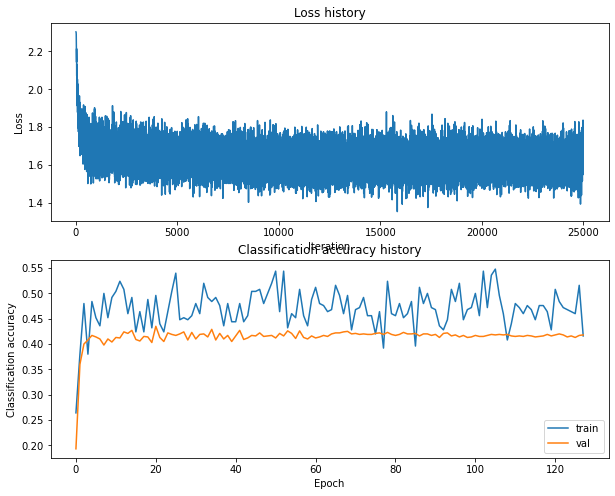

Training network with h_s 200, n_i 25000, b_s 300, l_r 0.0001
iteration 0 / 25000: loss 2.303324
iteration 100 / 25000: loss 2.298693
iteration 200 / 25000: loss 2.230126
iteration 300 / 25000: loss 2.134342
iteration 400 / 25000: loss 2.096246
iteration 500 / 25000: loss 2.017168
iteration 600 / 25000: loss 1.998359
iteration 700 / 25000: loss 1.981344
iteration 800 / 25000: loss 1.902435
iteration 900 / 25000: loss 1.939466
iteration 1000 / 25000: loss 1.959777
iteration 1100 / 25000: loss 1.939369
iteration 1200 / 25000: loss 1.881546
iteration 1300 / 25000: loss 1.989759
iteration 1400 / 25000: loss 1.846418
iteration 1500 / 25000: loss 1.838723
iteration 1600 / 25000: loss 1.816909
iteration 1700 / 25000: loss 1.837495
iteration 1800 / 25000: loss 1.753248
iteration 1900 / 25000: loss 1.792941
iteration 2000 / 25000: loss 1.805738
iteration 2100 / 25000: loss 1.789591
iteration 2200 / 25000: loss 1.682006
iteration 2300 / 25000: loss 1.841064
iteration 2400 / 25000: loss 1.724405


iteration 21200 / 25000: loss 1.692686
iteration 21300 / 25000: loss 1.636229
iteration 21400 / 25000: loss 1.720230
iteration 21500 / 25000: loss 1.646940
iteration 21600 / 25000: loss 1.603949
iteration 21700 / 25000: loss 1.492084
iteration 21800 / 25000: loss 1.564418
iteration 21900 / 25000: loss 1.648073
iteration 22000 / 25000: loss 1.682658
iteration 22100 / 25000: loss 1.658801
iteration 22200 / 25000: loss 1.568231
iteration 22300 / 25000: loss 1.615627
iteration 22400 / 25000: loss 1.615780
iteration 22500 / 25000: loss 1.615545
iteration 22600 / 25000: loss 1.553871
iteration 22700 / 25000: loss 1.630520
iteration 22800 / 25000: loss 1.582403
iteration 22900 / 25000: loss 1.585642
iteration 23000 / 25000: loss 1.657155
iteration 23100 / 25000: loss 1.594619
iteration 23200 / 25000: loss 1.616099
iteration 23300 / 25000: loss 1.703575
iteration 23400 / 25000: loss 1.679733
iteration 23500 / 25000: loss 1.601335
iteration 23600 / 25000: loss 1.587057
iteration 23700 / 25000: 

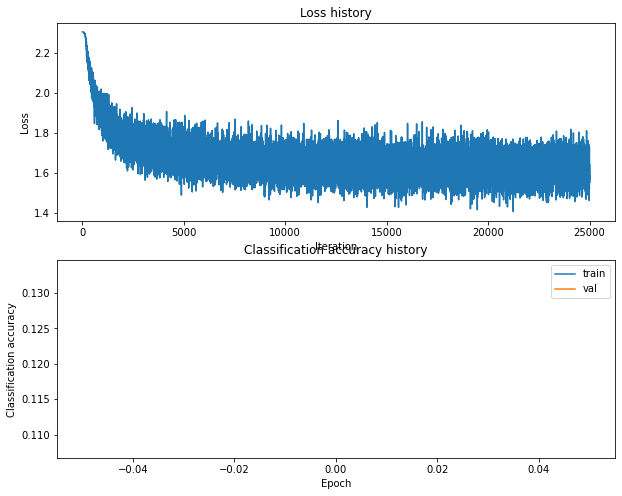

Training network with h_s 200, n_i 25000, b_s 300, l_r 0.001
iteration 0 / 25000: loss 2.303378
iteration 100 / 25000: loss 1.908981
iteration 200 / 25000: loss 1.868026
iteration 300 / 25000: loss 1.806481
iteration 400 / 25000: loss 1.692153
iteration 500 / 25000: loss 1.654776
iteration 600 / 25000: loss 1.701224
iteration 700 / 25000: loss 1.601990
iteration 800 / 25000: loss 1.603329
iteration 900 / 25000: loss 1.732635
iteration 1000 / 25000: loss 1.645205
iteration 1100 / 25000: loss 1.703917
iteration 1200 / 25000: loss 1.660425
iteration 1300 / 25000: loss 1.749267
iteration 1400 / 25000: loss 1.663622
iteration 1500 / 25000: loss 1.700469
iteration 1600 / 25000: loss 1.818051
iteration 1700 / 25000: loss 1.762242
iteration 1800 / 25000: loss 1.754092
iteration 1900 / 25000: loss 1.645305
iteration 2000 / 25000: loss 1.655380
iteration 2100 / 25000: loss 1.687050
iteration 2200 / 25000: loss 1.697113
iteration 2300 / 25000: loss 1.751945
iteration 2400 / 25000: loss 1.570627
i

iteration 21200 / 25000: loss 1.569205
iteration 21300 / 25000: loss 1.658628
iteration 21400 / 25000: loss 1.750581
iteration 21500 / 25000: loss 1.767234
iteration 21600 / 25000: loss 1.671881
iteration 21700 / 25000: loss 1.673171
iteration 21800 / 25000: loss 1.728639
iteration 21900 / 25000: loss 1.666980
iteration 22000 / 25000: loss 1.647513
iteration 22100 / 25000: loss 1.657695
iteration 22200 / 25000: loss 1.679367
iteration 22300 / 25000: loss 1.716607
iteration 22400 / 25000: loss 1.640683
iteration 22500 / 25000: loss 1.681981
iteration 22600 / 25000: loss 1.860534
iteration 22700 / 25000: loss 1.720558
iteration 22800 / 25000: loss 1.601297
iteration 22900 / 25000: loss 1.621807
iteration 23000 / 25000: loss 1.604336
iteration 23100 / 25000: loss 1.648798
iteration 23200 / 25000: loss 1.778847
iteration 23300 / 25000: loss 1.755592
iteration 23400 / 25000: loss 1.756454
iteration 23500 / 25000: loss 1.633328
iteration 23600 / 25000: loss 1.681678
iteration 23700 / 25000: 

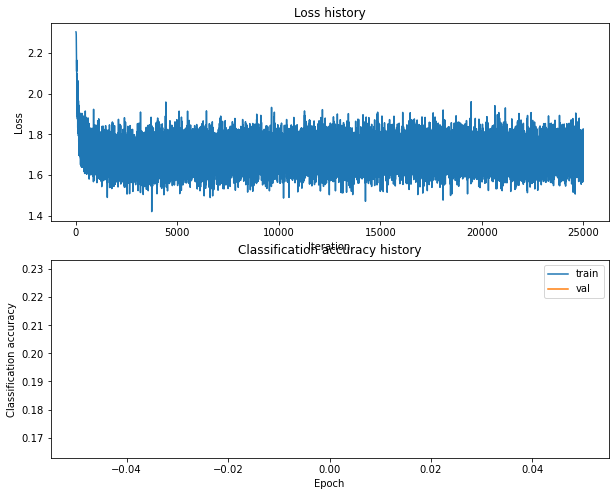

Training network with h_s 200, n_i 25000, b_s 500, l_r 0.0001
iteration 0 / 25000: loss 2.303351
iteration 100 / 25000: loss 2.299006
iteration 200 / 25000: loss 2.244844
iteration 300 / 25000: loss 2.166171
iteration 400 / 25000: loss 2.120663
iteration 500 / 25000: loss 2.066016
iteration 600 / 25000: loss 1.950451
iteration 700 / 25000: loss 2.011203
iteration 800 / 25000: loss 1.970557
iteration 900 / 25000: loss 1.938481
iteration 1000 / 25000: loss 1.890520
iteration 1100 / 25000: loss 1.884025
iteration 1200 / 25000: loss 1.849403
iteration 1300 / 25000: loss 1.840306
iteration 1400 / 25000: loss 1.877043
iteration 1500 / 25000: loss 1.903778
iteration 1600 / 25000: loss 1.884209
iteration 1700 / 25000: loss 1.845954
iteration 1800 / 25000: loss 1.825376
iteration 1900 / 25000: loss 1.883034
iteration 2000 / 25000: loss 1.903980
iteration 2100 / 25000: loss 1.836954
iteration 2200 / 25000: loss 1.833431
iteration 2300 / 25000: loss 1.810605
iteration 2400 / 25000: loss 1.778183


iteration 21200 / 25000: loss 1.742840
iteration 21300 / 25000: loss 1.773678
iteration 21400 / 25000: loss 1.769928
iteration 21500 / 25000: loss 1.762677
iteration 21600 / 25000: loss 1.778548
iteration 21700 / 25000: loss 1.778070
iteration 21800 / 25000: loss 1.747952
iteration 21900 / 25000: loss 1.740469
iteration 22000 / 25000: loss 1.770519
iteration 22100 / 25000: loss 1.878653
iteration 22200 / 25000: loss 1.790561
iteration 22300 / 25000: loss 1.773193
iteration 22400 / 25000: loss 1.760252
iteration 22500 / 25000: loss 1.759873
iteration 22600 / 25000: loss 1.781325
iteration 22700 / 25000: loss 1.850595
iteration 22800 / 25000: loss 1.740909
iteration 22900 / 25000: loss 1.805258
iteration 23000 / 25000: loss 1.813209
iteration 23100 / 25000: loss 1.673224
iteration 23200 / 25000: loss 1.740621
iteration 23300 / 25000: loss 1.832150
iteration 23400 / 25000: loss 1.815407
iteration 23500 / 25000: loss 1.781785
iteration 23600 / 25000: loss 1.791305
iteration 23700 / 25000: 

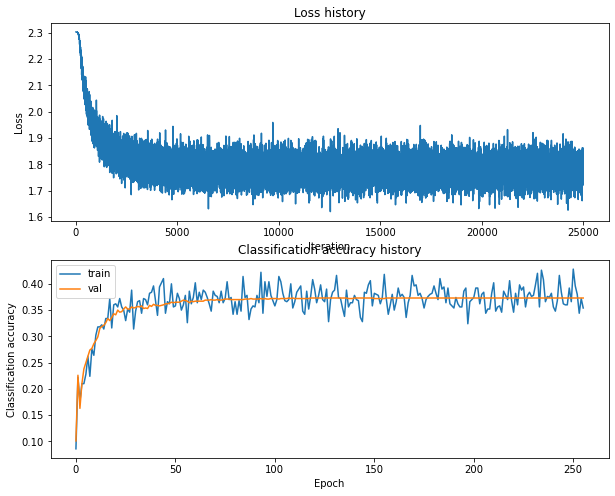

Training network with h_s 200, n_i 25000, b_s 500, l_r 0.001
iteration 0 / 25000: loss 2.303323
iteration 100 / 25000: loss 1.930827
iteration 200 / 25000: loss 1.813840
iteration 300 / 25000: loss 1.717269
iteration 400 / 25000: loss 1.746602
iteration 500 / 25000: loss 1.794418
iteration 600 / 25000: loss 1.763545
iteration 700 / 25000: loss 1.697006
iteration 800 / 25000: loss 1.679744
iteration 900 / 25000: loss 1.673129
iteration 1000 / 25000: loss 1.650531
iteration 1100 / 25000: loss 1.671770
iteration 1200 / 25000: loss 1.671226
iteration 1300 / 25000: loss 1.649873
iteration 1400 / 25000: loss 1.688091
iteration 1500 / 25000: loss 1.578118
iteration 1600 / 25000: loss 1.675027
iteration 1700 / 25000: loss 1.655036
iteration 1800 / 25000: loss 1.588899
iteration 1900 / 25000: loss 1.648286
iteration 2000 / 25000: loss 1.706594
iteration 2100 / 25000: loss 1.638222
iteration 2200 / 25000: loss 1.625803
iteration 2300 / 25000: loss 1.610529
iteration 2400 / 25000: loss 1.683621
i

iteration 21200 / 25000: loss 1.657124
iteration 21300 / 25000: loss 1.542998
iteration 21400 / 25000: loss 1.629989
iteration 21500 / 25000: loss 1.690668
iteration 21600 / 25000: loss 1.638271
iteration 21700 / 25000: loss 1.550746
iteration 21800 / 25000: loss 1.623782
iteration 21900 / 25000: loss 1.615248
iteration 22000 / 25000: loss 1.679796
iteration 22100 / 25000: loss 1.602884
iteration 22200 / 25000: loss 1.576271
iteration 22300 / 25000: loss 1.663746
iteration 22400 / 25000: loss 1.592846
iteration 22500 / 25000: loss 1.618687
iteration 22600 / 25000: loss 1.668114
iteration 22700 / 25000: loss 1.574497
iteration 22800 / 25000: loss 1.536431
iteration 22900 / 25000: loss 1.642112
iteration 23000 / 25000: loss 1.624238
iteration 23100 / 25000: loss 1.687351
iteration 23200 / 25000: loss 1.648496
iteration 23300 / 25000: loss 1.651723
iteration 23400 / 25000: loss 1.693171
iteration 23500 / 25000: loss 1.705935
iteration 23600 / 25000: loss 1.655484
iteration 23700 / 25000: 

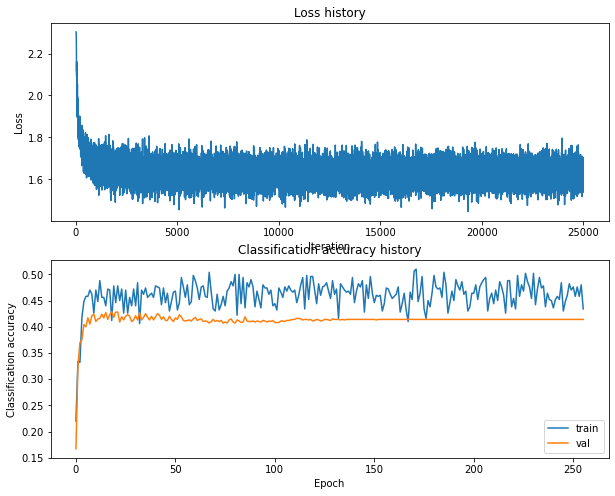

Training network with h_s 280, n_i 500, b_s 100, l_r 0.0001
iteration 0 / 500: loss 2.303651
iteration 100 / 500: loss 2.297283
iteration 200 / 500: loss 2.196034
iteration 300 / 500: loss 2.058434
iteration 400 / 500: loss 2.059121
Validation accuracy:  0.266


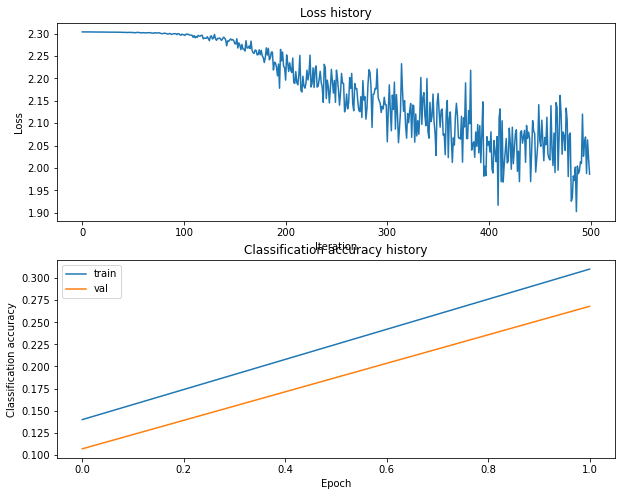

Training network with h_s 280, n_i 500, b_s 100, l_r 0.001
iteration 0 / 500: loss 2.303688
iteration 100 / 500: loss 1.849486
iteration 200 / 500: loss 1.670864
iteration 300 / 500: loss 1.725191
iteration 400 / 500: loss 1.737373
Validation accuracy:  0.388


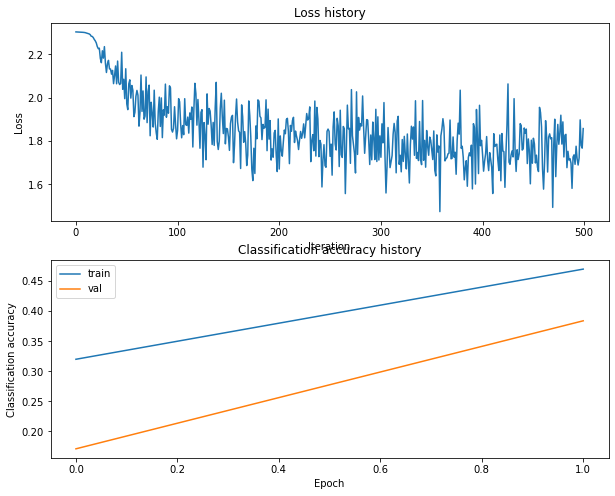

Training network with h_s 280, n_i 500, b_s 200, l_r 0.0001
iteration 0 / 500: loss 2.303617
iteration 100 / 500: loss 2.298656
iteration 200 / 500: loss 2.228343
iteration 300 / 500: loss 2.138585
iteration 400 / 500: loss 2.076464
Validation accuracy:  0.267


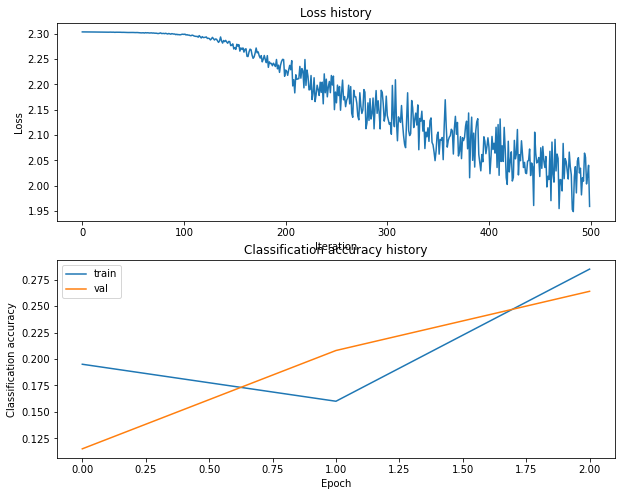

Training network with h_s 280, n_i 500, b_s 200, l_r 0.001
iteration 0 / 500: loss 2.303667
iteration 100 / 500: loss 1.858051
iteration 200 / 500: loss 1.823298
iteration 300 / 500: loss 1.796358
iteration 400 / 500: loss 1.746970
Validation accuracy:  0.396


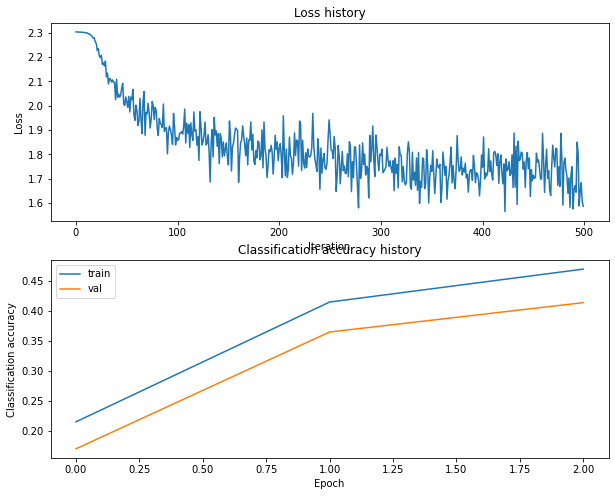

Training network with h_s 280, n_i 500, b_s 250, l_r 0.0001
iteration 0 / 500: loss 2.303624
iteration 100 / 500: loss 2.298443
iteration 200 / 500: loss 2.247776
iteration 300 / 500: loss 2.131924
iteration 400 / 500: loss 2.072631
Validation accuracy:  0.265


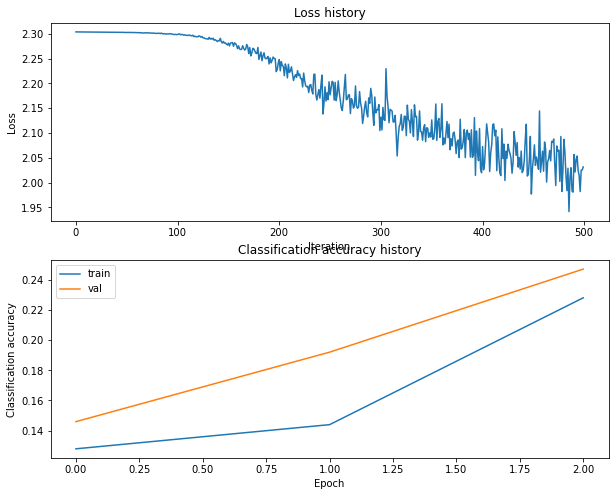

Training network with h_s 280, n_i 500, b_s 250, l_r 0.001
iteration 0 / 500: loss 2.303666
iteration 100 / 500: loss 1.877118
iteration 200 / 500: loss 1.755114
iteration 300 / 500: loss 1.697022
iteration 400 / 500: loss 1.752035
Validation accuracy:  0.405


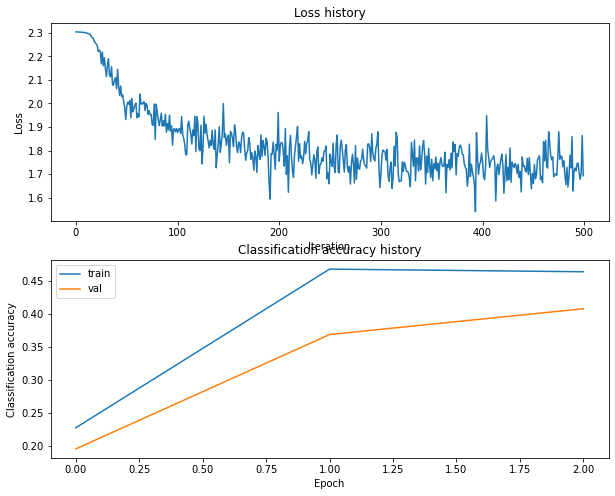

Training network with h_s 280, n_i 500, b_s 300, l_r 0.0001
iteration 0 / 500: loss 2.303708
iteration 100 / 500: loss 2.297649
iteration 200 / 500: loss 2.228770
iteration 300 / 500: loss 2.118462
iteration 400 / 500: loss 2.108276
Validation accuracy:  0.269


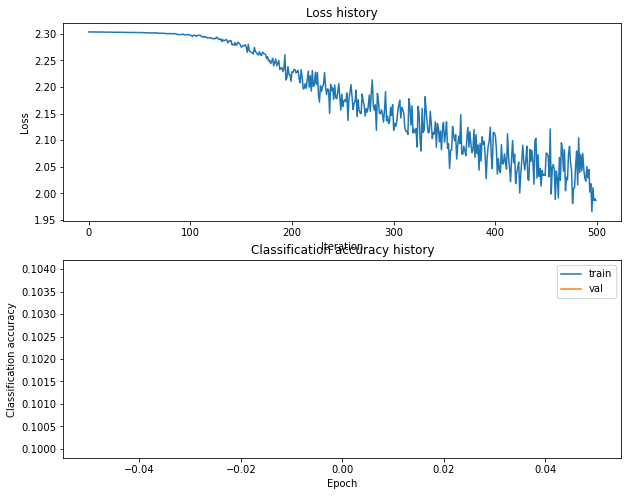

Training network with h_s 280, n_i 500, b_s 300, l_r 0.001
iteration 0 / 500: loss 2.303686
iteration 100 / 500: loss 1.877852
iteration 200 / 500: loss 1.772855
iteration 300 / 500: loss 1.706724
iteration 400 / 500: loss 1.711526
Validation accuracy:  0.391


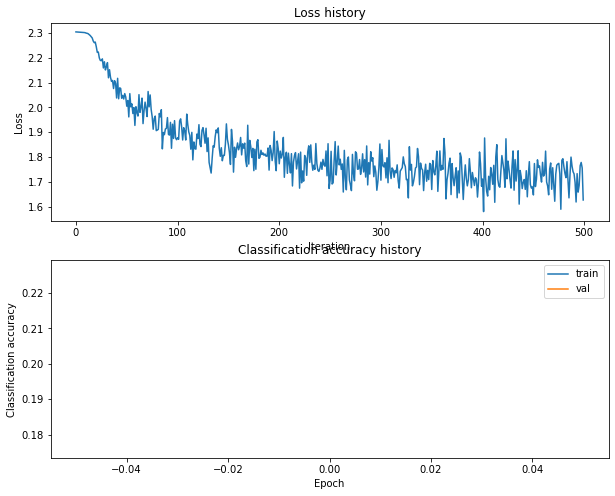

Training network with h_s 280, n_i 500, b_s 500, l_r 0.0001
iteration 0 / 500: loss 2.303671
iteration 100 / 500: loss 2.297979
iteration 200 / 500: loss 2.224204
iteration 300 / 500: loss 2.153925
iteration 400 / 500: loss 2.091450
Validation accuracy:  0.258


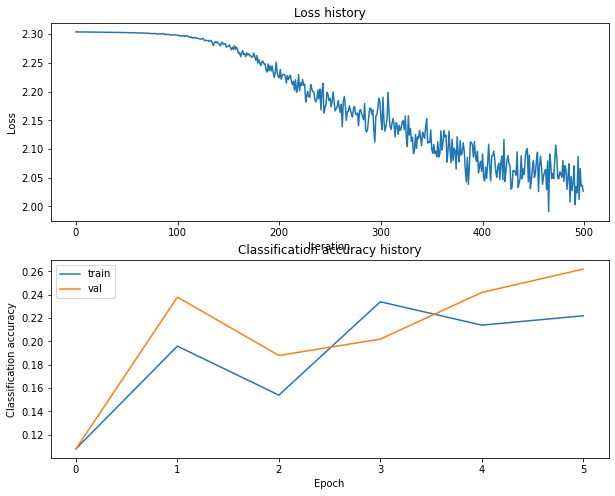

Training network with h_s 280, n_i 500, b_s 500, l_r 0.001
iteration 0 / 500: loss 2.303639
iteration 100 / 500: loss 1.840691
iteration 200 / 500: loss 1.790530
iteration 300 / 500: loss 1.757675
iteration 400 / 500: loss 1.697688
Validation accuracy:  0.417


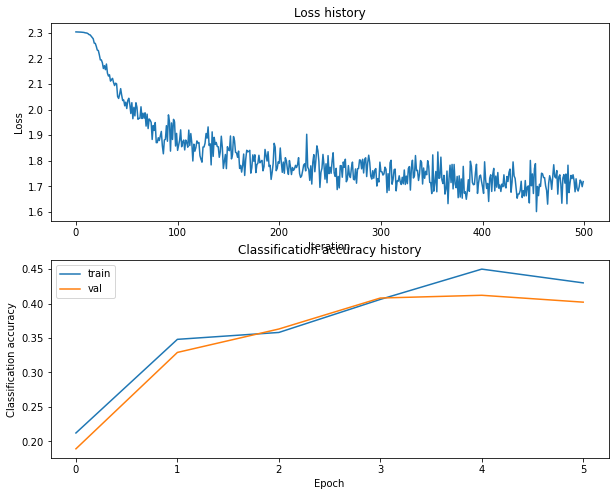

Training network with h_s 280, n_i 1000, b_s 100, l_r 0.0001
iteration 0 / 1000: loss 2.303645
iteration 100 / 1000: loss 2.299679
iteration 200 / 1000: loss 2.216993
iteration 300 / 1000: loss 2.151850
iteration 400 / 1000: loss 2.086298
iteration 500 / 1000: loss 1.936377
iteration 600 / 1000: loss 1.833377
iteration 700 / 1000: loss 1.948172
iteration 800 / 1000: loss 1.997147
iteration 900 / 1000: loss 1.937432
Validation accuracy:  0.325


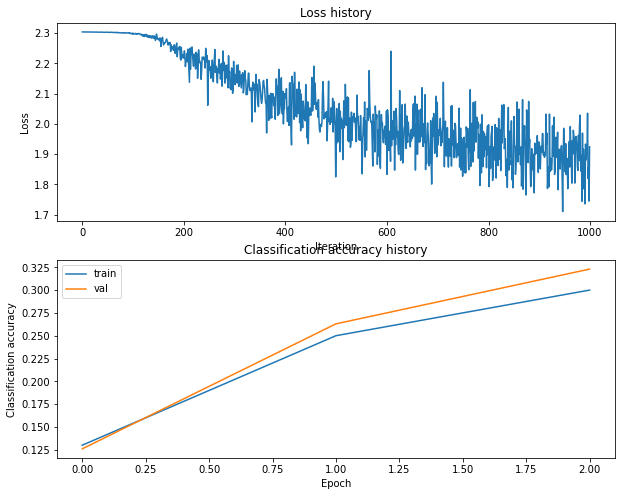

Training network with h_s 280, n_i 1000, b_s 100, l_r 0.001
iteration 0 / 1000: loss 2.303762
iteration 100 / 1000: loss 1.898908
iteration 200 / 1000: loss 1.799961
iteration 300 / 1000: loss 1.792592
iteration 400 / 1000: loss 1.659992
iteration 500 / 1000: loss 1.740841
iteration 600 / 1000: loss 1.793148
iteration 700 / 1000: loss 1.726951
iteration 800 / 1000: loss 1.773155
iteration 900 / 1000: loss 1.658143
Validation accuracy:  0.371


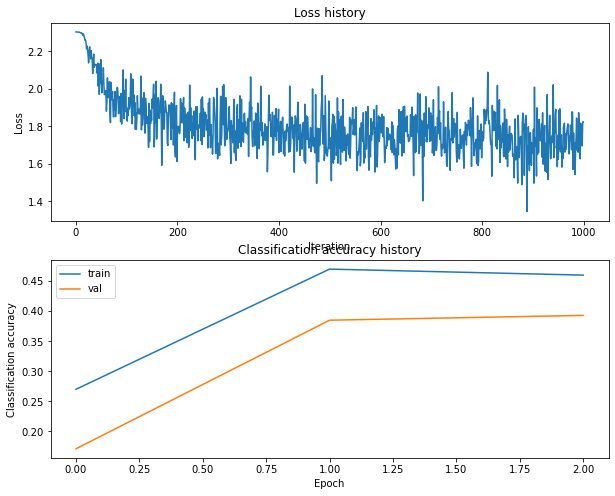

Training network with h_s 280, n_i 1000, b_s 200, l_r 0.0001
iteration 0 / 1000: loss 2.303599
iteration 100 / 1000: loss 2.296780
iteration 200 / 1000: loss 2.227275
iteration 300 / 1000: loss 2.148447
iteration 400 / 1000: loss 2.048020
iteration 500 / 1000: loss 2.038734
iteration 600 / 1000: loss 1.969717
iteration 700 / 1000: loss 2.025127
iteration 800 / 1000: loss 1.997765
iteration 900 / 1000: loss 1.987666
Validation accuracy:  0.319


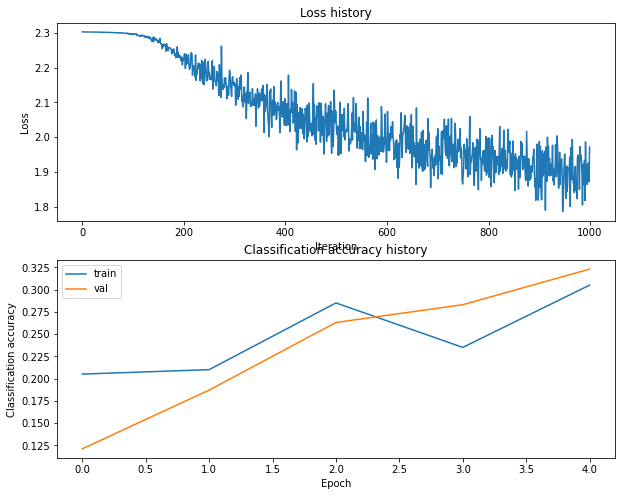

Training network with h_s 280, n_i 1000, b_s 200, l_r 0.001
iteration 0 / 1000: loss 2.303634
iteration 100 / 1000: loss 1.857751
iteration 200 / 1000: loss 1.837475
iteration 300 / 1000: loss 1.822855
iteration 400 / 1000: loss 1.765179
iteration 500 / 1000: loss 1.586917
iteration 600 / 1000: loss 1.740901
iteration 700 / 1000: loss 1.691906
iteration 800 / 1000: loss 1.633764
iteration 900 / 1000: loss 1.708222
Validation accuracy:  0.415


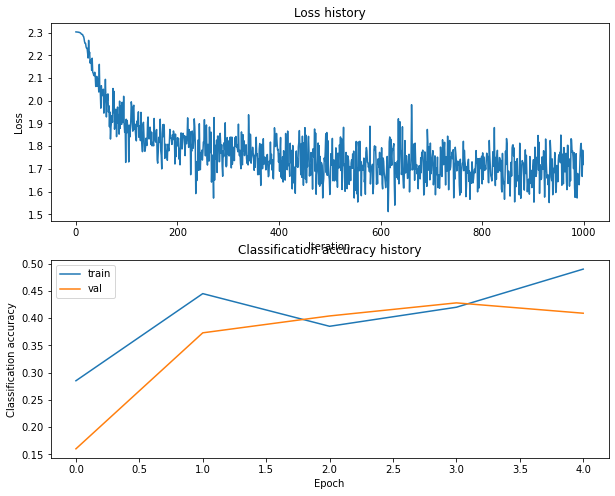

Training network with h_s 280, n_i 1000, b_s 250, l_r 0.0001
iteration 0 / 1000: loss 2.303626
iteration 100 / 1000: loss 2.297957
iteration 200 / 1000: loss 2.200161
iteration 300 / 1000: loss 2.119273
iteration 400 / 1000: loss 2.132942
iteration 500 / 1000: loss 2.036795
iteration 600 / 1000: loss 1.977060
iteration 700 / 1000: loss 1.974350
iteration 800 / 1000: loss 1.860511
iteration 900 / 1000: loss 2.010130
Validation accuracy:  0.319


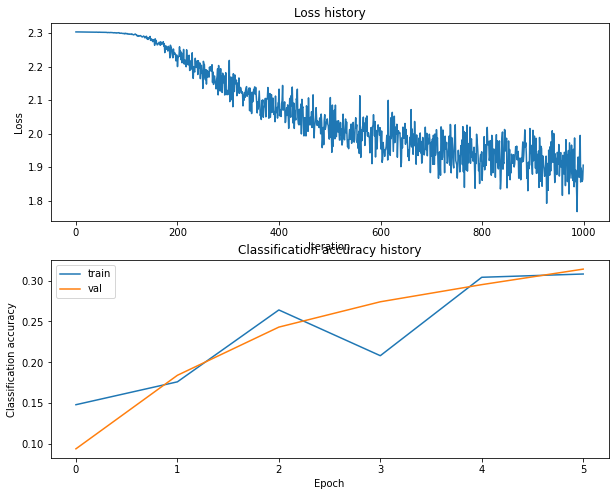

Training network with h_s 280, n_i 1000, b_s 250, l_r 0.001
iteration 0 / 1000: loss 2.303675
iteration 100 / 1000: loss 1.919676
iteration 200 / 1000: loss 1.746688
iteration 300 / 1000: loss 1.845170
iteration 400 / 1000: loss 1.745120
iteration 500 / 1000: loss 1.848628
iteration 600 / 1000: loss 1.619595
iteration 700 / 1000: loss 1.670749
iteration 800 / 1000: loss 1.652028
iteration 900 / 1000: loss 1.611325
Validation accuracy:  0.408


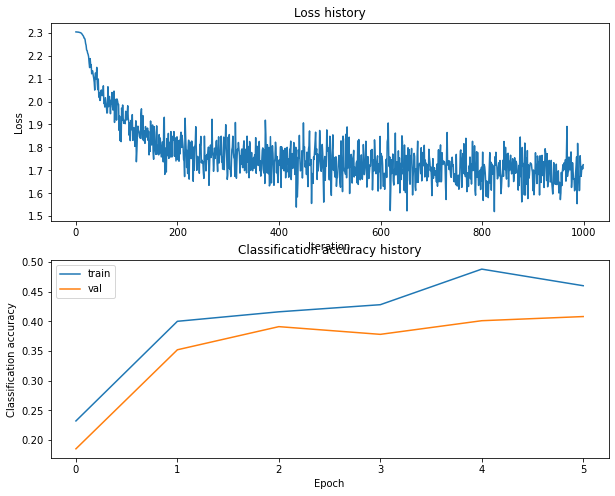

Training network with h_s 280, n_i 1000, b_s 300, l_r 0.0001
iteration 0 / 1000: loss 2.303704
iteration 100 / 1000: loss 2.297580
iteration 200 / 1000: loss 2.226515
iteration 300 / 1000: loss 2.168842
iteration 400 / 1000: loss 2.049968
iteration 500 / 1000: loss 2.018364
iteration 600 / 1000: loss 1.987457
iteration 700 / 1000: loss 1.960767
iteration 800 / 1000: loss 1.961084
iteration 900 / 1000: loss 1.913619
Validation accuracy:  0.326


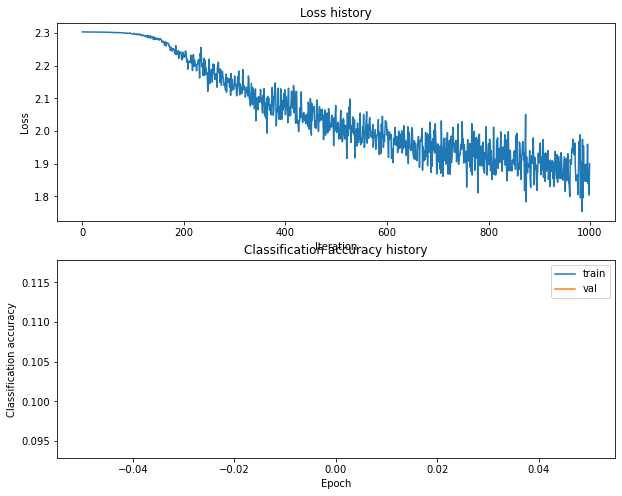

Training network with h_s 280, n_i 1000, b_s 300, l_r 0.001
iteration 0 / 1000: loss 2.303677
iteration 100 / 1000: loss 1.923202
iteration 200 / 1000: loss 1.832151
iteration 300 / 1000: loss 1.777778
iteration 400 / 1000: loss 1.722402
iteration 500 / 1000: loss 1.820471
iteration 600 / 1000: loss 1.736224
iteration 700 / 1000: loss 1.679221
iteration 800 / 1000: loss 1.729134
iteration 900 / 1000: loss 1.757688
Validation accuracy:  0.401


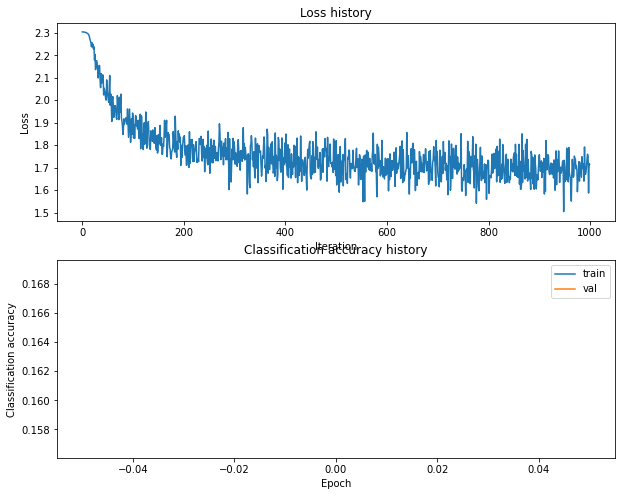

Training network with h_s 280, n_i 1000, b_s 500, l_r 0.0001
iteration 0 / 1000: loss 2.303695
iteration 100 / 1000: loss 2.297596
iteration 200 / 1000: loss 2.241509
iteration 300 / 1000: loss 2.148277
iteration 400 / 1000: loss 2.104988
iteration 500 / 1000: loss 2.059908
iteration 600 / 1000: loss 2.045833
iteration 700 / 1000: loss 1.979715
iteration 800 / 1000: loss 1.957420
iteration 900 / 1000: loss 1.920882
Validation accuracy:  0.298


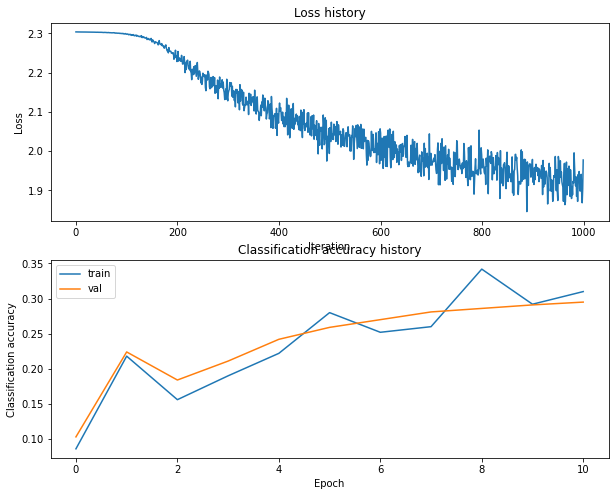

Training network with h_s 280, n_i 1000, b_s 500, l_r 0.001
iteration 0 / 1000: loss 2.303698
iteration 100 / 1000: loss 1.949819
iteration 200 / 1000: loss 1.835956
iteration 300 / 1000: loss 1.712562
iteration 400 / 1000: loss 1.742130
iteration 500 / 1000: loss 1.715598
iteration 600 / 1000: loss 1.723386
iteration 700 / 1000: loss 1.733073
iteration 800 / 1000: loss 1.742961
iteration 900 / 1000: loss 1.648729
Validation accuracy:  0.409


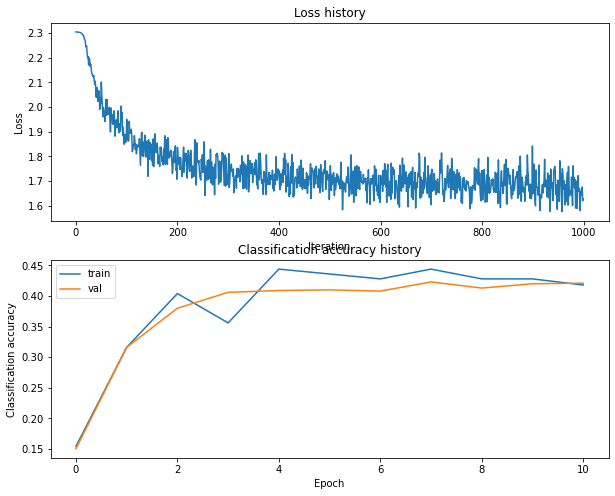

Training network with h_s 280, n_i 1500, b_s 100, l_r 0.0001
iteration 0 / 1500: loss 2.303650
iteration 100 / 1500: loss 2.298238
iteration 200 / 1500: loss 2.227902
iteration 300 / 1500: loss 2.114202
iteration 400 / 1500: loss 2.116079
iteration 500 / 1500: loss 1.923543
iteration 600 / 1500: loss 1.956532
iteration 700 / 1500: loss 1.926900
iteration 800 / 1500: loss 1.836247
iteration 900 / 1500: loss 1.929840
iteration 1000 / 1500: loss 1.843513
iteration 1100 / 1500: loss 1.846910
iteration 1200 / 1500: loss 1.932429
iteration 1300 / 1500: loss 1.902891
iteration 1400 / 1500: loss 1.853311
Validation accuracy:  0.351


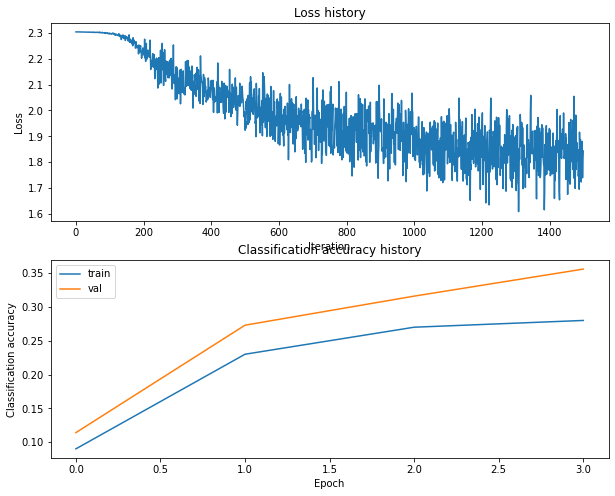

Training network with h_s 280, n_i 1500, b_s 100, l_r 0.001
iteration 0 / 1500: loss 2.303673
iteration 100 / 1500: loss 1.892831
iteration 200 / 1500: loss 1.779869
iteration 300 / 1500: loss 1.988549
iteration 400 / 1500: loss 1.790808
iteration 500 / 1500: loss 1.747618
iteration 600 / 1500: loss 1.721389
iteration 700 / 1500: loss 1.787742
iteration 800 / 1500: loss 1.670860
iteration 900 / 1500: loss 1.626782
iteration 1000 / 1500: loss 1.740482
iteration 1100 / 1500: loss 1.764756
iteration 1200 / 1500: loss 1.603661
iteration 1300 / 1500: loss 1.620638
iteration 1400 / 1500: loss 1.707329
Validation accuracy:  0.386


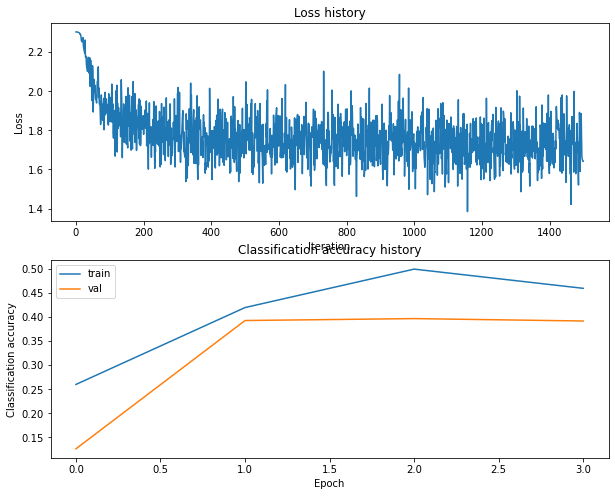

Training network with h_s 280, n_i 1500, b_s 200, l_r 0.0001
iteration 0 / 1500: loss 2.303627
iteration 100 / 1500: loss 2.297782
iteration 200 / 1500: loss 2.229875
iteration 300 / 1500: loss 2.130985
iteration 400 / 1500: loss 2.063308
iteration 500 / 1500: loss 2.013711
iteration 600 / 1500: loss 1.927438
iteration 700 / 1500: loss 1.987758
iteration 800 / 1500: loss 1.960029
iteration 900 / 1500: loss 1.872809
iteration 1000 / 1500: loss 1.857875
iteration 1100 / 1500: loss 1.832814
iteration 1200 / 1500: loss 1.861544
iteration 1300 / 1500: loss 1.810736
iteration 1400 / 1500: loss 1.761446
Validation accuracy:  0.355


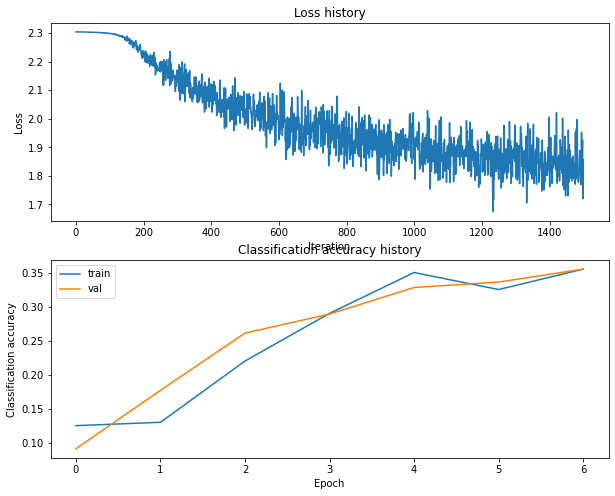

Training network with h_s 280, n_i 1500, b_s 200, l_r 0.001
iteration 0 / 1500: loss 2.303678
iteration 100 / 1500: loss 1.957842
iteration 200 / 1500: loss 1.889089
iteration 300 / 1500: loss 1.783443
iteration 400 / 1500: loss 1.605583
iteration 500 / 1500: loss 1.726079
iteration 600 / 1500: loss 1.646960
iteration 700 / 1500: loss 1.575890
iteration 800 / 1500: loss 1.684741
iteration 900 / 1500: loss 1.683453
iteration 1000 / 1500: loss 1.829896
iteration 1100 / 1500: loss 1.685911
iteration 1200 / 1500: loss 1.719189
iteration 1300 / 1500: loss 1.720814
iteration 1400 / 1500: loss 1.639282
Validation accuracy:  0.422


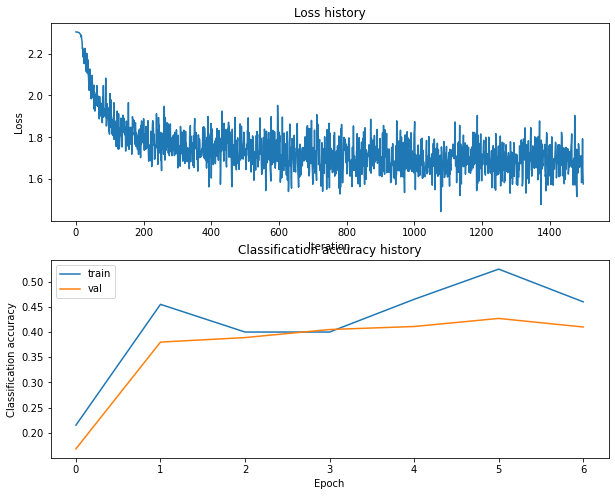

Training network with h_s 280, n_i 1500, b_s 250, l_r 0.0001
iteration 0 / 1500: loss 2.303668
iteration 100 / 1500: loss 2.296355
iteration 200 / 1500: loss 2.227131
iteration 300 / 1500: loss 2.150695
iteration 400 / 1500: loss 2.011207
iteration 500 / 1500: loss 1.993158
iteration 600 / 1500: loss 1.988222
iteration 700 / 1500: loss 2.041730
iteration 800 / 1500: loss 1.962522
iteration 900 / 1500: loss 1.888199
iteration 1000 / 1500: loss 1.925145
iteration 1100 / 1500: loss 1.919031
iteration 1200 / 1500: loss 1.874697
iteration 1300 / 1500: loss 1.851160
iteration 1400 / 1500: loss 1.861795
Validation accuracy:  0.35


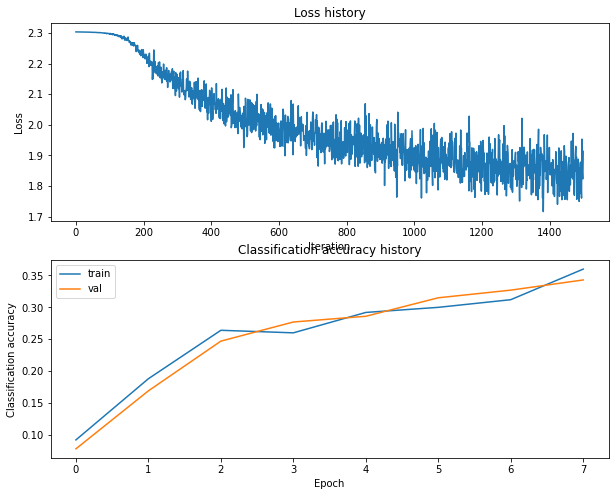

Training network with h_s 280, n_i 1500, b_s 250, l_r 0.001
iteration 0 / 1500: loss 2.303679
iteration 100 / 1500: loss 1.944760
iteration 200 / 1500: loss 1.711940
iteration 300 / 1500: loss 1.808741
iteration 400 / 1500: loss 1.813866
iteration 500 / 1500: loss 1.798179
iteration 600 / 1500: loss 1.587755
iteration 700 / 1500: loss 1.749581
iteration 800 / 1500: loss 1.756692
iteration 900 / 1500: loss 1.698109
iteration 1000 / 1500: loss 1.662010
iteration 1100 / 1500: loss 1.718273
iteration 1200 / 1500: loss 1.752713
iteration 1300 / 1500: loss 1.822011
iteration 1400 / 1500: loss 1.592322
Validation accuracy:  0.396


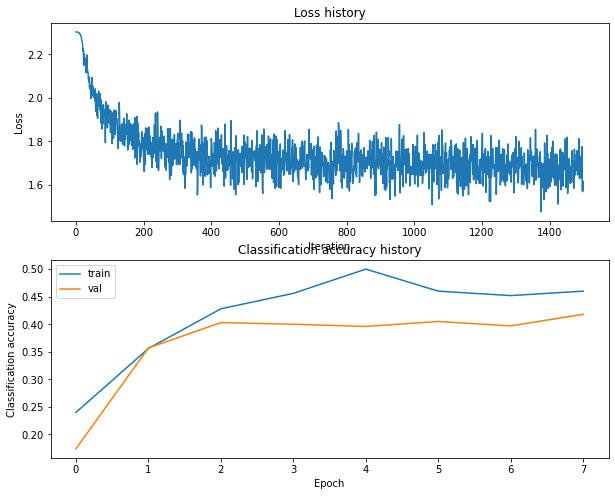

Training network with h_s 280, n_i 1500, b_s 300, l_r 0.0001
iteration 0 / 1500: loss 2.303644
iteration 100 / 1500: loss 2.299058
iteration 200 / 1500: loss 2.209492
iteration 300 / 1500: loss 2.135593
iteration 400 / 1500: loss 2.048024
iteration 500 / 1500: loss 2.017047
iteration 600 / 1500: loss 1.981214
iteration 700 / 1500: loss 1.960518
iteration 800 / 1500: loss 1.943865
iteration 900 / 1500: loss 1.905576
iteration 1000 / 1500: loss 1.858238
iteration 1100 / 1500: loss 1.905892
iteration 1200 / 1500: loss 1.876050
iteration 1300 / 1500: loss 1.864177
iteration 1400 / 1500: loss 1.776986
Validation accuracy:  0.358


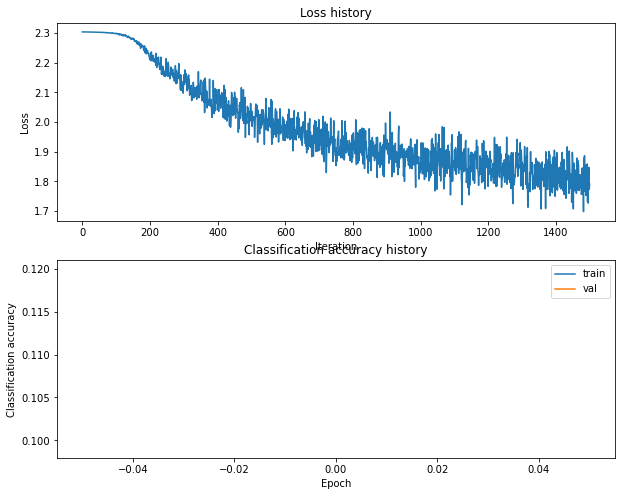

Training network with h_s 280, n_i 1500, b_s 300, l_r 0.001
iteration 0 / 1500: loss 2.303649
iteration 100 / 1500: loss 1.917197
iteration 200 / 1500: loss 1.748817
iteration 300 / 1500: loss 1.707715
iteration 400 / 1500: loss 1.681248
iteration 500 / 1500: loss 1.697973
iteration 600 / 1500: loss 1.699672
iteration 700 / 1500: loss 1.722950
iteration 800 / 1500: loss 1.683188
iteration 900 / 1500: loss 1.671327
iteration 1000 / 1500: loss 1.772538
iteration 1100 / 1500: loss 1.685566
iteration 1200 / 1500: loss 1.744562
iteration 1300 / 1500: loss 1.681514
iteration 1400 / 1500: loss 1.702738
Validation accuracy:  0.389


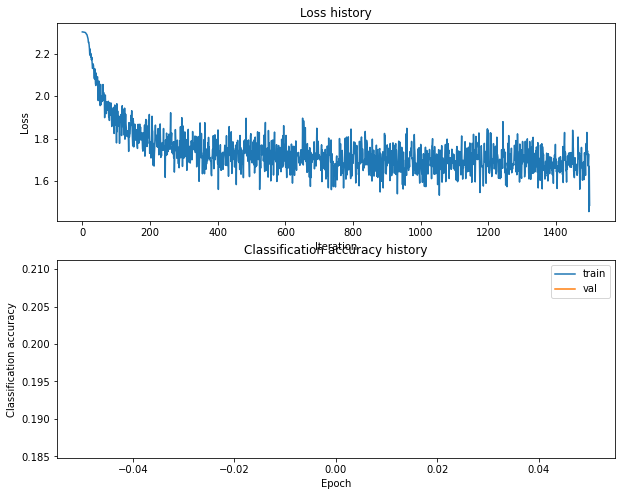

Training network with h_s 280, n_i 1500, b_s 500, l_r 0.0001
iteration 0 / 1500: loss 2.303628
iteration 100 / 1500: loss 2.297100
iteration 200 / 1500: loss 2.253130
iteration 300 / 1500: loss 2.161293
iteration 400 / 1500: loss 2.105765
iteration 500 / 1500: loss 2.085240
iteration 600 / 1500: loss 1.972383
iteration 700 / 1500: loss 1.934707
iteration 800 / 1500: loss 1.923158
iteration 900 / 1500: loss 1.923168
iteration 1000 / 1500: loss 1.913493
iteration 1100 / 1500: loss 1.929418
iteration 1200 / 1500: loss 1.858011
iteration 1300 / 1500: loss 1.895970
iteration 1400 / 1500: loss 1.874682
Validation accuracy:  0.331


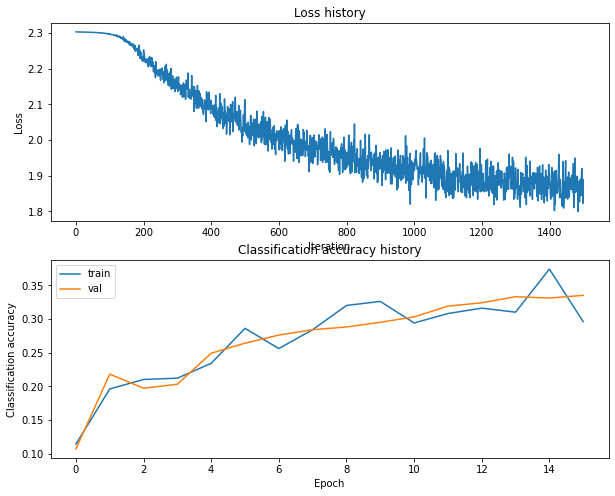

Training network with h_s 280, n_i 1500, b_s 500, l_r 0.001
iteration 0 / 1500: loss 2.303704
iteration 100 / 1500: loss 1.902266
iteration 200 / 1500: loss 1.789590
iteration 300 / 1500: loss 1.736122
iteration 400 / 1500: loss 1.688271
iteration 500 / 1500: loss 1.697626
iteration 600 / 1500: loss 1.713600
iteration 700 / 1500: loss 1.720615
iteration 800 / 1500: loss 1.693835
iteration 900 / 1500: loss 1.663161
iteration 1000 / 1500: loss 1.652569
iteration 1100 / 1500: loss 1.639952
iteration 1200 / 1500: loss 1.710577
iteration 1300 / 1500: loss 1.652520
iteration 1400 / 1500: loss 1.693646
Validation accuracy:  0.425


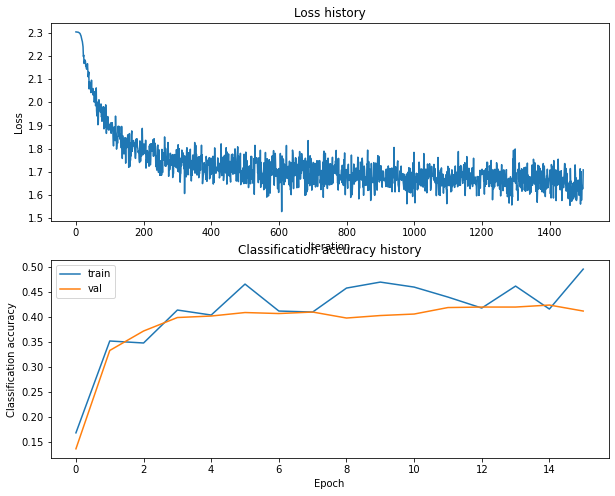

Training network with h_s 280, n_i 2500, b_s 100, l_r 0.0001
iteration 0 / 2500: loss 2.303699
iteration 100 / 2500: loss 2.300525
iteration 200 / 2500: loss 2.253653
iteration 300 / 2500: loss 2.171258
iteration 400 / 2500: loss 2.102865
iteration 500 / 2500: loss 2.016029
iteration 600 / 2500: loss 2.097342
iteration 700 / 2500: loss 1.981681
iteration 800 / 2500: loss 1.918201
iteration 900 / 2500: loss 1.806920
iteration 1000 / 2500: loss 1.974776
iteration 1100 / 2500: loss 1.845728
iteration 1200 / 2500: loss 1.820607
iteration 1300 / 2500: loss 1.887537
iteration 1400 / 2500: loss 1.900369
iteration 1500 / 2500: loss 1.854590
iteration 1600 / 2500: loss 1.850001
iteration 1700 / 2500: loss 1.782292
iteration 1800 / 2500: loss 1.737955
iteration 1900 / 2500: loss 1.807696
iteration 2000 / 2500: loss 1.727149
iteration 2100 / 2500: loss 1.769792
iteration 2200 / 2500: loss 1.987092
iteration 2300 / 2500: loss 1.621851
iteration 2400 / 2500: loss 1.649564
Validation accuracy:  0.38

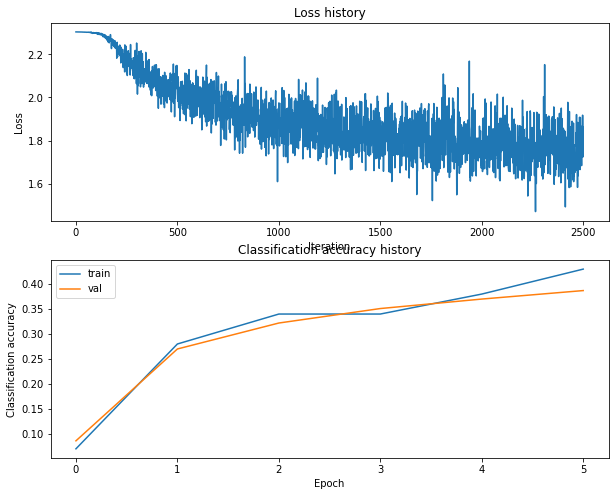

Training network with h_s 280, n_i 2500, b_s 100, l_r 0.001
iteration 0 / 2500: loss 2.303706
iteration 100 / 2500: loss 1.870299
iteration 200 / 2500: loss 1.876708
iteration 300 / 2500: loss 1.838475
iteration 400 / 2500: loss 1.737113
iteration 500 / 2500: loss 1.868782
iteration 600 / 2500: loss 1.691354
iteration 700 / 2500: loss 1.627610
iteration 800 / 2500: loss 1.789312
iteration 900 / 2500: loss 1.691175
iteration 1000 / 2500: loss 1.658237
iteration 1100 / 2500: loss 1.681320
iteration 1200 / 2500: loss 1.679349
iteration 1300 / 2500: loss 1.614086
iteration 1400 / 2500: loss 1.720122
iteration 1500 / 2500: loss 1.792795
iteration 1600 / 2500: loss 1.879608
iteration 1700 / 2500: loss 1.529495
iteration 1800 / 2500: loss 1.604475
iteration 1900 / 2500: loss 1.530207
iteration 2000 / 2500: loss 1.863091
iteration 2100 / 2500: loss 1.864994
iteration 2200 / 2500: loss 1.852392
iteration 2300 / 2500: loss 1.706524
iteration 2400 / 2500: loss 1.661709
Validation accuracy:  0.388

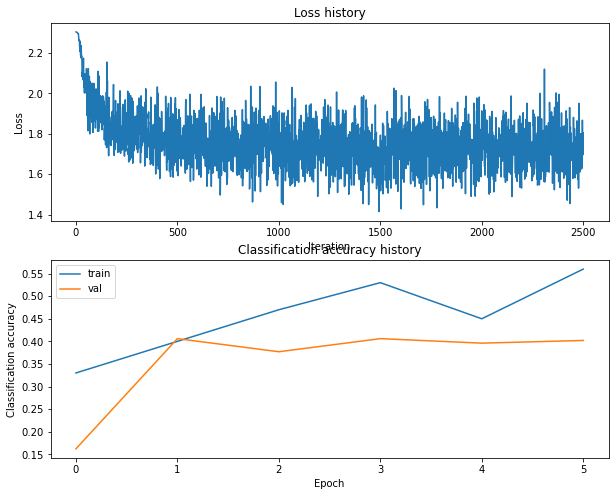

Training network with h_s 280, n_i 2500, b_s 200, l_r 0.0001
iteration 0 / 2500: loss 2.303682
iteration 100 / 2500: loss 2.296824
iteration 200 / 2500: loss 2.214523
iteration 300 / 2500: loss 2.130362
iteration 400 / 2500: loss 2.048437
iteration 500 / 2500: loss 1.940119
iteration 600 / 2500: loss 1.957307
iteration 700 / 2500: loss 1.963557
iteration 800 / 2500: loss 1.914066
iteration 900 / 2500: loss 1.932987
iteration 1000 / 2500: loss 1.967073
iteration 1100 / 2500: loss 1.819915
iteration 1200 / 2500: loss 1.905675
iteration 1300 / 2500: loss 1.812690
iteration 1400 / 2500: loss 1.860116
iteration 1500 / 2500: loss 1.811247
iteration 1600 / 2500: loss 1.844300
iteration 1700 / 2500: loss 1.757958
iteration 1800 / 2500: loss 1.742040
iteration 1900 / 2500: loss 1.897536
iteration 2000 / 2500: loss 1.696771
iteration 2100 / 2500: loss 1.789325
iteration 2200 / 2500: loss 1.764727
iteration 2300 / 2500: loss 1.782845
iteration 2400 / 2500: loss 1.936010
Validation accuracy:  0.37

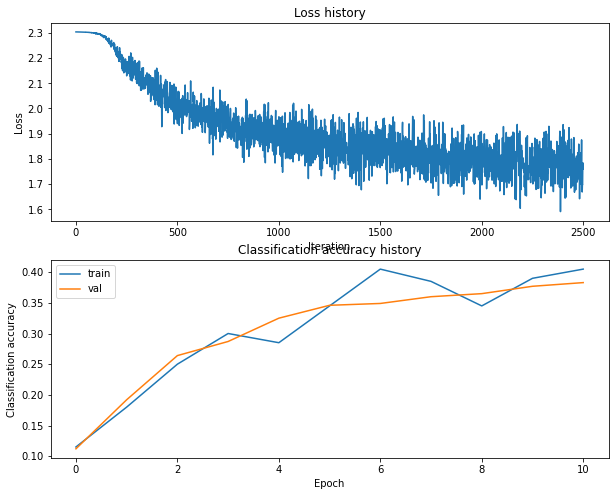

Training network with h_s 280, n_i 2500, b_s 200, l_r 0.001
iteration 0 / 2500: loss 2.303647
iteration 100 / 2500: loss 1.906715
iteration 200 / 2500: loss 1.858668
iteration 300 / 2500: loss 1.846409
iteration 400 / 2500: loss 1.554292
iteration 500 / 2500: loss 1.832935
iteration 600 / 2500: loss 1.728036
iteration 700 / 2500: loss 1.644679
iteration 800 / 2500: loss 1.777768
iteration 900 / 2500: loss 1.764847
iteration 1000 / 2500: loss 1.791058
iteration 1100 / 2500: loss 1.662242
iteration 1200 / 2500: loss 1.630974
iteration 1300 / 2500: loss 1.687418
iteration 1400 / 2500: loss 1.708239
iteration 1500 / 2500: loss 1.688735
iteration 1600 / 2500: loss 1.722396
iteration 1700 / 2500: loss 1.771228
iteration 1800 / 2500: loss 1.702436
iteration 1900 / 2500: loss 1.636867
iteration 2000 / 2500: loss 1.677962
iteration 2100 / 2500: loss 1.646752
iteration 2200 / 2500: loss 1.639310
iteration 2300 / 2500: loss 1.676706
iteration 2400 / 2500: loss 1.734607
Validation accuracy:  0.409

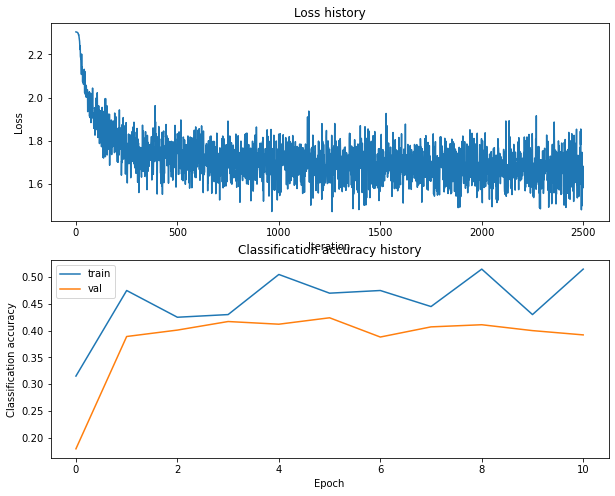

Training network with h_s 280, n_i 2500, b_s 250, l_r 0.0001
iteration 0 / 2500: loss 2.303637
iteration 100 / 2500: loss 2.296616
iteration 200 / 2500: loss 2.213021
iteration 300 / 2500: loss 2.150523
iteration 400 / 2500: loss 2.118079
iteration 500 / 2500: loss 2.051581
iteration 600 / 2500: loss 2.045405
iteration 700 / 2500: loss 1.971856
iteration 800 / 2500: loss 1.918492
iteration 900 / 2500: loss 1.975823
iteration 1000 / 2500: loss 1.929091
iteration 1100 / 2500: loss 1.965900
iteration 1200 / 2500: loss 1.986747
iteration 1300 / 2500: loss 1.816372
iteration 1400 / 2500: loss 1.858049
iteration 1500 / 2500: loss 1.689529
iteration 1600 / 2500: loss 1.766404
iteration 1700 / 2500: loss 1.739587
iteration 1800 / 2500: loss 1.818918
iteration 1900 / 2500: loss 1.739032
iteration 2000 / 2500: loss 1.816447
iteration 2100 / 2500: loss 1.736167
iteration 2200 / 2500: loss 1.757721
iteration 2300 / 2500: loss 1.774091
iteration 2400 / 2500: loss 1.890456
Validation accuracy:  0.36

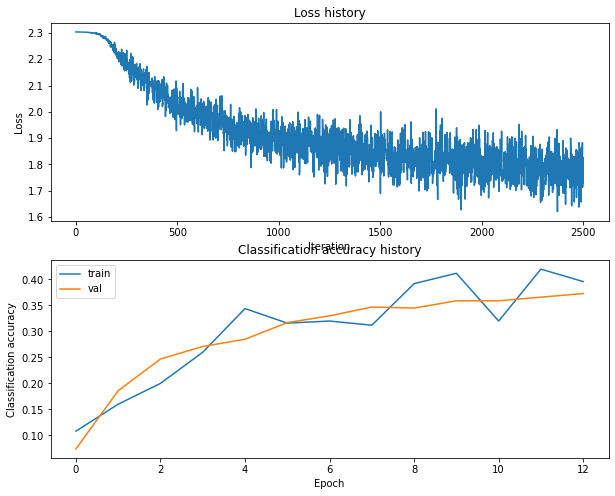

Training network with h_s 280, n_i 2500, b_s 250, l_r 0.001
iteration 0 / 2500: loss 2.303637
iteration 100 / 2500: loss 1.858024
iteration 200 / 2500: loss 1.833076
iteration 300 / 2500: loss 1.787508
iteration 400 / 2500: loss 1.703234
iteration 500 / 2500: loss 1.826115
iteration 600 / 2500: loss 1.640370
iteration 700 / 2500: loss 1.692456
iteration 800 / 2500: loss 1.705653
iteration 900 / 2500: loss 1.651687
iteration 1000 / 2500: loss 1.690285
iteration 1100 / 2500: loss 1.642103
iteration 1200 / 2500: loss 1.628845
iteration 1300 / 2500: loss 1.586164
iteration 1400 / 2500: loss 1.594746
iteration 1500 / 2500: loss 1.627829
iteration 1600 / 2500: loss 1.661786
iteration 1700 / 2500: loss 1.776409
iteration 1800 / 2500: loss 1.524648
iteration 1900 / 2500: loss 1.732908
iteration 2000 / 2500: loss 1.744772
iteration 2100 / 2500: loss 1.599291
iteration 2200 / 2500: loss 1.769182
iteration 2300 / 2500: loss 1.571701
iteration 2400 / 2500: loss 1.593944
Validation accuracy:  0.403

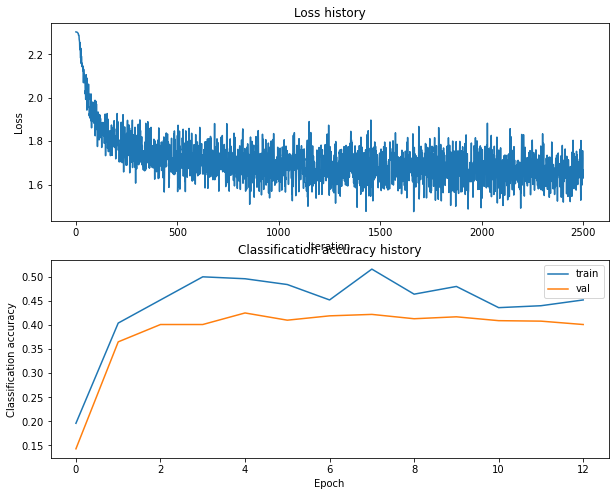

Training network with h_s 280, n_i 2500, b_s 300, l_r 0.0001
iteration 0 / 2500: loss 2.303717
iteration 100 / 2500: loss 2.299280
iteration 200 / 2500: loss 2.221299
iteration 300 / 2500: loss 2.131105
iteration 400 / 2500: loss 2.049092
iteration 500 / 2500: loss 2.027602
iteration 600 / 2500: loss 1.912612
iteration 700 / 2500: loss 1.969030
iteration 800 / 2500: loss 1.992645
iteration 900 / 2500: loss 1.863669
iteration 1000 / 2500: loss 1.874443
iteration 1100 / 2500: loss 1.829674
iteration 1200 / 2500: loss 1.908727
iteration 1300 / 2500: loss 1.941234
iteration 1400 / 2500: loss 1.920063
iteration 1500 / 2500: loss 1.749489
iteration 1600 / 2500: loss 1.775401
iteration 1700 / 2500: loss 1.854590
iteration 1800 / 2500: loss 1.835062
iteration 1900 / 2500: loss 1.874831
iteration 2000 / 2500: loss 1.810442
iteration 2100 / 2500: loss 1.774518
iteration 2200 / 2500: loss 1.737287
iteration 2300 / 2500: loss 1.698156
iteration 2400 / 2500: loss 1.807069
Validation accuracy:  0.39

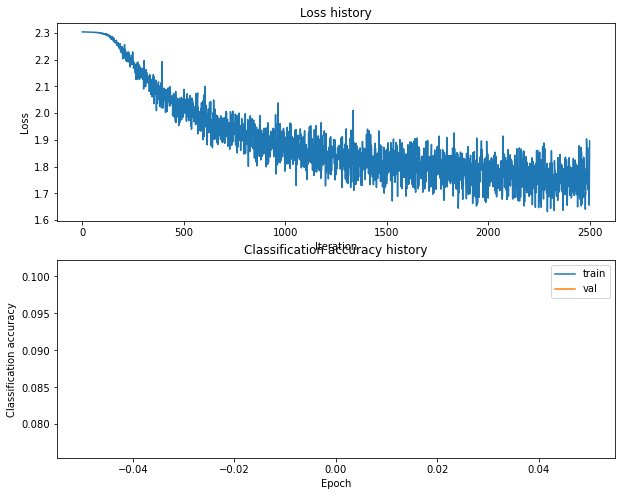

Training network with h_s 280, n_i 2500, b_s 300, l_r 0.001
iteration 0 / 2500: loss 2.303614
iteration 100 / 2500: loss 1.939313
iteration 200 / 2500: loss 1.795876
iteration 300 / 2500: loss 1.791329
iteration 400 / 2500: loss 1.752436
iteration 500 / 2500: loss 1.692742
iteration 600 / 2500: loss 1.725882
iteration 700 / 2500: loss 1.683549
iteration 800 / 2500: loss 1.726360
iteration 900 / 2500: loss 1.643280
iteration 1000 / 2500: loss 1.618532
iteration 1100 / 2500: loss 1.621877
iteration 1200 / 2500: loss 1.650381
iteration 1300 / 2500: loss 1.669870
iteration 1400 / 2500: loss 1.676312
iteration 1500 / 2500: loss 1.611464
iteration 1600 / 2500: loss 1.683090
iteration 1700 / 2500: loss 1.775306
iteration 1800 / 2500: loss 1.686340
iteration 1900 / 2500: loss 1.712519
iteration 2000 / 2500: loss 1.763688
iteration 2100 / 2500: loss 1.626905
iteration 2200 / 2500: loss 1.719976
iteration 2300 / 2500: loss 1.736947
iteration 2400 / 2500: loss 1.697518
Validation accuracy:  0.415

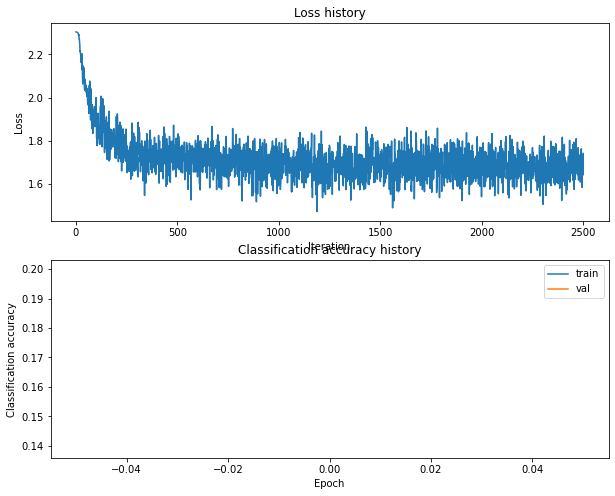

Training network with h_s 280, n_i 2500, b_s 500, l_r 0.0001
iteration 0 / 2500: loss 2.303664
iteration 100 / 2500: loss 2.298523
iteration 200 / 2500: loss 2.241786
iteration 300 / 2500: loss 2.160047
iteration 400 / 2500: loss 2.064802
iteration 500 / 2500: loss 2.016570
iteration 600 / 2500: loss 1.992560
iteration 700 / 2500: loss 1.959918
iteration 800 / 2500: loss 1.971720
iteration 900 / 2500: loss 1.927577
iteration 1000 / 2500: loss 1.864901
iteration 1100 / 2500: loss 1.891469
iteration 1200 / 2500: loss 1.878104
iteration 1300 / 2500: loss 1.895554
iteration 1400 / 2500: loss 1.924165
iteration 1500 / 2500: loss 1.854461
iteration 1600 / 2500: loss 1.840994
iteration 1700 / 2500: loss 1.829671
iteration 1800 / 2500: loss 1.900454
iteration 1900 / 2500: loss 1.866480
iteration 2000 / 2500: loss 1.780331
iteration 2100 / 2500: loss 1.869783
iteration 2200 / 2500: loss 1.820929
iteration 2300 / 2500: loss 1.838225
iteration 2400 / 2500: loss 1.810289
Validation accuracy:  0.35

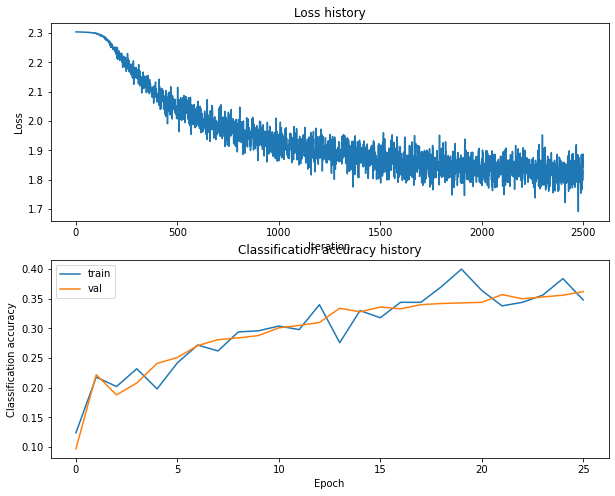

Training network with h_s 280, n_i 2500, b_s 500, l_r 0.001
iteration 0 / 2500: loss 2.303630
iteration 100 / 2500: loss 1.863801
iteration 200 / 2500: loss 1.829570
iteration 300 / 2500: loss 1.784389
iteration 400 / 2500: loss 1.736322
iteration 500 / 2500: loss 1.802417
iteration 600 / 2500: loss 1.693282
iteration 700 / 2500: loss 1.691540
iteration 800 / 2500: loss 1.706129
iteration 900 / 2500: loss 1.579811
iteration 1000 / 2500: loss 1.604790
iteration 1100 / 2500: loss 1.592518
iteration 1200 / 2500: loss 1.628243
iteration 1300 / 2500: loss 1.701483
iteration 1400 / 2500: loss 1.724257
iteration 1500 / 2500: loss 1.656113
iteration 1600 / 2500: loss 1.639758
iteration 1700 / 2500: loss 1.681789
iteration 1800 / 2500: loss 1.687642
iteration 1900 / 2500: loss 1.719730
iteration 2000 / 2500: loss 1.636973
iteration 2100 / 2500: loss 1.652128
iteration 2200 / 2500: loss 1.693396
iteration 2300 / 2500: loss 1.669461
iteration 2400 / 2500: loss 1.685376
Validation accuracy:  0.428

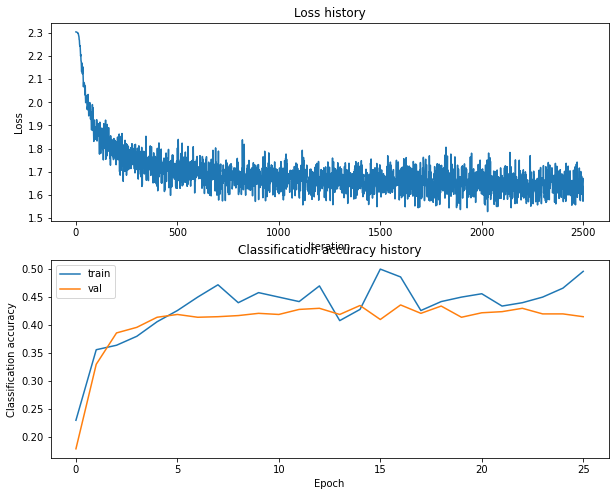

Training network with h_s 280, n_i 5000, b_s 100, l_r 0.0001
iteration 0 / 5000: loss 2.303708
iteration 100 / 5000: loss 2.296862
iteration 200 / 5000: loss 2.232413
iteration 300 / 5000: loss 2.132969
iteration 400 / 5000: loss 2.013509
iteration 500 / 5000: loss 2.112841
iteration 600 / 5000: loss 1.914181
iteration 700 / 5000: loss 1.874937
iteration 800 / 5000: loss 1.862884
iteration 900 / 5000: loss 1.902295
iteration 1000 / 5000: loss 1.820220
iteration 1100 / 5000: loss 1.972901
iteration 1200 / 5000: loss 1.905944
iteration 1300 / 5000: loss 1.771996
iteration 1400 / 5000: loss 1.726499
iteration 1500 / 5000: loss 1.822264
iteration 1600 / 5000: loss 1.742419
iteration 1700 / 5000: loss 1.647136
iteration 1800 / 5000: loss 1.872763
iteration 1900 / 5000: loss 1.655283
iteration 2000 / 5000: loss 1.816716
iteration 2100 / 5000: loss 1.656194
iteration 2200 / 5000: loss 1.794911
iteration 2300 / 5000: loss 1.878128
iteration 2400 / 5000: loss 1.684152
iteration 2500 / 5000: los

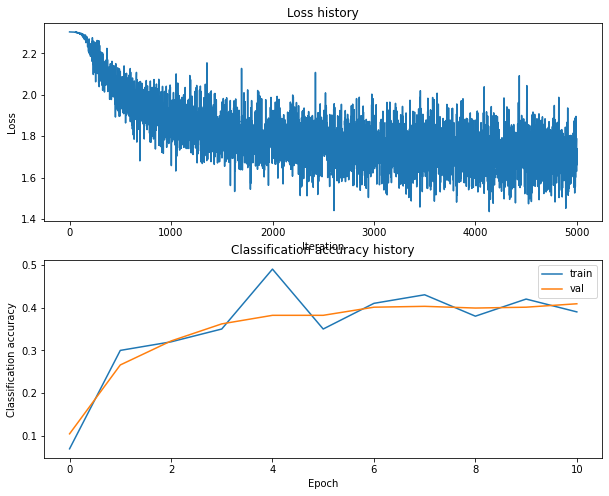

Training network with h_s 280, n_i 5000, b_s 100, l_r 0.001
iteration 0 / 5000: loss 2.303645
iteration 100 / 5000: loss 2.127409
iteration 200 / 5000: loss 1.948603
iteration 300 / 5000: loss 1.745847
iteration 400 / 5000: loss 1.831750
iteration 500 / 5000: loss 1.721539
iteration 600 / 5000: loss 1.895380
iteration 700 / 5000: loss 1.640752
iteration 800 / 5000: loss 1.627657
iteration 900 / 5000: loss 1.717930
iteration 1000 / 5000: loss 1.806479
iteration 1100 / 5000: loss 1.719123
iteration 1200 / 5000: loss 1.641807
iteration 1300 / 5000: loss 1.595907
iteration 1400 / 5000: loss 1.713913
iteration 1500 / 5000: loss 1.876348
iteration 1600 / 5000: loss 1.549490
iteration 1700 / 5000: loss 1.746982
iteration 1800 / 5000: loss 1.598820
iteration 1900 / 5000: loss 1.640251
iteration 2000 / 5000: loss 1.743084
iteration 2100 / 5000: loss 1.665762
iteration 2200 / 5000: loss 1.692224
iteration 2300 / 5000: loss 1.732572
iteration 2400 / 5000: loss 1.675673
iteration 2500 / 5000: loss

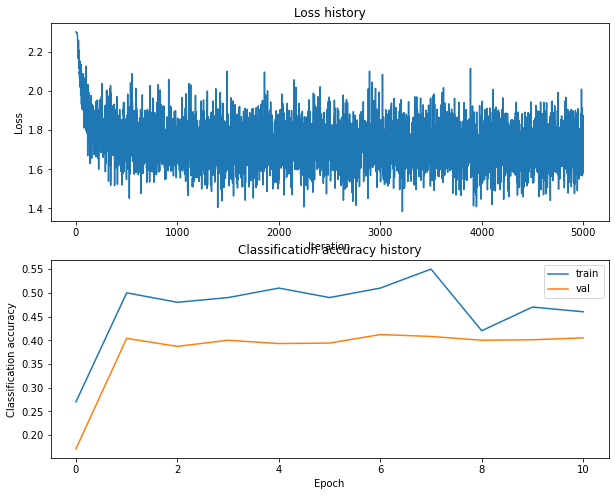

Training network with h_s 280, n_i 5000, b_s 200, l_r 0.0001
iteration 0 / 5000: loss 2.303628
iteration 100 / 5000: loss 2.297786
iteration 200 / 5000: loss 2.253510
iteration 300 / 5000: loss 2.112858
iteration 400 / 5000: loss 2.117682
iteration 500 / 5000: loss 2.051275
iteration 600 / 5000: loss 1.984786
iteration 700 / 5000: loss 1.904714
iteration 800 / 5000: loss 1.926391
iteration 900 / 5000: loss 1.904090
iteration 1000 / 5000: loss 1.879983
iteration 1100 / 5000: loss 1.819221
iteration 1200 / 5000: loss 1.967587
iteration 1300 / 5000: loss 1.827214
iteration 1400 / 5000: loss 1.806975
iteration 1500 / 5000: loss 1.974073
iteration 1600 / 5000: loss 1.785481
iteration 1700 / 5000: loss 1.823404
iteration 1800 / 5000: loss 1.829851
iteration 1900 / 5000: loss 1.831717
iteration 2000 / 5000: loss 1.859789
iteration 2100 / 5000: loss 1.866646
iteration 2200 / 5000: loss 1.741677
iteration 2300 / 5000: loss 1.754792
iteration 2400 / 5000: loss 1.923276
iteration 2500 / 5000: los

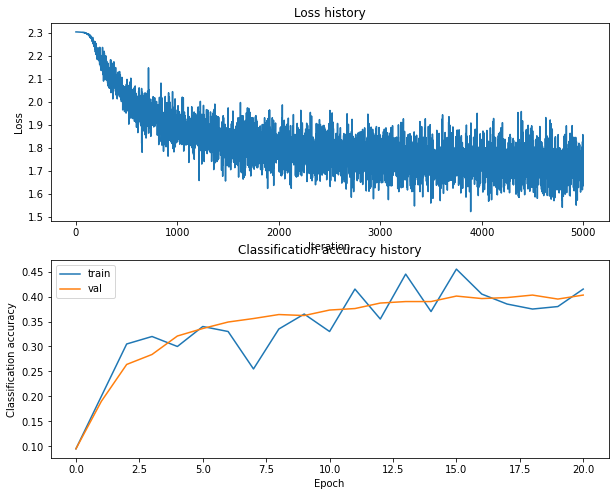

Training network with h_s 280, n_i 5000, b_s 200, l_r 0.001
iteration 0 / 5000: loss 2.303606
iteration 100 / 5000: loss 1.890358
iteration 200 / 5000: loss 1.829022
iteration 300 / 5000: loss 1.751294
iteration 400 / 5000: loss 1.785411
iteration 500 / 5000: loss 1.712928
iteration 600 / 5000: loss 1.692975
iteration 700 / 5000: loss 1.785645
iteration 800 / 5000: loss 1.657511
iteration 900 / 5000: loss 1.805530
iteration 1000 / 5000: loss 1.748806
iteration 1100 / 5000: loss 1.657608
iteration 1200 / 5000: loss 1.803695
iteration 1300 / 5000: loss 1.575349
iteration 1400 / 5000: loss 1.848028
iteration 1500 / 5000: loss 1.645316
iteration 1600 / 5000: loss 1.694519
iteration 1700 / 5000: loss 1.622703
iteration 1800 / 5000: loss 1.646154
iteration 1900 / 5000: loss 1.767112
iteration 2000 / 5000: loss 1.578839
iteration 2100 / 5000: loss 1.683526
iteration 2200 / 5000: loss 1.673845
iteration 2300 / 5000: loss 1.746388
iteration 2400 / 5000: loss 1.673795
iteration 2500 / 5000: loss

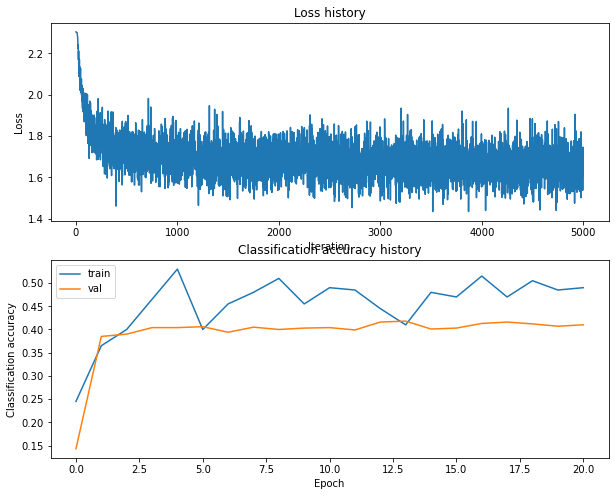

Training network with h_s 280, n_i 5000, b_s 250, l_r 0.0001
iteration 0 / 5000: loss 2.303650
iteration 100 / 5000: loss 2.296893
iteration 200 / 5000: loss 2.229803
iteration 300 / 5000: loss 2.148084
iteration 400 / 5000: loss 2.063413
iteration 500 / 5000: loss 2.041901
iteration 600 / 5000: loss 1.972185
iteration 700 / 5000: loss 1.954638
iteration 800 / 5000: loss 1.911757
iteration 900 / 5000: loss 1.981174
iteration 1000 / 5000: loss 1.891136
iteration 1100 / 5000: loss 1.872329
iteration 1200 / 5000: loss 1.853935
iteration 1300 / 5000: loss 1.810487
iteration 1400 / 5000: loss 1.840050
iteration 1500 / 5000: loss 1.805190
iteration 1600 / 5000: loss 1.772011
iteration 1700 / 5000: loss 1.890162
iteration 1800 / 5000: loss 1.709227
iteration 1900 / 5000: loss 1.841579
iteration 2000 / 5000: loss 1.925918
iteration 2100 / 5000: loss 1.823292
iteration 2200 / 5000: loss 1.775398
iteration 2300 / 5000: loss 1.718792
iteration 2400 / 5000: loss 1.809225
iteration 2500 / 5000: los

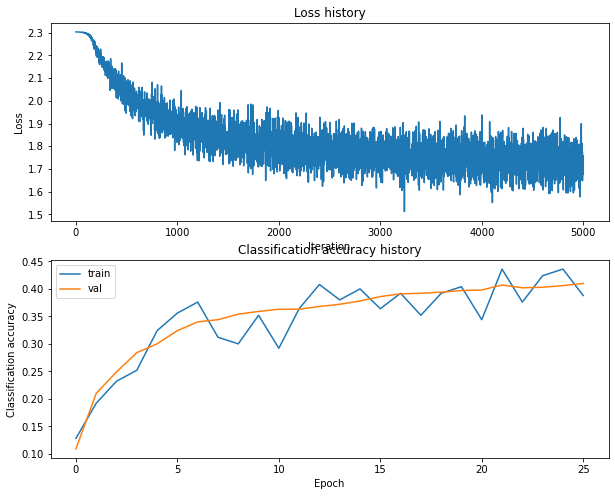

Training network with h_s 280, n_i 5000, b_s 250, l_r 0.001
iteration 0 / 5000: loss 2.303723
iteration 100 / 5000: loss 1.945427
iteration 200 / 5000: loss 1.819917
iteration 300 / 5000: loss 1.743204
iteration 400 / 5000: loss 1.741318
iteration 500 / 5000: loss 1.757801
iteration 600 / 5000: loss 1.756415
iteration 700 / 5000: loss 1.914634
iteration 800 / 5000: loss 1.774936
iteration 900 / 5000: loss 1.670070
iteration 1000 / 5000: loss 1.666673
iteration 1100 / 5000: loss 1.700360
iteration 1200 / 5000: loss 1.676040
iteration 1300 / 5000: loss 1.624930
iteration 1400 / 5000: loss 1.659946
iteration 1500 / 5000: loss 1.560529
iteration 1600 / 5000: loss 1.767069
iteration 1700 / 5000: loss 1.646502
iteration 1800 / 5000: loss 1.616463
iteration 1900 / 5000: loss 1.644883
iteration 2000 / 5000: loss 1.791613
iteration 2100 / 5000: loss 1.633760
iteration 2200 / 5000: loss 1.709911
iteration 2300 / 5000: loss 1.627010
iteration 2400 / 5000: loss 1.632834
iteration 2500 / 5000: loss

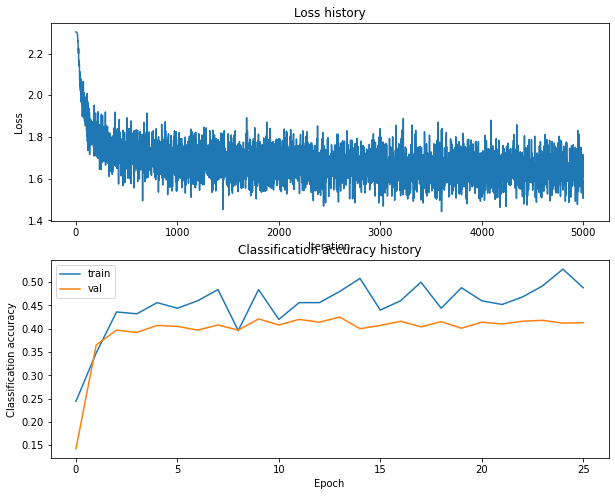

Training network with h_s 280, n_i 5000, b_s 300, l_r 0.0001
iteration 0 / 5000: loss 2.303594
iteration 100 / 5000: loss 2.297863
iteration 200 / 5000: loss 2.237761
iteration 300 / 5000: loss 2.123397
iteration 400 / 5000: loss 2.051918
iteration 500 / 5000: loss 1.991462
iteration 600 / 5000: loss 1.954686
iteration 700 / 5000: loss 2.033114
iteration 800 / 5000: loss 1.915686
iteration 900 / 5000: loss 1.942266
iteration 1000 / 5000: loss 1.942289
iteration 1100 / 5000: loss 1.872784
iteration 1200 / 5000: loss 1.866099
iteration 1300 / 5000: loss 1.851821
iteration 1400 / 5000: loss 1.799658
iteration 1500 / 5000: loss 1.895653
iteration 1600 / 5000: loss 1.760198
iteration 1700 / 5000: loss 1.772786
iteration 1800 / 5000: loss 1.846358
iteration 1900 / 5000: loss 1.759955
iteration 2000 / 5000: loss 1.832549
iteration 2100 / 5000: loss 1.809190
iteration 2200 / 5000: loss 1.773456
iteration 2300 / 5000: loss 1.687540
iteration 2400 / 5000: loss 1.762405
iteration 2500 / 5000: los

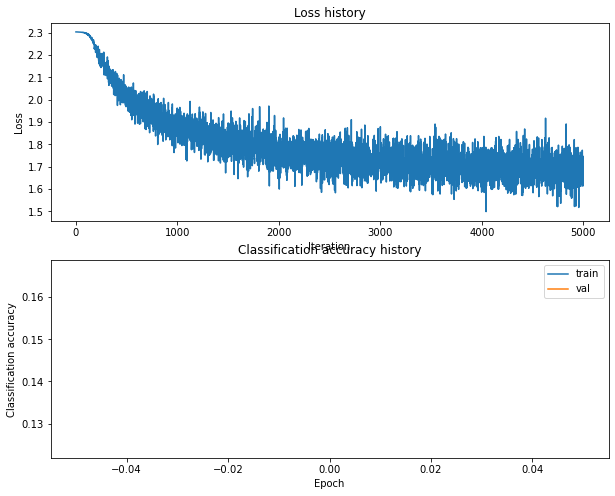

Training network with h_s 280, n_i 5000, b_s 300, l_r 0.001
iteration 0 / 5000: loss 2.303683
iteration 100 / 5000: loss 1.842292
iteration 200 / 5000: loss 1.847134
iteration 300 / 5000: loss 1.719773
iteration 400 / 5000: loss 1.700488
iteration 500 / 5000: loss 1.781273
iteration 600 / 5000: loss 1.759583
iteration 700 / 5000: loss 1.701715
iteration 800 / 5000: loss 1.726241
iteration 900 / 5000: loss 1.762563
iteration 1000 / 5000: loss 1.595498
iteration 1100 / 5000: loss 1.769175
iteration 1200 / 5000: loss 1.688916
iteration 1300 / 5000: loss 1.700832
iteration 1400 / 5000: loss 1.712847
iteration 1500 / 5000: loss 1.651070
iteration 1600 / 5000: loss 1.751888
iteration 1700 / 5000: loss 1.643963
iteration 1800 / 5000: loss 1.737759
iteration 1900 / 5000: loss 1.790050
iteration 2000 / 5000: loss 1.707408
iteration 2100 / 5000: loss 1.760737
iteration 2200 / 5000: loss 1.633741
iteration 2300 / 5000: loss 1.653854
iteration 2400 / 5000: loss 1.718525
iteration 2500 / 5000: loss

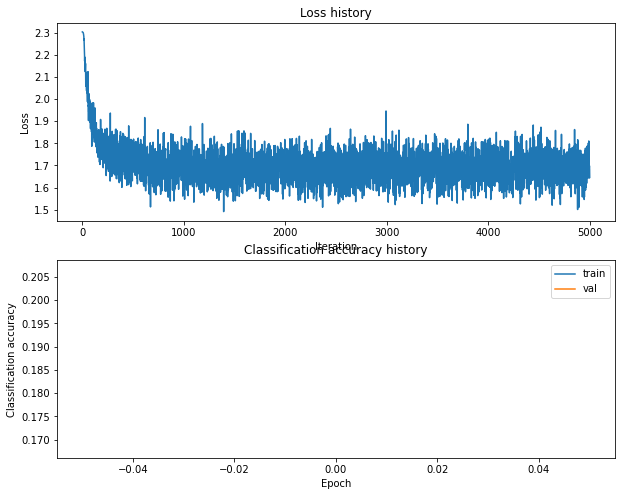

Training network with h_s 280, n_i 5000, b_s 500, l_r 0.0001
iteration 0 / 5000: loss 2.303626
iteration 100 / 5000: loss 2.298167
iteration 200 / 5000: loss 2.239674
iteration 300 / 5000: loss 2.129757
iteration 400 / 5000: loss 2.066824
iteration 500 / 5000: loss 1.994805
iteration 600 / 5000: loss 1.971571
iteration 700 / 5000: loss 1.936995
iteration 800 / 5000: loss 1.982588
iteration 900 / 5000: loss 1.882024
iteration 1000 / 5000: loss 1.924427
iteration 1100 / 5000: loss 1.887702
iteration 1200 / 5000: loss 1.903504
iteration 1300 / 5000: loss 1.877344
iteration 1400 / 5000: loss 1.830291
iteration 1500 / 5000: loss 1.879601
iteration 1600 / 5000: loss 1.838976
iteration 1700 / 5000: loss 1.857539
iteration 1800 / 5000: loss 1.842647
iteration 1900 / 5000: loss 1.910696
iteration 2000 / 5000: loss 1.762511
iteration 2100 / 5000: loss 1.780330
iteration 2200 / 5000: loss 1.739379
iteration 2300 / 5000: loss 1.859397
iteration 2400 / 5000: loss 1.838338
iteration 2500 / 5000: los

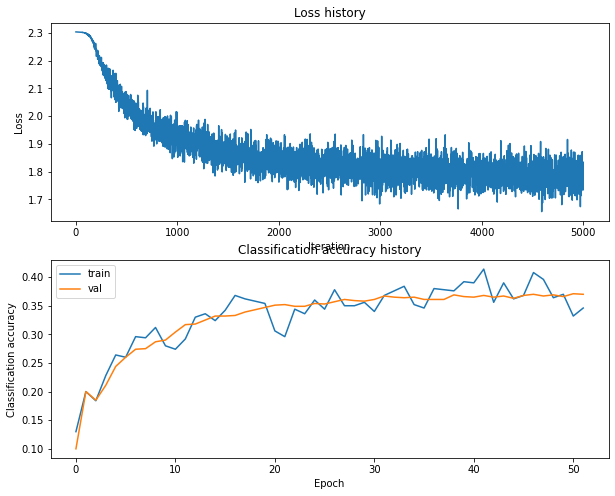

Training network with h_s 280, n_i 5000, b_s 500, l_r 0.001
iteration 0 / 5000: loss 2.303671
iteration 100 / 5000: loss 1.857799
iteration 200 / 5000: loss 1.808911
iteration 300 / 5000: loss 1.724192
iteration 400 / 5000: loss 1.726814
iteration 500 / 5000: loss 1.692030
iteration 600 / 5000: loss 1.686226
iteration 700 / 5000: loss 1.691877
iteration 800 / 5000: loss 1.640598
iteration 900 / 5000: loss 1.672124
iteration 1000 / 5000: loss 1.714107
iteration 1100 / 5000: loss 1.708673
iteration 1200 / 5000: loss 1.705487
iteration 1300 / 5000: loss 1.773555
iteration 1400 / 5000: loss 1.679764
iteration 1500 / 5000: loss 1.568212
iteration 1600 / 5000: loss 1.614863
iteration 1700 / 5000: loss 1.626605
iteration 1800 / 5000: loss 1.631409
iteration 1900 / 5000: loss 1.708693
iteration 2000 / 5000: loss 1.713045
iteration 2100 / 5000: loss 1.669771
iteration 2200 / 5000: loss 1.682153
iteration 2300 / 5000: loss 1.688488
iteration 2400 / 5000: loss 1.700920
iteration 2500 / 5000: loss

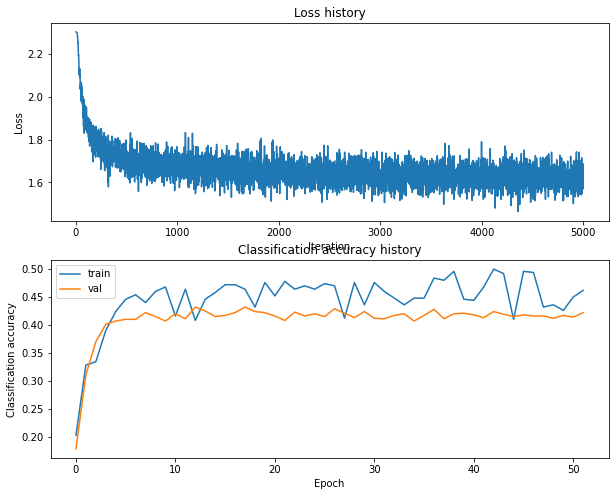

Training network with h_s 280, n_i 10000, b_s 100, l_r 0.0001
iteration 0 / 10000: loss 2.303752
iteration 100 / 10000: loss 2.298137
iteration 200 / 10000: loss 2.246041
iteration 300 / 10000: loss 2.158616
iteration 400 / 10000: loss 2.106552
iteration 500 / 10000: loss 2.083883
iteration 600 / 10000: loss 2.008329
iteration 700 / 10000: loss 1.983944
iteration 800 / 10000: loss 1.890841
iteration 900 / 10000: loss 1.991747
iteration 1000 / 10000: loss 1.893502
iteration 1100 / 10000: loss 1.798064
iteration 1200 / 10000: loss 1.861746
iteration 1300 / 10000: loss 2.014167
iteration 1400 / 10000: loss 1.808031
iteration 1500 / 10000: loss 1.556547
iteration 1600 / 10000: loss 1.930306
iteration 1700 / 10000: loss 1.803242
iteration 1800 / 10000: loss 1.869415
iteration 1900 / 10000: loss 1.855755
iteration 2000 / 10000: loss 1.721095
iteration 2100 / 10000: loss 1.968063
iteration 2200 / 10000: loss 1.674385
iteration 2300 / 10000: loss 1.817893
iteration 2400 / 10000: loss 1.749796


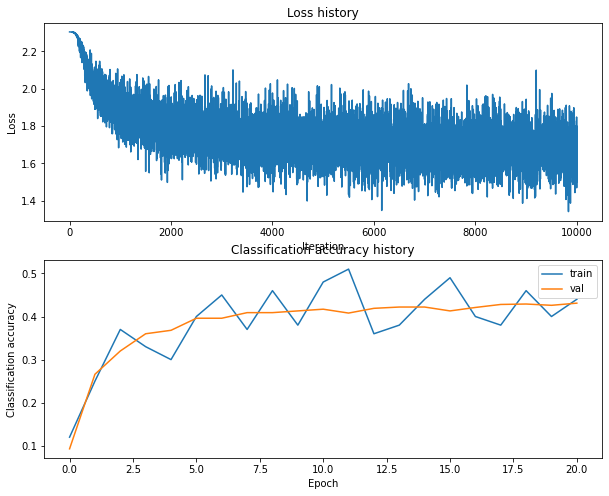

Training network with h_s 280, n_i 10000, b_s 100, l_r 0.001
iteration 0 / 10000: loss 2.303728
iteration 100 / 10000: loss 2.041577
iteration 200 / 10000: loss 1.877122
iteration 300 / 10000: loss 1.797036
iteration 400 / 10000: loss 1.610640
iteration 500 / 10000: loss 1.714821
iteration 600 / 10000: loss 1.596315
iteration 700 / 10000: loss 1.762978
iteration 800 / 10000: loss 1.780085
iteration 900 / 10000: loss 1.641176
iteration 1000 / 10000: loss 1.701444
iteration 1100 / 10000: loss 1.754544
iteration 1200 / 10000: loss 1.769118
iteration 1300 / 10000: loss 1.739516
iteration 1400 / 10000: loss 1.662769
iteration 1500 / 10000: loss 1.643650
iteration 1600 / 10000: loss 1.698516
iteration 1700 / 10000: loss 1.658216
iteration 1800 / 10000: loss 1.652346
iteration 1900 / 10000: loss 1.828625
iteration 2000 / 10000: loss 1.731804
iteration 2100 / 10000: loss 1.758606
iteration 2200 / 10000: loss 1.694962
iteration 2300 / 10000: loss 1.637197
iteration 2400 / 10000: loss 1.668512
i

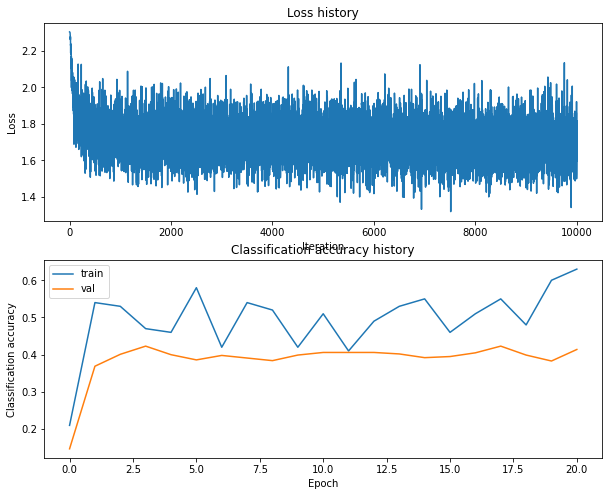

Training network with h_s 280, n_i 10000, b_s 200, l_r 0.0001
iteration 0 / 10000: loss 2.303658
iteration 100 / 10000: loss 2.298674
iteration 200 / 10000: loss 2.237861
iteration 300 / 10000: loss 2.145992
iteration 400 / 10000: loss 2.023980
iteration 500 / 10000: loss 1.989127
iteration 600 / 10000: loss 2.065277
iteration 700 / 10000: loss 2.065146
iteration 800 / 10000: loss 1.993633
iteration 900 / 10000: loss 1.943276
iteration 1000 / 10000: loss 1.867897
iteration 1100 / 10000: loss 1.838056
iteration 1200 / 10000: loss 1.822664
iteration 1300 / 10000: loss 1.939337
iteration 1400 / 10000: loss 1.828996
iteration 1500 / 10000: loss 1.780949
iteration 1600 / 10000: loss 1.868322
iteration 1700 / 10000: loss 1.755144
iteration 1800 / 10000: loss 1.841628
iteration 1900 / 10000: loss 1.739667
iteration 2000 / 10000: loss 1.737286
iteration 2100 / 10000: loss 1.782632
iteration 2200 / 10000: loss 1.742587
iteration 2300 / 10000: loss 1.785765
iteration 2400 / 10000: loss 1.779748


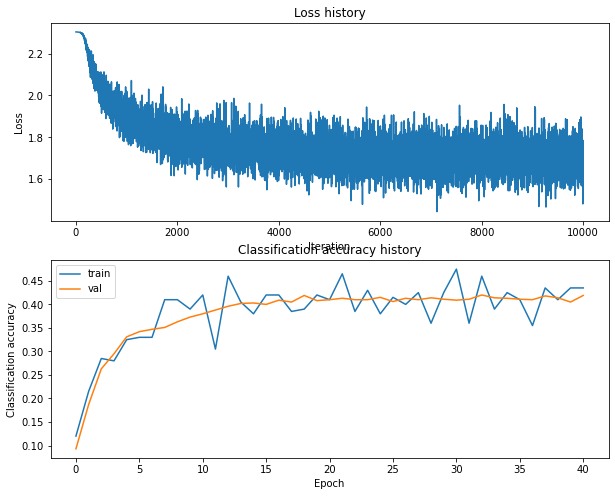

Training network with h_s 280, n_i 10000, b_s 200, l_r 0.001
iteration 0 / 10000: loss 2.303694
iteration 100 / 10000: loss 1.826177
iteration 200 / 10000: loss 1.771861
iteration 300 / 10000: loss 1.758090
iteration 400 / 10000: loss 1.704233
iteration 500 / 10000: loss 1.748576
iteration 600 / 10000: loss 1.671532
iteration 700 / 10000: loss 1.633210
iteration 800 / 10000: loss 1.691578
iteration 900 / 10000: loss 1.686659
iteration 1000 / 10000: loss 1.699881
iteration 1100 / 10000: loss 1.753810
iteration 1200 / 10000: loss 1.745047
iteration 1300 / 10000: loss 1.843945
iteration 1400 / 10000: loss 1.694085
iteration 1500 / 10000: loss 1.710056
iteration 1600 / 10000: loss 1.664119
iteration 1700 / 10000: loss 1.723448
iteration 1800 / 10000: loss 1.739991
iteration 1900 / 10000: loss 1.549231
iteration 2000 / 10000: loss 1.553307
iteration 2100 / 10000: loss 1.686037
iteration 2200 / 10000: loss 1.750682
iteration 2300 / 10000: loss 1.665802
iteration 2400 / 10000: loss 1.628641
i

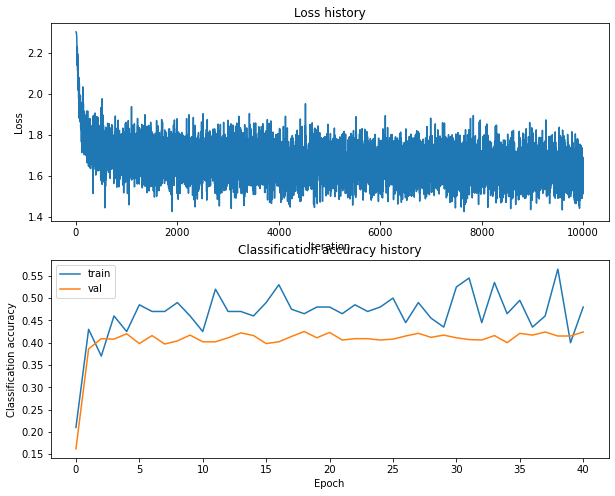

Training network with h_s 280, n_i 10000, b_s 250, l_r 0.0001
iteration 0 / 10000: loss 2.303692
iteration 100 / 10000: loss 2.299410
iteration 200 / 10000: loss 2.248352
iteration 300 / 10000: loss 2.093178
iteration 400 / 10000: loss 2.139519
iteration 500 / 10000: loss 2.060581
iteration 600 / 10000: loss 2.004541
iteration 700 / 10000: loss 2.012329
iteration 800 / 10000: loss 1.993455
iteration 900 / 10000: loss 1.945252
iteration 1000 / 10000: loss 1.852832
iteration 1100 / 10000: loss 1.893333
iteration 1200 / 10000: loss 1.874694
iteration 1300 / 10000: loss 1.915823
iteration 1400 / 10000: loss 1.854393
iteration 1500 / 10000: loss 1.758016
iteration 1600 / 10000: loss 1.848044
iteration 1700 / 10000: loss 1.795212
iteration 1800 / 10000: loss 1.810307
iteration 1900 / 10000: loss 1.736279
iteration 2000 / 10000: loss 1.840149
iteration 2100 / 10000: loss 1.773160
iteration 2200 / 10000: loss 1.921150
iteration 2300 / 10000: loss 1.764701
iteration 2400 / 10000: loss 1.791204


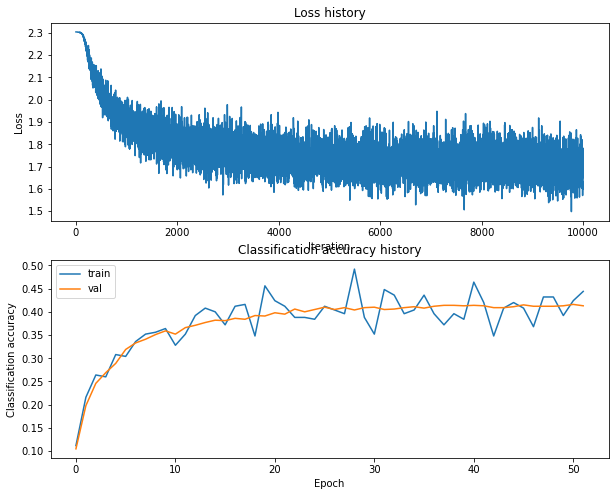

Training network with h_s 280, n_i 10000, b_s 250, l_r 0.001
iteration 0 / 10000: loss 2.303656
iteration 100 / 10000: loss 1.904060
iteration 200 / 10000: loss 1.796910
iteration 300 / 10000: loss 1.825623
iteration 400 / 10000: loss 1.660193
iteration 500 / 10000: loss 1.738436
iteration 600 / 10000: loss 1.747164
iteration 700 / 10000: loss 1.727713
iteration 800 / 10000: loss 1.722920
iteration 900 / 10000: loss 1.676821
iteration 1000 / 10000: loss 1.677476
iteration 1100 / 10000: loss 1.715559
iteration 1200 / 10000: loss 1.696682
iteration 1300 / 10000: loss 1.781481
iteration 1400 / 10000: loss 1.701781
iteration 1500 / 10000: loss 1.663785
iteration 1600 / 10000: loss 1.603472
iteration 1700 / 10000: loss 1.635614
iteration 1800 / 10000: loss 1.654089
iteration 1900 / 10000: loss 1.704555
iteration 2000 / 10000: loss 1.652398
iteration 2100 / 10000: loss 1.619525
iteration 2200 / 10000: loss 1.641024
iteration 2300 / 10000: loss 1.694527
iteration 2400 / 10000: loss 1.655421
i

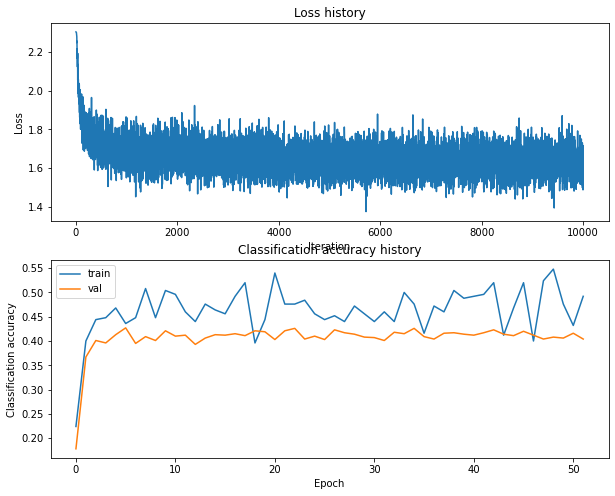

Training network with h_s 280, n_i 10000, b_s 300, l_r 0.0001
iteration 0 / 10000: loss 2.303683
iteration 100 / 10000: loss 2.297612
iteration 200 / 10000: loss 2.218224
iteration 300 / 10000: loss 2.172606
iteration 400 / 10000: loss 2.089494
iteration 500 / 10000: loss 2.030783
iteration 600 / 10000: loss 1.937687
iteration 700 / 10000: loss 1.940561
iteration 800 / 10000: loss 1.937412
iteration 900 / 10000: loss 1.878338
iteration 1000 / 10000: loss 1.851446
iteration 1100 / 10000: loss 1.851402
iteration 1200 / 10000: loss 1.866778
iteration 1300 / 10000: loss 1.836313
iteration 1400 / 10000: loss 1.813719
iteration 1500 / 10000: loss 1.799492
iteration 1600 / 10000: loss 1.851992
iteration 1700 / 10000: loss 1.837103
iteration 1800 / 10000: loss 1.829896
iteration 1900 / 10000: loss 1.804301
iteration 2000 / 10000: loss 1.857255
iteration 2100 / 10000: loss 1.842845
iteration 2200 / 10000: loss 1.802382
iteration 2300 / 10000: loss 1.834664
iteration 2400 / 10000: loss 1.762375


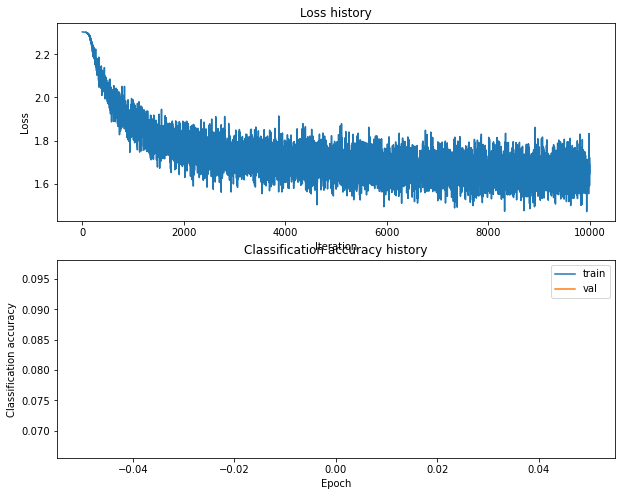

Training network with h_s 280, n_i 10000, b_s 300, l_r 0.001
iteration 0 / 10000: loss 2.303673
iteration 100 / 10000: loss 1.888810
iteration 200 / 10000: loss 1.738974
iteration 300 / 10000: loss 1.743831
iteration 400 / 10000: loss 1.693511
iteration 500 / 10000: loss 1.726431
iteration 600 / 10000: loss 1.694668
iteration 700 / 10000: loss 1.622643
iteration 800 / 10000: loss 1.659091
iteration 900 / 10000: loss 1.629153
iteration 1000 / 10000: loss 1.682101
iteration 1100 / 10000: loss 1.719788
iteration 1200 / 10000: loss 1.749346
iteration 1300 / 10000: loss 1.610992
iteration 1400 / 10000: loss 1.724310
iteration 1500 / 10000: loss 1.691780
iteration 1600 / 10000: loss 1.703886
iteration 1700 / 10000: loss 1.687641
iteration 1800 / 10000: loss 1.747824
iteration 1900 / 10000: loss 1.623412
iteration 2000 / 10000: loss 1.800770
iteration 2100 / 10000: loss 1.728213
iteration 2200 / 10000: loss 1.638231
iteration 2300 / 10000: loss 1.563884
iteration 2400 / 10000: loss 1.732465
i

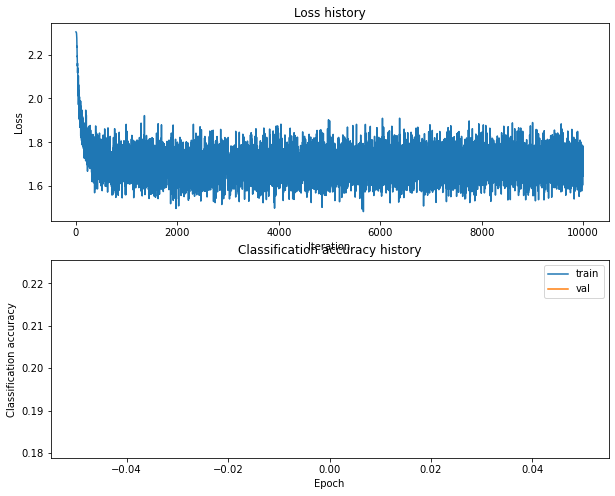

Training network with h_s 280, n_i 10000, b_s 500, l_r 0.0001
iteration 0 / 10000: loss 2.303663
iteration 100 / 10000: loss 2.298426
iteration 200 / 10000: loss 2.237302
iteration 300 / 10000: loss 2.150363
iteration 400 / 10000: loss 2.129098
iteration 500 / 10000: loss 2.033519
iteration 600 / 10000: loss 2.011825
iteration 700 / 10000: loss 1.989654
iteration 800 / 10000: loss 1.978140
iteration 900 / 10000: loss 1.948490
iteration 1000 / 10000: loss 1.912890
iteration 1100 / 10000: loss 1.950362
iteration 1200 / 10000: loss 1.915321
iteration 1300 / 10000: loss 1.875154
iteration 1400 / 10000: loss 1.852709
iteration 1500 / 10000: loss 1.807881
iteration 1600 / 10000: loss 1.825584
iteration 1700 / 10000: loss 1.826588
iteration 1800 / 10000: loss 1.822899
iteration 1900 / 10000: loss 1.781843
iteration 2000 / 10000: loss 1.825859
iteration 2100 / 10000: loss 1.833685
iteration 2200 / 10000: loss 1.825774
iteration 2300 / 10000: loss 1.840702
iteration 2400 / 10000: loss 1.813183


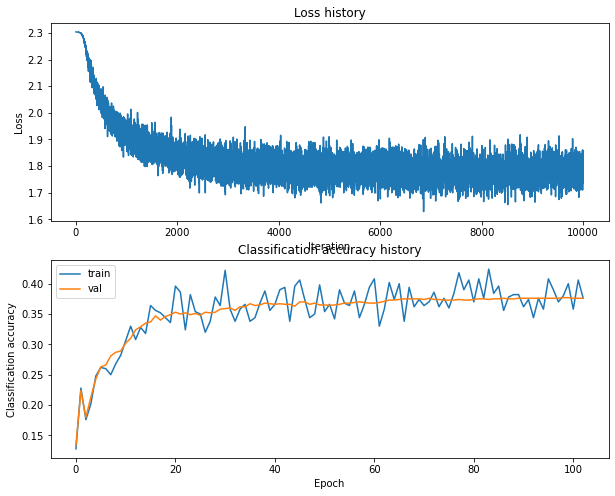

Training network with h_s 280, n_i 10000, b_s 500, l_r 0.001
iteration 0 / 10000: loss 2.303667
iteration 100 / 10000: loss 1.861504
iteration 200 / 10000: loss 1.801733
iteration 300 / 10000: loss 1.789163
iteration 400 / 10000: loss 1.775772
iteration 500 / 10000: loss 1.655017
iteration 600 / 10000: loss 1.648128
iteration 700 / 10000: loss 1.754375
iteration 800 / 10000: loss 1.706698
iteration 900 / 10000: loss 1.645229
iteration 1000 / 10000: loss 1.650993
iteration 1100 / 10000: loss 1.648588
iteration 1200 / 10000: loss 1.634588
iteration 1300 / 10000: loss 1.725760
iteration 1400 / 10000: loss 1.617000
iteration 1500 / 10000: loss 1.579175
iteration 1600 / 10000: loss 1.578241
iteration 1700 / 10000: loss 1.707955
iteration 1800 / 10000: loss 1.639228
iteration 1900 / 10000: loss 1.651470
iteration 2000 / 10000: loss 1.637622
iteration 2100 / 10000: loss 1.619156
iteration 2200 / 10000: loss 1.635045
iteration 2300 / 10000: loss 1.602383
iteration 2400 / 10000: loss 1.628342
i

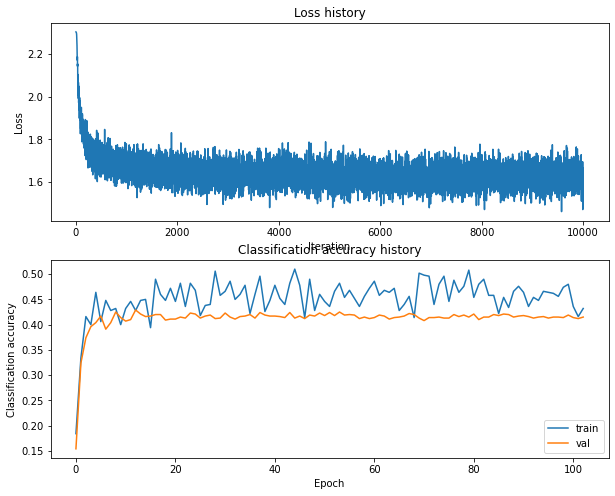

Training network with h_s 280, n_i 15000, b_s 100, l_r 0.0001
iteration 0 / 15000: loss 2.303657
iteration 100 / 15000: loss 2.297154
iteration 200 / 15000: loss 2.201688
iteration 300 / 15000: loss 2.161526
iteration 400 / 15000: loss 2.093681
iteration 500 / 15000: loss 2.006753
iteration 600 / 15000: loss 2.006384
iteration 700 / 15000: loss 2.000225
iteration 800 / 15000: loss 2.044635
iteration 900 / 15000: loss 1.989482
iteration 1000 / 15000: loss 1.756927
iteration 1100 / 15000: loss 1.806340
iteration 1200 / 15000: loss 1.941067
iteration 1300 / 15000: loss 1.994130
iteration 1400 / 15000: loss 1.706956
iteration 1500 / 15000: loss 1.778831
iteration 1600 / 15000: loss 1.843520
iteration 1700 / 15000: loss 1.877752
iteration 1800 / 15000: loss 1.777365
iteration 1900 / 15000: loss 1.649720
iteration 2000 / 15000: loss 1.779314
iteration 2100 / 15000: loss 1.661289
iteration 2200 / 15000: loss 1.681405
iteration 2300 / 15000: loss 1.567526
iteration 2400 / 15000: loss 1.732246


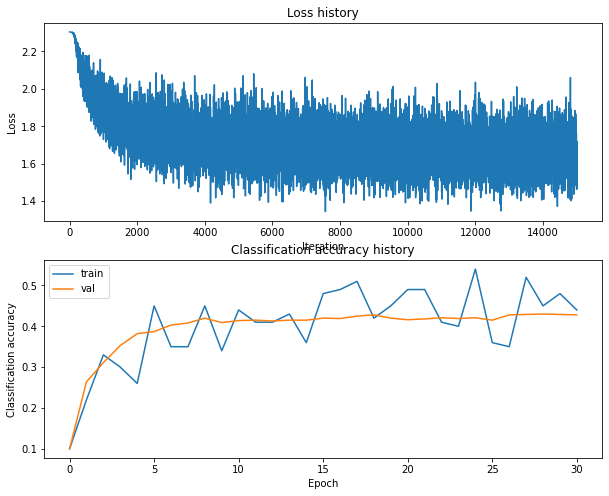

Training network with h_s 280, n_i 15000, b_s 100, l_r 0.001
iteration 0 / 15000: loss 2.303724
iteration 100 / 15000: loss 1.819611
iteration 200 / 15000: loss 1.693356
iteration 300 / 15000: loss 1.697580
iteration 400 / 15000: loss 1.690250
iteration 500 / 15000: loss 1.684826
iteration 600 / 15000: loss 1.577642
iteration 700 / 15000: loss 1.759627
iteration 800 / 15000: loss 1.648314
iteration 900 / 15000: loss 1.751937
iteration 1000 / 15000: loss 1.731384
iteration 1100 / 15000: loss 1.779963
iteration 1200 / 15000: loss 1.602445
iteration 1300 / 15000: loss 1.691237
iteration 1400 / 15000: loss 1.615248
iteration 1500 / 15000: loss 1.754598
iteration 1600 / 15000: loss 1.777942
iteration 1700 / 15000: loss 1.666170
iteration 1800 / 15000: loss 1.673078
iteration 1900 / 15000: loss 1.593233
iteration 2000 / 15000: loss 1.657874
iteration 2100 / 15000: loss 1.499635
iteration 2200 / 15000: loss 1.676987
iteration 2300 / 15000: loss 1.626036
iteration 2400 / 15000: loss 1.763867
i

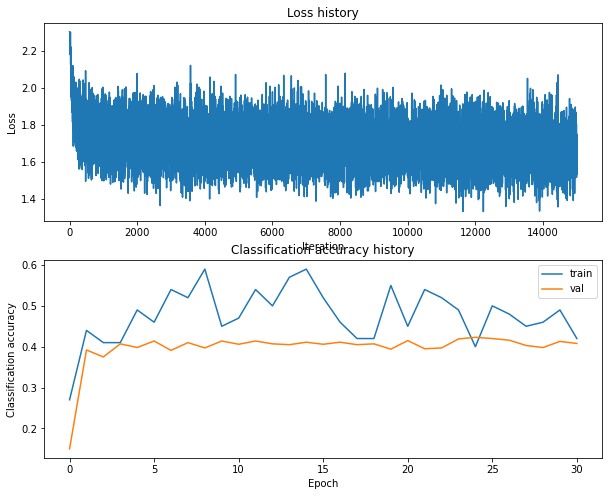

Training network with h_s 280, n_i 15000, b_s 200, l_r 0.0001
iteration 0 / 15000: loss 2.303629
iteration 100 / 15000: loss 2.297751
iteration 200 / 15000: loss 2.236751
iteration 300 / 15000: loss 2.184137
iteration 400 / 15000: loss 2.098113
iteration 500 / 15000: loss 1.991492
iteration 600 / 15000: loss 1.987046
iteration 700 / 15000: loss 1.963924
iteration 800 / 15000: loss 1.898130
iteration 900 / 15000: loss 1.966264
iteration 1000 / 15000: loss 1.866271
iteration 1100 / 15000: loss 1.815914
iteration 1200 / 15000: loss 1.870123
iteration 1300 / 15000: loss 1.914655
iteration 1400 / 15000: loss 1.976519
iteration 1500 / 15000: loss 1.762269
iteration 1600 / 15000: loss 1.854086
iteration 1700 / 15000: loss 1.872097
iteration 1800 / 15000: loss 1.894905
iteration 1900 / 15000: loss 1.771079
iteration 2000 / 15000: loss 1.858589
iteration 2100 / 15000: loss 1.741835
iteration 2200 / 15000: loss 1.889078
iteration 2300 / 15000: loss 1.862683
iteration 2400 / 15000: loss 1.768800


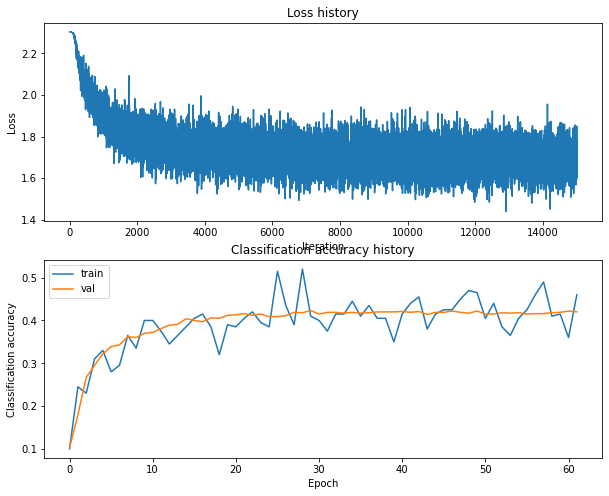

Training network with h_s 280, n_i 15000, b_s 200, l_r 0.001
iteration 0 / 15000: loss 2.303712
iteration 100 / 15000: loss 1.804053
iteration 200 / 15000: loss 1.853381
iteration 300 / 15000: loss 1.789208
iteration 400 / 15000: loss 1.607573
iteration 500 / 15000: loss 1.737820
iteration 600 / 15000: loss 1.640396
iteration 700 / 15000: loss 1.657434
iteration 800 / 15000: loss 1.766571
iteration 900 / 15000: loss 1.803183
iteration 1000 / 15000: loss 1.700826
iteration 1100 / 15000: loss 1.833303
iteration 1200 / 15000: loss 1.769929
iteration 1300 / 15000: loss 1.680426
iteration 1400 / 15000: loss 1.581789
iteration 1500 / 15000: loss 1.597408
iteration 1600 / 15000: loss 1.609264
iteration 1700 / 15000: loss 1.683655
iteration 1800 / 15000: loss 1.719654
iteration 1900 / 15000: loss 1.547815
iteration 2000 / 15000: loss 1.852578
iteration 2100 / 15000: loss 1.688449
iteration 2200 / 15000: loss 1.674989
iteration 2300 / 15000: loss 1.757033
iteration 2400 / 15000: loss 1.539300
i

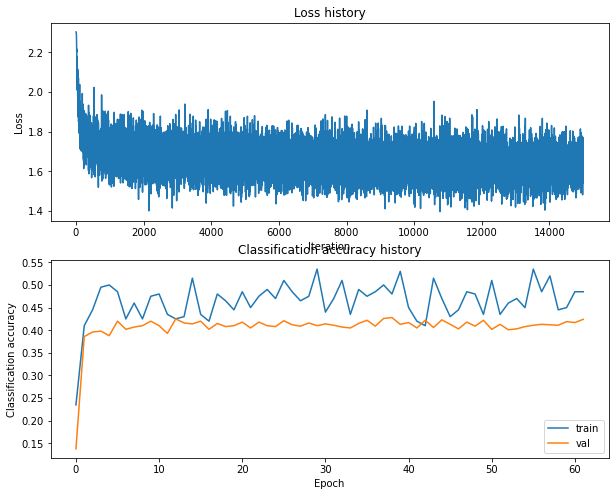

Training network with h_s 280, n_i 15000, b_s 250, l_r 0.0001
iteration 0 / 15000: loss 2.303653
iteration 100 / 15000: loss 2.297997
iteration 200 / 15000: loss 2.203244
iteration 300 / 15000: loss 2.165611
iteration 400 / 15000: loss 2.131130
iteration 500 / 15000: loss 2.014278
iteration 600 / 15000: loss 2.008326
iteration 700 / 15000: loss 1.913359
iteration 800 / 15000: loss 1.888071
iteration 900 / 15000: loss 1.876916
iteration 1000 / 15000: loss 1.919134
iteration 1100 / 15000: loss 1.923328
iteration 1200 / 15000: loss 1.877006
iteration 1300 / 15000: loss 1.876647
iteration 1400 / 15000: loss 1.822851
iteration 1500 / 15000: loss 1.868236
iteration 1600 / 15000: loss 1.881980
iteration 1700 / 15000: loss 1.804337
iteration 1800 / 15000: loss 1.732825
iteration 1900 / 15000: loss 1.900870
iteration 2000 / 15000: loss 1.807191
iteration 2100 / 15000: loss 1.779857
iteration 2200 / 15000: loss 1.837142
iteration 2300 / 15000: loss 1.773794
iteration 2400 / 15000: loss 1.832497


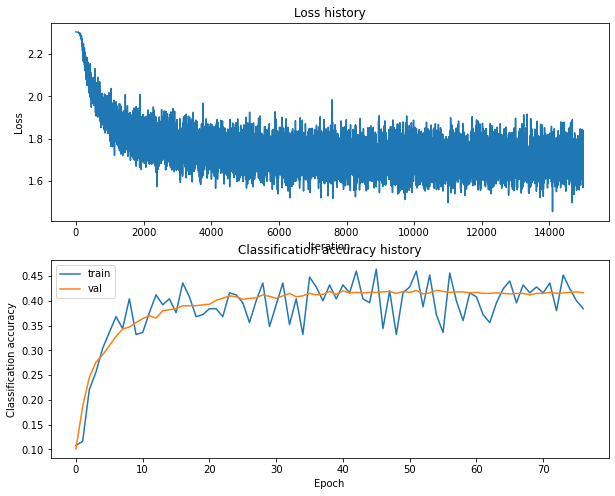

Training network with h_s 280, n_i 15000, b_s 250, l_r 0.001
iteration 0 / 15000: loss 2.303648
iteration 100 / 15000: loss 1.914305
iteration 200 / 15000: loss 1.758786
iteration 300 / 15000: loss 1.731798
iteration 400 / 15000: loss 1.710871
iteration 500 / 15000: loss 1.597169
iteration 600 / 15000: loss 1.624548
iteration 700 / 15000: loss 1.743860
iteration 800 / 15000: loss 1.872231
iteration 900 / 15000: loss 1.821067
iteration 1000 / 15000: loss 1.599975
iteration 1100 / 15000: loss 1.642710
iteration 1200 / 15000: loss 1.731848
iteration 1300 / 15000: loss 1.757808
iteration 1400 / 15000: loss 1.710643
iteration 1500 / 15000: loss 1.691118
iteration 1600 / 15000: loss 1.643608
iteration 1700 / 15000: loss 1.681538
iteration 1800 / 15000: loss 1.718738
iteration 1900 / 15000: loss 1.636540
iteration 2000 / 15000: loss 1.682909
iteration 2100 / 15000: loss 1.662988
iteration 2200 / 15000: loss 1.746563
iteration 2300 / 15000: loss 1.589383
iteration 2400 / 15000: loss 1.697138
i

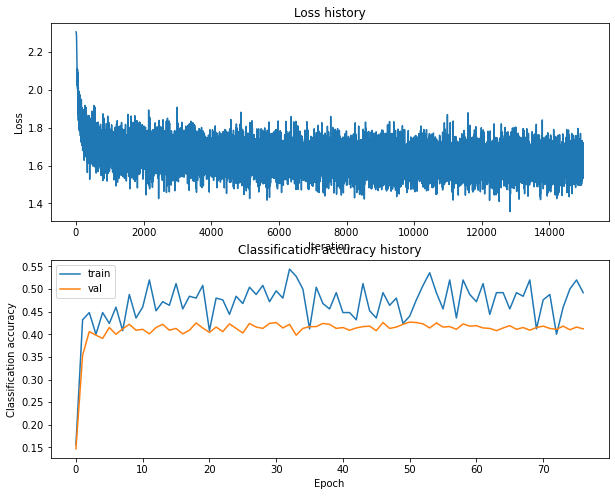

Training network with h_s 280, n_i 15000, b_s 300, l_r 0.0001
iteration 0 / 15000: loss 2.303671
iteration 100 / 15000: loss 2.297707
iteration 200 / 15000: loss 2.237158
iteration 300 / 15000: loss 2.116859
iteration 400 / 15000: loss 2.090764
iteration 500 / 15000: loss 2.022309
iteration 600 / 15000: loss 1.972972
iteration 700 / 15000: loss 1.968294
iteration 800 / 15000: loss 1.916873
iteration 900 / 15000: loss 1.871013
iteration 1000 / 15000: loss 1.870588
iteration 1100 / 15000: loss 1.837061
iteration 1200 / 15000: loss 1.872185
iteration 1300 / 15000: loss 1.817319
iteration 1400 / 15000: loss 1.890367
iteration 1500 / 15000: loss 1.852434
iteration 1600 / 15000: loss 1.898578
iteration 1700 / 15000: loss 1.823197
iteration 1800 / 15000: loss 1.738564
iteration 1900 / 15000: loss 1.824924
iteration 2000 / 15000: loss 1.714113
iteration 2100 / 15000: loss 1.783592
iteration 2200 / 15000: loss 1.745097
iteration 2300 / 15000: loss 1.756280
iteration 2400 / 15000: loss 1.696157


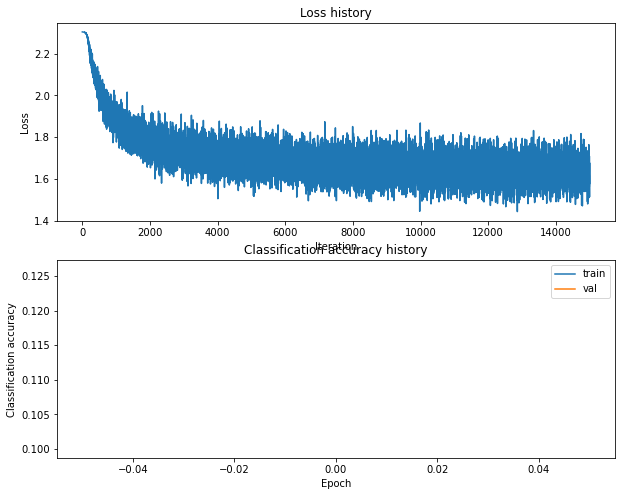

Training network with h_s 280, n_i 15000, b_s 300, l_r 0.001
iteration 0 / 15000: loss 2.303666
iteration 100 / 15000: loss 1.879795
iteration 200 / 15000: loss 1.831994
iteration 300 / 15000: loss 1.711137
iteration 400 / 15000: loss 1.723153
iteration 500 / 15000: loss 1.682895
iteration 600 / 15000: loss 1.784100
iteration 700 / 15000: loss 1.764912
iteration 800 / 15000: loss 1.760978
iteration 900 / 15000: loss 1.634075
iteration 1000 / 15000: loss 1.651999
iteration 1100 / 15000: loss 1.836900
iteration 1200 / 15000: loss 1.642252
iteration 1300 / 15000: loss 1.666243
iteration 1400 / 15000: loss 1.687519
iteration 1500 / 15000: loss 1.698168
iteration 1600 / 15000: loss 1.652958
iteration 1700 / 15000: loss 1.680779
iteration 1800 / 15000: loss 1.631634
iteration 1900 / 15000: loss 1.743312
iteration 2000 / 15000: loss 1.587077
iteration 2100 / 15000: loss 1.604181
iteration 2200 / 15000: loss 1.706603
iteration 2300 / 15000: loss 1.751318
iteration 2400 / 15000: loss 1.683580
i

KeyboardInterrupt: 

In [13]:
best_val = -1 
best_net = None # store the best model into this 

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

hidden_sizes = [10, 25, 50, 100, 170, 175, 200, 280, 300]
number_iterations = [500, 1000, 1500, 2500, 5000, 10000, 15000, 20000, 25000]
batch_sizes = [100, 200, 250, 300, 500]
learning_rates = [1e-4, 1e-3]
input_size = 32 * 32 * 3
num_classes = 10

for h_s in hidden_sizes:
    for n_i in number_iterations:
        for b_s in batch_sizes:
            for l_r in learning_rates:
                print('Training network with h_s {0}, n_i {1}, b_s {2}, l_r {3}'.format(h_s, n_i, b_s, l_r))
                net = TwoLayerNet(input_size, h_s, num_classes)
                
                # Train the network
                stats = net.train(X_train, y_train, X_val, y_val,
                                  num_iters=n_i, batch_size=b_s,
                                  learning_rate=l_r, learning_rate_decay=0.95,
                                  reg=0.25, verbose=True)
                
                # Predict on the validation set
                val_acc = (net.predict(X_val) == y_val).mean()
                print('Validation accuracy: ', val_acc)
                
                # Plot the loss function and train / validation accuracies
                plt.subplot(2, 1, 1)
                plt.plot(stats['loss_history'])
                plt.title('Loss history')
                plt.xlabel('Iteration')
                plt.ylabel('Loss')
                
                plt.subplot(2, 1, 2)
                plt.plot(stats['train_acc_history'], label='train')
                plt.plot(stats['val_acc_history'], label='val')
                plt.title('Classification accuracy history')
                plt.xlabel('Epoch')
                plt.ylabel('Classification accuracy')
                plt.legend()
                plt.show()
                
                if val_acc > best_val:
                    best_net = net

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****


In [38]:
best_net = None # store the best model into this
best_val = -1

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
input_size = 32 * 32 * 3
hidden_size = 100
num_classes = 10

hidden_units = [300, 400, 500]
learning_rates = [5e-4, 6e-4]

for hidden_unit in hidden_units:
    for lr_rt in learning_rates:
        neural_net = TwoLayerNet(input_size,hidden_unit, num_classes, std=1e-4)
        stats = neural_net.train(X_train,y_train,X_val, y_val,
                                 num_iters=5000, batch_size=200,learning_rate=lr_rt,learning_rate_decay=0.95,
                                 reg=0.25, verbose=True)
        
        val_acc = (neural_net.predict(X_val) == y_val).mean()
        print (val_acc)
        if (val_acc > best_val):
            best_val = val_acc
            best_net = neural_net
            
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

iteration 0 / 5000: loss 2.303747
iteration 100 / 5000: loss 2.049769
iteration 200 / 5000: loss 1.872926
iteration 300 / 5000: loss 1.968462
iteration 400 / 5000: loss 1.770713
iteration 500 / 5000: loss 1.766727
iteration 600 / 5000: loss 1.727053
iteration 700 / 5000: loss 1.641867
iteration 800 / 5000: loss 1.690642
iteration 900 / 5000: loss 1.810608
iteration 1000 / 5000: loss 1.570761
iteration 1100 / 5000: loss 1.785067
iteration 1200 / 5000: loss 1.718163
iteration 1300 / 5000: loss 1.671409
iteration 1400 / 5000: loss 1.753778
iteration 1500 / 5000: loss 1.623139
iteration 1600 / 5000: loss 1.672183
iteration 1700 / 5000: loss 1.674498
iteration 1800 / 5000: loss 1.613673
iteration 1900 / 5000: loss 1.686659
iteration 2000 / 5000: loss 1.636449
iteration 2100 / 5000: loss 1.719801
iteration 2200 / 5000: loss 1.666326
iteration 2300 / 5000: loss 1.772129
iteration 2400 / 5000: loss 1.710013
iteration 2500 / 5000: loss 1.608384
iteration 2600 / 5000: loss 1.588773
iteration 270

iteration 2300 / 5000: loss 1.695347
iteration 2400 / 5000: loss 1.659628
iteration 2500 / 5000: loss 1.610958
iteration 2600 / 5000: loss 1.744801
iteration 2700 / 5000: loss 1.681130
iteration 2800 / 5000: loss 1.506839
iteration 2900 / 5000: loss 1.722771
iteration 3000 / 5000: loss 1.610279
iteration 3100 / 5000: loss 1.532399
iteration 3200 / 5000: loss 1.709418
iteration 3300 / 5000: loss 1.702027
iteration 3400 / 5000: loss 1.703332
iteration 3500 / 5000: loss 1.733669
iteration 3600 / 5000: loss 1.588836
iteration 3700 / 5000: loss 1.595946
iteration 3800 / 5000: loss 1.635470
iteration 3900 / 5000: loss 1.755368
iteration 4000 / 5000: loss 1.757784
iteration 4100 / 5000: loss 1.800808
iteration 4200 / 5000: loss 1.624112
iteration 4300 / 5000: loss 1.575106
iteration 4400 / 5000: loss 1.644439
iteration 4500 / 5000: loss 1.683975
iteration 4600 / 5000: loss 1.746646
iteration 4700 / 5000: loss 1.635664
iteration 4800 / 5000: loss 1.752054
iteration 4900 / 5000: loss 1.564177
0

In [39]:
best_val

0.425

In [ ]:
best_net = None
best_val = -1
hidden_size = [60, 80, 100, 120, 200, 300, 400, 500]
learning_rate = [1e-4, 3e-4, 5e-4, 7e-4, 9e-4, 1e-3]
reg = [0.2, 0.4, 0.6]
best_acc = -1
log = {}

for hs in hidden_size:
    for lr in learning_rate:
        for r in reg:
            net = TwoLayerNet(input_size, hs, num_classes)
            stats = net.train(X_train, y_train, X_val, y_val,
                              num_iters=10000, batch_size=200,
                              learning_rate=lr, learning_rate_decay=0.95,
                              reg=r, verbose=False)
            val_acc = (net.predict(X_val) == y_val).mean()
            log[(hs, lr, r)] = val_acc
            print('for hs: %e, lr: %e and r: %e, valid accuracy is: %f' % (hs, lr, r, val_acc))
            
            if val_acc > best_acc:
                best_net = net
                best_acc = val_acc
                
                print('Best Networks has an Accuracy of: %f' % best_acc)

for hs: 6.000000e+01, lr: 1.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.411000
Best Networks has an Accuracy of: 0.411000
for hs: 6.000000e+01, lr: 1.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.423000
Best Networks has an Accuracy of: 0.423000
for hs: 6.000000e+01, lr: 1.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.419000
for hs: 6.000000e+01, lr: 3.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.422000
for hs: 6.000000e+01, lr: 3.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.420000
for hs: 6.000000e+01, lr: 3.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.421000
for hs: 6.000000e+01, lr: 5.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.416000
for hs: 6.000000e+01, lr: 5.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.426000
Best Networks has an Accuracy of: 0.426000
for hs: 6.000000e+01, lr: 5.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.419000
for hs: 6.000000e+01, lr: 7.000000e-04 and r: 2.000000e-01, valid accuracy is: 

for hs: 3.000000e+02, lr: 1.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.417000
for hs: 3.000000e+02, lr: 1.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.410000
for hs: 3.000000e+02, lr: 3.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.420000
for hs: 3.000000e+02, lr: 3.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.428000
for hs: 3.000000e+02, lr: 3.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.427000
for hs: 3.000000e+02, lr: 5.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.420000
for hs: 3.000000e+02, lr: 5.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.420000
for hs: 3.000000e+02, lr: 5.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.428000
for hs: 3.000000e+02, lr: 7.000000e-04 and r: 2.000000e-01, valid accuracy is: 0.414000
for hs: 3.000000e+02, lr: 7.000000e-04 and r: 4.000000e-01, valid accuracy is: 0.419000
for hs: 3.000000e+02, lr: 7.000000e-04 and r: 6.000000e-01, valid accuracy is: 0.413000
for hs: 3.000000e+02, lr: 9.0000

In [ ]:
# Print your validation accuracy: this should be above 48%
val_acc = (best_net.predict(X_val) == y_val).mean()
print('Validation accuracy: ', val_acc)

In [ ]:
# Visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

In [26]:
# Print your test accuracy: this should be above 48%
test_acc = (net.predict(X_test) == y_test).mean()
print('Test accuracy: ', test_acc)

Test accuracy:  0.547


**Inline Question**

Now that you have trained a Neural Network classifier, you may find that your testing accuracy is much lower than the training accuracy. In what ways can we decrease this gap? Select all that apply.

1. Train on a larger dataset.
2. Add more hidden units.
3. Increase the regularization strength.
4. None of the above.

$\color{blue}{\textit Your Answer:}$

$\color{blue}{\textit Your Explanation:}$

